# Optimization Methods

Until now, you've always used Gradient Descent to update the parameters and minimize the cost. In this notebook, you will learn more advanced optimization methods that can speed up learning and perhaps even get you to a better final value for the cost function. Having a good optimization algorithm can be the difference between waiting days vs. just a few hours to get a good result. 

Gradient descent goes "downhill" on a cost function $J$. Think of it as trying to do this: 
<img src="images/cost.jpg" style="width:650px;height:300px;">
<caption><center> <u> **Figure 1** </u>: **Minimizing the cost is like finding the lowest point in a hilly landscape**<br> At each step of the training, you update your parameters following a certain direction to try to get to the lowest possible point. </center></caption>

**Notations**: As usual, $\frac{\partial J}{\partial a } = $ `da` for any variable `a`.

To get started, run the following code to import the libraries you will need.

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.io
import math
import sklearn
import sklearn.datasets

from opt_utils import load_params_and_grads, initialize_parameters, forward_propagation, backward_propagation
from opt_utils import compute_cost, predict, predict_dec, plot_decision_boundary, load_dataset
from testCases import *

%matplotlib inline
plt.rcParams['figure.figsize'] = (7.0, 4.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

/home/jovyan/work/week6/opt_utils.py:76: SyntaxWarning: assertion is always true, perhaps remove parentheses?
  assert(parameters['W' + str(l)].shape == layer_dims[l], layer_dims[l-1])
/home/jovyan/work/week6/opt_utils.py:77: SyntaxWarning: assertion is always true, perhaps remove parentheses?
  assert(parameters['W' + str(l)].shape == layer_dims[l], 1)


## 1 - Gradient Descent

A simple optimization method in machine learning is gradient descent (GD). When you take gradient steps with respect to all $m$ examples on each step, it is also called Batch Gradient Descent. 

**Warm-up exercise**: Implement the gradient descent update rule. The  gradient descent rule is, for $l = 1, ..., L$: 
$$ W^{[l]} = W^{[l]} - \alpha \text{ } dW^{[l]} \tag{1}$$
$$ b^{[l]} = b^{[l]} - \alpha \text{ } db^{[l]} \tag{2}$$

where L is the number of layers and $\alpha$ is the learning rate. All parameters should be stored in the `parameters` dictionary. Note that the iterator `l` starts at 0 in the `for` loop while the first parameters are $W^{[1]}$ and $b^{[1]}$. You need to shift `l` to `l+1` when coding.

In [6]:
# GRADED FUNCTION: update_parameters_with_gd

def update_parameters_with_gd(parameters, grads, learning_rate):
    """
    Update parameters using one step of gradient descent
    
    Arguments:
    parameters -- python dictionary containing your parameters to be updated:
                    parameters['W' + str(l)] = Wl
                    parameters['b' + str(l)] = bl
    grads -- python dictionary containing your gradients to update each parameters:
                    grads['dW' + str(l)] = dWl
                    grads['db' + str(l)] = dbl
    learning_rate -- the learning rate, scalar.
    
    Returns:
    parameters -- python dictionary containing your updated parameters 
    """

    L = len(parameters) // 2 # number of layers in the neural networks

    # Update rule for each parameter
    for l in range(L):
        ### START CODE HERE ### (approx. 2 lines)
        parameters["W" + str(l+1)] = parameters["W" + str(l+1)] - learning_rate * grads['dW' + str(l+1)]
        parameters["b" + str(l+1)] = parameters["b" + str(l+1)] - learning_rate * grads['db' + str(l+1)]
        ### END CODE HERE ###
        
    return parameters

In [7]:
parameters, grads, learning_rate = update_parameters_with_gd_test_case()

parameters = update_parameters_with_gd(parameters, grads, learning_rate)
print("W1 = " + str(parameters["W1"]))
print("b1 = " + str(parameters["b1"]))
print("W2 = " + str(parameters["W2"]))
print("b2 = " + str(parameters["b2"]))

W1 = [[ 1.63535156 -0.62320365 -0.53718766]
 [-1.07799357  0.85639907 -2.29470142]]
b1 = [[ 1.74604067]
 [-0.75184921]]
W2 = [[ 0.32171798 -0.25467393  1.46902454]
 [-2.05617317 -0.31554548 -0.3756023 ]
 [ 1.1404819  -1.09976462 -0.1612551 ]]
b2 = [[-0.88020257]
 [ 0.02561572]
 [ 0.57539477]]


**Expected Output**:

<table> 
    <tr>
    <td > **W1** </td> 
           <td > [[ 1.63535156 -0.62320365 -0.53718766]
 [-1.07799357  0.85639907 -2.29470142]] </td> 
    </tr> 
    
    <tr>
    <td > **b1** </td> 
           <td > [[ 1.74604067]
 [-0.75184921]] </td> 
    </tr> 
    
    <tr>
    <td > **W2** </td> 
           <td > [[ 0.32171798 -0.25467393  1.46902454]
 [-2.05617317 -0.31554548 -0.3756023 ]
 [ 1.1404819  -1.09976462 -0.1612551 ]] </td> 
    </tr> 
    
    <tr>
    <td > **b2** </td> 
           <td > [[-0.88020257]
 [ 0.02561572]
 [ 0.57539477]] </td> 
    </tr> 
</table>


A variant of this is Stochastic Gradient Descent (SGD), which is equivalent to mini-batch gradient descent where each mini-batch has just 1 example. The update rule that you have just implemented does not change. What changes is that you would be computing gradients on just one training example at a time, rather than on the whole training set. The code examples below illustrate the difference between stochastic gradient descent and (batch) gradient descent. 

- **(Batch) Gradient Descent**:

``` python
X = data_input
Y = labels
parameters = initialize_parameters(layers_dims)
for i in range(0, num_iterations):
    # Forward propagation
    a, caches = forward_propagation(X, parameters)
    # Compute cost.
    cost = compute_cost(a, Y)
    # Backward propagation.
    grads = backward_propagation(a, caches, parameters)
    # Update parameters.
    parameters = update_parameters(parameters, grads)
        
```

- **Stochastic Gradient Descent**:

```python
X = data_input
Y = labels
parameters = initialize_parameters(layers_dims)
for i in range(0, num_iterations):
    for j in range(0, m):
        # Forward propagation
        a, caches = forward_propagation(X[:,j], parameters)
        # Compute cost
        cost = compute_cost(a, Y[:,j])
        # Backward propagation
        grads = backward_propagation(a, caches, parameters)
        # Update parameters.
        parameters = update_parameters(parameters, grads)
```


In Stochastic Gradient Descent, you use only 1 training example before updating the gradients. When the training set is large, SGD can be faster. But the parameters will "oscillate" toward the minimum rather than converge smoothly. Here is an illustration of this: 

<img src="images/kiank_sgd.png" style="width:750px;height:250px;">
<caption><center> <u> <font color='purple'> **Figure 1** </u><font color='purple'>  : **SGD vs GD**<br> "+" denotes a minimum of the cost. SGD leads to many oscillations to reach convergence. But each step is a lot faster to compute for SGD than for GD, as it uses only one training example (vs. the whole batch for GD). </center></caption>

**Note** also that implementing SGD requires 3 for-loops in total:
1. Over the number of iterations
2. Over the $m$ training examples
3. Over the layers (to update all parameters, from $(W^{[1]},b^{[1]})$ to $(W^{[L]},b^{[L]})$)

In practice, you'll often get faster results if you do not use neither the whole training set, nor only one training example, to perform each update. Mini-batch gradient descent uses an intermediate number of examples for each step. With mini-batch gradient descent, you loop over the mini-batches instead of looping over individual training examples.

<img src="images/kiank_minibatch.png" style="width:750px;height:250px;">
<caption><center> <u> <font color='purple'> **Figure 2** </u>: <font color='purple'>  **SGD vs Mini-Batch GD**<br> "+" denotes a minimum of the cost. Using mini-batches in your optimization algorithm often leads to faster optimization. </center></caption>

<font color='blue'>
**What you should remember**:
- The difference between gradient descent, mini-batch gradient descent and stochastic gradient descent is the number of examples you use to perform one update step.
- You have to tune a learning rate hyperparameter $\alpha$.
- With a well-turned mini-batch size, usually it outperforms either gradient descent or stochastic gradient descent (particularly when the training set is large).

## 2 - Mini-Batch Gradient descent

Let's learn how to build mini-batches from the training set (X, Y).

There are two steps:
- **Shuffle**: Create a shuffled version of the training set (X, Y) as shown below. Each column of X and Y represents a training example. Note that the random shuffling is done synchronously between X and Y. Such that after the shuffling the $i^{th}$ column of X is the example corresponding to the $i^{th}$ label in Y. The shuffling step ensures that examples will be split randomly into different mini-batches. 

<img src="images/kiank_shuffle.png" style="width:550px;height:300px;">

- **Partition**: Partition the shuffled (X, Y) into mini-batches of size `mini_batch_size` (here 64). Note that the number of training examples is not always divisible by `mini_batch_size`. The last mini batch might be smaller, but you don't need to worry about this. When the final mini-batch is smaller than the full `mini_batch_size`, it will look like this: 

<img src="images/kiank_partition.png" style="width:550px;height:300px;">

**Exercise**: Implement `random_mini_batches`. We coded the shuffling part for you. To help you with the partitioning step, we give you the following code that selects the indexes for the $1^{st}$ and $2^{nd}$ mini-batches:
```python
first_mini_batch_X = shuffled_X[:, 0 : mini_batch_size]
second_mini_batch_X = shuffled_X[:, mini_batch_size : 2 * mini_batch_size]
...
```

Note that the last mini-batch might end up smaller than `mini_batch_size=64`. Let $\lfloor s \rfloor$ represents $s$ rounded down to the nearest integer (this is `math.floor(s)` in Python). If the total number of examples is not a multiple of `mini_batch_size=64` then there will be $\lfloor \frac{m}{mini\_batch\_size}\rfloor$ mini-batches with a full 64 examples, and the number of examples in the final mini-batch will be ($m-mini_\_batch_\_size \times \lfloor \frac{m}{mini\_batch\_size}\rfloor$). 

In [12]:
# GRADED FUNCTION: random_mini_batches

def random_mini_batches(X, Y, mini_batch_size = 64, seed = 0):
    """
    Creates a list of random minibatches from (X, Y)
    
    Arguments:
    X -- input data, of shape (input size, number of examples)
    Y -- true "label" vector (1 for blue dot / 0 for red dot), of shape (1, number of examples)
    mini_batch_size -- size of the mini-batches, integer
    
    Returns:
    mini_batches -- list of synchronous (mini_batch_X, mini_batch_Y)
    """
    
    np.random.seed(seed)            # To make your "random" minibatches the same as ours
    m = X.shape[1]                  # number of training examples
    mini_batches = []
        
    # Step 1: Shuffle (X, Y)
    permutation = list(np.random.permutation(m))
    shuffled_X = X[:, permutation]
    shuffled_Y = Y[:, permutation].reshape((1,m))

    # Step 2: Partition (shuffled_X, shuffled_Y). Minus the end case.
    num_complete_minibatches = math.floor(m/mini_batch_size) # number of mini batches of size mini_batch_size in your partitionning
    for k in range(0, num_complete_minibatches):
        ### START CODE HERE ### (approx. 2 lines)
        mini_batch_X = shuffled_X[:,k * mini_batch_size:(k+1) * mini_batch_size]
        mini_batch_Y = shuffled_Y[:,k * mini_batch_size:(k+1) * mini_batch_size]
        ### END CODE HERE ###
        mini_batch = (mini_batch_X, mini_batch_Y)
        mini_batches.append(mini_batch)
    
    # Handling the end case (last mini-batch < mini_batch_size)
    if m % mini_batch_size != 0:
        ### START CODE HERE ### (approx. 2 lines)
        mini_batch_X = shuffled_X[:,num_complete_minibatches * mini_batch_size:shuffled_X.shape[1]]
        mini_batch_Y = shuffled_Y[:,num_complete_minibatches * mini_batch_size:shuffled_Y.shape[1]]
        ### END CODE HERE ###
        mini_batch = (mini_batch_X, mini_batch_Y)
        mini_batches.append(mini_batch)
    
    return mini_batches

In [13]:
X_assess, Y_assess, mini_batch_size = random_mini_batches_test_case()
mini_batches = random_mini_batches(X_assess, Y_assess, mini_batch_size)

print ("shape of the 1st mini_batch_X: " + str(mini_batches[0][0].shape))
print ("shape of the 2nd mini_batch_X: " + str(mini_batches[1][0].shape))
print ("shape of the 3rd mini_batch_X: " + str(mini_batches[2][0].shape))
print ("shape of the 1st mini_batch_Y: " + str(mini_batches[0][1].shape))
print ("shape of the 2nd mini_batch_Y: " + str(mini_batches[1][1].shape)) 
print ("shape of the 3rd mini_batch_Y: " + str(mini_batches[2][1].shape))
print ("mini batch sanity check: " + str(mini_batches[0][0][0][0:3]))

shape of the 1st mini_batch_X: (12288, 64)
shape of the 2nd mini_batch_X: (12288, 64)
shape of the 3rd mini_batch_X: (12288, 20)
shape of the 1st mini_batch_Y: (1, 64)
shape of the 2nd mini_batch_Y: (1, 64)
shape of the 3rd mini_batch_Y: (1, 20)
mini batch sanity check: [ 0.90085595 -0.7612069   0.2344157 ]


**Expected Output**:

<table style="width:50%"> 
    <tr>
    <td > **shape of the 1st mini_batch_X** </td> 
           <td > (12288, 64) </td> 
    </tr> 
    
    <tr>
    <td > **shape of the 2nd mini_batch_X** </td> 
           <td > (12288, 64) </td> 
    </tr> 
    
    <tr>
    <td > **shape of the 3rd mini_batch_X** </td> 
           <td > (12288, 20) </td> 
    </tr>
    <tr>
    <td > **shape of the 1st mini_batch_Y** </td> 
           <td > (1, 64) </td> 
    </tr> 
    <tr>
    <td > **shape of the 2nd mini_batch_Y** </td> 
           <td > (1, 64) </td> 
    </tr> 
    <tr>
    <td > **shape of the 3rd mini_batch_Y** </td> 
           <td > (1, 20) </td> 
    </tr> 
    <tr>
    <td > **mini batch sanity check** </td> 
           <td > [ 0.90085595 -0.7612069   0.2344157 ] </td> 
    </tr>
    
</table>

<font color='blue'>
**What you should remember**:
- Shuffling and Partitioning are the two steps required to build mini-batches
- Powers of two are often chosen to be the mini-batch size, e.g., 16, 32, 64, 128.

## 3 - Momentum

Because mini-batch gradient descent makes a parameter update after seeing just a subset of examples, the direction of the update has some variance, and so the path taken by mini-batch gradient descent will "oscillate" toward convergence. Using momentum can reduce these oscillations. 

Momentum takes into account the past gradients to smooth out the update. We will store the 'direction' of the previous gradients in the variable $v$. Formally, this will be the exponentially weighted average of the gradient on previous steps. You can also think of $v$ as the "velocity" of a ball rolling downhill, building up speed (and momentum) according to the direction of the gradient/slope of the hill. 

<img src="images/opt_momentum.png" style="width:400px;height:250px;">
<caption><center> <u><font color='purple'>**Figure 3**</u><font color='purple'>: The red arrows shows the direction taken by one step of mini-batch gradient descent with momentum. The blue points show the direction of the gradient (with respect to the current mini-batch) on each step. Rather than just following the gradient, we let the gradient influence $v$ and then take a step in the direction of $v$.<br> <font color='black'> </center>


**Exercise**: Initialize the velocity. The velocity, $v$, is a python dictionary that needs to be initialized with arrays of zeros. Its keys are the same as those in the `grads` dictionary, that is:
for $l =1,...,L$:
```python
v["dW" + str(l+1)] = ... #(numpy array of zeros with the same shape as parameters["W" + str(l+1)])
v["db" + str(l+1)] = ... #(numpy array of zeros with the same shape as parameters["b" + str(l+1)])
```
**Note** that the iterator l starts at 0 in the for loop while the first parameters are v["dW1"] and v["db1"] (that's a "one" on the superscript). This is why we are shifting l to l+1 in the `for` loop.

In [18]:
# GRADED FUNCTION: initialize_velocity

def initialize_velocity(parameters):
    """
    Initializes the velocity as a python dictionary with:
                - keys: "dW1", "db1", ..., "dWL", "dbL" 
                - values: numpy arrays of zeros of the same shape as the corresponding gradients/parameters.
    Arguments:
    parameters -- python dictionary containing your parameters.
                    parameters['W' + str(l)] = Wl
                    parameters['b' + str(l)] = bl
    
    Returns:
    v -- python dictionary containing the current velocity.
                    v['dW' + str(l)] = velocity of dWl
                    v['db' + str(l)] = velocity of dbl
    """
    
    L = len(parameters) // 2 # number of layers in the neural networks
    v = {}
    
    # Initialize velocity
    for l in range(L):
        ### START CODE HERE ### (approx. 2 lines)
        v["dW" + str(l+1)] = np.zeros_like(parameters["W" + str(l+1)])
        v["db" + str(l+1)] = np.zeros_like(parameters["b" + str(l+1)])
        ### END CODE HERE ###
        
    return v

In [19]:
parameters = initialize_velocity_test_case()

v = initialize_velocity(parameters)
print("v[\"dW1\"] = " + str(v["dW1"]))
print("v[\"db1\"] = " + str(v["db1"]))
print("v[\"dW2\"] = " + str(v["dW2"]))
print("v[\"db2\"] = " + str(v["db2"]))

v["dW1"] = [[ 0.  0.  0.]
 [ 0.  0.  0.]]
v["db1"] = [[ 0.]
 [ 0.]]
v["dW2"] = [[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
v["db2"] = [[ 0.]
 [ 0.]
 [ 0.]]


**Expected Output**:

<table style="width:40%"> 
    <tr>
    <td > **v["dW1"]** </td> 
           <td > [[ 0.  0.  0.]
 [ 0.  0.  0.]] </td> 
    </tr> 
    
    <tr>
    <td > **v["db1"]** </td> 
           <td > [[ 0.]
 [ 0.]] </td> 
    </tr> 
    
    <tr>
    <td > **v["dW2"]** </td> 
           <td > [[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]] </td> 
    </tr> 
    
    <tr>
    <td > **v["db2"]** </td> 
           <td > [[ 0.]
 [ 0.]
 [ 0.]] </td> 
    </tr> 
</table>


**Exercise**:  Now, implement the parameters update with momentum. The momentum update rule is, for $l = 1, ..., L$: 

$$ \begin{cases}
v_{dW^{[l]}} = \beta v_{dW^{[l]}} + (1 - \beta) dW^{[l]} \\
W^{[l]} = W^{[l]} - \alpha v_{dW^{[l]}}
\end{cases}\tag{3}$$

$$\begin{cases}
v_{db^{[l]}} = \beta v_{db^{[l]}} + (1 - \beta) db^{[l]} \\
b^{[l]} = b^{[l]} - \alpha v_{db^{[l]}} 
\end{cases}\tag{4}$$

where L is the number of layers, $\beta$ is the momentum and $\alpha$ is the learning rate. All parameters should be stored in the `parameters` dictionary.  Note that the iterator `l` starts at 0 in the `for` loop while the first parameters are $W^{[1]}$ and $b^{[1]}$ (that's a "one" on the superscript). So you will need to shift `l` to `l+1` when coding.

In [33]:
# GRADED FUNCTION: update_parameters_with_momentum

def update_parameters_with_momentum(parameters, grads, v, beta, learning_rate):
    """
    Update parameters using Momentum
    
    Arguments:
    parameters -- python dictionary containing your parameters:
                    parameters['W' + str(l)] = Wl
                    parameters['b' + str(l)] = bl
    grads -- python dictionary containing your gradients for each parameters:
                    grads['dW' + str(l)] = dWl
                    grads['db' + str(l)] = dbl
    v -- python dictionary containing the current velocity:
                    v['dW' + str(l)] = ...
                    v['db' + str(l)] = ...
    beta -- the momentum hyperparameter, scalar
    learning_rate -- the learning rate, scalar
    
    Returns:
    parameters -- python dictionary containing your updated parameters 
    v -- python dictionary containing your updated velocities
    """

    L = len(parameters) // 2 # number of layers in the neural networks
    
    # Momentum update for each parameter
    for l in range(L):
        
        ### START CODE HERE ### (approx. 4 lines)
        # compute velocities
        print(v["dW" + str(l+1)])
        v["dW" + str(l+1)] = beta * v["dW" + str(l+1)] + (1 - beta) *  grads["dW" + str(l+1)]
        v["db" + str(l+1)] = beta * v["db" + str(l+1)] + (1 - beta) *  grads["db" + str(l+1)]
        # update parameters
        parameters["W" + str(l+1)] = parameters["W" + str(l+1)] - learning_rate * v["dW" + str(l+1)]
        parameters["b" + str(l+1)] = parameters["b" + str(l+1)] - learning_rate * v["db" + str(l+1)]
        ### END CODE HERE ###
        
    return parameters, v

In [34]:
parameters, grads, v = update_parameters_with_momentum_test_case()

parameters, v = update_parameters_with_momentum(parameters, grads, v, beta = 0.9, learning_rate = 0.01)
print("W1 = " + str(parameters["W1"]))
print("b1 = " + str(parameters["b1"]))
print("W2 = " + str(parameters["W2"]))
print("b2 = " + str(parameters["b2"]))
print("v[\"dW1\"] = " + str(v["dW1"]))
print("v[\"db1\"] = " + str(v["db1"]))
print("v[\"dW2\"] = " + str(v["dW2"]))
print("v[\"db2\"] = " + str(v["db2"]))

[[ 0.  0.  0.]
 [ 0.  0.  0.]]
[[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
W1 = [[ 1.62544598 -0.61290114 -0.52907334]
 [-1.07347112  0.86450677 -2.30085497]]
b1 = [[ 1.74493465]
 [-0.76027113]]
W2 = [[ 0.31930698 -0.24990073  1.4627996 ]
 [-2.05974396 -0.32173003 -0.38320915]
 [ 1.13444069 -1.0998786  -0.1713109 ]]
b2 = [[-0.87809283]
 [ 0.04055394]
 [ 0.58207317]]
v["dW1"] = [[-0.11006192  0.11447237  0.09015907]
 [ 0.05024943  0.09008559 -0.06837279]]
v["db1"] = [[-0.01228902]
 [-0.09357694]]
v["dW2"] = [[-0.02678881  0.05303555 -0.06916608]
 [-0.03967535 -0.06871727 -0.08452056]
 [-0.06712461 -0.00126646 -0.11173103]]
v["db2"] = [[ 0.02344157]
 [ 0.16598022]
 [ 0.07420442]]


**Expected Output**:

<table style="width:90%"> 
    <tr>
    <td > **W1** </td> 
           <td > [[ 1.62544598 -0.61290114 -0.52907334]
 [-1.07347112  0.86450677 -2.30085497]] </td> 
    </tr> 
    
    <tr>
    <td > **b1** </td> 
           <td > [[ 1.74493465]
 [-0.76027113]] </td> 
    </tr> 
    
    <tr>
    <td > **W2** </td> 
           <td > [[ 0.31930698 -0.24990073  1.4627996 ]
 [-2.05974396 -0.32173003 -0.38320915]
 [ 1.13444069 -1.0998786  -0.1713109 ]] </td> 
    </tr> 
    
    <tr>
    <td > **b2** </td> 
           <td > [[-0.87809283]
 [ 0.04055394]
 [ 0.58207317]] </td> 
    </tr> 

    <tr>
    <td > **v["dW1"]** </td> 
           <td > [[-0.11006192  0.11447237  0.09015907]
 [ 0.05024943  0.09008559 -0.06837279]] </td> 
    </tr> 
    
    <tr>
    <td > **v["db1"]** </td> 
           <td > [[-0.01228902]
 [-0.09357694]] </td> 
    </tr> 
    
    <tr>
    <td > **v["dW2"]** </td> 
           <td > [[-0.02678881  0.05303555 -0.06916608]
 [-0.03967535 -0.06871727 -0.08452056]
 [-0.06712461 -0.00126646 -0.11173103]] </td> 
    </tr> 
    
    <tr>
    <td > **v["db2"]** </td> 
           <td > [[ 0.02344157]
 [ 0.16598022]
 [ 0.07420442]]</td> 
    </tr> 
</table>



**Note** that:
- The velocity is initialized with zeros. So the algorithm will take a few iterations to "build up" velocity and start to take bigger steps.
- If $\beta = 0$, then this just becomes standard gradient descent without momentum. 

**How do you choose $\beta$?**

- The larger the momentum $\beta$ is, the smoother the update because the more we take the past gradients into account. But if $\beta$ is too big, it could also smooth out the updates too much. 
- Common values for $\beta$ range from 0.8 to 0.999. If you don't feel inclined to tune this, $\beta = 0.9$ is often a reasonable default. 
- Tuning the optimal $\beta$ for your model might need trying several values to see what works best in term of reducing the value of the cost function $J$. 

<font color='blue'>
**What you should remember**:
- Momentum takes past gradients into account to smooth out the steps of gradient descent. It can be applied with batch gradient descent, mini-batch gradient descent or stochastic gradient descent.
- You have to tune a momentum hyperparameter $\beta$ and a learning rate $\alpha$.

## 4 - Adam

Adam is one of the most effective optimization algorithms for training neural networks. It combines ideas from RMSProp (described in lecture) and Momentum. 

**How does Adam work?**
1. It calculates an exponentially weighted average of past gradients, and stores it in variables $v$ (before bias correction) and $v^{corrected}$ (with bias correction). 
2. It calculates an exponentially weighted average of the squares of the past gradients, and  stores it in variables $s$ (before bias correction) and $s^{corrected}$ (with bias correction). 
3. It updates parameters in a direction based on combining information from "1" and "2".

The update rule is, for $l = 1, ..., L$: 

$$\begin{cases}
v_{dW^{[l]}} = \beta_1 v_{dW^{[l]}} + (1 - \beta_1) \frac{\partial \mathcal{J} }{ \partial W^{[l]} } \\
v^{corrected}_{dW^{[l]}} = \frac{v_{dW^{[l]}}}{1 - (\beta_1)^t} \\
s_{dW^{[l]}} = \beta_2 s_{dW^{[l]}} + (1 - \beta_2) (\frac{\partial \mathcal{J} }{\partial W^{[l]} })^2 \\
s^{corrected}_{dW^{[l]}} = \frac{s_{dW^{[l]}}}{1 - (\beta_1)^t} \\
W^{[l]} = W^{[l]} - \alpha \frac{v^{corrected}_{dW^{[l]}}}{\sqrt{s^{corrected}_{dW^{[l]}}} + \varepsilon}
\end{cases}$$
where:
- t counts the number of steps taken of Adam 
- L is the number of layers
- $\beta_1$ and $\beta_2$ are hyperparameters that control the two exponentially weighted averages. 
- $\alpha$ is the learning rate
- $\varepsilon$ is a very small number to avoid dividing by zero

As usual, we will store all parameters in the `parameters` dictionary  

**Exercise**: Initialize the Adam variables $v, s$ which keep track of the past information.

**Instruction**: The variables $v, s$ are python dictionaries that need to be initialized with arrays of zeros. Their keys are the same as for `grads`, that is:
for $l = 1, ..., L$:
```python
v["dW" + str(l+1)] = ... #(numpy array of zeros with the same shape as parameters["W" + str(l+1)])
v["db" + str(l+1)] = ... #(numpy array of zeros with the same shape as parameters["b" + str(l+1)])
s["dW" + str(l+1)] = ... #(numpy array of zeros with the same shape as parameters["W" + str(l+1)])
s["db" + str(l+1)] = ... #(numpy array of zeros with the same shape as parameters["b" + str(l+1)])

```

In [35]:
# GRADED FUNCTION: initialize_adam

def initialize_adam(parameters) :
    """
    Initializes v and s as two python dictionaries with:
                - keys: "dW1", "db1", ..., "dWL", "dbL" 
                - values: numpy arrays of zeros of the same shape as the corresponding gradients/parameters.
    
    Arguments:
    parameters -- python dictionary containing your parameters.
                    parameters["W" + str(l)] = Wl
                    parameters["b" + str(l)] = bl
    
    Returns: 
    v -- python dictionary that will contain the exponentially weighted average of the gradient.
                    v["dW" + str(l)] = ...
                    v["db" + str(l)] = ...
    s -- python dictionary that will contain the exponentially weighted average of the squared gradient.
                    s["dW" + str(l)] = ...
                    s["db" + str(l)] = ...

    """
    
    L = len(parameters) // 2 # number of layers in the neural networks
    v = {}
    s = {}
    
    # Initialize v, s. Input: "parameters". Outputs: "v, s".
    for l in range(L):
    ### START CODE HERE ### (approx. 4 lines)
        v["dW" + str(l + 1)] = np.zeros_like(parameters["W" + str(l + 1)])
        v["db" + str(l + 1)] = np.zeros_like(parameters["b" + str(l + 1)])
        s["dW" + str(l+1)] = np.zeros_like(parameters["W" + str(l + 1)])
        s["db" + str(l+1)] = np.zeros_like(parameters["b" + str(l + 1)])
    ### END CODE HERE ###
    
    return v, s

In [36]:
parameters = initialize_adam_test_case()

v, s = initialize_adam(parameters)
print("v[\"dW1\"] = " + str(v["dW1"]))
print("v[\"db1\"] = " + str(v["db1"]))
print("v[\"dW2\"] = " + str(v["dW2"]))
print("v[\"db2\"] = " + str(v["db2"]))
print("s[\"dW1\"] = " + str(s["dW1"]))
print("s[\"db1\"] = " + str(s["db1"]))
print("s[\"dW2\"] = " + str(s["dW2"]))
print("s[\"db2\"] = " + str(s["db2"]))


v["dW1"] = [[ 0.  0.  0.]
 [ 0.  0.  0.]]
v["db1"] = [[ 0.]
 [ 0.]]
v["dW2"] = [[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
v["db2"] = [[ 0.]
 [ 0.]
 [ 0.]]
s["dW1"] = [[ 0.  0.  0.]
 [ 0.  0.  0.]]
s["db1"] = [[ 0.]
 [ 0.]]
s["dW2"] = [[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]]
s["db2"] = [[ 0.]
 [ 0.]
 [ 0.]]


**Expected Output**:

<table style="width:40%"> 
    <tr>
    <td > **v["dW1"]** </td> 
           <td > [[ 0.  0.  0.]
 [ 0.  0.  0.]] </td> 
    </tr> 
    
    <tr>
    <td > **v["db1"]** </td> 
           <td > [[ 0.]
 [ 0.]] </td> 
    </tr> 
    
    <tr>
    <td > **v["dW2"]** </td> 
           <td > [[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]] </td> 
    </tr> 
    
    <tr>
    <td > **v["db2"]** </td> 
           <td > [[ 0.]
 [ 0.]
 [ 0.]] </td> 
    </tr> 
    <tr>
    <td > **s["dW1"]** </td> 
           <td > [[ 0.  0.  0.]
 [ 0.  0.  0.]] </td> 
    </tr> 
    
    <tr>
    <td > **s["db1"]** </td> 
           <td > [[ 0.]
 [ 0.]] </td> 
    </tr> 
    
    <tr>
    <td > **s["dW2"]** </td> 
           <td > [[ 0.  0.  0.]
 [ 0.  0.  0.]
 [ 0.  0.  0.]] </td> 
    </tr> 
    
    <tr>
    <td > **s["db2"]** </td> 
           <td > [[ 0.]
 [ 0.]
 [ 0.]] </td> 
    </tr>

</table>


**Exercise**:  Now, implement the parameters update with Adam. Recall the general update rule is, for $l = 1, ..., L$: 

$$\begin{cases}
v_{W^{[l]}} = \beta_1 v_{W^{[l]}} + (1 - \beta_1) \frac{\partial J }{ \partial W^{[l]} } \\
v^{corrected}_{W^{[l]}} = \frac{v_{W^{[l]}}}{1 - (\beta_1)^t} \\
s_{W^{[l]}} = \beta_2 s_{W^{[l]}} + (1 - \beta_2) (\frac{\partial J }{\partial W^{[l]} })^2 \\
s^{corrected}_{W^{[l]}} = \frac{s_{W^{[l]}}}{1 - (\beta_2)^t} \\
W^{[l]} = W^{[l]} - \alpha \frac{v^{corrected}_{W^{[l]}}}{\sqrt{s^{corrected}_{W^{[l]}}}+\varepsilon}
\end{cases}$$


**Note** that the iterator `l` starts at 0 in the `for` loop while the first parameters are $W^{[1]}$ and $b^{[1]}$. You need to shift `l` to `l+1` when coding.

In [45]:
# GRADED FUNCTION: update_parameters_with_adam

def update_parameters_with_adam(parameters, grads, v, s, t, learning_rate = 0.01,
                                beta1 = 0.9, beta2 = 0.999,  epsilon = 1e-8):
    """
    Update parameters using Adam
    
    Arguments:
    parameters -- python dictionary containing your parameters:
                    parameters['W' + str(l)] = Wl
                    parameters['b' + str(l)] = bl
    grads -- python dictionary containing your gradients for each parameters:
                    grads['dW' + str(l)] = dWl
                    grads['db' + str(l)] = dbl
    v -- Adam variable, moving average of the first gradient, python dictionary
    s -- Adam variable, moving average of the squared gradient, python dictionary
    learning_rate -- the learning rate, scalar.
    beta1 -- Exponential decay hyperparameter for the first moment estimates 
    beta2 -- Exponential decay hyperparameter for the second moment estimates 
    epsilon -- hyperparameter preventing division by zero in Adam updates

    Returns:
    parameters -- python dictionary containing your updated parameters 
    v -- Adam variable, moving average of the first gradient, python dictionary
    s -- Adam variable, moving average of the squared gradient, python dictionary
    """
    
    L = len(parameters) // 2                 # number of layers in the neural networks
    v_corrected = {}                         # Initializing first moment estimate, python dictionary
    s_corrected = {}                         # Initializing second moment estimate, python dictionary
    
    # Perform Adam update on all parameters
    for l in range(L):
        # Moving average of the gradients. Inputs: "v, grads, beta1". Output: "v".
        ### START CODE HERE ### (approx. 2 lines)
        v["dW" + str(l+1)] = beta1 * v["dW" + str(l+1)] + (1 - beta1) * grads["dW" + str(l+1)]
        v["db" + str(l+1)] = beta1 * v["db" + str(l+1)] + (1 - beta1) * grads["db" + str(l+1)]
        ### END CODE HERE ###

        # Compute bias-corrected first moment estimate. Inputs: "v, beta1, t". Output: "v_corrected".
        ### START CODE HERE ### (approx. 2 lines)
        v_corrected["dW" + str(l+1)] = v["dW" + str(l+1)]/(1 - np.power(beta1, t))
        v_corrected["db" + str(l+1)] = v["db" + str(l+1)]/(1 - np.power(beta1, t))
        ### END CODE HERE ###

        # Moving average of the squared gradients. Inputs: "s, grads, beta2". Output: "s".
        ### START CODE HERE ### (approx. 2 lines)
        s["dW" + str(l+1)] = beta2 * s["dW" + str(l+1)] + (1 - beta2) * np.power(grads["dW" + str(l+1)], 2)
        s["db" + str(l+1)] = beta2 * s["db" + str(l+1)] + (1 - beta2) * np.power(grads["db" + str(l+1)], 2)
        ### END CODE HERE ###

        # Compute bias-corrected second raw moment estimate. Inputs: "s, beta2, t". Output: "s_corrected".
        ### START CODE HERE ### (approx. 2 lines)
        s_corrected["dW" + str(l+1)] = s["dW" + str(l+1)]/(1 - np.power(beta2, t))
        s_corrected["db" + str(l+1)] = s["db" + str(l+1)]/(1 - np.power(beta2, t))
        ### END CODE HERE ###

        # Update parameters. Inputs: "parameters, learning_rate, v_corrected, s_corrected, epsilon". Output: "parameters".
        ### START CODE HERE ### (approx. 2 lines)
        parameters["W" + str(l+1)] = parameters["W" + str(l+1)] - learning_rate * v_corrected["dW" + str(l+1)] / np.sqrt(s_corrected["dW" + str(l+1)] + epsilon)
        parameters["b" + str(l+1)] = parameters["b" + str(l+1)] - learning_rate * v_corrected["db" + str(l+1)] / np.sqrt(s_corrected["db" + str(l+1)] + epsilon)
        ### END CODE HERE ###

    return parameters, v, s

In [46]:
parameters, grads, v, s = update_parameters_with_adam_test_case()
parameters, v, s  = update_parameters_with_adam(parameters, grads, v, s, t = 2)

print("W1 = " + str(parameters["W1"]))
print("b1 = " + str(parameters["b1"]))
print("W2 = " + str(parameters["W2"]))
print("b2 = " + str(parameters["b2"]))
print("v[\"dW1\"] = " + str(v["dW1"]))
print("v[\"db1\"] = " + str(v["db1"]))
print("v[\"dW2\"] = " + str(v["dW2"]))
print("v[\"db2\"] = " + str(v["db2"]))
print("s[\"dW1\"] = " + str(s["dW1"]))
print("s[\"db1\"] = " + str(s["db1"]))
print("s[\"dW2\"] = " + str(s["dW2"]))
print("s[\"db2\"] = " + str(s["db2"]))

W1 = [[ 1.63178673 -0.61919778 -0.53561312]
 [-1.08040999  0.85796626 -2.29409733]]
b1 = [[ 1.75225313]
 [-0.75376553]]
W2 = [[ 0.32648046 -0.25681174  1.46954931]
 [-2.05269934 -0.31497584 -0.37661299]
 [ 1.14121081 -1.09245036 -0.16498684]]
b2 = [[-0.88529978]
 [ 0.03477238]
 [ 0.57537385]]
v["dW1"] = [[-0.11006192  0.11447237  0.09015907]
 [ 0.05024943  0.09008559 -0.06837279]]
v["db1"] = [[-0.01228902]
 [-0.09357694]]
v["dW2"] = [[-0.02678881  0.05303555 -0.06916608]
 [-0.03967535 -0.06871727 -0.08452056]
 [-0.06712461 -0.00126646 -0.11173103]]
v["db2"] = [[ 0.02344157]
 [ 0.16598022]
 [ 0.07420442]]
s["dW1"] = [[ 0.00121136  0.00131039  0.00081287]
 [ 0.0002525   0.00081154  0.00046748]]
s["db1"] = [[  1.51020075e-05]
 [  8.75664434e-04]]
s["dW2"] = [[  7.17640232e-05   2.81276921e-04   4.78394595e-04]
 [  1.57413361e-04   4.72206320e-04   7.14372576e-04]
 [  4.50571368e-04   1.60392066e-07   1.24838242e-03]]
s["db2"] = [[  5.49507194e-05]
 [  2.75494327e-03]
 [  5.50629536e-04]]


**Expected Output**:

<table> 
    <tr>
    <td > **W1** </td> 
           <td > [[ 1.63178673 -0.61919778 -0.53561312]
 [-1.08040999  0.85796626 -2.29409733]] </td> 
    </tr> 
    
    <tr>
    <td > **b1** </td> 
           <td > [[ 1.75225313]
 [-0.75376553]] </td> 
    </tr> 
    
    <tr>
    <td > **W2** </td> 
           <td > [[ 0.32648046 -0.25681174  1.46954931]
 [-2.05269934 -0.31497584 -0.37661299]
 [ 1.14121081 -1.09245036 -0.16498684]] </td> 
    </tr> 
    
    <tr>
    <td > **b2** </td> 
           <td > [[-0.88529978]
 [ 0.03477238]
 [ 0.57537385]] </td> 
    </tr> 
    <tr>
    <td > **v["dW1"]** </td> 
           <td > [[-0.11006192  0.11447237  0.09015907]
 [ 0.05024943  0.09008559 -0.06837279]] </td> 
    </tr> 
    
    <tr>
    <td > **v["db1"]** </td> 
           <td > [[-0.01228902]
 [-0.09357694]] </td> 
    </tr> 
    
    <tr>
    <td > **v["dW2"]** </td> 
           <td > [[-0.02678881  0.05303555 -0.06916608]
 [-0.03967535 -0.06871727 -0.08452056]
 [-0.06712461 -0.00126646 -0.11173103]] </td> 
    </tr> 
    
    <tr>
    <td > **v["db2"]** </td> 
           <td > [[ 0.02344157]
 [ 0.16598022]
 [ 0.07420442]] </td> 
    </tr> 
    <tr>
    <td > **s["dW1"]** </td> 
           <td > [[ 0.00121136  0.00131039  0.00081287]
 [ 0.0002525   0.00081154  0.00046748]] </td> 
    </tr> 
    
    <tr>
    <td > **s["db1"]** </td> 
           <td > [[  1.51020075e-05]
 [  8.75664434e-04]] </td> 
    </tr> 
    
    <tr>
    <td > **s["dW2"]** </td> 
           <td > [[  7.17640232e-05   2.81276921e-04   4.78394595e-04]
 [  1.57413361e-04   4.72206320e-04   7.14372576e-04]
 [  4.50571368e-04   1.60392066e-07   1.24838242e-03]] </td> 
    </tr> 
    
    <tr>
    <td > **s["db2"]** </td> 
           <td > [[  5.49507194e-05]
 [  2.75494327e-03]
 [  5.50629536e-04]] </td> 
    </tr>
</table>


You now have three working optimization algorithms (mini-batch gradient descent, Momentum, Adam). Let's implement a model with each of these optimizers and observe the difference.

## 5 - Model with different optimization algorithms

Lets use the following "moons" dataset to test the different optimization methods. (The dataset is named "moons" because the data from each of the two classes looks a bit like a crescent-shaped moon.) 

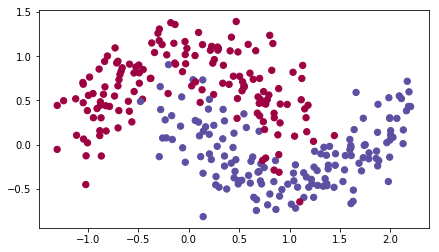

In [47]:
train_X, train_Y = load_dataset()

We have already implemented a 3-layer neural network. You will train it with: 
- Mini-batch **Gradient Descent**: it will call your function:
    - `update_parameters_with_gd()`
- Mini-batch **Momentum**: it will call your functions:
    - `initialize_velocity()` and `update_parameters_with_momentum()`
- Mini-batch **Adam**: it will call your functions:
    - `initialize_adam()` and `update_parameters_with_adam()`

In [48]:
def model(X, Y, layers_dims, optimizer, learning_rate = 0.0007, mini_batch_size = 64, beta = 0.9,
          beta1 = 0.9, beta2 = 0.999,  epsilon = 1e-8, num_epochs = 10000, print_cost = True):
    """
    3-layer neural network model which can be run in different optimizer modes.
    
    Arguments:
    X -- input data, of shape (2, number of examples)
    Y -- true "label" vector (1 for blue dot / 0 for red dot), of shape (1, number of examples)
    layers_dims -- python list, containing the size of each layer
    learning_rate -- the learning rate, scalar.
    mini_batch_size -- the size of a mini batch
    beta -- Momentum hyperparameter
    beta1 -- Exponential decay hyperparameter for the past gradients estimates 
    beta2 -- Exponential decay hyperparameter for the past squared gradients estimates 
    epsilon -- hyperparameter preventing division by zero in Adam updates
    num_epochs -- number of epochs
    print_cost -- True to print the cost every 1000 epochs

    Returns:
    parameters -- python dictionary containing your updated parameters 
    """

    L = len(layers_dims)             # number of layers in the neural networks
    costs = []                       # to keep track of the cost
    t = 0                            # initializing the counter required for Adam update
    seed = 10                        # For grading purposes, so that your "random" minibatches are the same as ours
    
    # Initialize parameters
    parameters = initialize_parameters(layers_dims)

    # Initialize the optimizer
    if optimizer == "gd":
        pass # no initialization required for gradient descent
    elif optimizer == "momentum":
        v = initialize_velocity(parameters)
    elif optimizer == "adam":
        v, s = initialize_adam(parameters)
    
    # Optimization loop
    for i in range(num_epochs):
        
        # Define the random minibatches. We increment the seed to reshuffle differently the dataset after each epoch
        seed = seed + 1
        minibatches = random_mini_batches(X, Y, mini_batch_size, seed)

        for minibatch in minibatches:

            # Select a minibatch
            (minibatch_X, minibatch_Y) = minibatch

            # Forward propagation
            a3, caches = forward_propagation(minibatch_X, parameters)

            # Compute cost
            cost = compute_cost(a3, minibatch_Y)

            # Backward propagation
            grads = backward_propagation(minibatch_X, minibatch_Y, caches)

            # Update parameters
            if optimizer == "gd":
                parameters = update_parameters_with_gd(parameters, grads, learning_rate)
            elif optimizer == "momentum":
                parameters, v = update_parameters_with_momentum(parameters, grads, v, beta, learning_rate)
            elif optimizer == "adam":
                t = t + 1 # Adam counter
                parameters, v, s = update_parameters_with_adam(parameters, grads, v, s,
                                                               t, learning_rate, beta1, beta2,  epsilon)
        
        # Print the cost every 1000 epoch
        if print_cost and i % 1000 == 0:
            print ("Cost after epoch %i: %f" %(i, cost))
        if print_cost and i % 100 == 0:
            costs.append(cost)
                
    # plot the cost
    plt.plot(costs)
    plt.ylabel('cost')
    plt.xlabel('epochs (per 100)')
    plt.title("Learning rate = " + str(learning_rate))
    plt.show()

    return parameters

You will now run this 3 layer neural network with each of the 3 optimization methods.

### 5.1 - Mini-batch Gradient descent

Run the following code to see how the model does with mini-batch gradient descent.

Cost after epoch 0: 0.690736
Cost after epoch 1000: 0.685273
Cost after epoch 2000: 0.647072
Cost after epoch 3000: 0.619525
Cost after epoch 4000: 0.576584
Cost after epoch 5000: 0.607243
Cost after epoch 6000: 0.529403
Cost after epoch 7000: 0.460768
Cost after epoch 8000: 0.465586
Cost after epoch 9000: 0.464518


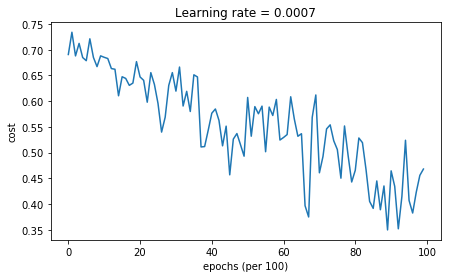

Accuracy: 0.796666666667


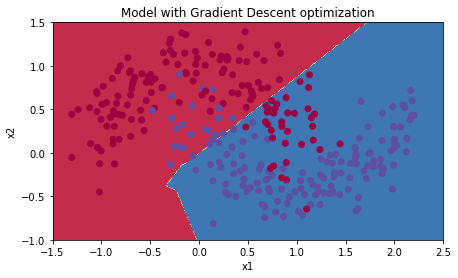

In [49]:
# train 3-layer model
layers_dims = [train_X.shape[0], 5, 2, 1]
parameters = model(train_X, train_Y, layers_dims, optimizer = "gd")

# Predict
predictions = predict(train_X, train_Y, parameters)

# Plot decision boundary
plt.title("Model with Gradient Descent optimization")
axes = plt.gca()
axes.set_xlim([-1.5,2.5])
axes.set_ylim([-1,1.5])
plot_decision_boundary(lambda x: predict_dec(parameters, x.T), train_X, train_Y)

### 5.2 - Mini-batch gradient descent with momentum

Run the following code to see how the model does with momentum. Because this example is relatively simple, the gains from using momemtum are small; but for more complex problems you might see bigger gains.

[[ 0.  0.]
 [ 0.  0.]
 [ 0.  0.]
 [ 0.  0.]
 [ 0.  0.]]
[[ 0.  0.  0.  0.  0.]
 [ 0.  0.  0.  0.  0.]]
[[ 0.  0.]]
[[-0.00249241  0.00236369]
 [ 0.00203895 -0.00221488]
 [ 0.00530742 -0.00366238]
 [ 0.00486061 -0.00433661]
 [ 0.00014225 -0.00012692]]
[[ 0.00412321  0.00772884 -0.00031029  0.00214282  0.00171705]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00261273  0.        ]]
[[-0.00428161  0.00430143]
 [ 0.00338935 -0.00351053]
 [ 0.00793828 -0.00562552]
 [ 0.00737832 -0.00683492]
 [ 0.00021594 -0.00020003]]
[[ 0.00695653  0.01227725 -0.00037011  0.00339887  0.00271769]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00391794  0.        ]]
[[-0.00562736  0.00579001]
 [ 0.00424474 -0.00445131]
 [ 0.01154274 -0.00778456]
 [ 0.00997389 -0.00860625]
 [ 0.00029189 -0.00025187]]
[[ 0.00907132  0.0155583  -0.00078983  0.00422733  0.00339431]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00456056  0.        ]]
[[-0.0050646

 [ 0.00081498 -0.00061813]]
[[ 0.02205033  0.03851588 -0.004917    0.01006292  0.00826122]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00969815  0.        ]]
[[-0.01375997  0.01446149]
 [ 0.01102888 -0.01108828]
 [ 0.0406294  -0.02343081]
 [ 0.0305512  -0.02188737]
 [ 0.00078567 -0.00062449]]
[[ 0.0220551   0.03887416 -0.0054307   0.01027062  0.00840053]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00980517  0.        ]]
[[-0.01600157  0.01657592]
 [ 0.01248022 -0.01309101]
 [ 0.04125907 -0.02534081]
 [ 0.03325911 -0.02582129]
 [ 0.00085043 -0.00073665]]
[[ 0.0257748   0.04580698 -0.00453452  0.01232905  0.01002052]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.01281092  0.        ]]
[[-0.01471164  0.01541301]
 [ 0.01206333 -0.01196263]
 [ 0.04424088 -0.02554875]
 [ 0.03345405 -0.02374024]
 [ 0.00083861 -0.00067475]]
[[ 0.02360685  0.04197271 -0.00589966  0.01111504  0.00909528]
 [ 0.          0.          0.       

 [ 0.00077318 -0.0006393 ]]
[[ 0.02178509  0.03996861 -0.00519549  0.01057389  0.00874082]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.01075099  0.        ]]
[[-0.01360768  0.0142357 ]
 [ 0.01129509 -0.01163211]
 [ 0.04139531 -0.02454297]
 [ 0.03219307 -0.0231411 ]
 [ 0.00079264 -0.00065067]]
[[ 0.02188809  0.04079656 -0.00528194  0.01076128  0.00889024]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.01118226  0.        ]]
[[-0.01349467  0.01405779]
 [ 0.01099896 -0.01130088]
 [ 0.04101256 -0.0237758 ]
 [ 0.03252761 -0.02245742]
 [ 0.00081515 -0.0006323 ]]
[[ 0.0217378   0.03963963 -0.00557749  0.01034274  0.00857681]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.01022075  0.        ]]
[[-0.01371631  0.01417129]
 [ 0.01094834 -0.01118545]
 [ 0.041349   -0.02385312]
 [ 0.03212605 -0.02227733]
 [ 0.00079199 -0.0006255 ]]
[[ 0.02215692  0.0392454  -0.0057018   0.01026819  0.0085064 ]
 [ 0.          0.          0.       

[[-0.01509003  0.01724661]
 [ 0.01111898 -0.01089711]
 [ 0.04142062 -0.02360307]
 [ 0.03275685 -0.02172164]
 [ 0.00080115 -0.00060278]]
[[ 0.02353427  0.03836089 -0.00605951  0.00979265  0.00823345]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00740846  0.        ]]
[[-0.01399267  0.01608103]
 [ 0.01064758 -0.01025587]
 [ 0.03981071 -0.02252011]
 [ 0.03072842 -0.02042281]
 [ 0.00075636 -0.00056723]]
[[ 0.02178503  0.03612988 -0.00592994  0.00920164  0.00774472]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00710793  0.        ]]
[[-0.01360168  0.0156996 ]
 [ 0.01092755 -0.01101711]
 [ 0.03983836 -0.02300544]
 [ 0.03160268 -0.02194143]
 [ 0.00079247 -0.00061132]]
[[ 0.02114462  0.03873363 -0.0056396   0.01000698  0.00838251]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00969142  0.        ]]
[[-0.01382973  0.01592461]
 [ 0.01127858 -0.01106115]
 [ 0.03930414 -0.02254769]
 [ 0.03211713 -0.02199688]
 [ 0.00081725 -0.00

[[-0.01409567  0.01646108]
 [ 0.01121465 -0.01215526]
 [ 0.03905628 -0.02384772]
 [ 0.03160466 -0.02428852]
 [ 0.0007554  -0.00066768]]
[[ 0.02184856  0.04265667 -0.00485299  0.01125236  0.00941181]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.01243943  0.        ]]
[[-0.01475596  0.01786032]
 [ 0.01113265 -0.01239592]
 [ 0.03973726 -0.02472672]
 [ 0.03047336 -0.02470233]
 [ 0.00073671 -0.00068055]]
[[ 0.02253943  0.04344878 -0.004649    0.0115687   0.00964327]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.012687  0.      ]]
[[-0.01462434  0.01747746]
 [ 0.01087801 -0.01210476]
 [ 0.04145216 -0.02499065]
 [ 0.03109999 -0.02413648]
 [ 0.00073836 -0.00066319]]
[[ 0.02245584  0.0424271  -0.0053643   0.01119552  0.00936886]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.01155228  0.        ]]
[[-0.01494362  0.01729476]
 [ 0.01097053 -0.01193107]
 [ 0.04103852 -0.02442323]
 [ 0.03206612 -0.02382085]
 [ 0.00077866 -0.000655

 [ 0.          0.          0.          0.          0.        ]]
[[-0.01176024  0.        ]]
[[-0.01449622  0.01704474]
 [ 0.01098769 -0.01154611]
 [ 0.0397586  -0.02389554]
 [ 0.0306375  -0.02309386]
 [ 0.0007356  -0.00062901]]
[[ 0.02243926  0.04062277 -0.00533643  0.01053731  0.00892635]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.01000798  0.        ]]
[[-0.01438794  0.01684774]
 [ 0.01110821 -0.01133724]
 [ 0.04078559 -0.02403365]
 [ 0.03187873 -0.02264959]
 [ 0.00078134 -0.00061779]]
[[ 0.02231556  0.0399432  -0.00578073  0.01018786  0.00868235]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00920543  0.        ]]
[[-0.01393483  0.01601938]
 [ 0.01064792 -0.01076873]
 [ 0.03926685 -0.02315046]
 [ 0.02996391 -0.02149072]
 [ 0.00073848 -0.00058666]]
[[ 0.0217624   0.0379604  -0.00556209  0.00969048  0.00825088]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00827317  0.        ]]
[[-0.01414971  0.01619765]
 [ 0.010

[[-0.0096229  0.       ]]
[[-0.01585734  0.01834755]
 [ 0.01220457 -0.01206628]
 [ 0.04250879 -0.02533569]
 [ 0.03415737 -0.02428477]
 [ 0.00080123 -0.00065304]]
[[ 0.02473802  0.04264658 -0.00600425  0.01084261  0.00931085]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00910637  0.        ]]
[[-0.01427161  0.01651279]
 [ 0.0113169  -0.01159091]
 [ 0.04116801 -0.02422015]
 [ 0.03325854 -0.0232677 ]
 [ 0.00079013 -0.00062644]]
[[ 0.02226422  0.04089958 -0.00601425  0.01035373  0.00890104]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00955672  0.        ]]
[[-0.01356507  0.01549913]
 [ 0.01040401 -0.01096936]
 [ 0.03956537 -0.02357299]
 [ 0.03036187 -0.02199533]
 [ 0.00072289 -0.00059271]]
[[ 0.02127196  0.03864039 -0.00559697  0.00985084  0.00845849]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00892378  0.        ]]
[[-0.01288397  0.01453604]
 [ 0.0099542  -0.01096613]
 [ 0.03858007 -0.02340882]
 [ 0.02934086 -0.021

 [ 0.00069258 -0.00057254]]
[[ 0.02010761  0.03770895 -0.0054977   0.00956346  0.00826414]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00896824  0.        ]]
[[-0.01266213  0.01450754]
 [ 0.00986575 -0.01037185]
 [ 0.03714903 -0.02227154]
 [ 0.02861289 -0.02081193]
 [ 0.00068486 -0.00055597]]
[[ 0.01987802  0.0365949  -0.00530824  0.00925353  0.00800757]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00843849  0.        ]]
[[-0.01445403  0.01682386]
 [ 0.01061332 -0.01090509]
 [ 0.03889051 -0.02341587]
 [ 0.02916111 -0.02181835]
 [ 0.00070889 -0.00058415]]
[[ 0.02252998  0.0385098  -0.00549246  0.00974255  0.00843115]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00780465  0.        ]]
[[-0.01400072  0.01601816]
 [ 0.01017042 -0.01040754]
 [ 0.03813491 -0.02242731]
 [ 0.02934189 -0.020951  ]
 [ 0.00069551 -0.00055886]]
[[ 0.02196517  0.03675568 -0.00571886  0.00924796  0.00804096]
 [ 0.          0.          0.       

[[ 0.02352315  0.03955088 -0.00693881  0.00966024  0.00851608]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00667795  0.        ]]
[[-0.01441461  0.01673756]
 [ 0.0108976  -0.01155283]
 [ 0.04142482 -0.02507318]
 [ 0.03142869 -0.02320538]
 [ 0.00074144 -0.00061321]]
[[ 0.02253291  0.04079707 -0.00592202  0.01025285  0.00894739]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0089761  0.       ]]
[[-0.01383619  0.01586081]
 [ 0.01037121 -0.01091781]
 [ 0.03852176 -0.02331169]
 [ 0.029396   -0.02191008]
 [ 0.0006971  -0.00057942]]
[[ 0.02172992  0.03857061 -0.00550892  0.00970398  0.00846038]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0082149  0.       ]]
[[-0.01400599  0.01648858]
 [ 0.01052494 -0.01058923]
 [ 0.04037177 -0.02390198]
 [ 0.02980499 -0.02118232]
 [ 0.00071729 -0.00056076]]
[[ 0.02176074  0.03749312 -0.00611737  0.00926757  0.00812435]
 [ 0.          0.          0.          0.          0.        ]]
[[-0

 [ 0.00072283 -0.00058162]]
[[ 0.02174365  0.03914551 -0.00616363  0.00968167  0.00855303]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00796484  0.        ]]
[[-0.01384894  0.01674214]
 [ 0.00993767 -0.01085817]
 [ 0.04011108 -0.02396841]
 [ 0.03073887 -0.02193142]
 [ 0.00069934 -0.00057107]]
[[ 0.02131727  0.03834272 -0.00609447  0.00951623  0.00841487]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00774008  0.        ]]
[[-0.01246404  0.01506792]
 [ 0.00932144 -0.00972558]
 [ 0.04036776 -0.02295446]
 [ 0.02931068 -0.01970088]
 [ 0.00067309 -0.00051297]]
[[ 0.01918554  0.03441878 -0.00687512  0.00841888  0.00749009]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00596716  0.        ]]
[[-0.01234428  0.01513337]
 [ 0.0094507  -0.00962974]
 [ 0.03992231 -0.02277052]
 [ 0.02964073 -0.01959858]
 [ 0.00066143 -0.00050764]]
[[ 0.01891851  0.03410999 -0.00675568  0.00832592  0.00742024]
 [ 0.          0.          0.       

[[ 0.02012208  0.03461948 -0.0064205   0.00849517  0.00758971]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00555829  0.        ]]
[[-0.01247053  0.01501242]
 [ 0.00907728 -0.00986054]
 [ 0.03914854 -0.023168  ]
 [ 0.02709089 -0.01990057]
 [ 0.00062448 -0.00051369]]
[[ 0.01924849  0.03489547 -0.00627144  0.00862979  0.00766724]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00637207  0.        ]]
[[-0.01245913  0.01460909]
 [ 0.00917471 -0.00960747]
 [ 0.03797236 -0.02273889]
 [ 0.02637261 -0.01936226]
 [ 0.00061425 -0.00050041]]
[[ 0.01943513  0.03404726 -0.00591518  0.00837068  0.00746012]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00590548  0.        ]]
[[-0.01270389  0.01498075]
 [ 0.00951853 -0.00980381]
 [ 0.03901578 -0.02276316]
 [ 0.02889797 -0.01995833]
 [ 0.00064188 -0.00051191]]
[[ 0.01978939  0.03476667 -0.00645047  0.00849632  0.00761229]
 [ 0.          0.          0.          0.          0.        ]]


[[-0.00506352  0.        ]]
[[-0.01394979  0.01758601]
 [ 0.01059289 -0.01081314]
 [ 0.0390828  -0.02316763]
 [ 0.03037591 -0.02192841]
 [ 0.00069249 -0.00055914]]
[[ 0.021161    0.03843079 -0.00638658  0.00935663  0.00842674]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0072157  0.       ]]
[[-0.01423692  0.01747476]
 [ 0.01121697 -0.01064892]
 [ 0.0391587  -0.02267416]
 [ 0.03164685 -0.02164889]
 [ 0.00070989 -0.00055043]]
[[ 0.02183459  0.03799371 -0.00673478  0.00911065  0.00825253]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00613132  0.        ]]
[[-0.01483992  0.01790803]
 [ 0.01138228 -0.01111192]
 [ 0.03848045 -0.02284363]
 [ 0.03203008 -0.02247754]
 [ 0.00073085 -0.00057297]]
[[ 0.02293087  0.03958223 -0.00626526  0.00950599  0.00860487]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00676931  0.        ]]
[[-0.01420062  0.01771928]
 [ 0.01108618 -0.01105634]
 [ 0.0382619  -0.02257617]
 [ 0.03129559 -0.022

[[-0.0129895   0.01720921]
 [ 0.00963986 -0.00965744]
 [ 0.03747479 -0.02124098]
 [ 0.02833213 -0.01962003]
 [ 0.00063211 -0.00049379]]
[[ 0.01929053  0.03439563 -0.00688981  0.00818801  0.0074922 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0050963  0.       ]]
[[-0.01333963  0.01743742]
 [ 0.00973574 -0.00994441]
 [ 0.03785618 -0.02153409]
 [ 0.02890657 -0.02023081]
 [ 0.00065623 -0.00051034]]
[[ 0.01995159  0.03538563 -0.0069117   0.00847016  0.00774104]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00533921  0.        ]]
[[-0.01299919  0.01676479]
 [ 0.00934939 -0.00977749]
 [ 0.03695197 -0.02089201]
 [ 0.02817413 -0.01981463]
 [ 0.00064591 -0.00050048]]
[[ 0.01955999  0.03474192 -0.00682388  0.0082857   0.0075884 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00526311  0.        ]]
[[-0.0126196   0.01626797]
 [ 0.00900588 -0.00955782]
 [ 0.03641367 -0.02072072]
 [ 0.02742634 -0.01939673]
 [ 0.00063433 -0.0004

[[-0.00433791  0.        ]]
[[-0.01240104  0.01541127]
 [ 0.00904641 -0.0091412 ]
 [ 0.03610854 -0.02001419]
 [ 0.02901284 -0.01888736]
 [ 0.0006093  -0.00046616]]
[[ 0.01898961  0.03256641 -0.00704905  0.00766315  0.00713059]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00378632  0.        ]]
[[-0.01180733  0.01561618]
 [ 0.00872865 -0.00867752]
 [ 0.03766673 -0.02074894]
 [ 0.02826878 -0.01785712]
 [ 0.00060304 -0.00044131]]
[[ 0.01760253  0.03094006 -0.00745343  0.00717164  0.00670882]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00330828  0.        ]]
[[-0.01384749  0.01735998]
 [ 0.00989814 -0.01004686]
 [ 0.03834277 -0.02198846]
 [ 0.02951661 -0.02053466]
 [ 0.000646   -0.00051028]]
[[ 0.02113684  0.03579342 -0.00704029  0.0084752   0.00784369]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00452794  0.        ]]
[[-0.01335555  0.01744076]
 [ 0.00946727 -0.01039158]
 [ 0.03690321 -0.02192568]
 [ 0.02768017 -0.0

[[-0.00251141  0.        ]]
[[-0.01324577  0.01664253]
 [ 0.00979416 -0.00921023]
 [ 0.03817254 -0.02137976]
 [ 0.02847997 -0.01886175]
 [ 0.00064161 -0.00046553]]
[[ 0.02022336  0.0329815  -0.00748974  0.00758385  0.00715289]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00245643  0.        ]]
[[-0.01315803  0.01708188]
 [ 0.00942261 -0.00920933]
 [ 0.03787628 -0.02152386]
 [ 0.02780567 -0.01890734]
 [ 0.0006079  -0.00046507]]
[[ 0.01979186  0.03290622 -0.00723169  0.00765525  0.0072007 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00294849  0.        ]]
[[-0.01228669  0.01608242]
 [ 0.00894066 -0.00974111]
 [ 0.03715566 -0.0210477 ]
 [ 0.02974688 -0.02002375]
 [ 0.00063655 -0.00049051]]
[[ 0.01842745  0.03465774 -0.0071302   0.00815511  0.00760624]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00534674  0.        ]]
[[-0.01344347  0.01679734]
 [ 0.00979026 -0.01015065]
 [ 0.03660081 -0.02103358]
 [ 0.03025977 -0.0

[[-0.01306041  0.01640278]
 [ 0.00962275 -0.00959646]
 [ 0.03617783 -0.0207288 ]
 [ 0.02840036 -0.01968361]
 [ 0.00060787 -0.00047852]]
[[ 0.01996759  0.03431402 -0.00692552  0.00795437  0.00751955]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00388001  0.        ]]
[[-0.01175437  0.0147625 ]
 [ 0.00845877 -0.00873432]
 [ 0.03410374 -0.01972114]
 [ 0.02515599 -0.01791069]
 [ 0.00053707 -0.00043551]]
[[ 0.01797083  0.03115822 -0.00641764  0.00726528  0.00686959]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00351504  0.        ]]
[[-0.01113417  0.01379772]
 [ 0.0082859  -0.00813888]
 [ 0.03367477 -0.01864905]
 [ 0.02666749 -0.01683999]
 [ 0.00055945 -0.00040754]]
[[ 0.01711405  0.02911315 -0.0068457   0.00661349  0.00633594]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00233513  0.        ]]
[[-0.01239614  0.0154593 ]
 [ 0.0091409  -0.0093507 ]
 [ 0.03550049 -0.02037797]
 [ 0.02816442 -0.01930876]
 [ 0.00058708 -0.00

[[-0.00178659  0.        ]]
[[-0.0130244   0.0171267 ]
 [ 0.00940073 -0.00959097]
 [ 0.03715341 -0.02149134]
 [ 0.02770619 -0.01965914]
 [ 0.00059134 -0.00047312]]
[[ 0.01951536  0.03430729 -0.00714199  0.00792189  0.00753749]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00383661  0.        ]]
[[-0.01262051  0.01660716]
 [ 0.00902984 -0.00938765]
 [ 0.03586505 -0.0204807 ]
 [ 0.02736355 -0.01929026]
 [ 0.00059167 -0.00046492]]
[[ 0.01893058  0.03354723 -0.00703299  0.00776183  0.00739064]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00382193  0.        ]]
[[-0.01327988  0.01696846]
 [ 0.00932389 -0.009849  ]
 [ 0.03620569 -0.0210404 ]
 [ 0.02781924 -0.0202662 ]
 [ 0.00059139 -0.00048731]]
[[ 0.02018056  0.03517315 -0.00687309  0.00823564  0.0077966 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0042848  0.       ]]
[[-0.01333204  0.01705914]
 [ 0.0093156  -0.00997778]
 [ 0.0351212  -0.02107717]
 [ 0.02689419 -0.020

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00352475  0.        ]]
[[-0.01301804  0.01617372]
 [ 0.00934468 -0.00941935]
 [ 0.03562987 -0.01990737]
 [ 0.02789652 -0.0193645 ]
 [ 0.00059636 -0.0004615 ]]
[[ 0.02004762  0.03376128 -0.00741626  0.00768923  0.0074002 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00273773  0.        ]]
[[-0.01284258  0.01577667]
 [ 0.00924157 -0.00992886]
 [ 0.03695993 -0.02109428]
 [ 0.02766185 -0.02040467]
 [ 0.00059861 -0.00048745]]
[[ 0.01988166  0.03550005 -0.00742562  0.0082771   0.0078726 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00415365  0.        ]]
[[-0.01316031  0.01531428]
 [ 0.0096461  -0.00998624]
 [ 0.03673646 -0.02108582]
 [ 0.02757137 -0.02047923]
 [ 0.00060354 -0.00048992]]
[[ 0.02084904  0.03575338 -0.00730482  0.00828526  0.00791002]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0037554  0.       ]]
[[-0.01262429  0.01560499]
 [ 0.00901

 [ 0.00057678 -0.00047149]]
[[ 0.01925515  0.03467075 -0.00726805  0.00801175  0.00770129]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00397159  0.        ]]
[[-0.01206479  0.01412339]
 [ 0.00876536 -0.00945525]
 [ 0.03701844 -0.02093696]
 [ 0.02744088 -0.01955246]
 [ 0.00057178 -0.0004603 ]]
[[ 0.01909183  0.03382996 -0.00768667  0.00777164  0.00750498]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00320205  0.        ]]
[[-0.01293976  0.01568044]
 [ 0.00919768 -0.00980186]
 [ 0.03664827 -0.02062076]
 [ 0.02831    -0.02016553]
 [ 0.00060113 -0.00047578]]
[[ 0.02019878  0.03507966 -0.00764924  0.00798154  0.00774143]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00331233  0.        ]]
[[-0.01295502  0.01631434]
 [ 0.00931549 -0.00972892]
 [ 0.03601244 -0.02041994]
 [ 0.02835659 -0.02007145]
 [ 0.00059117 -0.00047205]]
[[ 0.01990169  0.03484788 -0.00741567  0.00792483  0.00769069]
 [ 0.          0.          0.       

[[-0.00411832  0.        ]]
[[-0.01258755  0.01536893]
 [ 0.00927006 -0.01029288]
 [ 0.03716436 -0.02178589]
 [ 0.02867528 -0.02129637]
 [ 0.00059718 -0.00049724]]
[[ 0.01960065  0.03682583 -0.00733744  0.00849597  0.00822573]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00519371  0.        ]]
[[-0.01280835  0.01528465]
 [ 0.00927097 -0.01017462]
 [ 0.03793168 -0.02228627]
 [ 0.02768428 -0.02100909]
 [ 0.00058195 -0.0004912 ]]
[[ 0.02011736  0.0364289  -0.00748466  0.00842962  0.00814103]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00432413  0.        ]]
[[-0.01354056  0.01740307]
 [ 0.00964698 -0.01024188]
 [ 0.03756235 -0.02183231]
 [ 0.02852038 -0.02106244]
 [ 0.0006092  -0.00049315]]
[[ 0.02060479  0.03673207 -0.00753629  0.00838104  0.00813201]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00392897  0.        ]]
[[-0.0126695   0.01560952]
 [ 0.00925415 -0.00977853]
 [ 0.03626683 -0.02071134]
 [ 0.02855249 -0.0

[[ 0.02063408  0.03363687 -0.00741548  0.00744496  0.00739924]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00171084  0.        ]]
[[-0.01310897  0.01616223]
 [ 0.00973323 -0.01001587]
 [ 0.03825643 -0.02209951]
 [ 0.02845556 -0.02073807]
 [ 0.00058238 -0.00047691]]
[[ 0.02036815  0.03603021 -0.00794871  0.00812181  0.00798739]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00318852  0.        ]]
[[-0.01189518  0.01465606]
 [ 0.00882054 -0.009083  ]
 [ 0.03723516 -0.0207255 ]
 [ 0.02837763 -0.01896467]
 [ 0.00056679 -0.00043414]]
[[ 0.01850284  0.03266109 -0.00822328  0.00724236  0.00720709]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00186079  0.        ]]
[[-0.01160034  0.0143137 ]
 [ 0.00846674 -0.00889407]
 [ 0.03900934 -0.02185044]
 [ 0.02739118 -0.01861809]
 [ 0.00053514 -0.00042481]]
[[ 0.01805896  0.03192917 -0.00855376  0.00712132  0.00708646]
 [ 0.          0.          0.          0.          0.        ]]


[[-0.01254092  0.01732349]
 [ 0.00874853 -0.00851448]
 [ 0.03595798 -0.01962638]
 [ 0.02810214 -0.01775373]
 [ 0.0005503  -0.00040243]]
[[ 0.01850459  0.03071259 -0.00829546  0.0065857   0.00672211]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00037838  0.        ]]
[[-0.01205592  0.0166531 ]
 [ 0.00849266 -0.00819693]
 [ 0.0375085  -0.02044801]
 [ 0.02751331 -0.01702472]
 [ 0.0005465  -0.00038631]]
[[ 0.01780381  0.02957258 -0.00870033  0.00624341  0.00642114]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00036293  0.        ]]
[[-0.01378694  0.01799421]
 [ 0.00964243 -0.01022399]
 [ 0.03617609 -0.02133717]
 [ 0.02882669 -0.02111062]
 [ 0.00058557 -0.00048115]]
[[ 0.02092009  0.0367673  -0.00737544  0.0082127   0.00817328]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00345485  0.        ]]
[[-0.01284544  0.01803706]
 [ 0.00867819 -0.00920159]
 [ 0.03606522 -0.02086862]
 [ 0.02681588 -0.01905285]
 [ 0.00054711 -0.00

[[-0.00400899  0.        ]]
[[-0.01317842  0.01663664]
 [ 0.00926104 -0.01014059]
 [ 0.0339213  -0.02091212]
 [ 0.02581026 -0.0209621 ]
 [ 0.00052438 -0.0004724 ]]
[[ 0.02034411  0.03649783 -0.00651688  0.00831825  0.00822395]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00428492  0.        ]]
[[-0.0117043   0.01426378]
 [ 0.0085028  -0.00927755]
 [ 0.03298506 -0.0197895 ]
 [ 0.02526401 -0.01924431]
 [ 0.00051822 -0.00043377]]
[[ 0.01835211  0.03337767 -0.00667306  0.00749294  0.00748542]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00331434  0.        ]]
[[-0.012072    0.01509022]
 [ 0.00867653 -0.00905179]
 [ 0.03526037 -0.02041996]
 [ 0.02653886 -0.01893114]
 [ 0.00051388 -0.00042294]]
[[ 0.01872929  0.03261349 -0.00759439  0.00720994  0.00728308]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00190418  0.        ]]
[[-0.01376682  0.01883698]
 [ 0.00917374 -0.00971433]
 [ 0.03647947 -0.02115438]
 [ 0.02815328 -0.0

[[ 0.01990525  0.0340033  -0.00838959  0.00729555  0.00748141]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00123144  0.        ]]
[[-0.0131931   0.01800955]
 [ 0.00879644 -0.00956094]
 [ 0.03657912 -0.02161386]
 [ 0.02826711 -0.01995966]
 [ 0.00053687 -0.00044045]]
[[ 0.01968709  0.03442228 -0.00775223  0.00750432  0.00768265]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00202526  0.        ]]
[[-0.01249357  0.01749222]
 [ 0.00855651 -0.00874005]
 [ 0.03598929 -0.02004414]
 [ 0.0292998  -0.0183087 ]
 [ 0.00055241 -0.00040213]]
[[ 0.01839588  0.03154428 -0.00837065  0.00659222  0.00690021]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00036944  0.        ]]
[[-0.01280106  0.01680157]
 [ 0.00884569 -0.00964222]
 [ 0.03695525 -0.02132774]
 [ 0.02877156 -0.02007168]
 [ 0.00054967 -0.00044336]]
[[ 0.01945189  0.03471733 -0.0081365   0.00754038  0.00772028]
 [ 0.          0.          0.          0.          0.        ]]


[[-0.01180259  0.01637924]
 [ 0.00868598 -0.00913761]
 [ 0.0378486  -0.02264994]
 [ 0.02747055 -0.01921725]
 [ 0.00050418 -0.00041669]]
[[ 0.01750115  0.0330301  -0.00805003  0.00717335  0.00737393]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00218499  0.        ]]
[[-0.01415991  0.01893437]
 [ 0.009867   -0.01026309]
 [ 0.03967004 -0.02303458]
 [ 0.03074157 -0.0214879 ]
 [ 0.00058703 -0.00046787]]
[[ 0.02132468  0.03713566 -0.00884488  0.00801289  0.00824491]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00170354  0.        ]]
[[-0.01429548  0.0201957 ]
 [ 0.00955081 -0.00995279]
 [ 0.03880472 -0.02275843]
 [ 0.02985998 -0.02082355]
 [ 0.00057687 -0.00045394]]
[[ 0.02094982  0.03600354 -0.00852815  0.00774688  0.00798708]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00142375  0.        ]]
[[-0.01311442  0.01933966]
 [ 0.00906374 -0.00892008]
 [ 0.03858894 -0.02204641]
 [ 0.02792286 -0.01861125]
 [ 0.00054041 -0.00

[[ 0.01897743  0.03331385 -0.0085866   0.00723016  0.00749372]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00066321  0.        ]]
[[-0.01335554  0.01957221]
 [ 0.00899812 -0.00915886]
 [ 0.0375937  -0.02165018]
 [ 0.02884137 -0.01921947]
 [ 0.00053845 -0.00041285]]
[[ 0.01923078  0.0332146  -0.00862308  0.00699718  0.00733225]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00032067  0.        ]]
[[-0.01336493  0.02041638]
 [ 0.00895093 -0.00885102]
 [ 0.03884283 -0.02216667]
 [ 0.02854089 -0.01859969]
 [ 0.00052287 -0.00039885]]
[[ 0.01878156  0.03213901 -0.00907309  0.0067385   0.00707921]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00055289  0.        ]]
[[-0.01391308  0.02015351]
 [ 0.00930751 -0.00983347]
 [ 0.03730696 -0.02270992]
 [ 0.02825794 -0.02057599]
 [ 0.00052675 -0.00044277]]
[[ 0.02011718  0.03561547 -0.00782602  0.00773471  0.00796353]
 [ 0.          0.          0.          0.          0.        ]]


 [ 0.          0.          0.          0.          0.        ]]
[[-0.00136436  0.        ]]
[[-0.01315582  0.01998933]
 [ 0.00861056 -0.00929145]
 [ 0.03516235 -0.02065122]
 [ 0.02782499 -0.01946195]
 [ 0.00052381 -0.0004149 ]]
[[ 0.01860897  0.03361901 -0.00791166  0.00710803  0.00749738]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00145124  0.        ]]
[[-0.01210992  0.0184465 ]
 [ 0.00803068 -0.0093006 ]
 [ 0.0357041  -0.02181483]
 [ 0.02643566 -0.01946489]
 [ 0.00050147 -0.00041545]]
[[ 0.017126    0.03358004 -0.00754881  0.007279    0.00755449]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00292898  0.        ]]
[[-0.01217274  0.01966286]
 [ 0.00778824 -0.00906251]
 [ 0.03600944 -0.02183816]
 [ 0.02580648 -0.01899578]
 [ 0.00049476 -0.00040576]]
[[ 0.01664284  0.03268632 -0.00770858  0.00705728  0.00736908]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00246089  0.        ]]
[[-0.01239421  0.01854827]
 [ 0.008

[[-0.01183699  0.01755588]
 [ 0.00788321 -0.00800235]
 [ 0.03478324 -0.0200837 ]
 [ 0.02450585 -0.01685067]
 [ 0.00044905 -0.00035492]]
[[ 0.01696641  0.02907984 -0.00819585  0.0060703   0.00646495]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00096937  0.        ]]
[[-0.01118879  0.01724619]
 [ 0.00793066 -0.00740803]
 [ 0.03582379 -0.0199163 ]
 [ 0.02472411 -0.01555174]
 [ 0.00046121 -0.00032768]]
[[ 0.01570056  0.0270471  -0.00893503  0.00542435  0.00588016]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00229928  0.        ]]
[[-0.01162467  0.01791865]
 [ 0.00801271 -0.00829521]
 [ 0.03587562 -0.02056441]
 [ 0.02497678 -0.0173697 ]
 [ 0.00047203 -0.00036782]]
[[ 0.01632572  0.03011117 -0.00854181  0.00627965  0.00669086]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00019105  0.        ]]
[[-0.01166127  0.01758808]
 [ 0.0077754  -0.00843228]
 [ 0.03568905 -0.02062051]
 [ 0.02456703 -0.01771455]
 [ 0.00044969 -0.00

[[-0.01166179  0.01775026]
 [ 0.00757794 -0.00838596]
 [ 0.03632037 -0.02125539]
 [ 0.02514845 -0.01768499]
 [ 0.00045506 -0.00036915]]
[[ 0.01651861  0.03040515 -0.0084539   0.00643152  0.00680589]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00011491  0.        ]]
[[-0.01247184  0.01801327]
 [ 0.00845273 -0.00891687]
 [ 0.03546487 -0.02082781]
 [ 0.02720971 -0.01882136]
 [ 0.00048107 -0.00039223]]
[[ 0.01816861  0.03236639 -0.00813747  0.00678654  0.00723633]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00075422  0.        ]]
[[-0.0117641   0.01670887]
 [ 0.00858473 -0.00823946]
 [ 0.0362161  -0.02035938]
 [ 0.02813012 -0.01752347]
 [ 0.00049393 -0.0003635 ]]
[[ 0.01727545  0.03006388 -0.00890394  0.00611419  0.00661449]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00079137  0.        ]]
[[-0.01138537  0.01652263]
 [ 0.00806937 -0.00773237]
 [ 0.03843582 -0.0207764 ]
 [ 0.02870354 -0.01649253]
 [ 0.00049677 -0.00

[[-0.01288779  0.01921614]
 [ 0.00855798 -0.00845196]
 [ 0.03565164 -0.02046987]
 [ 0.02635027 -0.01779666]
 [ 0.00048496 -0.00036965]]
[[ 0.01840747  0.03081318 -0.00857252  0.00628541  0.00680996]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00112181  0.        ]]
[[-0.0118768   0.01841378]
 [ 0.00770219 -0.00760676]
 [ 0.03597524 -0.02020646]
 [ 0.024637   -0.01610508]
 [ 0.00043647 -0.00033268]]
[[ 0.01658197  0.02773186 -0.00898198  0.0056351   0.00612896]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00234647  0.        ]]
[[-0.01174978  0.01857231]
 [ 0.00806574 -0.00746603]
 [ 0.03650631 -0.02046846]
 [ 0.02532841 -0.0157939 ]
 [ 0.00045919 -0.00032675]]
[[ 0.01622208  0.02731415 -0.00913863  0.00541587  0.0059616 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00250606  0.        ]]
[[-0.01246412  0.01879144]
 [ 0.00849029 -0.00865169]
 [ 0.03736436 -0.02164946]
 [ 0.02616889 -0.01826353]
 [ 0.00046683 -0.00

 [ 0.00045202 -0.00035977]]
[[ 0.01589621  0.03007372 -0.0083387   0.00629267  0.00672261]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00013374  0.        ]]
[[-0.0107069   0.01695318]
 [ 0.00733708 -0.0078856 ]
 [ 0.03632818 -0.02069144]
 [ 0.02492388 -0.01672745]
 [ 0.00043519 -0.00034278]]
[[ 0.01486629  0.02865702 -0.00895137  0.00590708  0.00639548]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00046435  0.        ]]
[[-0.01260223  0.01832227]
 [ 0.00839758 -0.00895076]
 [ 0.03699081 -0.02174885]
 [ 0.02614759 -0.01889406]
 [ 0.00046923 -0.00038864]]
[[ 0.0183204   0.03257382 -0.00870562  0.00684249  0.00730302]
 [ 0.          0.          0.          0.          0.        ]]
[[ -6.96745310e-06   0.00000000e+00]]
[[-0.01291564  0.01828948]
 [ 0.00906436 -0.00900842]
 [ 0.03764942 -0.02180652]
 [ 0.02757325 -0.01906593]
 [ 0.00048743 -0.00039095]]
[[ 0.01905506  0.03289654 -0.00905603  0.00678535  0.00731744]
 [ 0.          0.         

[[ 0.01758687  0.03235735 -0.00834218  0.00679994  0.00727879]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00044745  0.        ]]
[[-0.0114226   0.01731474]
 [ 0.00788211 -0.00825333]
 [ 0.03365547 -0.01915451]
 [ 0.02581225 -0.01753556]
 [ 0.00045161 -0.00035652]]
[[ 0.01626578  0.03008537 -0.00840314  0.00621674  0.00670898]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00027999  0.        ]]
[[-0.01339977  0.01938958]
 [ 0.00902722 -0.00916716]
 [ 0.03266979 -0.01880507]
 [ 0.02724071 -0.01938902]
 [ 0.00048949 -0.00039558]]
[[ 0.01949183  0.03348319 -0.00799333  0.00695891  0.00746985]
 [ 0.          0.          0.          0.          0.        ]]
[[ -9.25390565e-05   0.00000000e+00]]
[[-0.01247793  0.01857799]
 [ 0.00857477 -0.00840468]
 [ 0.03290372 -0.01831013]
 [ 0.02638832 -0.01773183]
 [ 0.0004793  -0.00036185]]
[[ 0.01788058  0.03075184 -0.00846082  0.00622627  0.00677062]
 [ 0.          0.          0.          0.          0. 

 [ 0.00046842 -0.00034105]]
[[ 0.01700213  0.02918516 -0.00942244  0.00572197  0.00642148]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00264808  0.        ]]
[[-0.01124164  0.01726816]
 [ 0.00774347 -0.00812151]
 [ 0.03436274 -0.01929921]
 [ 0.02565932 -0.01722652]
 [ 0.00045224 -0.00034733]]
[[ 0.01591023  0.02963539 -0.00888745  0.00601652  0.00659337]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00091676  0.        ]]
[[-0.0124631   0.01796136]
 [ 0.00814077 -0.00887677]
 [ 0.0350975  -0.02007508]
 [ 0.02552874 -0.01876183]
 [ 0.00045683 -0.00037924]]
[[ 0.01826727  0.03230355 -0.00886019  0.00668077  0.00727425]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00060049  0.        ]]
[[-0.0116761   0.01814878]
 [ 0.00753569 -0.00789662]
 [ 0.03300145 -0.01814448]
 [ 0.02510611 -0.01674406]
 [ 0.00043915 -0.0003366 ]]
[[ 0.01639181  0.02878543 -0.00876455  0.00577075  0.0063885 ]
 [ 0.          0.          0.       

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00119176  0.        ]]
[[-0.01064332  0.01675721]
 [ 0.00661385 -0.0077574 ]
 [ 0.03236562 -0.01814448]
 [ 0.02344515 -0.0164354 ]
 [ 0.00040518 -0.00032736]]
[[ 0.01491694  0.02812988 -0.00851052  0.0056751   0.00633081]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00077757  0.        ]]
[[-0.01026159  0.01565938]
 [ 0.0066602  -0.00728433]
 [ 0.03415706 -0.01833386]
 [ 0.02422677 -0.01549119]
 [ 0.0004278  -0.00030875]]
[[ 0.01461247  0.02651607 -0.00951126  0.00520112  0.00588022]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0026423  0.       ]]
[[-0.01174362  0.0180918 ]
 [ 0.00724082 -0.00781765]
 [ 0.03368341 -0.01820315]
 [ 0.02607374 -0.01674632]
 [ 0.00043746 -0.00033095]]
[[ 0.01657174  0.02850404 -0.00929835  0.00567489  0.00634935]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00253939  0.        ]]
[[-0.01104314  0.01616381]
 [ 0.00755

 [ 0.0004559  -0.00035238]]
[[ 0.01793437  0.03085481 -0.00897312  0.0061019   0.0068645 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00177959  0.        ]]
[[-0.01172563  0.0177843 ]
 [ 0.00754536 -0.00810802]
 [ 0.03463212 -0.01929152]
 [ 0.02548402 -0.01729846]
 [ 0.00043454 -0.00033967]]
[[ 0.01676358  0.02959381 -0.0093561   0.005896    0.00662775]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00222833  0.        ]]
[[-0.01210024  0.01831235]
 [ 0.00787734 -0.0080219 ]
 [ 0.03551698 -0.01937748]
 [ 0.02687259 -0.01725692]
 [ 0.00043631 -0.00033587]]
[[ 0.01726763  0.02939066 -0.00986793  0.00581705  0.00654243]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00328063  0.        ]]
[[-0.01195915  0.01841568]
 [ 0.00756    -0.00781963]
 [ 0.03404139 -0.01876409]
 [ 0.02522963 -0.01674688]
 [ 0.00041226 -0.00032725]]
[[ 0.01689765  0.02860913 -0.00933598  0.00571027  0.00640126]
 [ 0.          0.          0.       

[[ 0.01671556  0.02871537 -0.00941564  0.00561193  0.00642256]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00273479  0.        ]]
[[-0.01186864  0.01752647]
 [ 0.00762108 -0.00780661]
 [ 0.03447213 -0.01910222]
 [ 0.0245351  -0.01668064]
 [ 0.00043083 -0.00032487]]
[[ 0.01718881  0.0286092  -0.00948656  0.00562341  0.00639601]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00365195  0.        ]]
[[-0.0116146   0.01719056]
 [ 0.00782461 -0.00847247]
 [ 0.03452892 -0.0197941 ]
 [ 0.02485793 -0.01812763]
 [ 0.00042749 -0.00035191]]
[[ 0.0168634   0.03101808 -0.00907343  0.00633865  0.00701494]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00099729  0.        ]]
[[-0.01098716  0.01596344]
 [ 0.00737323 -0.00792052]
 [ 0.03350666 -0.01899221]
 [ 0.02483508 -0.01699964]
 [ 0.00041408 -0.00032921]]
[[ 0.01609562  0.02896465 -0.00893624  0.00580069  0.00653161]
 [ 0.          0.          0.          0.          0.        ]]


[[-0.00961871  0.01508958]
 [ 0.00638961 -0.00730141]
 [ 0.0352905  -0.02071662]
 [ 0.02295879 -0.01570084]
 [ 0.0003682  -0.00029896]]
[[ 0.01360425  0.0266242  -0.00919269  0.00526125  0.00602177]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00190486  0.        ]]
[[-0.00979793  0.01581378]
 [ 0.00666108 -0.00695346]
 [ 0.03499809 -0.02009955]
 [ 0.02257212 -0.01493222]
 [ 0.00036846 -0.00028463]]
[[ 0.01357473  0.02548347 -0.00944303  0.00494505  0.00569634]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00329367  0.        ]]
[[-0.01017527  0.01686308]
 [ 0.00639852 -0.00685339]
 [ 0.03319961 -0.01957381]
 [ 0.02116119 -0.01468735]
 [ 0.00034804 -0.0002804 ]]
[[ 0.01381252  0.0250731  -0.00867878  0.00492053  0.00564374]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00298998  0.        ]]
[[-0.00969109  0.01566807]
 [ 0.00607542 -0.00645983]
 [ 0.03396084 -0.0193409 ]
 [ 0.02210142 -0.01398667]
 [ 0.00035794 -0.00

[[-0.00957797  0.01592447]
 [ 0.00622834 -0.00729396]
 [ 0.03577172 -0.02108994]
 [ 0.0216178  -0.01571355]
 [ 0.00034517 -0.00029708]]
[[ 0.01306912  0.02662364 -0.00946457  0.00539921  0.00608675]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0019724  0.       ]]
[[-0.00892178  0.01481297]
 [ 0.00593607 -0.00699746]
 [ 0.03377282 -0.02009517]
 [ 0.02107103 -0.01501396]
 [ 0.00034172 -0.00028414]]
[[ 0.01220523  0.02550723 -0.00879738  0.00506743  0.00579638]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00170819  0.        ]]
[[-0.00993521  0.01498334]
 [ 0.00656674 -0.00770804]
 [ 0.03542688 -0.02145829]
 [ 0.02243911 -0.01656125]
 [ 0.000357   -0.00031269]]
[[ 0.01444205  0.02809651 -0.00898584  0.00562106  0.0064213 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00136282  0.        ]]
[[-0.01082879  0.01865613]
 [ 0.00718389 -0.00735074]
 [ 0.0351264  -0.02017103]
 [ 0.02402771 -0.01579815]
 [ 0.00039498 -0.0002

[[ 0.00251074  0.        ]]
[[-0.01003407  0.01610272]
 [ 0.00674382 -0.00725453]
 [ 0.03664612 -0.02149706]
 [ 0.02331712 -0.0156512 ]
 [ 0.00037221 -0.00029277]]
[[ 0.01399722  0.0266015  -0.00986399  0.00515542  0.00598155]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00332587  0.        ]]
[[-0.01034514  0.01738898]
 [ 0.0066092  -0.00720445]
 [ 0.03697096 -0.02168591]
 [ 0.02212075 -0.01550668]
 [ 0.00035664 -0.00029058]]
[[ 0.01402156  0.02639179 -0.00994195  0.0051592   0.00596491]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00347796  0.        ]]
[[-0.01077337  0.01776838]
 [ 0.00689799 -0.00713117]
 [ 0.03598965 -0.02059303]
 [ 0.02345096 -0.01542161]
 [ 0.00037419 -0.00028779]]
[[ 0.01471973  0.02621251 -0.00998633  0.00504541  0.00586465]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00414568  0.        ]]
[[-0.0108831   0.01710705]
 [ 0.00683049 -0.00781291]
 [ 0.03630539 -0.02150909]
 [ 0.02339578 -0.0

[[ 0.01479121  0.02786327 -0.00969242  0.00542008  0.00628458]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0029415  0.       ]]
[[-0.01009547  0.01683821]
 [ 0.00648393 -0.00711445]
 [ 0.03488415 -0.0202646 ]
 [ 0.02334411 -0.0154949 ]
 [ 0.00034633 -0.00028438]]
[[ 0.01375539  0.02610409 -0.00960937  0.00508918  0.00590527]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0034689  0.       ]]
[[-0.00988963  0.01599672]
 [ 0.00660105 -0.00685692]
 [ 0.03446727 -0.01942907]
 [ 0.02345866 -0.01495294]
 [ 0.0003579  -0.00027495]]
[[ 0.0137369   0.02523097 -0.00982471  0.00482797  0.00566055]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00400826  0.        ]]
[[-0.00899834  0.01450774]
 [ 0.00581646 -0.00642535]
 [ 0.0343314  -0.01922843]
 [ 0.02176639 -0.01395583]
 [ 0.00033443 -0.00025685]]
[[ 0.01254873  0.02351751 -0.00985853  0.00443115  0.00528594]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0

 [ 0.00036259 -0.00028974]]
[[ 0.01414356  0.0267266  -0.00962116  0.00513048  0.00605135]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00335487  0.        ]]
[[-0.00993582  0.01550792]
 [ 0.00667909 -0.0070908 ]
 [ 0.03510339 -0.02018107]
 [ 0.02207549 -0.01527517]
 [ 0.00035712 -0.0002816 ]]
[[ 0.0141329   0.02606353 -0.00990974  0.00497743  0.0058722 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00395638  0.        ]]
[[-0.00946808  0.01595573]
 [ 0.00590575 -0.00652245]
 [ 0.03620461 -0.02086625]
 [ 0.02118384 -0.01414856]
 [ 0.00033202 -0.0002593 ]]
[[ 0.01284154  0.02389052 -0.01024176  0.00452378  0.00539933]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00490821  0.        ]]
[[-0.0093474   0.01625613]
 [ 0.00568242 -0.00663084]
 [ 0.03529497 -0.0207538 ]
 [ 0.02158843 -0.01435274]
 [ 0.00034595 -0.00026361]]
[[ 0.0124756   0.02419916 -0.00964703  0.00453381  0.00547146]
 [ 0.          0.          0.       

[[-0.0098781   0.01659228]
 [ 0.00685086 -0.00742083]
 [ 0.03815774 -0.02181239]
 [ 0.02535245 -0.01620566]
 [ 0.00037554 -0.00029152]]
[[ 0.01348484  0.02726654 -0.01094496  0.00509073  0.0061402 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00378585  0.        ]]
[[-0.0107688   0.01772196]
 [ 0.00710291 -0.00777163]
 [ 0.03636333 -0.0213134 ]
 [ 0.02486134 -0.01685882]
 [ 0.00037457 -0.00030503]]
[[ 0.01487109  0.02852776 -0.01007815  0.00541065  0.0064666 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00294871  0.        ]]
[[-0.01044831  0.01635099]
 [ 0.00693135 -0.00766027]
 [ 0.03574966 -0.02093117]
 [ 0.02430286 -0.01659744]
 [ 0.00037269 -0.00030082]]
[[ 0.01492861  0.02809818 -0.00992316  0.00532012  0.00637107]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00319485  0.        ]]
[[-0.01032547  0.01573778]
 [ 0.00654263 -0.00760368]
 [ 0.03586055 -0.02097747]
 [ 0.0238413  -0.01638391]
 [ 0.00037175 -0.00

[[ 0.00587175  0.        ]]
[[-0.00942931  0.0145773 ]
 [ 0.00606995 -0.00660031]
 [ 0.03695952 -0.02127587]
 [ 0.02174471 -0.01429339]
 [ 0.00032863 -0.00025606]]
[[ 0.01353454  0.0242684  -0.01070702  0.00448806  0.0054535 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00578359  0.        ]]
[[-0.00911953  0.01382131]
 [ 0.00592721 -0.00710036]
 [ 0.03599937 -0.02173355]
 [ 0.02138382 -0.01537195]
 [ 0.00032888 -0.00027625]]
[[ 0.01321694  0.02604582 -0.00983168  0.00507368  0.00594627]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00353137  0.        ]]
[[-0.00976477  0.01583571]
 [ 0.00663432 -0.00712672]
 [ 0.03659069 -0.02143651]
 [ 0.0227434  -0.01548136]
 [ 0.00034626 -0.00027711]]
[[ 0.01360589  0.02626355 -0.01034157  0.00497359  0.00592817]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00420261  0.        ]]
[[-0.01015925  0.01667583]
 [ 0.00655836 -0.00711821]
 [ 0.03713857 -0.02158512]
 [ 0.02294894 -0.0

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00510889  0.        ]]
[[-0.00948928  0.01343717]
 [ 0.00651317 -0.00755793]
 [ 0.03592308 -0.02189727]
 [ 0.0221189  -0.01635896]
 [ 0.00033714 -0.00029135]]
[[ 0.01426245  0.02780074 -0.00983351  0.00545057  0.00635962]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00264149  0.        ]]
[[-0.00904161  0.01289024]
 [ 0.00617442 -0.00736632]
 [ 0.03625808 -0.02261907]
 [ 0.02146122 -0.01600522]
 [ 0.00031541 -0.00028384]]
[[ 0.01359383  0.02700878 -0.00962827  0.00526866  0.00622407]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00274761  0.        ]]
[[-0.01037494  0.01675373]
 [ 0.00666728 -0.00747342]
 [ 0.03761736 -0.02276141]
 [ 0.02257685 -0.01615796]
 [ 0.00034279 -0.00028713]]
[[ 0.01447011  0.02750434 -0.01038135  0.0052373   0.00624438]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00404224  0.        ]]
[[-0.00991815  0.01593866]
 [ 0.006

 [ 0.00034177 -0.0002894 ]]
[[ 0.0149927   0.02789418 -0.00970104  0.00528618  0.00637281]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00367968  0.        ]]
[[-0.01072061  0.01632656]
 [ 0.00680111 -0.0077767 ]
 [ 0.03490939 -0.02225485]
 [ 0.02190264 -0.0168289 ]
 [ 0.00033637 -0.00029663]]
[[ 0.01561037  0.02858999 -0.00902369  0.00547687  0.00656546]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00312532  0.        ]]
[[-0.01077524  0.01670206]
 [ 0.00682419 -0.00763603]
 [ 0.03542255 -0.02275145]
 [ 0.0212071  -0.01650004]
 [ 0.00032941 -0.00029114]]
[[ 0.01554531  0.02806109 -0.00905025  0.00531187  0.00644491]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00350923  0.        ]]
[[-0.01101246  0.01640698]
 [ 0.00674539 -0.00774851]
 [ 0.03592964 -0.02294422]
 [ 0.0211958  -0.01676286]
 [ 0.00033412 -0.00029617]]
[[ 0.01621154  0.02843752 -0.00931474  0.00542079  0.00656044]
 [ 0.          0.          0.       

[[-0.01060439  0.01681376]
 [ 0.00679055 -0.00777966]
 [ 0.03792219 -0.02314806]
 [ 0.02352061 -0.01687928]
 [ 0.00035569 -0.00029338]]
[[ 0.01502236  0.02867554 -0.01062062  0.00538786  0.00652166]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0036004  0.       ]]
[[-0.00998213  0.0158311 ]
 [ 0.00679473 -0.0073746 ]
 [ 0.03648471 -0.02241563]
 [ 0.02271503 -0.01593129]
 [ 0.00034578 -0.00027805]]
[[ 0.01417361  0.02721791 -0.01011883  0.00503306  0.00615964]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00418834  0.        ]]
[[-0.01006852  0.01619329]
 [ 0.00697853 -0.00782056]
 [ 0.03654281 -0.02264532]
 [ 0.02312612 -0.01683767]
 [ 0.0003574  -0.00029498]]
[[ 0.01415951  0.02886012 -0.01000889  0.0054761   0.00656078]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00262149  0.        ]]
[[-0.0097182   0.01524001]
 [ 0.0071443  -0.00733382]
 [ 0.03736947 -0.02207944]
 [ 0.02427919 -0.01595383]
 [ 0.00035409 -0.0002

[[ 0.01304903  0.02599807 -0.01032241  0.00474645  0.00591097]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00395804  0.        ]]
[[-0.00903464  0.01516907]
 [ 0.00623397 -0.00667348]
 [ 0.03537604 -0.02195724]
 [ 0.02038154 -0.01453167]
 [ 0.00030542 -0.0002504 ]]
[[ 0.01246692  0.02463249 -0.00981886  0.00450149  0.00561856]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00446022  0.        ]]
[[-0.00943875  0.01532934]
 [ 0.0063684  -0.00697817]
 [ 0.03614809 -0.022291  ]
 [ 0.02234069 -0.01522394]
 [ 0.00032589 -0.00026062]]
[[ 0.01329768  0.02576612 -0.01007393  0.00469083  0.00583201]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00431333  0.        ]]
[[-0.00924797  0.01529732]
 [ 0.00636052 -0.00652216]
 [ 0.03514756 -0.02121145]
 [ 0.02144826 -0.01421735]
 [ 0.00031671 -0.00024355]]
[[ 0.0128413   0.02417247 -0.01010934  0.00432734  0.0054222 ]
 [ 0.          0.          0.          0.          0.        ]]


 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00435753  0.        ]]
[[-0.00801006  0.01219534]
 [ 0.00567187 -0.00631747]
 [ 0.03868056 -0.02209194]
 [ 0.02473951 -0.01400498]
 [ 0.0003474  -0.00023568]]
[[ 0.01178737  0.02328343 -0.012007    0.00394234  0.00519979]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0068311  0.       ]]
[[-0.00820397  0.0132412 ]
 [ 0.00553115 -0.00652123]
 [ 0.03725778 -0.02185955]
 [ 0.02317661 -0.01438932]
 [ 0.0003284  -0.00024296]]
[[ 0.01172651  0.02395416 -0.01112549  0.00419016  0.00543144]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00492828  0.        ]]
[[-0.00846182  0.01381036]
 [ 0.00540528 -0.00718512]
 [ 0.03727323 -0.02309845]
 [ 0.02183471 -0.01572448]
 [ 0.00031133 -0.00026723]]
[[ 0.01197201  0.02628975 -0.01036659  0.00494011  0.00609606]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00277059  0.        ]]
[[-0.00847454  0.01347143]
 [ 0.00564

 [ 0.0002597  -0.00020203]]
[[ 0.0108258   0.02027291 -0.01116813  0.00356661  0.0045944 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00770469  0.        ]]
[[-0.00741872  0.01051937]
 [ 0.00560936 -0.00555312]
 [ 0.03720902 -0.0217575 ]
 [ 0.02100966 -0.01220141]
 [ 0.00029796 -0.00020398]]
[[ 0.01132319  0.020578   -0.01147378  0.00338201  0.00455332]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00799513  0.        ]]
[[-0.00770004  0.01197112]
 [ 0.00550366 -0.00614072]
 [ 0.0356782  -0.02151246]
 [ 0.02076306 -0.01351092]
 [ 0.00028482 -0.00022538]]
[[ 0.01112995  0.02269123 -0.01054432  0.00405676  0.00514289]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00577244  0.        ]]
[[-0.00898268  0.01359045]
 [ 0.00613765 -0.0071517 ]
 [ 0.03619991 -0.02249363]
 [ 0.02241186 -0.01570993]
 [ 0.00031999 -0.0002635 ]]
[[ 0.01330688  0.0263523  -0.01022077  0.00479982  0.00604659]
 [ 0.          0.          0.       

[[-0.00873387  0.01407904]
 [ 0.00607918 -0.00669163]
 [ 0.03744583 -0.02263072]
 [ 0.02190488 -0.01455517]
 [ 0.00031994 -0.00024314]]
[[ 0.01238722  0.02474691 -0.01120616  0.00431934  0.00557309]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00593303  0.        ]]
[[-0.00901844  0.01463869]
 [ 0.0060405  -0.00669885]
 [ 0.03656873 -0.02249765]
 [ 0.02093426 -0.01454915]
 [ 0.00030858 -0.00024335]]
[[ 0.0127028   0.02479315 -0.01069776  0.00442131  0.00560824]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00570054  0.        ]]
[[-0.0084789   0.0139251 ]
 [ 0.00558038 -0.00632293]
 [ 0.03533648 -0.02192868]
 [ 0.01921245 -0.01368681]
 [ 0.00028294 -0.00022967]]
[[ 0.01188845  0.02335005 -0.01016995  0.00419929  0.00531247]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00553491  0.        ]]
[[-0.00763101  0.01253259]
 [ 0.00518055 -0.00572585]
 [ 0.03771984 -0.02190578]
 [ 0.02083383 -0.01262941]
 [ 0.00028728 -0.00

[[ 0.01254491  0.02456609 -0.01085638  0.0043293   0.0055858 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00560025  0.        ]]
[[-0.00796461  0.01228547]
 [ 0.00580096 -0.0061439 ]
 [ 0.03732903 -0.02269246]
 [ 0.02045686 -0.01351531]
 [ 0.00028688 -0.00022206]]
[[ 0.01169193  0.02278552 -0.01123854  0.00396721  0.00516154]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0069297  0.       ]]
[[-0.00843584  0.01316604]
 [ 0.0056612  -0.00637794]
 [ 0.03709787 -0.02264947]
 [ 0.02185571 -0.01404667]
 [ 0.00030248 -0.00023054]]
[[ 0.01228178  0.02353778 -0.01105126  0.00406528  0.00534736]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00648836  0.        ]]
[[-0.00957963  0.01468139]
 [ 0.00612095 -0.00686928]
 [ 0.03726976 -0.02309602]
 [ 0.02264498 -0.01508229]
 [ 0.00032196 -0.00024828]]
[[ 0.01405916  0.02535941 -0.01090522  0.00440152  0.00577046]
 [ 0.          0.          0.          0.          0.        ]]
[[

[[-0.00839236  0.01322037]
 [ 0.0061493  -0.00629285]
 [ 0.03785572 -0.02263147]
 [ 0.02240317 -0.01391378]
 [ 0.00030648 -0.0002254 ]]
[[ 0.01216007  0.02339538 -0.01171187  0.00393588  0.0052575 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00707843  0.        ]]
[[-0.00755312  0.01189833]
 [ 0.00550493 -0.005681  ]
 [ 0.04042956 -0.02313959]
 [ 0.02269395 -0.01258614]
 [ 0.0003022  -0.00020315]]
[[ 0.01094406  0.02107939 -0.013196    0.00337277  0.00467321]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00907684  0.        ]]
[[-0.00712544  0.01043036]
 [ 0.00550304 -0.00604197]
 [ 0.03799171 -0.02243645]
 [ 0.02160405 -0.01332501]
 [ 0.00029149 -0.00021588]]
[[ 0.01078305  0.02237122 -0.01193191  0.0037765   0.00504213]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00633323  0.        ]]
[[-0.00732764  0.01122535]
 [ 0.005823   -0.00578339]
 [ 0.03732466 -0.02177766]
 [ 0.02204578 -0.01282082]
 [ 0.00029329 -0.00

 [ 0.00034349 -0.00027109]]
[[ 0.01460499  0.02838104 -0.0114374   0.00501344  0.00643435]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0054133  0.       ]]
[[-0.00981286  0.01507008]
 [ 0.00683721 -0.00727965]
 [ 0.03649654 -0.02201191]
 [ 0.02399188 -0.01594766]
 [ 0.00034291 -0.0002587 ]]
[[ 0.01437727  0.02706229 -0.01116739  0.0046669   0.00610147]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00585729  0.        ]]
[[-0.00924806  0.01468364]
 [ 0.00613413 -0.00681435]
 [ 0.03764278 -0.02299975]
 [ 0.02242363 -0.01500159]
 [ 0.00030793 -0.00024212]]
[[ 0.01329426  0.02525067 -0.0113986   0.00437426  0.00574219]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00660327  0.        ]]
[[-0.00808399  0.01212947]
 [ 0.00549359 -0.00629467]
 [ 0.03690325 -0.02311267]
 [ 0.02012289 -0.01384957]
 [ 0.00027618 -0.00022362]]
[[ 0.01202927  0.02326261 -0.01090638  0.00404561  0.00532337]
 [ 0.          0.          0.         

[[-0.00898134  0.01225235]
 [ 0.00638814 -0.00649738]
 [ 0.03462286 -0.02028454]
 [ 0.02287881 -0.01435415]
 [ 0.0003114  -0.0002298 ]]
[[ 0.01400906  0.02413308 -0.01093332  0.00398023  0.00544575]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00673264  0.        ]]
[[-0.00844838  0.01235726]
 [ 0.00592131 -0.00676485]
 [ 0.03618122 -0.02267123]
 [ 0.0218442  -0.01485926]
 [ 0.00030067 -0.00023842]]
[[ 0.01276236  0.02502341 -0.01068316  0.0043168   0.00571004]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00553084  0.        ]]
[[-0.00869388  0.01355647]
 [ 0.00578498 -0.00676047]
 [ 0.0379606  -0.02328206]
 [ 0.02190887 -0.01494275]
 [ 0.0002866  -0.00023816]]
[[ 0.01271339  0.0249796  -0.01152653  0.00434615  0.00573951]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00643668  0.        ]]
[[-0.00899925  0.0134014 ]
 [ 0.0057168  -0.00684485]
 [ 0.03756939 -0.0234916 ]
 [ 0.02081771 -0.01508721]
 [ 0.00027584 -0.00

[[ 0.00650184  0.        ]]
[[-0.00846527  0.01391489]
 [ 0.00601893 -0.00696018]
 [ 0.03713233 -0.02357147]
 [ 0.02063622 -0.01526386]
 [ 0.00028918 -0.00024335]]
[[ 0.01207277  0.02582778 -0.01088361  0.00459265  0.00592691]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00475929  0.        ]]
[[-0.00856034  0.01338556]
 [ 0.00592464 -0.00677329]
 [ 0.03521017 -0.02175981]
 [ 0.02060066 -0.01488147]
 [ 0.00027794 -0.00023675]]
[[ 0.01251297  0.02511833 -0.01065831  0.00444178  0.00577427]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00502621  0.        ]]
[[-0.00797187  0.01295026]
 [ 0.00568424 -0.00623165]
 [ 0.03645587 -0.02272807]
 [ 0.02083706 -0.01382038]
 [ 0.00027546 -0.00021859]]
[[ 0.01140298  0.02311429 -0.01099598  0.003942    0.00528256]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00628233  0.        ]]
[[-0.00846166  0.0130536 ]
 [ 0.00561603 -0.00651431]
 [ 0.03741676 -0.02399052]
 [ 0.02094843 -0.0

[[ 0.01045846  0.02290598 -0.01072423  0.00401261  0.00530367]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00569011  0.        ]]
[[-0.00707709  0.01186593]
 [ 0.0049978  -0.00586142]
 [ 0.03715185 -0.02320737]
 [ 0.01933772 -0.01304774]
 [ 0.00025072 -0.00020434]]
[[ 0.01001809  0.02163352 -0.01130168  0.00368442  0.00500458]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00659047  0.        ]]
[[-0.00883763  0.01312496]
 [ 0.00590274 -0.00666712]
 [ 0.03671643 -0.02299793]
 [ 0.0217174  -0.0146985 ]
 [ 0.00029452 -0.0002311 ]]
[[ 0.0132253   0.02473367 -0.01112998  0.00419948  0.00563727]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00660296  0.        ]]
[[-0.0088986   0.01271593]
 [ 0.00612416 -0.00644996]
 [ 0.03694903 -0.02267126]
 [ 0.0221783  -0.01416433]
 [ 0.0003071  -0.00022293]]
[[ 0.01354101  0.02402432 -0.0115143   0.00392383  0.00537971]
 [ 0.          0.          0.          0.          0.        ]]


 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00940591  0.        ]]
[[-0.00790473  0.01087473]
 [ 0.00601251 -0.00563475]
 [ 0.03950432 -0.02336286]
 [ 0.02210779 -0.01258828]
 [ 0.00028334 -0.00019387]]
[[ 0.01238434  0.02109893 -0.0130399   0.00326207  0.00468428]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01013848  0.        ]]
[[-0.00890966  0.01352431]
 [ 0.00602381 -0.00717094]
 [ 0.03950037 -0.02528949]
 [ 0.02233404 -0.01589707]
 [ 0.00029349 -0.00024661]]
[[ 0.01331106  0.02655517 -0.01178768  0.00461343  0.00613911]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00611671  0.        ]]
[[-0.00872029  0.01383292]
 [ 0.0058986  -0.00682082]
 [ 0.04046718 -0.02510994]
 [ 0.02280464 -0.01523359]
 [ 0.00029317 -0.00023526]]
[[ 0.01273498  0.02527821 -0.01249991  0.00429016  0.00582279]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00730677  0.        ]]
[[-0.01028215  0.0149249 ]
 [ 0.006

[[-0.00812604  0.01208188]
 [ 0.00549173 -0.0059127 ]
 [ 0.03612253 -0.02249497]
 [ 0.01987842 -0.01311468]
 [ 0.00026315 -0.00020158]]
[[ 0.01225593  0.02201158 -0.01133488  0.00364061  0.00500987]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00799636  0.        ]]
[[-0.00773858  0.01274837]
 [ 0.00518457 -0.00608783]
 [ 0.03752514 -0.02412571]
 [ 0.01927884 -0.01354701]
 [ 0.00024503 -0.00020736]]
[[ 0.0109707   0.02259809 -0.01139896  0.00391349  0.00522384]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00675626  0.        ]]
[[-0.00880699  0.01273747]
 [ 0.00612608 -0.00669101]
 [ 0.0382652  -0.02406876]
 [ 0.02162463 -0.01484287]
 [ 0.00028724 -0.000228  ]]
[[ 0.01346232  0.02490656 -0.01189961  0.0041743   0.00569867]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00778846  0.        ]]
[[-0.00855484  0.01154557]
 [ 0.00594491 -0.00660479]
 [ 0.03649163 -0.02348883]
 [ 0.02039741 -0.01462211]
 [ 0.00027311 -0.00

[[-0.00872935  0.01203748]
 [ 0.00609035 -0.00686223]
 [ 0.03738673 -0.02418184]
 [ 0.02165556 -0.01526202]
 [ 0.00028142 -0.00023186]]
[[ 0.01376537  0.0255128  -0.01127241  0.00430664  0.00588311]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00670363  0.        ]]
[[-0.0084293   0.01178474]
 [ 0.00602307 -0.00715414]
 [ 0.03673502 -0.02456219]
 [ 0.02066603 -0.01585913]
 [ 0.00027145 -0.00024148]]
[[ 0.0132388   0.02654841 -0.01057803  0.0046337   0.0061869 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00499541  0.        ]]
[[-0.00829079  0.01087244]
 [ 0.00575275 -0.00708918]
 [ 0.03664619 -0.02479209]
 [ 0.02019192 -0.01564976]
 [ 0.0002689  -0.00023859]]
[[ 0.013402    0.02626068 -0.01040804  0.00456544  0.00611193]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00508571  0.        ]]
[[-0.00815525  0.01062036]
 [ 0.0058138  -0.00682955]
 [ 0.0393322  -0.02584895]
 [ 0.02120191 -0.01518897]
 [ 0.00026334 -0.00

 [ 0.00026755 -0.00021631]]
[[ 0.01356223  0.02411041 -0.01136104  0.00404481  0.00552995]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00745061  0.        ]]
[[-0.00916023  0.01347623]
 [ 0.00606083 -0.00656775]
 [ 0.03981523 -0.02614642]
 [ 0.02144126 -0.01459013]
 [ 0.00027749 -0.00022004]]
[[ 0.01392477  0.02446451 -0.01208112  0.00401913  0.00561003]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00833242  0.        ]]
[[-0.00891286  0.01304383]
 [ 0.00558964 -0.00625681]
 [ 0.0389706  -0.02473229]
 [ 0.0219823  -0.01398049]
 [ 0.00027977 -0.00020974]]
[[ 0.01354966  0.02325768 -0.01230398  0.00373591  0.00530706]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00887745  0.        ]]
[[-0.00816522  0.01190225]
 [ 0.00564046 -0.00672419]
 [ 0.03795626 -0.02548672]
 [ 0.02110963 -0.01495857]
 [ 0.00027206 -0.00022509]]
[[ 0.01248292  0.02496485 -0.01116468  0.00423504  0.00577512]
 [ 0.          0.          0.       

[[ 0.01368323  0.02431291 -0.01196764  0.00392348  0.00556661]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00854362  0.        ]]
[[-0.00814968  0.01111464]
 [ 0.00564522 -0.00597967]
 [ 0.03880399 -0.02530043]
 [ 0.0209874  -0.01329414]
 [ 0.00026874 -0.00019825]]
[[ 0.01285527  0.02228697 -0.01209355  0.0034685   0.00505303]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00925936  0.        ]]
[[-0.00736912  0.01011203]
 [ 0.0050807  -0.0053817 ]
 [ 0.04000093 -0.0261754 ]
 [ 0.01974698 -0.01204676]
 [ 0.00024186 -0.00017843]]
[[ 0.0115951   0.02005828 -0.01258076  0.00309744  0.00454773]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01050428  0.        ]]
[[-0.00753738  0.01008204]
 [ 0.00501319 -0.00619788]
 [ 0.03969787 -0.026599  ]
 [ 0.02025041 -0.01392298]
 [ 0.00024429 -0.00020595]]
[[ 0.01196593  0.02298595 -0.01208868  0.00389225  0.0053497 ]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.00807051  0.        ]]
[[-0.00766337  0.01178446]
 [ 0.00492296 -0.00573842]
 [ 0.03868994 -0.02570316]
 [ 0.01904458 -0.01273277]
 [ 0.00024374 -0.0001885 ]]
[[ 0.01139604  0.02131354 -0.01194048  0.00341912  0.00488385]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00943248  0.        ]]
[[-0.00869254  0.01155514]
 [ 0.00644211 -0.00681992]
 [ 0.03939681 -0.02605637]
 [ 0.02152414 -0.01506734]
 [ 0.0002851  -0.00022374]]
[[ 0.01388568  0.02554471 -0.01214091  0.00418194  0.00581493]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00804864  0.        ]]
[[-0.00833384  0.01237311]
 [ 0.00587718 -0.00631747]
 [ 0.03904373 -0.02530322]
 [ 0.02119885 -0.01408257]
 [ 0.00027114 -0.00020797]]
[[ 0.01262309  0.02363326 -0.01231958  0.00382726  0.0053885 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00859805  0.        ]]
[[-0.00857761  0.01374403]
 [ 0.00547945 -0.00643437]
 [ 0.03791029 -0.02518802]
 [ 0.0205386  -0.0

 [ 0.00027074 -0.00021439]]
[[ 0.01281839  0.02451616 -0.01211986  0.00401492  0.00562739]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00796636  0.        ]]
[[-0.00876182  0.01315976]
 [ 0.00584567 -0.00638963]
 [ 0.03939318 -0.02638782]
 [ 0.02131206 -0.01424159]
 [ 0.00027193 -0.00020879]]
[[ 0.01314336  0.02388893 -0.01212795  0.00387584  0.00545907]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.008827  0.      ]]
[[-0.0092752   0.01334075]
 [ 0.00612052 -0.00722387]
 [ 0.03854408 -0.02628504]
 [ 0.02112024 -0.01599442]
 [ 0.00027259 -0.00023566]]
[[ 0.01418222  0.0269669  -0.01150605  0.00469275  0.00626165]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00666637  0.        ]]
[[-0.00927937  0.01345284]
 [ 0.00649027 -0.00717044]
 [ 0.0394356  -0.02610544]
 [ 0.02273276 -0.01590335]
 [ 0.00028998 -0.00023325]]
[[ 0.01420569  0.02685402 -0.01216056  0.0044957   0.00614252]
 [ 0.          0.          0.          0

[[-0.0083844   0.01258812]
 [ 0.00548371 -0.00645975]
 [ 0.04011928 -0.02752762]
 [ 0.02009433 -0.01417134]
 [ 0.00025141 -0.00020882]]
[[ 0.01268032  0.02405768 -0.01210869  0.00396138  0.00557405]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00823961  0.        ]]
[[-0.0079561   0.01210386]
 [ 0.00513581 -0.00626503]
 [ 0.03974902 -0.02774111]
 [ 0.01938178 -0.013751  ]
 [ 0.00024438 -0.00020314]]
[[ 0.01202113  0.02325188 -0.01172277  0.00384125  0.00542285]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0077513  0.       ]]
[[-0.00732957  0.01147045]
 [ 0.00462223 -0.00563852]
 [ 0.03976321 -0.02716716]
 [ 0.01902212 -0.01242434]
 [ 0.00023261 -0.00018231]]
[[ 0.01090796  0.0209267  -0.01216603  0.00335897  0.00482954]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0090602  0.       ]]
[[-0.00793415  0.01261003]
 [ 0.00474529 -0.00671132]
 [ 0.04003079 -0.02852332]
 [ 0.02000618 -0.01485616]
 [ 0.00023921 -0.000216

[[-0.0071186   0.01059903]
 [ 0.0052556  -0.00593387]
 [ 0.03978943 -0.02768709]
 [ 0.01845162 -0.01299797]
 [ 0.00023185 -0.00019021]]
[[ 0.01088749  0.02217153 -0.01193194  0.00363496  0.00512964]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00794184  0.        ]]
[[-0.00754267  0.01138172]
 [ 0.00522142 -0.00591628]
 [ 0.04035072 -0.02776241]
 [ 0.01843434 -0.01297433]
 [ 0.0002352  -0.00018972]]
[[ 0.01136723  0.02208687 -0.01237267  0.00358298  0.00510621]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0086634  0.       ]]
[[-0.00882979  0.0126009 ]
 [ 0.00584033 -0.00664232]
 [ 0.04002825 -0.02643712]
 [ 0.02244142 -0.01454982]
 [ 0.00026609 -0.00021187]]
[[ 0.01369162  0.02479821 -0.01269373  0.00392133  0.00569549]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00849609  0.        ]]
[[-0.00964259  0.0132033 ]
 [ 0.00615315 -0.00770664]
 [ 0.04024198 -0.0267071 ]
 [ 0.02387148 -0.0169247 ]
 [ 0.00028045 -0.0002

[[ 0.01359119  0.02511305 -0.01233294  0.00402822  0.00579903]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00809915  0.        ]]
[[-0.00778536  0.01056355]
 [ 0.00531956 -0.00605872]
 [ 0.04004161 -0.02652647]
 [ 0.02043913 -0.01347269]
 [ 0.00024045 -0.00019242]]
[[ 0.01240783  0.02261949 -0.01286208  0.00360086  0.00523713]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00934657  0.        ]]
[[-0.00794811  0.01211517]
 [ 0.00518341 -0.00662627]
 [ 0.04041287 -0.02791823]
 [ 0.02012039 -0.01466288]
 [ 0.00024114 -0.00020956]]
[[ 0.0119538   0.02466179 -0.0123004   0.00412812  0.00576782]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0072942  0.       ]]
[[-0.00808773  0.01179687]
 [ 0.00562727 -0.00640714]
 [ 0.03947801 -0.02752812]
 [ 0.02004135 -0.01396895]
 [ 0.00024727 -0.00020254]]
[[ 0.01243074  0.02395182 -0.01198041  0.00384877  0.00553358]
 [ 0.          0.          0.          0.          0.        ]]
[[

 [ 0.00027807 -0.00020581]]
[[ 0.01410093  0.02466224 -0.0135333   0.00373877  0.00561288]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01016024  0.        ]]
[[-0.00862197  0.01216443]
 [ 0.00592635 -0.00630304]
 [ 0.0402025  -0.02669936]
 [ 0.02185425 -0.01386925]
 [ 0.00026435 -0.00019728]]
[[ 0.01348779  0.0235995  -0.01297028  0.00353101  0.00538581]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00927239  0.        ]]
[[-0.00887517  0.0131071 ]
 [ 0.00593788 -0.00692456]
 [ 0.04066413 -0.02772087]
 [ 0.02184291 -0.01531202]
 [ 0.00025669 -0.00021646]]
[[ 0.0135869   0.02588769 -0.01274398  0.00417798  0.00601223]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00819037  0.        ]]
[[-0.00798766  0.01179639]
 [ 0.00534409 -0.0062321 ]
 [ 0.03931775 -0.02636712]
 [ 0.01965862 -0.01378082]
 [ 0.00023102 -0.00019482]]
[[ 0.01222821  0.02329892 -0.0126143   0.00376018  0.005411  ]
 [ 0.          0.          0.       

 [ 0.00022932 -0.00018742]]
[[ 0.01197276  0.0225927  -0.01252311  0.00356245  0.00524359]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00908917  0.        ]]
[[-0.00829915  0.01254256]
 [ 0.00535631 -0.00595902]
 [ 0.03756936 -0.02535515]
 [ 0.01998753 -0.0130755 ]
 [ 0.00023891 -0.00018463]]
[[ 0.01244581  0.02227869 -0.01193194  0.00342618  0.00512765]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00926177  0.        ]]
[[-0.00850448  0.01325264]
 [ 0.00527127 -0.00589398]
 [ 0.03952097 -0.02634688]
 [ 0.02053626 -0.01309904]
 [ 0.00022888 -0.0001825 ]]
[[ 0.01251951  0.02205122 -0.01291554  0.00342598  0.0050915 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0106211  0.       ]]
[[-0.0077268   0.01159782]
 [ 0.00485947 -0.00565429]
 [ 0.03931648 -0.02614538]
 [ 0.01940266 -0.01246877]
 [ 0.00022055 -0.00017568]]
[[ 0.01172369  0.02105358 -0.01289312  0.0032285   0.00489952]
 [ 0.          0.          0.         

 [ 0.00019847 -0.00017885]]
[[ 0.01019037  0.02178612 -0.01224417  0.00360033  0.00512956]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00836607  0.        ]]
[[-0.0070027   0.01046643]
 [ 0.0048511  -0.00596042]
 [ 0.04025997 -0.02864068]
 [ 0.01682666 -0.01296972]
 [ 0.00020108 -0.0001823 ]]
[[ 0.01073912  0.02227753 -0.01233056  0.00368557  0.00523417]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00855799  0.        ]]
[[-0.00644431  0.00976657]
 [ 0.00490087 -0.00543974]
 [ 0.04099407 -0.0281067 ]
 [ 0.0179758  -0.01189698]
 [ 0.00020754 -0.00016658]]
[[ 0.00986415  0.0203703  -0.01318173  0.00313422  0.00470996]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00988459  0.        ]]
[[-0.0065655   0.0102984 ]
 [ 0.00455214 -0.00524671]
 [ 0.0399163  -0.02632107]
 [ 0.0188356  -0.01157642]
 [ 0.00021368 -0.00016078]]
[[ 0.00978542  0.01960223 -0.01339805  0.00293382  0.0045071 ]
 [ 0.          0.          0.       

[[-0.00691705  0.01030731]
 [ 0.00518134 -0.00577405]
 [ 0.03991374 -0.02691112]
 [ 0.01890861 -0.01272086]
 [ 0.000222   -0.00017573]]
[[ 0.01069907  0.02166315 -0.0131591   0.00334902  0.00501577]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00972373  0.        ]]
[[-0.00721534  0.01109115]
 [ 0.00508702 -0.00564283]
 [ 0.04015649 -0.02666861]
 [ 0.01964243 -0.01247874]
 [ 0.00022416 -0.00017113]]
[[ 0.0109185   0.02117874 -0.01355339  0.00317359  0.00486117]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0108162  0.       ]]
[[-0.007437    0.01111802]
 [ 0.00503179 -0.00565341]
 [ 0.03839118 -0.02504984]
 [ 0.01877204 -0.01244324]
 [ 0.0002154  -0.00017133]]
[[ 0.01135788  0.02119174 -0.01300195  0.00326762  0.00489465]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00983986  0.        ]]
[[-0.00756542  0.01179498]
 [ 0.00486956 -0.00546596]
 [ 0.04006166 -0.02592319]
 [ 0.01998093 -0.01224332]
 [ 0.00021483 -0.0001

[[ 0.01003013  0.        ]]
[[-0.00786283  0.01164347]
 [ 0.00544532 -0.00668616]
 [ 0.04035959 -0.02706805]
 [ 0.02050224 -0.01483325]
 [ 0.0002395  -0.00020127]]
[[ 0.01209583  0.02511507 -0.01338532  0.00413923  0.00586262]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00836068  0.        ]]
[[-0.00797684  0.01145559]
 [ 0.00556408 -0.00658402]
 [ 0.04021685 -0.02741892]
 [ 0.01991694 -0.014601  ]
 [ 0.00023533 -0.00019804]]
[[ 0.01241953  0.024748   -0.01319267  0.0040218   0.00576921]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00905378  0.        ]]
[[-0.00814194  0.01304308]
 [ 0.00558611 -0.00640328]
 [ 0.04135361 -0.02739003]
 [ 0.02228122 -0.0143074 ]
 [ 0.00026106 -0.00019287]]
[[ 0.0119644   0.02411509 -0.0140118   0.00372817  0.00552352]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01014298  0.        ]]
[[-0.00737208  0.01141548]
 [ 0.00503127 -0.00650694]
 [ 0.04149811 -0.02773335]
 [ 0.01993981 -0.0

[[ 0.01070843  0.02055381 -0.01374126  0.00300418  0.0047147 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01123351  0.        ]]
[[-0.00708838  0.01224812]
 [ 0.0044936  -0.00524424]
 [ 0.04032863 -0.02693166]
 [ 0.01842142 -0.01160482]
 [ 0.00020985 -0.00015645]]
[[ 0.00999652  0.01963461 -0.0138876   0.00289799  0.00453814]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01180385  0.        ]]
[[-0.00690874  0.01268214]
 [ 0.00418073 -0.00490112]
 [ 0.03849005 -0.02518847]
 [ 0.01688119 -0.01084539]
 [ 0.00019289 -0.00014615]]
[[ 0.00935178  0.018339   -0.01345976  0.0027151   0.00424914]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01130873  0.        ]]
[[-0.00774159  0.01314474]
 [ 0.00481808 -0.00529061]
 [ 0.03982158 -0.02592451]
 [ 0.01927367 -0.01171409]
 [ 0.00021595 -0.000157  ]]
[[ 0.01096531  0.01988147 -0.01394322  0.00286872  0.00453991]
 [ 0.          0.          0.          0.          0.        ]]


 [ 0.0002468  -0.00018038]]
[[ 0.01217895  0.02317468 -0.01345317  0.00333017  0.00528544]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01039561  0.        ]]
[[-0.0083173   0.01408473]
 [ 0.00550238 -0.00580401]
 [ 0.04196325 -0.02845945]
 [ 0.02121944 -0.01289222]
 [ 0.00024103 -0.00017097]]
[[ 0.01179645  0.02191332 -0.01438187  0.00313953  0.00498891]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0124464  0.       ]]
[[-0.00793071  0.01303608]
 [ 0.00517992 -0.00578817]
 [ 0.04078056 -0.02755147]
 [ 0.02037079 -0.01289755]
 [ 0.00022356 -0.00017032]]
[[ 0.01154652  0.02171999 -0.01385902  0.00317706  0.00502054]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01105492  0.        ]]
[[-0.00778942  0.01346454]
 [ 0.00501585 -0.00635425]
 [ 0.040569   -0.02826889]
 [ 0.01911786 -0.01414436]
 [ 0.00021152 -0.00018665]]
[[ 0.01097503  0.02381845 -0.01333288  0.00387853  0.00561345]
 [ 0.          0.          0.         

[[ 0.00968863  0.        ]]
[[-0.00748506  0.01295609]
 [ 0.00500208 -0.00565093]
 [ 0.039294   -0.02656064]
 [ 0.01921595 -0.01254708]
 [ 0.0002025  -0.00016397]]
[[ 0.01053968  0.0211893  -0.01340249  0.00315211  0.00493238]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01008656  0.        ]]
[[-0.00710447  0.01308997]
 [ 0.00459056 -0.00579996]
 [ 0.03817663 -0.02570249]
 [ 0.01906777 -0.01285825]
 [ 0.00020529 -0.00016792]]
[[ 0.00955915  0.02170029 -0.01294441  0.00334674  0.00506222]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00838649  0.        ]]
[[-0.00718514  0.01302528]
 [ 0.00482627 -0.00586408]
 [ 0.03765243 -0.02635172]
 [ 0.01858067 -0.01286347]
 [ 0.00020478 -0.00016969]]
[[ 0.00991391  0.02194276 -0.01223466  0.00333286  0.00512375]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00778527  0.        ]]
[[-0.00751148  0.01346505]
 [ 0.00482431 -0.00580046]
 [ 0.03872561 -0.02640827]
 [ 0.01939988 -0.0

[[ 0.00997791  0.        ]]
[[-0.00726861  0.0119448 ]
 [ 0.00476016 -0.0057969 ]
 [ 0.03883856 -0.02663293]
 [ 0.01836382 -0.01280189]
 [ 0.00019539 -0.00016587]]
[[ 0.01067539  0.02170257 -0.01323801  0.00328487  0.00508883]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00957356  0.        ]]
[[-0.00759941  0.01284393]
 [ 0.00477291 -0.00575893]
 [ 0.0392785  -0.02685398]
 [ 0.01868401 -0.01274812]
 [ 0.00020349 -0.00016501]]
[[ 0.01086751  0.02162076 -0.01347724  0.00328526  0.00503652]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01031308  0.        ]]
[[-0.00714981  0.01266974]
 [ 0.00421494 -0.00543229]
 [ 0.03848528 -0.02629462]
 [ 0.01663634 -0.01202722]
 [ 0.00018085 -0.0001556 ]]
[[ 0.00993729  0.0202976  -0.01321485  0.00312734  0.00478428]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01014633  0.        ]]
[[-0.00689358  0.0115645 ]
 [ 0.00431948 -0.00531893]
 [ 0.03912606 -0.02694987]
 [ 0.01697312 -0.0

 [ 0.00021237 -0.00018491]]
[[ 0.01182608  0.02466824 -0.01364894  0.00392653  0.00576203]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01033817  0.        ]]
[[-0.00789221  0.01351273]
 [ 0.00508779 -0.00627862]
 [ 0.04096038 -0.0285455 ]
 [ 0.02001326 -0.01405793]
 [ 0.00020742 -0.0001781 ]]
[[ 0.01119351  0.02361795 -0.01393597  0.00367968  0.00554014]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0099258  0.       ]]
[[-0.00742773  0.01362454]
 [ 0.00457901 -0.00565076]
 [ 0.03884581 -0.02623726]
 [ 0.01908025 -0.01267472]
 [ 0.00020021 -0.00016057]]
[[ 0.01001863  0.02125615 -0.01368371  0.00324232  0.00495279]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0105584  0.       ]]
[[-0.00830742  0.01479237]
 [ 0.00485732 -0.00592658]
 [ 0.04018356 -0.02636118]
 [ 0.02038347 -0.01330282]
 [ 0.00022004 -0.00016901]]
[[ 0.01136586  0.0222932  -0.01455522  0.00338383  0.00518506]
 [ 0.          0.          0.          0

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01171328  0.        ]]
[[-0.00799442  0.01684005]
 [ 0.00484425 -0.00545298]
 [ 0.04317684 -0.03000879]
 [ 0.01933601 -0.01216572]
 [ 0.00020114 -0.00015294]]
[[ 0.00970818  0.02056354 -0.01508084  0.00289903  0.00474471]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01252032  0.        ]]
[[-0.00849873  0.01645933]
 [ 0.00507069 -0.00561829]
 [ 0.04203482 -0.02946399]
 [ 0.01898666 -0.01253282]
 [ 0.00020082 -0.00015743]]
[[ 0.01101581  0.02122181 -0.0146433   0.00304478  0.00490675]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01265328  0.        ]]
[[-0.00814267  0.01503049]
 [ 0.00482792 -0.00621153]
 [ 0.04041522 -0.02928198]
 [ 0.01910778 -0.0139507 ]
 [ 0.00019725 -0.00017404]]
[[ 0.01095239  0.02336157 -0.01342182  0.0036658   0.00551159]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.009631  0.      ]]
[[-0.0073284   0.01352744]
 [ 0.0046781

[[ 0.01172217  0.02307074 -0.01419937  0.00337091  0.00536699]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01083199  0.        ]]
[[-0.00877579  0.01489158]
 [ 0.00571547 -0.00694831]
 [ 0.04194605 -0.02996817]
 [ 0.02097605 -0.01560996]
 [ 0.00021775 -0.00019267]]
[[ 0.01257627  0.02621897 -0.01407872  0.00413051  0.00617527]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00901125  0.        ]]
[[-0.00789821  0.01340242]
 [ 0.00514392 -0.00625348]
 [ 0.0417865  -0.02957575]
 [ 0.01970792 -0.01401519]
 [ 0.00020621 -0.00017298]]
[[ 0.01131864  0.02359707 -0.01439931  0.00362282  0.00550858]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01018445  0.        ]]
[[-0.00793868  0.01491273]
 [ 0.0048012  -0.00597813]
 [ 0.04177802 -0.02952752]
 [ 0.0195936  -0.01338223]
 [ 0.00019982 -0.0001659 ]]
[[ 0.01059041  0.02246373 -0.01444826  0.00335726  0.00527512]
 [ 0.          0.          0.          0.          0.        ]]


[[-0.00768995  0.01471722]
 [ 0.00477724 -0.00629072]
 [ 0.0412363  -0.03064473]
 [ 0.01869873 -0.01403777]
 [ 0.00019612 -0.00017249]]
[[ 0.01015006  0.02367991 -0.0135325   0.00373274  0.00559417]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0091582  0.       ]]
[[-0.00724466  0.01436413]
 [ 0.0045338  -0.00564424]
 [ 0.04030177 -0.02939769]
 [ 0.01723008 -0.01245646]
 [ 0.00018289 -0.00015477]]
[[ 0.00930943  0.0212527  -0.01354007  0.0032317   0.00499409]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01027238  0.        ]]
[[-0.00703771  0.01417422]
 [ 0.00443685 -0.00549205]
 [ 0.03965934 -0.02871124]
 [ 0.01731532 -0.01225   ]
 [ 0.00017431 -0.00015052]]
[[ 0.00899477  0.02065963 -0.01344024  0.00311883  0.00486891]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00993288  0.        ]]
[[-0.00685316  0.01428642]
 [ 0.00430503 -0.0060753 ]
 [ 0.03847113 -0.02863306]
 [ 0.01628074 -0.01355583]
 [ 0.00016537 -0.0001

[[ 0.01112874  0.        ]]
[[-0.00672501  0.01291685]
 [ 0.00413945 -0.00529688]
 [ 0.04238404 -0.02982929]
 [ 0.01854545 -0.01192898]
 [ 0.00018914 -0.00014398]]
[[ 0.00899016  0.01986656 -0.01499757  0.0027834   0.00463585]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01194205  0.        ]]
[[-0.00651252  0.01221622]
 [ 0.00394582 -0.00510499]
 [ 0.04209084 -0.02979125]
 [ 0.01785449 -0.01132995]
 [ 0.00018493 -0.00013887]]
[[ 0.00889596  0.01907122 -0.01482225  0.00263144  0.00446142]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01204264  0.        ]]
[[-0.00731286  0.01265067]
 [ 0.00459404 -0.00545487]
 [ 0.04189294 -0.02914555]
 [ 0.0192241  -0.01220074]
 [ 0.00019454 -0.00014817]]
[[ 0.01045007  0.02053778 -0.01499568  0.00287568  0.00477373]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01225399  0.        ]]
[[-0.00708832  0.01355215]
 [ 0.00448184 -0.00515674]
 [ 0.04027743 -0.02822183]
 [ 0.01807865 -0.0

[[ 0.01142671  0.        ]]
[[-0.00566978  0.01220106]
 [ 0.00395898 -0.00439186]
 [ 0.04235494 -0.0293913 ]
 [ 0.0171009  -0.00987554]
 [ 0.00016673 -0.00011806]]
[[ 0.00690955  0.01660209 -0.01552041  0.00218427  0.00380557]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01311511  0.        ]]
[[-0.00598208  0.01230539]
 [ 0.00402393 -0.00462619]
 [ 0.04075238 -0.02923181]
 [ 0.01630076 -0.01025806]
 [ 0.00016235 -0.00012422]]
[[ 0.00769592  0.01741576 -0.01431008  0.00234314  0.00404904]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01198582  0.        ]]
[[-0.0062653   0.01220921]
 [ 0.00435384 -0.00531606]
 [ 0.04166853 -0.02986341]
 [ 0.01714127 -0.01182243]
 [ 0.00017475 -0.0001431 ]]
[[ 0.00837089  0.02003879 -0.01451399  0.00296538  0.00471228]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0108772  0.       ]]
[[-0.00575187  0.01174611]
 [ 0.00391846 -0.00478445]
 [ 0.04260982 -0.0305347 ]
 [ 0.0169391  -0.010

 [ 0.00016454 -0.00012326]]
[[ 0.00683678  0.01738584 -0.01495212  0.00235817  0.00403779]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01230941  0.        ]]
[[-0.00616359  0.01428126]
 [ 0.00368934 -0.00471178]
 [ 0.04353319 -0.03127188]
 [ 0.01712544 -0.01050769]
 [ 0.00016248 -0.0001254 ]]
[[ 0.00700416  0.0176377  -0.01555135  0.00235457  0.0041238 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01288127  0.        ]]
[[-0.00635094  0.0141342 ]
 [ 0.00372591 -0.00495069]
 [ 0.0419424  -0.03046172]
 [ 0.01789693 -0.01116924]
 [ 0.00015697 -0.00013167]]
[[ 0.00758922  0.01847371 -0.0146903   0.00254873  0.00437766]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01156168  0.        ]]
[[-0.00576672  0.01294439]
 [ 0.00344109 -0.00516348]
 [ 0.04115918 -0.03103979]
 [ 0.0170287  -0.01165494]
 [ 0.00015216 -0.00013743]]
[[ 0.00684195  0.01925168 -0.01380409  0.00288392  0.00461461]
 [ 0.          0.          0.       

[[ 0.01103024  0.        ]]
[[-0.00631686  0.0134471 ]
 [ 0.00369703 -0.00513176]
 [ 0.04120367 -0.03082997]
 [ 0.0163877  -0.01152946]
 [ 0.00016456 -0.00013606]]
[[ 0.0078049   0.01927031 -0.01410021  0.00284193  0.00455935]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01131259  0.        ]]
[[-0.00559952  0.01206918]
 [ 0.0039582  -0.00447815]
 [ 0.04235724 -0.02994458]
 [ 0.01726407 -0.01012197]
 [ 0.00016468 -0.00011876]]
[[ 0.00686557  0.01689184 -0.01554244  0.0022332   0.00390208]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01298658  0.        ]]
[[-0.00547865  0.01075929]
 [ 0.00404051 -0.00433496]
 [ 0.04083519 -0.0285029 ]
 [ 0.01667627 -0.00975474]
 [ 0.00016078 -0.00011489]]
[[ 0.00725116  0.01637547 -0.01513191  0.00214565  0.00376936]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01259134  0.        ]]
[[-0.00564285  0.01094812]
 [ 0.00424716 -0.00438197]
 [ 0.04346578 -0.03104186]
 [ 0.01714099 -0.0

 [ 0.00015192 -0.00012979]]
[[ 0.0062481   0.01855235 -0.01433661  0.00271747  0.00441627]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01071527  0.        ]]
[[-0.00595768  0.01424294]
 [ 0.00367776 -0.0049818 ]
 [ 0.04084249 -0.03062328]
 [ 0.01674842 -0.01123154]
 [ 0.00015394 -0.00013037]]
[[ 0.00691282  0.01869609 -0.01428946  0.00271456  0.00443136]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01066525  0.        ]]
[[-0.00551753  0.01390933]
 [ 0.00330998 -0.00448362]
 [ 0.0406224  -0.03001729]
 [ 0.01507358 -0.01010838]
 [ 0.00013855 -0.00011734]]
[[ 0.00597915  0.01682648 -0.01462604  0.0024431   0.00398823]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0118131  0.       ]]
[[-0.00598423  0.01444869]
 [ 0.00373532 -0.00523806]
 [ 0.04122093 -0.03159546]
 [ 0.01526587 -0.01180052]
 [ 0.00014436 -0.00013688]]
[[ 0.00696363  0.01971373 -0.01420728  0.00309034  0.00471934]
 [ 0.          0.          0.         

 [ 0.00015603 -0.00012996]]
[[ 0.00743416  0.01883351 -0.01507363  0.00270259  0.00445682]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01215791  0.        ]]
[[-0.00697215  0.01627143]
 [ 0.00403097 -0.00523347]
 [ 0.04115914 -0.03109992]
 [ 0.01579268 -0.01179797]
 [ 0.00015262 -0.00013583]]
[[ 0.00803664  0.01970571 -0.01465178  0.00292462  0.0046975 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01180287  0.        ]]
[[-0.00663889  0.01654025]
 [ 0.00373352 -0.00530812]
 [ 0.04239555 -0.03158393]
 [ 0.01589617 -0.01208994]
 [ 0.00014876 -0.00013818]]
[[ 0.00718184  0.02000012 -0.01546498  0.00317352  0.00480707]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01188777  0.        ]]
[[-0.00649179  0.01662947]
 [ 0.00333376 -0.00508665]
 [ 0.04056773 -0.03027864]
 [ 0.01565734 -0.0114196 ]
 [ 0.00015075 -0.00013212]]
[[ 0.00683028  0.01903471 -0.01461791  0.00287497  0.00456378]
 [ 0.          0.          0.       

[[ 0.01295734  0.        ]]
[[-0.0065149   0.01534847]
 [ 0.00409868 -0.00525128]
 [ 0.04281414 -0.0307308 ]
 [ 0.01762211 -0.01202859]
 [ 0.0001598  -0.00013551]]
[[ 0.00762534  0.01988709 -0.01615115  0.00296905  0.00471314]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01246382  0.        ]]
[[-0.00597032  0.01456289]
 [ 0.00368881 -0.00472616]
 [ 0.04173957 -0.02959257]
 [ 0.01654572 -0.01090568]
 [ 0.00014382 -0.00012196]]
[[ 0.0066965   0.01789838 -0.01594477  0.0026688   0.00424182]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01301022  0.        ]]
[[-0.00603234  0.01443047]
 [ 0.00384984 -0.00474065]
 [ 0.04140325 -0.02961864]
 [ 0.0166796  -0.01078789]
 [ 0.00015108 -0.00012236]]
[[ 0.00699218  0.01789966 -0.01564558  0.00251258  0.00422899]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01257954  0.        ]]
[[-0.00573152  0.01346964]
 [ 0.00369128 -0.00457946]
 [ 0.04165133 -0.03022924]
 [ 0.01639853 -0.0

[[ 0.01371069  0.        ]]
[[-0.00562672  0.01397287]
 [ 0.00325319 -0.00447181]
 [ 0.04040472 -0.02948553]
 [ 0.01621182 -0.01007329]
 [ 0.00014033 -0.00011365]]
[[ 0.00625463  0.01671655 -0.01504793  0.00223225  0.00396616]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01259685  0.        ]]
[[-0.00598258  0.01412885]
 [ 0.00361408 -0.00452693]
 [ 0.04151942 -0.0295931 ]
 [ 0.01682227 -0.01027828]
 [ 0.00014362 -0.00011497]]
[[ 0.00697507  0.01703015 -0.01596119  0.00227278  0.00400813]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01370277  0.        ]]
[[-0.00595923  0.01557731]
 [ 0.00376996 -0.00488874]
 [ 0.04063275 -0.02943738]
 [ 0.01734847 -0.011109  ]
 [ 0.00015399 -0.00012428]]
[[ 0.00625737  0.01851476 -0.01540751  0.00269712  0.00434522]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0117142  0.       ]]
[[-0.00580881  0.01482578]
 [ 0.00388235 -0.00479591]
 [ 0.04141115 -0.02884344]
 [ 0.01815575 -0.011

[[ 0.01198929  0.        ]]
[[-0.00605685  0.01389078]
 [ 0.00370391 -0.00487407]
 [ 0.04135708 -0.03132859]
 [ 0.01630099 -0.01118116]
 [ 0.00014837 -0.0001228 ]]
[[ 0.00733289  0.01842313 -0.01525928  0.00263867  0.00435789]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01278834  0.        ]]
[[-0.00588851  0.01391364]
 [ 0.00373319 -0.00444845]
 [ 0.04054176 -0.02929547]
 [ 0.0154896  -0.00994242]
 [ 0.00014351 -0.00011207]]
[[ 0.00688948  0.01677911 -0.01554124  0.00225483  0.00394246]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01346418  0.        ]]
[[-0.00607644  0.01545657]
 [ 0.00333564 -0.0042545 ]
 [ 0.04151571 -0.02960559]
 [ 0.01540692 -0.00949687]
 [ 0.00014538 -0.00010693]]
[[ 0.00641341  0.01596338 -0.016219    0.00203867  0.00372997]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01470962  0.        ]]
[[-0.0060807   0.01626132]
 [ 0.00344377 -0.00460691]
 [ 0.04118963 -0.03014211]
 [ 0.0155462  -0.0

 [ 0.00015841 -0.00011406]]
[[ 0.00590548  0.0172492  -0.01672478  0.00221787  0.00401376]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01426877  0.        ]]
[[-0.00514052  0.01341317]
 [ 0.00332687 -0.00424733]
 [ 0.0420009  -0.03127018]
 [ 0.01548187 -0.0094839 ]
 [ 0.00014002 -0.00010599]]
[[ 0.00548064  0.01592559 -0.01592179  0.00205201  0.00375512]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01392102  0.        ]]
[[-0.00586804  0.01452462]
 [ 0.00376196 -0.00440377]
 [ 0.04031562 -0.02932014]
 [ 0.01647279 -0.00992593]
 [ 0.00014498 -0.00010975]]
[[ 0.00649429  0.01664716 -0.01558132  0.00215959  0.00389149]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01366924  0.        ]]
[[-0.00567551  0.01373897]
 [ 0.00359682 -0.00432033]
 [ 0.03882232 -0.02826699]
 [ 0.01530256 -0.00974014]
 [ 0.0001357  -0.00010759]]
[[ 0.00646613  0.01632396 -0.01487221  0.00218353  0.00384031]
 [ 0.          0.          0.       

[[-0.00627512  0.01555407]
 [ 0.0036954  -0.00533353]
 [ 0.03965447 -0.03050821]
 [ 0.01720219 -0.01198218]
 [ 0.00015892 -0.00013185]]
[[ 0.00715042  0.02002063 -0.01418167  0.00284248  0.00477556]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0101913  0.       ]]
[[-0.00645623  0.01552919]
 [ 0.00365207 -0.00516173]
 [ 0.03942375 -0.03011481]
 [ 0.01621992 -0.01160186]
 [ 0.00015103 -0.00012753]]
[[ 0.0074444   0.01943035 -0.01443404  0.0028126   0.00463108]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0110944  0.       ]]
[[-0.00589167  0.01442227]
 [ 0.00364743 -0.00459243]
 [ 0.04167499 -0.03002909]
 [ 0.01658052 -0.01043301]
 [ 0.00014476 -0.00011348]]
[[ 0.00667185  0.01738249 -0.01640899  0.00237293  0.0040812 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01399078  0.        ]]
[[-0.00535823  0.01328665]
 [ 0.00309553 -0.00422374]
 [ 0.04103789 -0.02964796]
 [ 0.01527672 -0.00957046]
 [ 0.00013341 -0.000104

 [ 0.00016388 -0.00011388]]
[[ 0.00751181  0.01753889 -0.0158102   0.00210479  0.00405943]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01383324  0.        ]]
[[-0.00602051  0.01449722]
 [ 0.00358784 -0.00417788]
 [ 0.04071434 -0.02880454]
 [ 0.01689719 -0.00951958]
 [ 0.00014749 -0.00010249]]
[[ 0.00676063  0.015785   -0.01640002  0.00189431  0.00365349]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0150366  0.       ]]
[[-0.00597875  0.01509952]
 [ 0.00357591 -0.00488283]
 [ 0.04148859 -0.03167476]
 [ 0.01599288 -0.01110993]
 [ 0.00014117 -0.00011952]]
[[ 0.00657201  0.01845883 -0.01568746  0.00267459  0.00438644]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01283154  0.        ]]
[[-0.00581945  0.01483172]
 [ 0.00336318 -0.00463955]
 [ 0.04036701 -0.0305616 ]
 [ 0.01472164 -0.01055374]
 [ 0.00013057 -0.00011352]]
[[ 0.0062911   0.01753472 -0.01540467  0.00257083  0.00418021]
 [ 0.          0.          0.         

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01365227  0.        ]]
[[-0.00686726  0.01638085]
 [ 0.00408826 -0.00509899]
 [ 0.04169894 -0.03096252]
 [ 0.01710747 -0.01157817]
 [ 0.00014581 -0.00012348]]
[[ 0.00790041  0.01926678 -0.01607477  0.00264027  0.00458042]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0128471  0.       ]]
[[-0.00612339  0.01429288]
 [ 0.00366131 -0.00469712]
 [ 0.04022828 -0.02970491]
 [ 0.01603331 -0.01074424]
 [ 0.0001308  -0.00011373]]
[[ 0.00724777  0.01769924 -0.0155412   0.00242251  0.00423162]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01230162  0.        ]]
[[-0.0056237   0.0136184 ]
 [ 0.00329518 -0.00422741]
 [ 0.04103499 -0.02990243]
 [ 0.01442998 -0.00966982]
 [ 0.00011772 -0.00010235]]
[[ 0.00636709  0.01592932 -0.01631751  0.00218026  0.00380846]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01419161  0.        ]]
[[-0.00577803  0.01420623]
 [ 0.00314

 [ 0.00013466 -0.00011662]]
[[ 0.00606649  0.01841253 -0.01627316  0.00261286  0.00438756]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01302945  0.        ]]
[[-0.00578811  0.01412496]
 [ 0.00338279 -0.00499793]
 [ 0.04223196 -0.03228505]
 [ 0.01655967 -0.01144819]
 [ 0.0001422  -0.00012002]]
[[ 0.00668403  0.018811   -0.01639445  0.00267289  0.00450335]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01281703  0.        ]]
[[-0.00615618  0.01582313]
 [ 0.00348206 -0.00471659]
 [ 0.04323338 -0.03359825]
 [ 0.01657305 -0.01087797]
 [ 0.00013839 -0.00011322]]
[[ 0.00651426  0.01783046 -0.01664632  0.0024836   0.00423203]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01440604  0.        ]]
[[-0.00605331  0.01489285]
 [ 0.0036562  -0.00448184]
 [ 0.04138118 -0.03172434]
 [ 0.01592101 -0.01012363]
 [ 0.00013698 -0.00010753]]
[[ 0.00681703  0.01692995 -0.01590992  0.00218751  0.00399474]
 [ 0.          0.          0.       

 [ 0.00012877 -0.00011774]]
[[ 0.00778512  0.01858982 -0.01474076  0.00259302  0.00449317]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01283174  0.        ]]
[[-0.00680435  0.01579687]
 [ 0.00393185 -0.00472239]
 [ 0.04250776 -0.03410811]
 [ 0.01559097 -0.01057673]
 [ 0.00014042 -0.00011269]]
[[ 0.00800152  0.01782308 -0.01590907  0.00234286  0.00423278]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01464155  0.        ]]
[[-0.00662897  0.01651665]
 [ 0.0034855  -0.00491653]
 [ 0.0416891  -0.03390114]
 [ 0.01608778 -0.01120225]
 [ 0.00013246 -0.00011731]]
[[ 0.00728279  0.01850457 -0.01531598  0.0026566   0.0044655 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01310607  0.        ]]
[[-0.00579139  0.01407222]
 [ 0.0033943  -0.00449873]
 [ 0.04148784 -0.03249637]
 [ 0.01585767 -0.01021742]
 [ 0.00013354 -0.00010699]]
[[ 0.00660253  0.01695326 -0.01583285  0.00225551  0.00402105]
 [ 0.          0.          0.       

 [ 0.00014065 -0.00011246]]
[[ 0.00738788  0.01810396 -0.01627396  0.00241727  0.00426249]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01390888  0.        ]]
[[-0.00570727  0.01307617]
 [ 0.00345672 -0.00448841]
 [ 0.0425135  -0.03299245]
 [ 0.01552069 -0.01011474]
 [ 0.00013585 -0.00010534]]
[[ 0.00701205  0.01693048 -0.01667085  0.00218011  0.00397422]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01471736  0.        ]]
[[-0.00569392  0.01336222]
 [ 0.00368203 -0.00485241]
 [ 0.0439658  -0.03483152]
 [ 0.01600831 -0.01099633]
 [ 0.00014327 -0.0001143 ]]
[[ 0.00692703  0.01841159 -0.01700105  0.00256775  0.00433567]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01455269  0.        ]]
[[-0.00646325  0.01435259]
 [ 0.00398212 -0.00520644]
 [ 0.04371467 -0.03466562]
 [ 0.01650732 -0.0116789 ]
 [ 0.00015185 -0.00012267]]
[[ 0.00819317  0.01970497 -0.01666596  0.00269508  0.00466079]
 [ 0.          0.          0.       

[[ 0.01293702  0.        ]]
[[-0.00614538  0.0155438 ]
 [ 0.00340048 -0.00501662]
 [ 0.0421522  -0.03370198]
 [ 0.01433669 -0.01145139]
 [ 0.00012219 -0.00011757]]
[[ 0.00682425  0.01890804 -0.01588344  0.00281268  0.00460228]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01223346  0.        ]]
[[-0.00660996  0.0159766 ]
 [ 0.0036982  -0.00504207]
 [ 0.0420645  -0.03293592]
 [ 0.01514486 -0.01147335]
 [ 0.00013284 -0.00011772]]
[[ 0.00758575  0.01909265 -0.01622852  0.00272422  0.00456735]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01289688  0.        ]]
[[-0.00624462  0.014376  ]
 [ 0.00371243 -0.00486544]
 [ 0.04055242 -0.03224583]
 [ 0.01523898 -0.01096698]
 [ 0.00012847 -0.00011355]]
[[ 0.00762469  0.01833531 -0.01526144  0.00248122  0.00440044]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01219014  0.        ]]
[[-0.00562016  0.0129384 ]
 [ 0.00334119 -0.0043789 ]
 [ 0.0409846  -0.03182361]
 [ 0.01679441 -0.0

[[ 0.01686927  0.        ]]
[[ -5.03389397e-03   1.25980276e-02]
 [  3.13710687e-03  -3.58539386e-03]
 [  4.19537671e-02  -3.16314297e-02]
 [  1.66289303e-02  -8.30498884e-03]
 [  1.30674776e-04  -8.32516746e-05]]
[[ 0.00558059  0.01358385 -0.01731081  0.00142232  0.00310468]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01644537  0.        ]]
[[-0.00627005  0.01503641]
 [ 0.0036407  -0.00473588]
 [ 0.04199238 -0.03276998]
 [ 0.016703   -0.01077006]
 [ 0.00013641 -0.00010965]]
[[ 0.0073096   0.01798096 -0.01667025  0.00241734  0.00424373]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01432457  0.        ]]
[[-0.00624817  0.0153335 ]
 [ 0.00348519 -0.00465803]
 [ 0.04210435 -0.0322623 ]
 [ 0.01560446 -0.0105369 ]
 [ 0.00012757 -0.00010779]]
[[ 0.00706128  0.01753622 -0.01676412  0.0023229   0.00419456]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01391736  0.        ]]
[[-0.00642079  0.01635032]
 [ 0.00355304 -0.00451

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01423511  0.        ]]
[[-0.00575471  0.01299922]
 [ 0.00355283 -0.00457693]
 [ 0.03947159 -0.03201996]
 [ 0.01441738 -0.01026441]
 [ 0.0001225  -0.00010522]]
[[ 0.00726348  0.01720653 -0.01482601  0.00218419  0.0041401 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01219979  0.        ]]
[[ -5.17923952e-03   1.16992959e-02]
 [  3.19754917e-03  -4.11923318e-03]
 [  3.93131393e-02  -3.19292349e-02]
 [  1.29756389e-02  -9.23796633e-03]
 [  1.10250211e-04  -9.46942791e-05]]
[[ 0.00653713  0.01548588 -0.01494031  0.00196577  0.00372609]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01291212  0.        ]]
[[ -5.48942008e-03   1.27052435e-02]
 [  3.41382001e-03  -4.04629371e-03]
 [  3.98872153e-02  -3.25344498e-02]
 [  1.37041819e-02  -9.09246599e-03]
 [  1.18814248e-04  -9.34003075e-05]]
[[ 0.00659286  0.01527637 -0.015312    0.0018988   0.0036351 ]
 [ 0.          0.          

 [  1.37826772e-04  -9.92821095e-05]]
[[ 0.00588096  0.01651111 -0.01751563  0.00199893  0.00386425]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01546823  0.        ]]
[[-0.00626893  0.01491125]
 [ 0.0036251  -0.00487566]
 [ 0.04218021 -0.03296296]
 [ 0.01686569 -0.01117538]
 [ 0.00013501 -0.00011093]]
[[ 0.00741646  0.01840978 -0.01680521  0.0023991   0.00439829]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01394872  0.        ]]
[[ -5.64203272e-03   1.34201246e-02]
 [  3.26259000e-03  -4.38809265e-03]
 [  4.15200377e-02  -3.20079169e-02]
 [  1.51791189e-02  -1.00578409e-02]
 [  1.21508386e-04  -9.98403627e-05]]
[[ 0.00667481  0.0165688  -0.01666852  0.00215919  0.00395846]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01377868  0.        ]]
[[-0.00567077  0.01210428]
 [ 0.00337328 -0.00462466]
 [ 0.04041852 -0.03121392]
 [ 0.01465825 -0.01059316]
 [ 0.00011921 -0.00010508]]
[[ 0.0075561   0.0174616  -0.01603807  

 [ 0.00013694 -0.00012338]]
[[ 0.00719357  0.02071624 -0.01690882  0.00298922  0.00501083]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01297736  0.        ]]
[[-0.00663487  0.01620624]
 [ 0.00369838 -0.00545201]
 [ 0.04367042 -0.03439423]
 [ 0.01714739 -0.01245702]
 [ 0.00013977 -0.00012253]]
[[ 0.00773262  0.02067493 -0.01744524  0.00293706  0.00496166]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01344643  0.        ]]
[[-0.00591371  0.01413157]
 [ 0.00329929 -0.00492414]
 [ 0.04299909 -0.03391892]
 [ 0.01543265 -0.01121132]
 [ 0.00012514 -0.00011066]]
[[ 0.00709866  0.01861263 -0.01728008  0.00264336  0.00448401]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01400161  0.        ]]
[[-0.00579337  0.0143342 ]
 [ 0.00341627 -0.00462963]
 [ 0.04184678 -0.03282733]
 [ 0.01570146 -0.01045033]
 [ 0.00012259 -0.00010401]]
[[ 0.00666882  0.01747596 -0.0168544   0.00230907  0.00419036]
 [ 0.          0.          0.       

[[-0.00587121  0.01440164]
 [ 0.00341889 -0.00466995]
 [ 0.04149904 -0.03132199]
 [ 0.01578153 -0.01066202]
 [ 0.00012656 -0.00010386]]
[[ 0.00676496  0.01769683 -0.01731818  0.00236026  0.00421717]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01427212  0.        ]]
[[-0.00611462  0.01501901]
 [ 0.00351503 -0.00528812]
 [ 0.04207613 -0.03327061]
 [ 0.01520498 -0.01207715]
 [ 0.00012357 -0.00011742]]
[[ 0.00715084  0.0200757  -0.01675     0.00300429  0.00485757]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01249723  0.        ]]
[[-0.00574041  0.01432921]
 [ 0.00308164 -0.0050048 ]
 [ 0.04270838 -0.03351661]
 [ 0.01497443 -0.01141374]
 [ 0.00012366 -0.00011093]]
[[ 0.00665592  0.01889714 -0.0171596   0.00271156  0.00455879]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01320244  0.        ]]
[[-0.00654547  0.01525911]
 [ 0.00357979 -0.00529628]
 [ 0.04096844 -0.03128943]
 [ 0.01666296 -0.01202503]
 [ 0.00013614 -0.00

[[ 0.00717821  0.01914479 -0.01758796  0.00265826  0.00459855]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01372131  0.        ]]
[[-0.00587664  0.01426058]
 [ 0.003551   -0.00487423]
 [ 0.04214455 -0.03248887]
 [ 0.01515832 -0.01109017]
 [ 0.00012111 -0.00010703]]
[[ 0.00695128  0.01849122 -0.01730408  0.00252436  0.00443437]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01370275  0.        ]]
[[-0.00597724  0.01462678]
 [ 0.00371539 -0.00464618]
 [ 0.04176785 -0.03208965]
 [ 0.01681155 -0.01070916]
 [ 0.00012999 -0.0001022 ]]
[[ 0.00691409  0.01769055 -0.01724829  0.00224899  0.00417285]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01472704  0.        ]]
[[-0.00593438  0.01398207]
 [ 0.00363611 -0.00461242]
 [ 0.04133547 -0.0322412 ]
 [ 0.01579936 -0.01062443]
 [ 0.00012338 -0.00010139]]
[[ 0.00715457  0.01754992 -0.01689796  0.0022766   0.00416485]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.00582286  0.01506064 -0.01631968  0.00186483  0.00360037]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01416732  0.        ]]
[[ -5.22219167e-03   1.36593144e-02]
 [  2.93774164e-03  -3.91734944e-03]
 [  4.03200738e-02  -3.08229720e-02]
 [  1.40875121e-02  -8.91636205e-03]
 [  1.08705933e-04  -8.53740871e-05]]
[[ 0.0055071   0.01476185 -0.01693411  0.00177134  0.00352476]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01528316  0.        ]]
[[-0.00675269  0.01711652]
 [ 0.00352011 -0.00512989]
 [ 0.03957118 -0.03113381]
 [ 0.01456155 -0.01155935]
 [ 0.00011674 -0.00011146]]
[[ 0.00743405  0.01939399 -0.01594233  0.00273296  0.00472122]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01267698  0.        ]]
[[ -5.99321626e-03   1.47419643e-02]
 [  3.80072482e-03  -4.46133386e-03]
 [  4.19592245e-02  -3.20009236e-02]
 [  1.55221646e-02  -1.01596678e-02]
 [  1.18716567e-04  -9.69554532e-05]]
[[ 0.00689441  0.01701262 -

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01566135  0.        ]]
[[ -5.18863555e-03   1.28233306e-02]
 [  3.34904537e-03  -4.05014341e-03]
 [  4.03755769e-02  -3.04824389e-02]
 [  1.52287383e-02  -9.39227791e-03]
 [  1.14076947e-04  -8.72514308e-05]]
[[ 0.00608045  0.0154463  -0.01728579  0.00187348  0.00364273]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01505612  0.        ]]
[[-0.00655342  0.0156279 ]
 [ 0.00372151 -0.00480231]
 [ 0.04065929 -0.03220006]
 [ 0.01524447 -0.01084377]
 [ 0.00011775 -0.0001032 ]]
[[ 0.00772141  0.01815812 -0.01668435  0.00234042  0.00438393]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01461986  0.        ]]
[[-0.00681016  0.016335  ]
 [ 0.00366876 -0.00467608]
 [ 0.04072209 -0.03221019]
 [ 0.01511629 -0.01064885]
 [ 0.00011279 -0.00010043]]
[[ 0.00780099  0.01773849 -0.01688597  0.00234228  0.00427639]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01527424

[[ 0.00809572  0.01904395 -0.01874973  0.00229334  0.00446044]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01670769  0.        ]]
[[-0.00778807  0.02123498]
 [ 0.0040251  -0.00548322]
 [ 0.04184179 -0.03126872]
 [ 0.01789883 -0.01273525]
 [ 0.00013549 -0.00011641]]
[[ 0.00764854  0.02094611 -0.0180002   0.00284332  0.005006  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01432553  0.        ]]
[[-0.00700926  0.01911149]
 [ 0.00386806 -0.00489985]
 [ 0.0410009  -0.0309094 ]
 [ 0.01667267 -0.01138123]
 [ 0.00012712 -0.00010403]]
[[ 0.00688368  0.01873767 -0.01759848  0.00240978  0.00444489]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0145633  0.       ]]
[[ -6.37492026e-03   1.67067518e-02]
 [  3.51787973e-03  -4.52485177e-03]
 [  4.10362873e-02  -3.16932247e-02]
 [  1.59687275e-02  -1.03554111e-02]
 [  1.15175622e-04  -9.60490457e-05]]
[[ 0.00673142  0.01715588 -0.01747072  0.00216278  0.00410931]
 [ 0.          0

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01524373  0.        ]]
[[ -6.31486712e-03   1.68216689e-02]
 [  3.48864159e-03  -4.68940124e-03]
 [  3.96458371e-02  -3.04390819e-02]
 [  1.60913611e-02  -1.07329824e-02]
 [  1.16127707e-04  -9.83670473e-05]]
[[ 0.00663964  0.01776952 -0.0168062   0.0022619   0.00426912]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01373193  0.        ]]
[[ -5.73382391e-03   1.54215454e-02]
 [  3.17617056e-03  -4.38982706e-03]
 [  3.85141046e-02  -2.96082926e-02]
 [  1.59865908e-02  -9.94989934e-03]
 [  1.12253914e-04  -9.17732193e-05]]
[[ 0.00602576  0.0165475  -0.01628204  0.00196028  0.00396318]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01338524  0.        ]]
[[ -6.20616744e-03   1.61945563e-02]
 [  3.72360272e-03  -4.52979251e-03]
 [  3.94074058e-02  -3.00092558e-02]
 [  1.64439934e-02  -1.02460365e-02]
 [  1.19038702e-04  -9.46495009e-05]]
[[ 0.00673948  0.0171325  -0.01661565  0

[[ 0.00625105  0.01734798 -0.01890064  0.0022293   0.00411812]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01739814  0.        ]]
[[ -5.96508554e-03   1.67890526e-02]
 [  3.17133383e-03  -4.08378075e-03]
 [  4.31545126e-02  -3.33999554e-02]
 [  1.56411546e-02  -9.43791104e-03]
 [  1.14632002e-04  -8.48883524e-05]]
[[ 0.00561087  0.0155145  -0.01906144  0.00184748  0.00366444]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01794988  0.        ]]
[[ -5.97267064e-03   1.62169947e-02]
 [  3.36348790e-03  -4.17688881e-03]
 [  4.28092470e-02  -3.27851985e-02]
 [  1.60225909e-02  -9.72212287e-03]
 [  1.13652735e-04  -8.67228569e-05]]
[[ 0.00596658  0.01587812 -0.01876174  0.00184405  0.00376003]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01710796  0.        ]]
[[-0.00644285  0.01682465]
 [ 0.00359141 -0.00493956]
 [ 0.04214031 -0.03340487]
 [ 0.01571893 -0.01146636]
 [ 0.0001139  -0.00010234]]
[[ 0.00686808  0.01886042 -

 [  1.13945243e-04  -9.28792629e-05]]
[[ 0.00652098  0.01715214 -0.01856809  0.00207252  0.00411506]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01617546  0.        ]]
[[ -5.84894689e-03   1.58595701e-02]
 [  2.92463565e-03  -4.21428551e-03]
 [  4.15252791e-02  -3.20157967e-02]
 [  1.54448768e-02  -9.69590533e-03]
 [  1.00446286e-04  -8.63350125e-05]]
[[ 0.00594496  0.01583254 -0.01837361  0.00191191  0.00384874]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01656253  0.        ]]
[[ -5.64224908e-03   1.42858975e-02]
 [  3.42261912e-03  -4.15367203e-03]
 [  4.18363762e-02  -3.12231764e-02]
 [  1.78962542e-02  -9.58500070e-03]
 [  1.25664186e-04  -8.52792034e-05]]
[[ 0.00633889  0.01574988 -0.01895472  0.00162154  0.00368047]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01737516  0.        ]]
[[ -5.99197459e-03   1.43902100e-02]
 [  3.44411708e-03  -4.27880333e-03]
 [  4.17589034e-02  -3.08272621e-02]
 [  1.70121745

[[ 0.01796427  0.        ]]
[[ -5.93118946e-03   1.72064031e-02]
 [  3.47905858e-03  -4.59401755e-03]
 [  4.09932787e-02  -3.19540997e-02]
 [  1.65367899e-02  -1.05715189e-02]
 [  1.21531629e-04  -9.30402694e-05]]
[[ 0.00558832  0.01753384 -0.01787468  0.00211931  0.00414718]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01483345  0.        ]]
[[ -5.81157059e-03   1.67173228e-02]
 [  3.45375480e-03  -4.32986537e-03]
 [  4.14567735e-02  -3.20866847e-02]
 [  1.56946665e-02  -9.92462731e-03]
 [  1.15860176e-04  -8.76591900e-05]]
[[ 0.00548802  0.01650405 -0.01826731  0.00193902  0.00389909]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01590558  0.        ]]
[[ -6.39518213e-03   1.58428518e-02]
 [  3.53061335e-03  -4.76799346e-03]
 [  4.20489130e-02  -3.29689621e-02]
 [  1.60550841e-02  -1.10526488e-02]
 [  1.12755379e-04  -9.63909505e-05]]
[[ 0.00729672  0.01811768 -0.0183277   0.00227214  0.00435911]
 [ 0.          0.          0.          0.

[[ -6.22066383e-03   1.74773220e-02]
 [  2.96730914e-03  -4.38773667e-03]
 [  4.10792988e-02  -3.35846225e-02]
 [  1.51183029e-02  -1.00344189e-02]
 [  1.08226523e-04  -8.77344986e-05]]
[[ 0.00599738  0.01654834 -0.01750345  0.0019995   0.00398931]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01594174  0.        ]]
[[ -6.17665440e-03   1.66777583e-02]
 [  3.46861259e-03  -4.37589443e-03]
 [  4.01073026e-02  -3.24767319e-02]
 [  1.54489109e-02  -1.00166423e-02]
 [  1.13235737e-04  -8.74307608e-05]]
[[ 0.00633758  0.0166552  -0.01719882  0.00194195  0.00395165]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01567508  0.        ]]
[[ -5.75006315e-03   1.49968033e-02]
 [  3.25174259e-03  -4.17113671e-03]
 [  4.08729502e-02  -3.28817731e-02]
 [  1.47345828e-02  -9.48664109e-03]
 [  1.04490289e-04  -8.33054515e-05]]
[[ 0.00631176  0.0158137  -0.01761411  0.00183212  0.00378046]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[-0.00671201  0.01888364]
 [ 0.00359691 -0.0052111 ]
 [ 0.04148291 -0.03391123]
 [ 0.01608184 -0.01205001]
 [ 0.00010905 -0.0001028 ]]
[[ 0.00663495  0.01986582 -0.01768085  0.00273818  0.00482707]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01422183  0.        ]]
[[-0.00661722  0.01869967]
 [ 0.00396122 -0.00547257]
 [ 0.04275706 -0.03529527]
 [ 0.01673839 -0.01255491]
 [ 0.00011843 -0.00010823]]
[[ 0.00667854  0.02095438 -0.01822452  0.00292531  0.00506897]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01432681  0.        ]]
[[ -5.95549715e-03   1.68296993e-02]
 [  3.53578686e-03  -4.94267943e-03]
 [  4.39897907e-02  -3.63550695e-02]
 [  1.58310941e-02  -1.13726738e-02]
 [  1.06010607e-04  -9.77501978e-05]]
[[ 0.00601068  0.01886037 -0.01898898  0.00260499  0.00458079]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01599366  0.        ]]
[[ -5.84821769e-03   1.54410379e-02]
 [  3.50132486e-03  -4.87214517e-03]
 [ 

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01618202  0.        ]]
[[ -5.93375778e-03   1.56999427e-02]
 [  3.31841126e-03  -4.59219170e-03]
 [  4.18951335e-02  -3.31914650e-02]
 [  1.57951853e-02  -1.07485706e-02]
 [  9.86155045e-05  -8.94302682e-05]]
[[ 0.00635649  0.01747836 -0.01874948  0.00222726  0.00424253]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01660435  0.        ]]
[[ -6.85828666e-03   1.71148262e-02]
 [  3.84804000e-03  -4.96203232e-03]
 [  4.29359471e-02  -3.39441531e-02]
 [  1.68478843e-02  -1.15224577e-02]
 [  1.05399826e-04  -9.65068652e-05]]
[[ 0.00780146  0.01895014 -0.01920963  0.00238693  0.00458583]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01721919  0.        ]]
[[-0.00709859  0.0194693 ]
 [ 0.00388461 -0.00529595]
 [ 0.04205038 -0.03350295]
 [ 0.01689654 -0.0122601 ]
 [ 0.00010933 -0.00010263]]
[[ 0.00720003  0.02024423 -0.01848972  0.00265114  0.00489538]
 [ 0.          0.          

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01629372  0.        ]]
[[ -6.54138578e-03   1.69970460e-02]
 [  3.77069864e-03  -4.89413188e-03]
 [  4.14484262e-02  -3.30907436e-02]
 [  1.58477988e-02  -1.13446797e-02]
 [  1.06006130e-04  -9.40623064e-05]]
[[ 0.00714513  0.01882051 -0.01842925  0.00252347  0.0045226 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01578545  0.        ]]
[[ -6.38165519e-03   1.68741672e-02]
 [  3.34749816e-03  -4.81784815e-03]
 [  4.09645251e-02  -3.22926658e-02]
 [  1.47866295e-02  -1.09935923e-02]
 [  1.00753213e-04  -9.22806212e-05]]
[[ 0.00686737  0.01831663 -0.01821625  0.00235697  0.00445003]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01518593  0.        ]]
[[ -6.06242492e-03   1.66236570e-02]
 [  3.20479636e-03  -4.25747953e-03]
 [  4.03019805e-02  -3.15506605e-02]
 [  1.48393143e-02  -9.67456781e-03]
 [  1.02467637e-04  -8.17263353e-05]]
[[ 0.00613969  0.01613659 -0.01823994  0

 [  9.41256283e-05  -7.27159891e-05]]
[[ 0.0056443   0.01463453 -0.01904514  0.00161105  0.00347748]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01761571  0.        ]]
[[ -5.45921806e-03   1.42885203e-02]
 [  3.07473240e-03  -3.95013897e-03]
 [  4.09200634e-02  -3.24379948e-02]
 [  1.40777996e-02  -9.09350603e-03]
 [  9.64595845e-05  -7.47923644e-05]]
[[ 0.00591789  0.0150055  -0.01844943  0.00162878  0.00357985]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01723269  0.        ]]
[[ -6.10894694e-03   1.53758886e-02]
 [  3.31532035e-03  -4.66020355e-03]
 [  4.21728339e-02  -3.36469496e-02]
 [  1.47020364e-02  -1.08194231e-02]
 [  9.71229489e-05  -8.81002429e-05]]
[[ 0.00697568  0.0178032  -0.01912496  0.00229771  0.00430972]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01715418  0.        ]]
[[ -6.42249936e-03   1.70571255e-02]
 [  3.50661880e-03  -4.51067661e-03]
 [  4.05102875e-02  -3.21699789e-02]
 [  1.53959710

[[ -6.25413167e-03   1.63625446e-02]
 [  3.47319026e-03  -4.72076358e-03]
 [  4.12756317e-02  -3.13638940e-02]
 [  1.58360467e-02  -1.10783110e-02]
 [  1.00904319e-04  -8.85068349e-05]]
[[ 0.00676776  0.01802347 -0.01938857  0.00225483  0.00436707]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01673185  0.        ]]
[[ -6.39027527e-03   1.68831498e-02]
 [  3.36742380e-03  -4.55878588e-03]
 [  4.21497370e-02  -3.20460716e-02]
 [  1.61501877e-02  -1.05600818e-02]
 [  1.07012938e-04  -8.55198691e-05]]
[[ 0.00677481  0.0173779  -0.01988479  0.00204982  0.00417097]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01790325  0.        ]]
[[ -6.06395790e-03   1.51946612e-02]
 [  3.61240847e-03  -4.40492445e-03]
 [  4.17178831e-02  -3.26704053e-02]
 [  1.58854953e-02  -1.02051270e-02]
 [  1.07115551e-04  -8.25769823e-05]]
[[ 0.0069545   0.01689049 -0.01924455  0.00192966  0.00400905]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [  1.29793363e-04  -9.89280038e-05]]
[[ 0.00817373  0.0205421  -0.01983295  0.00254703  0.00487213]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01668807  0.        ]]
[[ -7.07325183e-03   1.84318931e-02]
 [  3.91289758e-03  -5.01840278e-03]
 [  4.01134138e-02  -3.05636818e-02]
 [  1.79848016e-02  -1.17424799e-02]
 [  1.19168856e-04  -9.39658712e-05]]
[[ 0.00781851  0.01945446 -0.01871695  0.00244819  0.00464817]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01587363  0.        ]]
[[ -6.48954193e-03   1.75556643e-02]
 [  3.36367488e-03  -4.58980292e-03]
 [  4.02817459e-02  -3.16135016e-02]
 [  1.58193202e-02  -1.07384265e-02]
 [  1.04359360e-04  -8.59107139e-05]]
[[ 0.00681398  0.01770672 -0.01861635  0.00225185  0.00427291]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01657826  0.        ]]
[[ -6.45904120e-03   1.73023940e-02]
 [  3.28132974e-03  -4.65097872e-03]
 [  4.13833779e-02  -3.25669672e-02]
 [  1.54762801

 [  9.68886933e-05  -7.34509888e-05]]
[[ 0.00621957  0.0156421  -0.02017117  0.00170948  0.00366676]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01914292  0.        ]]
[[ -6.05715118e-03   1.52236428e-02]
 [  3.75977200e-03  -4.21688664e-03]
 [  4.06285519e-02  -3.12688906e-02]
 [  1.56157214e-02  -9.96783990e-03]
 [  1.00654835e-04  -7.75534610e-05]]
[[ 0.00698574  0.01642557 -0.01943927  0.00188384  0.00388274]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01859541  0.        ]]
[[ -5.68036573e-03   1.47874527e-02]
 [  3.42013447e-03  -3.96420003e-03]
 [  4.08511188e-02  -3.19514784e-02]
 [  1.40122478e-02  -9.22093043e-03]
 [  9.12450920e-05  -7.28477139e-05]]
[[ 0.00630049  0.01533534 -0.01935955  0.00173391  0.00366278]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0186515  0.       ]]
[[ -6.76961167e-03   1.80230947e-02]
 [  3.45906896e-03  -5.13269078e-03]
 [  4.05975576e-02  -3.27656931e-02]
 [  1.55755773e-

[[ -6.27999459e-03   1.68985020e-02]
 [  3.71387192e-03  -4.57156796e-03]
 [  3.98684932e-02  -3.14005775e-02]
 [  1.52020160e-02  -1.06085326e-02]
 [  9.80517608e-05  -8.26940044e-05]]
[[ 0.00677087  0.01763076 -0.01861922  0.00205838  0.00425297]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01661849  0.        ]]
[[ -5.74089428e-03   1.56863205e-02]
 [  3.67336680e-03  -4.25295070e-03]
 [  4.03390314e-02  -3.15038590e-02]
 [  1.51241920e-02  -9.88453723e-03]
 [  9.92606120e-05  -7.69968580e-05]]
[[ 0.00615951  0.01644011 -0.01913898  0.00180208  0.0039174 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01740153  0.        ]]
[[ -5.36188708e-03   1.48160001e-02]
 [  3.58930760e-03  -3.85550161e-03]
 [  4.10958184e-02  -3.07420946e-02]
 [  1.55371390e-02  -8.86246615e-03]
 [  1.00065638e-04  -6.95603854e-05]]
[[ 0.00573298  0.01492664 -0.02008172  0.00144948  0.00348148]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ -6.95624002e-03   1.97474273e-02]
 [  3.57630397e-03  -5.11597416e-03]
 [  4.07872775e-02  -3.36726456e-02]
 [  1.54305380e-02  -1.20676794e-02]
 [  9.16558385e-05  -9.08970580e-05]]
[[ 0.00711105  0.01973932 -0.01835713  0.00264372  0.00485221]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01540157  0.        ]]
[[ -7.17610488e-03   2.18079707e-02]
 [  3.41408848e-03  -4.90456632e-03]
 [  4.08613784e-02  -3.29571650e-02]
 [  1.48868246e-02  -1.14315369e-02]
 [  9.09379671e-05  -8.71653269e-05]]
[[ 0.00647079  0.01887344 -0.01864764  0.00247659  0.00463628]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0159908  0.       ]]
[[ -7.01671167e-03   2.09520276e-02]
 [  3.74229761e-03  -4.59933671e-03]
 [  4.19716100e-02  -3.27816352e-02]
 [  1.56045208e-02  -1.07954947e-02]
 [  9.30409402e-05  -8.19921978e-05]]
[[ 0.00643065  0.01778766 -0.01974403  0.00213271  0.00431714]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01

[[ 0.01805038  0.        ]]
[[ -6.82236693e-03   1.88338346e-02]
 [  3.58832006e-03  -4.93390539e-03]
 [  4.09089750e-02  -3.26524909e-02]
 [  1.53153546e-02  -1.16573984e-02]
 [  9.37773624e-05  -8.62426383e-05]]
[[ 0.00710748  0.01911002 -0.0195171   0.00251202  0.0046464 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01695758  0.        ]]
[[ -6.42581018e-03   1.72330286e-02]
 [  3.48510424e-03  -4.72715797e-03]
 [  4.18612219e-02  -3.27638002e-02]
 [  1.64775367e-02  -1.13505501e-02]
 [  9.34809761e-05  -8.31712118e-05]]
[[ 0.00701811  0.01829074 -0.020091    0.00230463  0.00446262]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0176225  0.       ]]
[[ -6.89296429e-03   1.84380531e-02]
 [  3.54607635e-03  -5.08226966e-03]
 [  4.26106514e-02  -3.34399620e-02]
 [  1.64007197e-02  -1.19742390e-02]
 [  9.66513151e-05  -8.88819875e-05]]
[[ 0.00755485  0.01951732 -0.02022146  0.0023988   0.00478706]
 [ 0.          0.          0.          0.  

[[ 0.01525402  0.        ]]
[[ -7.13674120e-03   2.26215931e-02]
 [  3.40404856e-03  -4.86507141e-03]
 [  4.01075479e-02  -3.16366720e-02]
 [  1.46113736e-02  -1.11013983e-02]
 [  9.13346964e-05  -8.41111070e-05]]
[[ 0.005873    0.01873578 -0.01908274  0.00243496  0.00460494]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01620332  0.        ]]
[[ -7.05015028e-03   2.09645732e-02]
 [  3.73776439e-03  -4.93708032e-03]
 [  4.09124684e-02  -3.17584034e-02]
 [  1.60058095e-02  -1.11367945e-02]
 [  1.03828495e-04  -8.50497496e-05]]
[[ 0.00662672  0.01901421 -0.01949825  0.00223154  0.0045913 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01639505  0.        ]]
[[ -6.86784538e-03   2.04758500e-02]
 [  3.70686880e-03  -4.62047659e-03]
 [  4.23286927e-02  -3.37532536e-02]
 [  1.59552793e-02  -1.05086046e-02]
 [  9.92546129e-05  -7.95452136e-05]]
[[ 0.00638493  0.01783556 -0.02028105  0.00200537  0.00428222]
 [ 0.          0.          0.          0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01864668  0.        ]]
[[ -7.06900899e-03   2.15891107e-02]
 [  3.62379663e-03  -4.98267624e-03]
 [  4.03011555e-02  -3.17039692e-02]
 [  1.51701863e-02  -1.14048305e-02]
 [  9.33258494e-05  -8.44043253e-05]]
[[ 0.00631516  0.0191729  -0.01911936  0.0023423   0.00469961]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0160304  0.       ]]
[[ -6.51468344e-03   1.98254163e-02]
 [  3.15778180e-03  -4.61917414e-03]
 [  3.94193464e-02  -3.15869936e-02]
 [  1.39244806e-02  -1.05104480e-02]
 [  8.22678797e-05  -7.82075557e-05]]
[[ 0.00590701  0.01764715 -0.01854391  0.00214997  0.00437695]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01602751  0.        ]]
[[ -6.31683578e-03   2.05416333e-02]
 [  2.82401631e-03  -4.26452205e-03]
 [  4.10352436e-02  -3.24063557e-02]
 [  1.38550262e-02  -9.76725898e-03]
 [  8.29603118e-05  -7.28658365e-05]]
[[ 0.00492049  0.01623906 -0.01969778  0.0

[[ 0.00698996  0.01716638 -0.0206908   0.00175004  0.0041086 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01957208  0.        ]]
[[ -7.04545479e-03   2.13598607e-02]
 [  3.46497536e-03  -5.02970760e-03]
 [  4.07428401e-02  -3.27756010e-02]
 [  1.43570721e-02  -1.14303612e-02]
 [  8.51360303e-05  -8.34722290e-05]]
[[ 0.00647657  0.0193057  -0.01926469  0.00243194  0.004777  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01629283  0.        ]]
[[ -6.64714558e-03   1.97121930e-02]
 [  3.27508448e-03  -4.77645877e-03]
 [  4.07460021e-02  -3.34701234e-02]
 [  1.32883094e-02  -1.08724478e-02]
 [  7.87023727e-05  -7.94926558e-05]]
[[ 0.00633712  0.01833898 -0.01913561  0.00233868  0.00456283]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01678573  0.        ]]
[[ -6.32432399e-03   1.93349135e-02]
 [  3.04973410e-03  -4.87704614e-03]
 [  4.07842761e-02  -3.30779627e-02]
 [  1.36790784e-02  -1.11813485e-02]
 [  7.76304763e

[[ 0.01819732  0.        ]]
[[ -6.91038920e-03   2.28745736e-02]
 [  3.48678441e-03  -4.60561575e-03]
 [  3.98425090e-02  -3.13905482e-02]
 [  1.43201183e-02  -1.04027021e-02]
 [  8.53182698e-05  -7.49212055e-05]]
[[ 0.00533356  0.01779373 -0.01934925  0.00210487  0.0043194 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01730507  0.        ]]
[[ -6.39584479e-03   2.07242848e-02]
 [  3.24954220e-03  -4.42415270e-03]
 [  4.02644197e-02  -3.24567776e-02]
 [  1.31495344e-02  -1.00171935e-02]
 [  7.81035706e-05  -7.21898603e-05]]
[[ 0.00525958  0.01702147 -0.01926491  0.00200001  0.00418449]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01745262  0.        ]]
[[ -6.96046258e-03   2.08901315e-02]
 [  3.74520006e-03  -4.63208406e-03]
 [  4.00934057e-02  -3.17358849e-02]
 [  1.42950408e-02  -1.04109585e-02]
 [  8.79964081e-05  -7.55045128e-05]]
[[ 0.00644501  0.01787847 -0.01931219  0.00199354  0.00434122]
 [ 0.          0.          0.          0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01534428  0.        ]]
[[ -6.78919275e-03   2.13693891e-02]
 [  3.31548950e-03  -4.67637971e-03]
 [  3.99139094e-02  -3.19421220e-02]
 [  1.36715078e-02  -1.06084439e-02]
 [  7.50437275e-05  -7.52376928e-05]]
[[ 0.00597289  0.01788739 -0.01905552  0.0021272   0.00448156]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01658307  0.        ]]
[[ -7.03401920e-03   2.17092252e-02]
 [  3.42925211e-03  -4.58910484e-03]
 [  3.99646062e-02  -3.11339232e-02]
 [  1.40114550e-02  -1.04549681e-02]
 [  7.90004565e-05  -7.38058078e-05]]
[[ 0.00618682  0.0175931  -0.01955657  0.00200397  0.00436522]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01749603  0.        ]]
[[ -6.59216249e-03   1.90328195e-02]
 [  3.35507082e-03  -4.48694519e-03]
 [  3.96028178e-02  -3.18195466e-02]
 [  1.43049160e-02  -1.02041330e-02]
 [  8.24727809e-05  -7.17581389e-05]]
[[ 0.00654191  0.01722406 -0.01901402  0

[[ -7.29463653e-03   2.13168392e-02]
 [  3.99464422e-03  -4.78322254e-03]
 [  3.97540281e-02  -3.17121421e-02]
 [  1.50078361e-02  -1.08894943e-02]
 [  9.02613503e-05  -7.50181790e-05]]
[[ 0.0069797   0.01853691 -0.0194279   0.00200425  0.00446346]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01763307  0.        ]]
[[ -6.59387288e-03   1.97272800e-02]
 [  3.59517980e-03  -4.30490029e-03]
 [  4.05215867e-02  -3.16704902e-02]
 [  1.55424124e-02  -9.95931185e-03]
 [  8.55802499e-05  -6.76082041e-05]]
[[ 0.00612544  0.01668322 -0.02030172  0.00172537  0.00399653]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01914004  0.        ]]
[[ -7.18181476e-03   2.02618927e-02]
 [  3.74828981e-03  -4.57789986e-03]
 [  4.18230399e-02  -3.16316599e-02]
 [  1.58830910e-02  -1.04413375e-02]
 [  9.09336528e-05  -7.25359658e-05]]
[[ 0.00727928  0.01766029 -0.0210574   0.00181445  0.00429263]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.01891942  0.        ]]
[[ -7.85748963e-03   2.17296933e-02]
 [  4.02543525e-03  -4.67256085e-03]
 [  4.10544689e-02  -3.29391185e-02]
 [  1.62798806e-02  -1.04869278e-02]
 [  8.88873667e-05  -7.21293649e-05]]
[[ 0.00809753  0.0180484  -0.02030406  0.0017787   0.00434644]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01982572  0.        ]]
[[ -8.01864277e-03   2.24733757e-02]
 [  4.05841144e-03  -5.22992563e-03]
 [  4.05402846e-02  -3.29216917e-02]
 [  1.63689435e-02  -1.18923992e-02]
 [  9.06722134e-05  -8.10790238e-05]]
[[ 0.00823557  0.02019736 -0.01946847  0.0022788   0.00495124]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01698494  0.        ]]
[[ -7.61148259e-03   2.21071212e-02]
 [  3.70924387e-03  -4.98307129e-03]
 [  4.03039501e-02  -3.25456501e-02]
 [  1.61587007e-02  -1.14411054e-02]
 [  8.67316397e-05  -7.72696471e-05]]
[[ 0.00739302  0.01915866 -0.01938469  0.0021113   0.00471671]
 [ 0.          0.          0.          0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01669799  0.        ]]
[[ -7.38275845e-03   2.24561247e-02]
 [  3.43391973e-03  -5.53185262e-03]
 [  3.97322077e-02  -3.40533139e-02]
 [  1.32233308e-02  -1.23930326e-02]
 [  7.47328694e-05  -8.39032518e-05]]
[[ 0.0069581   0.02115287 -0.01833018  0.00274696  0.00534711]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01474484  0.        ]]
[[ -7.64959475e-03   2.23605197e-02]
 [  3.58140363e-03  -5.56306501e-03]
 [  4.10347164e-02  -3.38111690e-02]
 [  1.44167578e-02  -1.25752772e-02]
 [  7.92150534e-05  -8.40735285e-05]]
[[ 0.00760295  0.02135922 -0.01965024  0.00272851  0.00533374]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01611381  0.        ]]
[[ -7.32075991e-03   2.19745909e-02]
 [  3.43092915e-03  -5.00029041e-03]
 [  4.14997593e-02  -3.32544611e-02]
 [  1.40270691e-02  -1.11999229e-02]
 [  7.87832217e-05  -7.58373066e-05]]
[[ 0.00691549  0.01918553 -0.02050992  0

[[ 0.00641542  0.01919426 -0.0205044   0.00229882  0.00469543]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01709726  0.        ]]
[[ -6.39475012e-03   1.98132525e-02]
 [  3.57549308e-03  -4.76830003e-03]
 [  4.15764770e-02  -3.23034541e-02]
 [  1.58085862e-02  -1.09714211e-02]
 [  8.39475093e-05  -7.14858692e-05]]
[[ 0.00592621  0.01847883 -0.02107387  0.00212061  0.00450735]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01831298  0.        ]]
[[ -6.84883239e-03   2.03755949e-02]
 [  3.57841836e-03  -4.69235253e-03]
 [  4.26926524e-02  -3.31998615e-02]
 [  1.56850873e-02  -1.07453582e-02]
 [  8.04214676e-05  -7.04896433e-05]]
[[ 0.00655326  0.01819046 -0.02180798  0.00209282  0.00445973]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01990416  0.        ]]
[[ -7.05545835e-03   1.96346653e-02]
 [  3.91903792e-03  -4.85000694e-03]
 [  4.09423549e-02  -3.24871849e-02]
 [  1.55446757e-02  -1.09858160e-02]
 [  8.26472492e

[[ -6.86039890e-03   2.16778167e-02]
 [  3.50040976e-03  -4.35249529e-03]
 [  4.08235086e-02  -3.08886910e-02]
 [  1.58734470e-02  -9.98713121e-03]
 [  8.04144522e-05  -6.42223653e-05]]
[[ 0.00581211  0.01689006 -0.02121552  0.00176868  0.0040833 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01965635  0.        ]]
[[ -7.49542554e-03   2.08704090e-02]
 [  3.95481043e-03  -5.22085059e-03]
 [  4.17834032e-02  -3.33724715e-02]
 [  1.61858573e-02  -1.20669880e-02]
 [  8.40072209e-05  -7.66534759e-05]]
[[ 0.00798939  0.0202166  -0.02081754  0.00230363  0.00496198]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01860465  0.        ]]
[[ -7.37465861e-03   2.08448149e-02]
 [  3.63135587e-03  -5.18845336e-03]
 [  4.17011219e-02  -3.34139326e-02]
 [  1.47373732e-02  -1.20167619e-02]
 [  7.66476555e-05  -7.60666598e-05]]
[[ 0.00773599  0.01997615 -0.02058969  0.00233709  0.00497027]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0140579  0.       ]]
[[ -6.26064293e-03   1.96556068e-02]
 [  3.13923262e-03  -4.81683015e-03]
 [  3.87373506e-02  -3.11352005e-02]
 [  1.50877010e-02  -1.12091878e-02]
 [  7.31587308e-05  -6.94960932e-05]]
[[ 0.00577954  0.01858746 -0.01910241  0.00223538  0.00460288]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01536237  0.        ]]
[[ -5.93707774e-03   1.76978244e-02]
 [  3.47402651e-03  -4.51579802e-03]
 [  3.90544806e-02  -3.09485110e-02]
 [  1.51125822e-02  -1.05153510e-02]
 [  7.50556112e-05  -6.51119965e-05]]
[[ 0.00597555  0.01756898 -0.0197196   0.00198406  0.00426893]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01681887  0.        ]]
[[ -6.99729713e-03   2.00364286e-02]
 [  3.88646651e-03  -4.71358067e-03]
 [  4.07453246e-02  -3.14832319e-02]
 [  1.57030619e-02  -1.07035349e-02]
 [  8.22592619e-05  -6.79015652e-05]]
[[ 0.00718636  0.01833736 -0.02092671  0.0

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02005636  0.        ]]
[[ -6.91706715e-03   2.00876551e-02]
 [  3.47186852e-03  -4.45504310e-03]
 [  3.99430202e-02  -3.06370414e-02]
 [  1.54557270e-02  -1.02995659e-02]
 [  7.67844724e-05  -6.33301635e-05]]
[[ 0.00688864  0.01720608 -0.0205134   0.00171682  0.00419849]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01866765  0.        ]]
[[ -7.53379245e-03   2.08698590e-02]
 [  3.66171383e-03  -4.65222853e-03]
 [  4.06801217e-02  -3.09643645e-02]
 [  1.56793783e-02  -1.05969810e-02]
 [  8.08410791e-05  -6.57963009e-05]]
[[ 0.00792103  0.01799444 -0.0211427   0.00180028  0.00435799]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01989105  0.        ]]
[[ -7.54233310e-03   2.07459589e-02]
 [  3.68036590e-03  -5.17850291e-03]
 [  4.06271983e-02  -3.23534177e-02]
 [  1.50221438e-02  -1.18837090e-02]
 [  7.81264937e-05  -7.30512401e-05]]
[[ 0.00816742  0.02006262 -0.02034081  0

[[ 0.00695233  0.01752418 -0.01988507  0.00196204  0.00431052]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01771889  0.        ]]
[[ -7.01538063e-03   1.99312480e-02]
 [  3.72975671e-03  -4.70303172e-03]
 [  4.06027091e-02  -3.18376873e-02]
 [  1.58702414e-02  -1.08570612e-02]
 [  7.92928542e-05  -6.57397511e-05]]
[[ 0.00724926  0.01823666 -0.02082015  0.00184336  0.00443514]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01886527  0.        ]]
[[ -6.78367456e-03   2.04400972e-02]
 [  3.35678104e-03  -4.23272855e-03]
 [  4.00537569e-02  -3.09380988e-02]
 [  1.51976495e-02  -9.87795678e-03]
 [  7.13635688e-05  -5.91657760e-05]]
[[ 0.00626648  0.016413   -0.02092834  0.00165249  0.00399163]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01991083  0.        ]]
[[ -7.48642062e-03   2.08598979e-02]
 [  4.08246631e-03  -4.56659563e-03]
 [  3.98494905e-02  -3.08741726e-02]
 [  1.61918856e-02  -1.06835626e-02]
 [  7.88083241e

 [  6.61565310e-05  -5.85283771e-05]]
[[ 0.00713686  0.01649701 -0.02184567  0.00163388  0.00405866]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02134189  0.        ]]
[[ -6.30380005e-03   1.81064035e-02]
 [  3.47501739e-03  -3.81056587e-03]
 [  4.02521532e-02  -3.06844231e-02]
 [  1.42779080e-02  -8.66060062e-03]
 [  6.65050725e-05  -5.23480558e-05]]
[[ 0.00641601  0.01479697 -0.02128005  0.00131189  0.003577  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0212207  0.       ]]
[[ -6.01749606e-03   1.88412757e-02]
 [  3.28942142e-03  -4.04325812e-03]
 [  4.02764911e-02  -3.15767741e-02]
 [  1.46315732e-02  -9.26255555e-03]
 [  6.99688708e-05  -5.54479787e-05]]
[[ 0.00548039  0.01571091 -0.02116615  0.00155732  0.00380009]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02043937  0.        ]]
[[ -7.22435080e-03   2.05161648e-02]
 [  3.68647470e-03  -4.87070981e-03]
 [  4.09854090e-02  -3.28130024e-02]
 [  1.48900348e-

[[ -7.17133196e-03   2.20002613e-02]
 [  3.53278584e-03  -4.57379691e-03]
 [  3.98720716e-02  -3.14292215e-02]
 [  1.46434429e-02  -1.05283197e-02]
 [  7.17397473e-05  -6.14495606e-05]]
[[ 0.00653087  0.01772008 -0.02054515  0.00183477  0.00434509]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01869877  0.        ]]
[[ -7.42880215e-03   2.24780832e-02]
 [  3.72276903e-03  -5.25968269e-03]
 [  3.99003813e-02  -3.16667620e-02]
 [  1.57435436e-02  -1.22763069e-02]
 [  7.53360626e-05  -7.04630162e-05]]
[[ 0.0070841   0.02047431 -0.02050477  0.00247092  0.00504601]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01716978  0.        ]]
[[ -7.40694064e-03   2.20626779e-02]
 [  3.60765310e-03  -5.14135689e-03]
 [  4.07901560e-02  -3.22118016e-02]
 [  1.51116381e-02  -1.17478365e-02]
 [  7.49752070e-05  -6.90225830e-05]]
[[ 0.00726721  0.01985939 -0.02111392  0.00228147  0.00493188]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ -7.40387847e-03   2.17431781e-02]
 [  3.73943667e-03  -4.78032643e-03]
 [  3.99797761e-02  -3.14473427e-02]
 [  1.45376955e-02  -1.10843838e-02]
 [  6.65979339e-05  -6.29051717e-05]]
[[ 0.00735422  0.01856607 -0.02053674  0.00203962  0.00460222]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01834235  0.        ]]
[[ -6.70327117e-03   2.03512286e-02]
 [  3.36549301e-03  -4.30229379e-03]
 [  4.14222852e-02  -3.26688006e-02]
 [  1.50594632e-02  -9.95372793e-03]
 [  7.06671658e-05  -5.64939927e-05]]
[[ 0.00639835  0.01670946 -0.02181333  0.00164297  0.00405117]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02085773  0.        ]]
[[ -6.34562617e-03   1.82317566e-02]
 [  3.15685439e-03  -4.04197416e-03]
 [  3.91510241e-02  -3.10783370e-02]
 [  1.38575402e-02  -9.36220345e-03]
 [  6.52507699e-05  -5.30367916e-05]]
[[ 0.00667791  0.01568565 -0.02039597  0.00154191  0.00381217]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ -7.39790691e-03   1.92935939e-02]
 [  3.64942479e-03  -4.45336575e-03]
 [  4.08084725e-02  -3.23645670e-02]
 [  1.51264906e-02  -1.03061530e-02]
 [  6.85719638e-05  -5.70705987e-05]]
[[ 0.00856194  0.01733306 -0.02146194  0.00170976  0.00422711]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02054325  0.        ]]
[[ -7.00225035e-03   1.91997951e-02]
 [  3.28448231e-03  -4.00802917e-03]
 [  4.21363268e-02  -3.31345642e-02]
 [  1.42917373e-02  -9.31697675e-03]
 [  6.49250331e-05  -5.18019662e-05]]
[[ 0.00758848  0.01559975 -0.02247534  0.00150353  0.00381466]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02208279  0.        ]]
[[ -7.09104960e-03   2.02689010e-02]
 [  3.12011953e-03  -3.95563034e-03]
 [  4.06843181e-02  -3.20123677e-02]
 [  1.32531066e-02  -9.21452271e-03]
 [  6.04945093e-05  -5.09999889e-05]]
[[ 0.00719328  0.01534428 -0.02141254  0.00150955  0.00378401]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.00709664  0.01634891 -0.0219829   0.00161395  0.00399056]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02050757  0.        ]]
[[ -7.57287486e-03   1.94985544e-02]
 [  3.62461102e-03  -4.70521676e-03]
 [  4.14013762e-02  -3.36047281e-02]
 [  1.49229194e-02  -1.08483506e-02]
 [  6.67583147e-05  -5.89619100e-05]]
[[ 0.00907763  0.01821871 -0.02142284  0.00183099  0.00450888]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0203966  0.       ]]
[[ -8.20655059e-03   2.09947359e-02]
 [  4.25510199e-03  -4.99711829e-03]
 [  4.10775426e-02  -3.38143740e-02]
 [  1.57967191e-02  -1.15802831e-02]
 [  7.22801062e-05  -6.24314789e-05]]
[[ 0.00982903  0.01946306 -0.02077556  0.00188725  0.00476565]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01943664  0.        ]]
[[ -7.38589553e-03   1.88952623e-02]
 [  3.81168688e-03  -4.60418036e-03]
 [  4.10597471e-02  -3.34274800e-02]
 [  1.48813387e-02  -1.06479097e-02]
 [  6.81126105e-0

[[ -6.95932810e-03   1.98192366e-02]
 [  3.43274858e-03  -4.88503272e-03]
 [  4.03550842e-02  -3.35157770e-02]
 [  1.42632813e-02  -1.15018666e-02]
 [  6.13624028e-05  -5.95973458e-05]]
[[ 0.00750493  0.01904088 -0.02071955  0.00216511  0.00472441]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0182356  0.       ]]
[[ -6.82419149e-03   1.96279424e-02]
 [  3.33058187e-03  -4.40006658e-03]
 [  4.08961827e-02  -3.29143423e-02]
 [  1.44555033e-02  -1.02810947e-02]
 [  6.13521868e-05  -5.37483921e-05]]
[[ 0.00718145  0.01714773 -0.02132387  0.00178724  0.00420985]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01936653  0.        ]]
[[ -7.46756372e-03   1.89749568e-02]
 [  3.93436854e-03  -4.73160052e-03]
 [  3.99375453e-02  -3.24880309e-02]
 [  1.50575348e-02  -1.08811994e-02]
 [  6.64509929e-05  -5.76253582e-05]]
[[ 0.00912063  0.01849863 -0.02077882  0.00189572  0.00451188]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01

[[ 0.00854386  0.01711818 -0.02073193  0.00143996  0.00420392]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0190046  0.       ]]
[[ -7.81805379e-03   1.88465451e-02]
 [  3.84713286e-03  -4.71844319e-03]
 [  4.12657251e-02  -3.27306014e-02]
 [  1.57737475e-02  -1.09467837e-02]
 [  6.44241840e-05  -5.61549547e-05]]
[[ 0.00994128  0.0183089  -0.02186405  0.00165586  0.00450766]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02059651  0.        ]]
[[ -7.28799682e-03   1.83357286e-02]
 [  3.30469072e-03  -4.31974465e-03]
 [  3.90916072e-02  -3.10472645e-02]
 [  1.44932978e-02  -1.00680018e-02]
 [  5.94360729e-05  -5.15968971e-05]]
[[ 0.00883097  0.01667225 -0.02063457  0.00149522  0.00413987]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01970237  0.        ]]
[[ -7.63286125e-03   2.13541277e-02]
 [  3.65614951e-03  -5.02629112e-03]
 [  4.07332064e-02  -3.35234868e-02]
 [  1.55754204e-02  -1.18859505e-02]
 [  6.14661426e-0

 [  6.20672425e-05  -5.24975805e-05]]
[[ 0.00816974  0.01758458 -0.0212816   0.00172158  0.00429716]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01918045  0.        ]]
[[ -6.70990670e-03   1.76007113e-02]
 [  3.35992856e-03  -4.56237907e-03]
 [  3.72989981e-02  -2.90968132e-02]
 [  1.42815140e-02  -1.07354164e-02]
 [  5.58130410e-05  -5.33516184e-05]]
[[ 0.00810027  0.01764209 -0.01901193  0.00173876  0.00442814]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01569388  0.        ]]
[[ -6.26173376e-03   1.64179155e-02]
 [  3.22544685e-03  -4.10203437e-03]
 [  3.85378187e-02  -2.94929853e-02]
 [  1.39224123e-02  -9.57423457e-03]
 [  5.25369240e-05  -4.79694769e-05]]
[[ 0.00768007  0.01584438 -0.02008186  0.00142514  0.00395885]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01745207  0.        ]]
[[ -6.66970379e-03   1.63970165e-02]
 [  3.38351746e-03  -4.26416255e-03]
 [  3.79011505e-02  -2.95552606e-02]
 [  1.36794018

 [  5.62246581e-05  -5.61263314e-05]]
[[ 0.00776138  0.01935795 -0.02187378  0.00221939  0.00483285]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01887361  0.        ]]
[[ -6.67889407e-03   1.86655317e-02]
 [  3.40261284e-03  -4.60739861e-03]
 [  4.09923620e-02  -3.17048264e-02]
 [  1.47865924e-02  -1.08615103e-02]
 [  5.43852701e-05  -5.20384699e-05]]
[[ 0.00761798  0.01800793 -0.02211908  0.00195416  0.00446122]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.019758  0.      ]]
[[ -6.37008904e-03   1.81415136e-02]
 [  3.25528926e-03  -4.78401057e-03]
 [  3.91792663e-02  -3.03553733e-02]
 [  1.42192604e-02  -1.11770634e-02]
 [  5.42024071e-05  -5.41044497e-05]]
[[ 0.00734067  0.01870138 -0.02058003  0.0022474   0.00466649]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01669478  0.        ]]
[[ -6.49229476e-03   1.98607931e-02]
 [  2.97303263e-03  -4.37482899e-03]
 [  3.87651120e-02  -2.93689636e-02]
 [  1.34714213e-02

 [  6.65489818e-05  -5.00866934e-05]]
[[ 0.00865419  0.01777801 -0.02162071  0.00147686  0.00428869]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01995358  0.        ]]
[[ -7.96121231e-03   2.08797415e-02]
 [  3.84152636e-03  -4.52738050e-03]
 [  4.07951354e-02  -3.20957800e-02]
 [  1.64729252e-02  -1.05910852e-02]
 [  6.47091832e-05  -4.98445497e-05]]
[[ 0.00912408  0.01771763 -0.02194714  0.00149151  0.00428396]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02128378  0.        ]]
[[ -8.20062056e-03   2.15148719e-02]
 [  3.83741197e-03  -5.05464731e-03]
 [  4.08296855e-02  -3.28007452e-02]
 [  1.64062178e-02  -1.19223957e-02]
 [  6.53519585e-05  -5.56185840e-05]]
[[ 0.00954486  0.01980286 -0.02143038  0.00202165  0.00485496]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01929504  0.        ]]
[[ -7.64286851e-03   2.09538878e-02]
 [  3.53210354e-03  -4.63807151e-03]
 [  4.19343204e-02  -3.38629687e-02]
 [  1.56633942

[[ 0.02051752  0.        ]]
[[ -7.46713406e-03   1.99992324e-02]
 [  3.28824609e-03  -5.12743193e-03]
 [  4.02887463e-02  -3.40410782e-02]
 [  1.51942811e-02  -1.19876405e-02]
 [  5.73843541e-05  -5.48227446e-05]]
[[ 0.00874629  0.01989431 -0.02094992  0.00221939  0.00498807]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01896734  0.        ]]
[[ -7.21020822e-03   1.99343893e-02]
 [  3.05184100e-03  -4.68366087e-03]
 [  3.90178674e-02  -3.19558326e-02]
 [  1.36748530e-02  -1.07888764e-02]
 [  5.26163246e-05  -5.00646783e-05]]
[[ 0.00811514  0.01814032 -0.02054859  0.00199745  0.00455214]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01890617  0.        ]]
[[ -7.26895763e-03   1.97466289e-02]
 [  3.60152313e-03  -4.60862591e-03]
 [  4.09711923e-02  -3.26456091e-02]
 [  1.43593210e-02  -1.06541097e-02]
 [  5.63248850e-05  -4.91854715e-05]]
[[ 0.00828636  0.01794931 -0.02199641  0.00174427  0.00442902]
 [ 0.          0.          0.          0.

 [  5.23533408e-05  -4.31083925e-05]]
[[ 0.00836925  0.01599516 -0.02272047  0.00152094  0.00395835]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02229979  0.        ]]
[[ -7.30859887e-03   1.99607636e-02]
 [  3.54282399e-03  -4.65895178e-03]
 [  4.20745627e-02  -3.34129673e-02]
 [  1.48873280e-02  -1.09477887e-02]
 [  5.64502057e-05  -4.88152040e-05]]
[[ 0.00829244  0.01825169 -0.0228687   0.00187316  0.00452032]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02111202  0.        ]]
[[ -6.85945861e-03   1.80762606e-02]
 [  3.60274224e-03  -4.40266678e-03]
 [  4.27242028e-02  -3.35889029e-02]
 [  1.43939863e-02  -1.03567370e-02]
 [  5.50299457e-05  -4.60716639e-05]]
[[ 0.008166    0.01732196 -0.02347848  0.00172415  0.00425085]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.021873  0.      ]]
[[ -6.88680960e-03   1.83823687e-02]
 [  3.46129393e-03  -4.19931794e-03]
 [  4.07034764e-02  -3.20780472e-02]
 [  1.39524511e-02

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02173945  0.        ]]
[[ -7.44989012e-03   1.85315046e-02]
 [  3.81237055e-03  -4.80649615e-03]
 [  3.94275098e-02  -3.11076356e-02]
 [  1.50061888e-02  -1.11471320e-02]
 [  5.23564029e-05  -4.84963144e-05]]
[[ 0.0095405   0.01879153 -0.02099227  0.00183174  0.00465147]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01853915  0.        ]]
[[ -7.15748849e-03   1.88186371e-02]
 [  3.41049165e-03  -4.63058215e-03]
 [  4.12364771e-02  -3.30410169e-02]
 [  1.41212744e-02  -1.08062051e-02]
 [  4.96633201e-05  -4.68420411e-05]]
[[ 0.00859436  0.01800835 -0.022325    0.00177369  0.00450378]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02058208  0.        ]]
[[ -7.26362519e-03   2.04408798e-02]
 [  3.29111246e-03  -4.52099456e-03]
 [  4.07297299e-02  -3.36173323e-02]
 [  1.41645440e-02  -1.05954558e-02]
 [  5.07027414e-05  -4.57473946e-05]]
[[ 0.00792825  0.01759392 -0.02173099  0

 [  5.52283370e-05  -4.51598380e-05]]
[[ 0.00895035  0.01795448 -0.0219327   0.00155893  0.00439136]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02028404  0.        ]]
[[ -7.77125507e-03   1.99067882e-02]
 [  3.91446752e-03  -4.80351495e-03]
 [  3.95591107e-02  -3.16839497e-02]
 [  1.67637420e-02  -1.11047977e-02]
 [  5.71647523e-05  -4.72873984e-05]]
[[ 0.00946789  0.01873146 -0.02128168  0.00163385  0.00460932]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01976369  0.        ]]
[[ -7.86745498e-03   2.02395013e-02]
 [  3.70230515e-03  -4.56115898e-03]
 [  3.98515394e-02  -3.08868177e-02]
 [  1.68423768e-02  -1.05527919e-02]
 [  5.81949602e-05  -4.49649007e-05]]
[[ 0.00947519  0.01780032 -0.0216716   0.00146032  0.00434385]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02026511  0.        ]]
[[ -7.55217532e-03   1.95207147e-02]
 [  3.68899040e-03  -4.31660658e-03]
 [  4.07483549e-02  -3.18296207e-02]
 [  1.67244373

[[ -6.55476750e-03   1.95168042e-02]
 [  3.10931351e-03  -4.74984781e-03]
 [  3.99462805e-02  -3.32463935e-02]
 [  1.37343358e-02  -1.12588403e-02]
 [  4.51602010e-05  -4.54874466e-05]]
[[ 0.0069887   0.01861481 -0.0213279   0.0021709   0.00469609]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01803321  0.        ]]
[[ -7.01450317e-03   2.08425687e-02]
 [  3.36207867e-03  -4.74090572e-03]
 [  3.91252806e-02  -3.29604757e-02]
 [  1.35905088e-02  -1.11097681e-02]
 [  4.59070064e-05  -4.52898045e-05]]
[[ 0.00729256  0.01858872 -0.02087933  0.00208412  0.00466742]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.018342  0.      ]]
[[ -7.33406465e-03   2.14542738e-02]
 [  3.18390070e-03  -4.80851821e-03]
 [  3.82824136e-02  -3.21972934e-02]
 [  1.32244842e-02  -1.13764981e-02]
 [  4.27905849e-05  -4.58144341e-05]]
[[ 0.00762541  0.01876557 -0.02036932  0.00214782  0.00476381]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0181

 [  5.30543221e-05  -4.10983246e-05]]
[[ 0.00839562  0.01750364 -0.02374513  0.00149232  0.00423655]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.022193  0.      ]]
[[ -7.19656572e-03   1.92855494e-02]
 [  3.87608009e-03  -4.22215769e-03]
 [  4.17417030e-02  -3.14226370e-02]
 [  1.63498901e-02  -9.85339875e-03]
 [  5.36102808e-05  -3.89259732e-05]]
[[ 0.00835392  0.01666057 -0.02369476  0.00126928  0.00397541]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02235224  0.        ]]
[[ -7.19998915e-03   1.99701796e-02]
 [  3.76784407e-03  -4.59255859e-03]
 [  4.06442798e-02  -3.12409720e-02]
 [  1.52595109e-02  -1.06344268e-02]
 [  5.07810005e-05  -4.22162918e-05]]
[[ 0.00819136  0.01808305 -0.02276805  0.0017125   0.00440086]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02058014  0.        ]]
[[ -7.92385868e-03   2.29280826e-02]
 [  3.73471488e-03  -4.87832598e-03]
 [  4.10093543e-02  -3.18072703e-02]
 [  1.52669572e-02

[[ 0.00811385  0.01587553 -0.02308453  0.0013716   0.00393833]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02306245  0.        ]]
[[ -7.72631126e-03   2.08732989e-02]
 [  3.59244467e-03  -4.22272797e-03]
 [  4.20082111e-02  -3.48755045e-02]
 [  1.33471856e-02  -9.84442582e-03]
 [  4.24348131e-05  -3.81038382e-05]]
[[ 0.00887496  0.01653963 -0.02292466  0.00143512  0.00410948]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02301075  0.        ]]
[[ -7.51731648e-03   1.96957631e-02]
 [  3.58563265e-03  -4.77653203e-03]
 [  4.11353521e-02  -3.36617201e-02]
 [  1.45974513e-02  -1.11361589e-02]
 [  4.62164749e-05  -4.29529737e-05]]
[[ 0.00916526  0.01867126 -0.02222436  0.00182069  0.00466194]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02024611  0.        ]]
[[ -6.98536151e-03   1.94368260e-02]
 [  3.22706938e-03  -4.29887882e-03]
 [  4.10507385e-02  -3.25127436e-02]
 [  1.40529746e-02  -1.00418894e-02]
 [  4.49346235e

[[ 0.01942364  0.        ]]
[[ -7.73932125e-03   2.33172905e-02]
 [  3.50894162e-03  -5.15371493e-03]
 [  4.05107711e-02  -3.28527163e-02]
 [  1.54893519e-02  -1.21408911e-02]
 [  4.53356617e-05  -4.51418427e-05]]
[[ 0.00807672  0.0201604  -0.02209087  0.00214416  0.00507509]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01934784  0.        ]]
[[ -6.96538913e-03   2.09855614e-02]
 [  3.36619617e-03  -4.54624177e-03]
 [  4.06044471e-02  -3.23483162e-02]
 [  1.44438909e-02  -1.07040247e-02]
 [  4.25890644e-05  -3.98369603e-05]]
[[ 0.00726905  0.01782491 -0.02233403  0.00177117  0.00444697]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01961791  0.        ]]
[[ -6.69302603e-03   1.96259942e-02]
 [  3.16663510e-03  -4.34291528e-03]
 [  3.87719939e-02  -3.04651730e-02]
 [  1.40149924e-02  -1.02136363e-02]
 [  4.19314344e-05  -3.79101923e-05]]
[[ 0.00729668  0.01696587 -0.02131391  0.00156339  0.00421608]
 [ 0.          0.          0.          0.

[[ -7.41608324e-03   2.23468454e-02]
 [  3.27715503e-03  -4.48879909e-03]
 [  4.06833263e-02  -3.28321486e-02]
 [  1.44374184e-02  -1.04995205e-02]
 [  4.33339202e-05  -3.81235952e-05]]
[[ 0.00753567  0.01753628 -0.02260402  0.00162545  0.00436918]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02108141  0.        ]]
[[ -7.87794072e-03   2.29360495e-02]
 [  3.39009269e-03  -4.70550329e-03]
 [  4.30360034e-02  -3.61317509e-02]
 [  1.44650140e-02  -1.09082988e-02]
 [  4.48108122e-05  -3.98844394e-05]]
[[ 0.00823855  0.01832329 -0.02393062  0.00168733  0.00458191]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.023367  0.      ]]
[[ -7.29847520e-03   2.16659444e-02]
 [  3.28078041e-03  -4.20649607e-03]
 [  4.05518072e-02  -3.31111754e-02]
 [  1.42325660e-02  -9.78876977e-03]
 [  4.42448934e-05  -3.59427967e-05]]
[[ 0.00737271  0.01644446 -0.02256655  0.00140176  0.00408096]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0221

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02178114  0.        ]]
[[ -7.59283596e-03   2.20413692e-02]
 [  3.34906906e-03  -4.35905713e-03]
 [  3.98325637e-02  -3.20363110e-02]
 [  1.39833600e-02  -1.00900265e-02]
 [  3.96822868e-05  -3.54806354e-05]]
[[ 0.00812301  0.01702167 -0.02198959  0.00147289  0.00423361]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02095135  0.        ]]
[[ -7.73123875e-03   2.25587084e-02]
 [  3.30695251e-03  -4.24766331e-03]
 [  4.05199796e-02  -3.32729580e-02]
 [  1.32949028e-02  -9.86781242e-03]
 [  3.80550139e-05  -3.45271519e-05]]
[[ 0.00809026  0.01665172 -0.02279129  0.00151197  0.0041313 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02283531  0.        ]]
[[ -7.79489504e-03   2.29528518e-02]
 [  3.13515502e-03  -4.56372793e-03]
 [  4.09450778e-02  -3.36573094e-02]
 [  1.37291747e-02  -1.07162563e-02]
 [  3.75249414e-05  -3.70413592e-05]]
[[ 0.00816822  0.01769099 -0.02248986  0

 [  4.26106985e-05  -4.56021517e-05]]
[[ 0.0088266   0.0226824  -0.02207266  0.0025764   0.00576009]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0185234  0.       ]]
[[ -8.14840145e-03   2.46490545e-02]
 [  3.57067441e-03  -5.32724192e-03]
 [  4.08709919e-02  -3.47181747e-02]
 [  1.34617125e-02  -1.23366878e-02]
 [  3.94750658e-05  -4.20424758e-05]]
[[ 0.00855443  0.02083621 -0.02167746  0.00231876  0.00530586]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01848523  0.        ]]
[[ -7.33356130e-03   2.21841490e-02]
 [  3.03832016e-03  -4.97373080e-03]
 [  3.99218128e-02  -3.46491729e-02]
 [  1.29206832e-02  -1.16218575e-02]
 [  3.61608290e-05  -3.92640210e-05]]
[[ 0.00769899  0.01929798 -0.02118923  0.00209197  0.00496408]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01840838  0.        ]]
[[ -7.68284554e-03   2.27948710e-02]
 [  3.25499205e-03  -4.77200082e-03]
 [  4.07086858e-02  -3.32551308e-02]
 [  1.42672685e-

[[ 0.00755598  0.01548335 -0.02354324  0.00115662  0.00386776]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02255352  0.        ]]
[[ -7.37192313e-03   2.20531661e-02]
 [  3.47933636e-03  -4.70225525e-03]
 [  3.99934442e-02  -3.08928154e-02]
 [  1.43143677e-02  -1.11391050e-02]
 [  3.80229575e-05  -3.58317619e-05]]
[[ 0.00769575  0.01851438 -0.0226167   0.00183035  0.0046191 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02031684  0.        ]]
[[ -8.08824053e-03   2.23239131e-02]
 [  3.78604156e-03  -5.05440146e-03]
 [  4.00797007e-02  -3.16933550e-02]
 [  1.50201569e-02  -1.18478754e-02]
 [  4.09733860e-05  -3.84389392e-05]]
[[ 0.00928833  0.01985527 -0.02212303  0.00187565  0.00495576]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01958148  0.        ]]
[[ -7.45008181e-03   2.04284792e-02]
 [  3.55820435e-03  -4.78937136e-03]
 [  3.94681659e-02  -3.08216722e-02]
 [  1.51848698e-02  -1.13842005e-02]
 [  3.80013446e

 [  3.38542647e-05  -3.34601432e-05]]
[[ 0.00768296  0.01800624 -0.02331632  0.00165893  0.004531  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02245104  0.        ]]
[[ -7.11507458e-03   2.07075857e-02]
 [  3.27989133e-03  -4.29983705e-03]
 [  4.09262628e-02  -3.17925075e-02]
 [  1.43750951e-02  -1.01270480e-02]
 [  3.52573714e-05  -3.13351183e-05]]
[[ 0.00773126  0.01684464 -0.02354228  0.00142341  0.00419517]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02251952  0.        ]]
[[ -7.02637017e-03   2.11032254e-02]
 [  3.17088112e-03  -4.21903287e-03]
 [  4.01531917e-02  -3.08985093e-02]
 [  1.43751630e-02  -9.98298133e-03]
 [  3.59469394e-05  -3.07486518e-05]]
[[ 0.00728197  0.01653917 -0.02319419  0.0013968   0.0041028 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02189303  0.        ]]
[[ -7.08197469e-03   2.20282073e-02]
 [  3.20550869e-03  -3.93492416e-03]
 [  3.95171842e-02  -3.03835798e-02]
 [  1.43973490

[[ -7.59357157e-03   2.31289196e-02]
 [  3.36123437e-03  -4.89609057e-03]
 [  4.00227172e-02  -3.21725697e-02]
 [  1.30751833e-02  -1.15245203e-02]
 [  3.25674291e-05  -3.40193858e-05]]
[[ 0.00788459  0.01920819 -0.02233024  0.0019941   0.0048646 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01984108  0.        ]]
[[ -8.70142472e-03   2.55959094e-02]
 [  3.60484564e-03  -5.12738622e-03]
 [  3.99344358e-02  -3.25795062e-02]
 [  1.42281071e-02  -1.20143179e-02]
 [  3.68178314e-05  -3.56774505e-05]]
[[ 0.00918022  0.02010353 -0.02196849  0.00200489  0.00506991]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02004962  0.        ]]
[[ -8.73961824e-03   2.57131913e-02]
 [  3.75597809e-03  -5.05507452e-03]
 [  3.99765144e-02  -3.20542478e-02]
 [  1.60195928e-02  -1.19947883e-02]
 [  3.82975661e-05  -3.51496827e-05]]
[[ 0.00912025  0.01989315 -0.02231105  0.00184261  0.00496763]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.01928775  0.        ]]
[[ -7.41296785e-03   2.07639565e-02]
 [  3.82320119e-03  -4.74716413e-03]
 [  4.01541458e-02  -3.06478746e-02]
 [  1.49573583e-02  -1.11066895e-02]
 [  3.51141392e-05  -3.18034097e-05]]
[[ 0.00865267  0.01869854 -0.02304027  0.00164951  0.00467281]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02040485  0.        ]]
[[ -7.10455913e-03   2.11399818e-02]
 [  3.44088108e-03  -4.27244772e-03]
 [  3.99889748e-02  -3.12160556e-02]
 [  1.47829492e-02  -1.00083972e-02]
 [  3.51427914e-05  -2.86562279e-05]]
[[ 0.00748583  0.01682868 -0.02318868  0.00136609  0.00415694]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02186133  0.        ]]
[[ -7.26285096e-03   2.20040241e-02]
 [  3.30291829e-03  -4.58173770e-03]
 [  3.90843313e-02  -3.05048181e-02]
 [  1.44092457e-02  -1.08739490e-02]
 [  3.29739215e-05  -3.05980720e-05]]
[[ 0.00767991  0.01801652 -0.02210006  0.00170633  0.0045193 ]
 [ 0.          0.          0.          0.

 [  3.11152576e-05  -2.87098355e-05]]
[[ 0.0079226   0.01745249 -0.02235485  0.00156416  0.0044043 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02013926  0.        ]]
[[ -6.71452540e-03   1.93843783e-02]
 [  2.89712975e-03  -4.30067999e-03]
 [  3.84139543e-02  -2.90695938e-02]
 [  1.33819863e-02  -1.02069436e-02]
 [  2.79478733e-05  -2.78252569e-05]]
[[ 0.00767297  0.01672386 -0.02176421  0.00145969  0.00430235]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01931479  0.        ]]
[[ -7.10599267e-03   1.87176924e-02]
 [  3.10570541e-03  -4.59408361e-03]
 [  3.68616998e-02  -2.85040894e-02]
 [  1.36374404e-02  -1.08555148e-02]
 [  2.82761525e-05  -2.95771514e-05]]
[[ 0.00885423  0.017858   -0.02062779  0.00161731  0.0046045 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01822753  0.        ]]
[[ -7.29308685e-03   2.12799829e-02]
 [  3.11872331e-03  -4.66638433e-03]
 [  3.74734089e-02  -2.93685299e-02]
 [  1.30636792

 [  2.90772226e-05  -2.47448738e-05]]
[[ 0.00755013  0.01580111 -0.02345805  0.0012493   0.00394086]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02326179  0.        ]]
[[ -7.24024535e-03   2.18573550e-02]
 [  3.24573039e-03  -4.75413178e-03]
 [  3.93895975e-02  -3.10045768e-02]
 [  1.43902278e-02  -1.13064845e-02]
 [  2.98139979e-05  -2.90772715e-05]]
[[ 0.00770936  0.01867404 -0.02235771  0.00178849  0.00472091]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02020421  0.        ]]
[[ -7.26464557e-03   2.03254615e-02]
 [  3.96262216e-03  -4.66057500e-03]
 [  4.19296417e-02  -3.18689542e-02]
 [  1.63944122e-02  -1.11281109e-02]
 [  3.52466443e-05  -2.84965856e-05]]
[[ 0.00848463  0.01858492 -0.02483281  0.00158607  0.00453165]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02325127  0.        ]]
[[ -7.77610634e-03   2.25674326e-02]
 [  4.14676002e-03  -5.07286860e-03]
 [  4.22292087e-02  -3.22190890e-02]
 [  1.60426397

[[ 0.00715058  0.01998747 -0.0243956   0.00207863  0.00507452]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02173847  0.        ]]
[[ -6.75812570e-03   2.06008242e-02]
 [  3.28758523e-03  -4.70540530e-03]
 [  4.16167759e-02  -3.20660401e-02]
 [  1.51281862e-02  -1.13731567e-02]
 [  2.92210443e-05  -2.73516357e-05]]
[[ 0.00726024  0.01858116 -0.02465746  0.00174825  0.00466067]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02238191  0.        ]]
[[ -6.50147758e-03   2.00107273e-02]
 [  3.08613935e-03  -4.46980062e-03]
 [  4.02053183e-02  -3.17936465e-02]
 [  1.35718950e-02  -1.04950852e-02]
 [  2.70207784e-05  -2.59485138e-05]]
[[ 0.00690542  0.01749513 -0.02319538  0.00158786  0.00443265]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02080528  0.        ]]
[[ -7.38661550e-03   2.17063823e-02]
 [  3.59681486e-03  -4.68305441e-03]
 [  4.01721544e-02  -3.13287490e-02]
 [  1.42196058e-02  -1.10612487e-02]
 [  2.89581728e

[[ -6.95326501e-03   2.06704771e-02]
 [  3.05732346e-03  -4.39185503e-03]
 [  3.88619597e-02  -3.26236437e-02]
 [  1.27982870e-02  -1.02423502e-02]
 [  2.50339211e-05  -2.43378754e-05]]
[[ 0.00746074  0.01715649 -0.02206107  0.00150214  0.00436156]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02050697  0.        ]]
[[ -7.32507977e-03   2.34417946e-02]
 [  3.08002233e-03  -4.51775636e-03]
 [  3.74055568e-02  -3.02290345e-02]
 [  1.33118033e-02  -1.05178566e-02]
 [  2.56600250e-05  -2.49846844e-05]]
[[ 0.00700578  0.01771595 -0.0211335   0.00170142  0.00448923]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01862134  0.        ]]
[[ -7.04943858e-03   2.22999512e-02]
 [  2.88872251e-03  -4.39928977e-03]
 [  3.92088944e-02  -3.16584941e-02]
 [  1.36161229e-02  -1.03209623e-02]
 [  2.51872267e-05  -2.42243976e-05]]
[[ 0.00687506  0.0171928  -0.02256197  0.0015435   0.00435034]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.0084285   0.01793257 -0.02326507  0.00170218  0.00453128]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02184032  0.        ]]
[[ -6.94297784e-03   1.95560466e-02]
 [  3.22773994e-03  -4.48217542e-03]
 [  4.04764624e-02  -3.40410881e-02]
 [  1.39972886e-02  -1.06864924e-02]
 [  2.55615552e-05  -2.33253613e-05]]
[[ 0.00815054  0.01768709 -0.02323228  0.00157098  0.00443641]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02192937  0.        ]]
[[ -7.01346758e-03   2.12687893e-02]
 [  3.24979978e-03  -4.23298212e-03]
 [  4.06607929e-02  -3.28359305e-02]
 [  1.42462210e-02  -9.98467307e-03]
 [  2.47518440e-05  -2.20008027e-05]]
[[ 0.00739753  0.01662383 -0.02373591  0.00128972  0.0041705 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0230345  0.       ]]
[[ -7.77174163e-03   2.05334320e-02]
 [  3.60238338e-03  -4.59319364e-03]
 [  4.09112570e-02  -3.33171572e-02]
 [  1.49025662e-02  -1.07800944e-02]
 [  2.70299540e-0

[[ -6.93175631e-03   1.93887682e-02]
 [  3.12814970e-03  -4.50663687e-03]
 [  4.02058414e-02  -3.36880881e-02]
 [  1.38974841e-02  -1.07339559e-02]
 [  2.33088828e-05  -2.20161961e-05]]
[[ 0.00839182  0.01770193 -0.02318846  0.00154367  0.00447769]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02135901  0.        ]]
[[ -6.88266152e-03   2.02583288e-02]
 [  3.30239410e-03  -4.34286375e-03]
 [  3.98635871e-02  -3.34809020e-02]
 [  1.37038950e-02  -1.03651290e-02]
 [  2.32933961e-05  -2.11784079e-05]]
[[ 0.00769174  0.01715487 -0.02310537  0.00144449  0.00429353]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02168085  0.        ]]
[[ -6.61706098e-03   1.91781619e-02]
 [  2.98972596e-03  -4.21369948e-03]
 [  3.92735542e-02  -3.36659963e-02]
 [  1.30376848e-02  -1.00510669e-02]
 [  2.23251366e-05  -2.04569633e-05]]
[[ 0.00752521  0.01655993 -0.02271664  0.00135374  0.00415479]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ -7.12975067e-03   2.07481094e-02]
 [  3.81349328e-03  -4.67770284e-03]
 [  4.02428237e-02  -3.41273624e-02]
 [  1.52814056e-02  -1.11955414e-02]
 [  2.45988660e-05  -2.16267623e-05]]
[[ 0.00833237  0.01860124 -0.02311727  0.00159109  0.00463591]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02060588  0.        ]]
[[ -7.47233684e-03   2.10336136e-02]
 [  3.55762469e-03  -4.74674081e-03]
 [  4.07490937e-02  -3.43520442e-02]
 [  1.40617625e-02  -1.13957432e-02]
 [  2.27010341e-05  -2.18685634e-05]]
[[ 0.00896672  0.01876895 -0.02335309  0.00168585  0.00474465]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02098015  0.        ]]
[[ -6.95735719e-03   1.99761131e-02]
 [  3.30885169e-03  -4.52504042e-03]
 [  3.98689642e-02  -3.41671090e-02]
 [  1.45408772e-02  -1.06899846e-02]
 [  2.26540045e-05  -2.07418824e-05]]
[[ 0.00816201  0.01774112 -0.02266881  0.00137334  0.00447451]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02501358  0.        ]]
[[ -6.28482924e-03   2.10970080e-02]
 [  2.83116765e-03  -4.22153498e-03]
 [  4.14497060e-02  -3.57866560e-02]
 [  1.33329604e-02  -1.02145054e-02]
 [  1.87205561e-05  -1.79908812e-05]]
[[ 0.00584105  0.01667233 -0.02455898  0.00153201  0.00422836]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02298162  0.        ]]
[[ -7.76358262e-03   2.20288180e-02]
 [  3.45428747e-03  -4.93269587e-03]
 [  4.06749095e-02  -3.51531139e-02]
 [  1.39040708e-02  -1.17393974e-02]
 [  2.05871625e-05  -2.08672603e-05]]
[[ 0.00897069  0.01949762 -0.02341674  0.00185576  0.00495119]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02126079  0.        ]]
[[ -8.00194165e-03   2.15930592e-02]
 [  3.51752766e-03  -4.91951198e-03]
 [  3.88910483e-02  -3.37805671e-02]
 [  1.41772265e-02  -1.17206704e-02]
 [  2.13106415e-05  -2.07125488e-05]]
[[ 0.00957816  0.01949551 -0.02221202  0

[[ 0.00656093  0.01701899 -0.02540053  0.00160429  0.00433718]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02392873  0.        ]]
[[ -6.62096320e-03   2.10610540e-02]
 [  2.92915090e-03  -4.26113887e-03]
 [  4.12780114e-02  -3.62354101e-02]
 [  1.29946519e-02  -1.02705357e-02]
 [  1.71858262e-05  -1.68583860e-05]]
[[ 0.00666074  0.0168404  -0.02448254  0.00152979  0.00426129]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02337741  0.        ]]
[[ -6.54697474e-03   2.07721521e-02]
 [  3.19862622e-03  -4.14732327e-03]
 [  4.23854314e-02  -3.71354687e-02]
 [  1.40579705e-02  -9.92744733e-03]
 [  1.85781657e-05  -1.63929973e-05]]
[[ 0.00659851  0.01637753 -0.02531762  0.00126183  0.00409736]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02466788  0.        ]]
[[ -6.62464638e-03   1.82713448e-02]
 [  3.06423002e-03  -4.29775017e-03]
 [  4.08270519e-02  -3.57120468e-02]
 [  1.31092919e-02  -1.03276487e-02]
 [  1.72669158e

 [  1.84675184e-05  -1.80345487e-05]]
[[ 0.00917491  0.01946823 -0.02346462  0.00182551  0.00491052]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02102985  0.        ]]
[[ -6.93612607e-03   2.00060134e-02]
 [  3.28106453e-03  -4.46106142e-03]
 [  4.19215051e-02  -3.62897256e-02]
 [  1.45812621e-02  -1.07069080e-02]
 [  1.86811519e-05  -1.64650173e-05]]
[[ 0.00796991  0.01770699 -0.02508405  0.00152663  0.00443124]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02352338  0.        ]]
[[ -6.95200769e-03   2.11915727e-02]
 [  3.26261183e-03  -4.05588355e-03]
 [  4.18499058e-02  -3.51801699e-02]
 [  1.42699035e-02  -9.58226077e-03]
 [  1.86897435e-05  -1.50455003e-05]]
[[ 0.00732997  0.01612384 -0.02534011  0.00125187  0.00400089]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02454477  0.        ]]
[[ -6.29161515e-03   1.80779941e-02]
 [  2.88446879e-03  -3.99237873e-03]
 [  4.16380794e-02  -3.55700224e-02]
 [  1.27149024

[[ -7.24198798e-03   1.93794015e-02]
 [  3.34348559e-03  -4.40175031e-03]
 [  4.14241611e-02  -3.63441775e-02]
 [  1.39620304e-02  -1.04692499e-02]
 [  1.56433709e-05  -1.47335590e-05]]
[[ 0.00908691  0.0173739  -0.02422153  0.00137419  0.00439891]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02299496  0.        ]]
[[ -7.19215662e-03   1.84855053e-02]
 [  3.34583964e-03  -4.19816810e-03]
 [  4.25042747e-02  -3.66287023e-02]
 [  1.45244511e-02  -9.84369824e-03]
 [  1.67184058e-05  -1.40635982e-05]]
[[ 0.00944681  0.01655197 -0.02496771  0.00111977  0.00414441]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02408902  0.        ]]
[[ -7.11260728e-03   2.05312591e-02]
 [  3.33208379e-03  -3.91245361e-03]
 [  4.23018614e-02  -3.55672991e-02]
 [  1.45387755e-02  -9.25506126e-03]
 [  1.60814166e-05  -1.30897939e-05]]
[[ 0.00815785  0.01547755 -0.02553622  0.00095042  0.00384387]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [  1.43809612e-05  -1.34813627e-05]]
[[ 0.00791929  0.01763581 -0.0234239   0.00141044  0.00445951]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02220009  0.        ]]
[[ -7.68252906e-03   2.15464122e-02]
 [  3.26677849e-03  -4.62964790e-03]
 [  3.91093019e-02  -3.50634508e-02]
 [  1.34236872e-02  -1.12037677e-02]
 [  1.38143375e-05  -1.39300319e-05]]
[[ 0.00883576  0.01829363 -0.02284671  0.00156616  0.00466036]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02145531  0.        ]]
[[ -7.21203190e-03   2.00206731e-02]
 [  2.97571996e-03  -4.33271338e-03]
 [  4.15375099e-02  -3.51872015e-02]
 [  1.33150804e-02  -1.04216574e-02]
 [  1.31613596e-05  -1.30856489e-05]]
[[ 0.00852172  0.0170011  -0.02485759  0.00134792  0.00437137]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02344481  0.        ]]
[[ -7.22259024e-03   2.19186497e-02]
 [  3.15280766e-03  -3.97591005e-03]
 [  4.16670010e-02  -3.42856278e-02]
 [  1.44420662

[[ 0.00829772  0.0166737  -0.02552454  0.0012504   0.00419352]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02470624  0.        ]]
[[ -5.96354280e-03   1.68688217e-02]
 [  2.81704285e-03  -3.79524805e-03]
 [  4.10231236e-02  -3.35926274e-02]
 [  1.39498119e-02  -9.08334176e-03]
 [  1.29987819e-05  -1.03621746e-05]]
[[ 0.00737353  0.01500633 -0.02505772  0.00100107  0.0037167 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02362531  0.        ]]
[[ -6.88947001e-03   1.92714818e-02]
 [  3.06157012e-03  -4.58620460e-03]
 [  4.12335210e-02  -3.55783990e-02]
 [  1.38579761e-02  -1.10735556e-02]
 [  1.30773035e-05  -1.23918913e-05]]
[[ 0.00856337  0.01821117 -0.02438714  0.00163532  0.00458201]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02216044  0.        ]]
[[ -7.16758620e-03   1.85658518e-02]
 [  3.30832164e-03  -4.68196855e-03]
 [  4.17705791e-02  -3.58748752e-02]
 [  1.44740529e-02  -1.13777737e-02]
 [  1.38036953e

 [  1.23491701e-05  -1.08584321e-05]]
[[ 0.00921201  0.01797409 -0.02425932  0.00131904  0.00453673]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0225897  0.       ]]
[[ -7.40883786e-03   2.19168661e-02]
 [  3.31234503e-03  -4.09932063e-03]
 [  4.13767676e-02  -3.57252827e-02]
 [  1.39156178e-02  -9.73515616e-03]
 [  1.11142531e-05  -9.77258886e-06]]
[[ 0.00832023  0.01617668 -0.02484856  0.00118145  0.00408306]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02457732  0.        ]]
[[ -8.05950342e-03   2.53231582e-02]
 [  3.43851301e-03  -4.22460798e-03]
 [  4.04788237e-02  -3.55146692e-02]
 [  1.35261993e-02  -9.93913967e-03]
 [  1.10395153e-05  -1.00083870e-05]]
[[ 0.00815214  0.01667891 -0.02414061  0.00126658  0.00421628]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02404337  0.        ]]
[[ -7.37727955e-03   2.23223937e-02]
 [  3.20672024e-03  -4.12485871e-03]
 [  4.13680399e-02  -3.63360880e-02]
 [  1.34688098e-

[[ 0.00909892  0.01803927 -0.02368968  0.00150065  0.00456259]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02255139  0.        ]]
[[ -7.97321945e-03   2.25661223e-02]
 [  3.43296700e-03  -4.69110879e-03]
 [  3.99246219e-02  -3.59017812e-02]
 [  1.35636359e-02  -1.11566484e-02]
 [  9.68281261e-06  -9.63891522e-06]]
[[ 0.00953702  0.01842845 -0.02297885  0.00149585  0.00475123]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02143703  0.        ]]
[[ -7.21004705e-03   1.98826745e-02]
 [  3.36145639e-03  -4.22378339e-03]
 [  4.19976065e-02  -3.58639261e-02]
 [  1.36281819e-02  -9.78928362e-03]
 [  9.98135166e-06  -8.64850228e-06]]
[[ 0.00910481  0.01655009 -0.02511052  0.0010771   0.00419099]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02435461  0.        ]]
[[ -8.26574132e-03   2.22610085e-02]
 [  3.90356413e-03  -5.03082697e-03]
 [  4.21970748e-02  -3.59078863e-02]
 [  1.42205031e-02  -1.16945855e-02]
 [  1.06895385e

[[ 0.0089031   0.017634   -0.02377392  0.00141384  0.0045405 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02195867  0.        ]]
[[ -6.74302229e-03   2.07095251e-02]
 [  2.85198183e-03  -4.04635656e-03]
 [  4.06765819e-02  -3.67306960e-02]
 [  1.47567492e-02  -9.72626458e-03]
 [  8.52725019e-06  -7.13794969e-06]]
[[ 0.00752369  0.01585076 -0.02409388  0.00101064  0.00403702]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0225663  0.       ]]
[[ -8.25461415e-03   2.33143906e-02]
 [  3.46095649e-03  -4.86902460e-03]
 [  4.13436670e-02  -3.86693311e-02]
 [  1.52782469e-02  -1.16361023e-02]
 [  9.14171019e-06  -8.43795061e-06]]
[[ 0.00989847  0.0191576  -0.02398353  0.001424    0.00489599]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02262408  0.        ]]
[[ -8.21229573e-03   2.26292822e-02]
 [  3.56778476e-03  -4.72455425e-03]
 [  4.20975777e-02  -3.95981952e-02]
 [  1.51280558e-02  -1.11399094e-02]
 [  8.96708752e-0

[[ 0.02258154  0.        ]]
[[ -7.27227021e-03   2.15290121e-02]
 [  3.11596681e-03  -4.57481498e-03]
 [  4.19159306e-02  -4.13105219e-02]
 [  1.32002790e-02  -1.07735496e-02]
 [  6.59321197e-06  -6.30786054e-06]]
[[ 0.0082933   0.01803995 -0.02454926  0.00153145  0.00461736]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0230824  0.       ]]
[[ -7.51111807e-03   2.21625491e-02]
 [  3.30749778e-03  -4.41670767e-03]
 [  4.16605668e-02  -3.96970375e-02]
 [  1.36894380e-02  -1.03918237e-02]
 [  6.57732578e-06  -6.05993525e-06]]
[[ 0.00874232  0.01739418 -0.02430389  0.00136667  0.00443148]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02260943  0.        ]]
[[ -7.61238401e-03   2.22846798e-02]
 [  3.20164648e-03  -4.26325875e-03]
 [  4.29625606e-02  -4.19995768e-02]
 [  1.33895414e-02  -9.89395517e-03]
 [  6.49568711e-06  -5.82940248e-06]]
[[ 0.00876911  0.01675962 -0.02522684  0.00124507  0.00426439]
 [ 0.          0.          0.          0.  

[[ 0.00908348  0.01769916 -0.02364622  0.00132022  0.00449762]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02187471  0.        ]]
[[ -7.41217683e-03   2.08067184e-02]
 [  3.25112351e-03  -4.24194146e-03]
 [  4.05435958e-02  -3.76770114e-02]
 [  1.34320355e-02  -1.01249193e-02]
 [  4.85403204e-06  -4.32049116e-06]]
[[ 0.0090077   0.01681743 -0.02414665  0.00120534  0.00424335]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02273271  0.        ]]
[[ -6.72064254e-03   1.92583627e-02]
 [  3.21109756e-03  -4.00122463e-03]
 [  3.99412965e-02  -3.64566223e-02]
 [  1.32926197e-02  -9.45785427e-03]
 [  4.86939510e-06  -4.07415463e-06]]
[[ 0.00811513  0.01576534 -0.02363212  0.00093613  0.00398033]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02180026  0.        ]]
[[ -6.96128939e-03   2.15045682e-02]
 [  3.03643992e-03  -3.83463186e-03]
 [  4.06786279e-02  -3.87818232e-02]
 [  1.35749344e-02  -9.22553419e-03]
 [  4.49083556e

[[ 0.02286829  0.        ]]
[[ -8.21392318e-03   2.20233998e-02]
 [  3.77370958e-03  -4.38953939e-03]
 [  4.19747617e-02  -4.00614345e-02]
 [  1.40833775e-02  -1.02681539e-02]
 [  3.45889154e-06  -2.98376343e-06]]
[[ 0.01030309  0.01738377 -0.02492272  0.00112017  0.00439136]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02452682  0.        ]]
[[ -8.13774840e-03   2.26661218e-02]
 [  3.66406984e-03  -4.34515511e-03]
 [  4.14640967e-02  -3.77793348e-02]
 [  1.51834145e-02  -1.03697823e-02]
 [  3.39848303e-06  -2.93504303e-06]]
[[ 0.00974613  0.01721008 -0.02485876  0.001074    0.00436334]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02371385  0.        ]]
[[ -7.79465847e-03   2.28203395e-02]
 [  3.75904734e-03  -4.63656812e-03]
 [  4.32931228e-02  -3.96637322e-02]
 [  1.52526573e-02  -1.10162520e-02]
 [  3.48256970e-06  -3.06461449e-06]]
[[ 0.00920552  0.01843037 -0.02627065  0.00133836  0.00464762]
 [ 0.          0.          0.          0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02556559  0.        ]]
[[ -7.63636895e-03   2.20278235e-02]
 [  3.47589529e-03  -4.83186656e-03]
 [  4.26713519e-02  -4.01105728e-02]
 [  1.39666077e-02  -1.15645502e-02]
 [  1.72517222e-06  -1.69005058e-06]]
[[ 0.00924353  0.01919385 -0.02582655  0.00161341  0.00490003]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02379126  0.        ]]
[[ -6.95123975e-03   2.03676363e-02]
 [  3.08513692e-03  -4.46855762e-03]
 [  4.33038558e-02  -4.00566853e-02]
 [  1.30570851e-02  -1.07202143e-02]
 [  1.59867409e-06  -1.56069227e-06]]
[[ 0.00830593  0.01760624 -0.02660744  0.00133643  0.00454617]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02467515  0.        ]]
[[ -6.42346088e-03   1.91531812e-02]
 [  2.82971151e-03  -4.08186754e-03]
 [  4.31188671e-02  -3.87530189e-02]
 [  1.30478144e-02  -9.68539176e-03]
 [  1.52212976e-06  -1.41810960e-06]]
[[ 0.0076143   0.01602865 -0.02680859  0

[[ 0.00995789  0.0169773  -0.0232809   0.00113397  0.00439153]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02210885  0.        ]]
[[ -7.82989736e-03   1.98137168e-02]
 [  3.45723921e-03  -4.44644379e-03]
 [  4.19192113e-02  -3.95014550e-02]
 [  1.40636721e-02  -1.04493529e-02]
 [  1.06028376e-07  -1.08435786e-07]]
[[ 0.01071582  0.01743992 -0.02506115  0.00104098  0.00447388]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02448826  0.        ]]
[[ -7.62173508e-03   2.11094492e-02]
 [  3.41262456e-03  -4.04310661e-03]
 [  4.19280834e-02  -3.85427351e-02]
 [  1.37648825e-02  -9.40673417e-03]
 [  8.04323707e-08  -9.55353933e-08]]
[[ 0.00940748  0.01588301 -0.02569745  0.00085595  0.00403971]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02561452  0.        ]]
[[ -7.21052991e-03   2.15351434e-02]
 [  3.21230632e-03  -4.43656582e-03]
 [  4.19093026e-02  -3.93267855e-02]
 [  1.36048179e-02  -1.04802704e-02]
 [  4.49283994e

[[ -8.42222171e-03   2.38004883e-02]
 [  3.79537013e-03  -4.95747247e-03]
 [  4.10983404e-02  -3.98152410e-02]
 [  1.48670080e-02  -1.18430077e-02]
 [ -1.58572674e-06   1.45971550e-06]]
[[ 0.01017289  0.01976499 -0.02441697  0.00150779  0.00500061]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02245301  0.        ]]
[[ -8.10010744e-03   2.35891950e-02]
 [  3.91805586e-03  -4.60626260e-03]
 [  4.11513766e-02  -3.72493283e-02]
 [  1.62819877e-02  -1.09566141e-02]
 [ -1.69235299e-06   1.36924313e-06]]
[[ 0.00942799  0.01838141 -0.02487615  0.00110807  0.00458924]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02250304  0.        ]]
[[ -8.21651114e-03   2.28770054e-02]
 [  3.84196116e-03  -4.60361051e-03]
 [  4.12546972e-02  -3.80502724e-02]
 [  1.60651752e-02  -1.10460758e-02]
 [ -1.73342389e-06   1.40891026e-06]]
[[ 0.00998815  0.01839245 -0.02488496  0.0011584   0.00459941]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ -2.74750679e-06   2.79885464e-06]]
[[ 0.00976863  0.01844743 -0.02556927  0.00150876  0.00478385]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02368538  0.        ]]
[[ -7.22983853e-03   2.06756694e-02]
 [  3.42345506e-03  -4.12934124e-03]
 [  4.15207708e-02  -3.89526900e-02]
 [  1.38270325e-02  -9.83760014e-03]
 [ -2.86602232e-06   2.46584668e-06]]
[[ 0.00879177  0.01647062 -0.02561891  0.00114303  0.0041573 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02452292  0.        ]]
[[ -7.50832567e-03   2.31898149e-02]
 [  3.47673063e-03  -4.63080873e-03]
 [  4.15075467e-02  -3.94222350e-02]
 [  1.43124979e-02  -1.09442678e-02]
 [ -3.17823183e-06   2.85620405e-06]]
[[ 0.00842023  0.01839546 -0.02501244  0.00148591  0.00469192]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02255337  0.        ]]
[[ -7.79691055e-03   2.43386411e-02]
 [  3.36456429e-03  -4.46675837e-03]
 [  4.18407428e-02  -4.04930886e-02]
 [  1.32456997

[[ 0.00948338  0.01760371 -0.02607507  0.00120158  0.00448688]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02487991  0.        ]]
[[ -7.81177709e-03   2.05330156e-02]
 [  3.50283456e-03  -4.39387002e-03]
 [  4.16337069e-02  -3.92224500e-02]
 [  1.48011393e-02  -1.03635990e-02]
 [ -5.11627488e-06   4.37729804e-06]]
[[ 0.01032028  0.01742275 -0.02594555  0.00115205  0.00440873]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02555184  0.        ]]
[[ -8.13949262e-03   2.24297511e-02]
 [  3.58412761e-03  -4.41936808e-03]
 [  4.11615050e-02  -4.02332809e-02]
 [  1.44049101e-02  -1.04947768e-02]
 [ -5.06245588e-06   4.43270984e-06]]
[[ 0.01004622  0.01751473 -0.02542511  0.00109119  0.00444007]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02549698  0.        ]]
[[ -7.28685698e-03   2.05043490e-02]
 [  3.06885180e-03  -4.05017554e-03]
 [  4.12105027e-02  -3.91619873e-02]
 [  1.31882985e-02  -9.66576644e-03]
 [ -4.65142963e

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02489409  0.        ]]
[[ -7.77777811e-03   2.18758513e-02]
 [  3.49095580e-03  -4.84250070e-03]
 [  4.08615545e-02  -3.96787133e-02]
 [  1.42518897e-02  -1.16321980e-02]
 [ -6.60066682e-06   6.51598723e-06]]
[[ 0.00975269  0.01920311 -0.02452962  0.00150228  0.00494742]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0219202  0.       ]]
[[ -8.07480186e-03   2.27151750e-02]
 [  3.57968447e-03  -5.03427947e-03]
 [  4.11427734e-02  -4.06637045e-02]
 [  1.44222447e-02  -1.19926107e-02]
 [ -6.90402245e-06   6.79761997e-06]]
[[ 0.01009521  0.01991862 -0.02445509  0.00150053  0.00512323]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02193389  0.        ]]
[[ -8.09905986e-03   2.09897686e-02]
 [  3.92362922e-03  -4.81913244e-03]
 [  4.13709302e-02  -3.94481470e-02]
 [  1.45187786e-02  -1.13493530e-02]
 [ -7.20338686e-06   6.52436243e-06]]
[[ 0.01089521  0.01919162 -0.02507416  0.0

[[ 0.02592679  0.        ]]
[[ -6.73825154e-03   1.92038882e-02]
 [  2.99711368e-03  -3.51896262e-03]
 [  4.02465785e-02  -3.68137334e-02]
 [  1.20375481e-02  -8.12431928e-03]
 [ -6.83026567e-06   5.98447041e-06]]
[[ 0.00842684  0.01390896 -0.02539414  0.00081266  0.00355377]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02500143  0.        ]]
[[ -7.04154418e-03   2.11957336e-02]
 [  3.01581108e-03  -4.20192071e-03]
 [  4.08344858e-02  -4.00115662e-02]
 [  1.16799112e-02  -9.65350994e-03]
 [ -6.70917401e-06   7.21235745e-06]]
[[ 0.00832357  0.01664323 -0.02518217  0.00133602  0.00432531]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02398948  0.        ]]
[[ -7.96184321e-03   2.27036845e-02]
 [  3.47485946e-03  -4.37223178e-03]
 [  4.29589587e-02  -4.15955716e-02]
 [  1.50869480e-02  -1.02108752e-02]
 [ -9.18140336e-06   7.60787986e-06]]
[[ 0.00950763  0.01745433 -0.02700827  0.0010945   0.00441125]
 [ 0.          0.          0.          0.

 [ -8.98997102e-06   7.80803575e-06]]
[[ 0.00823374  0.01489276 -0.02587592  0.00089855  0.00381902]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02518118  0.        ]]
[[ -7.70232900e-03   2.09956698e-02]
 [  3.33174155e-03  -4.62020019e-03]
 [  4.01573450e-02  -3.98434650e-02]
 [  1.36335855e-02  -1.06702966e-02]
 [ -9.42840393e-06   9.68436788e-06]]
[[ 0.00980457  0.01847085 -0.02450498  0.00154788  0.00477247]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02192201  0.        ]]
[[ -7.91506657e-03   2.27426365e-02]
 [  3.47464014e-03  -4.69262419e-03]
 [  4.24760299e-02  -4.26483232e-02]
 [  1.32884962e-02  -1.05172515e-02]
 [ -9.50289681e-06   9.85799959e-06]]
[[ 0.00944967  0.01868897 -0.02630019  0.00146245  0.00484135]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02463168  0.        ]]
[[ -7.34877064e-03   2.06167637e-02]
 [  3.38655217e-03  -4.25767138e-03]
 [  4.17463205e-02  -4.10183518e-02]
 [  1.37177695

[[ 0.0252043  0.       ]]
[[ -7.63131904e-03   2.17314545e-02]
 [  3.41665721e-03  -4.59376750e-03]
 [  4.19555887e-02  -4.15917380e-02]
 [  1.37748513e-02  -1.04931023e-02]
 [ -1.17649395e-05   1.12690899e-05]]
[[ 0.0095114   0.01829273 -0.02593315  0.00130872  0.00470099]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02413242  0.        ]]
[[ -7.93742118e-03   2.17576965e-02]
 [  3.66543260e-03  -4.62832040e-03]
 [  4.22096000e-02  -4.05430142e-02]
 [  1.45361597e-02  -1.07529483e-02]
 [ -1.20655766e-05   1.13778652e-05]]
[[ 0.0101574   0.01857209 -0.02654887  0.00132258  0.00472474]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02489313  0.        ]]
[[ -7.65612442e-03   2.04494321e-02]
 [  3.45928575e-03  -4.39241130e-03]
 [  4.48298551e-02  -4.20983789e-02]
 [  1.44578042e-02  -1.01312563e-02]
 [ -1.24511681e-05   1.08590613e-05]]
[[ 0.01017055  0.01755021 -0.02890671  0.00115346  0.00446164]
 [ 0.          0.          0.          0.  

[[ 0.02456218  0.        ]]
[[ -7.77196962e-03   2.13592359e-02]
 [  3.27260196e-03  -4.37659363e-03]
 [  4.06532117e-02  -3.84477759e-02]
 [  1.38893823e-02  -9.98312897e-03]
 [ -1.32896968e-05   1.23594135e-05]]
[[ 0.00994234  0.01744036 -0.02555454  0.00121552  0.0044936 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02370035  0.        ]]
[[ -8.27014540e-03   2.18332919e-02]
 [  3.63209417e-03  -4.47479939e-03]
 [  4.04014387e-02  -3.77983486e-02]
 [  1.46055846e-02  -1.03034877e-02]
 [ -1.38335388e-05   1.27006651e-05]]
[[ 0.01092712  0.0179238  -0.02535132  0.00125142  0.00459444]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02354594  0.        ]]
[[ -7.73304816e-03   2.06045284e-02]
 [  3.53488565e-03  -4.64817145e-03]
 [  4.06500063e-02  -3.74547224e-02]
 [  1.38620911e-02  -1.05777652e-02]
 [ -1.32103433e-05   1.32048251e-05]]
[[ 0.01032879  0.01868505 -0.02570085  0.00153506  0.00480745]
 [ 0.          0.          0.          0.

[[ 0.02453622  0.        ]]
[[ -6.66589158e-03   1.74135938e-02]
 [  3.26747487e-03  -4.03384901e-03]
 [  4.08766293e-02  -3.95577509e-02]
 [  1.37994409e-02  -9.10289226e-03]
 [ -1.56099758e-05   1.27747985e-05]]
[[ 0.00949509  0.01603447 -0.02587538  0.00086639  0.00407288]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02501901  0.        ]]
[[ -6.58295891e-03   2.06234824e-02]
 [  3.27230903e-03  -3.54885082e-03]
 [  4.00331476e-02  -3.84312524e-02]
 [  1.38295079e-02  -8.05248663e-03]
 [ -1.51101235e-05   1.12361354e-05]]
[[ 0.00744186  0.01419042 -0.02584903  0.00060056  0.00353838]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02597871  0.        ]]
[[ -6.57427391e-03   1.90340461e-02]
 [  3.03330661e-03  -3.69111725e-03]
 [  3.91630016e-02  -3.68067586e-02]
 [  1.36405493e-02  -8.02256851e-03]
 [ -1.46646782e-05   1.16746522e-05]]
[[ 0.00826236  0.01447789 -0.02464313  0.00054227  0.00369202]
 [ 0.          0.          0.          0.

[[ -6.96055662e-03   2.25692141e-02]
 [  3.58896068e-03  -4.24370702e-03]
 [  4.18784260e-02  -3.98171143e-02]
 [  1.46285640e-02  -9.36183639e-03]
 [ -1.88278678e-05   1.51348309e-05]]
[[ 0.00774726  0.01692032 -0.0271157   0.00088219  0.00427915]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02607242  0.        ]]
[[ -7.09881842e-03   2.18885433e-02]
 [  3.50029294e-03  -4.11884176e-03]
 [  4.10311239e-02  -3.95765792e-02]
 [  1.50630855e-02  -9.31287838e-03]
 [ -1.78121365e-05   1.47638517e-05]]
[[ 0.00831994  0.0164984  -0.02645203  0.00090884  0.00418213]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02559793  0.        ]]
[[ -7.08297090e-03   2.08607991e-02]
 [  3.34963767e-03  -3.90599930e-03]
 [  4.07506480e-02  -3.95297934e-02]
 [  1.38591884e-02  -8.78329787e-03]
 [ -1.67507940e-05   1.40061378e-05]]
[[ 0.00871489  0.01558207 -0.02620713  0.00084314  0.00396501]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.02530831  0.        ]]
[[ -7.27319695e-03   2.32743295e-02]
 [  3.08019382e-03  -4.76885957e-03]
 [  4.13455100e-02  -4.13140726e-02]
 [  1.31325851e-02  -1.09478320e-02]
 [ -1.77843409e-05   1.87568128e-05]]
[[ 0.00800021  0.01898303 -0.0262868   0.00144223  0.00496649]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02409443  0.        ]]
[[ -7.07461564e-03   2.31942165e-02]
 [  3.08787713e-03  -4.55345935e-03]
 [  4.08159875e-02  -4.14657438e-02]
 [  1.38763348e-02  -1.05532060e-02]
 [ -1.80914188e-05   1.79443486e-05]]
[[ 0.00750809  0.01811392 -0.02583811  0.00115142  0.00471407]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02409976  0.        ]]
[[ -7.64750474e-03   2.30741016e-02]
 [  3.31997626e-03  -4.74182362e-03]
 [  4.10116366e-02  -4.08598383e-02]
 [  1.41073427e-02  -1.08482001e-02]
 [ -1.93680617e-05   1.87553858e-05]]
[[ 0.00900897  0.01885426 -0.02589866  0.00123455  0.00490219]
 [ 0.          0.          0.          0.

[[ 0.02473911  0.        ]]
[[ -7.17130184e-03   2.30198792e-02]
 [  3.32032997e-03  -4.82233594e-03]
 [  4.08024409e-02  -4.13113935e-02]
 [  1.39083668e-02  -1.09474499e-02]
 [ -2.09514716e-05   2.05351783e-05]]
[[ 0.00809255  0.01926154 -0.02526184  0.00138096  0.00496431]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02178073  0.        ]]
[[ -7.62105150e-03   2.44644896e-02]
 [  3.36393718e-03  -4.82004149e-03]
 [  4.07052093e-02  -4.23635288e-02]
 [  1.38361002e-02  -1.10357467e-02]
 [ -2.03417397e-05   2.06173234e-05]]
[[ 0.0084231   0.01922952 -0.02486897  0.00140687  0.00498981]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0220487  0.       ]]
[[ -7.63252023e-03   2.40577938e-02]
 [  3.29650955e-03  -4.63614379e-03]
 [  4.04224415e-02  -4.16532984e-02]
 [  1.37758297e-02  -1.07511385e-02]
 [ -1.94645035e-05   1.98378740e-05]]
[[ 0.00843514  0.01857312 -0.02523037  0.00138246  0.0048005 ]
 [ 0.          0.          0.          0.  

[[ 0.02581207  0.        ]]
[[ -6.87461868e-03   2.21125288e-02]
 [  2.67675859e-03  -3.79293600e-03]
 [  4.16588292e-02  -4.41333791e-02]
 [  1.12800895e-02  -8.25018189e-03]
 [ -1.79886710e-05   1.75940679e-05]]
[[ 0.00740436  0.01485405 -0.02678292  0.00079688  0.00392113]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02722363  0.        ]]
[[ -7.12064637e-03   2.37303041e-02]
 [  3.41891850e-03  -4.68642621e-03]
 [  4.10945650e-02  -4.10668156e-02]
 [  1.43845431e-02  -1.07787885e-02]
 [ -2.24273175e-05   2.17943603e-05]]
[[ 0.00760737  0.01874756 -0.02619051  0.0013143   0.00484157]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02345593  0.        ]]
[[ -7.41714639e-03   2.36660571e-02]
 [  3.52807076e-03  -4.79251994e-03]
 [  4.14356762e-02  -4.04592623e-02]
 [  1.49363406e-02  -1.09693086e-02]
 [ -2.21505824e-05   2.23780887e-05]]
[[ 0.00840739  0.01910493 -0.02607405  0.00132536  0.00497814]
 [ 0.          0.          0.          0.

[[ -7.48521576e-03   2.36111711e-02]
 [  3.34687429e-03  -4.44017076e-03]
 [  4.12409862e-02  -4.14352264e-02]
 [  1.39906472e-02  -1.00890422e-02]
 [ -2.39765133e-05   2.19377623e-05]]
[[ 0.00845449  0.01762414 -0.02640273  0.00099219  0.00453788]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02509003  0.        ]]
[[ -7.12900517e-03   2.36928243e-02]
 [  3.10761613e-03  -4.53630065e-03]
 [  4.10125808e-02  -4.15079971e-02]
 [  1.34102541e-02  -1.04689811e-02]
 [ -2.31813252e-05   2.24624996e-05]]
[[ 0.0076327   0.0181142  -0.02623052  0.00132121  0.00467182]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02376334  0.        ]]
[[ -6.94421203e-03   2.13752308e-02]
 [  3.33533519e-03  -4.51333228e-03]
 [  4.06274132e-02  -3.94439357e-02]
 [  1.34417021e-02  -1.05197486e-02]
 [ -2.34058366e-05   2.24559315e-05]]
[[ 0.00826905  0.01813508 -0.02626354  0.00128847  0.00465696]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ -2.39264915e-05   2.41864878e-05]]
[[ 0.00749605  0.01818216 -0.02598838  0.00131962  0.00472354]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02377327  0.        ]]
[[ -6.95712506e-03   2.41545284e-02]
 [  3.19251916e-03  -4.22680384e-03]
 [  4.15646299e-02  -4.29377512e-02]
 [  1.35853321e-02  -9.76623335e-03]
 [ -2.42524048e-05   2.26124393e-05]]
[[ 0.00687481  0.01688212 -0.02706972  0.00106078  0.00437454]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02602164  0.        ]]
[[ -7.00631138e-03   2.42578536e-02]
 [  3.13406657e-03  -4.18845099e-03]
 [  4.17350508e-02  -4.30887596e-02]
 [  1.34664710e-02  -9.78256524e-03]
 [ -2.44218782e-05   2.24295149e-05]]
[[ 0.00682558  0.01673677 -0.02717451  0.00102692  0.0043273 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02585142  0.        ]]
[[ -6.74716129e-03   2.09811068e-02]
 [  3.47103703e-03  -4.01392851e-03]
 [  4.13754608e-02  -4.01798083e-02]
 [  1.43860618

[[ 0.021961  0.      ]]
[[ -6.88499018e-03   2.17583925e-02]
 [  3.40669263e-03  -4.26308415e-03]
 [  4.10294899e-02  -4.18993148e-02]
 [  1.39293401e-02  -9.77806130e-03]
 [ -2.56243678e-05   2.40641353e-05]]
[[ 0.00797725  0.01710718 -0.02666973  0.0009762   0.00440951]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02489823  0.        ]]
[[ -6.47807010e-03   1.99997837e-02]
 [  3.21382480e-03  -4.43541813e-03]
 [  4.02567155e-02  -4.00537503e-02]
 [  1.34127884e-02  -1.02380657e-02]
 [ -2.38972912e-05   2.50411938e-05]]
[[ 0.00823333  0.01782719 -0.02567095  0.00131799  0.00463501]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02202088  0.        ]]
[[ -6.58537518e-03   2.22469152e-02]
 [  3.00320151e-03  -4.31367021e-03]
 [  4.02412411e-02  -4.11530286e-02]
 [  1.35347320e-02  -9.84645896e-03]
 [ -2.32357993e-05   2.44846032e-05]]
[[ 0.00723636  0.01726956 -0.02571355  0.00122465  0.00452702]
 [ 0.          0.          0.          0.    

[[ 0.00757237  0.01561535 -0.02607595  0.00082259  0.00405898]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0241936  0.       ]]
[[ -6.90714378e-03   2.26390007e-02]
 [  3.09963607e-03  -4.00527597e-03]
 [  4.14829721e-02  -4.32028876e-02]
 [  1.38275819e-02  -9.11204671e-03]
 [ -2.81634895e-05   2.44290471e-05]]
[[ 0.00751933  0.01590568 -0.02693577  0.0007432   0.00412392]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02547043  0.        ]]
[[ -7.10750962e-03   2.30272378e-02]
 [  3.31474687e-03  -4.81648122e-03]
 [  4.13110219e-02  -4.23421009e-02]
 [  1.37884845e-02  -1.13016558e-02]
 [ -2.85395866e-05   2.93534634e-05]]
[[ 0.00803835  0.01942065 -0.02701631  0.00154807  0.00504163]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02388777  0.        ]]
[[ -6.76962444e-03   2.04227831e-02]
 [  3.42997072e-03  -4.70965481e-03]
 [  3.94381157e-02  -3.90959809e-02]
 [  1.41949096e-02  -1.08991416e-02]
 [ -2.98263313e-0

[[ -6.93330740e-03   2.05868981e-02]
 [  3.27603270e-03  -4.46911186e-03]
 [  4.06690944e-02  -4.23604307e-02]
 [  1.32818494e-02  -1.05215391e-02]
 [ -2.89971509e-05   2.88518359e-05]]
[[ 0.00866124  0.01799078 -0.02661075  0.00120343  0.00467128]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02416128  0.        ]]
[[ -7.92888794e-03   2.53406207e-02]
 [  3.66394158e-03  -4.46730155e-03]
 [  4.19882374e-02  -4.28746648e-02]
 [  1.49473529e-02  -1.02636136e-02]
 [ -3.29019225e-05   2.87440657e-05]]
[[ 0.00881159  0.01794673 -0.02768476  0.00096531  0.00457892]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02643421  0.        ]]
[[ -7.92501046e-03   2.46283105e-02]
 [  3.86284471e-03  -4.97843407e-03]
 [  4.12618600e-02  -4.20262742e-02]
 [  1.49461716e-02  -1.14233764e-02]
 [ -3.32572162e-05   3.20467183e-05]]
[[ 0.00915392  0.02010891 -0.02699821  0.00134907  0.00515478]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ -6.91669535e-03   2.00959896e-02]
 [  3.39623475e-03  -4.45946515e-03]
 [  4.33964467e-02  -4.33236976e-02]
 [  1.42892485e-02  -1.02091540e-02]
 [ -3.24958144e-05   3.03280872e-05]]
[[ 0.00917525  0.01784592 -0.02889651  0.00095683  0.00463631]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02695444  0.        ]]
[[ -7.05289456e-03   2.23880123e-02]
 [  3.29299704e-03  -4.77636363e-03]
 [  4.32582108e-02  -4.45459483e-02]
 [  1.40656377e-02  -1.11210066e-02]
 [ -3.22302543e-05   3.25216363e-05]]
[[ 0.00839674  0.01923327 -0.02850863  0.0013355   0.00500697]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02558677  0.        ]]
[[ -6.81637522e-03   2.15421824e-02]
 [  3.01617091e-03  -4.35819629e-03]
 [  4.32296815e-02  -4.47943007e-02]
 [  1.37865320e-02  -1.00860696e-02]
 [ -3.08679703e-05   2.97049645e-05]]
[[ 0.00804783  0.01748762 -0.02889748  0.00115814  0.00454908]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ -2.87890161e-05   2.68246019e-05]]
[[ 0.00741549  0.01499965 -0.02702998  0.00079953  0.00390409]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02517237  0.        ]]
[[ -7.40120148e-03   2.30483382e-02]
 [  3.09062793e-03  -4.16628343e-03]
 [  3.89030233e-02  -3.83547023e-02]
 [  1.25792532e-02  -9.67833344e-03]
 [ -3.02909280e-05   2.98798927e-05]]
[[ 0.00863992  0.01661649 -0.02545246  0.00093539  0.00436614]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02299267  0.        ]]
[[ -7.14439795e-03   2.32053729e-02]
 [  3.25836214e-03  -3.95966999e-03]
 [  4.05910444e-02  -3.95748020e-02]
 [  1.37752311e-02  -9.10592529e-03]
 [ -3.06632799e-05   2.83901387e-05]]
[[ 0.00794044  0.01583825 -0.0272063   0.00069114  0.00411697]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02540385  0.        ]]
[[ -7.33862392e-03   2.51041720e-02]
 [  3.25745243e-03  -4.39192997e-03]
 [  4.17081476e-02  -4.26031149e-02]
 [  1.41940554

[[ -6.86254058e-03   2.36277265e-02]
 [  3.29453470e-03  -3.77903367e-03]
 [  4.07971202e-02  -4.54278603e-02]
 [  1.39786507e-02  -8.17011534e-03]
 [ -3.61504264e-05   2.85478183e-05]]
[[ 0.0068452   0.01511513 -0.02719559  0.00054986  0.00385605]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0266773  0.       ]]
[[ -6.39856693e-03   2.29480374e-02]
 [  3.09245106e-03  -3.61654294e-03]
 [  4.05353638e-02  -4.34548237e-02]
 [  1.29084602e-02  -7.90727941e-03]
 [ -3.34942556e-05   2.73147164e-05]]
[[ 0.00604543  0.01447684 -0.02728104  0.00057335  0.00370338]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02636209  0.        ]]
[[ -7.51290044e-03   2.37305465e-02]
 [  3.53844052e-03  -4.30271821e-03]
 [  4.24415945e-02  -4.58992789e-02]
 [  1.35605955e-02  -9.81228779e-03]
 [ -3.58353279e-05   3.24783706e-05]]
[[ 0.00862052  0.01731753 -0.02829162  0.00085696  0.00445167]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02

 [ -3.42183674e-05   2.80687229e-05]]
[[ 0.00692929  0.01397458 -0.02763285  0.00044151  0.00363241]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02706634  0.        ]]
[[ -7.65157911e-03   2.37217676e-02]
 [  3.30468933e-03  -4.75277770e-03]
 [  4.35153750e-02  -4.75170530e-02]
 [  1.42984589e-02  -1.10999165e-02]
 [ -3.77076425e-05   3.77414573e-05]]
[[ 0.00912029  0.01912826 -0.02946584  0.00136376  0.00498719]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02741057  0.        ]]
[[ -7.29761690e-03   2.27638483e-02]
 [  3.23242864e-03  -5.03011964e-03]
 [  4.41299287e-02  -4.80120479e-02]
 [  1.41236250e-02  -1.19649653e-02]
 [ -3.75617679e-05   4.01808439e-05]]
[[ 0.00885146  0.02036305 -0.03002853  0.00172952  0.00534028]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02715211  0.        ]]
[[ -7.28133786e-03   2.18498032e-02]
 [  3.00598904e-03  -4.64561330e-03]
 [  4.34665063e-02  -4.74266093e-02]
 [  1.32138180

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02650622  0.        ]]
[[ -7.72439836e-03   2.43006014e-02]
 [  3.20255036e-03  -4.46663517e-03]
 [  4.14878009e-02  -4.82549731e-02]
 [  1.38957497e-02  -1.01693214e-02]
 [ -3.82948055e-05   3.70132150e-05]]
[[ 0.00896064  0.01775968 -0.02711875  0.00087397  0.00465133]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02571646  0.        ]]
[[ -7.37531445e-03   2.56178501e-02]
 [  2.88229532e-03  -4.01997165e-03]
 [  4.24758281e-02  -4.87526615e-02]
 [  1.36574694e-02  -9.20024930e-03]
 [ -3.81703167e-05   3.34659124e-05]]
[[ 0.0072833   0.01598371 -0.02844778  0.00071437  0.00416076]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02777764  0.        ]]
[[ -7.57845499e-03   2.43158833e-02]
 [  3.06592977e-03  -4.28955910e-03]
 [  4.25077740e-02  -4.73686113e-02]
 [  1.35091017e-02  -1.00128702e-02]
 [ -3.80278569e-05   3.58459366e-05]]
[[ 0.00840959  0.01715326 -0.02860601  0

[[ -6.98760669e-03   2.46998549e-02]
 [  3.00975583e-03  -4.29637968e-03]
 [  4.28667479e-02  -4.79515444e-02]
 [  1.31328017e-02  -1.00130082e-02]
 [ -3.79368261e-05   3.74511902e-05]]
[[ 0.00688144  0.01728458 -0.02924287  0.00102378  0.00451793]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02715172  0.        ]]
[[ -7.24559776e-03   2.40274080e-02]
 [  3.16628476e-03  -4.35179733e-03]
 [  4.23863766e-02  -4.67660281e-02]
 [  1.39470456e-02  -1.01487470e-02]
 [ -4.19837431e-05   3.78775228e-05]]
[[ 0.00784319  0.01752323 -0.02916672  0.00095248  0.00452067]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02777891  0.        ]]
[[ -6.91258087e-03   2.23208792e-02]
 [  3.02660829e-03  -4.23126030e-03]
 [  4.16679692e-02  -4.63789336e-02]
 [  1.28128812e-02  -9.72392774e-03]
 [ -3.93234080e-05   3.68245957e-05]]
[[ 0.00796628  0.01690575 -0.02809217  0.00089453  0.00440786]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.02674129  0.        ]]
[[ -6.97392566e-03   2.31669352e-02]
 [  3.08316219e-03  -4.02336032e-03]
 [  4.17581264e-02  -4.65207782e-02]
 [  1.34995485e-02  -9.13577934e-03]
 [ -4.06610503e-05   3.64745812e-05]]
[[ 0.00773743  0.01611484 -0.02866501  0.00081055  0.00419481]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02763672  0.        ]]
[[ -6.16118716e-03   2.03779391e-02]
 [  2.94673697e-03  -3.82933398e-03]
 [  4.08784175e-02  -4.44483779e-02]
 [  1.32571669e-02  -8.54945500e-03]
 [ -3.81455215e-05   3.47062213e-05]]
[[ 0.00727978  0.01526215 -0.02777193  0.00063108  0.00399413]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02578638  0.        ]]
[[ -6.59061615e-03   2.11306518e-02]
 [  3.28877274e-03  -3.83390725e-03]
 [  4.19972745e-02  -4.54578164e-02]
 [  1.41655924e-02  -8.67295677e-03]
 [ -4.21283671e-05   3.46504858e-05]]
[[ 0.0079551   0.01544186 -0.02871473  0.00051356  0.00393763]
 [ 0.          0.          0.          0.

[[ 0.00766269  0.01664635 -0.02918551  0.00079812  0.00429303]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0282865  0.       ]]
[[ -7.60295298e-03   2.58655200e-02]
 [  3.01874555e-03  -4.64396099e-03]
 [  4.13257961e-02  -4.74608667e-02]
 [  1.22665658e-02  -1.07397917e-02]
 [ -3.92295783e-05   4.37408453e-05]]
[[ 0.00788395  0.01865544 -0.0278374   0.00125903  0.00494411]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02540023  0.        ]]
[[ -7.40362993e-03   2.52010900e-02]
 [  2.95805761e-03  -4.34256136e-03]
 [  4.34075006e-02  -4.90066664e-02]
 [  1.32543413e-02  -1.00693679e-02]
 [ -3.95978698e-05   4.09402177e-05]]
[[ 0.00772101  0.01737654 -0.03006999  0.0009911   0.00459127]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02886033  0.        ]]
[[ -7.65830014e-03   2.33643287e-02]
 [  3.33334960e-03  -4.43599992e-03]
 [  4.26658628e-02  -4.78884009e-02]
 [  1.40454853e-02  -1.03608009e-02]
 [ -4.40635079e-0

[[ 0.02564581  0.        ]]
[[ -7.85954862e-03   2.30222640e-02]
 [  3.47706875e-03  -4.65441135e-03]
 [  4.18732460e-02  -4.72011045e-02]
 [  1.33416913e-02  -1.07627272e-02]
 [ -4.55831112e-05   4.56374682e-05]]
[[ 0.01019318  0.01867717 -0.02790836  0.00102294  0.0049232 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0251424  0.       ]]
[[ -8.11696826e-03   2.37966299e-02]
 [  3.53338315e-03  -4.79632053e-03]
 [  4.15587566e-02  -4.80553622e-02]
 [  1.37149465e-02  -1.10489852e-02]
 [ -4.49601361e-05   4.69895673e-05]]
[[ 0.01023886  0.01928879 -0.02789263  0.00109161  0.00508811]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0255339  0.       ]]
[[ -8.04025159e-03   2.25328970e-02]
 [  3.36970766e-03  -4.76810411e-03]
 [  4.03368675e-02  -4.66408891e-02]
 [  1.22651387e-02  -1.06859987e-02]
 [ -4.20239448e-05   4.68630582e-05]]
[[ 0.01085135  0.01891411 -0.02625908  0.00106936  0.00509472]
 [ 0.          0.          0.          0.    

[[ 0.02468849  0.        ]]
[[ -7.32175633e-03   2.01616283e-02]
 [  3.06108017e-03  -4.32186701e-03]
 [  4.09067666e-02  -4.64785688e-02]
 [  1.21270057e-02  -9.59243823e-03]
 [ -4.51893944e-05   4.38748172e-05]]
[[ 0.01022316  0.01716305 -0.02765892  0.00090997  0.00456444]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02535198  0.        ]]
[[ -7.58860714e-03   2.17927405e-02]
 [  3.19240173e-03  -4.81121036e-03]
 [  4.06420200e-02  -4.73143178e-02]
 [  1.32565966e-02  -1.08769394e-02]
 [ -4.50808761e-05   4.87787410e-05]]
[[ 0.01028246  0.01921757 -0.0268805   0.00121567  0.0051268 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02336561  0.        ]]
[[ -6.91941339e-03   2.16616222e-02]
 [  3.18266168e-03  -4.25385973e-03]
 [  4.02868744e-02  -4.78733314e-02]
 [  1.33162250e-02  -9.56762468e-03]
 [ -4.59566550e-05   4.30395467e-05]]
[[ 0.008442    0.01706907 -0.02729651  0.00085098  0.00445751]
 [ 0.          0.          0.          0.

 [ -4.15721926e-05   3.88134184e-05]]
[[ 0.0089402   0.0146526  -0.03016603  0.00060454  0.0038847 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02990828  0.        ]]
[[ -6.99316666e-03   2.09176957e-02]
 [  2.98834474e-03  -4.06896916e-03]
 [  4.20233271e-02  -4.82706017e-02]
 [  1.28010293e-02  -9.71604874e-03]
 [ -4.46597499e-05   4.28311067e-05]]
[[ 0.00908332  0.01648261 -0.02919305  0.00095358  0.00430035]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02733005  0.        ]]
[[ -7.35798003e-03   2.25822979e-02]
 [  3.27106296e-03  -4.19872304e-03]
 [  4.20175795e-02  -4.86470249e-02]
 [  1.27655519e-02  -9.49522256e-03]
 [ -4.62731326e-05   4.41579644e-05]]
[[ 0.00906607  0.01693868 -0.02885879  0.00086889  0.00442464]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02662007  0.        ]]
[[ -8.08931174e-03   2.42855969e-02]
 [  3.29005416e-03  -4.29802389e-03]
 [  4.15675420e-02  -4.85879143e-02]
 [  1.23888816

[[ 0.02393341  0.        ]]
[[ -7.95562453e-03   2.30123875e-02]
 [  3.33455045e-03  -4.51956100e-03]
 [  4.24816754e-02  -4.81596967e-02]
 [  1.48000341e-02  -1.06910812e-02]
 [ -5.23265537e-05   4.90626117e-05]]
[[ 0.01046014  0.0181821  -0.02927117  0.00086533  0.00476548]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02681901  0.        ]]
[[ -8.32832296e-03   2.41210131e-02]
 [  3.80984461e-03  -5.19153423e-03]
 [  4.10502811e-02  -4.79117562e-02]
 [  1.58745545e-02  -1.22294582e-02]
 [ -5.58194822e-05   5.62824085e-05]]
[[ 0.01117803  0.02094575 -0.0270272   0.00113831  0.00550251]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02278875  0.        ]]
[[ -8.08913050e-03   2.21628625e-02]
 [  3.60672900e-03  -4.94409596e-03]
 [  4.22481774e-02  -4.87327746e-02]
 [  1.46143401e-02  -1.15599546e-02]
 [ -5.21583151e-05   5.35883818e-05]]
[[ 0.01160767  0.01989377 -0.02817527  0.00109603  0.00524615]
 [ 0.          0.          0.          0.

[[ 0.01126997  0.01742376 -0.02925055  0.00064452  0.00456563]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02741615  0.        ]]
[[ -7.89233451e-03   2.34362010e-02]
 [  3.32616286e-03  -4.00480204e-03]
 [  4.20420309e-02  -4.87796196e-02]
 [  1.36713023e-02  -9.10082266e-03]
 [ -5.20977950e-05   4.47177787e-05]]
[[ 0.00996246  0.01600662 -0.02949064  0.00050524  0.00417611]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02883077  0.        ]]
[[ -7.95396839e-03   2.42373499e-02]
 [  3.36395731e-03  -4.68661505e-03]
 [  4.11744750e-02  -4.87964098e-02]
 [  1.32695226e-02  -1.10113721e-02]
 [ -5.10037106e-05   5.22715403e-05]]
[[ 0.01008859  0.01897038 -0.02773424  0.0012088   0.00497909]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02438884  0.        ]]
[[ -7.92969703e-03   2.40860672e-02]
 [  3.36314829e-03  -4.42725667e-03]
 [  4.26976865e-02  -4.87251058e-02]
 [  1.32192698e-02  -1.04094277e-02]
 [ -4.96351051e

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02865543  0.        ]]
[[ -6.83623777e-03   2.31938588e-02]
 [  2.93669865e-03  -3.92973617e-03]
 [  4.19155279e-02  -4.96798213e-02]
 [  1.33319070e-02  -9.28058650e-03]
 [ -4.94452651e-05   4.53505610e-05]]
[[ 0.00751006  0.01599648 -0.02984441  0.00084742  0.00414258]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02804463  0.        ]]
[[ -7.36136101e-03   2.12482963e-02]
 [  3.13345406e-03  -4.08358448e-03]
 [  4.19532756e-02  -4.81919904e-02]
 [  1.26447376e-02  -9.37822820e-03]
 [ -5.01310229e-05   4.70932460e-05]]
[[ 0.00991047  0.01640651 -0.0294244   0.00078706  0.00430389]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02792676  0.        ]]
[[ -6.82154801e-03   2.08022878e-02]
 [  3.04572397e-03  -3.70870823e-03]
 [  4.13911885e-02  -4.87905456e-02]
 [  1.24076156e-02  -8.35029459e-03]
 [ -5.02390163e-05   4.26655993e-05]]
[[ 0.00863755  0.01489684 -0.02925278  0

 [ -5.35393152e-05   5.13081271e-05]]
[[ 0.01038308  0.01739804 -0.02740096  0.00072482  0.00458339]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02505288  0.        ]]
[[ -7.48179187e-03   2.25466689e-02]
 [  3.11494528e-03  -4.00990434e-03]
 [  4.10322000e-02  -4.64931794e-02]
 [  1.37218172e-02  -9.33998848e-03]
 [ -5.34310434e-05   4.76325913e-05]]
[[ 0.00945127  0.0160676  -0.02863912  0.00052015  0.00421786]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.026312  0.      ]]
[[ -7.52360122e-03   2.29120448e-02]
 [  3.01523364e-03  -4.46473435e-03]
 [  4.24766351e-02  -5.07382766e-02]
 [  1.27050294e-02  -1.04175837e-02]
 [ -5.05859387e-05   5.29638171e-05]]
[[ 0.00968207  0.01798643 -0.02962749  0.00112196  0.00477096]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02741548  0.        ]]
[[ -7.44075285e-03   2.36517870e-02]
 [  3.06398391e-03  -4.26348742e-03]
 [  4.12606754e-02  -5.02066461e-02]
 [  1.22136043e-02

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02792946  0.        ]]
[[ -9.15740511e-03   2.55185460e-02]
 [  3.64712902e-03  -5.50535962e-03]
 [  4.48569071e-02  -5.24200521e-02]
 [  1.55235999e-02  -1.33678515e-02]
 [ -6.30253943e-05   6.71934089e-05]]
[[ 0.01274465  0.0224317  -0.03132856  0.00153011  0.00589753]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02842413  0.        ]]
[[ -8.27347716e-03   2.39164861e-02]
 [  3.58573558e-03  -4.88009500e-03]
 [  4.45528535e-02  -5.20014963e-02]
 [  1.47647381e-02  -1.18355726e-02]
 [ -6.04149790e-05   5.95644413e-05]]
[[ 0.01109025  0.01996567 -0.03170586  0.00121163  0.00518732]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02963885  0.        ]]
[[ -7.86765748e-03   2.33309511e-02]
 [  3.38364968e-03  -4.61306195e-03]
 [  4.15874387e-02  -4.88379128e-02]
 [  1.34677748e-02  -1.10585599e-02]
 [ -5.59181352e-05   5.65141345e-05]]
[[ 0.01029166  0.0187892  -0.02906197  0

[[ 0.0100475   0.01565216 -0.02958524  0.00077726  0.00413779]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02787905  0.        ]]
[[ -6.65501301e-03   1.88052675e-02]
 [  2.90085499e-03  -4.08123649e-03]
 [  3.95612660e-02  -4.47585611e-02]
 [  1.19521511e-02  -9.50858211e-03]
 [ -4.79272163e-05   5.18108701e-05]]
[[ 0.00956594  0.01651278 -0.02772355  0.00096447  0.00440002]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02458102  0.        ]]
[[ -6.07789613e-03   1.67839715e-02]
 [  2.68952757e-03  -3.71304506e-03]
 [  4.11129342e-02  -4.52684254e-02]
 [  1.13282033e-02  -8.59264486e-03]
 [ -4.68714179e-05   4.73003704e-05]]
[[ 0.00908407  0.01496549 -0.02957916  0.00083637  0.00398864]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02725724  0.        ]]
[[ -6.95470091e-03   1.97034013e-02]
 [  3.05695564e-03  -3.95985603e-03]
 [  4.13842977e-02  -4.74057189e-02]
 [  1.22670950e-02  -9.26147579e-03]
 [ -5.02012837e

[[ -6.86671859e-03   2.11496887e-02]
 [  2.59611239e-03  -3.95440487e-03]
 [  4.04329376e-02  -4.95334280e-02]
 [  1.07930647e-02  -8.87124355e-03]
 [ -4.74446461e-05   5.16008050e-05]]
[[ 0.00874019  0.01571351 -0.02872722  0.0008193   0.00427271]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02723952  0.        ]]
[[ -7.57062383e-03   2.33998152e-02]
 [  3.01413075e-03  -4.55395388e-03]
 [  4.01201252e-02  -4.85757309e-02]
 [  1.25983453e-02  -1.06338642e-02]
 [ -5.42573722e-05   5.91898112e-05]]
[[ 0.00949012  0.01845339 -0.02819572  0.00122714  0.00490442]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02510883  0.        ]]
[[ -7.84674555e-03   2.34792677e-02]
 [  3.45054784e-03  -4.53542450e-03]
 [  4.20426303e-02  -4.84995757e-02]
 [  1.40684846e-02  -1.07332466e-02]
 [ -6.22950185e-05   5.90052450e-05]]
[[ 0.01020213  0.0184787  -0.02995401  0.00094247  0.00481744]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0228267  0.       ]]
[[ -7.78510825e-03   2.48381276e-02]
 [  3.42482170e-03  -4.43333668e-03]
 [  4.29876377e-02  -5.12207139e-02]
 [  1.49057050e-02  -1.05592450e-02]
 [ -6.30448199e-05   5.88968349e-05]]
[[ 0.00936788  0.01810829 -0.03130565  0.00090625  0.00470088]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02941373  0.        ]]
[[ -7.26005307e-03   2.43311994e-02]
 [  3.43806838e-03  -3.94192313e-03]
 [  4.27886477e-02  -4.89058747e-02]
 [  1.54605665e-02  -9.36553722e-03]
 [ -6.70598427e-05   5.23120145e-05]]
[[ 0.00815738  0.0162217  -0.0317173   0.00057032  0.00408511]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02989774  0.        ]]
[[ -7.07159268e-03   2.39718511e-02]
 [  3.23583156e-03  -3.86330497e-03]
 [  4.28970368e-02  -4.89994178e-02]
 [  1.54396570e-02  -9.08111347e-03]
 [ -6.51014607e-05   5.14397092e-05]]
[[ 0.00772597  0.01582887 -0.03175053  0.0

[[ 0.02724055  0.        ]]
[[ -7.73203213e-03   2.43000150e-02]
 [  2.95807677e-03  -4.39245247e-03]
 [  4.33689494e-02  -5.21794591e-02]
 [  1.30125485e-02  -1.01420457e-02]
 [ -5.95401210e-05   6.04970780e-05]]
[[ 0.00963221  0.01760478 -0.03081093  0.00088712  0.00472735]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02819994  0.        ]]
[[ -7.85806871e-03   2.36828606e-02]
 [  3.19686151e-03  -4.51233091e-03]
 [  4.31874332e-02  -5.06951576e-02]
 [  1.36812199e-02  -1.05752450e-02]
 [ -6.38071235e-05   6.19572637e-05]]
[[ 0.01030558  0.01818832 -0.03072209  0.00081435  0.00481695]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02806395  0.        ]]
[[ -7.96043154e-03   2.40376772e-02]
 [  3.22254592e-03  -4.86716055e-03]
 [  4.16295188e-02  -4.91202193e-02]
 [  1.37587986e-02  -1.17002009e-02]
 [ -6.21419198e-05   6.67670953e-05]]
[[ 0.01046415  0.01983585 -0.02972123  0.00129129  0.00524581]
 [ 0.          0.          0.          0.

[[ 0.02633857  0.        ]]
[[ -7.72258706e-03   2.15756222e-02]
 [  3.18056247e-03  -4.34736542e-03]
 [  4.23713383e-02  -4.74107543e-02]
 [  1.36942455e-02  -1.03870000e-02]
 [ -6.70040872e-05   6.14959622e-05]]
[[ 0.01100551  0.01771413 -0.03067594  0.00086079  0.00462751]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02806001  0.        ]]
[[ -7.39189629e-03   1.97717222e-02]
 [  3.22877267e-03  -4.14080920e-03]
 [  4.31726022e-02  -4.73851375e-02]
 [  1.38318297e-02  -9.96070467e-03]
 [ -6.79299816e-05   5.88623382e-05]]
[[ 0.01107755  0.0169719  -0.03191592  0.00075967  0.00439734]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03000429  0.        ]]
[[ -7.97471217e-03   2.33099460e-02]
 [  3.27658188e-03  -4.78535230e-03]
 [  4.31613962e-02  -5.01246310e-02]
 [  1.40663007e-02  -1.15347700e-02]
 [ -6.63507054e-05   6.78656986e-05]]
[[ 0.01089955  0.01965458 -0.03144317  0.00123223  0.00516089]
 [ 0.          0.          0.          0.

[[ 0.00743928  0.01549487 -0.03143796  0.00064773  0.00403213]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02967813  0.        ]]
[[ -7.06744317e-03   2.49081895e-02]
 [  3.12357496e-03  -3.48263371e-03]
 [  4.21763202e-02  -5.07441368e-02]
 [  1.24129144e-02  -7.98390207e-03]
 [ -6.19731232e-05   5.11562543e-05]]
[[ 0.00733696  0.01422383 -0.03151123  0.00049038  0.0036972 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03016931  0.        ]]
[[ -6.82441328e-03   2.31437989e-02]
 [  3.05490977e-03  -3.55666165e-03]
 [  4.17396054e-02  -4.93714290e-02]
 [  1.33726248e-02  -8.18968970e-03]
 [ -6.53395437e-05   5.20856390e-05]]
[[ 0.00784108  0.01443294 -0.03087079  0.00038173  0.00374405]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02917242  0.        ]]
[[ -7.53850084e-03   2.51620489e-02]
 [  2.99642661e-03  -4.75913425e-03]
 [  4.04822150e-02  -5.09140445e-02]
 [  1.27539452e-02  -1.10799616e-02]
 [ -6.23796405e

 [ -6.19306564e-05   5.05404935e-05]]
[[ 0.00650462  0.01356133 -0.03270794  0.00018912  0.00356485]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03162022  0.        ]]
[[ -6.39899689e-03   2.46668931e-02]
 [  2.82459814e-03  -3.77413718e-03]
 [  4.50689202e-02  -5.46830226e-02]
 [  1.25624170e-02  -8.72488494e-03]
 [ -6.20654462e-05   5.62065058e-05]]
[[ 0.00621714  0.01531268 -0.0340187   0.00060138  0.00401715]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03228839  0.        ]]
[[ -6.85083184e-03   2.48927919e-02]
 [  2.72364452e-03  -3.90318674e-03]
 [  4.35728727e-02  -5.39348736e-02]
 [  1.15549370e-02  -9.01766863e-03]
 [ -5.85447066e-05   5.80801538e-05]]
[[ 0.00741759  0.0156866  -0.03199145  0.00062369  0.00418784]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03007382  0.        ]]
[[ -6.67090011e-03   2.22907702e-02]
 [  2.64950943e-03  -3.76542356e-03]
 [  4.27107823e-02  -4.95179146e-02]
 [  1.17112739

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02942669  0.        ]]
[[ -5.93719771e-03   2.09376018e-02]
 [  2.62594139e-03  -3.15493423e-03]
 [  4.15966014e-02  -4.71451725e-02]
 [  1.20228074e-02  -7.08903120e-03]
 [ -5.84493076e-05   4.80553565e-05]]
[[ 0.00668879  0.01260613 -0.03109862  0.00013903  0.00332913]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02908344  0.        ]]
[[ -6.62725375e-03   2.43716413e-02]
 [  2.56328602e-03  -4.02168582e-03]
 [  3.99866533e-02  -5.04111938e-02]
 [  1.10135114e-02  -9.25433607e-03]
 [ -5.56156814e-05   6.10557712e-05]]
[[ 0.00725637  0.01607081 -0.0282139   0.00078202  0.0043659 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02451931  0.        ]]
[[ -6.53181927e-03   2.49370917e-02]
 [  2.70073416e-03  -3.95784571e-03]
 [  4.01702991e-02  -5.17663471e-02]
 [  1.14860587e-02  -9.28524497e-03]
 [ -5.59880142e-05   6.00485339e-05]]
[[ 0.00687289  0.01589717 -0.02822862  0

[[ 0.00663134  0.01440596 -0.03066061  0.00043712  0.00380523]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02805508  0.        ]]
[[ -6.58054997e-03   2.42524736e-02]
 [  2.58446352e-03  -3.71211235e-03]
 [  4.18039617e-02  -5.14582948e-02]
 [  1.21242440e-02  -8.75256632e-03]
 [ -6.11125922e-05   5.75298054e-05]]
[[ 0.0068794   0.01492176 -0.03100259  0.00048893  0.00397884]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02896624  0.        ]]
[[ -6.28629738e-03   2.39089013e-02]
 [  2.39396524e-03  -3.49478576e-03]
 [  4.12449917e-02  -5.01102459e-02]
 [  1.16810059e-02  -8.34077194e-03]
 [ -5.60456061e-05   5.41418307e-05]]
[[ 0.00629693  0.01402737 -0.03060456  0.00042669  0.00375416]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0282775  0.       ]]
[[ -6.55158854e-03   2.45911276e-02]
 [  2.51785315e-03  -3.99037610e-03]
 [  4.27197406e-02  -5.19302483e-02]
 [  1.13833864e-02  -9.31133268e-03]
 [ -5.55700367e-0

[[ 0.00642705  0.01423983 -0.02938287  0.00053628  0.00390545]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02676159  0.        ]]
[[ -6.01189372e-03   2.41743052e-02]
 [  2.40413205e-03  -3.19272069e-03]
 [  4.17061698e-02  -5.16542410e-02]
 [  1.14169544e-02  -7.23721369e-03]
 [ -5.75067916e-05   5.04381059e-05]]
[[ 0.00550061  0.012769   -0.03105459  0.00027564  0.00339966]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02889578  0.        ]]
[[ -6.27151327e-03   2.33902257e-02]
 [  2.51185581e-03  -3.44403896e-03]
 [  4.05557201e-02  -5.01469078e-02]
 [  1.17336596e-02  -8.03591953e-03]
 [ -6.03737176e-05   5.43902299e-05]]
[[ 0.00669191  0.01382372 -0.02982857  0.00034188  0.00367705]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0275997  0.       ]]
[[ -6.69001150e-03   2.68163486e-02]
 [  2.59452373e-03  -3.83642025e-03]
 [  4.05823250e-02  -5.20974691e-02]
 [  1.14230460e-02  -8.72830640e-03]
 [ -6.28368868e-0

[[ 0.02576639  0.        ]]
[[ -6.32856294e-03   2.46212221e-02]
 [  2.57371763e-03  -3.60036884e-03]
 [  4.10190578e-02  -5.14593729e-02]
 [  1.12242118e-02  -8.33454494e-03]
 [ -5.84228704e-05   5.78807188e-05]]
[[ 0.00622608  0.01447012 -0.03059262  0.00057041  0.00388862]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02822495  0.        ]]
[[ -6.80787254e-03   2.43362545e-02]
 [  2.43655384e-03  -3.73327670e-03]
 [  4.11753614e-02  -5.23228801e-02]
 [  1.08697889e-02  -8.70847676e-03]
 [ -5.44969707e-05   5.99513029e-05]]
[[ 0.00756191  0.01484396 -0.03036039  0.00056202  0.00406504]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02854584  0.        ]]
[[ -7.39405378e-03   2.68935368e-02]
 [  2.73842862e-03  -4.02945106e-03]
 [  4.17125774e-02  -5.37706338e-02]
 [  1.16031820e-02  -9.24206899e-03]
 [ -6.04944860e-05   6.49835019e-05]]
[[ 0.00774889  0.01598801 -0.03023147  0.00050765  0.00439005]
 [ 0.          0.          0.          0.

[[ -6.83361264e-03   2.38381854e-02]
 [  2.78506064e-03  -4.25191007e-03]
 [  4.05714045e-02  -4.98956426e-02]
 [  1.16785912e-02  -1.00573010e-02]
 [ -6.33406760e-05   6.94210007e-05]]
[[ 0.00826198  0.01720834 -0.02918026  0.00087316  0.00463933]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0249602  0.       ]]
[[ -6.32490235e-03   1.99903588e-02]
 [  2.78521632e-03  -3.75253954e-03]
 [  4.09275287e-02  -4.77622422e-02]
 [  1.12501030e-02  -8.85475102e-03]
 [ -6.15191400e-05   6.12776685e-05]]
[[ 0.00891161  0.01526349 -0.02978368  0.00063406  0.00405665]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02636613  0.        ]]
[[ -6.15012190e-03   2.17927736e-02]
 [  2.55842329e-03  -3.43591032e-03]
 [  4.13078580e-02  -4.90426920e-02]
 [  1.06542553e-02  -8.03096409e-03]
 [ -5.62052887e-05   5.60996896e-05]]
[[ 0.00736274  0.01390799 -0.03071487  0.00056733  0.0037129 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02

[[ 0.02929448  0.        ]]
[[ -6.78622269e-03   2.48125072e-02]
 [  2.81809279e-03  -3.69910399e-03]
 [  4.07628110e-02  -5.01838636e-02]
 [  1.16858171e-02  -8.63298211e-03]
 [ -6.45821564e-05   6.16509546e-05]]
[[ 0.00742312  0.01498033 -0.03033207  0.00054715  0.00398412]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0276593  0.       ]]
[[ -6.28787864e-03   2.29124566e-02]
 [  2.57049618e-03  -3.49212215e-03]
 [  4.11576799e-02  -4.87404762e-02]
 [  1.16336963e-02  -7.83671788e-03]
 [ -6.20069228e-05   5.82502115e-05]]
[[ 0.00717288  0.01399997 -0.0308231   0.00042758  0.00375507]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02794265  0.        ]]
[[ -6.11285863e-03   2.19303027e-02]
 [  2.22494726e-03  -3.36879900e-03]
 [  3.99760839e-02  -4.79799313e-02]
 [  1.13185514e-02  -7.74862046e-03]
 [ -5.78002548e-05   5.63735326e-05]]
[[ 0.00709726  0.01337463 -0.02979551  0.00036751  0.00364724]
 [ 0.          0.          0.          0.  

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02806365  0.        ]]
[[ -6.79783985e-03   2.04668267e-02]
 [  2.94671460e-03  -3.66710160e-03]
 [  4.19041711e-02  -4.75773525e-02]
 [  1.23163717e-02  -8.18897112e-03]
 [ -6.95740628e-05   6.23393624e-05]]
[[ 0.00961903  0.01472271 -0.03093617  0.00032757  0.00392847]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02792994  0.        ]]
[[ -6.14539934e-03   1.93750160e-02]
 [  2.76355202e-03  -3.25105099e-03]
 [  4.04378583e-02  -4.66917830e-02]
 [  1.19353489e-02  -7.27273643e-03]
 [ -6.80037983e-05   5.54889643e-05]]
[[ 0.00842694  0.01306787 -0.02978929  0.00017288  0.00345697]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02692339  0.        ]]
[[ -6.51729213e-03   2.07513384e-02]
 [  2.83724617e-03  -3.87064075e-03]
 [  4.15210181e-02  -4.90674636e-02]
 [  1.22200836e-02  -9.03540714e-03]
 [ -7.05690352e-05   6.57151773e-05]]
[[ 0.0088899   0.01576424 -0.03074163  0

[[ -6.70408345e-03   2.50013941e-02]
 [  2.73589261e-03  -4.10908805e-03]
 [  3.95679335e-02  -4.83352303e-02]
 [  1.22834903e-02  -9.62614600e-03]
 [ -7.00841351e-05   7.09624053e-05]]
[[ 0.0073328   0.01662626 -0.02911365  0.00071288  0.00446716]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02465925  0.        ]]
[[ -6.64755540e-03   2.65108602e-02]
 [  2.58872154e-03  -3.79252437e-03]
 [  4.14925805e-02  -5.25743327e-02]
 [  1.18999236e-02  -8.74426445e-03]
 [ -6.52401435e-05   6.54814598e-05]]
[[ 0.00631947  0.01527738 -0.03113504  0.00060266  0.00411623]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02780697  0.        ]]
[[ -6.08123523e-03   2.51872976e-02]
 [  2.17358647e-03  -3.48573790e-03]
 [  4.01905157e-02  -5.28861483e-02]
 [  1.08747281e-02  -8.11823298e-03]
 [ -5.60395255e-05   6.01745721e-05]]
[[ 0.00535551  0.01392699 -0.03022368  0.00052042  0.00380652]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.00803615  0.01583693 -0.03172452  0.00077738  0.00418332]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02761325  0.        ]]
[[ -6.02409170e-03   2.43110823e-02]
 [  2.68406753e-03  -3.52702321e-03]
 [  4.24941842e-02  -4.96722093e-02]
 [  1.19974052e-02  -8.53510427e-03]
 [ -6.47211305e-05   6.21060730e-05]]
[[ 0.00601497  0.01439922 -0.03328628  0.00060846  0.00382142]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03025013  0.        ]]
[[ -5.90643427e-03   2.36222331e-02]
 [  2.53314475e-03  -3.49389331e-03]
 [  4.01954552e-02  -4.91888983e-02]
 [  1.17013534e-02  -8.23300095e-03]
 [ -6.33410897e-05   6.16331851e-05]]
[[ 0.00627176  0.01420443 -0.03040749  0.00054104  0.00379395]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02696344  0.        ]]
[[ -5.96581960e-03   2.44997192e-02]
 [  2.51895327e-03  -3.44748839e-03]
 [  4.12612697e-02  -5.08083514e-02]
 [  1.17379983e-02  -8.00645959e-03]
 [ -6.62220052e

 [ -6.94469333e-05   6.49966931e-05]]
[[ 0.00801296  0.01443085 -0.02930346  0.00034415  0.00391698]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0264967  0.       ]]
[[ -7.32398770e-03   2.68195973e-02]
 [  2.74166550e-03  -4.23929646e-03]
 [  4.11553776e-02  -5.13790976e-02]
 [  1.11252429e-02  -8.87380086e-03]
 [ -7.15011081e-05   7.59761075e-05]]
[[ 0.00855788  0.01703927 -0.03012844  0.00075937  0.00464184]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02577199  0.        ]]
[[ -6.26432967e-03   2.26525002e-02]
 [  2.72407027e-03  -3.78358049e-03]
 [  4.19394415e-02  -4.99665130e-02]
 [  1.06971344e-02  -7.90162929e-03]
 [ -6.89051506e-05   6.78142880e-05]]
[[ 0.00774803  0.0152902  -0.03194722  0.00058345  0.00411147]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02862017  0.        ]]
[[ -6.34548771e-03   2.07588867e-02]
 [  2.76663538e-03  -3.92274440e-03]
 [  4.04289850e-02  -4.82599903e-02]
 [  1.01671885e-

[[ -5.62746578e-03   2.34269133e-02]
 [  2.28611459e-03  -3.40935096e-03]
 [  4.00716742e-02  -4.86262364e-02]
 [  9.94280131e-03  -7.05900451e-03]
 [ -6.34489331e-05   6.20739625e-05]]
[[ 0.00611185  0.01369576 -0.03062754  0.00044355  0.0037097 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02711836  0.        ]]
[[ -6.09700994e-03   2.55480788e-02]
 [  2.28286986e-03  -4.08161350e-03]
 [  4.00534550e-02  -5.11020882e-02]
 [  9.55026912e-03  -9.05842623e-03]
 [ -6.11670843e-05   7.41330920e-05]]
[[ 0.00633803  0.01651587 -0.03024386  0.00095214  0.00452129]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0258932  0.       ]]
[[ -5.92338890e-03   2.67000262e-02]
 [  2.42815426e-03  -3.79037854e-03]
 [  3.92481846e-02  -5.05162767e-02]
 [  1.00424199e-02  -8.00803063e-03]
 [ -6.49050329e-05   6.89979687e-05]]
[[ 0.00548846  0.01531035 -0.02963933  0.00065767  0.00415374]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02

 [ -7.41324362e-05   7.07340956e-05]]
[[ 0.00713883  0.01547161 -0.03321107  0.00052716  0.00414398]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02938923  0.        ]]
[[ -6.19571274e-03   2.39926450e-02]
 [  2.69764800e-03  -3.86097118e-03]
 [  4.14730176e-02  -4.91148293e-02]
 [  1.11561993e-02  -8.00741962e-03]
 [ -7.23604004e-05   7.15749151e-05]]
[[ 0.00762855  0.0155705  -0.03172858  0.00046598  0.00420816]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02794234  0.        ]]
[[ -5.77996975e-03   2.34495661e-02]
 [  2.42788320e-03  -3.47487406e-03]
 [  4.09694374e-02  -4.90454999e-02]
 [  1.00405793e-02  -7.20667766e-03]
 [ -6.51243604e-05   6.44174236e-05]]
[[ 0.00671128  0.01401345 -0.0314857   0.00041939  0.00378735]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02798426  0.        ]]
[[ -5.94866459e-03   2.29495343e-02]
 [  2.47577371e-03  -3.48472423e-03]
 [  4.08367292e-02  -4.91581937e-02]
 [  1.10656385

[[ 0.02583449  0.        ]]
[[ -5.82046347e-03   2.38053106e-02]
 [  2.49407253e-03  -3.45301110e-03]
 [  4.04179337e-02  -4.97588396e-02]
 [  1.02706273e-02  -7.19741693e-03]
 [ -6.30130004e-05   6.52818479e-05]]
[[ 0.00686146  0.01391845 -0.03141506  0.00041938  0.00378898]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02817233  0.        ]]
[[ -6.54767139e-03   2.36300113e-02]
 [  2.52922850e-03  -3.69557334e-03]
 [  3.81588500e-02  -4.70282855e-02]
 [  9.56475460e-03  -7.77215061e-03]
 [ -6.14754993e-05   7.00734610e-05]]
[[ 0.00895319  0.01473783 -0.02809435  0.00048823  0.00409715]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02368352  0.        ]]
[[ -6.40533351e-03   2.49244467e-02]
 [  2.48032097e-03  -3.99429613e-03]
 [  3.71643675e-02  -4.76051124e-02]
 [  8.85371965e-03  -8.38417346e-03]
 [ -5.91436632e-05   7.55650084e-05]]
[[ 0.00801427  0.01611204 -0.02729433  0.00087056  0.00446446]
 [ 0.          0.          0.          0.

 [ -7.13088160e-05   6.17836756e-05]]
[[ 0.00559102  0.01300134 -0.03396746  0.00025312  0.00347261]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0310184  0.       ]]
[[ -5.57969304e-03   2.32446204e-02]
 [  2.36598081e-03  -3.17397799e-03]
 [  4.20276905e-02  -4.96320975e-02]
 [  1.07934801e-02  -6.63770005e-03]
 [ -7.08811765e-05   6.09117352e-05]]
[[ 0.00609856  0.01286668 -0.03370744  0.00016742  0.00341897]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03097414  0.        ]]
[[ -5.92862973e-03   2.59020510e-02]
 [  2.36592442e-03  -3.18381605e-03]
 [  4.09062230e-02  -5.10422859e-02]
 [  1.05457897e-02  -6.62151203e-03]
 [ -7.15699670e-05   6.15952000e-05]]
[[  5.79026991e-03   1.27113366e-02  -3.25205233e-02   8.47619069e-05
    3.45110590e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02992416  0.        ]]
[[ -6.00275808e-03   2.40203575e-02]
 [  2.30756793e-03  -3.44879577e-03]

[[ 0.00694556  0.0158377  -0.0327504   0.00066451  0.00424138]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02894457  0.        ]]
[[ -6.09306088e-03   2.36980931e-02]
 [  2.75043978e-03  -3.74572134e-03]
 [  4.17533131e-02  -4.93324673e-02]
 [  1.16981111e-02  -8.17434742e-03]
 [ -7.87733362e-05   7.29089974e-05]]
[[ 0.00734343  0.01528853 -0.03348893  0.00057831  0.00407536]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0301615  0.       ]]
[[ -5.60943846e-03   2.65861821e-02]
 [  2.44997526e-03  -3.52274169e-03]
 [  4.13039258e-02  -5.25384322e-02]
 [  1.12876034e-02  -7.37296244e-03]
 [ -7.58547872e-05   6.86492993e-05]]
[[ 0.00491074  0.01426349 -0.03306295  0.00046599  0.0038261 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02956985  0.        ]]
[[ -5.51955732e-03   2.71349659e-02]
 [  2.44459400e-03  -3.85207174e-03]
 [  4.05941915e-02  -5.32914912e-02]
 [  1.18021199e-02  -8.09265915e-03]
 [ -7.66267454e-0

[[ 0.02768732  0.        ]]
[[ -5.45503522e-03   2.22439493e-02]
 [  2.50382239e-03  -3.40318325e-03]
 [  3.92022600e-02  -4.79758948e-02]
 [  1.07711679e-02  -7.10779915e-03]
 [ -7.55676606e-05   6.66717854e-05]]
[[ 0.00628545  0.01379427 -0.031418    0.00029915  0.00366345]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02832797  0.        ]]
[[ -5.82634441e-03   2.28972426e-02]
 [  2.46133031e-03  -3.33270900e-03]
 [  3.95286099e-02  -4.68497491e-02]
 [  1.10830237e-02  -6.99200280e-03]
 [ -7.91942001e-05   6.59219341e-05]]
[[ 0.00701446  0.01348154 -0.03101804  0.0002558   0.00359368]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02721761  0.        ]]
[[ -5.72855904e-03   2.34782724e-02]
 [  2.37514215e-03  -3.00986097e-03]
 [  4.01641603e-02  -4.83072976e-02]
 [  1.07833195e-02  -6.22442618e-03]
 [ -7.43899046e-05   5.95327389e-05]]
[[ 0.00628246  0.01212336 -0.03199742  0.0001377   0.00322685]
 [ 0.          0.          0.          0.

 [ -7.37352062e-05   6.51553792e-05]]
[[ 0.0052611   0.01310448 -0.03354062  0.00030826  0.00353638]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03055875  0.        ]]
[[ -5.91461763e-03   2.66989601e-02]
 [  2.34085806e-03  -3.19972806e-03]
 [  4.03651925e-02  -5.09198082e-02]
 [  9.99107024e-03  -6.67771363e-03]
 [ -7.04596854e-05   6.39586642e-05]]
[[ 0.00526509  0.01286016 -0.03263253  0.00033164  0.0034808 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02993391  0.        ]]
[[ -5.36672170e-03   2.62383926e-02]
 [  2.10677226e-03  -2.87975525e-03]
 [  3.87368134e-02  -4.94493184e-02]
 [  1.05842155e-02  -6.03238320e-03]
 [ -7.51137123e-05   5.77276955e-05]]
[[ 0.00394507  0.01157414 -0.03154213  0.00016034  0.00307746]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02905612  0.        ]]
[[ -5.44600491e-03   2.61786891e-02]
 [  2.30227910e-03  -3.20287218e-03]
 [  4.04373490e-02  -5.09270446e-02]
 [  1.05252693

 [ -7.89427327e-05   6.99471893e-05]]
[[ 0.00707201  0.0137739  -0.02911025  0.00014239  0.00374206]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02515844  0.        ]]
[[ -5.98771268e-03   2.57304522e-02]
 [  2.49302435e-03  -3.85124276e-03]
 [  4.00651097e-02  -4.98349916e-02]
 [  1.11079167e-02  -8.31916210e-03]
 [ -7.37092959e-05   7.80132884e-05]]
[[ 0.00641461  0.01566485 -0.03167321  0.00071265  0.00425937]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02703238  0.        ]]
[[ -5.82724167e-03   2.61889449e-02]
 [  2.40414327e-03  -3.44248137e-03]
 [  4.14392401e-02  -5.01281669e-02]
 [  1.20428515e-02  -7.46720731e-03]
 [ -7.73579744e-05   6.96597676e-05]]
[[ 0.00550483  0.01406014 -0.03344694  0.00044867  0.00373942]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02937028  0.        ]]
[[ -6.03959409e-03   2.89137226e-02]
 [  2.52155935e-03  -3.84705888e-03]
 [  4.05708905e-02  -5.05342964e-02]
 [  1.20624377

 [ -7.24957054e-05   7.69082132e-05]]
[[ 0.00559269  0.01521388 -0.03106021  0.00064343  0.00412927]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02687703  0.        ]]
[[ -5.77343994e-03   2.69827067e-02]
 [  2.48765129e-03  -3.49480362e-03]
 [  3.93694861e-02  -5.20596587e-02]
 [  1.05801286e-02  -6.98615301e-03]
 [ -7.60357700e-05   7.18295740e-05]]
[[ 0.00534884  0.01408033 -0.03136097  0.0003488   0.00380587]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02774219  0.        ]]
[[ -5.73667114e-03   2.70333884e-02]
 [  2.48226693e-03  -3.40568946e-03]
 [  3.88803208e-02  -5.12925686e-02]
 [  1.12558817e-02  -6.77896851e-03]
 [ -7.73198333e-05   7.00427499e-05]]
[[ 0.00498768  0.01370462 -0.03154662  0.00023351  0.00369258]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02842704  0.        ]]
[[ -5.79010917e-03   2.89620268e-02]
 [  2.32534648e-03  -3.58193047e-03]
 [  3.92042324e-02  -5.25065283e-02]
 [  1.14785456

[[ 0.00711498  0.01475718 -0.02869849  0.00054864  0.00397329]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02376768  0.        ]]
[[ -6.03545425e-03   2.36459230e-02]
 [  2.53788546e-03  -3.60292317e-03]
 [  3.66146563e-02  -4.49715879e-02]
 [  1.05921485e-02  -7.58683978e-03]
 [ -7.25711311e-05   7.55288507e-05]]
[[ 0.00769687  0.01448606 -0.02833383  0.00047249  0.0039754 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02357875  0.        ]]
[[ -5.89856104e-03   2.27260190e-02]
 [  2.74829324e-03  -3.38446264e-03]
 [  3.85277245e-02  -4.49070692e-02]
 [  1.07874542e-02  -6.67011715e-03]
 [ -7.90911723e-05   7.11744292e-05]]
[[ 0.00756914  0.01363536 -0.03086497  0.00024794  0.00368675]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02710364  0.        ]]
[[ -5.57039272e-03   2.21899807e-02]
 [  2.59422214e-03  -3.25024722e-03]
 [  3.92271626e-02  -4.64567324e-02]
 [  1.10757683e-02  -6.54302997e-03]
 [ -8.11019645e

[[ 0.00662848  0.01455486 -0.03275635  0.00035671  0.00394345]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02922809  0.        ]]
[[ -5.43077007e-03   2.49040923e-02]
 [  2.35152078e-03  -3.40006267e-03]
 [  4.08820529e-02  -5.02862420e-02]
 [  1.13156545e-02  -6.84551557e-03]
 [ -7.60943842e-05   7.26143188e-05]]
[[ 0.00557039  0.01361231 -0.03359706  0.00022165  0.00372865]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02990649  0.        ]]
[[ -5.06367219e-03   2.24985723e-02]
 [  2.11636870e-03  -3.06005640e-03]
 [  4.08100694e-02  -4.88819092e-02]
 [  1.06986922e-02  -6.17184142e-03]
 [ -7.25120681e-05   6.54380101e-05]]
[[ 0.00554126  0.01225108 -0.03386485  0.00016239  0.00333964]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03078165  0.        ]]
[[ -4.86276493e-03   2.15875312e-02]
 [  2.13048457e-03  -2.88225286e-03]
 [  4.03213763e-02  -4.88350196e-02]
 [  1.07733410e-02  -5.93330517e-03]
 [ -7.42200318e

[[ 0.02779206  0.        ]]
[[ -5.74361142e-03   2.35002935e-02]
 [  2.53631197e-03  -3.60455347e-03]
 [  3.90414289e-02  -4.85511276e-02]
 [  1.08054328e-02  -7.66127082e-03]
 [ -7.99173671e-05   7.83453227e-05]]
[[ 0.00693261  0.0146107  -0.03176314  0.00048595  0.0039781 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02796367  0.        ]]
[[ -5.33462668e-03   2.23282847e-02]
 [  2.54093736e-03  -3.28012924e-03]
 [  4.09503929e-02  -4.83501750e-02]
 [  1.09918553e-02  -6.69018027e-03]
 [ -8.16162884e-05   7.11151120e-05]]
[[ 0.00637621  0.0132904  -0.03387776  0.00021322  0.00356182]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03031733  0.        ]]
[[ -4.47280814e-03   1.97061534e-02]
 [  2.44512512e-03  -2.92879449e-03]
 [  4.10040628e-02  -4.70107592e-02]
 [  1.13927866e-02  -6.02246432e-03]
 [ -8.02918805e-05   6.39674738e-05]]
[[  5.39395372e-03   1.19239699e-02  -3.45368374e-02   7.01400045e-05
    3.16610117e-03]
 [  0.00000000

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03039979  0.        ]]
[[ -6.08936875e-03   2.59703749e-02]
 [  2.21066725e-03  -3.51561357e-03]
 [  3.78811282e-02  -5.08339843e-02]
 [  9.28765168e-03  -7.68184324e-03]
 [ -7.12060793e-05   7.74316012e-05]]
[[ 0.00621832  0.01403191 -0.03049915  0.00040579  0.00390973]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02707994  0.        ]]
[[ -5.95486148e-03   2.71434598e-02]
 [  2.19182087e-03  -3.82668375e-03]
 [  3.69070423e-02  -4.94909440e-02]
 [  9.11467227e-03  -8.36545244e-03]
 [ -6.84956940e-05   8.41397696e-05]]
[[ 0.00545604  0.01547319 -0.02920024  0.00078627  0.00429765]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02389325  0.        ]]
[[ -6.19412515e-03   2.76631220e-02]
 [  1.97263878e-03  -3.44401537e-03]
 [  3.77993506e-02  -5.24651519e-02]
 [  8.73562061e-03  -7.56145320e-03]
 [ -6.59410555e-05   7.59883372e-05]]
[[ 0.00551338  0.01392587 -0.03065083  0

 [ -8.01728728e-05   8.24372884e-05]]
[[ 0.00521562  0.01504398 -0.03283364  0.00047389  0.00409091]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02921828  0.        ]]
[[ -6.36045953e-03   2.91914346e-02]
 [  2.59302285e-03  -4.08841600e-03]
 [  3.98346634e-02  -5.43570888e-02]
 [  1.12273484e-02  -9.22454210e-03]
 [ -8.34264166e-05   9.12876438e-05]]
[[ 0.00598475  0.0166871  -0.03269413  0.00081686  0.00455752]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02871708  0.        ]]
[[ -6.34307822e-03   2.85019018e-02]
 [  2.73701631e-03  -4.11019300e-03]
 [  4.01673059e-02  -5.21391729e-02]
 [  1.09426788e-02  -8.78656275e-03]
 [ -8.40040833e-05   9.16835292e-05]]
[[ 0.00622723  0.01678438 -0.03315137  0.00072315  0.00457454]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02865616  0.        ]]
[[ -5.88121890e-03   2.60300833e-02]
 [  2.47821178e-03  -4.03316180e-03]
 [  3.82610551e-02  -5.01751471e-02]
 [  1.02807366

 [ -7.62332146e-05   7.97653474e-05]]
[[ 0.00501023  0.01409564 -0.03232455  0.00049758  0.0039045 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0275945  0.       ]]
[[ -6.13489615e-03   2.73997101e-02]
 [  2.60181032e-03  -3.71703833e-03]
 [  3.99436302e-02  -5.26527438e-02]
 [  1.12232248e-02  -7.77681514e-03]
 [ -8.33668492e-05   8.46515740e-05]]
[[ 0.00614885  0.0150361  -0.03295822  0.0004406   0.00412875]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02919087  0.        ]]
[[ -5.59385966e-03   2.61242547e-02]
 [  2.23429329e-03  -3.67303638e-03]
 [  4.03946332e-02  -5.39485981e-02]
 [  1.03738477e-02  -7.58454708e-03]
 [ -7.62334503e-05   8.37777517e-05]]
[[ 0.00558333  0.01464453 -0.03303252  0.00033082  0.00411245]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.028871  0.      ]]
[[ -6.22843092e-03   2.86945898e-02]
 [  2.47393497e-03  -3.72812545e-03]
 [  3.99200233e-02  -5.52199130e-02]
 [  1.03586308e-02  

 [ -7.94872038e-05   7.86621996e-05]]
[[ 0.00513446  0.0137638  -0.03130771  0.0003662   0.00377489]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02710434  0.        ]]
[[ -5.33645989e-03   2.32790324e-02]
 [  2.40805101e-03  -3.40934834e-03]
 [  3.88087434e-02  -4.81372451e-02]
 [  1.21712643e-02  -6.67781826e-03]
 [ -8.31898754e-05   7.84771854e-05]]
[[ 0.00599711  0.01371751 -0.03178148  0.00024044  0.00374403]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02726616  0.        ]]
[[ -5.32587627e-03   2.62926452e-02]
 [  2.23391384e-03  -3.21939895e-03]
 [  3.96391178e-02  -5.19828095e-02]
 [  1.22153052e-02  -6.50484018e-03]
 [ -8.08356052e-05   7.43496375e-05]]
[[ 0.0042934   0.01293801 -0.0333081   0.00016219  0.00353709]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02973307  0.        ]]
[[ -4.94737776e-03   2.61227887e-02]
 [  2.20591938e-03  -3.36466908e-03]
 [  3.80594755e-02  -5.09216556e-02]
 [  1.15240539

[[ 0.00425139  0.01251493 -0.03286539  0.00010379  0.00350517]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02987518  0.        ]]
[[ -5.84863086e-03   2.71888192e-02]
 [  2.23478206e-03  -3.29136445e-03]
 [  3.82415849e-02  -5.03550686e-02]
 [  1.12835529e-02  -6.09097545e-03]
 [ -8.25706286e-05   7.74348829e-05]]
[[  5.32867475e-03   1.30510576e-02  -3.15995139e-02   5.64233539e-05
    3.63457996e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02776677  0.        ]]
[[ -6.14790706e-03   2.54557699e-02]
 [  2.62528154e-03  -3.92239909e-03]
 [  3.83846326e-02  -4.85163577e-02]
 [  1.21407718e-02  -7.96922861e-03]
 [ -8.85609885e-05   9.19722749e-05]]
[[ 0.00720347  0.01587982 -0.03134173  0.00047311  0.00436695]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0263556  0.       ]]
[[ -5.77982755e-03   2.69291003e-02]
 [  2.36275338e-03  -3.53015918e-03]
 [  3.87801631e-02  -5.13017025e-02]


 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0283677  0.       ]]
[[ -5.41682880e-03   2.24481779e-02]
 [  2.41788986e-03  -3.10366342e-03]
 [  3.82687755e-02  -4.69489213e-02]
 [  1.05544516e-02  -5.99830036e-03]
 [ -7.78051780e-05   7.39550356e-05]]
[[ 0.00663666  0.01250485 -0.03185447  0.00017321  0.0034327 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02823897  0.        ]]
[[ -5.45118972e-03   2.23242763e-02]
 [  2.49406339e-03  -2.98757213e-03]
 [  4.04603713e-02  -4.99702283e-02]
 [  1.06794411e-02  -5.80516566e-03]
 [ -7.75092718e-05   7.11326287e-05]]
[[  6.53358722e-03   1.20294971e-02  -3.43397459e-02   6.49367604e-05
    3.28713140e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.03170662  0.        ]]
[[ -5.88354153e-03   2.42988478e-02]
 [  2.43195350e-03  -3.78111684e-03]
 [  3.81522559e-02  -4.89120665e-02]
 [  1.11193377e-02  -7.74758134e-03]
 [ -7.87095114e-05   9.001

[[ -5.99020629e-03   2.60605380e-02]
 [  2.45679029e-03  -3.47500079e-03]
 [  3.96271566e-02  -4.96782497e-02]
 [  1.19911469e-02  -6.40223478e-03]
 [ -9.07365677e-05   8.40780495e-05]]
[[  6.70769063e-03   1.38885483e-02  -3.27077019e-02   5.12618278e-05
    3.83828338e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02846364  0.        ]]
[[ -6.09974302e-03   2.49179269e-02]
 [  2.46573660e-03  -3.28234262e-03]
 [  4.05316543e-02  -5.07512509e-02]
 [  1.19876271e-02  -6.24223038e-03]
 [ -8.77465078e-05   7.93697812e-05]]
[[  7.17236228e-03   1.31839645e-02  -3.39667797e-02  -4.35796383e-07
    3.61333499e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.03060395  0.        ]]
[[ -5.76654673e-03   2.50659605e-02]
 [  2.29642246e-03  -2.99328077e-03]
 [  3.96526717e-02  -5.04788545e-02]
 [  1.12920265e-02  -5.62864292e-03]
 [ -8.52339657e-05   7.24623372e-05]]
[[  5.92832047e-03   1.1

[[ 0.02415724  0.        ]]
[[ -5.90129678e-03   2.59949514e-02]
 [  2.72430302e-03  -4.19737342e-03]
 [  3.86918471e-02  -4.96153630e-02]
 [  1.29227697e-02  -9.33714193e-03]
 [ -9.55446436e-05   1.02695498e-04]]
[[ 0.00660644  0.01726165 -0.03170521  0.00074107  0.00470359]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0251961  0.       ]]
[[ -5.82090410e-03   2.66308175e-02]
 [  2.48569658e-03  -3.93955823e-03]
 [  3.85813272e-02  -5.15465508e-02]
 [  1.16304928e-02  -8.40342773e-03]
 [ -8.68105768e-05   9.63533686e-05]]
[[ 0.00625633  0.01604522 -0.03186078  0.00066696  0.00442348]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0264354  0.       ]]
[[ -5.92585974e-03   2.94658205e-02]
 [  2.39788224e-03  -3.75914123e-03]
 [  3.88881732e-02  -5.29409178e-02]
 [  1.11972427e-02  -7.57851107e-03]
 [ -8.85244089e-05   9.20365457e-05]]
[[ 0.00477814  0.01530826 -0.03318649  0.00054696  0.0041989 ]
 [ 0.          0.          0.          0.    

[[ 0.02952602  0.        ]]
[[ -5.53240552e-03   2.56467176e-02]
 [  2.33533506e-03  -3.53006931e-03]
 [  4.07538500e-02  -5.10966152e-02]
 [  1.22076907e-02  -7.28520893e-03]
 [ -8.80758869e-05   8.73763447e-05]]
[[ 0.00578467  0.01421078 -0.03509932  0.00023779  0.00392087]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03103413  0.        ]]
[[ -5.71306092e-03   2.74679281e-02]
 [  2.03528881e-03  -3.76113277e-03]
 [  3.96949442e-02  -5.15567258e-02]
 [  1.17535532e-02  -7.98404214e-03]
 [ -8.23145902e-05   9.32687792e-05]]
[[ 0.00531384  0.01520942 -0.03399016  0.0006035   0.0042422 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02928698  0.        ]]
[[ -5.80252842e-03   2.62732260e-02]
 [  2.25657343e-03  -3.71150196e-03]
 [  3.87856432e-02  -4.97063410e-02]
 [  1.14362434e-02  -7.67633482e-03]
 [ -8.37883515e-05   9.23957734e-05]]
[[ 0.00614715  0.01511232 -0.03291625  0.00051995  0.00418943]
 [ 0.          0.          0.          0.

[[ 0.00635031  0.01400252 -0.0337439   0.00033116  0.00393128]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03017455  0.        ]]
[[ -6.63466286e-03   2.92521964e-02]
 [  2.31437139e-03  -3.55038605e-03]
 [  3.96535073e-02  -5.36486210e-02]
 [  1.00877178e-02  -7.20058849e-03]
 [ -8.24615511e-05   8.94892749e-05]]
[[ 0.00657152  0.01430091 -0.03382026  0.00038677  0.00399629]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03025203  0.        ]]
[[ -6.36444809e-03   2.72640505e-02]
 [  2.03636927e-03  -3.41466259e-03]
 [  3.98240914e-02  -5.31123624e-02]
 [  1.00959053e-02  -6.57033546e-03]
 [ -7.77825151e-05   8.62931990e-05]]
[[ 0.00660228  0.01364006 -0.03415457  0.00031396  0.0038605 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03101839  0.        ]]
[[ -5.66374456e-03   2.58167081e-02]
 [  2.14702561e-03  -3.26180897e-03]
 [  4.02532680e-02  -5.22902536e-02]
 [  1.10336620e-02  -6.20735528e-03]
 [ -8.23873505e

 [ -8.76771445e-05   8.93767580e-05]]
[[ 0.00576107  0.0141724  -0.03325826  0.00035342  0.00391388]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02874844  0.        ]]
[[ -5.45056018e-03   2.63618053e-02]
 [  2.36450623e-03  -3.18856275e-03]
 [  3.84109999e-02  -5.01071664e-02]
 [  1.05635730e-02  -5.64605630e-03]
 [ -8.95650124e-05   8.12976826e-05]]
[[ 0.00470533  0.01293013 -0.03329827  0.00019368  0.00351473]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02919166  0.        ]]
[[ -5.34768989e-03   2.49363203e-02]
 [  2.32263186e-03  -3.11695183e-03]
 [  3.81367235e-02  -4.88326080e-02]
 [  1.00239448e-02  -5.11303777e-03]
 [ -8.95607185e-05   8.01647773e-05]]
[[ 0.00561686  0.01248648 -0.03253067  0.0001441   0.00345484]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02841368  0.        ]]
[[ -5.86265023e-03   2.60721822e-02]
 [  2.61237052e-03  -3.34088144e-03]
 [  3.93195762e-02  -4.95071411e-02]
 [  1.16827350

[[ 0.0282044  0.       ]]
[[ -6.27048486e-03   2.56183792e-02]
 [  2.43686340e-03  -3.74683005e-03]
 [  3.85815472e-02  -4.98708063e-02]
 [  1.05898014e-02  -6.44360768e-03]
 [ -8.83282160e-05   9.68662812e-05]]
[[ 0.00758049  0.01520272 -0.032698    0.00041112  0.00421429]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02833217  0.        ]]
[[ -5.30010036e-03   2.39718013e-02]
 [  2.42908260e-03  -3.40862222e-03]
 [  3.83856804e-02  -5.00571872e-02]
 [  1.07398118e-02  -5.64643222e-03]
 [ -8.96170041e-05   8.88641649e-05]]
[[ 0.00610302  0.01382222 -0.03285417  0.00019751  0.00382485]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02865321  0.        ]]
[[ -5.42560715e-03   2.51448726e-02]
 [  2.35330878e-03  -3.61672957e-03]
 [  3.89398359e-02  -5.17292161e-02]
 [  1.04084728e-02  -6.48908830e-03]
 [ -8.95974185e-05   9.41762188e-05]]
[[ 0.00584043  0.01478008 -0.03351625  0.00055934  0.00408007]
 [ 0.          0.          0.          0.  

[[ 0.0279692  0.       ]]
[[ -5.64308601e-03   2.58948116e-02]
 [  2.58303385e-03  -3.49271309e-03]
 [  3.75270802e-02  -4.83746443e-02]
 [  1.09830186e-02  -6.17321853e-03]
 [ -9.49384858e-05   9.20147888e-05]]
[[ 0.00594081  0.01421762 -0.03185064  0.00033854  0.00390747]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02677597  0.        ]]
[[ -5.65445915e-03   2.75719978e-02]
 [  2.45714141e-03  -3.44603861e-03]
 [  3.66346111e-02  -4.99471100e-02]
 [  1.02955328e-02  -6.10124464e-03]
 [ -8.88891805e-05   9.06850747e-05]]
[[ 0.0050299   0.01399218 -0.03145852  0.00034562  0.00387069]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02668761  0.        ]]
[[ -5.82928428e-03   2.78973921e-02]
 [  2.53888782e-03  -3.37519029e-03]
 [  3.60207005e-02  -4.88028575e-02]
 [  1.01943798e-02  -5.46138957e-03]
 [ -9.26198285e-05   8.94969025e-05]]
[[ 0.00544183  0.01374388 -0.03034728  0.00022387  0.00379605]
 [ 0.          0.          0.          0.  

[[ 0.02747907  0.        ]]
[[ -6.47495891e-03   2.82444576e-02]
 [  2.58390020e-03  -3.94162222e-03]
 [  3.89492226e-02  -5.16501643e-02]
 [  1.02042269e-02  -7.17474348e-03]
 [ -9.55346067e-05   1.04689802e-04]]
[[ 0.00700896  0.01615075 -0.0331475   0.00072616  0.00444624]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02809669  0.        ]]
[[ -6.21062812e-03   2.72986834e-02]
 [  2.74416136e-03  -3.92397807e-03]
 [  3.78320509e-02  -4.95816846e-02]
 [  1.08264509e-02  -7.54854217e-03]
 [ -9.70261900e-05   1.04154291e-04]]
[[ 0.00676346  0.01619502 -0.03215496  0.00067805  0.00441517]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02661877  0.        ]]
[[ -5.72803963e-03   2.54292791e-02]
 [  2.29531612e-03  -3.70811023e-03]
 [  3.63515900e-02  -4.78131543e-02]
 [  1.02367546e-02  -6.80410764e-03]
 [ -8.66727442e-05   9.89632398e-05]]
[[ 0.00648621  0.01509187 -0.03046534  0.00057367  0.00421472]
 [ 0.          0.          0.          0.

[[ 0.03155081  0.        ]]
[[ -6.29845911e-03   2.84843107e-02]
 [  2.56998616e-03  -3.68711810e-03]
 [  3.96049692e-02  -5.29523997e-02]
 [  1.10988403e-02  -6.72097913e-03]
 [ -1.01108778e-04   9.94595342e-05]]
[[ 0.00639164  0.01500478 -0.03452635  0.00036565  0.00412919]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0302857  0.       ]]
[[ -5.57466091e-03   2.60717668e-02]
 [  2.40917096e-03  -3.53623661e-03]
 [  3.80697823e-02  -4.92629857e-02]
 [  1.07643495e-02  -6.12298298e-03]
 [ -9.35673695e-05   9.53327584e-05]]
[[ 0.00572202  0.01436298 -0.03287413  0.00029022  0.00397154]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02786945  0.        ]]
[[-0.0062489   0.02620304]
 [ 0.00276462 -0.0041137 ]
 [ 0.03913997 -0.04952594]
 [ 0.01214223 -0.00799361]
 [-0.00010494  0.00011048]]
[[ 0.00757736  0.01696374 -0.03331704  0.00061941  0.00462032]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02734424  0.        ]]
[

[[ -5.48952217e-03   2.58540769e-02]
 [  2.11416815e-03  -3.46422781e-03]
 [  3.87868449e-02  -5.07296759e-02]
 [  1.02822793e-02  -5.96584109e-03]
 [ -8.49788651e-05   9.52320918e-05]]
[[ 0.00574324  0.01396278 -0.03380018  0.0003608   0.00395432]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02912599  0.        ]]
[[ -5.72858100e-03   2.58266151e-02]
 [  2.10967160e-03  -3.83346498e-03]
 [  4.06005619e-02  -5.08148165e-02]
 [  1.10315229e-02  -6.85986096e-03]
 [ -9.19185981e-05   1.05500597e-04]]
[[ 0.00670669  0.01556611 -0.03514231  0.00064766  0.0043926 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02956329  0.        ]]
[[ -6.19708922e-03   2.85068479e-02]
 [  2.51250768e-03  -3.85242043e-03]
 [  3.97606646e-02  -5.12575276e-02]
 [  1.13829999e-02  -7.10596146e-03]
 [ -9.93569081e-05   1.05850365e-04]]
[[ 0.0065296   0.01574756 -0.03467411  0.00053236  0.00437559]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02679117  0.        ]]
[[ -5.46423862e-03   2.68471932e-02]
 [  2.23065315e-03  -3.05994850e-03]
 [  3.47740826e-02  -4.67282120e-02]
 [  1.06405852e-02  -5.16159063e-03]
 [ -8.86363095e-05   8.52564525e-05]]
[[ 0.00450544  0.01247266 -0.03031895  0.0001104   0.00344958]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02591001  0.        ]]
[[ -5.45625231e-03   2.62991505e-02]
 [  2.15880036e-03  -2.96707262e-03]
 [  3.59445462e-02  -4.81431880e-02]
 [  9.57652672e-03  -4.64543157e-03]
 [ -8.39174890e-05   8.25725042e-05]]
[[  4.71654921e-03   1.20241221e-02  -3.13675615e-02   9.93600503e-05
    3.34734864e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02718604  0.        ]]
[[ -5.92356137e-03   2.68353150e-02]
 [  2.34489196e-03  -3.74403817e-03]
 [  3.75735592e-02  -5.03069848e-02]
 [  1.06120898e-02  -6.68426332e-03]
 [ -9.54698949e-05   1.0

 [ -9.78253393e-05   9.28311264e-05]]
[[ 0.00679346  0.01367688 -0.0315879   0.00028563  0.00370951]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02601077  0.        ]]
[[ -5.87171978e-03   2.50459941e-02]
 [  2.55375759e-03  -3.56082756e-03]
 [  3.55164083e-02  -4.55680498e-02]
 [  1.07668298e-02  -6.11694071e-03]
 [ -9.58400883e-05   9.99200905e-05]]
[[ 0.00740256  0.0143553  -0.02945766  0.00021214  0.00402362]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02350948  0.        ]]
[[ -5.75000627e-03   2.39015910e-02]
 [  2.36436415e-03  -3.35417753e-03]
 [  3.78650371e-02  -4.80242607e-02]
 [  1.01960619e-02  -5.53617269e-03]
 [ -9.31830643e-05   9.43897081e-05]]
[[ 0.00742037  0.01350961 -0.03249837  0.00016053  0.00379018]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02785956  0.        ]]
[[ -5.79590282e-03   2.44247348e-02]
 [  2.25828222e-03  -3.75658986e-03]
 [  3.93818119e-02  -4.98687382e-02]
 [  1.02449182

[[ -5.05155582e-03   2.62143876e-02]
 [  1.86311377e-03  -2.83423580e-03]
 [  3.70781559e-02  -4.97445013e-02]
 [  9.83969242e-03  -4.96395904e-03]
 [ -8.00365586e-05   8.10953509e-05]]
[[ 0.00390743  0.01144662 -0.03328728  0.00011966  0.00321877]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02915105  0.        ]]
[[ -5.46149762e-03   2.62629331e-02]
 [  1.92793203e-03  -2.95975848e-03]
 [  3.75603753e-02  -4.98019438e-02]
 [  9.26475120e-03  -4.40729532e-03]
 [ -7.91049539e-05   8.45021345e-05]]
[[  4.89729751e-03   1.18306394e-02  -3.31054176e-02   5.11360774e-05
    3.36850134e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02871254  0.        ]]
[[ -6.19401888e-03   2.78908106e-02]
 [  2.43648235e-03  -3.89549343e-03]
 [  3.81563302e-02  -5.15616246e-02]
 [  1.11233108e-02  -7.00516155e-03]
 [ -9.59065697e-05   1.10544613e-04]]
[[ 0.00664559  0.01586875 -0.03295766  0.00043575  0.00444045]
 [ 0.          

 [-0.00010104  0.00011709]]
[[ 0.00806163  0.01675892 -0.03207874  0.00061685  0.00465883]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02633787  0.        ]]
[[ -6.17162726e-03   2.53142585e-02]
 [  2.51816264e-03  -3.70103080e-03]
 [  3.69341553e-02  -4.72800554e-02]
 [  1.03760922e-02  -6.64370330e-03]
 [ -9.68558514e-05   1.06477536e-04]]
[[ 0.00786774  0.01521968 -0.03172699  0.0004636   0.00421488]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02619191  0.        ]]
[[ -5.85576940e-03   2.48337728e-02]
 [  2.36481191e-03  -3.28735868e-03]
 [  3.73011501e-02  -4.81261429e-02]
 [  9.61071147e-03  -5.85887730e-03]
 [ -8.91299027e-05   9.50899196e-05]]
[[ 0.00714683  0.01353244 -0.03252177  0.00033346  0.00375098]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02780368  0.        ]]
[[ -5.46412285e-03   2.51577379e-02]
 [  2.20817179e-03  -3.51603731e-03]
 [  3.80571737e-02  -4.90843496e-02]
 [  9.78958906e-03  -6.6

[[ 0.00531366  0.01337536 -0.03348912  0.00024742  0.00376404]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02815347  0.        ]]
[[ -5.55467160e-03   2.67339157e-02]
 [  2.21287554e-03  -3.23011194e-03]
 [  3.96157097e-02  -5.12509037e-02]
 [  1.11745845e-02  -5.52708030e-03]
 [ -9.97749540e-05   9.50351550e-05]]
[[ 0.00578798  0.01309589 -0.03488759  0.00017243  0.00366173]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0297935  0.       ]]
[[ -5.62833450e-03   2.64789607e-02]
 [  2.16579436e-03  -3.47616568e-03]
 [  3.84282231e-02  -5.02040333e-02]
 [  1.03044522e-02  -6.37428303e-03]
 [ -9.48316286e-05   1.01976328e-04]]
[[ 0.00602169  0.01423934 -0.03354244  0.00056973  0.00398026]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02783848  0.        ]]
[[ -6.58058120e-03   2.74539789e-02]
 [  2.42224745e-03  -4.08023677e-03]
 [  3.69130220e-02  -4.92662057e-02]
 [  1.03883115e-02  -7.35461659e-03]
 [ -9.90218470e-0

 [ -9.63072590e-05   1.04825344e-04]]
[[ 0.0081401   0.01468421 -0.0341558   0.00049114  0.00404775]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02967579  0.        ]]
[[ -5.88838233e-03   2.50248539e-02]
 [  2.17224816e-03  -3.38963287e-03]
 [  3.85879845e-02  -4.95005334e-02]
 [  1.07629247e-02  -5.88558131e-03]
 [ -9.84952982e-05   1.00636873e-04]]
[[ 0.00713783  0.01372361 -0.0341761   0.00022309  0.00385938]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02959655  0.        ]]
[[ -5.70934934e-03   2.70113879e-02]
 [  2.06382609e-03  -3.19519737e-03]
 [  3.95986825e-02  -5.14544948e-02]
 [  1.07077639e-02  -5.37739340e-03]
 [ -9.62451731e-05   9.56457925e-05]]
[[ 0.00569852  0.01294278 -0.03562689  0.00014328  0.00365558]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03110646  0.        ]]
[[-0.00641455  0.02840858]
 [ 0.00244601 -0.00379906]
 [ 0.04000572 -0.05082927]
 [ 0.01250213 -0.00733841]
 [-0.00011404  0.

[[ -5.79715031e-03   2.16801316e-02]
 [  2.20440456e-03  -3.71080717e-03]
 [  3.81103432e-02  -4.69345134e-02]
 [  1.06115998e-02  -6.68978556e-03]
 [ -9.86737531e-05   1.11401065e-04]]
[[ 0.00872473  0.01513681 -0.03287238  0.0004863   0.00426708]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02710118  0.        ]]
[[ -6.00387654e-03   2.44925013e-02]
 [  2.16650797e-03  -3.68612062e-03]
 [  3.79411414e-02  -4.91382499e-02]
 [  9.87470114e-03  -6.56920983e-03]
 [ -9.42190423e-05   1.10531999e-04]]
[[ 0.00807408  0.01504833 -0.03289731  0.00047972  0.00424776]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02741292  0.        ]]
[[-0.00575923  0.02387572]
 [ 0.00228621 -0.00334598]
 [ 0.03782131 -0.04813071]
 [ 0.01023716 -0.0058792 ]
 [-0.00010252  0.0001008 ]]
[[ 0.00751414  0.01363903 -0.03344714  0.00029375  0.00380736]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02892454  0.        ]]
[[ -5.53420776e-03   2.4161

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02603673  0.        ]]
[[-0.00638778  0.02522839]
 [ 0.00245542 -0.00368417]
 [ 0.03931151 -0.05050597]
 [ 0.01083106 -0.00673828]
 [-0.00010746  0.00011163]]
[[ 0.00845163  0.01509018 -0.03475962  0.00038764  0.00419331]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02998017  0.        ]]
[[-0.00658135  0.02615735]
 [ 0.0025117  -0.00408736]
 [ 0.04079741 -0.0529463 ]
 [ 0.01132964 -0.00811923]
 [-0.00011115  0.00012397]]
[[ 0.00878364  0.01690627 -0.03593326  0.00077408  0.00469111]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03031694  0.        ]]
[[-0.00615226  0.02587974]
 [ 0.00257952 -0.00365295]
 [ 0.04010095 -0.05178255]
 [ 0.01087077 -0.00712842]
 [-0.00010962  0.0001108 ]]
[[ 0.00749359  0.01511001 -0.03599361  0.00055732  0.00415144]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03115417  0.        ]]
[[-0.006044    0.02542126]
 [ 0.002

[[ 0.02907466  0.        ]]
[[ -5.58043185e-03   2.59670141e-02]
 [  1.80862363e-03  -3.13368349e-03]
 [  3.73782336e-02  -4.91036901e-02]
 [  8.82384441e-03  -5.25613689e-03]
 [ -8.43650702e-05   9.64453020e-05]]
[[ 0.00617609  0.01264291 -0.03341867  0.00032779  0.00361664]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02866239  0.        ]]
[[ -5.42321939e-03   2.38672618e-02]
 [  1.84012639e-03  -2.96525677e-03]
 [  3.94857145e-02  -5.00525550e-02]
 [  8.86173785e-03  -4.72039408e-03]
 [ -8.23792860e-05   9.12034641e-05]]
[[ 0.00678319  0.01189441 -0.03579828  0.00021169  0.003408  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03192361  0.        ]]
[[-0.00632577  0.02669499]
 [ 0.0023466  -0.00354826]
 [ 0.0390733  -0.05176142]
 [ 0.01015927 -0.0065676 ]
 [-0.00010031  0.00010859]]
[[ 0.0077691   0.01456782 -0.03500415  0.00047481  0.00405218]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03039451  0.        ]]

 [ -9.55945439e-05   1.03966812e-04]]
[[ 0.00779226  0.01347669 -0.03395899  0.00013154  0.00383267]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02971997  0.        ]]
[[ -5.95179921e-03   2.45944801e-02]
 [  2.18875742e-03  -3.74263067e-03]
 [  3.78659708e-02  -4.88816879e-02]
 [  1.00758299e-02  -7.00591602e-03]
 [ -9.39162259e-05   1.16889956e-04]]
[[ 0.00791249  0.01536773 -0.03357553  0.00057151  0.0043628 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02816088  0.        ]]
[[-0.00578999  0.02382329]
 [ 0.00237142 -0.00340609]
 [ 0.03908955 -0.04805987]
 [ 0.01116795 -0.00617391]
 [-0.0001074   0.00010626]]
[[ 0.00782671  0.01393199 -0.03469542  0.00026821  0.00388045]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0294464  0.       ]]
[[-0.00613566  0.02510943]
 [ 0.00244276 -0.00356426]
 [ 0.03721438 -0.04787385]
 [ 0.01064497 -0.0063448 ]
 [-0.00010617  0.000111  ]]
[[ 0.00793984  0.01461813 -0.0330642   0.

 [-0.00012025  0.00012351]]
[[ 0.00790728  0.01623531 -0.03587971  0.00043397  0.00448897]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03047782  0.        ]]
[[-0.00628856  0.02728572]
 [ 0.00241999 -0.00369551]
 [ 0.03867981 -0.05002811]
 [ 0.0106847  -0.00660402]
 [-0.00010834  0.00011671]]
[[ 0.00790759  0.01511347 -0.0340019   0.00039057  0.00425688]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02801058  0.        ]]
[[ -5.77124171e-03   2.91143298e-02]
 [  2.15888285e-03  -3.40116188e-03]
 [  3.80984565e-02  -5.41474147e-02]
 [  1.02007951e-02  -5.85748394e-03]
 [ -9.69097398e-05   1.07379845e-04]]
[[ 0.00520818  0.01380255 -0.03487078  0.00026994  0.00392544]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03009789  0.        ]]
[[ -6.01679807e-03   3.14121299e-02]
 [  2.26026291e-03  -3.60533259e-03]
 [  3.81574967e-02  -5.62832530e-02]
 [  1.03432228e-02  -6.66278283e-03]
 [ -9.71014286e-05   1.13595975e-04]]

[[ 0.03010562  0.        ]]
[[ -5.34856929e-03   2.60524504e-02]
 [  2.22857601e-03  -3.23835780e-03]
 [  3.80674318e-02  -5.03986351e-02]
 [  9.82837761e-03  -5.48593891e-03]
 [ -9.82477511e-05   1.03799749e-04]]
[[ 0.00572372  0.01314062 -0.03471643  0.00017404  0.00373525]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02969342  0.        ]]
[[ -5.70847583e-03   2.57684081e-02]
 [  2.22795405e-03  -3.14708801e-03]
 [  3.88815851e-02  -5.20030139e-02]
 [  9.72976508e-03  -5.53433266e-03]
 [ -9.54295098e-05   1.00751998e-04]]
[[ 0.0065807   0.0127561  -0.03607314  0.00018651  0.00362437]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03223116  0.        ]]
[[-0.0055746   0.02469647]
 [ 0.00250197 -0.00363698]
 [ 0.03913275 -0.05043394]
 [ 0.01103159 -0.00680835]
 [-0.00010686  0.00011583]]
[[ 0.0073157   0.01491043 -0.03548575  0.00038714  0.00417907]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03012568  0.        ]]

[[ 0.00528536  0.01247764 -0.03407125  0.00018433  0.00352747]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0294806  0.       ]]
[[ -4.87127796e-03   2.72538212e-02]
 [  1.89382696e-03  -2.80790276e-03]
 [  3.59463692e-02  -5.21408304e-02]
 [  9.26786995e-03  -4.78951145e-03]
 [ -9.22033108e-05   9.09266816e-05]]
[[ 0.00371802  0.01135776 -0.03386145  0.00010996  0.00321951]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03006823  0.        ]]
[[-0.00613918  0.02632171]
 [ 0.00251546 -0.00401382]
 [ 0.03730813 -0.05100214]
 [ 0.01062318 -0.00743306]
 [-0.00011421  0.00012932]]
[[ 0.00820333  0.01647776 -0.03323711  0.00058886  0.00464282]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02749894  0.        ]]
[[-0.00592898  0.02729147]
 [ 0.00226391 -0.00361244]
 [ 0.03729302 -0.05014897]
 [ 0.01030226 -0.0067606 ]
 [-0.00010279  0.00011638]]
[[ 0.00676415  0.01482999 -0.03353893  0.00049038  0.00417853]
 [ 0.          0

 [-0.00010969  0.00011938]]
[[ 0.00759733  0.01479375 -0.03240155  0.00023764  0.00422541]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0259579  0.       ]]
[[-0.00578646  0.02712412]
 [ 0.00214089 -0.00330124]
 [ 0.0375646  -0.05053385]
 [ 0.01018257 -0.00570722]
 [-0.00010449  0.00010811]]
[[ 0.0064966   0.01335877 -0.0336905   0.0001261   0.00380638]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02806555  0.        ]]
[[-0.0057894   0.02769274]
 [ 0.002234   -0.00348978]
 [ 0.03628908 -0.04964274]
 [ 0.01027758 -0.00646072]
 [-0.00010932  0.0001138 ]]
[[ 0.0063009   0.01432318 -0.03233575  0.00040337  0.00401157]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0261739  0.       ]]
[[-0.00536862  0.02445884]
 [ 0.00210557 -0.00335588]
 [ 0.03765715 -0.05007532]
 [ 0.00998884 -0.00588528]
 [-0.00010145  0.00010936]]
[[ 0.00671295  0.0137446  -0.03386944  0.00032341  0.00386728]
 [ 0.          0.          0.          0

[[ -5.63898098e-03   2.59091694e-02]
 [  2.07563413e-03  -3.33871428e-03]
 [  3.56482189e-02  -4.91813326e-02]
 [  9.07492558e-03  -5.73370687e-03]
 [ -9.70168335e-05   1.10214814e-04]]
[[ 0.00678193  0.01360506 -0.03169522  0.00033549  0.00387533]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02603732  0.        ]]
[[ -5.61927779e-03   2.54561288e-02]
 [  2.10472990e-03  -2.94207339e-03]
 [  3.67924898e-02  -4.84783519e-02]
 [  9.76468560e-03  -4.97552393e-03]
 [ -1.05923139e-04   9.70402701e-05]]
[[  6.67366641e-03   1.20532033e-02  -3.31174456e-02   6.32887453e-05
    3.33876262e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02813712  0.        ]]
[[-0.00589661  0.03044226]
 [ 0.00226084 -0.00342592]
 [ 0.0367703  -0.05224674]
 [ 0.00986347 -0.00636885]
 [-0.0001073   0.00011273]]
[[ 0.00528641  0.01424601 -0.03392454  0.00043769  0.00393741]
 [ 0.          0.          0.          0.          0.        ]]
[

 [-0.00011326  0.00010862]]
[[ 0.00568364  0.01338712 -0.03472453  0.00016404  0.00371736]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02902332  0.        ]]
[[-0.00535     0.02749463]
 [ 0.002581   -0.00305027]
 [ 0.03645413 -0.04822311]
 [ 0.01104738 -0.00555395]
 [-0.00011798  0.00010249]]
[[  5.24167067e-03   1.26883193e-02  -3.33371932e-02  -1.51846622e-05
    3.46609055e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02763766  0.        ]]
[[ -5.07742305e-03   2.92612709e-02]
 [  2.61490485e-03  -2.93086153e-03]
 [  3.82073768e-02  -5.02121925e-02]
 [  1.08663694e-02  -4.99486776e-03]
 [ -1.15821664e-04   9.83635134e-05]]
[[ 0.00368845  0.01202914 -0.03585763 -0.00010442  0.00331407]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03026909  0.        ]]
[[-0.00548581  0.0309355 ]
 [ 0.00254919 -0.00328057]
 [ 0.03771477 -0.05204765]
 [ 0.01049584 -0.00590782]
 [-0.00011622  0.000109

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02905194  0.        ]]
[[-0.00621277  0.02673133]
 [ 0.00225406 -0.00353514]
 [ 0.03524113 -0.04999638]
 [ 0.01003039 -0.00622146]
 [-0.00010481  0.00011921]]
[[ 0.00808489  0.01437628 -0.03061238  0.00028507  0.00411225]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02459882  0.        ]]
[[ -6.00229660e-03   2.63565395e-02]
 [  2.02865672e-03  -3.18162237e-03]
 [  3.61029212e-02  -4.94970245e-02]
 [  9.95894569e-03  -5.63537616e-03]
 [ -9.98082215e-05   1.07067581e-04]]
[[ 0.00720292  0.01293865 -0.03255568  0.00018635  0.00367344]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02760655  0.        ]]
[[-0.00640155  0.02718128]
 [ 0.00230278 -0.00370759]
 [ 0.03724242 -0.05057285]
 [ 0.00972464 -0.00617757]
 [-0.00010474  0.00012509]]
[[ 0.0085614   0.01502038 -0.03307645  0.0002461   0.00432909]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02727252

 [-0.00010633  0.00013039]]
[[ 0.00432493  0.01596861 -0.0371329   0.00084295  0.0044874 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0309481  0.       ]]
[[-0.00646286  0.0309919 ]
 [ 0.00260612 -0.00414153]
 [ 0.03979986 -0.05516547]
 [ 0.0115079  -0.00835317]
 [-0.00011984  0.0001411 ]]
[[ 0.00687214  0.01733034 -0.03716789  0.00072922  0.00483866]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03083717  0.        ]]
[[-0.00633646  0.03038855]
 [ 0.00232825 -0.00383029]
 [ 0.03802362 -0.05417383]
 [ 0.01035711 -0.00751786]
 [-0.00010727  0.00013046]]
[[ 0.00664114  0.01593775 -0.03531029  0.0006563   0.00448494]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02948036  0.        ]]
[[-0.0062638   0.02854079]
 [ 0.00248518 -0.00369104]
 [ 0.03887095 -0.05350414]
 [ 0.00973815 -0.00671444]
 [-0.00010869  0.00012623]]
[[ 0.00752896  0.01526913 -0.03575926  0.00052741  0.00431743]
 [ 0.          0.          0.         

[[ 0.02914247  0.        ]]
[[-0.00606816  0.02906468]
 [ 0.00234616 -0.00344909]
 [ 0.03931386 -0.05320119]
 [ 0.01050691 -0.0064271 ]
 [-0.00011018  0.00011893]]
[[ 0.00631391  0.01413692 -0.03736296  0.0003204   0.00399853]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0326196  0.       ]]
[[-0.00615114  0.03244858]
 [ 0.00245526 -0.00378657]
 [ 0.03829634 -0.05433726]
 [ 0.01009851 -0.00712953]
 [-0.0001109   0.00013033]]
[[ 0.0051552   0.01567826 -0.0362297   0.00064099  0.00441735]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03022277  0.        ]]
[[-0.00598612  0.03104179]
 [ 0.00237519 -0.00369131]
 [ 0.03808316 -0.05384117]
 [ 0.01005605 -0.00651885]
 [-0.00010546  0.00012697]]
[[ 0.00546483  0.01512375 -0.03575326  0.00054335  0.00430957]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0298992  0.       ]]
[[-0.00573915  0.02895341]
 [ 0.002095   -0.00358934]
 [ 0.03831253 -0.05209341]
 [ 0.01031144 -0.00642

[[ 0.00738724  0.0161527  -0.03331774  0.00046376  0.0045191 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02702322  0.        ]]
[[-0.00613172  0.028724  ]
 [ 0.00236777 -0.00378514]
 [ 0.03735206 -0.05075279]
 [ 0.01055961 -0.00683378]
 [-0.00011955  0.00013229]]
[[ 0.00726358  0.01553339 -0.03411701  0.00041848  0.00441612]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02766388  0.        ]]
[[-0.00561772  0.02599972]
 [ 0.00226592 -0.00334692]
 [ 0.0374907  -0.05059488]
 [ 0.00988382 -0.00598219]
 [-0.00011225  0.000117  ]]
[[ 0.00671327  0.0137508  -0.03500427  0.00025889  0.00388301]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02976236  0.        ]]
[[-0.00533871  0.02626619]
 [ 0.00208703 -0.00326217]
 [ 0.03823627 -0.05127134]
 [ 0.00936208 -0.00543837]
 [-0.00010165  0.00011454]]
[[ 0.00609947  0.01330137 -0.03576182  0.00022676  0.00382579]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.00737283  0.01559237 -0.03413532  0.00044565  0.00440077]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02778768  0.        ]]
[[-0.00570463  0.0275866 ]
 [ 0.00225945 -0.00347641]
 [ 0.03692011 -0.05063673]
 [ 0.01012727 -0.00642477]
 [-0.00011012  0.00012363]]
[[ 0.00672308  0.01426207 -0.03391355  0.00036123  0.00408929]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02777046  0.        ]]
[[-0.00576307  0.02730866]
 [ 0.00225469 -0.00346411]
 [ 0.03744988 -0.05143967]
 [ 0.00991515 -0.00635755]
 [-0.0001117   0.00012394]]
[[ 0.00718964  0.01424806 -0.03395691  0.00033163  0.00409383]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0275909  0.       ]]
[[-0.0061961   0.02972335]
 [ 0.00242021 -0.00390701]
 [ 0.03780777 -0.05358642]
 [ 0.00957765 -0.00766447]
 [-0.00011417  0.0001391 ]]
[[ 0.00715934  0.01618717 -0.03466772  0.00073791  0.0046337 ]
 [ 0.          0.          0.          0.          0.        ]]
[[

 [-0.00012911  0.00012815]]
[[ 0.00847523  0.01495966 -0.03418079  0.00032897  0.00415321]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02765659  0.        ]]
[[-0.00594837  0.02791225]
 [ 0.00226944 -0.0033817 ]
 [ 0.0382019  -0.05122532]
 [ 0.01032444 -0.00615557]
 [-0.00011508  0.00012127]]
[[ 0.00724703  0.01387474 -0.03516475  0.00026865  0.00395026]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02902891  0.        ]]
[[-0.00535718  0.02733121]
 [ 0.0020425  -0.00304353]
 [ 0.03773431 -0.051484  ]
 [ 0.009292   -0.00554001]
 [-0.00010358  0.00010915]]
[[ 0.00547694  0.01248727 -0.03602213  0.00024179  0.00355524]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03090392  0.        ]]
[[-0.00559655  0.02657866]
 [ 0.00209285 -0.00311753]
 [ 0.03819301 -0.05151015]
 [ 0.00868552 -0.0055318 ]
 [-0.0001022   0.00011158]]
[[ 0.0066205   0.01273629 -0.0355989   0.00025444  0.00364533]
 [ 0.          0.          0.       

[[ 0.0293779  0.       ]]
[[ -5.41215581e-03   2.41403009e-02]
 [  1.93846447e-03  -2.99723120e-03]
 [  3.60792436e-02  -4.81760597e-02]
 [  9.41467717e-03  -5.61918781e-03]
 [ -9.70439926e-05   1.08144391e-04]]
[[ 0.00685002  0.01225586 -0.03358452  0.00017021  0.00350741]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02844026  0.        ]]
[[-0.00567066  0.02778741]
 [ 0.00195815 -0.00328936]
 [ 0.03618212 -0.05179372]
 [ 0.00919605 -0.00649036]
 [-0.00010094  0.0001188 ]]
[[ 0.00604168  0.0135138  -0.03417603  0.00052875  0.00387294]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02880886  0.        ]]
[[ -5.46042167e-03   2.77437462e-02]
 [  1.95217686e-03  -3.30655036e-03]
 [  3.68519534e-02  -5.22059799e-02]
 [  9.12304432e-03  -6.45235100e-03]
 [ -9.65618717e-05   1.19897159e-04]]
[[ 0.00562351  0.01360913 -0.03514268  0.00049086  0.00392404]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02981028  0.        ]]
[

 [-0.00012165  0.00013252]]
[[ 0.00612179  0.01487551 -0.03874172  0.00035074  0.00424681]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03319802  0.        ]]
[[-0.00577769  0.02657552]
 [ 0.00232083 -0.0032406 ]
 [ 0.0373468  -0.0495576 ]
 [ 0.01066784 -0.00603524]
 [-0.00011707  0.00011833]]
[[ 0.00687494  0.01335561 -0.03542271  0.00018467  0.0037643 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03006232  0.        ]]
[[-0.00543736  0.02576486]
 [ 0.00218977 -0.00316429]
 [ 0.03731155 -0.05038186]
 [ 0.01126819 -0.00600911]
 [-0.00011504  0.0001158 ]]
[[ 0.00613756  0.01298989 -0.0359153   0.00010247  0.00368192]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03102516  0.        ]]
[[-0.00609313  0.02884594]
 [ 0.00225165 -0.00315304]
 [ 0.03832275 -0.05307263]
 [ 0.0107534  -0.00585733]
 [-0.00011367  0.00011524]]
[[  6.46662723e-03   1.29806397e-02  -3.68207349e-02   5.40215720e-05
    3.66602052e-03]
 [  0.000

[[ 0.00664379  0.01206058 -0.03411186  0.00015554  0.00343247]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02810321  0.        ]]
[[-0.00504628  0.02203701]
 [ 0.00221651 -0.00302234]
 [ 0.03770729 -0.04736058]
 [ 0.00971268 -0.00568232]
 [-0.00011262  0.00011211]]
[[ 0.00736198  0.01250827 -0.03543688  0.00016352  0.00352857]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02983749  0.        ]]
[[-0.00526674  0.02480973]
 [ 0.00236007 -0.00304667]
 [ 0.03766318 -0.04843575]
 [ 0.00959673 -0.00504529]
 [-0.00012041  0.00011256]]
[[  6.69639391e-03   1.25589486e-02  -3.55962659e-02   2.16655277e-05
    3.51728322e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.03005992  0.        ]]
[[-0.00635345  0.02795719]
 [ 0.00232454 -0.00394829]
 [ 0.03706815 -0.05089587]
 [ 0.01091033 -0.00751283]
 [-0.0001245   0.00014581]]
[[ 0.00836874  0.01634832 -0.03402281  0.00058494  0.00466167]
 [ 0.     

[[ 0.02702404  0.        ]]
[[-0.00532646  0.02747329]
 [ 0.00215846 -0.00326678]
 [ 0.03700733 -0.0498936 ]
 [ 0.01069208 -0.00612556]
 [-0.00012222  0.00012241]]
[[ 0.00558284  0.01357941 -0.03546467  0.000262    0.0038208 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02940372  0.        ]]
[[-0.00560502  0.02635614]
 [ 0.00237408 -0.00329088]
 [ 0.0372815  -0.04959948]
 [ 0.01033311 -0.00600073]
 [-0.0001259   0.00012309]]
[[ 0.00691787  0.01368312 -0.03497407  0.00021617  0.00383096]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02888843  0.        ]]
[[-0.00524951  0.02708653]
 [ 0.00198059 -0.00315089]
 [ 0.03632078 -0.05008736]
 [ 0.0092998  -0.00540066]
 [-0.00010756  0.00011775]]
[[ 0.00531435  0.01278412 -0.03474949  0.00019455  0.0037027 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02901794  0.        ]]
[[-0.00564451  0.02763282]
 [ 0.00207726 -0.0032067 ]
 [ 0.0369743  -0.05123517]
 [ 0.00914675 -0.0

[[ 0.02558296  0.        ]]
[[-0.00584752  0.02539335]
 [ 0.00211896 -0.00332757]
 [ 0.03692454 -0.04839426]
 [ 0.00978368 -0.0061626 ]
 [-0.00011503  0.00012606]]
[[ 0.00795642  0.01373792 -0.03432926  0.00038963  0.00392786]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0280694  0.       ]]
[[-0.00593534  0.02853032]
 [ 0.00219398 -0.00337376]
 [ 0.03715936 -0.05263992]
 [ 0.00969175 -0.00619948]
 [-0.00011421  0.00012758]]
[[ 0.00683944  0.01388062 -0.03558143  0.00029426  0.00398063]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03018352  0.        ]]
[[-0.00598335  0.0296863 ]
 [ 0.00204976 -0.0030745 ]
 [ 0.03811583 -0.05290398]
 [ 0.00919136 -0.00560819]
 [-0.00011174  0.00011662]]
[[ 0.0060756   0.01257736 -0.03711568  0.00023414  0.0036143 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03220001  0.        ]]
[[-0.00544534  0.02971075]
 [ 0.00189783 -0.00345386]
 [ 0.03647907 -0.05327832]
 [ 0.00923021 -0.006

[[ 0.02827472  0.        ]]
[[-0.00514487  0.02624484]
 [ 0.00220858 -0.00331399]
 [ 0.03599229 -0.04999408]
 [ 0.009249   -0.00599229]
 [-0.0001139   0.00012621]]
[[ 0.00593384  0.01356878 -0.03438617  0.00029439  0.00390327]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02803364  0.        ]]
[[-0.00540327  0.02680121]
 [ 0.00215794 -0.00353829]
 [ 0.03755668 -0.05158151]
 [ 0.00902933 -0.00685114]
 [-0.00010891  0.0001345 ]]
[[ 0.00633188  0.01465128 -0.03640871  0.00066188  0.00420108]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03019295  0.        ]]
[[-0.00538352  0.02538923]
 [ 0.00203494 -0.00344042]
 [ 0.03714379 -0.0507582 ]
 [ 0.00851257 -0.00610912]
 [-0.0001004   0.00013134]]
[[ 0.00700694  0.01406221 -0.03567669  0.00054081  0.00411666]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02989775  0.        ]]
[[-0.00555226  0.0252247 ]
 [ 0.0021022  -0.00323503]
 [ 0.03780349 -0.05021242]
 [ 0.00931089 -0.0

[[ 0.00782465  0.01488955 -0.03528131  0.00054583  0.00426668]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02925212  0.        ]]
[[-0.00670998  0.02593634]
 [ 0.0026176  -0.00372283]
 [ 0.03808969 -0.0486684 ]
 [ 0.010186   -0.00689864]
 [-0.00012806  0.00014281]]
[[ 0.01000534  0.01544672 -0.03554401  0.00039     0.00438682]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02973135  0.        ]]
[[-0.0062359   0.0284746 ]
 [ 0.00245166 -0.00364407]
 [ 0.03750061 -0.05192048]
 [ 0.0103958  -0.00676357]
 [-0.00013097  0.00013981]]
[[ 0.00770053  0.01506152 -0.03603783  0.00029229  0.00427671]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03055755  0.        ]]
[[-0.00570301  0.02712243]
 [ 0.00220649 -0.00327966]
 [ 0.03690249 -0.05047027]
 [ 0.01005953 -0.00615442]
 [-0.00011787  0.00012583]]
[[ 0.00678055  0.01355537 -0.03501673  0.00022302  0.00384904]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.02780357  0.        ]]
[[-0.00580926  0.02754021]
 [ 0.00236815 -0.00387869]
 [ 0.03723829 -0.05168856]
 [ 0.00957887 -0.00751827]
 [-0.00011559  0.00014978]]
[[ 0.00765436  0.01625124 -0.03519604  0.00063928  0.00463081]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02814688  0.        ]]
[[-0.0055888   0.02765977]
 [ 0.00202386 -0.0036207 ]
 [ 0.0363146  -0.05165078]
 [ 0.00908626 -0.00679488]
 [-0.00010617  0.00014015]]
[[ 0.0067468   0.0149469  -0.03458337  0.00054466  0.0043373 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02798112  0.        ]]
[[-0.00548189  0.02667434]
 [ 0.00233274 -0.00325951]
 [ 0.03570039 -0.04817131]
 [ 0.01061697 -0.00594808]
 [-0.00013246  0.00012601]]
[[ 0.00662107  0.01350158 -0.03386068  0.00017695  0.0037831 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0276879  0.       ]]
[[-0.00537709  0.02463924]
 [ 0.00245398 -0.00307348]
 [ 0.03585713 -0.04685793]
 [ 0.01056582 -0.005

[[-0.00560851  0.02819432]
 [ 0.00223052 -0.00350482]
 [ 0.03681777 -0.0506022 ]
 [ 0.00961085 -0.00653735]
 [-0.00011714  0.00013665]]
[[ 0.0065242   0.01463151 -0.03513136  0.0004521   0.00415038]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02848806  0.        ]]
[[-0.00542145  0.02599443]
 [ 0.0020929  -0.00358895]
 [ 0.03690721 -0.04959717]
 [ 0.00991135 -0.00670408]
 [-0.00011786  0.00014034]]
[[ 0.00700146  0.01473021 -0.03538652  0.00040398  0.00426721]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0287564  0.       ]]
[[-0.00616141  0.02895417]
 [ 0.00237202 -0.00365876]
 [ 0.03741508 -0.05327067]
 [ 0.01054172 -0.00710928]
 [-0.00013123  0.00014326]]
[[ 0.00732226  0.01511506 -0.0369556   0.00033923  0.00432217]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03165947  0.        ]]
[[-0.00563767  0.02624429]
 [ 0.00228041 -0.00364253]
 [ 0.03747381 -0.05184781]
 [ 0.0098091  -0.00694216]
 [-0.00012259  0.0001

    0.00000000e+00]]
[[ 0.03178902  0.        ]]
[[-0.00539519  0.02537771]
 [ 0.00228661 -0.00305689]
 [ 0.03699628 -0.05048715]
 [ 0.00966112 -0.00513746]
 [-0.00012051  0.00012081]]
[[  6.70079987e-03   1.24437483e-02  -3.61998066e-02  -7.24563992e-05
    3.57891447e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0311982  0.       ]]
[[-0.00542443  0.02786308]
 [ 0.00215938 -0.00361534]
 [ 0.03577468 -0.04993004]
 [ 0.00972865 -0.00670876]
 [-0.0001216   0.00014302]]
[[ 0.00630212  0.01494449 -0.0339266   0.00047479  0.00430621]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02654649  0.        ]]
[[-0.00491932  0.02923249]
 [ 0.00209774 -0.0033785 ]
 [ 0.03488774 -0.05014974]
 [ 0.00992468 -0.00600667]
 [-0.00012178  0.00013397]]
[[ 0.00435505  0.01383531 -0.03331052  0.00031064  0.00400777]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02560779  0.        ]]
[[-0.00528275  0.03005164]

 [-0.00014036  0.0001408 ]]
[[ 0.00703685  0.01454513 -0.03665508  0.00021418  0.00413997]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02960664  0.        ]]
[[-0.00555878  0.02831687]
 [ 0.00234494 -0.00350545]
 [ 0.03676744 -0.05035251]
 [ 0.01067345 -0.00638864]
 [-0.00013441  0.00013982]]
[[ 0.00632656  0.01449526 -0.03560289  0.00019317  0.00412635]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02888313  0.        ]]
[[-0.0052898   0.02682986]
 [ 0.00244249 -0.00307277]
 [ 0.03675086 -0.05012951]
 [ 0.01055599 -0.00551482]
 [-0.00013406  0.0001226 ]]
[[  5.76541952e-03   1.27945006e-02  -3.63906025e-02  -3.04017218e-05
    3.56857298e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.03097331  0.        ]]
[[-0.0052389   0.02478598]
 [ 0.00259003 -0.00296353]
 [ 0.03692793 -0.04750102]
 [ 0.01147386 -0.00481931]
 [-0.00014246  0.00011854]]
[[ 0.00676227  0.01225796 -0.03555625 -0.0002

[[ 0.02984939  0.        ]]
[[-0.00610703  0.02782994]
 [ 0.0024559  -0.00382052]
 [ 0.03666163 -0.05022499]
 [ 0.01083133 -0.00731162]
 [-0.00013756  0.00015348]]
[[ 0.0080256   0.01588683 -0.03528266  0.00052264  0.00451896]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02858224  0.        ]]
[[-0.00599443  0.0293047 ]
 [ 0.00237337 -0.00371424]
 [ 0.03758405 -0.05245431]
 [ 0.01021527 -0.0073704 ]
 [-0.00012859  0.00015014]]
[[ 0.00721712  0.01548712 -0.03637685  0.00051789  0.00443611]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0294524  0.       ]]
[[-0.00548748  0.03065748]
 [ 0.00209432 -0.00349851]
 [ 0.03751167 -0.05362089]
 [ 0.01000669 -0.00655962]
 [-0.00012008  0.00014109]]
[[ 0.00501149  0.01441286 -0.03695576  0.00034999  0.00416913]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02987504  0.        ]]
[[-0.00518514  0.02936991]
 [ 0.00213613 -0.00332099]
 [ 0.03879513 -0.05385852]
 [ 0.01111094 -0.006

[[-0.00516458  0.03040418]
 [ 0.00196179 -0.00330367]
 [ 0.0345493  -0.05165391]
 [ 0.0088912  -0.00632956]
 [-0.00011341  0.00013377]]
[[ 0.00406341  0.01381957 -0.03431474  0.00052075  0.00393354]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02762371  0.        ]]
[[-0.00527707  0.02998265]
 [ 0.00185776 -0.00325345]
 [ 0.03551634 -0.05351553]
 [ 0.00948292 -0.00620839]
 [-0.00011219  0.00013204]]
[[ 0.00431765  0.01342165 -0.03539559  0.00038472  0.00387957]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02917011  0.        ]]
[[-0.005462    0.02753209]
 [ 0.00199948 -0.00331506]
 [ 0.03685439 -0.05078247]
 [ 0.00985531 -0.00617661]
 [-0.00011916  0.00013521]]
[[ 0.00621532  0.01367727 -0.03636035  0.00030975  0.00395748]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03028072  0.        ]]
[[-0.00564678  0.0272037 ]
 [ 0.00234766 -0.00336278]
 [ 0.03640225 -0.04964103]
 [ 0.01051284 -0.00622026]
 [-0.00012927  0.00

[[ 0.02853134  0.        ]]
[[-0.0047815   0.02621397]
 [ 0.00200635 -0.00265868]
 [ 0.03599624 -0.04921601]
 [ 0.01001587 -0.00474227]
 [-0.00012306  0.00010931]]
[[  4.94722770e-03   1.09604980e-02  -3.54423417e-02  -3.48364156e-05
    3.09803606e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02951529  0.        ]]
[[-0.00484757  0.02563513]
 [ 0.00217214 -0.00275736]
 [ 0.03649502 -0.04915471]
 [ 0.01097175 -0.00539458]
 [-0.00013085  0.00011425]]
[[  5.65503337e-03   1.15030754e-02  -3.58068707e-02  -5.38146146e-05
    3.23054628e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.03002431  0.        ]]
[[-0.00447829  0.0248775 ]
 [ 0.00217976 -0.00295417]
 [ 0.03612146 -0.04795844]
 [ 0.01051987 -0.00621139]
 [-0.00012687  0.00012197]]
[[ 0.00503796  0.01256723 -0.03549111  0.00029012  0.00348981]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02886526  0.  

[[-0.00546182  0.02722071]
 [ 0.0020667  -0.00325995]
 [ 0.03699811 -0.05070173]
 [ 0.00956669 -0.00623819]
 [-0.00012007  0.00013504]]
[[ 0.00668304  0.01344334 -0.03632021  0.00031153  0.00389106]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03004457  0.        ]]
[[-0.00512909  0.02897852]
 [ 0.00214491 -0.00311636]
 [ 0.03579281 -0.04990736]
 [ 0.01048925 -0.00561229]
 [-0.00012883  0.00012918]]
[[ 0.0046532   0.01290407 -0.03564207  0.00010874  0.00368132]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02918829  0.        ]]
[[-0.00523593  0.02463288]
 [ 0.00211711 -0.00300484]
 [ 0.03548903 -0.0466188 ]
 [ 0.00986793 -0.00503365]
 [-0.00012966  0.0001242 ]]
[[  7.03762803e-03   1.23892632e-02  -3.39539853e-02   3.65911349e-05
    3.52095899e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02766397  0.        ]]
[[-0.00510535  0.02617562]
 [ 0.00210123 -0.00282975]
 [ 0.03770592 -0.04

 [-0.00013051  0.00015317]]
[[ 0.0058311   0.01522349 -0.0361831   0.00039673  0.00439477]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02941305  0.        ]]
[[-0.00515946  0.02909235]
 [ 0.00222684 -0.0032876 ]
 [ 0.03587866 -0.05263471]
 [ 0.00977589 -0.00646316]
 [-0.00012312  0.00013715]]
[[ 0.00490755  0.01368089 -0.03641369  0.00029585  0.00391694]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03034223  0.        ]]
[[-0.00535104  0.02801571]
 [ 0.00213096 -0.00330873]
 [ 0.03662971 -0.05153612]
 [ 0.00945922 -0.00585724]
 [-0.00012552  0.00013845]]
[[ 0.00616497  0.01364156 -0.03599479  0.00022167  0.00394932]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02933726  0.        ]]
[[-0.00520967  0.02926255]
 [ 0.00209434 -0.00332964]
 [ 0.0368038  -0.05246852]
 [ 0.00973449 -0.00589343]
 [-0.00012678  0.00013953]]
[[ 0.00519104  0.01362659 -0.03655396  0.0001928   0.00397772]
 [ 0.          0.          0.       

[[ 0.00717964  0.01294635 -0.03507885 -0.00011019  0.00377261]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02856409  0.        ]]
[[-0.00545364  0.02895755]
 [ 0.00214878 -0.00357708]
 [ 0.03580295 -0.05165699]
 [ 0.01001032 -0.00672079]
 [-0.00013077  0.00015126]]
[[ 0.00624215  0.01490064 -0.03506497  0.00039178  0.00429726]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02770825  0.        ]]
[[-0.00541569  0.02803144]
 [ 0.00212468 -0.00331938]
 [ 0.03483739 -0.04928598]
 [ 0.00971175 -0.00596599]
 [-0.0001322   0.0001407 ]]
[[ 0.00642655  0.0138376  -0.03340718  0.00024419  0.00396659]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02595271  0.        ]]
[[-0.0047478   0.02937519]
 [ 0.00189511 -0.00308941]
 [ 0.03518711 -0.05231066]
 [ 0.00874058 -0.00536939]
 [-0.00011826  0.00013088]]
[[ 0.00385599  0.01279035 -0.03539312  0.00021977  0.00370244]
 [ 0.          0.          0.          0.          0.        ]]


 [-0.00013228  0.00012421]]
[[ 0.00584411  0.01219222 -0.03270258  0.00011186  0.00342851]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02684681  0.        ]]
[[-0.00539619  0.02798477]
 [ 0.00219887 -0.00284512]
 [ 0.03360391 -0.04945249]
 [ 0.00903174 -0.00524815]
 [-0.00012865  0.00012144]]
[[  5.82405055e-03   1.18226740e-02  -3.33920722e-02   5.93836790e-05
    3.35095404e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02799018  0.        ]]
[[-0.00474882  0.02661522]
 [ 0.00197899 -0.0025606 ]
 [ 0.03370368 -0.04868618]
 [ 0.00902419 -0.00480271]
 [-0.00012237  0.0001097 ]]
[[  4.45913317e-03   1.06404066e-02  -3.42617093e-02   1.52389342e-05
    3.00965334e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02919649  0.        ]]
[[-0.00552553  0.03110387]
 [ 0.00220412 -0.00345256]
 [ 0.03474177 -0.05243416]
 [ 0.00961459 -0.00624981]
 [-0.00012795  0.00

[[ 0.02941368  0.        ]]
[[-0.0057268   0.02639852]
 [ 0.00219511 -0.00311855]
 [ 0.0363606  -0.04948174]
 [ 0.0091011  -0.00565833]
 [-0.00012671  0.00013409]]
[[ 0.00773703  0.01284603 -0.03581502  0.00016312  0.00371044]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03021115  0.        ]]
[[-0.00544766  0.02787937]
 [ 0.00214646 -0.00305621]
 [ 0.03499924 -0.04952892]
 [ 0.00854079 -0.00565028]
 [-0.0001213   0.00013129]]
[[ 0.00631637  0.01255857 -0.03478722  0.00018268  0.00364013]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02899617  0.        ]]
[[-0.00547636  0.02880127]
 [ 0.00215039 -0.00344539]
 [ 0.03528763 -0.05086568]
 [ 0.00863337 -0.0064086 ]
 [-0.0001251   0.00014813]]
[[ 0.00628117  0.01430227 -0.03512302  0.00045361  0.00414226]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0287025  0.       ]]
[[-0.0064332   0.03027466]
 [ 0.00249851 -0.00363121]
 [ 0.03576603 -0.05173929]
 [ 0.009761   -0.006

[[ 0.0080363   0.01599975 -0.03543677  0.00043827  0.00462701]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02812618  0.        ]]
[[-0.00640168  0.03275364]
 [ 0.00240397 -0.00381516]
 [ 0.03569774 -0.05498648]
 [ 0.00948869 -0.00657975]
 [-0.00013503  0.00016501]]
[[ 0.00663442  0.0156863  -0.03574476  0.00033768  0.00459083]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02891521  0.        ]]
[[-0.00581652  0.03013514]
 [ 0.0022742  -0.00362074]
 [ 0.03649448 -0.0540514 ]
 [ 0.01016951 -0.00652453]
 [-0.00013789  0.00015744]]
[[ 0.00657347  0.0149287  -0.03671646  0.00023504  0.00435368]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03023478  0.        ]]
[[-0.00554817  0.02730826]
 [ 0.00204678 -0.00325867]
 [ 0.03516736 -0.04983942]
 [ 0.00915256 -0.00587207]
 [-0.0001241   0.0001417 ]]
[[ 0.00680518  0.01343583 -0.03492222  0.00021154  0.00391831]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.0064512   0.01321125 -0.03712505  0.00013028  0.00380217]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03097599  0.        ]]
[[-0.00495962  0.0258832 ]
 [ 0.00197345 -0.00304264]
 [ 0.03464819 -0.04804907]
 [ 0.00932933 -0.00575788]
 [-0.00012163  0.00013329]]
[[ 0.00594537  0.01270322 -0.03434388  0.00014157  0.00364313]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02730124  0.        ]]
[[-0.00550834  0.02544159]
 [ 0.00207071 -0.00326141]
 [ 0.03603726 -0.04870184]
 [ 0.00951264 -0.00630692]
 [-0.00012894  0.00014304]]
[[ 0.00764164  0.01366539 -0.0354441   0.0001614   0.0039144 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02877769  0.        ]]
[[-0.0052472   0.02589126]
 [ 0.00204777 -0.00297487]
 [ 0.03824508 -0.0505913 ]
 [ 0.01027105 -0.00570652]
 [-0.000129    0.00013096]]
[[  6.81732178e-03   1.24304226e-02  -3.87383181e-02  -1.10104263e-05
    3.55033854e-03]
 [  0.00000000e+00   0.00000000e+00  

[[ 0.00703984  0.0147617  -0.03479576  0.00037595  0.0042834 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02777702  0.        ]]
[[-0.00510546  0.02679595]
 [ 0.00190481 -0.00329734]
 [ 0.03488839 -0.04883267]
 [ 0.01027293 -0.00604588]
 [-0.00013299  0.00014624]]
[[ 0.00623393  0.01352816 -0.03458287  0.00018412  0.00396175]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02745847  0.        ]]
[[-0.0050706   0.02661507]
 [ 0.00195566 -0.00344445]
 [ 0.03453946 -0.04804042]
 [ 0.00999458 -0.00652873]
 [-0.00012897  0.00015326]]
[[ 0.00683627  0.01416513 -0.0333361   0.0002243   0.00417895]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0251649  0.       ]]
[[-0.00534054  0.02636538]
 [ 0.00203974 -0.00332324]
 [ 0.03501001 -0.04805908]
 [ 0.00924151 -0.00576684]
 [-0.00012832  0.00014772]]
[[ 0.00755156  0.01352706 -0.03397308  0.00012498  0.00401398]
 [ 0.          0.          0.          0.          0.        ]]
[[

[[-0.00542588  0.02428033]
 [ 0.002363   -0.00304696]
 [ 0.03961931 -0.05077461]
 [ 0.01075547 -0.00608458]
 [-0.00014244  0.00013598]]
[[  7.71292751e-03   1.28111392e-02  -4.09974869e-02   2.08902543e-05
    3.60591426e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.03621648  0.        ]]
[[-0.00545373  0.02700085]
 [ 0.00223177 -0.00347437]
 [ 0.03795045 -0.05238761]
 [ 0.01035921 -0.00689105]
 [-0.00013809  0.00015562]]
[[ 0.00702563  0.01457498 -0.03862375  0.00037796  0.00419446]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0322259  0.       ]]
[[-0.00502438  0.02635025]
 [ 0.00226265 -0.00339488]
 [ 0.03606705 -0.05016175]
 [ 0.01055444 -0.0067117 ]
 [-0.00014227  0.00015231]]
[[ 0.0063323   0.01424466 -0.03625927  0.00027277  0.00408536]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02907189  0.        ]]
[[-0.00524647  0.02712524]
 [ 0.00212863 -0.00326429]
 [ 0.03670939 -0.0504

[[-0.00538525  0.02691776]
 [ 0.00228719 -0.00333078]
 [ 0.03479123 -0.04852193]
 [ 0.00990837 -0.00612996]
 [-0.00013801  0.00015008]]
[[ 0.00718506  0.01381039 -0.03428155  0.00013899  0.00400212]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02734726  0.        ]]
[[-0.00489741  0.02796822]
 [ 0.00214397 -0.00348163]
 [ 0.03367175 -0.04796488]
 [ 0.0095956  -0.00693189]
 [-0.0001346   0.00015677]]
[[ 0.00548243  0.01465867 -0.03353357  0.00048375  0.00420964]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02566844  0.        ]]
[[-0.00546014  0.02854047]
 [ 0.00232425 -0.0036882 ]
 [ 0.03383443 -0.04826796]
 [ 0.00984144 -0.0073684 ]
 [-0.00013873  0.00016581]]
[[ 0.00690012  0.01550114 -0.03330899  0.00046498  0.0044609 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02544298  0.        ]]
[[-0.00567321  0.02898443]
 [ 0.0021186  -0.00359007]
 [ 0.03369626 -0.04957743]
 [ 0.0088573  -0.00663156]
 [-0.00012605  0.00

 [-0.0001257   0.00014327]]
[[ 0.00525144  0.01298253 -0.03693315  0.00021892  0.00380729]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03006142  0.        ]]
[[-0.00475868  0.02456689]
 [ 0.00209951 -0.00328697]
 [ 0.03573685 -0.04837266]
 [ 0.00922885 -0.00569203]
 [-0.00013171  0.00014927]]
[[ 0.00643661  0.01364735 -0.03532697  0.00014956  0.00396452]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02783057  0.        ]]
[[-0.00497588  0.02338042]
 [ 0.00192982 -0.00321245]
 [ 0.03531795 -0.04705503]
 [ 0.00855064 -0.00501456]
 [-0.00012035  0.00014577]]
[[  7.79959363e-03   1.29785159e-02  -3.35794003e-02   5.81919277e-05
    3.88999743e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02584128  0.        ]]
[[-0.00529556  0.02273336]
 [ 0.00198365 -0.00325872]
 [ 0.03752875 -0.04780212]
 [ 0.00969489 -0.00560144]
 [-0.0001379   0.00014881]]
[[  9.05844310e-03   1.32964437e-02  -3.60759

 [-0.00013349  0.00016529]]
[[ 0.00735061  0.01506334 -0.03583441  0.0004667   0.0043947 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02824025  0.        ]]
[[-0.00545791  0.02951053]
 [ 0.00237577 -0.00325997]
 [ 0.03695247 -0.05237638]
 [ 0.01010877 -0.00590558]
 [-0.00014763  0.00014946]]
[[ 0.00645212  0.01359524 -0.03762293  0.00016272  0.0038992 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03087488  0.        ]]
[[-0.00581958  0.03041468]
 [ 0.00241959 -0.00331956]
 [ 0.03663262 -0.05252918]
 [ 0.00992405 -0.00585339]
 [-0.00015227  0.00015214]]
[[ 0.00671902  0.01381636 -0.03754822  0.00013319  0.00396291]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.031028  0.      ]]
[[-0.00532932  0.02687457]
 [ 0.00202    -0.0030607 ]
 [ 0.03538273 -0.04933663]
 [ 0.00937226 -0.00529498]
 [-0.00013542  0.00014145]]
[[  6.94418988e-03   1.25965481e-02  -3.57180200e-02   8.93437830e-05
    3.69885296e-03]
 [  0.0000000

[[ 0.0243523  0.       ]]
[[-0.00582467  0.02706724]
 [ 0.00216191 -0.00346032]
 [ 0.03598599 -0.050629  ]
 [ 0.00968854 -0.00652932]
 [-0.0001424   0.00016005]]
[[ 0.00795088  0.01450254 -0.03635434  0.00027937  0.00419238]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02984052  0.        ]]
[[-0.00527776  0.0260112 ]
 [ 0.00215752 -0.00357786]
 [ 0.03608139 -0.05047152]
 [ 0.00933703 -0.00722762]
 [-0.00013649  0.00016602]]
[[ 0.00754293  0.01525384 -0.03630731  0.00059101  0.0043796 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02896665  0.        ]]
[[-0.00559532  0.02964854]
 [ 0.00225466 -0.00357509]
 [ 0.03387828 -0.05135718]
 [ 0.00880176 -0.00703378]
 [-0.00013713  0.00016564]]
[[ 0.00631308  0.01518496 -0.03490878  0.00055412  0.00436556]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02790664  0.        ]]
[[-0.00571265  0.02846279]
 [ 0.00203027 -0.00353148]
 [ 0.03550434 -0.05185473]
 [ 0.0095593  -0.006

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03032779  0.        ]]
[[-0.00518726  0.0272689 ]
 [ 0.00204126 -0.00322224]
 [ 0.03557439 -0.05068399]
 [ 0.0091626  -0.00591364]
 [-0.0001322   0.00015042]]
[[ 0.00636067  0.01328391 -0.03631848  0.00020427  0.00391203]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02962843  0.        ]]
[[-0.00549511  0.02919985]
 [ 0.0020653  -0.0032744 ]
 [ 0.03591595 -0.05204551]
 [ 0.01020388 -0.00649192]
 [-0.00013592  0.00015237]]
[[ 0.00599394  0.01359615 -0.03703915  0.00014859  0.00395801]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03048765  0.        ]]
[[-0.00535398  0.02981579]
 [ 0.00200695 -0.00357148]
 [ 0.03486893 -0.05183559]
 [ 0.00943183 -0.00724835]
 [-0.00012916  0.00016592]]
[[ 0.00553827  0.01504001 -0.03592822  0.00052609  0.00436228]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02859147  0.        ]]
[[-0.00519475  0.02890952]
 [ 0.001

[[-0.00545678  0.02606278]
 [ 0.00210204 -0.00306484]
 [ 0.03658575 -0.04978508]
 [ 0.00963079 -0.00572358]
 [-0.00013506  0.00014427]]
[[ 0.00722641  0.01282238 -0.03727935  0.00010749  0.00370334]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03094118  0.        ]]
[[-0.0059049   0.02494451]
 [ 0.00231212 -0.00310237]
 [ 0.03854848 -0.05042681]
 [ 0.00980618 -0.00565972]
 [-0.00014784  0.00014598]]
[[  8.65040259e-03   1.29975913e-02  -3.97044074e-02   4.00453870e-05
    3.71710971e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0345329  0.       ]]
[[-0.00614086  0.02625815]
 [ 0.00240687 -0.00321742]
 [ 0.03730419 -0.05017344]
 [ 0.00994673 -0.00614338]
 [-0.0001533   0.00015171]]
[[  8.81601494e-03   1.35002455e-02  -3.84979790e-02   2.51221238e-05
    3.86190170e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.03334309  0.        ]]
[[-0.00553864  0.0249

[[ 0.00816676  0.01384443 -0.03430655  0.00031079  0.00404323]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02739797  0.        ]]
[[-0.00643454  0.0294424 ]
 [ 0.0020912  -0.00349217]
 [ 0.03485338 -0.05090463]
 [ 0.00922195 -0.0062861 ]
 [-0.00013366  0.00016601]]
[[ 0.00861052  0.01446483 -0.03490953  0.00027817  0.00428181]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02839064  0.        ]]
[[-0.00525212  0.02434337]
 [ 0.00188208 -0.00314296]
 [ 0.03574416 -0.04823976]
 [ 0.00891445 -0.00567048]
 [-0.00013016  0.00014961]]
[[ 0.00789196  0.01301834 -0.0356736   0.00019849  0.00383406]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02885931  0.        ]]
[[-0.00558118  0.02490999]
 [ 0.00198492 -0.00336301]
 [ 0.03619331 -0.048576  ]
 [ 0.00913653 -0.00623704]
 [-0.00013081  0.00015975]]
[[ 0.00891654  0.01387984 -0.03559693  0.00020917  0.00411372]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.0095144   0.01345283 -0.03498234  0.00026552  0.00395804]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02874866  0.        ]]
[[-0.0053927   0.02688659]
 [ 0.00203701 -0.00324042]
 [ 0.03436391 -0.04845914]
 [ 0.00957207 -0.00569682]
 [-0.00014202  0.00015574]]
[[ 0.0072463   0.01340341 -0.03454549  0.00010054  0.00394398]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0275997  0.       ]]
[[-0.00555839  0.02532705]
 [ 0.00199139 -0.00343329]
 [ 0.03493327 -0.04714252]
 [ 0.00974013 -0.00662528]
 [-0.00013531  0.00016466]]
[[ 0.00860282  0.01436446 -0.03443046  0.0004453   0.00420968]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02706333  0.        ]]
[[-0.00498729  0.02561893]
 [ 0.00194657 -0.00351687]
 [ 0.03302797 -0.04695392]
 [ 0.00950512 -0.00650886]
 [-0.00013451  0.00016939]]
[[ 0.00758968  0.01463815 -0.03189374  0.00039109  0.00434041]
 [ 0.          0.          0.          0.          0.        ]]
[[

[[-0.00529641  0.02439025]
 [ 0.00210118 -0.00322255]
 [ 0.03658805 -0.04888173]
 [ 0.00969454 -0.00615323]
 [-0.00014246  0.00015619]]
[[ 0.00809174  0.01355843 -0.03720596  0.00020002  0.00392791]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03051896  0.        ]]
[[-0.00512377  0.02317817]
 [ 0.00204849 -0.00313909]
 [ 0.0360723  -0.04693286]
 [ 0.00904249 -0.00607472]
 [-0.00013433  0.00015281]]
[[ 0.00860386  0.0131505  -0.03594658  0.00020563  0.00385355]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02906692  0.        ]]
[[-0.00494514  0.02218885]
 [ 0.0019848  -0.00320641]
 [ 0.0359019  -0.04633905]
 [ 0.00924983 -0.00594926]
 [-0.00013417  0.00015548]]
[[ 0.00861988  0.01321273 -0.03528348  0.00010447  0.00392513]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02801956  0.        ]]
[[-0.00539054  0.02395904]
 [ 0.00213104 -0.0031095 ]
 [ 0.03501227 -0.04681995]
 [ 0.00954531 -0.00587669]
 [-0.00013723  0.00

 [-0.00014336  0.00016662]]
[[ 0.0092682   0.01424245 -0.03460865  0.0003332   0.00418153]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02720715  0.        ]]
[[-0.00560989  0.02294715]
 [ 0.00233403 -0.00341688]
 [ 0.03648797 -0.04787485]
 [ 0.00879267 -0.00625271]
 [-0.00014684  0.00016729]]
[[ 0.01001453  0.01425262 -0.03629008  0.00026055  0.00418849]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02949043  0.        ]]
[[-0.00570815  0.02413883]
 [ 0.00248768 -0.003917  ]
 [ 0.03625595 -0.05067013]
 [ 0.00916343 -0.00750508]
 [-0.00015081  0.00019114]]
[[ 0.01060782  0.01637902 -0.03508694  0.00054647  0.00482887]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02687848  0.        ]]
[[-0.00610719  0.02440821]
 [ 0.00219913 -0.00378619]
 [ 0.03558992 -0.05001794]
 [ 0.00945198 -0.00738231]
 [-0.0001409   0.00018503]]
[[ 0.01094826  0.01573173 -0.03447797  0.00048372  0.00468738]
 [ 0.          0.          0.       

 [-0.00015512  0.00017575]]
[[ 0.01054407  0.01493363 -0.03381808  0.00026062  0.00436942]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02609039  0.        ]]
[[-0.00578281  0.02376613]
 [ 0.00224378 -0.00340582]
 [ 0.03521439 -0.04701427]
 [ 0.00916728 -0.00621975]
 [-0.00014532  0.00016728]]
[[ 0.009975    0.01426954 -0.03430615  0.00026486  0.004165  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02697238  0.        ]]
[[-0.00550246  0.02343221]
 [ 0.00190716 -0.00325874]
 [ 0.03510564 -0.04731195]
 [ 0.00885862 -0.00561063]
 [-0.00013539  0.00016016]]
[[ 0.00907377  0.01335441 -0.03482058  0.00018668  0.00399529]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02797485  0.        ]]
[[-0.00473139  0.02292513]
 [ 0.00184009 -0.00291465]
 [ 0.03471182 -0.04706877]
 [ 0.00877942 -0.00503836]
 [-0.00012786  0.00014326]]
[[  7.29837177e-03   1.19944101e-02  -3.51284650e-02   8.76276593e-05
    3.55661192e-03]
 [  0.000

[[ 0.02859219  0.        ]]
[[-0.00564371  0.02009677]
 [ 0.0018823  -0.00340555]
 [ 0.03475174 -0.04462467]
 [ 0.00921677 -0.00609184]
 [-0.00013183  0.00016878]]
[[ 0.0113017   0.01402279 -0.03305123  0.00020369  0.00420468]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02567627  0.        ]]
[[-0.00464888  0.01856944]
 [ 0.00188584 -0.00311414]
 [ 0.03465985 -0.04390289]
 [ 0.00890941 -0.00533034]
 [-0.00012805  0.00015432]]
[[  9.32321064e-03   1.27930979e-02  -3.37945117e-02   4.92931864e-05
    3.82440426e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02658825  0.        ]]
[[-0.00458054  0.01980383]
 [ 0.0018327  -0.0029813 ]
 [ 0.03389501 -0.04390482]
 [ 0.00885607 -0.00482338]
 [-0.0001285   0.00014738]]
[[  8.37526903e-03   1.21634523e-02  -3.37047030e-02  -4.13678206e-05
    3.63568183e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02709754  0.  

[[-0.00524359  0.02293956]
 [ 0.00195323 -0.00324686]
 [ 0.03465427 -0.04749325]
 [ 0.00981865 -0.00604757]
 [-0.00013998  0.00016272]]
[[  8.75310863e-03   1.34164871e-02  -3.45150069e-02   9.00356346e-05
    3.99232639e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0274131  0.       ]]
[[-0.00555426  0.02440969]
 [ 0.00170132 -0.00312922]
 [ 0.03562018 -0.04978981]
 [ 0.01007505 -0.00546169]
 [-0.00014397  0.00015701]]
[[  8.57123413e-03   1.27985491e-02  -3.61410459e-02  -4.28856237e-05
    3.82954773e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02973255  0.        ]]
[[-0.00484815  0.02468429]
 [ 0.00169851 -0.00315092]
 [ 0.03434604 -0.04909047]
 [ 0.00906754 -0.00491552]
 [-0.00013786  0.00015788]]
[[  7.16880329e-03   1.26458151e-02  -3.47931794e-02  -3.85970613e-05
    3.86483611e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+

 [-0.00012861  0.00017211]]
[[ 0.00797985  0.0142326  -0.03635474  0.00037283  0.00424166]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02942528  0.        ]]
[[-0.00569043  0.02289482]
 [ 0.00216455 -0.00352334]
 [ 0.03400605 -0.04566978]
 [ 0.010311   -0.00676942]
 [-0.00016119  0.00017821]]
[[ 0.0103976   0.01478495 -0.03317384  0.00019013  0.00432335]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02584019  0.        ]]
[[-0.00551645  0.02333448]
 [ 0.0021753  -0.00328911]
 [ 0.03440794 -0.0451511 ]
 [ 0.01046099 -0.00603898]
 [-0.00017007  0.00016616]]
[[  9.20359447e-03   1.38528114e-02  -3.47632572e-02   1.88088007e-05
    3.98204376e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02836285  0.        ]]
[[-0.00531046  0.02129911]
 [ 0.00208019 -0.00294216]
 [ 0.03452056 -0.04321813]
 [ 0.01062636 -0.00545732]
 [-0.00016639  0.00014908]]
[[  9.44964752e-03   1.24434334e-02  -3.44499

[[ 0.00636935  0.01371392 -0.03384743  0.00019346  0.00413036]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02594349  0.        ]]
[[-0.00515872  0.02659546]
 [ 0.00194558 -0.00315086]
 [ 0.03216987 -0.04671376]
 [ 0.00941861 -0.00588225]
 [-0.00014683  0.00016077]]
[[  7.00632872e-03   1.31131764e-02  -3.22235015e-02   5.15539991e-05
    3.86718733e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02438207  0.        ]]
[[-0.00506836  0.02933337]
 [ 0.00202392 -0.00345551]
 [ 0.03286062 -0.05005267]
 [ 0.00953441 -0.00669346]
 [-0.00014589  0.0001759 ]]
[[ 0.00597997  0.01452374 -0.03356367  0.00034626  0.00426808]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02498733  0.        ]]
[[-0.00472166  0.02637634]
 [ 0.00204415 -0.00311176]
 [ 0.03376188 -0.04948211]
 [ 0.00892665 -0.00587116]
 [-0.00014036  0.00015968]]
[[ 0.00665389  0.01297532 -0.03442213  0.00020334  0.00385105]
 [ 0.     

 [-0.00014431  0.00017598]]
[[ 0.00650285  0.01461613 -0.03830273  0.00053038  0.00424686]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03083629  0.        ]]
[[-0.00550404  0.0287502 ]
 [ 0.00204686 -0.00344388]
 [ 0.03553351 -0.05265506]
 [ 0.00960204 -0.0074473 ]
 [-0.00014826  0.00017709]]
[[ 0.00704115  0.01476953 -0.037901    0.0004933   0.00426636]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03119511  0.        ]]
[[-0.00545773  0.02874971]
 [ 0.00195199 -0.00352932]
 [ 0.03457492 -0.05225034]
 [ 0.0090015  -0.00664957]
 [-0.00013901  0.0001812 ]]
[[ 0.00711441  0.01489269 -0.03589353  0.00039149  0.00439408]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02835659  0.        ]]
[[-0.00556272  0.02642012]
 [ 0.00224351 -0.0035158 ]
 [ 0.03454657 -0.04817923]
 [ 0.00963196 -0.00666378]
 [-0.00014982  0.00018032]]
[[ 0.00878051  0.01467298 -0.03424151  0.00025756  0.00434153]
 [ 0.          0.          0.       

[[-0.00474419  0.02922003]
 [ 0.00187916 -0.0032704 ]
 [ 0.03422019 -0.05297361]
 [ 0.01014742 -0.00677758]
 [-0.00014808  0.00016939]]
[[ 0.00495156  0.01377168 -0.03686864  0.00029176  0.00403605]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02934749  0.        ]]
[[-0.00498732  0.0296831 ]
 [ 0.00207015 -0.00340243]
 [ 0.03333258 -0.05144765]
 [ 0.009885   -0.0065691 ]
 [-0.00015267  0.00017596]]
[[ 0.00564328  0.01425516 -0.03551046  0.00022756  0.00419337]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02783391  0.        ]]
[[-0.00505829  0.02712634]
 [ 0.00209194 -0.00321514]
 [ 0.03363079 -0.04959447]
 [ 0.00996465 -0.00586519]
 [-0.00015622  0.00016634]]
[[  6.71821176e-03   1.33960072e-02  -3.52460300e-02   8.66817418e-05
    3.93422822e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02810182  0.        ]]
[[-0.00497276  0.02709479]
 [ 0.00203748 -0.00315532]
 [ 0.0344004  -0.04

 [-0.00014783  0.00015458]]
[[ 0.00648043  0.012208   -0.0372404  -0.00012887  0.00362358]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03066581  0.        ]]
[[-0.00533288  0.02657651]
 [ 0.00203075 -0.00343508]
 [ 0.03322792 -0.04861577]
 [ 0.00933538 -0.00669073]
 [-0.0001431   0.00018041]]
[[ 0.00820932  0.01448317 -0.03307693  0.00043039  0.00430026]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02457918  0.        ]]
[[-0.00467193  0.02808081]
 [ 0.00195222 -0.00307614]
 [ 0.03268184 -0.04926583]
 [ 0.00918113 -0.00598456]
 [-0.00014235  0.00016172]]
[[ 0.00526177  0.013018   -0.03380495  0.00029354  0.00382115]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02537795  0.        ]]
[[-0.00479878  0.02825901]
 [ 0.00207921 -0.00359698]
 [ 0.03223578 -0.04887007]
 [ 0.00921859 -0.00784302]
 [-0.00014476  0.00018834]]
[[ 0.00597175  0.01551122 -0.03305759  0.0006877   0.00450289]
 [ 0.          0.          0.       

 [-0.00014659  0.00019135]]
[[ 0.00790635  0.01528699 -0.0340255   0.00053     0.00454648]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02535526  0.        ]]
[[-0.00542972  0.02547423]
 [ 0.00202312 -0.00359882]
 [ 0.03349098 -0.0470104 ]
 [ 0.00895189 -0.00674021]
 [-0.00013989  0.00019017]]
[[ 0.00939702  0.01489959 -0.03242398  0.00039232  0.00452834]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02321026  0.        ]]
[[-0.00591932  0.0294027 ]
 [ 0.00207503 -0.00403228]
 [ 0.03287456 -0.050108  ]
 [ 0.00864694 -0.0080148 ]
 [-0.00013913  0.00021243]]
[[ 0.00936589  0.01684526 -0.03177066  0.00076396  0.00510057]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02179  0.     ]]
[[-0.00563506  0.02860079]
 [ 0.00192947 -0.00376934]
 [ 0.03436278 -0.05062437]
 [ 0.00857723 -0.00720625]
 [-0.00014237  0.00019836]]
[[ 0.00843791  0.01573118 -0.03426137  0.00059512  0.00473301]
 [ 0.          0.          0.          0. 

[[-0.00496159  0.02653104]
 [ 0.00203512 -0.00334308]
 [ 0.03452097 -0.05069768]
 [ 0.00872323 -0.00630751]
 [-0.00015445  0.00017733]]
[[ 0.00745295  0.01420443 -0.03561979  0.00034117  0.00414359]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02776931  0.        ]]
[[-0.00458751  0.0257761 ]
 [ 0.00191516 -0.00315573]
 [ 0.03526099 -0.05074143]
 [ 0.00902319 -0.00564968]
 [-0.00015017  0.00016703]]
[[ 0.00657669  0.01313552 -0.03681685  0.00017037  0.00388903]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02917293  0.        ]]
[[-0.00497208  0.02661253]
 [ 0.00191553 -0.00309488]
 [ 0.03443808 -0.0505132 ]
 [ 0.00929863 -0.00591266]
 [-0.00014298  0.00016501]]
[[ 0.00697789  0.01296925 -0.03631995  0.00016435  0.00385297]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02909646  0.        ]]
[[-0.00537206  0.02707046]
 [ 0.00192184 -0.0032015 ]
 [ 0.03519627 -0.05252702]
 [ 0.00955907 -0.00595672]
 [-0.00013906  0.00

[[ 0.02380719  0.        ]]
[[-0.00502451  0.02859563]
 [ 0.00169739 -0.00323259]
 [ 0.03340528 -0.05125624]
 [ 0.00857454 -0.00624985]
 [-0.00013552  0.00017338]]
[[ 0.00637034  0.01332454 -0.03513091  0.00034639  0.00405956]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02743507  0.        ]]
[[-0.0055921   0.02868251]
 [ 0.00205869 -0.00352404]
 [ 0.03496875 -0.05208722]
 [ 0.00924694 -0.00668551]
 [-0.00015001  0.0001885 ]]
[[ 0.00789532  0.01470823 -0.03708078  0.0002686   0.00440748]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0299033  0.       ]]
[[-0.00496482  0.02583957]
 [ 0.00202695 -0.00314598]
 [ 0.03422406 -0.05051692]
 [ 0.00884038 -0.00594061]
 [-0.0001442   0.0001683 ]]
[[ 0.00732514  0.01320382 -0.03556293  0.00016592  0.00391085]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0279074  0.       ]]
[[-0.00429942  0.02652003]
 [ 0.00182425 -0.00283138]
 [ 0.03320868 -0.05091758]
 [ 0.0087912  -0.00542

 [-0.00016524  0.00017872]]
[[  1.00917689e-02   1.39051094e-02  -3.66604455e-02   3.27868330e-05
    4.10174195e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02973511  0.        ]]
[[-0.00577434  0.02529424]
 [ 0.00217893 -0.00386531]
 [ 0.03334993 -0.04819838]
 [ 0.00963833 -0.00737583]
 [-0.00016042  0.00020773]]
[[ 0.01035396  0.01624189 -0.03298895  0.00035015  0.00484203]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02449338  0.        ]]
[[-0.00544791  0.02512223]
 [ 0.00204013 -0.00353781]
 [ 0.03374824 -0.04913143]
 [ 0.0086745  -0.00663825]
 [-0.00014859  0.0001901 ]]
[[ 0.00910968  0.01480571 -0.03428846  0.00031513  0.00442608]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02631568  0.        ]]
[[-0.0048375   0.02582915]
 [ 0.00200974 -0.00315844]
 [ 0.03430048 -0.04930101]
 [ 0.00894706 -0.00595774]
 [-0.0001407   0.00017107]]
[[ 0.00739394  0.01329174 -0.03557029  0.0001

 [-0.00017157  0.00019286]]
[[ 0.00753073  0.01517864 -0.03791909  0.00035428  0.00441508]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02951727  0.        ]]
[[-0.0048946   0.02658706]
 [ 0.00204166 -0.00330433]
 [ 0.0359364  -0.05124648]
 [ 0.00950752 -0.00644821]
 [-0.00015285  0.00017971]]
[[ 0.00715516  0.01386688 -0.03795368  0.00023664  0.00412745]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02999033  0.        ]]
[[-0.00529139  0.02688605]
 [ 0.00192717 -0.00317697]
 [ 0.0341964  -0.05054615]
 [ 0.00855677 -0.00580339]
 [-0.00014237  0.00017263]]
[[ 0.00773906  0.01330751 -0.03603053  0.00021298  0.00397477]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02890702  0.        ]]
[[-0.00507209  0.02627032]
 [ 0.00185121 -0.00313544]
 [ 0.03324886 -0.04935849]
 [ 0.00770109 -0.00522305]
 [-0.0001344   0.00017018]]
[[ 0.00767019  0.01294725 -0.0344404   0.00019168  0.00393033]
 [ 0.          0.          0.       

 [-0.00014166  0.00016312]]
[[  8.37023876e-03   1.23798182e-02  -3.68447005e-02   5.12817056e-05
    3.71200319e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02947061  0.        ]]
[[-0.00455199  0.02398582]
 [ 0.0016881  -0.00266412]
 [ 0.03524019 -0.0494378 ]
 [ 0.00880642 -0.0052783 ]
 [-0.0001423   0.00014742]]
[[  7.00162441e-03   1.11418364e-02  -3.73791432e-02  -1.90584285e-05
    3.32208491e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.03045442  0.        ]]
[[-0.00462094  0.02637719]
 [ 0.00184583 -0.00317804]
 [ 0.03579886 -0.05199848]
 [ 0.00973034 -0.00614327]
 [-0.00014573  0.00017487]]
[[ 0.00633102  0.01347803 -0.03856932  0.00021742  0.00399518]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03092024  0.        ]]
[[-0.00532769  0.02743066]
 [ 0.0020219  -0.00340885]
 [ 0.03318494 -0.04940083]
 [ 0.00925278 -0.00631902]
 [-0.00015066  0.00

[[ 0.00991733  0.01538001 -0.0325412   0.00041675  0.00452769]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02300601  0.        ]]
[[-0.00542207  0.02340274]
 [ 0.00233957 -0.0033318 ]
 [ 0.03291191 -0.04368739]
 [ 0.00927601 -0.00662282]
 [-0.00015593  0.00018419]]
[[ 0.01052131  0.01415523 -0.03118457  0.00030833  0.0041744 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02216548  0.        ]]
[[-0.00518867  0.02717471]
 [ 0.00223609 -0.00317182]
 [ 0.03381442 -0.04963695]
 [ 0.00951872 -0.00647149]
 [-0.00016167  0.00017509]]
[[ 0.00776951  0.01352265 -0.03549542  0.00020074  0.00393746]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02781681  0.        ]]
[[-0.00489173  0.02682518]
 [ 0.00190297 -0.0032967 ]
 [ 0.03497985 -0.0506572 ]
 [ 0.00916815 -0.0058611 ]
 [-0.0001505   0.00018234]]
[[ 0.00722799  0.01368398 -0.03675295  0.00013685  0.00413976]
 [ 0.          0.          0.          0.          0.        ]]


[[-0.00549972  0.03004936]
 [ 0.0023634  -0.00338917]
 [ 0.0372239  -0.05453548]
 [ 0.01018419 -0.00624959]
 [-0.00017146  0.0001889 ]]
[[  7.73224015e-03   1.43406512e-02  -4.01171758e-02   3.78733503e-05
    4.22519497e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0328199  0.       ]]
[[-0.00532416  0.02973887]
 [ 0.00219296 -0.00361792]
 [ 0.03800772 -0.05594056]
 [ 0.01020154 -0.00703493]
 [-0.00017241  0.00020139]]
[[ 0.00751793  0.01544037 -0.04122126  0.00032716  0.00452979]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03342742  0.        ]]
[[-0.00488115  0.02847757]
 [ 0.00207214 -0.00338694]
 [ 0.03665262 -0.05500424]
 [ 0.00918139 -0.00633143]
 [-0.00015897  0.00018939]]
[[ 0.00661567  0.01445139 -0.04035431  0.00029444  0.00426566]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03316831  0.        ]]
[[-0.00484432  0.02614878]
 [ 0.00186956 -0.00335687]
 [ 0.03477692 -0.0503

[[ 0.00890751  0.01437105 -0.0341808   0.00028687  0.00432246]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02573835  0.        ]]
[[-0.00579839  0.02792517]
 [ 0.00225014 -0.00383653]
 [ 0.03329241 -0.04945415]
 [ 0.00854057 -0.00743359]
 [-0.00015914  0.00021421]]
[[ 0.00957787  0.01636486 -0.03414861  0.00058847  0.00484602]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02478938  0.        ]]
[[-0.00585619  0.027215  ]
 [ 0.0022234  -0.00360242]
 [ 0.03309195 -0.04940366]
 [ 0.00809756 -0.00671536]
 [-0.00016179  0.00020153]]
[[ 0.01001532  0.0151274  -0.03376009  0.00049954  0.00452952]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02508511  0.        ]]
[[-0.00514592  0.02526506]
 [ 0.00210175 -0.00332467]
 [ 0.03303039 -0.04754362]
 [ 0.00845078 -0.00604831]
 [-0.00015858  0.0001861 ]]
[[ 0.00892302  0.01392051 -0.03387975  0.00035393  0.00416146]
 [ 0.          0.          0.          0.          0.        ]]


 [-0.00016746  0.00019289]]
[[  8.89827046e-03   1.43664326e-02  -3.49588840e-02  -3.18697967e-05
    4.27878852e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02738467  0.        ]]
[[-0.00625673  0.02943246]
 [ 0.00234573 -0.00388573]
 [ 0.03197175 -0.04845218]
 [ 0.01005993 -0.00756617]
 [-0.00018027  0.00021847]]
[[ 0.00932864  0.01633872 -0.03363906  0.00034334  0.00486742]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02530536  0.        ]]
[[-0.00662214  0.02976961]
 [ 0.00230959 -0.00370995]
 [ 0.03320904 -0.04920955]
 [ 0.00940514 -0.00675781]
 [-0.00017331  0.00020849]]
[[ 0.01049089  0.01556414 -0.03465637  0.00025738  0.00464152]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02699045  0.        ]]
[[-0.00567682  0.02772399]
 [ 0.00207863 -0.00333896]
 [ 0.03370223 -0.05004301]
 [ 0.00888462 -0.00612216]
 [-0.00015598  0.00018764]]
[[ 0.00858041  0.01400773 -0.03601199  0.0002

[[-0.00482698  0.0250987 ]
 [ 0.00181858 -0.00295144]
 [ 0.03347264 -0.04787103]
 [ 0.00896335 -0.00549252]
 [-0.00014592  0.00016818]]
[[  7.43188023e-03   1.23033891e-02  -3.59138521e-02   2.47534360e-05
    3.71069028e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0283215  0.       ]]
[[-0.00539517  0.0238102 ]
 [ 0.00204596 -0.00325202]
 [ 0.03439089 -0.04591533]
 [ 0.01017447 -0.0059821 ]
 [-0.00016939  0.00018544]]
[[ 0.00984379  0.01348574 -0.03541963 -0.00010034  0.00407107]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02742708  0.        ]]
[[-0.00551825  0.02521275]
 [ 0.00205012 -0.00350571]
 [ 0.03406628 -0.04664031]
 [ 0.00940426 -0.00678329]
 [-0.00016417  0.0001994 ]]
[[ 0.00970403  0.01466576 -0.03485701  0.00028724  0.00441851]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02609854  0.        ]]
[[-0.00507297  0.02399909]
 [ 0.00196481 -0.00314031]
 [ 0.03566869 -0.0476

 [-0.00016079  0.00018717]]
[[  8.47935737e-03   1.36840624e-02  -3.44360501e-02   7.07456216e-05
    4.11156394e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02630139  0.        ]]
[[-0.00487669  0.02768925]
 [ 0.00182475 -0.00298806]
 [ 0.03219498 -0.0493323 ]
 [ 0.00845782 -0.00530886]
 [-0.00014743  0.00017153]]
[[  6.74185113e-03   1.24564727e-02  -3.49214804e-02   6.36710594e-05
    3.76717582e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0271861  0.       ]]
[[-0.0048563   0.02631509]
 [ 0.00180115 -0.00312067]
 [ 0.03284427 -0.04891289]
 [ 0.00808972 -0.0060751 ]
 [-0.00014167  0.00017876]]
[[ 0.007455    0.01327614 -0.03517791  0.00036191  0.0039543 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02709711  0.        ]]
[[-0.00545333  0.02777725]
 [ 0.00207309 -0.00339741]
 [ 0.0347949  -0.05000716]
 [ 0.0094988  -0.00707715]
 [-0.00016419  0.0001

[[ 0.00758063  0.01297428 -0.03623004  0.00018795  0.00389003]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0286757  0.       ]]
[[-0.00556452  0.02513931]
 [ 0.00199208 -0.003245  ]
 [ 0.03334479 -0.04733751]
 [ 0.00922706 -0.00634089]
 [-0.00016569  0.00018686]]
[[ 0.00959515  0.01378019 -0.03542224  0.00010929  0.00406683]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02817715  0.        ]]
[[-0.00510801  0.02449355]
 [ 0.00186925 -0.0028867 ]
 [ 0.03422639 -0.04743371]
 [ 0.00853431 -0.00560505]
 [-0.00015347  0.00016625]]
[[  8.46281454e-03   1.22666860e-02  -3.65388039e-02   2.60962486e-05
    3.60464341e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02919279  0.        ]]
[[-0.00495546  0.02674211]
 [ 0.0019613  -0.00310614]
 [ 0.03419613 -0.04966882]
 [ 0.00870204 -0.00643873]
 [-0.00015236  0.00017956]]
[[ 0.00730272  0.01340931 -0.03742762  0.00031528  0.00392273]
 [ 0.       

[[-0.00446715  0.02537014]
 [ 0.00193977 -0.00268677]
 [ 0.03236898 -0.04593684]
 [ 0.00869519 -0.00449077]
 [-0.00014857  0.00015741]]
[[ 0.00642983  0.01112539 -0.03523984 -0.00015171  0.00338257]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02800982  0.        ]]
[[-0.00484772  0.02613204]
 [ 0.00191419 -0.00315588]
 [ 0.03441087 -0.04841398]
 [ 0.00875194 -0.00595066]
 [-0.00015039  0.00018372]]
[[ 0.00747727  0.01331321 -0.03741535  0.00020129  0.00400049]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02972438  0.        ]]
[[-0.00466676  0.02511464]
 [ 0.0019096  -0.0030883 ]
 [ 0.03333979 -0.04817653]
 [ 0.00902949 -0.00613917]
 [-0.0001573   0.00018027]]
[[ 0.00742123  0.01310877 -0.03622229  0.0001554   0.00390434]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02833003  0.        ]]
[[-0.0047983   0.02458588]
 [ 0.00189787 -0.00292015]
 [ 0.03368945 -0.04628117]
 [ 0.01025051 -0.00600706]
 [-0.00017411  0.00

[[ 0.02566266  0.        ]]
[[-0.00437776  0.02460071]
 [ 0.00184722 -0.00354857]
 [ 0.03206726 -0.04707323]
 [ 0.00987858 -0.00747697]
 [-0.00015683  0.00020744]]
[[ 0.00762823  0.01507497 -0.03302078  0.00050916  0.00452154]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02309233  0.        ]]
[[-0.0044064   0.02446931]
 [ 0.00183754 -0.00338093]
 [ 0.03131631 -0.04661872]
 [ 0.00889072 -0.00672927]
 [-0.00014958  0.00019851]]
[[ 0.00772239  0.0143016  -0.03230872  0.00045825  0.00432608]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02303335  0.        ]]
[[-0.0046647   0.02327795]
 [ 0.00184861 -0.00309959]
 [ 0.03342116 -0.04651483]
 [ 0.00900211 -0.00596476]
 [-0.00016066  0.00018213]]
[[ 0.00852475  0.0129458  -0.03471522  0.00025531  0.00391624]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02647153  0.        ]]
[[-0.0047536   0.02593048]
 [ 0.00189369 -0.00295351]
 [ 0.03247633 -0.04787223]
 [ 0.00879579 -0.0

[[  7.03948441e-03   1.16841280e-02  -3.53234720e-02   2.64478899e-05
    3.65747556e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02735812  0.        ]]
[[-0.00434477  0.02552116]
 [ 0.00155703 -0.0026717 ]
 [ 0.03186347 -0.04719249]
 [ 0.0071664  -0.00441886]
 [-0.00012066  0.00015836]]
[[  6.61706979e-03   1.07684804e-02  -3.40632741e-02   2.38031009e-05
    3.42495554e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02619216  0.        ]]
[[-0.00448084  0.0255404 ]
 [ 0.00151975 -0.00274635]
 [ 0.03210005 -0.04704858]
 [ 0.00780442 -0.00446438]
 [-0.00012326  0.00016289]]
[[  7.03148548e-03   1.10326384e-02  -3.40517623e-02  -9.07773792e-05
    3.52463057e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0262871  0.       ]]
[[-0.00469717  0.02695747]
 [ 0.00180993 -0.00307254]
 [ 0.03225905 -0.0486115 ]
 [ 0.00875286 -0.00584

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02684105  0.        ]]
[[-0.00512883  0.02760677]
 [ 0.00166829 -0.00310218]
 [ 0.03227218 -0.0495931 ]
 [ 0.00856966 -0.00570177]
 [-0.00014321  0.00018546]]
[[ 0.00797432  0.01288644 -0.03403248  0.00014485  0.00398871]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02538369  0.        ]]
[[-0.00559166  0.03078777]
 [ 0.00174261 -0.00307152]
 [ 0.03137525 -0.05195659]
 [ 0.0082782  -0.00556837]
 [-0.00014301  0.00018328]]
[[  8.16815891e-03   1.26590093e-02  -3.35044729e-02   8.02165068e-05
    3.93759111e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02524609  0.        ]]
[[-0.00507941  0.03221471]
 [ 0.00151387 -0.00301043]
 [ 0.03134331 -0.05412756]
 [ 0.00812504 -0.00552069]
 [-0.00013259  0.00017908]]
[[  5.53312727e-03   1.23180218e-02  -3.51965602e-02   3.37711148e-05
    3.86244164e-03]
 [  0.00000000e+00   0.00000000e+00   0.000000

[[ 0.03040348  0.        ]]
[[-0.00534401  0.02543781]
 [ 0.00189901 -0.00324855]
 [ 0.03292581 -0.0481554 ]
 [ 0.00875013 -0.00651165]
 [-0.00015115  0.00019392]]
[[ 0.00926783  0.01381355 -0.03478496  0.00035701  0.004145  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0265881  0.       ]]
[[-0.00549393  0.02583857]
 [ 0.00211212 -0.00320703]
 [ 0.03253586 -0.04760595]
 [ 0.00891185 -0.00630289]
 [-0.0001581   0.00019226]]
[[ 0.009545    0.01375832 -0.03449561  0.00023475  0.00409061]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0266047  0.       ]]
[[-0.00563065  0.02523794]
 [ 0.0020343  -0.00321252]
 [ 0.03328795 -0.0475124 ]
 [ 0.00909631 -0.00622813]
 [-0.00015725  0.00019199]]
[[ 0.01030611  0.01361705 -0.03480965  0.00016334  0.00408515]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02704775  0.        ]]
[[-0.00580591  0.02632624]
 [ 0.00198982 -0.00341033]
 [ 0.03376315 -0.04927697]
 [ 0.00923489 -0.00704

[[-0.00544362  0.0246628 ]
 [ 0.00174574 -0.00261777]
 [ 0.03181129 -0.04622971]
 [ 0.00778098 -0.0043135 ]
 [-0.00014141  0.000158  ]]
[[ 0.00917936  0.01074686 -0.03372728 -0.00013634  0.00331345]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02706076  0.        ]]
[[-0.00532424  0.02584231]
 [ 0.00201667 -0.00325882]
 [ 0.03355832 -0.04807597]
 [ 0.00892103 -0.00663114]
 [-0.0001649   0.00019614]]
[[ 0.00914368  0.01399129 -0.0363603   0.00032482  0.00413925]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02852333  0.        ]]
[[-0.00525268  0.02347412]
 [ 0.001815   -0.00293294]
 [ 0.03399761 -0.04605217]
 [ 0.00802893 -0.00596803]
 [-0.00014841  0.00017652]]
[[ 0.00936426  0.01259216 -0.03702124  0.00029234  0.00372532]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03020902  0.        ]]
[[-0.00506735  0.02326714]
 [ 0.00177903 -0.00264222]
 [ 0.03411673 -0.04644052]
 [ 0.0078623  -0.0053097 ]
 [-0.00014223  0.00

[[-0.00484161  0.02877264]
 [ 0.00187182 -0.00281712]
 [ 0.03160599 -0.05017395]
 [ 0.00820608 -0.00496305]
 [-0.00014845  0.00017207]]
[[  6.38077531e-03   1.19628265e-02  -3.47149882e-02   8.73635760e-05
    3.59925862e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0266274  0.       ]]
[[-0.00461076  0.02564292]
 [ 0.00168464 -0.00253541]
 [ 0.03244014 -0.04874691]
 [ 0.00774632 -0.00445205]
 [-0.00014073  0.00015457]]
[[  6.70334903e-03   1.07665439e-02  -3.59054410e-02   2.41168890e-05
    3.21758654e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02884142  0.        ]]
[[-0.00515937  0.02787893]
 [ 0.00180638 -0.00334856]
 [ 0.03235489 -0.0499696 ]
 [ 0.00831871 -0.00647324]
 [-0.00014406  0.00020307]]
[[ 0.00765848  0.01431055 -0.03548096  0.00039178  0.00431411]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02720296  0.        ]]
[[-0.00524859  0.0271

 [-0.00015619  0.00018511]]
[[ 0.00777467  0.01261666 -0.03723387  0.00014442  0.00385665]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02987782  0.        ]]
[[-0.0055877   0.02779371]
 [ 0.00213942 -0.00327025]
 [ 0.0334383  -0.04887237]
 [ 0.00931318 -0.00632157]
 [-0.0001735   0.00020062]]
[[  9.13951702e-03   1.38061302e-02  -3.60834254e-02   9.91796347e-05
    4.17023016e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02801358  0.        ]]
[[-0.00504317  0.02841848]
 [ 0.00208631 -0.00298051]
 [ 0.0332498  -0.05033476]
 [ 0.00872592 -0.00563872]
 [-0.00016586  0.00018281]]
[[  7.44100401e-03   1.25425571e-02  -3.68975271e-02   3.83830439e-05
    3.78297939e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02918425  0.        ]]
[[-0.0054773   0.02566515]
 [ 0.00211102 -0.00300403]
 [ 0.03347093 -0.04845236]
 [ 0.00863917 -0.00510736]
 [-0.00017898  0.00

[[ 0.0279799  0.       ]]
[[-0.00523016  0.02956288]
 [ 0.00181117 -0.00337099]
 [ 0.0329365  -0.05192245]
 [ 0.00870498 -0.00652673]
 [-0.00015852  0.00020787]]
[[ 0.0079126   0.01424037 -0.03578153  0.00033412  0.00434112]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0267366  0.       ]]
[[-0.00543499  0.02878307]
 [ 0.00192562 -0.00341683]
 [ 0.03345367 -0.04924574]
 [ 0.00849271 -0.00635145]
 [-0.00016064  0.00021038]]
[[ 0.00876595  0.01443534 -0.03540395  0.0002591   0.00439234]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02627046  0.        ]]
[[-0.00555813  0.02911085]
 [ 0.001859   -0.00324233]
 [ 0.03337974 -0.04920819]
 [ 0.00842554 -0.00627154]
 [-0.00015224  0.00019951]]
[[ 0.00842256  0.01375603 -0.03653095  0.0002333   0.00416575]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02846699  0.        ]]
[[-0.00570656  0.02703415]
 [ 0.00186778 -0.00306499]
 [ 0.03267594 -0.0471527 ]
 [ 0.00797003 -0.00565

 [-0.00016187  0.00019027]]
[[ 0.00871639  0.01288197 -0.03661591  0.00012214  0.00391315]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02887322  0.        ]]
[[-0.00577472  0.02910149]
 [ 0.00221414 -0.00296329]
 [ 0.03542735 -0.05226746]
 [ 0.00868667 -0.00568469]
 [-0.00017524  0.00018462]]
[[  9.36354167e-03   1.24894955e-02  -3.96747865e-02  -1.20446395e-05
    3.75772465e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.03273884  0.        ]]
[[-0.00494863  0.0286543 ]
 [ 0.00197617 -0.00276566]
 [ 0.03428228 -0.05094305]
 [ 0.00897402 -0.00516445]
 [-0.00017184  0.00017241]]
[[ 0.00763088  0.01156451 -0.03828413 -0.00012172  0.00349163]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03077756  0.        ]]
[[-0.00464058  0.02673579]
 [ 0.00187949 -0.0026598 ]
 [ 0.03305088 -0.04733411]
 [ 0.00878202 -0.00521453]
 [-0.00016085  0.00016563]]
[[ 0.00723574  0.01117145 -0.03649505 -0.0001

[[ 0.02744207  0.        ]]
[[-0.00468155  0.02860296]
 [ 0.00194951 -0.00274485]
 [ 0.03482078 -0.05194432]
 [ 0.00817529 -0.00494225]
 [-0.0001596   0.00017283]]
[[  6.94824221e-03   1.15457489e-02  -3.91581000e-02  -2.73350540e-05
    3.50644632e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.03152747  0.        ]]
[[-0.00555769  0.03034241]
 [ 0.00220877 -0.00293703]
 [ 0.0343515  -0.0525222 ]
 [ 0.00823209 -0.00481758]
 [-0.00017169  0.00018436]]
[[ 0.00900618  0.01220083 -0.03766484 -0.0001321   0.00373568]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03038794  0.        ]]
[[-0.00569205  0.0300164 ]
 [ 0.00209764 -0.00281832]
 [ 0.03202719 -0.049279  ]
 [ 0.00849614 -0.00490143]
 [-0.00016849  0.00017644]]
[[ 0.00866255  0.01177294 -0.03478673 -0.00016324  0.00356668]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02739239  0.        ]]
[[-0.00540682  0.03034861]
 [ 0.00203259 -0.0

 [-0.00019179  0.00023627]]
[[ 0.0084985   0.01643297 -0.03878279  0.00045913  0.00482444]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02985768  0.        ]]
[[-0.00585714  0.02962436]
 [ 0.00192993 -0.00373356]
 [ 0.03422135 -0.05197166]
 [ 0.00951833 -0.00761966]
 [-0.00017666  0.00023463]]
[[ 0.00902598  0.01605534 -0.03802431  0.00040227  0.00481852]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02926028  0.        ]]
[[-0.0057927   0.0295016 ]
 [ 0.00205412 -0.00348472]
 [ 0.0353359  -0.05277487]
 [ 0.00952255 -0.00672335]
 [-0.00018473  0.00022015]]
[[ 0.00907951  0.01492877 -0.03933467  0.00020096  0.00448001]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0310856  0.       ]]
[[-0.00456275  0.03095538]
 [ 0.00191764 -0.00321437]
 [ 0.03163425 -0.05039774]
 [ 0.00914617 -0.00611815]
 [-0.00017055  0.00020299]]
[[ 0.00591123  0.01363417 -0.03523437  0.00016704  0.00412957]
 [ 0.          0.          0.         

[[ 0.02834499  0.        ]]
[[-0.00579933  0.0270723 ]
 [ 0.00227577 -0.00351251]
 [ 0.03397579 -0.04950586]
 [ 0.00970368 -0.00718235]
 [-0.00019353  0.00022293]]
[[ 0.01080238  0.01523342 -0.03664218  0.00023778  0.0045013 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02843421  0.        ]]
[[-0.00551827  0.02813645]
 [ 0.00196141 -0.00326927]
 [ 0.03312168 -0.0513157 ]
 [ 0.0091333  -0.00650234]
 [-0.00016874  0.0002074 ]]
[[ 0.0091736   0.0139269  -0.03671859  0.00018698  0.00420972]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02891382  0.        ]]
[[-0.00534355  0.02863795]
 [ 0.00192264 -0.00332635]
 [ 0.03208566 -0.0496603 ]
 [ 0.00877459 -0.00658836]
 [-0.00016172  0.0002107 ]]
[[ 0.00844461  0.01410819 -0.03533007  0.00018018  0.00429595]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02668509  0.        ]]
[[-0.00543367  0.0279037 ]
 [ 0.00189045 -0.00329875]
 [ 0.031885   -0.04892485]
 [ 0.00899861 -0.0

 [-0.00017188  0.00016218]]
[[ 0.00472381  0.01085983 -0.03949837 -0.00022724  0.00319218]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03215563  0.        ]]
[[-0.00541881  0.02650049]
 [ 0.00218008 -0.00278436]
 [ 0.03415921 -0.05055928]
 [ 0.00933896 -0.0053687 ]
 [-0.00018492  0.00017747]]
[[ 0.00892121  0.01195227 -0.0386787  -0.00023948  0.00349877]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03197345  0.        ]]
[[-0.00557912  0.0280304 ]
 [ 0.00221122 -0.00328968]
 [ 0.03265923 -0.04900356]
 [ 0.00937885 -0.00680164]
 [-0.00018214  0.00020913]]
[[ 0.0093885   0.01422854 -0.03628953  0.00015978  0.00419627]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02839181  0.        ]]
[[-0.00534401  0.03110704]
 [ 0.00195067 -0.00331456]
 [ 0.03215597 -0.05125311]
 [ 0.00899634 -0.00613321]
 [-0.00017022  0.00021234]]
[[  7.78820153e-03   1.39309600e-02  -3.54002027e-02   9.39866641e-05
    4.28761705e-03]
 [  0.000

[[ 0.02650447  0.        ]]
[[-0.00550895  0.02753327]
 [ 0.00197351 -0.0030263 ]
 [ 0.03287947 -0.04869225]
 [ 0.00882211 -0.0057928 ]
 [-0.00016726  0.0001948 ]]
[[  9.32983550e-03   1.28411409e-02  -3.67242681e-02   2.07184649e-05
    3.89344703e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02932713  0.        ]]
[[-0.0050021   0.02659917]
 [ 0.00177763 -0.00283346]
 [ 0.03169795 -0.04793821]
 [ 0.00827933 -0.00516351]
 [-0.00015063  0.00018229]]
[[  8.31389278e-03   1.18229778e-02  -3.51933059e-02  -3.17261524e-05
    3.65423175e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02755618  0.        ]]
[[-0.00525152  0.02678707]
 [ 0.00190309 -0.00301808]
 [ 0.03230443 -0.04820879]
 [ 0.0092198  -0.00572786]
 [-0.00016811  0.00019471]]
[[ 0.00902358  0.01272517 -0.03610311 -0.00011271  0.00388781]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02876055  0.  

[[-0.00549032  0.02854214]
 [ 0.00190673 -0.00319502]
 [ 0.03274256 -0.05012021]
 [ 0.00920493 -0.00649113]
 [-0.00017036  0.0002071 ]]
[[ 0.00885749  0.01373105 -0.03658409  0.00016158  0.00413303]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02865779  0.        ]]
[[-0.00508397  0.02798499]
 [ 0.00212887 -0.0031402 ]
 [ 0.03362803 -0.05107567]
 [ 0.00860887 -0.00569846]
 [-0.00017969  0.00020329]]
[[  8.44843708e-03   1.32424412e-02  -3.74698842e-02   4.32170837e-05
    4.02978885e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02932702  0.        ]]
[[-0.00489084  0.02697295]
 [ 0.00175951 -0.00289874]
 [ 0.03275003 -0.05043501]
 [ 0.0081369  -0.00515239]
 [-0.00015982  0.00018809]]
[[  7.80249885e-03   1.20683119e-02  -3.60891999e-02   9.34358428e-06
    3.74113523e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02768551  0.        ]]
[[-0.00452606  0.02

[[-0.00515757  0.02866005]
 [ 0.00193101 -0.00358141]
 [ 0.03261823 -0.0489031 ]
 [ 0.00989213 -0.00732281]
 [-0.00017791  0.00023333]]
[[ 0.00845068  0.01534156 -0.03521992  0.00028618  0.00466212]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02527756  0.        ]]
[[-0.00457249  0.02742108]
 [ 0.00173791 -0.00322327]
 [ 0.0327107  -0.04983417]
 [ 0.00890292 -0.00659053]
 [-0.00016012  0.00020999]]
[[ 0.00746663  0.0138074  -0.03617261  0.00025756  0.00419591]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02690248  0.        ]]
[[-0.00495262  0.0300432 ]
 [ 0.00196237 -0.00311064]
 [ 0.03290664 -0.05113112]
 [ 0.00850462 -0.00585898]
 [-0.00016969  0.00020247]]
[[ 0.00681688  0.01327476 -0.03721124  0.00015873  0.00401368]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02854775  0.        ]]
[[-0.00429417  0.0273005 ]
 [ 0.00159323 -0.00297027]
 [ 0.0307534  -0.04724825]
 [ 0.00803329 -0.0052811 ]
 [-0.00014954  0.00

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02513408  0.        ]]
[[-0.00486943  0.02734758]
 [ 0.00173468 -0.0029957 ]
 [ 0.03287207 -0.0503477 ]
 [ 0.00815755 -0.00556846]
 [-0.0001542   0.0001972 ]]
[[ 0.00823517  0.01265066 -0.03603911  0.00013477  0.00390955]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02737097  0.        ]]
[[-0.00484739  0.02817703]
 [ 0.00174044 -0.00293405]
 [ 0.03262368 -0.05053114]
 [ 0.00839774 -0.00572267]
 [-0.00016099  0.00019244]]
[[  7.31347517e-03   1.24804260e-02  -3.73256431e-02   5.38348867e-05
    3.79421207e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02944503  0.        ]]
[[-0.00539258  0.02977727]
 [ 0.00191532 -0.00339729]
 [ 0.03268611 -0.05259145]
 [ 0.00851914 -0.00649783]
 [-0.00017543  0.00022232]]
[[ 0.00896576  0.01446306 -0.0363292   0.00032837  0.00440385]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0276

[[-0.00464744  0.02519069]
 [ 0.00166659 -0.00250066]
 [ 0.0309607  -0.04707046]
 [ 0.00839076 -0.00461717]
 [-0.00014851  0.00016478]]
[[ 0.0073993   0.01049156 -0.03394826 -0.0001178   0.00320891]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02597961  0.        ]]
[[-0.00554265  0.02918933]
 [ 0.0020372  -0.00307597]
 [ 0.03231387 -0.0510409 ]
 [ 0.00881671 -0.00601709]
 [-0.00017599  0.0002018 ]]
[[ 0.00857527  0.01316282 -0.0359053   0.00016559  0.00394125]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0274646  0.       ]]
[[-0.00560826  0.02802784]
 [ 0.00209806 -0.00333091]
 [ 0.03357597 -0.04905658]
 [ 0.00938029 -0.0064638 ]
 [-0.00018991  0.00022007]]
[[ 0.0100988   0.01422582 -0.03603765  0.00010312  0.0043008 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0269958  0.       ]]
[[-0.00463269  0.02878853]
 [ 0.00188826 -0.00299782]
 [ 0.0326088  -0.05059683]
 [ 0.00900916 -0.00588351]
 [-0.00017092  0.000198

 [-0.00016921  0.00019695]]
[[  8.72458570e-03   1.26338835e-02  -3.78606539e-02  -3.00360398e-05
    3.82584620e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02979917  0.        ]]
[[-0.00577647  0.03060448]
 [ 0.00193768 -0.00284591]
 [ 0.03389347 -0.0508689 ]
 [ 0.00855143 -0.00515766]
 [-0.00017452  0.00019016]]
[[ 0.00890398  0.01208836 -0.03794066 -0.00011624  0.00367073]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03046815  0.        ]]
[[-0.00572544  0.03075896]
 [ 0.0018216  -0.00330857]
 [ 0.03330116 -0.05115851]
 [ 0.00905297 -0.00664123]
 [-0.00016218  0.00022026]]
[[ 0.00884823  0.01411476 -0.03749     0.0002373   0.0043308 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02921126  0.        ]]
[[-0.00589658  0.03268089]
 [ 0.00183099 -0.00317534]
 [ 0.0320716  -0.05168446]
 [ 0.00890961 -0.00650202]
 [-0.00016674  0.00021173]]
[[ 0.00838456  0.01351658 -0.03627921  0.0001

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02559575  0.        ]]
[[-0.00574849  0.03436034]
 [ 0.00196045 -0.0036007 ]
 [ 0.03174804 -0.05076267]
 [ 0.00883852 -0.00747077]
 [-0.00017618  0.00024175]]
[[ 0.00814745  0.01558756 -0.03446229  0.00050221  0.00473603]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02395759  0.        ]]
[[-0.00512967  0.03489244]
 [ 0.00187461 -0.00322698]
 [ 0.03252087 -0.05279559]
 [ 0.00905762 -0.00673469]
 [-0.00017388  0.00021685]]
[[ 0.00548403  0.01401575 -0.03738569  0.00035319  0.00421703]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02755479  0.        ]]
[[-0.00496552  0.03371334]
 [ 0.00151447 -0.00307455]
 [ 0.03154116 -0.05220072]
 [ 0.00815186 -0.00606122]
 [-0.00014507  0.00020642]]
[[ 0.00537926  0.01308348 -0.03622653  0.00031787  0.00405356]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02678601  0.        ]]
[[-0.00499499  0.03290454]
 [ 0.001

 [-0.00015112  0.00022921]]
[[ 0.01005994  0.01452461 -0.03154158  0.00037194  0.00450047]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02158806  0.        ]]
[[-0.00573187  0.02831347]
 [ 0.00163143 -0.00309555]
 [ 0.0327784  -0.04854261]
 [ 0.00847478 -0.00644045]
 [-0.000156    0.00020849]]
[[ 0.00986483  0.01313528 -0.03553135  0.00024843  0.00405682]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02668634  0.        ]]
[[-0.00540769  0.03236505]
 [ 0.00184956 -0.00314074]
 [ 0.03261057 -0.05176529]
 [ 0.00812121 -0.00573521]
 [-0.00016577  0.00021124]]
[[ 0.00713703  0.01338318 -0.03735098  0.00014351  0.00409465]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02855599  0.        ]]
[[-0.00573138  0.03257208]
 [ 0.00191492 -0.00325004]
 [ 0.0339727  -0.05405358]
 [ 0.00798633 -0.00568223]
 [-0.0001739   0.00021845]]
[[ 0.00758463  0.01387945 -0.03927708  0.00010558  0.00422926]
 [ 0.          0.          0.       

 [-0.000159    0.0001997 ]]
[[ 0.00898813  0.01235966 -0.03508201 -0.00012142  0.00384905]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02687851  0.        ]]
[[-0.00665236  0.032639  ]
 [ 0.00212043 -0.00330391]
 [ 0.03265644 -0.05056623]
 [ 0.00893761 -0.0061869 ]
 [-0.0001846   0.00022386]]
[[ 0.01035976  0.01409073 -0.0358889   0.00010265  0.0043025 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02746139  0.        ]]
[[-0.00524785  0.03192367]
 [ 0.00190839 -0.00297352]
 [ 0.0319676  -0.05102472]
 [ 0.00858693 -0.00557969]
 [-0.00017788  0.00020172]]
[[  6.72925943e-03   1.26816527e-02  -3.72092573e-02   4.31119270e-05
    3.85468304e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0290868  0.       ]]
[[-0.00549042  0.03142351]
 [ 0.00176029 -0.00288551]
 [ 0.03304323 -0.05179702]
 [ 0.00833485 -0.00496933]
 [-0.00016295  0.00019555]]
[[  7.37922644e-03   1.20484711e-02  -3.8428049

[[ 0.02305769  0.        ]]
[[-0.00470849  0.02954814]
 [ 0.00148186 -0.00243507]
 [ 0.02975787 -0.0470855 ]
 [ 0.0066986  -0.00432412]
 [-0.0001398   0.00016668]]
[[  6.04408675e-03   1.02272143e-02  -3.31130463e-02   1.47962900e-06
    3.18318991e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02469105  0.        ]]
[[-0.00447272  0.02905367]
 [ 0.00140212 -0.00233825]
 [ 0.03041079 -0.04896657]
 [ 0.00709366 -0.00387297]
 [-0.00013781  0.00015958]]
[[ 0.00541884  0.00953464 -0.03451586 -0.00013246  0.0030387 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02640578  0.        ]]
[[-0.00490424  0.02827607]
 [ 0.00142732 -0.00242818]
 [ 0.03095294 -0.04850461]
 [ 0.0074807  -0.00408075]
 [-0.00014343  0.00016591]]
[[ 0.00725631  0.00985416 -0.03429933 -0.00014357  0.00315856]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02620589  0.        ]]
[[-0.00508791  0.03008146]
 [ 0.00164203 -0.0

[[  7.13297943e-03   1.08760810e-02  -3.38013878e-02   9.21308194e-05
    3.42987438e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02476352  0.        ]]
[[-0.00465287  0.02746834]
 [ 0.00141953 -0.00268603]
 [ 0.03274999 -0.04871096]
 [ 0.00768109 -0.00455571]
 [-0.00014876  0.0001846 ]]
[[  7.45852094e-03   1.11967123e-02  -3.56843392e-02   5.86819011e-05
    3.51926329e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0267513  0.       ]]
[[-0.00476519  0.03151745]
 [ 0.00158882 -0.00264139]
 [ 0.0315844  -0.05071083]
 [ 0.0078778  -0.00479441]
 [-0.00015496  0.00018131]]
[[  5.25728886e-03   1.11794281e-02  -3.71330764e-02   1.60485650e-06
    3.43945821e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02901998  0.        ]]
[[-0.00414262  0.03308051]
 [ 0.0013662  -0.0025337 ]
 [ 0.03179043 -0.05300178]
 [ 0.00742719 -0.00427

[[ 0.02535503  0.        ]]
[[-0.00548449  0.03128117]
 [ 0.00182481 -0.0028726 ]
 [ 0.03122657 -0.04903833]
 [ 0.00724393 -0.00495857]
 [-0.00015952  0.0001978 ]]
[[  7.86497957e-03   1.20424988e-02  -3.40689022e-02   4.97588147e-05
    3.75200788e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02485913  0.        ]]
[[-0.00520732  0.03100692]
 [ 0.00193661 -0.00300219]
 [ 0.03200819 -0.04996478]
 [ 0.00743279 -0.00575633]
 [-0.00016362  0.00020642]]
[[ 0.00699751  0.01296963 -0.03575514  0.00029948  0.00392183]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02629468  0.        ]]
[[-0.00532921  0.0292237 ]
 [ 0.00180145 -0.00285527]
 [ 0.03236834 -0.04961825]
 [ 0.00744398 -0.00522525]
 [-0.00015741  0.00019756]]
[[ 0.00850889  0.01216688 -0.03551444  0.00020906  0.00375059]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02674857  0.        ]]
[[-0.00459185  0.02938715]
 [ 0.00139419 -0.0

[[ 0.03400089  0.        ]]
[[-0.00483247  0.02938282]
 [ 0.00174689 -0.00219442]
 [ 0.03416227 -0.04952594]
 [ 0.00713571 -0.0033285 ]
 [-0.00015959  0.00015197]]
[[ 0.00632167  0.00908016 -0.03958491 -0.00023832  0.00279612]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03236392  0.        ]]
[[-0.00473884  0.03080604]
 [ 0.00177057 -0.00226671]
 [ 0.03153571 -0.04777537]
 [ 0.00712844 -0.00354416]
 [-0.00016358  0.00015845]]
[[ 0.00551064  0.00947631 -0.03618444 -0.00022975  0.00292038]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02802507  0.        ]]
[[-0.00481361  0.02976793]
 [ 0.00162195 -0.0030318 ]
 [ 0.03199348 -0.04998206]
 [ 0.00830242 -0.00602015]
 [-0.00016102  0.00021088]]
[[ 0.00680717  0.01296579 -0.03623834  0.00026428  0.00399594]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0269978  0.       ]]
[[-0.00511759  0.03097813]
 [ 0.00156581 -0.00289774]
 [ 0.03188537 -0.05050559]
 [ 0.00818448 -0.005

 [-0.00014004  0.00019807]]
[[ 0.00796363  0.01199204 -0.0375776   0.00024863  0.00375681]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02911513  0.        ]]
[[-0.0049345   0.03104722]
 [ 0.00150782 -0.0026868 ]
 [ 0.03213606 -0.05134178]
 [ 0.00789199 -0.00463822]
 [-0.00015629  0.0001894 ]]
[[  6.89805771e-03   1.12384942e-02  -3.62532793e-02   5.30702136e-05
    3.54868615e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02734844  0.        ]]
[[-0.00523708  0.02821672]
 [ 0.00160207 -0.00257755]
 [ 0.03282849 -0.0483945 ]
 [ 0.00780928 -0.0041486 ]
 [-0.00016591  0.00018197]]
[[  8.59562075e-03   1.07564781e-02  -3.62013390e-02  -3.09316883e-05
    3.37926805e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02819051  0.        ]]
[[-0.00531305  0.02939871]
 [ 0.00171449 -0.00262127]
 [ 0.03288407 -0.0476554 ]
 [ 0.00787641 -0.00467154]
 [-0.00016814  0.00

 [-0.00015407  0.00017445]]
[[  6.35153595e-03   1.04423781e-02  -3.54108842e-02  -8.88168646e-06
    3.23345545e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0266391  0.       ]]
[[-0.0045667   0.02800549]
 [ 0.00122047 -0.0023899 ]
 [ 0.03224481 -0.04807476]
 [ 0.00767551 -0.00400327]
 [-0.00014246  0.000169  ]]
[[  6.22425512e-03   9.86319637e-03  -3.66554727e-02  -8.85724317e-05
    3.14464438e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02842296  0.        ]]
[[-0.00421181  0.02962797]
 [ 0.00125134 -0.00265044]
 [ 0.0309973  -0.04822089]
 [ 0.0075323  -0.00502178]
 [-0.00013684  0.00018798]]
[[ 0.00539699  0.01120868 -0.03481806  0.00025093  0.00353856]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0251416  0.       ]]
[[-0.00438524  0.02771962]
 [ 0.00162025 -0.00257622]
 [ 0.03166524 -0.04613558]
 [ 0.00870742 -0.00489416]
 [-0.00016566  0.000182

    0.00000000e+00]]
[[ 0.02825519  0.        ]]
[[-0.00516182  0.03293206]
 [ 0.00147757 -0.0028893 ]
 [ 0.03127819 -0.05265105]
 [ 0.00726854 -0.00578247]
 [-0.0001504   0.00020633]]
[[ 0.00634305  0.01250908 -0.03612531  0.0004221   0.00386496]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02679338  0.        ]]
[[-0.004995    0.03182384]
 [ 0.00152582 -0.00266875]
 [ 0.03154963 -0.05104335]
 [ 0.00756925 -0.00512222]
 [-0.00015726  0.00019065]]
[[ 0.00622852  0.0115462  -0.0362934   0.00024264  0.00353668]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02739199  0.        ]]
[[-0.00548019  0.032718  ]
 [ 0.00162108 -0.00296205]
 [ 0.0307882  -0.05111385]
 [ 0.00803668 -0.00558193]
 [-0.00015887  0.00021076]]
[[ 0.00719517  0.01264327 -0.03473691  0.00014464  0.00393679]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02531504  0.        ]]
[[-0.00511034  0.03120613]
 [ 0.00157351 -0.00275299]
 [ 0.03135157 -0.0500428

[[-0.00459677  0.03084269]
 [ 0.00149373 -0.0027475 ]
 [ 0.03058803 -0.05022102]
 [ 0.00766721 -0.00495152]
 [-0.00015262  0.00019662]]
[[ 0.00617697  0.0115782  -0.03479978  0.00012522  0.00364823]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02530695  0.        ]]
[[-0.00530619  0.02943574]
 [ 0.0015456  -0.00280293]
 [ 0.03150131 -0.04944395]
 [ 0.00790711 -0.00553106]
 [-0.00015151  0.00020018]]
[[ 0.00850503  0.01192758 -0.03526997  0.00012352  0.00372142]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0264502  0.       ]]
[[-0.00488631  0.02973149]
 [ 0.00139582 -0.00268588]
 [ 0.03127693 -0.05112078]
 [ 0.00841282 -0.00492759]
 [-0.00015253  0.00019185]]
[[  6.65238246e-03   1.12812497e-02  -3.63650044e-02  -6.40779661e-05
    3.55250426e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0278776  0.       ]]
[[-0.00472183  0.03367087]
 [ 0.0014977  -0.00299671]
 [ 0.03071894 -0.053773

 [-0.00016639  0.00020547]]
[[  7.28649221e-03   1.20682837e-02  -3.45381537e-02   7.78713412e-05
    3.78189273e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02499799  0.        ]]
[[-0.00472255  0.03073843]
 [ 0.00147024 -0.00323769]
 [ 0.03092044 -0.04642277]
 [ 0.00761928 -0.00586484]
 [-0.00014636  0.00023187]]
[[ 0.00740506  0.01360756 -0.03285733  0.00039902  0.00434444]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02165933  0.        ]]
[[-0.00491143  0.03189211]
 [ 0.00159452 -0.0030774 ]
 [ 0.03161111 -0.04901169]
 [ 0.00789501 -0.00526799]
 [-0.00015838  0.00021994]]
[[ 0.00698195  0.01293299 -0.03493179  0.00024391  0.00408427]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02469043  0.        ]]
[[-0.00497187  0.02980417]
 [ 0.0015983  -0.002886  ]
 [ 0.03122191 -0.04773025]
 [ 0.0074337  -0.00469283]
 [-0.00015409  0.00020618]]
[[ 0.00766722  0.01216958 -0.0344632   0.0001

[[ 0.02940054  0.        ]]
[[-0.0050177   0.02850123]
 [ 0.00137957 -0.00243238]
 [ 0.02923043 -0.04536047]
 [ 0.00708514 -0.00406161]
 [-0.00013959  0.00017687]]
[[ 0.00701701  0.01004396 -0.03319692 -0.00010884  0.00324543]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02542615  0.        ]]
[[-0.00495758  0.02837009]
 [ 0.00145425 -0.00276407]
 [ 0.03200966 -0.04871977]
 [ 0.00802261 -0.00503994]
 [-0.00015665  0.00020032]]
[[ 0.00766597  0.01161979 -0.03632357  0.00011762  0.0036785 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02776282  0.        ]]
[[-0.00491941  0.02768766]
 [ 0.00151666 -0.00252362]
 [ 0.0309021  -0.04702902]
 [ 0.00753389 -0.00439721]
 [-0.00015578  0.00018285]]
[[  8.09112519e-03   1.05261266e-02  -3.43533272e-02   6.70502324e-06
    3.33351781e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02609898  0.        ]]
[[-0.0051351   0.02801132]
 [ 0.00159996 -0.0

 [-0.00016118  0.00019394]]
[[  7.66138096e-03   1.13561344e-02  -3.44202244e-02   8.42741169e-05
    3.52954698e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02531498  0.        ]]
[[-0.00475699  0.02956548]
 [ 0.00162042 -0.0025981 ]
 [ 0.03068533 -0.04790738]
 [ 0.00758321 -0.00485488]
 [-0.00016517  0.00018907]]
[[  6.91249965e-03   1.10134717e-02  -3.40965533e-02   5.40663548e-05
    3.42568528e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.024786  0.      ]]
[[-0.00466889  0.03050806]
 [ 0.00158513 -0.0024393 ]
 [ 0.03160256 -0.05030238]
 [ 0.00741426 -0.00430993]
 [-0.00015773  0.00017739]]
[[  6.31100410e-03   1.03334973e-02  -3.64070242e-02  -4.59700692e-05
    3.20882614e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0278518  0.       ]]
[[-0.0049983   0.02978445]
 [ 0.0014991  -0.00274499]
 [ 0.03065361 -0.04904859

[[  9.61735283e-03   1.20639801e-02  -3.43368381e-02   1.35100048e-05
    3.72914227e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02564605  0.        ]]
[[-0.00515749  0.03020798]
 [ 0.00176714 -0.00297418]
 [ 0.03188724 -0.04883713]
 [ 0.00812602 -0.00588262]
 [-0.0001691   0.000216  ]]
[[ 0.00804485  0.01298809 -0.0362777   0.00029029  0.00393243]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02725153  0.        ]]
[[-0.00531999  0.02942255]
 [ 0.00163446 -0.00289701]
 [ 0.03053029 -0.04800283]
 [ 0.00794023 -0.00575814]
 [-0.00015536  0.00021026]]
[[ 0.00829595  0.01255452 -0.03420177  0.00021446  0.00384446]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02526881  0.        ]]
[[-0.00507125  0.02836062]
 [ 0.00157468 -0.00281142]
 [ 0.03019578 -0.04682981]
 [ 0.00752125 -0.00522604]
 [-0.00014729  0.00020393]]
[[ 0.00833352  0.011916   -0.03323392  0.00018279  0.00373413]
 [ 0.     

[[-0.00470846  0.02900474]
 [ 0.00142991 -0.00250368]
 [ 0.03195996 -0.0490222 ]
 [ 0.00771815 -0.00451367]
 [-0.000146    0.00018584]]
[[  7.28888804e-03   1.03926839e-02  -3.59817350e-02   2.62474118e-05
    3.36633617e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02689569  0.        ]]
[[-0.00465636  0.0272961 ]
 [ 0.0013745  -0.00233473]
 [ 0.03142651 -0.04775266]
 [ 0.00727206 -0.00401431]
 [-0.00013774  0.00017315]]
[[  7.48482833e-03   9.65252800e-03  -3.55016693e-02  -2.54095451e-05
    3.13314442e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02721229  0.        ]]
[[-0.00495481  0.02535278]
 [ 0.00136854 -0.00228725]
 [ 0.03303216 -0.04698197]
 [ 0.0072361  -0.0036221 ]
 [-0.00014943  0.00016952]]
[[ 0.00881282  0.00940387 -0.03735049 -0.00010235  0.0030404 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03017401  0.        ]]
[[-0.00438708  0.02

 [-0.00016182  0.00019637]]
[[  8.90540757e-03   1.12021204e-02  -3.92765832e-02   3.22985823e-05
    3.52734882e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.03167389  0.        ]]
[[-0.00519727  0.03325352]
 [ 0.00159021 -0.00287481]
 [ 0.03422644 -0.05529713]
 [ 0.00750351 -0.00599874]
 [-0.00016421  0.0002117 ]]
[[ 0.00685733  0.01238577 -0.04206394  0.00032796  0.00382141]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03415928  0.        ]]
[[-0.00494583  0.0328262 ]
 [ 0.00149297 -0.00266641]
 [ 0.03091352 -0.05190981]
 [ 0.00801703 -0.00528623]
 [-0.00016701  0.00019822]]
[[ 0.00627621  0.01127835 -0.03619462  0.00011609  0.00355314]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02702547  0.        ]]
[[-0.00531182  0.02998881]
 [ 0.00155907 -0.00276457]
 [ 0.03144578 -0.04866606]
 [ 0.00775824 -0.0048209 ]
 [-0.000166    0.00020498]]
[[  8.18464960e-03   1.17008002e-02  -3.56894

 [-0.00013619  0.00016975]]
[[  6.28983854e-03   9.41813660e-03  -3.48917505e-02  -8.45210569e-06
    3.04167332e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02604802  0.        ]]
[[-0.00505539  0.02906342]
 [ 0.0013846  -0.00286632]
 [ 0.02914993 -0.04625653]
 [ 0.0067717  -0.00527826]
 [-0.0001405   0.00021295]]
[[ 0.00827139  0.0120827  -0.03232192  0.00029712  0.00387029]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02261239  0.        ]]
[[-0.00518842  0.02646017]
 [ 0.00146323 -0.00258655]
 [ 0.03082944 -0.0446606 ]
 [ 0.00772797 -0.0046814 ]
 [-0.00015919  0.00019285]]
[[  9.38937103e-03   1.08612392e-02  -3.41460489e-02   7.81985946e-05
    3.44700666e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02584115  0.        ]]
[[-0.00489186  0.03034183]
 [ 0.00159867 -0.00274228]
 [ 0.0291238  -0.04700103]
 [ 0.00742906 -0.00496892]
 [-0.00016392  0.00

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02853563  0.        ]]
[[-0.00494552  0.03226203]
 [ 0.00149996 -0.00277226]
 [ 0.03150009 -0.05049917]
 [ 0.00726908 -0.00553049]
 [-0.00015667  0.00020751]]
[[ 0.00634144  0.01214553 -0.0382149   0.00027947  0.00371963]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02935594  0.        ]]
[[-0.00485963  0.02965423]
 [ 0.00143761 -0.00270335]
 [ 0.02957574 -0.04764216]
 [ 0.00701337 -0.00490801]
 [-0.00014746  0.00020211]]
[[ 0.00729619  0.01138552 -0.03426006  0.00018043  0.0036311 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02525132  0.        ]]
[[-0.00517187  0.02877604]
 [ 0.00146997 -0.00247251]
 [ 0.03051398 -0.04747309]
 [ 0.00699978 -0.00439172]
 [-0.00015421  0.00018533]]
[[  8.14484825e-03   1.04000769e-02  -3.47735180e-02   8.45691794e-05
    3.29525928e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0261

 [-0.00015451  0.00020092]]
[[ 0.00747663  0.01146487 -0.03289742  0.00013744  0.00358048]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02347141  0.        ]]
[[-0.00533572  0.02862865]
 [ 0.00152873 -0.00267772]
 [ 0.03020481 -0.0459682 ]
 [ 0.00768516 -0.00487613]
 [-0.00016271  0.00020207]]
[[  9.56574720e-03   1.12756940e-02  -3.31402278e-02   6.20955494e-05
    3.58688805e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02392196  0.        ]]
[[-0.00497802  0.0283958 ]
 [ 0.00137586 -0.00240995]
 [ 0.03054272 -0.04705774]
 [ 0.00691665 -0.00438852]
 [-0.00014644  0.00018187]]
[[  8.39978617e-03   1.01481246e-02  -3.49623492e-02   5.58859944e-05
    3.22819925e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02665399  0.        ]]
[[-0.00479188  0.02589957]
 [ 0.00138491 -0.00243904]
 [ 0.03094448 -0.04491559]
 [ 0.00691213 -0.00397174]
 [-0.00014807  0.00

[[ 0.00641506  0.0104741  -0.03818236  0.00022571  0.00335688]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02963443  0.        ]]
[[-0.00436875  0.03188066]
 [ 0.00123355 -0.00224831]
 [ 0.03031549 -0.05112564]
 [ 0.00663588 -0.00423408]
 [-0.00013619  0.00017152]]
[[ 0.00461217  0.00942669 -0.03733047  0.00014347  0.00303721]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02881322  0.        ]]
[[-0.00464574  0.03294448]
 [ 0.00124275 -0.00271487]
 [ 0.03137233 -0.05224465]
 [ 0.00748362 -0.0051152 ]
 [-0.00014099  0.00020637]]
[[ 0.00551739  0.01148775 -0.03785431  0.00031934  0.00369469]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02846802  0.        ]]
[[-0.00517491  0.02972419]
 [ 0.00141768 -0.00275128]
 [ 0.03093167 -0.04878539]
 [ 0.00767916 -0.005575  ]
 [-0.00014917  0.00020866]]
[[ 0.00825632  0.01180614 -0.0362514   0.00025466  0.00372368]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.00869125  0.01394323 -0.0376323   0.00031931  0.00435616]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02801391  0.        ]]
[[-0.00493714  0.02960177]
 [ 0.00166978 -0.00289934]
 [ 0.03068374 -0.04794275]
 [ 0.00772869 -0.00566878]
 [-0.00017033  0.00022049]]
[[ 0.00790481  0.01242599 -0.0357623   0.00022014  0.00389685]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02646465  0.        ]]
[[-0.00604195  0.03047349]
 [ 0.00191802 -0.00299419]
 [ 0.03078833 -0.04878144]
 [ 0.00785659 -0.00577179]
 [-0.00018438  0.00022724]]
[[ 0.0102699   0.01297248 -0.03613107  0.00012852  0.0040001 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02809705  0.        ]]
[[-0.00607319  0.03233011]
 [ 0.00186993 -0.00316338]
 [ 0.0303312  -0.05018461]
 [ 0.00803726 -0.00661783]
 [-0.00018511  0.00023978]]
[[ 0.0093959   0.01386842 -0.03625834  0.00042166  0.00423732]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.02388543  0.        ]]
[[-0.00529136  0.03032567]
 [ 0.00148697 -0.00271776]
 [ 0.03033037 -0.04792356]
 [ 0.00729724 -0.00517747]
 [-0.00014901  0.00020758]]
[[ 0.00863424  0.01146569 -0.03478807  0.00010351  0.00367212]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02550935  0.        ]]
[[-0.0052593   0.02901885]
 [ 0.00146793 -0.00261822]
 [ 0.03047426 -0.04696637]
 [ 0.00708198 -0.0046706 ]
 [-0.00015612  0.00020005]]
[[  8.55513221e-03   1.10694558e-02  -3.52145949e-02   4.48962594e-05
    3.51651238e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02663428  0.        ]]
[[-0.00531703  0.02867321]
 [ 0.00151749 -0.00261615]
 [ 0.02923977 -0.04421298]
 [ 0.00770213 -0.00465481]
 [-0.00016387  0.00020013]]
[[  8.74051857e-03   1.09603275e-02  -3.24711393e-02  -8.03975282e-05
    3.50381288e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02315  0.     

[[-0.00551361  0.02858964]
 [ 0.00153535 -0.00269989]
 [ 0.03115518 -0.04513529]
 [ 0.00847767 -0.00524365]
 [-0.0001654   0.00020804]]
[[  9.58718816e-03   1.14704911e-02  -3.58031613e-02  -5.97774190e-05
    3.63692885e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02745236  0.        ]]
[[-0.00569268  0.02806306]
 [ 0.00151158 -0.00261352]
 [ 0.02951671 -0.04418045]
 [ 0.0076299  -0.00471929]
 [-0.00015868  0.00020113]]
[[  1.03491174e-02   1.10321479e-02  -3.31586717e-02  -5.37996771e-05
    3.51803799e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02510814  0.        ]]
[[-0.00495575  0.02918731]
 [ 0.00149394 -0.00235642]
 [ 0.02894903 -0.04539601]
 [ 0.00707835 -0.0041538 ]
 [-0.00015076  0.00018262]]
[[ 0.00802769  0.00986327 -0.03322689 -0.00011547  0.00318206]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02467858  0.        ]]
[[-0.00521243  0.02

 [-0.00015553  0.00021279]]
[[ 0.00793631  0.01186252 -0.03283683  0.00027431  0.00373109]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02264884  0.        ]]
[[-0.0049321   0.03298653]
 [ 0.00168807 -0.00278787]
 [ 0.02896355 -0.04831099]
 [ 0.0069964  -0.00532075]
 [-0.00017352  0.0002149 ]]
[[ 0.00660007  0.01199043 -0.03429377  0.00015627  0.00373876]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02451126  0.        ]]
[[-0.00525481  0.03019453]
 [ 0.00172322 -0.0026751 ]
 [ 0.03078299 -0.04751785]
 [ 0.00770521 -0.00484072]
 [-0.00018027  0.00020656]]
[[  8.43912654e-03   1.14406447e-02  -3.59012650e-02   2.63990986e-05
    3.56960894e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02729233  0.        ]]
[[-0.004799    0.03177473]
 [ 0.00132461 -0.00251253]
 [ 0.02880827 -0.05021724]
 [ 0.00693469 -0.00435665]
 [-0.00014504  0.00019388]]
[[  6.08643832e-03   1.05035289e-02  -3.51852

[[ 0.02389217  0.        ]]
[[-0.00498137  0.02829577]
 [ 0.00145266 -0.00244107]
 [ 0.03103274 -0.04475534]
 [ 0.00713411 -0.00436555]
 [-0.0001604   0.00018929]]
[[  8.12734440e-03   1.04223365e-02  -3.53456962e-02  -2.57550216e-05
    3.26858685e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0264761  0.       ]]
[[-0.00529497  0.0269454 ]
 [ 0.00155587 -0.00239617]
 [ 0.03286493 -0.0440187 ]
 [ 0.00881449 -0.00449058]
 [-0.00018799  0.00018597]]
[[ 0.00920051  0.01024241 -0.03781523 -0.00021046  0.00315777]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0300407  0.       ]]
[[-0.00500698  0.02448142]
 [ 0.00162494 -0.00230683]
 [ 0.03210119 -0.04244522]
 [ 0.00825367 -0.0040018 ]
 [-0.00018417  0.00018015]]
[[ 0.01007596  0.00980319 -0.0354853  -0.00024239  0.00305468]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02743435  0.        ]]
[[-0.0043781   0.02780085]
 [ 0.00129082 -0.00224

[[ 0.02502062  0.        ]]
[[-0.00611239  0.02535244]
 [ 0.00182547 -0.00334769]
 [ 0.03165883 -0.04597938]
 [ 0.00861667 -0.00640493]
 [-0.00018812  0.00025926]]
[[ 0.01371881  0.01424723 -0.03456627  0.00018595  0.00451077]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02586168  0.        ]]
[[-0.00573567  0.0259554 ]
 [ 0.00169981 -0.00314176]
 [ 0.02926317 -0.04331349]
 [ 0.00810558 -0.00577185]
 [-0.00018216  0.00024341]]
[[ 0.01213446  0.01336123 -0.03097968  0.00013429  0.00422522]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0214547  0.       ]]
[[-0.00531354  0.02831334]
 [ 0.00159622 -0.00286125]
 [ 0.03014222 -0.04696189]
 [ 0.00729502 -0.00519466]
 [-0.00016686  0.00022295]]
[[ 0.00971844  0.01208107 -0.03457697  0.00012086  0.00386981]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02584163  0.        ]]
[[-0.00525394  0.0276313 ]
 [ 0.00158315 -0.00255353]
 [ 0.03119265 -0.04633081]
 [ 0.00754938 -0.004

 [-0.00016006  0.00019554]]
[[  9.66472926e-03   1.03074594e-02  -3.34897105e-02  -3.48184130e-05
    3.35715345e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02479846  0.        ]]
[[-0.0057057   0.02513413]
 [ 0.00154116 -0.0024942 ]
 [ 0.03037851 -0.04215094]
 [ 0.00759081 -0.00379693]
 [-0.00017663  0.00019678]]
[[ 0.01219883  0.01037145 -0.03176811 -0.00011719  0.00335102]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02348059  0.        ]]
[[-0.00530934  0.02732428]
 [ 0.00146309 -0.00267523]
 [ 0.02954251 -0.0430576 ]
 [ 0.00779392 -0.00484903]
 [-0.00017349  0.00021087]]
[[ 0.01004051  0.01145926 -0.03196424  0.00020129  0.00361817]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02292064  0.        ]]
[[-0.00466755  0.02557378]
 [ 0.00130073 -0.00250345]
 [ 0.03050833 -0.04414855]
 [ 0.00768557 -0.00438575]
 [-0.00016248  0.00019687]]
[[ 0.00887597  0.01062602 -0.03410495  0.0001

[[ 0.02216344  0.        ]]
[[-0.00479403  0.03022023]
 [ 0.001481   -0.00228689]
 [ 0.03015523 -0.04754134]
 [ 0.00673148 -0.00362981]
 [-0.00015173  0.0001814 ]]
[[ 0.00688987  0.00949789 -0.03574343 -0.00019079  0.00309475]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02704461  0.        ]]
[[-0.00510891  0.02872533]
 [ 0.00147497 -0.00252138]
 [ 0.03028174 -0.04614951]
 [ 0.00697461 -0.00466305]
 [-0.00015519  0.00019893]]
[[ 0.00824303  0.01072623 -0.03509487  0.00011415  0.00341271]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02638874  0.        ]]
[[-0.00520622  0.02604216]
 [ 0.00143848 -0.00263556]
 [ 0.0298948  -0.04437175]
 [ 0.00721183 -0.00493009]
 [-0.00015748  0.00020966]]
[[  1.04074163e-02   1.11502540e-02  -3.34172826e-02   6.03184228e-05
    3.60672941e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0248156  0.       ]]
[[-0.00525503  0.0311818 ]
 [ 0.00153873 -0.003

[[ 0.03227213  0.        ]]
[[-0.00509717  0.02761326]
 [ 0.0014185  -0.00251223]
 [ 0.03257393 -0.04979089]
 [ 0.00750357 -0.00415771]
 [-0.00016815  0.00019858]]
[[ 0.00879559  0.01031259 -0.03954133 -0.00015498  0.00337007]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.03212831  0.        ]]
[[-0.00571362  0.02858889]
 [ 0.00153229 -0.00296224]
 [ 0.03135819 -0.04788341]
 [ 0.00728785 -0.00560359]
 [-0.00016908  0.00023481]]
[[ 0.01077269  0.0126269  -0.0360406   0.00020891  0.00403518]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02724536  0.        ]]
[[-0.00518945  0.03039114]
 [ 0.00147475 -0.00262367]
 [ 0.03019206 -0.04841492]
 [ 0.00739216 -0.00497002]
 [-0.00015965  0.00020802]]
[[  8.10223846e-03   1.11881946e-02  -3.62796934e-02   7.57700645e-05
    3.55788423e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02788528  0.        ]]
[[-0.00548028  0.03046709]
 [ 0.00153121 -0.0

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02775937  0.        ]]
[[-0.00485098  0.02939669]
 [ 0.0015732  -0.00273747]
 [ 0.02941198 -0.04604196]
 [ 0.00783462 -0.0051713 ]
 [-0.00017789  0.00021772]]
[[  7.58399935e-03   1.17311277e-02  -3.54500240e-02   4.03250649e-06
    3.68938907e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02693609  0.        ]]
[[-0.00473741  0.03024132]
 [ 0.00135251 -0.00269123]
 [ 0.02909045 -0.04833991]
 [ 0.00770016 -0.0051838 ]
 [-0.00015512  0.00021382]]
[[  6.56131608e-03   1.14128761e-02  -3.64751383e-02  -1.92288729e-05
    3.65660911e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02818007  0.        ]]
[[-0.00477068  0.0307396 ]
 [ 0.00136197 -0.00246104]
 [ 0.0293739  -0.04880876]
 [ 0.00760008 -0.0046477 ]
 [-0.00015745  0.00019735]]
[[  6.57434291e-03   1.03848439e-02  -3.58977206e-02  -9.85671149e-05
    3.350343

[[ 0.00723681  0.01116085 -0.03555995  0.00029074  0.00359382]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02701991  0.        ]]
[[-0.00532038  0.03090593]
 [ 0.00140374 -0.00265622]
 [ 0.02727943 -0.04685273]
 [ 0.00672835 -0.00532967]
 [-0.00015664  0.00021387]]
[[ 0.0083328   0.01138297 -0.03299597  0.00020626  0.00364058]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02433351  0.        ]]
[[-0.00564025  0.02661177]
 [ 0.00159375 -0.0026362 ]
 [ 0.03121151 -0.04483109]
 [ 0.00800563 -0.00483214]
 [-0.00017814  0.00021143]]
[[  1.09473244e-02   1.12485607e-02  -3.57097855e-02  -1.50761373e-05
    3.55891214e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02755384  0.        ]]
[[-0.0054431   0.0296472 ]
 [ 0.00158142 -0.00285328]
 [ 0.03039568 -0.04839885]
 [ 0.00779221 -0.00571972]
 [-0.00018051  0.00022843]]
[[ 0.00892562  0.01240538 -0.0369392   0.00029702  0.00386488]
 [ 0.     

[[ 0.02182532  0.        ]]
[[-0.00551892  0.02786077]
 [ 0.00150576 -0.0027358 ]
 [ 0.02733977 -0.04131926]
 [ 0.007212   -0.0056204 ]
 [-0.00016886  0.00021981]]
[[ 0.01046611  0.01184881 -0.02943649  0.00026568  0.00371119]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01955562  0.        ]]
[[-0.0049249   0.02727224]
 [ 0.00146551 -0.00248446]
 [ 0.02651675 -0.04077015]
 [ 0.00705306 -0.00499996]
 [-0.00016074  0.00019959]]
[[ 0.00873001  0.01066652 -0.02930313  0.00014672  0.00335732]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01981365  0.        ]]
[[-0.00532757  0.02844794]
 [ 0.00163672 -0.00271701]
 [ 0.02909485 -0.04340315]
 [ 0.00730676 -0.00497668]
 [-0.00017863  0.00021838]]
[[  9.52296183e-03   1.16537079e-02  -3.33771455e-02   5.38612718e-05
    3.66790781e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02420828  0.        ]]
[[-0.00542571  0.0265368 ]
 [ 0.00135114 -0.0

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02768372  0.        ]]
[[-0.00544861  0.02749232]
 [ 0.00153994 -0.00287568]
 [ 0.03101414 -0.04580693]
 [ 0.00830369 -0.00566211]
 [-0.00017394  0.00023286]]
[[ 0.01073357  0.01243784 -0.03565533  0.00027401  0.00392096]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02646562  0.        ]]
[[-0.00549491  0.02864124]
 [ 0.00156102 -0.00317297]
 [ 0.03065145 -0.04782411]
 [ 0.00803329 -0.00696651]
 [-0.00017054  0.00025631]]
[[ 0.01079234  0.01404848 -0.03611547  0.00059595  0.00435051]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02673934  0.        ]]
[[-0.00540571  0.02788081]
 [ 0.00159891 -0.00298751]
 [ 0.03053902 -0.04611028]
 [ 0.00877135 -0.00614735]
 [-0.00017774  0.00024176]]
[[ 0.01012178  0.01314354 -0.03637898  0.00031495  0.00407473]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02762455  0.        ]]
[[-0.00533469  0.02918305]
 [ 0.001

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02497532  0.        ]]
[[-0.00535358  0.02793426]
 [ 0.00157877 -0.00298783]
 [ 0.03019003 -0.04641379]
 [ 0.00793271 -0.00634462]
 [-0.00016164  0.00024481]]
[[ 0.01076317  0.01309749 -0.0349721   0.00047392  0.00414001]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02597801  0.        ]]
[[-0.00562664  0.0276953 ]
 [ 0.00169711 -0.00294367]
 [ 0.03027282 -0.04563678]
 [ 0.00840972 -0.00618622]
 [-0.00017531  0.00024049]]
[[ 0.01123924  0.01298652 -0.03534758  0.00032178  0.00403868]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02674374  0.        ]]
[[-0.00510186  0.02769561]
 [ 0.00157235 -0.00270024]
 [ 0.02972965 -0.04492368]
 [ 0.00793783 -0.00563375]
 [-0.00016139  0.00022053]]
[[ 0.00986886  0.01180993 -0.03473913  0.00028948  0.00370253]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0259452  0.       ]]
[[-0.00496242  0.02862082]
 [ 0.00127

[[-0.00484095  0.02831014]
 [ 0.00114369 -0.00210612]
 [ 0.02699861 -0.04454306]
 [ 0.00729804 -0.00403507]
 [-0.00013617  0.00017292]]
[[ 0.00737443  0.00872748 -0.03254168 -0.00012992  0.00287574]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0243289  0.       ]]
[[-0.00462933  0.02666168]
 [ 0.00119848 -0.00193399]
 [ 0.02763471 -0.04328537]
 [ 0.00758149 -0.00363995]
 [-0.00014271  0.00016063]]
[[ 0.00768818  0.00800286 -0.03254856 -0.00021976  0.00264415]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02446921  0.        ]]
[[-0.00546435  0.02976676]
 [ 0.00143694 -0.00292093]
 [ 0.02933209 -0.0474825 ]
 [ 0.00814909 -0.00533079]
 [-0.00016852  0.00023951]]
[[ 0.01001032  0.01240296 -0.03425161  0.00022768  0.00401499]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02487542  0.        ]]
[[-0.00535689  0.03082972]
 [ 0.00144004 -0.00290921]
 [ 0.03044605 -0.0489727 ]
 [ 0.00831588 -0.00531863]
 [-0.00018094  0.0002

[[-0.00478346  0.0270456 ]
 [ 0.00118074 -0.0024476 ]
 [ 0.027636   -0.04292235]
 [ 0.00825712 -0.00465901]
 [-0.00014881  0.00020345]]
[[  8.85232039e-03   1.01844839e-02  -3.13622198e-02   1.94214538e-05
    3.38768108e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02201625  0.        ]]
[[-0.00473437  0.030498  ]
 [ 0.00122064 -0.00287892]
 [ 0.02806077 -0.04688063]
 [ 0.00868067 -0.0060989 ]
 [-0.00015542  0.00023823]]
[[ 0.00799547  0.01231911 -0.03354659  0.00030528  0.00399711]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02365211  0.        ]]
[[-0.00523344  0.0277742 ]
 [ 0.00138103 -0.00295667]
 [ 0.02674967 -0.04273704]
 [ 0.00876304 -0.00601015]
 [-0.00017048  0.00024381]]
[[ 0.01059904  0.01254122 -0.02923428  0.00021782  0.00407148]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01905643  0.        ]]
[[-0.0050581   0.02534268]
 [ 0.00150278 -0.00260597]
 [ 0.02867759 -0.04

[[ 0.02447368  0.        ]]
[[-0.00479984  0.02629519]
 [ 0.00116874 -0.0025667 ]
 [ 0.02915966 -0.04435627]
 [ 0.00679089 -0.00437643]
 [-0.00014016  0.00021245]]
[[ 0.00929154  0.01072283 -0.03355559  0.0001815   0.00354664]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02447384  0.        ]]
[[-0.00491596  0.02670044]
 [ 0.00140759 -0.00248918]
 [ 0.02902597 -0.04201102]
 [ 0.00774022 -0.00443186]
 [-0.00016172  0.00020775]]
[[  9.43610541e-03   1.04938647e-02  -3.26955155e-02   3.60603753e-05
    3.42719625e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02347939  0.        ]]
[[-0.00519566  0.02916598]
 [ 0.00141063 -0.00246956]
 [ 0.02958301 -0.04601454]
 [ 0.00838468 -0.0047681 ]
 [-0.00016844  0.00020527]]
[[  8.72886403e-03   1.05164450e-02  -3.56204727e-02  -4.39784851e-05
    3.37148652e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02710351  0.  

[[  9.58328764e-03   1.14672016e-02  -3.29139532e-02   9.22026572e-05
    3.71047211e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02364836  0.        ]]
[[-0.00549767  0.02680626]
 [ 0.00148241 -0.00259691]
 [ 0.02990457 -0.04547306]
 [ 0.00774713 -0.00476421]
 [-0.00016385  0.00021655]]
[[  1.09709193e-02   1.10494960e-02  -3.51884394e-02   8.23199254e-05
    3.56390249e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02715511  0.        ]]
[[-0.00533185  0.02856552]
 [ 0.00157301 -0.00256298]
 [ 0.03027219 -0.04725281]
 [ 0.00763252 -0.00427483]
 [-0.00016711  0.00021346]]
[[  9.55556578e-03   1.09607361e-02  -3.66935140e-02  -3.06068669e-08
    3.50353688e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02837753  0.        ]]
[[-0.00573998  0.02657435]
 [ 0.00142986 -0.0025883 ]
 [ 0.03032238 -0.04592893]
 [ 0.00824767 -0.004

[[ 0.009978    0.01008541 -0.03408094 -0.00024488  0.00327726]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02559188  0.        ]]
[[-0.00552793  0.03008436]
 [ 0.00148818 -0.00283337]
 [ 0.02975379 -0.04660244]
 [ 0.0083338  -0.0055267 ]
 [-0.00017549  0.00023775]]
[[ 0.00971674  0.01218545 -0.03570201  0.00011897  0.00390092]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0267491  0.       ]]
[[-0.00540536  0.02622741]
 [ 0.0015265  -0.00255669]
 [ 0.02941877 -0.04286459]
 [ 0.00779971 -0.0048416 ]
 [-0.00017343  0.00021453]]
[[  1.12115328e-02   1.08701629e-02  -3.34404332e-02   1.16904156e-05
    3.49529208e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02503434  0.        ]]
[[-0.00514432  0.02509341]
 [ 0.00154422 -0.00253564]
 [ 0.03103954 -0.04262848]
 [ 0.00796541 -0.00484163]
 [-0.00017019  0.0002125 ]]
[[  1.13171383e-02   1.07845060e-02  -3.51048290e-02  -6.62504516e-05
    3

[[ 0.02442682  0.        ]]
[[-0.00495187  0.02657388]
 [ 0.00127374 -0.00254785]
 [ 0.02912022 -0.04384631]
 [ 0.00815196 -0.00523487]
 [-0.00015044  0.00021658]]
[[ 0.00948992  0.01091947 -0.03349996  0.00011632  0.00355539]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02417762  0.        ]]
[[-0.00506449  0.02826858]
 [ 0.00137274 -0.00253437]
 [ 0.028735   -0.04504187]
 [ 0.00776946 -0.00469377]
 [-0.00016539  0.00021454]]
[[  9.50918205e-03   1.07880375e-02  -3.40475952e-02   3.55686928e-05
    3.49492666e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02529747  0.        ]]
[[-0.00498519  0.0278587 ]
 [ 0.00117872 -0.00250906]
 [ 0.02822199 -0.045562  ]
 [ 0.00730867 -0.00472852]
 [-0.00014413  0.00021207]]
[[  8.82705219e-03   1.05791823e-02  -3.39300992e-02   3.76089783e-05
    3.48613125e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02504557  0.  

[[ 0.0255831  0.       ]]
[[-0.00504744  0.0254856 ]
 [ 0.00133563 -0.0023687 ]
 [ 0.02860097 -0.04195797]
 [ 0.00825485 -0.0046793 ]
 [-0.00016764  0.00020181]]
[[  1.03452039e-02   1.01351086e-02  -3.22276592e-02  -1.06703580e-05
    3.25528951e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02368289  0.        ]]
[[-0.00494499  0.02891802]
 [ 0.00145625 -0.00251668]
 [ 0.02808966 -0.04542367]
 [ 0.00784939 -0.00492172]
 [-0.00017213  0.00021381]]
[[  8.45858789e-03   1.08653258e-02  -3.43758218e-02  -8.28262863e-06
    3.45715595e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02560113  0.        ]]
[[-0.0044799   0.02882754]
 [ 0.00120459 -0.00246388]
 [ 0.02696853 -0.04465977]
 [ 0.00706445 -0.00442955]
 [-0.00014369  0.00021045]]
[[  7.37809312e-03   1.02747042e-02  -3.21466122e-02  -7.45436577e-06
    3.44544015e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.0

[[-0.00499127  0.02779525]
 [ 0.00122984 -0.002526  ]
 [ 0.02888415 -0.0460408 ]
 [ 0.00736866 -0.00452282]
 [-0.00014623  0.00021518]]
[[  9.09703123e-03   1.05790366e-02  -3.47693155e-02   5.18620695e-05
    3.51172795e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02608292  0.        ]]
[[-0.00491199  0.02698669]
 [ 0.00132744 -0.00243882]
 [ 0.0289529  -0.04534899]
 [ 0.00729301 -0.00407345]
 [-0.00015014  0.00020756]]
[[  8.94289529e-03   1.01990375e-02  -3.45621027e-02  -1.63155948e-05
    3.37246824e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0259836  0.       ]]
[[-0.00453454  0.03049893]
 [ 0.00146237 -0.00275444]
 [ 0.02769273 -0.04699642]
 [ 0.00777144 -0.00550666]
 [-0.00015762  0.00023382]]
[[ 0.00685312  0.01198577 -0.03456366  0.00025274  0.00381619]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02500686  0.        ]]
[[-0.00467775  0.0308

    0.00000000e+00]]
[[ 0.02504478  0.        ]]
[[-0.00416981  0.02773398]
 [ 0.00131165 -0.00199243]
 [ 0.02739367 -0.04499141]
 [ 0.00673336 -0.00348099]
 [-0.00014684  0.00017219]]
[[  6.69546950e-03   8.40060317e-03  -3.34651061e-02  -6.82540522e-05
    2.75101797e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02503279  0.        ]]
[[-0.00497144  0.02970129]
 [ 0.00139879 -0.00210684]
 [ 0.02867003 -0.04643719]
 [ 0.0066899  -0.0036527 ]
 [-0.0001506   0.00018146]]
[[  8.21637334e-03   8.87417356e-03  -3.52159488e-02  -8.70201188e-05
    2.90544914e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0270621  0.       ]]
[[-0.00472855  0.03043929]
 [ 0.00141589 -0.00220583]
 [ 0.02809988 -0.04701557]
 [ 0.00685057 -0.0036533 ]
 [-0.0001488   0.00018948]]
[[ 0.00708202  0.00924633 -0.03534537 -0.00018641  0.00304705]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.02936895  0.        ]]
[[-0.00522665  0.0307909 ]
 [ 0.00170615 -0.00226399]
 [ 0.02813344 -0.04599076]
 [ 0.00764731 -0.00430446]
 [-0.00018886  0.00019482]]
[[ 0.00826132  0.00990976 -0.03495098 -0.00015141  0.00306304]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02670775  0.        ]]
[[-0.00521227  0.02891579]
 [ 0.00154442 -0.00231661]
 [ 0.02795951 -0.04488601]
 [ 0.00757329 -0.00393571]
 [-0.00017963  0.00019957]]
[[ 0.0095583   0.00974933 -0.03336061 -0.00017612  0.00316024]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02514426  0.        ]]
[[-0.00525299  0.02605541]
 [ 0.00148707 -0.00223978]
 [ 0.02890765 -0.04356923]
 [ 0.00713036 -0.00404346]
 [-0.00016753  0.00019417]]
[[ 0.01064938  0.0095017  -0.03407592 -0.00015376  0.00308641]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02636216  0.        ]]
[[-0.00495655  0.02977138]
 [ 0.00142243 -0.00275837]
 [ 0.03021944 -0.04880639]
 [ 0.00827124 -0.0

 [-0.00015136  0.00022043]]
[[ 0.00864766  0.01087721 -0.03408349  0.0001017   0.00355159]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02558631  0.        ]]
[[-0.0048698   0.02646449]
 [ 0.0012716  -0.00235303]
 [ 0.02779861 -0.04223448]
 [ 0.00785324 -0.0045615 ]
 [-0.00015764  0.00020509]]
[[  9.69916489e-03   1.00207474e-02  -3.18108399e-02   4.76384280e-06
    3.27749582e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0228231  0.       ]]
[[-0.00455813  0.02541696]
 [ 0.00122898 -0.00223002]
 [ 0.02781101 -0.04245771]
 [ 0.00741838 -0.00414621]
 [-0.00014909  0.00019417]]
[[  8.86289182e-03   9.51382684e-03  -3.34349259e-02  -7.07072959e-06
    3.10299512e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02543049  0.        ]]
[[-0.00496215  0.02693514]
 [ 0.00146675 -0.00280927]
 [ 0.0281657  -0.04370122]
 [ 0.00850313 -0.00560411]
 [-0.00017028  0.0002

[[-0.00501971  0.02777773]
 [ 0.00136846 -0.00242554]
 [ 0.02902962 -0.04472648]
 [ 0.00738023 -0.00342476]
 [-0.00017301  0.0002113 ]]
[[  9.86381562e-03   1.01779540e-02  -3.37785376e-02  -8.95249464e-05
    3.35013079e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02484262  0.        ]]
[[-0.00452463  0.02624105]
 [ 0.00123161 -0.00218299]
 [ 0.02708386 -0.04173088]
 [ 0.00698125 -0.00311469]
 [-0.00015571  0.00019017]]
[[ 0.00848619  0.00916016 -0.03111287 -0.00010664  0.00301512]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02205497  0.        ]]
[[-0.00446472  0.02879905]
 [ 0.00121915 -0.00259138]
 [ 0.02750541 -0.04742557]
 [ 0.00714349 -0.00460397]
 [-0.00014962  0.00022487]]
[[ 0.00730261  0.01117283 -0.03376295  0.00019441  0.0036186 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0239248  0.       ]]
[[-0.00488451  0.02878973]
 [ 0.00147662 -0.00267495]
 [ 0.02858492 -0.0461

[[-0.00553039  0.02994773]
 [ 0.00137233 -0.00274675]
 [ 0.02847221 -0.04619104]
 [ 0.00797659 -0.00468358]
 [-0.00018081  0.00024045]]
[[ 0.00986976  0.01177745 -0.03421347  0.00015757  0.00382172]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02501331  0.        ]]
[[-0.00551973  0.0281047 ]
 [ 0.00131929 -0.00258391]
 [ 0.02896347 -0.04541714]
 [ 0.00751696 -0.00424753]
 [-0.00016757  0.00022747]]
[[ 0.01083486  0.01109327 -0.03438557  0.00011574  0.00362123]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02567381  0.        ]]
[[-0.00497076  0.02735964]
 [ 0.00139963 -0.00240778]
 [ 0.02825731 -0.04268564]
 [ 0.00727692 -0.00368741]
 [-0.0001691   0.00021181]]
[[  9.54989889e-03   1.03766025e-02  -3.30036736e-02  -8.50916334e-06
    3.35100267e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02402913  0.        ]]
[[-0.00488732  0.02761509]
 [ 0.00150179 -0.0025036 ]
 [ 0.02899488 -0.04

 [-0.00019184  0.0002541 ]]
[[ 0.00989908  0.01284758 -0.03551789  0.00030996  0.00402396]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02708662  0.        ]]
[[-0.00524865  0.03012663]
 [ 0.00157618 -0.002995  ]
 [ 0.02964806 -0.0476377 ]
 [ 0.00793225 -0.00476712]
 [-0.00019182  0.00026323]]
[[ 0.00942192  0.01308736 -0.03703513  0.00018754  0.00418006]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02807479  0.        ]]
[[-0.00502235  0.02836796]
 [ 0.00141857 -0.0026955 ]
 [ 0.02650405 -0.04172806]
 [ 0.00713903 -0.00429041]
 [-0.00017263  0.00023691]]
[[ 0.00980201  0.01177863 -0.03038463  0.00016879  0.00376206]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02075504  0.        ]]
[[-0.00465894  0.03058365]
 [ 0.00137293 -0.00257939]
 [ 0.02678766 -0.04418698]
 [ 0.00708639 -0.00440076]
 [-0.0001637   0.00022649]]
[[ 0.00781391  0.0113233  -0.03274316  0.00014456  0.00359844]
 [ 0.          0.          0.       

    0.00000000e+00]]
[[ 0.02523682  0.        ]]
[[-0.00525732  0.02839584]
 [ 0.00146155 -0.00260766]
 [ 0.02841886 -0.04465888]
 [ 0.00722904 -0.00364135]
 [-0.00017189  0.00022996]]
[[  9.87496459e-03   1.09901677e-02  -3.40652188e-02  -6.32602816e-05
    3.63495987e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02532566  0.        ]]
[[-0.00542541  0.02781832]
 [ 0.00147223 -0.0028712 ]
 [ 0.02839019 -0.04412536]
 [ 0.00674345 -0.00462044]
 [-0.00016832  0.0002525 ]]
[[ 0.01052868  0.01245957 -0.03333183  0.00027557  0.00402183]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02379438  0.        ]]
[[-0.0049129   0.02445622]
 [ 0.001325   -0.00258408]
 [ 0.03017401 -0.04354173]
 [ 0.00705175 -0.00424279]
 [-0.00015921  0.00022694]]
[[ 0.01023259  0.01121361 -0.03583503  0.00017403  0.00360205]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02717667  0.        ]]
[[-0.00501827  0.0254703

[[  8.76996219e-03   1.01506440e-02  -3.21427870e-02  -3.82863899e-05
    3.42149280e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02268994  0.        ]]
[[-0.00547402  0.02669426]
 [ 0.00127371 -0.0025848 ]
 [ 0.02835142 -0.04200533]
 [ 0.00782816 -0.00361504]
 [-0.00018486  0.00023008]]
[[ 0.01136067  0.01063944 -0.03210132 -0.00013818  0.00360436]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02310517  0.        ]]
[[-0.00525867  0.02608948]
 [ 0.00124727 -0.00251579]
 [ 0.02896776 -0.04247099]
 [ 0.00793044 -0.00323653]
 [-0.00017518  0.0002236 ]]
[[ 0.01097704  0.01028544 -0.03333433 -0.00022683  0.00350994]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02484678  0.        ]]
[[-0.00435176  0.02867979]
 [ 0.00131003 -0.00223877]
 [ 0.02916587 -0.04532088]
 [ 0.00774793 -0.00283004]
 [-0.00017158  0.00020047]]
[[ 0.00748031  0.0092345  -0.03571766 -0.00030315  0.00312433]
 [ 0.     

    0.00000000e+00]]
[[ 0.02838343  0.        ]]
[[-0.00532086  0.02952114]
 [ 0.00145552 -0.00258589]
 [ 0.02891748 -0.04645341]
 [ 0.00794977 -0.00346055]
 [-0.00019319  0.00023019]]
[[ 0.00929361  0.0108046  -0.03607768 -0.00016397  0.00358065]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0277988  0.       ]]
[[-0.00516525  0.02957834]
 [ 0.00138266 -0.00273877]
 [ 0.02789382 -0.04698322]
 [ 0.00739175 -0.00445572]
 [-0.00018024  0.00024324]]
[[ 0.00887355  0.01179634 -0.03481085  0.0001841   0.00381944]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0258741  0.       ]]
[[-0.00503508  0.03028579]
 [ 0.00142759 -0.00276548]
 [ 0.02710047 -0.04673219]
 [ 0.00696425 -0.00450714]
 [-0.00017583  0.00024671]]
[[ 0.00854436  0.01202558 -0.0343112   0.00016954  0.00388489]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02516858  0.        ]]
[[-0.00498646  0.02903994]
 [ 0.00153394 -0.00258803]
 [ 0.02911546 -0.0450543 ]
 

[[  7.96974359e-03   1.07661436e-02  -3.54053052e-02   5.38229061e-05
    3.47718457e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02658448  0.        ]]
[[-0.00519217  0.02933019]
 [ 0.00144402 -0.00283462]
 [ 0.02749749 -0.04419582]
 [ 0.00754547 -0.00552442]
 [-0.00017272  0.00025285]]
[[ 0.00912356  0.01252587 -0.0333771   0.00035583  0.00397662]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02399936  0.        ]]
[[-0.0050367   0.02789407]
 [ 0.00139338 -0.00253734]
 [ 0.02841151 -0.04328551]
 [ 0.00709689 -0.0049269 ]
 [-0.00016371  0.00022635]]
[[ 0.00890955  0.01125973 -0.03447562  0.00027263  0.00354552]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.025722  0.      ]]
[[-0.00484927  0.0304501 ]
 [ 0.00128905 -0.00253785]
 [ 0.02810356 -0.04546532]
 [ 0.00730404 -0.00439209]
 [-0.00016702  0.00022599]]
[[ 0.00797559  0.01083555 -0.03391706  0.00011519  0.00353513]
 [ 0.         

[[ 0.02330796  0.        ]]
[[-0.00443448  0.02887904]
 [ 0.00124128 -0.00242739]
 [ 0.02839873 -0.04656532]
 [ 0.00679357 -0.00350399]
 [-0.00016157  0.00021821]]
[[  7.37905802e-03   1.03877014e-02  -3.57684768e-02   1.98160737e-05
    3.40042708e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02672351  0.        ]]
[[-0.00495588  0.03021544]
 [ 0.00136896 -0.00273054]
 [ 0.02826216 -0.04780929]
 [ 0.00733361 -0.00452559]
 [-0.00017661  0.00024494]]
[[ 0.00828588  0.01209571 -0.0359787   0.00026325  0.00382199]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02691709  0.        ]]
[[-0.0046246   0.02845432]
 [ 0.00137308 -0.00256908]
 [ 0.02859164 -0.04716952]
 [ 0.00690558 -0.00402804]
 [-0.00017144  0.00023033]]
[[ 0.00811184  0.01122421 -0.03661719  0.00018933  0.00358616]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02829433  0.        ]]
[[-0.00418808  0.0280004 ]
 [ 0.00116477 -0.0

[[-0.00501097  0.02274028]
 [ 0.00147188 -0.00232134]
 [ 0.02996571 -0.04069747]
 [ 0.00713266 -0.00334828]
 [-0.00017639  0.00020981]]
[[  1.15353521e-02   1.00044313e-02  -3.47872622e-02  -7.27667756e-05
    3.22472403e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02688089  0.        ]]
[[-0.00508749  0.02647901]
 [ 0.00164312 -0.00243122]
 [ 0.02862667 -0.04234526]
 [ 0.00761893 -0.00341484]
 [-0.00019483  0.00021896]]
[[ 0.01085241  0.01051971 -0.03331584 -0.00020677  0.00334813]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02459045  0.        ]]
[[-0.0052593   0.02783606]
 [ 0.00168247 -0.00268014]
 [ 0.02862394 -0.04415383]
 [ 0.00742023 -0.00441818]
 [-0.00020237  0.00024106]]
[[ 0.01051762  0.01173669 -0.03438549  0.00011164  0.0037035 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02580465  0.        ]]
[[-0.00490183  0.02837921]
 [ 0.00129002 -0.0025161 ]
 [ 0.02798185 -0.04

 [-0.00016925  0.00023665]]
[[  8.90495119e-03   1.12196404e-02  -3.22038637e-02   4.75187740e-05
    3.67036396e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02298982  0.        ]]
[[-0.00450332  0.02731804]
 [ 0.00134933 -0.00257723]
 [ 0.02820102 -0.04408901]
 [ 0.00686744 -0.0035348 ]
 [-0.00017534  0.00023433]]
[[  8.59835104e-03   1.10859764e-02  -3.49450164e-02  -3.58091312e-05
    3.62187225e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02621533  0.        ]]
[[-0.00414971  0.02645362]
 [ 0.00115189 -0.00237962]
 [ 0.02655332 -0.04348164]
 [ 0.0064805  -0.00314418]
 [-0.00015221  0.00021627]]
[[  7.36260089e-03   1.01023959e-02  -3.25931158e-02  -8.32691480e-05
    3.35799299e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02331726  0.        ]]
[[-0.00395742  0.02683336]
 [ 0.00117007 -0.00252285]
 [ 0.02639153 -0.04

[[ 0.00747492  0.01082888 -0.0358503   0.00014897  0.00351532]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02696882  0.        ]]
[[-0.00446719  0.02809424]
 [ 0.00121959 -0.00243391]
 [ 0.02856346 -0.04559153]
 [ 0.00717177 -0.0035171 ]
 [-0.00016176  0.00022221]]
[[  7.96424262e-03   1.04777166e-02  -3.58384009e-02   3.18015827e-05
    3.42759122e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0271614  0.       ]]
[[-0.00421583  0.02877703]
 [ 0.00123503 -0.00240963]
 [ 0.02662237 -0.04530308]
 [ 0.00690495 -0.00388351]
 [-0.0001543   0.00022185]]
[[  7.45645217e-03   1.04670666e-02  -3.31203611e-02   3.33342676e-05
    3.43354987e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02352082  0.        ]]
[[-0.00453187  0.02941813]
 [ 0.00130159 -0.0023264 ]
 [ 0.02696954 -0.04540312]
 [ 0.00712882 -0.00345904]
 [-0.00017272  0.00021409]]
[[  7.99119814e-03   

[[-0.00466662  0.02875482]
 [ 0.00141544 -0.00259722]
 [ 0.02729636 -0.04416339]
 [ 0.00698834 -0.00388835]
 [-0.0001778   0.0002384 ]]
[[  8.62932082e-03   1.13074382e-02  -3.39596565e-02   3.95139126e-05
    3.65600369e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02503317  0.        ]]
[[-0.00442685  0.02551383]
 [ 0.0012739  -0.0023375 ]
 [ 0.02657296 -0.0416558 ]
 [ 0.00678629 -0.00355743]
 [-0.00016002  0.00021456]]
[[  8.86948686e-03   1.01766944e-02  -3.15713444e-02   1.81143728e-05
    3.29040332e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0224318  0.       ]]
[[-0.00404956  0.0242786 ]
 [ 0.00121834 -0.00251036]
 [ 0.02829602 -0.04232791]
 [ 0.00695221 -0.00455583]
 [-0.00015825  0.00022955]]
[[ 0.00875759  0.01121746 -0.03361654  0.00027319  0.00353826]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02400338  0.        ]]
[[-0.00367796  0.0232

[[ 0.00853644  0.01243522 -0.03141291  0.00019332  0.00403413]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02147864  0.        ]]
[[-0.00433906  0.0292455 ]
 [ 0.00119815 -0.00255404]
 [ 0.02576789 -0.04527656]
 [ 0.00646366 -0.0042738 ]
 [-0.00015324  0.00023544]]
[[ 0.00795985  0.0111917  -0.03177188  0.00017399  0.00363072]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0219188  0.       ]]
[[-0.00390516  0.02632095]
 [ 0.00107834 -0.00229863]
 [ 0.02714285 -0.04373375]
 [ 0.00729178 -0.00400528]
 [-0.00015093  0.00021217]]
[[  7.16386859e-03   1.00725288e-02  -3.36077831e-02   8.88550776e-05
    3.25204558e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02429101  0.        ]]
[[-0.00388476  0.02318466]
 [ 0.0011252  -0.00208695]
 [ 0.02725729 -0.04035079]
 [ 0.00720582 -0.0035999 ]
 [-0.0001499   0.00019261]]
[[  7.99817693e-03   9.09894057e-03  -3.28048460e-02   2.04459802e-05
    2

[[  7.13522322e-03   1.03338473e-02  -3.32257209e-02   1.38756602e-05
    3.41197297e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02384577  0.        ]]
[[-0.00383188  0.02546465]
 [ 0.0013333  -0.00212296]
 [ 0.02852261 -0.04284863]
 [ 0.00726293 -0.00324783]
 [-0.00016666  0.00019766]]
[[ 0.007513    0.00927015 -0.0353076  -0.00013042  0.00298008]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02677781  0.        ]]
[[-0.00385028  0.02529629]
 [ 0.00126051 -0.00188388]
 [ 0.0293994  -0.04216681]
 [ 0.00766295 -0.00286157]
 [-0.00017222  0.00017532]]
[[ 0.00689845  0.00822942 -0.03669457 -0.00028556  0.00260604]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02876844  0.        ]]
[[-0.00378755  0.0240178 ]
 [ 0.00129781 -0.00208694]
 [ 0.02945892 -0.04140792]
 [ 0.00810847 -0.00394516]
 [-0.00017897  0.00019409]]
[[  7.49092236e-03   9.44737105e-03  -3.60240131e-02  -7.25181493e-06
   

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02489841  0.        ]]
[[-0.00389335  0.02593196]
 [ 0.00113181 -0.00217186]
 [ 0.02802483 -0.04547049]
 [ 0.00736585 -0.00305305]
 [-0.00015963  0.00020342]]
[[ 0.00765288  0.00922472 -0.03548171 -0.00019625  0.00307561]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02711584  0.        ]]
[[-0.00460148  0.02802339]
 [ 0.00124168 -0.00270104]
 [ 0.02699245 -0.04298814]
 [ 0.00746452 -0.00474104]
 [-0.00016413  0.00025154]]
[[ 0.00872582  0.01199007 -0.03288571  0.00028184  0.00384996]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02330524  0.        ]]
[[-0.00496514  0.03030858]
 [ 0.00113144 -0.00275628]
 [ 0.02707836 -0.04560456]
 [ 0.00699582 -0.00425563]
 [-0.00015673  0.00025591]]
[[ 0.00848841  0.0120866  -0.03456134  0.00020816  0.00393251]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0252906  0.       ]]
[[-0.00471399  0.02811698]
 [ 0.00110

[[-0.00404306  0.02477301]
 [ 0.00084739 -0.00208162]
 [ 0.02781522 -0.04417989]
 [ 0.00723922 -0.00360886]
 [-0.00012198  0.00019503]]
[[  8.04470175e-03   8.85084382e-03  -3.39577341e-02  -1.21630646e-06
    2.98485145e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02542141  0.        ]]
[[-0.00355134  0.02609351]
 [ 0.00089414 -0.00225037]
 [ 0.02669522 -0.04496465]
 [ 0.00694856 -0.00448994]
 [-0.00011934  0.00021178]]
[[ 0.00650152  0.00990225 -0.0336057   0.00026191  0.00325974]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02453275  0.        ]]
[[-0.00360104  0.02419877]
 [ 0.00104274 -0.00228168]
 [ 0.02720382 -0.04267914]
 [ 0.00745953 -0.00448259]
 [-0.00014606  0.0002141 ]]
[[ 0.00778612  0.01012012 -0.03285745  0.00011311  0.00325621]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0237243  0.       ]]
[[-0.00370744  0.0266936 ]
 [ 0.00107092 -0.00232259]
 [ 0.02680256 -0.0437

[[ 0.02363069  0.        ]]
[[-0.00429887  0.02440288]
 [ 0.00141822 -0.00238406]
 [ 0.02720585 -0.04072682]
 [ 0.00805576 -0.00409408]
 [-0.00019097  0.00022504]]
[[ 0.0098136   0.01055435 -0.03220782 -0.00011941  0.00335417]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02379538  0.        ]]
[[-0.00438024  0.02529336]
 [ 0.0011938  -0.00261972]
 [ 0.02818826 -0.04334052]
 [ 0.00748491 -0.00501324]
 [-0.00016423  0.00024644]]
[[ 0.00941211  0.01167776 -0.03377138  0.0002189   0.0037393 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02449885  0.        ]]
[[-0.00408466  0.02706974]
 [ 0.00117978 -0.0024382 ]
 [ 0.0254101  -0.0425828 ]
 [ 0.00741975 -0.00461326]
 [-0.00015499  0.00023077]]
[[ 0.00825409  0.01066831 -0.02962177  0.0001824   0.00350151]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01941514  0.        ]]
[[-0.00389788  0.02685445]
 [ 0.0010618  -0.00219438]
 [ 0.0273143  -0.04427154]
 [ 0.00707861 -0.0

[[-0.00419566  0.02272164]
 [ 0.00095726 -0.00173414]
 [ 0.02773032 -0.04086698]
 [ 0.00648524 -0.00292958]
 [-0.00014044  0.00016373]]
[[ 0.00795355  0.00763666 -0.03367738 -0.00014746  0.00243094]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02577385  0.        ]]
[[-0.0043554   0.02271326]
 [ 0.00114154 -0.00186496]
 [ 0.02964049 -0.04193995]
 [ 0.00708426 -0.00310818]
 [-0.00016791  0.00017792]]
[[ 0.00886672  0.0081903  -0.03632038 -0.00023853  0.00261899]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02883936  0.        ]]
[[-0.00367776  0.02644671]
 [ 0.00093349 -0.00172328]
 [ 0.0278831  -0.04468033]
 [ 0.0065734  -0.00270995]
 [-0.00014239  0.0001643 ]]
[[ 0.00535183  0.00738973 -0.03661888 -0.00027836  0.00243808]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0288355  0.       ]]
[[-0.00379691  0.02677232]
 [ 0.00101125 -0.00231603]
 [ 0.02760803 -0.04373003]
 [ 0.00724876 -0.00451691]
 [-0.00014406  0.0002

    0.00000000e+00]]
[[ 0.02540497  0.        ]]
[[-0.00380495  0.02632714]
 [ 0.00100184 -0.00199304]
 [ 0.02734307 -0.04441051]
 [ 0.00725535 -0.00348309]
 [-0.00014433  0.00018959]]
[[  6.41227091e-03   8.65227033e-03  -3.52730305e-02  -9.12614915e-05
    2.83359336e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02705369  0.        ]]
[[-0.00421924  0.02661844]
 [ 0.00104159 -0.00203979]
 [ 0.02787254 -0.04468897]
 [ 0.00652982 -0.00313478]
 [-0.00014297  0.00019361]]
[[  7.52493903e-03   8.69492404e-03  -3.47184835e-02  -8.21353424e-05
    2.90078841e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02614769  0.        ]]
[[-0.00445212  0.02690454]
 [ 0.00094736 -0.0024563 ]
 [ 0.02852357 -0.04632115]
 [ 0.00673573 -0.0046431 ]
 [-0.00013859  0.0002324 ]]
[[ 0.00834021  0.01070337 -0.03558619  0.00022135  0.00352876]
 [ 0.          0.          0.          0.          0.        ]

[[-0.00415899  0.02834311]
 [ 0.00099281 -0.00222996]
 [ 0.02637478 -0.04537571]
 [ 0.0069452  -0.00438389]
 [-0.00014036  0.00021314]]
[[ 0.00700589  0.00971915 -0.03240659  0.00025584  0.00320868]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02262366  0.        ]]
[[-0.00421332  0.02634256]
 [ 0.00088135 -0.00218748]
 [ 0.02503899 -0.04237692]
 [ 0.00686276 -0.0039398 ]
 [-0.00012259  0.00021029]]
[[ 0.00775597  0.00938191 -0.02948452  0.00015386  0.00319081]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01995465  0.        ]]
[[-0.0036325   0.02695805]
 [ 0.00077774 -0.00206104]
 [ 0.02444596 -0.04319429]
 [ 0.00649377 -0.00355252]
 [-0.00011787  0.0001981 ]]
[[ 0.00620763  0.00874356 -0.02980672  0.00010608  0.00300245]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02031676  0.        ]]
[[-0.00344816  0.02643376]
 [ 0.00084449 -0.00197241]
 [ 0.02551952 -0.04426736]
 [ 0.00665729 -0.00316065]
 [-0.00012736  0.00

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02526419  0.        ]]
[[-0.00391328  0.02707367]
 [ 0.00100832 -0.00215617]
 [ 0.02847345 -0.04634684]
 [ 0.00672061 -0.004238  ]
 [-0.00013175  0.00020952]]
[[ 0.0072002   0.00962812 -0.03679184  0.00021038  0.00315468]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02824943  0.        ]]
[[-0.00409852  0.02623282]
 [ 0.00104042 -0.00197598]
 [ 0.02879557 -0.04560177]
 [ 0.00698444 -0.00382028]
 [-0.00014017  0.00019246]]
[[  7.75172462e-03   8.76466012e-03  -3.68169891e-02   8.77463002e-05
    2.86947485e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02890116  0.        ]]
[[-0.00426643  0.0228418 ]
 [ 0.00129105 -0.00203982]
 [ 0.02911807 -0.04183092]
 [ 0.00741435 -0.00384172]
 [-0.00015954  0.00019783]]
[[  9.55596188e-03   9.02607605e-03  -3.51896730e-02  -4.52482177e-05
    2.92638140e-03]
 [  0.00000000e+00   0.00000000e+00   0.000000

 [-0.00014577  0.00020058]]
[[  8.94049656e-03   8.97846362e-03  -3.24350405e-02  -6.67630410e-05
    2.98172103e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02422575  0.        ]]
[[-0.00374763  0.02783669]
 [ 0.00100613 -0.00208123]
 [ 0.02671555 -0.04445836]
 [ 0.00685696 -0.00311149]
 [-0.00015235  0.00020049]]
[[ 0.00644448  0.00894197 -0.03498295 -0.00016834  0.00297029]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02682611  0.        ]]
[[-0.00400461  0.02598196]
 [ 0.00102013 -0.00202419]
 [ 0.02596029 -0.04153023]
 [ 0.00617126 -0.00280034]
 [-0.00014795  0.00019472]]
[[ 0.00769946  0.00860251 -0.03263292 -0.0001515   0.00288526]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02491086  0.        ]]
[[-0.00405778  0.0231573 ]
 [ 0.00109574 -0.00179766]
 [ 0.02873408 -0.03966143]
 [ 0.0073917  -0.00254051]
 [-0.00016414  0.00017476]]
[[ 0.00875636  0.00772262 -0.03470125 -0.0003

[[ 0.02469041  0.        ]]
[[-0.00386197  0.02511931]
 [ 0.00104497 -0.00218158]
 [ 0.02748221 -0.04148711]
 [ 0.00733532 -0.00420541]
 [-0.0001591   0.00021211]]
[[ 0.00796468  0.00973977 -0.03310438  0.00010434  0.00313408]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02405225  0.        ]]
[[-0.00378598  0.02715153]
 [ 0.0008764  -0.00202145]
 [ 0.02623081 -0.04114493]
 [ 0.00750962 -0.00379129]
 [-0.00014483  0.00019609]]
[[  6.21783372e-03   8.88365927e-03  -3.22274816e-02  -7.11016730e-07
    2.90123794e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02311014  0.        ]]
[[-0.00406119  0.03059767]
 [ 0.00092352 -0.00201444]
 [ 0.02638164 -0.04616307]
 [ 0.00771405 -0.00395664]
 [-0.00015224  0.00019557]]
[[  5.33687753e-03   8.80565575e-03  -3.45867152e-02  -3.98006100e-05
    2.88177477e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02551267  0.  

[[  7.17743835e-03   9.78942205e-03  -3.29001805e-02   3.37847945e-05
    3.18528467e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02360576  0.        ]]
[[-0.00379194  0.02453082]
 [ 0.00075516 -0.00218564]
 [ 0.02680901 -0.04340115]
 [ 0.00635445 -0.00359243]
 [-0.00011295  0.00021255]]
[[  7.39707687e-03   9.61214227e-03  -3.40261583e-02   1.78036492e-05
    3.19961078e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02546646  0.        ]]
[[-0.00387843  0.02209872]
 [ 0.00076694 -0.00195626]
 [ 0.02573238 -0.03801436]
 [ 0.0063256  -0.00321664]
 [-0.00011908  0.00019082]]
[[  8.50623599e-03   8.64363992e-03  -2.99536420e-02  -6.25504002e-05
    2.84617380e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02129242  0.        ]]
[[-0.00355358  0.02567066]
 [ 0.00074509 -0.00225038]
 [ 0.02647414 -0.04205251]
 [ 0.00685111 -0.004

 [-0.0001677   0.00021919]]
[[  7.25629610e-03   1.05258579e-02  -3.38449934e-02   8.64830584e-05
    3.20931160e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02513762  0.        ]]
[[-0.00380131  0.025623  ]
 [ 0.00089517 -0.0020991 ]
 [ 0.02625459 -0.03861155]
 [ 0.00738715 -0.00439751]
 [-0.00013358  0.00020566]]
[[  6.55478076e-03   9.60284594e-03  -3.36970347e-02   7.78347526e-05
    3.04792908e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02482259  0.        ]]
[[-0.00346942  0.02591932]
 [ 0.00088558 -0.00214869]
 [ 0.02491151 -0.03877306]
 [ 0.00729267 -0.00400298]
 [-0.0001369   0.00021014]]
[[  6.27141721e-03   9.55979904e-03  -3.09225384e-02   2.50880117e-05
    3.11461256e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02104653  0.        ]]
[[-0.00352662  0.02195017]
 [ 0.00079702 -0.00193382]
 [ 0.02518703 -0.03

[[ 0.02483755  0.        ]]
[[-0.00366296  0.02418367]
 [ 0.00083791 -0.0019364 ]
 [ 0.02611831 -0.0390054 ]
 [ 0.00688361 -0.00381899]
 [-0.00013208  0.0001901 ]]
[[  6.76715737e-03   8.66939354e-03  -3.33310213e-02   1.28698884e-05
    2.79728882e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02482295  0.        ]]
[[-0.00355129  0.02569886]
 [ 0.00080813 -0.00204939]
 [ 0.0255216  -0.03929444]
 [ 0.00665133 -0.00348068]
 [-0.00012406  0.00020058]]
[[  6.50453135e-03   8.97465954e-03  -3.18921234e-02  -2.61127777e-05
    2.97447024e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02266409  0.        ]]
[[-0.00316886  0.02712929]
 [ 0.00079592 -0.00207835]
 [ 0.02470773 -0.040294  ]
 [ 0.00661335 -0.00315845]
 [-0.00013639  0.00020377]]
[[  4.89379506e-03   9.04535797e-03  -3.23878396e-02  -8.41553726e-05
    3.00610369e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02403986  0.        ]]
[[-0.0036789   0.02779541]
 [ 0.00098719 -0.00223678]
 [ 0.02568489 -0.04240626]
 [ 0.00717039 -0.00435769]
 [-0.00014055  0.00022107]]
[[ 0.00697692  0.00997434 -0.03384971  0.00011383  0.00326298]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02488185  0.        ]]
[[-0.0034428   0.02611892]
 [ 0.00102734 -0.00212118]
 [ 0.02837034 -0.04348698]
 [ 0.00731858 -0.00388204]
 [-0.00015666  0.00020927]]
[[  6.76089604e-03   9.47689766e-03  -3.70712842e-02  -2.40655715e-05
    3.05406070e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02813973  0.        ]]
[[-0.00342509  0.02670276]
 [ 0.00070142 -0.00201256]
 [ 0.02442241 -0.04061392]
 [ 0.00658673 -0.00349383]
 [-0.00011944  0.00019834]]
[[  5.61309677e-03   8.71707000e-03  -3.14779269e-02  -2.16590143e-05
    2.93788347e-03]
 [  0.00000000e+00   0.00000000e+00   0.000000

[[ 0.0191235  0.       ]]
[[-0.00274858  0.02727193]
 [ 0.00087815 -0.00216551]
 [ 0.02391181 -0.04064526]
 [ 0.00698425 -0.00403157]
 [-0.00012786  0.00021481]]
[[  5.07922120e-03   9.64206984e-03  -3.14528067e-02   8.51303859e-05
    3.17318805e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02161657  0.        ]]
[[-0.00269243  0.02864211]
 [ 0.00092879 -0.00205688]
 [ 0.024572   -0.0421572 ]
 [ 0.00688342 -0.00359943]
 [-0.00013754  0.00020399]]
[[  3.90362530e-03   9.17735165e-03  -3.32232404e-02  -5.56841021e-06
    2.98952669e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.023572  0.      ]]
[[-0.00313651  0.02549236]
 [ 0.00083591 -0.0018512 ]
 [ 0.02472651 -0.0379952 ]
 [ 0.0066482  -0.00328279]
 [-0.00012379  0.00018359]]
[[  5.83548990e-03   8.25961648e-03  -3.04798211e-02  -4.26707458e-05
    2.69057402e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000

[[ 0.00576848  0.01070407 -0.03190331  0.00017077  0.00350778]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02142145  0.        ]]
[[-0.00329681  0.02641891]
 [ 0.00079444 -0.00216424]
 [ 0.0257891  -0.04154176]
 [ 0.00670823 -0.00399378]
 [-0.00013264  0.00021441]]
[[ 0.00598224  0.00963366 -0.03376517  0.0001125   0.00315007]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02439977  0.        ]]
[[-0.00338036  0.02637678]
 [ 0.00076729 -0.00206626]
 [ 0.02734944 -0.04443938]
 [ 0.00603741 -0.0035944 ]
 [-0.00012447  0.0002045 ]]
[[ 0.00603539  0.00917637 -0.03692617  0.00010125  0.00300741]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02839791  0.        ]]
[[-0.0036774   0.02656931]
 [ 0.00103862 -0.00212201]
 [ 0.02712788 -0.04311914]
 [ 0.00688986 -0.0036348 ]
 [-0.00016265  0.00020947]]
[[  6.89958305e-03   9.60046666e-03  -3.61981887e-02  -8.08951373e-05
    3.02830493e-03]
 [  0.00000000e+00   0.00000000e+00  

[[ 0.00478152  0.00958118 -0.03204988  0.00017395  0.0030524 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02179554  0.        ]]
[[-0.00307302  0.0267534 ]
 [ 0.00101127 -0.00199253]
 [ 0.02526717 -0.03830971]
 [ 0.00699075 -0.0037415 ]
 [-0.00014712  0.00019918]]
[[  5.36801856e-03   9.16825458e-03  -3.16567246e-02   2.97200074e-06
    2.88392963e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02131622  0.        ]]
[[-0.00311043  0.02668373]
 [ 0.00094701 -0.00200312]
 [ 0.02552317 -0.04028465]
 [ 0.00693844 -0.0034465 ]
 [-0.00014512  0.00020032]]
[[  5.55290060e-03   9.05433624e-03  -3.21735209e-02  -2.89033856e-05
    2.90480021e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02194128  0.        ]]
[[-0.00346879  0.02460359]
 [ 0.000832   -0.00206649]
 [ 0.02525221 -0.03982784]
 [ 0.0068561  -0.00359061]
 [-0.00013767  0.00020624]]
[[  6.94966014e-03 

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02524128  0.        ]]
[[-0.00341041  0.02618721]
 [ 0.00079614 -0.00162576]
 [ 0.02649528 -0.04125251]
 [ 0.00677981 -0.00287656]
 [-0.00013294  0.00016254]]
[[ 0.00537806  0.00710605 -0.03498502 -0.00024395  0.00233033]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02676177  0.        ]]
[[-0.00306554  0.02756847]
 [ 0.00089366 -0.00220821]
 [ 0.02594705 -0.0433558 ]
 [ 0.0068895  -0.00454707]
 [-0.00013309  0.00022165]]
[[ 0.00553978  0.01007431 -0.034719    0.00020943  0.00324513]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02491263  0.        ]]
[[-0.00282306  0.02592069]
 [ 0.00078895 -0.00207889]
 [ 0.02592104 -0.04234263]
 [ 0.00684365 -0.00415888]
 [-0.00012732  0.00020865]]
[[ 0.00548107  0.00936401 -0.0341129   0.00015296  0.0030521 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0244541  0.       ]]
[[-0.00251932  0.02663277]
 [ 0.00094

[[-0.00232252  0.02787865]
 [ 0.00092489 -0.00205819]
 [ 0.02501615 -0.04095604]
 [ 0.0067307  -0.00383064]
 [-0.00013898  0.0002057 ]]
[[  3.06825267e-03   9.27237289e-03  -3.38921092e-02   4.31826555e-05
    2.98130659e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02397162  0.        ]]
[[-0.00259428  0.02653142]
 [ 0.00100993 -0.00198342]
 [ 0.02407894 -0.03886342]
 [ 0.00695893 -0.00389233]
 [-0.00015161  0.00019822]]
[[  4.37881956e-03   9.02398185e-03  -3.10895419e-02  -3.94463403e-05
    2.84667715e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02103443  0.        ]]
[[-0.00315505  0.02739188]
 [ 0.00110397 -0.00236724]
 [ 0.02478221 -0.03876547]
 [ 0.00713732 -0.00490856]
 [-0.00015293  0.0002373 ]]
[[ 0.00591297  0.0109186  -0.03212172  0.00025572  0.00344834]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02205154  0.        ]]
[[-0.00340897  0.02

[[ 0.00871416  0.01118681 -0.03061728  0.00020587  0.00356317]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02004382  0.        ]]
[[-0.00398193  0.02823382]
 [ 0.00105187 -0.00232084]
 [ 0.02589887 -0.04048677]
 [ 0.00762735 -0.0046029 ]
 [-0.00015933  0.00023405]]
[[ 0.00709129  0.01075076 -0.03329072  0.00010806  0.00337965]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02339421  0.        ]]
[[-0.00334735  0.02864935]
 [ 0.00097371 -0.00222813]
 [ 0.02475335 -0.04137552]
 [ 0.00718985 -0.00418053]
 [-0.00014607  0.00022441]]
[[  5.91883273e-03   1.00811462e-02  -3.23050680e-02   8.42821690e-05
    3.25135891e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02224276  0.        ]]
[[-0.00317114  0.02814829]
 [ 0.00095991 -0.00196834]
 [ 0.02588511 -0.0430726 ]
 [ 0.0067506  -0.00363869]
 [-0.00013972  0.00019831]]
[[  4.84367871e-03   8.91416940e-03  -3.54444585e-02  -1.49814379e-05
   

 [-0.00012596  0.00019706]]
[[  4.41991165e-03   8.80779117e-03  -3.36553305e-02   8.97820529e-05
    2.85005943e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02461525  0.        ]]
[[-0.00240117  0.02885038]
 [ 0.000852   -0.00184573]
 [ 0.02388529 -0.04279784]
 [ 0.00624078 -0.0033559 ]
 [-0.00012147  0.00018813]]
[[  2.65961276e-03   8.32175242e-03  -3.33971426e-02  -7.34302256e-06
    2.72047599e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02379886  0.        ]]
[[-0.00260926  0.02680549]
 [ 0.0008496  -0.0018012 ]
 [ 0.02425888 -0.04046389]
 [ 0.00587615 -0.00300975]
 [-0.00012522  0.00018289]]
[[  3.71237715e-03   8.15313990e-03  -3.25300053e-02  -5.01159697e-05
    2.63401977e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0229666  0.       ]]
[[-0.00248521  0.02529633]
 [ 0.00073814 -0.00172963]
 [ 0.02381275 -0.0386

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02386592  0.        ]]
[[-0.00324248  0.02706434]
 [ 0.00099879 -0.00189366]
 [ 0.02453768 -0.04227553]
 [ 0.00650478 -0.00268367]
 [-0.00014607  0.00019209]]
[[ 0.00639897  0.00828471 -0.0322     -0.00020782  0.00273938]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02325797  0.        ]]
[[-0.00321215  0.0266663 ]
 [ 0.00100789 -0.00179647]
 [ 0.02457872 -0.04210456]
 [ 0.00635087 -0.00233701]
 [-0.00015138  0.00018225]]
[[ 0.00638859  0.00785075 -0.03226215 -0.00028139  0.00258064]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02375242  0.        ]]
[[-0.00374247  0.02583672]
 [ 0.00115256 -0.00213908]
 [ 0.0241578  -0.03873035]
 [ 0.00684591 -0.00387349]
 [-0.0001698   0.0002166 ]]
[[  7.87907033e-03   9.76112732e-03  -3.03244048e-02  -8.37310191e-06
    3.07736647e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0211

[[-0.00248746  0.02705227]
 [ 0.00054945 -0.00184193]
 [ 0.02272076 -0.04068404]
 [ 0.00558002 -0.00248186]
 [-0.00010858  0.00018968]]
[[ 0.00423154  0.00775009 -0.0292423  -0.00010035  0.00274936]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01914597  0.        ]]
[[-0.0036762   0.02832107]
 [ 0.00082193 -0.00231867]
 [ 0.0242338  -0.04058677]
 [ 0.00640568 -0.00400248]
 [-0.00013813  0.00023649]]
[[ 0.00733098  0.01033006 -0.03080848  0.00011328  0.00341886]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02083896  0.        ]]
[[-0.0033294   0.02897308]
 [ 0.00086175 -0.00207169]
 [ 0.02528681 -0.04246852]
 [ 0.00665546 -0.00363767]
 [-0.00013652  0.00021133]]
[[  5.29222194e-03   9.28746372e-03  -3.39660487e-02   2.47900768e-05
    3.03641076e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02447516  0.        ]]
[[-0.00331908  0.02794285]
 [ 0.00085806 -0.00200403]
 [ 0.02522902 -0.04

[[ 0.0221416  0.       ]]
[[-0.00332519  0.02795013]
 [ 0.00091476 -0.00271046]
 [ 0.02347832 -0.04070948]
 [ 0.00708879 -0.00591019]
 [-0.00013624  0.00027659]]
[[ 0.00687149  0.01250173 -0.03078365  0.00052449  0.00402051]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01972621  0.        ]]
[[-0.00365485  0.02759281]
 [ 0.0010059  -0.00245168]
 [ 0.02436743 -0.04093786]
 [ 0.00743067 -0.00522698]
 [-0.00014862  0.00024985]]
[[ 0.00747024  0.01124449 -0.03135815  0.00030428  0.00359631]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02093922  0.        ]]
[[-0.0036984   0.02906024]
 [ 0.0010463  -0.00246597]
 [ 0.0241061  -0.04106054]
 [ 0.00729297 -0.00520138]
 [-0.00015704  0.00025147]]
[[ 0.00689255  0.01130735 -0.03157551  0.00024583  0.00360847]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02127602  0.        ]]
[[-0.00329096  0.02750332]
 [ 0.00087458 -0.00227772]
 [ 0.02550483 -0.04184129]
 [ 0.00745937 -0.004

[[ 0.01939064  0.        ]]
[[-0.00372597  0.02855858]
 [ 0.00082033 -0.00227801]
 [ 0.02268882 -0.03890953]
 [ 0.00663976 -0.00482395]
 [-0.00012595  0.00023422]]
[[ 0.00710873  0.01038351 -0.02905858  0.00025732  0.00338095]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01919974  0.        ]]
[[-0.00380088  0.02677417]
 [ 0.00082046 -0.00218917]
 [ 0.02298963 -0.03638209]
 [ 0.00653618 -0.00434975]
 [-0.00013567  0.00022669]]
[[ 0.00788158  0.01000523 -0.02830226  0.00016032  0.00325346]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01870829  0.        ]]
[[-0.00352734  0.02582533]
 [ 0.00082179 -0.00195993]
 [ 0.02354292 -0.0371387 ]
 [ 0.00709696 -0.00397431]
 [-0.00013958  0.00020317]]
[[  6.63619321e-03   8.99822007e-03  -2.97864227e-02   3.34750169e-05
    2.89018918e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02052539  0.        ]]
[[-0.00318559  0.02852876]
 [ 0.00070868 -0.0

[[ 0.00505062  0.00820168 -0.03315869 -0.00032423  0.00279328]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02424304  0.        ]]
[[-0.00260666  0.02521099]
 [ 0.00075685 -0.00171919]
 [ 0.0241431  -0.03988182]
 [ 0.00602824 -0.00140324]
 [-0.00012194  0.00017833]]
[[ 0.0046786   0.00738151 -0.03176653 -0.00033702  0.00253408]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02278242  0.        ]]
[[-0.00293132  0.0272584 ]
 [ 0.00078131 -0.00211411]
 [ 0.02445685 -0.04069277]
 [ 0.00620417 -0.00319796]
 [-0.00013316  0.00021868]]
[[ 0.00459068  0.00957235 -0.03284782  0.00011832  0.00312493]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02290379  0.        ]]
[[-0.00282447  0.02460894]
 [ 0.00078876 -0.00189009]
 [ 0.02569995 -0.04034363]
 [ 0.00649361 -0.00290187]
 [-0.00012851  0.00019553]]
[[  4.68458521e-03   8.60414596e-03  -3.44549877e-02   2.09209445e-05
    2.78078195e-03]
 [  0.00000000e+00   0.00000000e+00  

[[-0.00294041  0.02547447]
 [ 0.00092016 -0.00181157]
 [ 0.02671569 -0.04139353]
 [ 0.00603729 -0.00222502]
 [-0.00014615  0.00018707]]
[[ 0.00557419  0.00818197 -0.03564181 -0.00013729  0.00262134]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02720425  0.        ]]
[[-0.00311417  0.02552825]
 [ 0.00090998 -0.00176882]
 [ 0.02694992 -0.04076915]
 [ 0.0063572  -0.00206467]
 [-0.00015806  0.00018318]]
[[ 0.00549364  0.00802204 -0.03611568 -0.00019696  0.00254482]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02792748  0.        ]]
[[-0.00296673  0.02404517]
 [ 0.00080508 -0.00162771]
 [ 0.02651742 -0.03856424]
 [ 0.00681783 -0.00182701]
 [-0.00014084  0.00016849]]
[[ 0.00517022  0.00723246 -0.03474207 -0.00031792  0.00234822]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02663053  0.        ]]
[[-0.00297893  0.02685013]
 [ 0.00083532 -0.00190167]
 [ 0.02577086 -0.04133007]
 [ 0.0063677  -0.00295551]
 [-0.00013801  0.00

[[ 0.00272275  0.00986779 -0.03677928  0.00016619  0.00312107]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02657465  0.        ]]
[[-0.00229596  0.03181693]
 [ 0.00076519 -0.00198238]
 [ 0.02259558 -0.04307794]
 [ 0.0057904  -0.00297529]
 [-0.00012179  0.00020625]]
[[ 0.00195695  0.00900742 -0.03180836  0.00012144  0.00293613]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02073233  0.        ]]
[[-0.00214401  0.02858473]
 [ 0.00074823 -0.00188005]
 [ 0.02373106 -0.04240562]
 [ 0.00592353 -0.00256506]
 [-0.00012889  0.00019569]]
[[  2.60787603e-03   8.37948579e-03  -3.31240094e-02  -2.70731302e-05
    2.76784914e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02309784  0.        ]]
[[-0.00218992  0.03149991]
 [ 0.00069142 -0.00189399]
 [ 0.02313424 -0.04482344]
 [ 0.00616126 -0.00229238]
 [-0.00012269  0.00019807]]
[[ 0.00163608  0.00834291 -0.03370788 -0.00014191  0.00281404]
 [ 0.     

 [-0.00014     0.00016785]]
[[ 0.00299401  0.00716981 -0.03198401 -0.00012494  0.0023279 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02203013  0.        ]]
[[-0.00212574  0.03044925]
 [ 0.00098613 -0.00204777]
 [ 0.02394834 -0.04444057]
 [ 0.00627593 -0.00329539]
 [-0.00015853  0.00021526]]
[[  2.92724135e-03   9.40313519e-03  -3.38362198e-02   9.67869540e-05
    3.01242122e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02317408  0.        ]]
[[-0.0020998   0.0295057 ]
 [ 0.0009388  -0.00195915]
 [ 0.02311901 -0.04282494]
 [ 0.0062659  -0.00300927]
 [-0.00015701  0.00020582]]
[[  3.13957338e-03   8.96214880e-03  -3.16685615e-02   4.17887694e-05
    2.87249226e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02090177  0.        ]]
[[-0.00217264  0.02782456]
 [ 0.00077415 -0.00182399]
 [ 0.02381543 -0.04176929]
 [ 0.00654061 -0.00276083]
 [-0.00013406  0.00

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0247932  0.       ]]
[[ -1.62174277e-03   3.16061532e-02]
 [  4.93672075e-04  -1.51380982e-03]
 [  2.30188085e-02  -4.58034364e-02]
 [  5.57200409e-03  -2.02387396e-03]
 [ -9.30676653e-05   1.60534320e-04]]
[[ -5.21660333e-04   6.55608758e-03  -3.38323564e-02  -9.50449475e-05
    2.27911933e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02340711  0.        ]]
[[-0.00179342  0.03136298]
 [ 0.00055467 -0.00179758]
 [ 0.02406257 -0.04588329]
 [ 0.00549729 -0.003121  ]
 [-0.00010274  0.00018888]]
[[ 0.00093089  0.00801607 -0.03485413  0.00018923  0.00268803]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02425001  0.        ]]
[[-0.00217874  0.02883856]
 [ 0.00082189 -0.00176401]
 [ 0.02313657 -0.04295045]
 [ 0.00563764 -0.0026262 ]
 [-0.00012562  0.00018501]]
[[  2.62255442e-03   7.99763112e-03  -3.23727316e-02   1.29894682e-05
    2.59757322e-03

 [-0.00010473  0.00016502]]
[[ 0.00054107  0.00672417 -0.03440085 -0.00013222  0.00232558]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02423249  0.        ]]
[[-0.00198508  0.03113875]
 [ 0.00077506 -0.00148323]
 [ 0.02395304 -0.04527415]
 [ 0.00578858 -0.00167905]
 [-0.00011369  0.00015687]]
[[ 0.00075368  0.00643741 -0.03506339 -0.0002429   0.00219107]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02563686  0.        ]]
[[-0.00222603  0.03091566]
 [ 0.00076598 -0.0017222 ]
 [ 0.02183269 -0.04289324]
 [ 0.00574012 -0.00283875]
 [-0.00011567  0.00018333]]
[[  2.24262073e-03   7.80192952e-03  -3.02096130e-02   7.04975193e-05
    2.58198415e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01943342  0.        ]]
[[-0.00195474  0.02919587]
 [ 0.00068938 -0.00154998]
 [ 0.02286025 -0.04205127]
 [ 0.00603796 -0.00260905]
 [-0.00012081  0.00016488]]
[[  2.16176827e-03   7.02173656e-03  -3.12640

 [-0.00011969  0.00019238]]
[[  4.19313546e-03   8.00498208e-03  -3.24193484e-02  -3.56381253e-05
    2.70558775e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02270658  0.        ]]
[[-0.00242614  0.02668495]
 [ 0.00062923 -0.00163372]
 [ 0.02471442 -0.04265226]
 [ 0.00553814 -0.00229612]
 [-0.00010772  0.00017314]]
[[  4.31215827e-03   7.20448387e-03  -3.31146399e-02  -3.83292482e-05
    2.43502898e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02353225  0.        ]]
[[-0.00274686  0.02824465]
 [ 0.00076054 -0.00189219]
 [ 0.0237263  -0.04275562]
 [ 0.00581578 -0.00337031]
 [-0.00011704  0.00019945]]
[[ 0.00500093  0.00858683 -0.03163036  0.00022259  0.00281219]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02138375  0.        ]]
[[-0.00301541  0.02795015]
 [ 0.00081674 -0.00195596]
 [ 0.0243495  -0.04314347]
 [ 0.00548336 -0.00302313]
 [-0.0001238   0.00

[[ -2.29441909e-03   2.72300504e-02]
 [  4.45299849e-04  -1.49750057e-03]
 [  2.26356917e-02  -4.22494786e-02]
 [  5.39388348e-03  -2.05497725e-03]
 [ -8.80766727e-05   1.59788787e-04]]
[[  3.79820075e-03   6.39383359e-03  -2.95567771e-02  -7.88010131e-05
    2.25943752e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01936052  0.        ]]
[[-0.00244806  0.02745754]
 [ 0.00053721 -0.00146028]
 [ 0.02320929 -0.04199958]
 [ 0.0059067  -0.00184223]
 [-0.00010103  0.00015518]]
[[ 0.00411699  0.0063022  -0.0304975  -0.00020454  0.00217215]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02072294  0.        ]]
[[-0.00185904  0.03091166]
 [ 0.00060909 -0.00134922]
 [ 0.02179038 -0.04489787]
 [ 0.00589711 -0.00163434]
 [-0.00011307  0.00014384]]
[[ 0.00118892  0.00576731 -0.0310036  -0.00025862  0.00198702]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.020838  0.      ]]
[[-0.00220414  0.02800316]


    0.00000000e+00]]
[[ 0.02319472  0.        ]]
[[-0.00211801  0.02771867]
 [ 0.00060899 -0.00153206]
 [ 0.02330027 -0.04157789]
 [ 0.00551501 -0.0025116 ]
 [-0.00011015  0.00016417]]
[[  2.90637992e-03   6.84716770e-03  -3.19776453e-02   5.44518318e-06
    2.28589042e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02236552  0.        ]]
[[ -2.24892683e-03   2.69295201e-02]
 [  5.11705423e-04  -1.64565038e-03]
 [  2.26402414e-02  -4.04839424e-02]
 [  5.23730750e-03  -2.22651823e-03]
 [ -9.53484394e-05   1.75536442e-04]]
[[  3.80735634e-03   7.07264012e-03  -2.96860047e-02  -4.38010046e-05
    2.47644278e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01974914  0.        ]]
[[-0.00215174  0.0294928 ]
 [ 0.00057043 -0.00191427]
 [ 0.02308895 -0.04216185]
 [ 0.00580797 -0.0033655 ]
 [-0.00011392  0.00020299]]
[[ 0.00315471  0.00847605 -0.03135711  0.00019883  0.00285531]
 [ 0.       

 [-0.0001197   0.00019009]]
[[ 0.00314018  0.00807228 -0.03332623  0.00014357  0.00264849]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02297098  0.        ]]
[[-0.00226525  0.02968642]
 [ 0.00081647 -0.00173355]
 [ 0.02436858 -0.04426115]
 [ 0.00599762 -0.00286496]
 [-0.00013393  0.00018426]]
[[  2.77381416e-03   7.90700788e-03  -3.42471860e-02   5.09797353e-05
    2.54183052e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02410643  0.        ]]
[[-0.00252988  0.02752296]
 [ 0.00051236 -0.00166336]
 [ 0.02290907 -0.04085106]
 [ 0.00575592 -0.00256389]
 [-0.00010417  0.00017863]]
[[  3.95795431e-03   7.29839387e-03  -3.02460409e-02  -1.52542755e-05
    2.50330836e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02016371  0.        ]]
[[-0.0026045   0.02637726]
 [ 0.00054445 -0.00148475]
 [ 0.02191242 -0.0379657 ]
 [ 0.00604896 -0.00229997]
 [-0.00011152  0.00

 [-0.000115    0.00022185]]
[[ 0.00488919  0.0092458  -0.03198494  0.000229    0.00311928]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02135502  0.        ]]
[[-0.00245382  0.02869503]
 [ 0.00069337 -0.00189289]
 [ 0.02536522 -0.04411272]
 [ 0.00645032 -0.00292874]
 [-0.0001248   0.00020426]]
[[  4.33539529e-03   8.49300147e-03  -3.47847805e-02   6.16195717e-06
    2.84664859e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02485749  0.        ]]
[[-0.00227136  0.0271587 ]
 [ 0.00066566 -0.00175078]
 [ 0.02343963 -0.04140398]
 [ 0.00580528 -0.00263587]
 [-0.00011669  0.00018878]]
[[  4.20203621e-03   7.74888198e-03  -3.14856039e-02   5.54576145e-06
    2.62992417e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02171298  0.        ]]
[[-0.0022087   0.03010331]
 [ 0.00059909 -0.0015757 ]
 [ 0.02159776 -0.04203608]
 [ 0.00522476 -0.00237228]
 [-0.00010502  0.00

 [-0.00011589  0.00019378]]
[[  3.89377907e-03   8.06443772e-03  -3.65914430e-02   9.56665801e-05
    2.69581734e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02686286  0.        ]]
[[-0.00217181  0.02786052]
 [ 0.00059205 -0.00162863]
 [ 0.02462231 -0.04217394]
 [ 0.00552847 -0.00266335]
 [-0.00011048  0.00017629]]
[[  3.81556617e-03   7.25799395e-03  -3.30056202e-02   5.42854009e-05
    2.44710094e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02293275  0.        ]]
[[ -2.01740391e-03   2.74221175e-02]
 [  4.26799138e-04  -1.55448804e-03]
 [  2.33975520e-02  -4.28736074e-02]
 [  5.37088517e-03  -2.34804414e-03]
 [ -8.82740453e-05   1.68001338e-04]]
[[  2.87759401e-03   6.70522772e-03  -3.21789429e-02  -2.17240539e-05
    2.35657083e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02222928  0.        ]]
[[ -2.05752842e-03   3.

[[ 0.00449363  0.00794428 -0.03120607  0.00010955  0.00270393]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02077122  0.        ]]
[[ -2.65735516e-03   2.77967458e-02]
 [  4.72817646e-04  -1.70528402e-03]
 [  2.46268807e-02  -4.19777654e-02]
 [  6.37652089e-03  -2.94912412e-03]
 [ -9.22169876e-05   1.85735857e-04]]
[[  5.11715573e-03   7.44281052e-03  -3.22592138e-02   5.44965009e-05
    2.60713466e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.022328  0.      ]]
[[-0.00307198  0.02938504]
 [ 0.00063004 -0.00170547]
 [ 0.0254278  -0.04487643]
 [ 0.00631168 -0.00261897]
 [-0.00011365  0.00018538]]
[[  5.45870046e-03   7.44291168e-03  -3.43499937e-02  -2.90901121e-05
    2.57225479e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02472595  0.        ]]
[[-0.00264003  0.03138632]
 [ 0.00071461 -0.00190903]
 [ 0.02509985 -0.04400068]
 [ 0.00671839 -0.00363701]
 

[[  4.93916139e-03   7.85109629e-03  -3.45422303e-02  -7.10838719e-06
    2.63244555e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02509944  0.        ]]
[[-0.00235737  0.02659045]
 [ 0.0006278  -0.00164265]
 [ 0.02437568 -0.04133674]
 [ 0.00614497 -0.00254159]
 [-0.00012294  0.00017882]]
[[  4.89021900e-03   7.17053248e-03  -3.20163464e-02  -6.37323308e-05
    2.45811991e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02246758  0.        ]]
[[-0.00234672  0.02679978]
 [ 0.00049463 -0.00153712]
 [ 0.02396048 -0.04106024]
 [ 0.00581106 -0.00224609]
 [-0.00010319  0.00016716]]
[[ 0.004166    0.00656784 -0.03154389 -0.00010368  0.0023146 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02193222  0.        ]]
[[-0.00284876  0.02692252]
 [ 0.00059311 -0.00190257]
 [ 0.02369115 -0.03987015]
 [ 0.00546051 -0.00332649]
 [-0.00010854  0.00020542]]
[[ 0.00544726  0.00

 [-0.00012305  0.00020178]]
[[  4.76373701e-03   8.30493505e-03  -3.22041463e-02   7.58922791e-05
    2.78537549e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02233841  0.        ]]
[[-0.00261901  0.02999619]
 [ 0.00061682 -0.00164281]
 [ 0.02498521 -0.04480563]
 [ 0.0058336  -0.00260096]
 [-0.0001256   0.0001796 ]]
[[  3.84122880e-03   7.36988863e-03  -3.49714175e-02  -2.05010326e-05
    2.45725407e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02539067  0.        ]]
[[-0.00207095  0.02842063]
 [ 0.00065275 -0.00159198]
 [ 0.0237426  -0.04275433]
 [ 0.0060754  -0.0023208 ]
 [-0.00012341  0.00017369]]
[[ 0.00283541  0.00704387 -0.03249043 -0.00012289  0.00237459]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0222722  0.       ]]
[[-0.00199725  0.02926458]
 [ 0.00063799 -0.00154718]
 [ 0.02270586 -0.0422453 ]
 [ 0.00607447 -0.00215157]
 [-0.00012549  0.0001

 [-0.00011811  0.00021268]]
[[  6.01297516e-03   8.80441903e-03  -3.20712152e-02   2.55465618e-05
    2.94418494e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02169549  0.        ]]
[[-0.00211303  0.027662  ]
 [ 0.00067577 -0.00176006]
 [ 0.02311314 -0.04303627]
 [ 0.00502906 -0.00246723]
 [-0.0001063   0.00019142]]
[[  3.82519021e-03   7.92397712e-03  -3.21060238e-02   2.29919056e-05
    2.64976645e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02202488  0.        ]]
[[-0.00233289  0.02902755]
 [ 0.00066842 -0.00165231]
 [ 0.02266688 -0.04181907]
 [ 0.00582799 -0.00233747]
 [-0.00012846  0.00018064]]
[[  3.47268815e-03   7.28300756e-03  -3.10787755e-02  -7.34126469e-05
    2.46286220e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02107997  0.        ]]
[[-0.00239892  0.0298837 ]
 [ 0.00076105 -0.00159029]
 [ 0.02435248 -0.04

[[  5.35057823e-03   7.07236363e-03  -2.74281149e-02  -1.37279192e-05
    2.45445336e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01728887  0.        ]]
[[-0.00192214  0.02758816]
 [ 0.00054767 -0.00152513]
 [ 0.02149766 -0.03881972]
 [ 0.0060147  -0.00246105]
 [-0.00010519  0.00016891]]
[[  3.75614357e-03   6.64733692e-03  -2.73862486e-02  -5.86033004e-05
    2.32128688e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01679149  0.        ]]
[[-0.00179012  0.02850394]
 [ 0.00056042 -0.00175473]
 [ 0.02232274 -0.0396308 ]
 [ 0.00564347 -0.00351817]
 [-0.00010189  0.00019289]]
[[ 0.00280431  0.00797809 -0.03003282  0.00026242  0.00267102]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01921841  0.        ]]
[[-0.00262652  0.0293817 ]
 [ 0.00077228 -0.00190648]
 [ 0.02329015 -0.04173116]
 [ 0.0057683  -0.00307334]
 [-0.00013356  0.00020941]]
[[ 0.00460605  0.00

[[ 0.0209751  0.       ]]
[[-0.00204639  0.02838468]
 [ 0.00065525 -0.00188112]
 [ 0.02325238 -0.03977484]
 [ 0.00583654 -0.00345591]
 [-0.00010871  0.0002058 ]]
[[ 0.00372827  0.00843433 -0.03045816  0.00022804  0.00284222]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01934367  0.        ]]
[[-0.00198397  0.02975159]
 [ 0.00063998 -0.00180683]
 [ 0.02237565 -0.04131647]
 [ 0.00525289 -0.00311032]
 [-0.00010323  0.00019743]]
[[ 0.00258539  0.00808289 -0.03072306  0.00020523  0.00272814]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01989206  0.        ]]
[[-0.00236764  0.0295096 ]
 [ 0.00073714 -0.00174871]
 [ 0.02333434 -0.04235251]
 [ 0.00586732 -0.00280919]
 [-0.00012834  0.00019159]]
[[  3.19102071e-03   7.91035930e-03  -3.26828505e-02   5.32661373e-05
    2.60816986e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02266266  0.        ]]
[[-0.00175257  0.0295435 ]
 [ 0.00056464 -0.001

[[-0.00301314  0.02718074]
 [ 0.00065288 -0.00192104]
 [ 0.02157529 -0.03818871]
 [ 0.00589446 -0.00295893]
 [-0.00011772  0.00021248]]
[[  6.86806157e-03   8.54122600e-03  -2.64250504e-02   6.67935187e-05
    2.92195323e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01594687  0.        ]]
[[-0.00286013  0.02827149]
 [ 0.0005876  -0.00172893]
 [ 0.02407928 -0.04377033]
 [ 0.00530502 -0.00266304]
 [-0.00010595  0.00019123]]
[[  5.23579786e-03   7.68710340e-03  -3.31095639e-02   6.01141668e-05
    2.62975791e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02361628  0.        ]]
[[-0.00290695  0.03070312]
 [ 0.00070016 -0.00202687]
 [ 0.02497517 -0.04490914]
 [ 0.00574032 -0.00366352]
 [-0.00012133  0.00022252]]
[[ 0.00468051  0.00929849 -0.03516212  0.00026183  0.00305864]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0250495  0.       ]]
[[-0.0030757   0.0259

[[ -1.44834732e-03   3.13543779e-02]
 [  4.40232748e-04  -1.59919764e-03]
 [  2.03217301e-02  -4.50781347e-02]
 [  5.10277480e-03  -2.06961977e-03]
 [ -8.56080857e-05   1.77426667e-04]]
[[  9.36855425e-04   6.82907769e-03  -3.01045671e-02  -5.49836466e-05
    2.45363011e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01923212  0.        ]]
[[-0.00132748  0.03123487]
 [ 0.00052919 -0.00154963]
 [ 0.0210294  -0.04509921]
 [ 0.00530054 -0.0017893 ]
 [-0.00010799  0.00017186]]
[[ 0.00073198  0.00668658 -0.03130449 -0.00017902  0.00234189]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02056092  0.        ]]
[[-0.00146059  0.03075484]
 [ 0.00063541 -0.00137304]
 [ 0.02023259 -0.04351124]
 [ 0.0055974  -0.00156349]
 [-0.00011145  0.00015408]]
[[ 0.00111451  0.00600275 -0.0292818  -0.00028089  0.00208165]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01868443  0.        ]]
[[-0.00209677  0.029357

[[-0.00288979  0.02690977]
 [ 0.00065519 -0.00169659]
 [ 0.02357352 -0.04076938]
 [ 0.00554147 -0.00295279]
 [-0.00012098  0.00018927]]
[[  6.13644047e-03   7.77519380e-03  -3.10261379e-02   9.85302770e-05
    2.56678956e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02160915  0.        ]]
[[-0.0022487   0.02835134]
 [ 0.0005317  -0.00162067]
 [ 0.0240732  -0.04419934]
 [ 0.00576429 -0.00265926]
 [-0.0001026   0.00018051]]
[[  3.61487556e-03   7.12039241e-03  -3.33675230e-02  -2.52014523e-06
    2.46743589e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02323129  0.        ]]
[[-0.00204102  0.02682151]
 [ 0.00059361 -0.00165323]
 [ 0.02251815 -0.0395933 ]
 [ 0.00560389 -0.00241877]
 [-0.00011801  0.00018438]]
[[  3.48416311e-03   7.34349369e-03  -3.06323886e-02  -4.29037988e-05
    2.50095748e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000

    0.00000000e+00]]
[[ 0.01726603  0.        ]]
[[-0.00246436  0.02661979]
 [ 0.00060902 -0.00176562]
 [ 0.02063859 -0.03770863]
 [ 0.00568224 -0.00231651]
 [-0.00013171  0.00019781]]
[[  5.43667765e-03   7.65208385e-03  -2.58672433e-02  -4.64028451e-05
    2.67040929e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01533571  0.        ]]
[[-0.00253107  0.02556633]
 [ 0.00054811 -0.00158906]
 [ 0.02232958 -0.03955082]
 [ 0.00511402 -0.00208486]
 [-0.00011854  0.00017803]]
[[  5.37438313e-03   6.88687546e-03  -2.93270958e-02  -4.17625606e-05
    2.40336836e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01983243  0.        ]]
[[-0.00240939  0.02437707]
 [ 0.00057079 -0.00142055]
 [ 0.02134231 -0.03578624]
 [ 0.00517238 -0.00187898]
 [-0.00011512  0.00015918]]
[[  5.31459128e-03   6.19283824e-03  -2.65602061e-02  -9.98050690e-05
    2.13665401e-03]
 [  0.00000000e+00   0.00000000e+00

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01891264  0.        ]]
[[-0.00122527  0.033805  ]
 [ 0.00048828 -0.0017272 ]
 [ 0.01956486 -0.04703709]
 [ 0.00535855 -0.00265634]
 [-0.00010912  0.00019348]]
[[-0.00020375  0.0075447  -0.02972184  0.00010136  0.00263111]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01737455  0.        ]]
[[-0.0009718   0.03524176]
 [ 0.00057188 -0.0020111 ]
 [ 0.01971923 -0.04678854]
 [ 0.00622462 -0.00377032]
 [-0.00011863  0.0002266 ]]
[[-0.00028837  0.00905834 -0.02971981  0.000319    0.00309209]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01642939  0.        ]]
[[-0.00108558  0.03206359]
 [ 0.00064522 -0.00177684]
 [ 0.02141241 -0.04488488]
 [ 0.00604959 -0.00327967]
 [-0.00012102  0.00020032]]
[[ 0.0004184   0.00804428 -0.03149583  0.00017883  0.00271209]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0195223  0.       ]]
[[-0.00198917  0.02997133]
 [ 0.00058

[[-0.00155771  0.02758492]
 [ 0.00053233 -0.00155669]
 [ 0.02184966 -0.04082085]
 [ 0.00644943 -0.00282446]
 [-0.00012991  0.00017618]]
[[  2.01963025e-03   7.02564868e-03  -3.03779642e-02   4.50943469e-05
    2.34759475e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01965835  0.        ]]
[[-0.00204517  0.02809074]
 [ 0.00043439 -0.00189675]
 [ 0.02197298 -0.04231422]
 [ 0.00659643 -0.00388445]
 [-0.00012999  0.00021429]]
[[ 0.00323919  0.00853382 -0.03111705  0.00030087  0.00289068]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02044345  0.        ]]
[[-0.00219156  0.02878082]
 [ 0.00052276 -0.00181664]
 [ 0.02179818 -0.04190872]
 [ 0.00611901 -0.00341537]
 [-0.00013143  0.00020486]]
[[ 0.00362064  0.00821821 -0.03104594  0.00021057  0.00275387]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02088106  0.        ]]
[[-0.00197214  0.028074  ]
 [ 0.00047048 -0.00163498]
 [ 0.02268614 -0.04

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01998083  0.        ]]
[[-0.00146784  0.03119653]
 [ 0.00079836 -0.00156335]
 [ 0.02253497 -0.04494348]
 [ 0.00632089 -0.00235715]
 [-0.00014927  0.00017795]]
[[ 0.00123937  0.00703695 -0.0333886  -0.0001275   0.00234371]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02303499  0.        ]]
[[-0.00171965  0.03018429]
 [ 0.00078209 -0.00162929]
 [ 0.02443636 -0.04622265]
 [ 0.00599747 -0.00217677]
 [-0.00014133  0.00018458]]
[[ 0.0025067   0.00726316 -0.03598695 -0.00012038  0.00244911]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02613051  0.        ]]
[[-0.00158557  0.02950374]
 [ 0.00078061 -0.00145686]
 [ 0.02403527 -0.04493626]
 [ 0.00645968 -0.00194021]
 [-0.0001612   0.00016552]]
[[ 0.00174587  0.00653164 -0.03530299 -0.00025641  0.00214966]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0255852  0.       ]]
[[-0.00182243  0.02951078]
 [ 0.00072

[[  1.79363712e-03   6.83497266e-03  -3.03988085e-02   2.89126139e-05
    2.29343307e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01977622  0.        ]]
[[-0.00143579  0.03152609]
 [ 0.0004054  -0.0014096 ]
 [ 0.02050313 -0.04537821]
 [ 0.00560121 -0.00229053]
 [-0.00010095  0.00016051]]
[[  4.04145240e-04   6.17133758e-03  -3.12190222e-02  -4.85192815e-05
    2.15442742e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02064461  0.        ]]
[[-0.001546    0.03247392]
 [ 0.0004283  -0.00149063]
 [ 0.02250286 -0.04788793]
 [ 0.00591531 -0.00214339]
 [-0.00011594  0.00016968]]
[[  7.72704346e-05   6.48314940e-03  -3.56081601e-02  -1.03662589e-04
    2.26465505e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02564123  0.        ]]
[[-0.00146877  0.03191906]
 [ 0.00052867 -0.00170964]
 [ 0.02287821 -0.04649741]
 [ 0.00581578 -0.003

[[ 0.0203773  0.       ]]
[[-0.00135757  0.02993311]
 [ 0.0006039  -0.00161826]
 [ 0.02094729 -0.04390263]
 [ 0.00643732 -0.00212085]
 [-0.00013433  0.00018718]]
[[ 0.00182247  0.00696718 -0.03118287 -0.00019361  0.00248836]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02120503  0.        ]]
[[-0.00138062  0.02904326]
 [ 0.00054351 -0.00145644]
 [ 0.02108646 -0.04402371]
 [ 0.00610084 -0.00196384]
 [-0.0001209   0.00016846]]
[[ 0.00182993  0.00627046 -0.03103607 -0.00018004  0.00223952]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02103128  0.        ]]
[[-0.00136639  0.02993421]
 [ 0.00053871 -0.00142301]
 [ 0.02178805 -0.04515474]
 [ 0.00599909 -0.00178445]
 [-0.00013064  0.00016457]]
[[ 0.00113291  0.00613019 -0.03269192 -0.00022794  0.00217048]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02282384  0.        ]]
[[-0.00199592  0.02876256]
 [ 0.00058173 -0.00182913]
 [ 0.02157212 -0.04009833]
 [ 0.00616979 -0.003

[[-0.00170209  0.02797808]
 [ 0.00056905 -0.00147175]
 [ 0.02103204 -0.03998008]
 [ 0.00583289 -0.00229447]
 [-0.00012275  0.00016986]]
[[  3.00904530e-03   6.43410329e-03  -2.88337930e-02  -5.43997076e-05
    2.25033450e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01871115  0.        ]]
[[ -1.45036294e-03   2.88149435e-02]
 [  4.35737678e-04  -1.38584800e-03]
 [  2.05998013e-02  -4.19249186e-02]
 [  5.81776156e-03  -2.08753956e-03]
 [ -9.89873386e-05   1.61457481e-04]]
[[ 0.00193356  0.00590739 -0.02938798 -0.00010257  0.00216539]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01922231  0.        ]]
[[-0.00214367  0.02783553]
 [ 0.00042667 -0.00144851]
 [ 0.0216737  -0.04157741]
 [ 0.00546689 -0.00186938]
 [-0.00010036  0.00016734]]
[[ 0.00458669  0.00609236 -0.028982   -0.00013271  0.0022471 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01923007  0.        ]]
[[-0.00198994  0.028193

 [-0.00014163  0.00022546]]
[[ 0.00114182  0.009254   -0.02900658  0.00037845  0.00299935]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01714401  0.        ]]
[[-0.0023061   0.03133748]
 [ 0.0007509  -0.00201617]
 [ 0.02190606 -0.0422648 ]
 [ 0.00619175 -0.00364505]
 [-0.00015317  0.00023023]]
[[ 0.00386522  0.00919979 -0.03087594  0.00026678  0.00305371]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02004966  0.        ]]
[[-0.00170675  0.03106148]
 [ 0.00060265 -0.00187356]
 [ 0.02317362 -0.04550298]
 [ 0.00612518 -0.00325743]
 [-0.00013875  0.00021433]]
[[ 0.00201912  0.00839222 -0.03453807  0.00016608  0.0028487 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02387267  0.        ]]
[[-0.00189678  0.02797091]
 [ 0.00061876 -0.0016524 ]
 [ 0.02176904 -0.04119279]
 [ 0.00611051 -0.00280167]
 [-0.0001398   0.0001913 ]]
[[  3.85595722e-03   7.40498835e-03  -2.99343445e-02   3.60071708e-06
    2.52478089e-03]
 [  0.000

[[ 0.00212049  0.00815892 -0.03069999  0.00016128  0.00274983]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01944571  0.        ]]
[[-0.00168099  0.02993094]
 [ 0.00059581 -0.00175902]
 [ 0.02223101 -0.04184394]
 [ 0.00723415 -0.00301622]
 [-0.00014492  0.00020504]]
[[  2.68460059e-03   7.83881456e-03  -3.08955593e-02  -6.14392139e-05
    2.70807625e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01992943  0.        ]]
[[-0.00212212  0.02654149]
 [ 0.00068968 -0.00170542]
 [ 0.02147055 -0.03639167]
 [ 0.00737504 -0.00277182]
 [-0.00014756  0.0001982 ]]
[[ 0.00456742  0.00768556 -0.02773193 -0.00012363  0.00260693]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01760357  0.        ]]
[[-0.00216577  0.02669243]
 [ 0.00068706 -0.00191043]
 [ 0.02030207 -0.03461203]
 [ 0.00686621 -0.00378899]
 [-0.00014022  0.00022031]]
[[ 0.00513588  0.00889493 -0.02560697  0.00020122  0.00292463]
 [ 0.     

 [-0.00013188  0.0002183 ]]
[[ 0.00249524  0.00842369 -0.03148631  0.00014178  0.00290309]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02035493  0.        ]]
[[-0.00129289  0.02961371]
 [ 0.00061442 -0.00168871]
 [ 0.02137762 -0.04331918]
 [ 0.00655615 -0.00295771]
 [-0.00013097  0.00019495]]
[[  1.62472580e-03   7.57413594e-03  -3.16074792e-02   4.82111649e-05
    2.57515323e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0209364  0.       ]]
[[-0.00093106  0.03038009]
 [ 0.00047946 -0.00157888]
 [ 0.02145737 -0.04610143]
 [ 0.00647965 -0.00267998]
 [-0.00010964  0.00018207]]
[[ -1.28713193e-04   6.92887390e-03  -3.34203631e-02  -3.56137900e-06
    2.42272430e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02262523  0.        ]]
[[-0.00058416  0.03362051]
 [ 0.00053848 -0.00184221]
 [ 0.01979314 -0.04789052]
 [ 0.00606025 -0.00370573]
 [-0.00011066  0.0002

 [-0.00013616  0.00018555]]
[[  1.01079384e-03   7.06558788e-03  -3.18120249e-02  -1.04021103e-05
    2.43035988e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02074893  0.        ]]
[[-0.00167461  0.03125201]
 [ 0.00050915 -0.00143616]
 [ 0.02132383 -0.04469564]
 [ 0.00608988 -0.00248169]
 [-0.00012996  0.00016669]]
[[  1.38830999e-03   6.35902909e-03  -3.16725706e-02  -4.94251978e-05
    2.17330619e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02108429  0.        ]]
[[-0.00142577  0.03217145]
 [ 0.00045823 -0.00129254]
 [ 0.02020121 -0.04588606]
 [ 0.00606188 -0.00229379]
 [-0.000126    0.00015021]]
[[ -1.96249794e-04   5.72312618e-03  -3.19317398e-02  -8.22689069e-05
    1.94655603e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02168633  0.        ]]
[[-0.00126785  0.02991254]
 [ 0.00053877 -0.00161749]
 [ 0.02071589 -0.04

[[ -2.70291106e-04   7.10169680e-03  -3.18208229e-02   2.83017856e-05
    2.47081476e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02017402  0.        ]]
[[-0.00203248  0.02778609]
 [ 0.00052819 -0.00169183]
 [ 0.0218768  -0.04238264]
 [ 0.00580968 -0.00267797]
 [-0.00012496  0.00019735]]
[[  4.38903412e-03   7.45866832e-03  -3.03109772e-02   2.54716070e-05
    2.60630721e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01992903  0.        ]]
[[-0.00214099  0.0256399 ]
 [ 0.00051598 -0.00156867]
 [ 0.0218748  -0.04171362]
 [ 0.00575218 -0.0024355 ]
 [-0.00012445  0.0001825 ]]
[[  5.01740276e-03   6.81318333e-03  -2.98767286e-02  -3.18558442e-05
    2.39963772e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02007714  0.        ]]
[[-0.0019098   0.02633802]
 [ 0.00039049 -0.00147088]
 [ 0.02099569 -0.0406142 ]
 [ 0.00602735 -0.002

[[ 0.01669896  0.        ]]
[[-0.00177307  0.02873209]
 [ 0.00058619 -0.0016207 ]
 [ 0.020357   -0.03890794]
 [ 0.00531646 -0.00242142]
 [-0.00012644  0.00018949]]
[[  3.40574878e-03   7.17259455e-03  -2.68405762e-02   2.31492430e-05
    2.48735869e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01560492  0.        ]]
[[-0.0014085   0.02869907]
 [ 0.00042718 -0.00150629]
 [ 0.02136177 -0.04049598]
 [ 0.00611365 -0.00221123]
 [-0.00011743  0.00017849]]
[[ 0.00224629  0.00647515 -0.02905798 -0.00011953  0.00234819]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01787754  0.        ]]
[[-0.00141823  0.03254378]
 [ 0.00058839 -0.00179721]
 [ 0.01996761 -0.04268043]
 [ 0.00679001 -0.00325831]
 [-0.00013616  0.00021029]]
[[  1.59403289e-03   8.07444693e-03  -2.87527083e-02   6.95127827e-05
    2.76474189e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01687539  0.  

 [-0.00013732  0.00022177]]
[[ 0.0045349   0.00881869 -0.02690616  0.00016166  0.00291414]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01600952  0.        ]]
[[-0.00205113  0.03227915]
 [ 0.00066446 -0.0017595 ]
 [ 0.01948679 -0.04126244]
 [ 0.00610872 -0.00308349]
 [-0.0001424   0.00020642]]
[[  2.99216677e-03   8.03200426e-03  -2.77033959e-02   7.26737917e-05
    2.69655566e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01659906  0.        ]]
[[-0.00186704  0.03330687]
 [ 0.00063207 -0.00178311]
 [ 0.02027196 -0.04463063]
 [ 0.00580229 -0.00283273]
 [-0.00013203  0.00020842]]
[[  2.34242913e-03   7.99891332e-03  -3.04171684e-02   6.41642245e-05
    2.73881612e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01961293  0.        ]]
[[-0.00153717  0.02861647]
 [ 0.00068234 -0.00158808]
 [ 0.02269517 -0.04326776]
 [ 0.00644398 -0.0025661 ]
 [-0.00014481  0.00

[[ 0.02298861  0.        ]]
[[-0.00197683  0.02743587]
 [ 0.00056222 -0.00162894]
 [ 0.02080244 -0.0400748 ]
 [ 0.00596316 -0.00279122]
 [-0.00012039  0.00019217]]
[[  4.53514655e-03   7.24181096e-03  -2.76578741e-02   5.24658265e-05
    2.52399844e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01693998  0.        ]]
[[-0.00210968  0.02804092]
 [ 0.0007202  -0.00166433]
 [ 0.02232065 -0.04106391]
 [ 0.00695621 -0.00249726]
 [-0.00015797  0.00019625]]
[[ 0.0043074   0.00742265 -0.03060544 -0.00015783  0.00253119]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02038926  0.        ]]
[[-0.00198425  0.02818118]
 [ 0.00064818 -0.0014979 ]
 [ 0.02184876 -0.04186898]
 [ 0.00653479 -0.00226429]
 [-0.00014811  0.000179  ]]
[[ 0.00365105  0.00668039 -0.03083402 -0.00016993  0.00230536]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02098379  0.        ]]
[[-0.00186083  0.02928315]
 [ 0.00074968 -0.0

[[ 0.01921459  0.        ]]
[[-0.00181927  0.02773522]
 [ 0.00050745 -0.00154714]
 [ 0.02302751 -0.04234579]
 [ 0.00596827 -0.00272765]
 [-0.00012906  0.00018311]]
[[  2.93860447e-03   6.98838557e-03  -3.30654254e-02   1.84688158e-05
    2.37880260e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02306552  0.        ]]
[[-0.00170694  0.02635452]
 [ 0.00036736 -0.00154014]
 [ 0.02345719 -0.04231667]
 [ 0.00651794 -0.00253216]
 [-0.00011499  0.00018185]]
[[  2.92275211e-03   6.68830024e-03  -3.33605358e-02  -6.89154491e-05
    2.38124150e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02344917  0.        ]]
[[-0.0014054   0.0278938 ]
 [ 0.00038215 -0.00136332]
 [ 0.02125857 -0.04182424]
 [ 0.00631827 -0.00221665]
 [-0.00011838  0.00016161]]
[[ 0.00172112  0.00591919 -0.03013487 -0.00014945  0.00209526]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01943793  0.  

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01845121  0.        ]]
[[-0.00217889  0.02555719]
 [ 0.00056648 -0.00181275]
 [ 0.02156693 -0.03808154]
 [ 0.00615436 -0.00354478]
 [-0.00013315  0.0002145 ]]
[[ 0.00548623  0.00839161 -0.02918068  0.00018344  0.00280101]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01938537  0.        ]]
[[-0.00157139  0.02902988]
 [ 0.0005873  -0.00162006]
 [ 0.021189   -0.04170941]
 [ 0.00610695 -0.00320437]
 [-0.00012871  0.00019174]]
[[ 0.00200001  0.00754379 -0.03134507  0.0001125   0.00249122]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02089044  0.        ]]
[[-0.00164257  0.03049969]
 [ 0.00067657 -0.00169343]
 [ 0.02278498 -0.04479514]
 [ 0.00632764 -0.00292615]
 [-0.0001418   0.00020008]]
[[  2.41928725e-03   7.65156746e-03  -3.35631325e-02   2.45265181e-05
    2.59176808e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0228

[[-0.00135021  0.03203795]
 [ 0.00064308 -0.00164087]
 [ 0.02070585 -0.04507769]
 [ 0.00607676 -0.00285855]
 [-0.00013541  0.00019479]]
[[  1.73085115e-03   7.37283597e-03  -3.13832189e-02   3.51140738e-05
    2.52233929e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02046215  0.        ]]
[[-0.00149122  0.03176295]
 [ 0.00060425 -0.00161092]
 [ 0.02091431 -0.04629592]
 [ 0.00576171 -0.00260681]
 [-0.00012169  0.00019256]]
[[  2.37327589e-03   7.02154339e-03  -3.15532712e-02   1.65096202e-05
    2.51343002e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02083488  0.        ]]
[[-0.00118426  0.03278087]
 [ 0.00052032 -0.00148626]
 [ 0.02060651 -0.04550502]
 [ 0.00704586 -0.00245248]
 [-0.00012486  0.00017823]]
[[ 0.00074381  0.00633049 -0.03151885 -0.00015827  0.00231139]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02071659  0.        ]]
[[-0.00148274  0.02

[[ 0.01727984  0.        ]]
[[-0.00036056  0.03576366]
 [ 0.00063244 -0.00177722]
 [ 0.01935015 -0.04784533]
 [ 0.00645496 -0.00329204]
 [-0.00013435  0.00021116]]
[[-0.00229547  0.00800709 -0.03281942  0.00011939  0.00274306]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02089127  0.        ]]
[[-0.00047906  0.03638608]
 [ 0.00060715 -0.00200884]
 [ 0.01990519 -0.04843794]
 [ 0.00696237 -0.0041474 ]
 [-0.00014164  0.00023747]]
[[-0.00229392  0.00918565 -0.0339408   0.00024391  0.00309369]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02157294  0.        ]]
[[-0.0014502   0.03240569]
 [ 0.00069994 -0.0019259 ]
 [ 0.02132569 -0.04519088]
 [ 0.00742472 -0.00383761]
 [-0.00014517  0.00022732]]
[[ 0.00164712  0.00888595 -0.03271252  0.00014998  0.00294852]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02134588  0.        ]]
[[-0.00072227  0.0359178 ]
 [ 0.00062995 -0.00173331]
 [ 0.01942719 -0.04744639]
 [ 0.00694795 -0.0

 [-0.00013406  0.00021004]]
[[ 0.00123273  0.00803919 -0.02815418  0.00010429  0.00272128]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01601675  0.        ]]
[[-0.00119837  0.02960154]
 [ 0.00051504 -0.0017138 ]
 [ 0.02093714 -0.04254654]
 [ 0.00716941 -0.0032566 ]
 [-0.00013098  0.00020512]]
[[  2.10997923e-03   7.65195841e-03  -3.03852189e-02   4.45076309e-05
    2.65816096e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01918941  0.        ]]
[[-0.00129106  0.02862023]
 [ 0.00050942 -0.00184264]
 [ 0.02030523 -0.04193791]
 [ 0.00697793 -0.00290519]
 [-0.00013221  0.00021951]]
[[  3.25650823e-03   8.10669339e-03  -2.87916553e-02  -3.87214563e-05
    2.85515737e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01762345  0.        ]]
[[-0.00139571  0.02833648]
 [ 0.0004987  -0.00170396]
 [ 0.01972395 -0.04234583]
 [ 0.00680157 -0.00266253]
 [-0.00013099  0.00

[[ 0.01694307  0.        ]]
[[-0.00103325  0.03334573]
 [ 0.00075864 -0.00187746]
 [ 0.01997218 -0.04405963]
 [ 0.00717763 -0.0037669 ]
 [-0.00015403  0.00022358]]
[[ 0.00033857  0.00877831 -0.03132916  0.0001462   0.00287263]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01956605  0.        ]]
[[-0.00067551  0.03289189]
 [ 0.00069604 -0.00190398]
 [ 0.01922855 -0.04558198]
 [ 0.00701714 -0.00338478]
 [-0.00014017  0.00022608]]
[[ -2.88845629e-04   8.58755859e-03  -3.05102467e-02   7.03348218e-05
    2.92753223e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01822043  0.        ]]
[[-0.00090264  0.03307402]
 [ 0.00069931 -0.00170455]
 [ 0.02014436 -0.04763513]
 [ 0.00656899 -0.00301489]
 [-0.00013461  0.00020242]]
[[ -3.37521404e-04   7.72434688e-03  -3.32504048e-02   1.61239576e-05
    2.60950662e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02212167  0.  

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01862611  0.        ]]
[[-0.00065434  0.0312269 ]
 [ 0.00039532 -0.00172406]
 [ 0.01843862 -0.04208755]
 [ 0.00649484 -0.00342068]
 [-0.00011382  0.00020747]]
[[ 0.00041483  0.00772294 -0.02710836  0.00014552  0.00270084]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01463124  0.        ]]
[[-0.00131148  0.02830944]
 [ 0.00042845 -0.00154266]
 [ 0.02019676 -0.04043984]
 [ 0.0066572  -0.0030975 ]
 [-0.00011988  0.00018622]]
[[  2.00236885e-03   6.94622783e-03  -2.88756057e-02   4.06107842e-05
    2.40125504e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01805396  0.        ]]
[[-0.00065371  0.03288592]
 [ 0.00066579 -0.0016252 ]
 [ 0.01969933 -0.04665033]
 [ 0.00637873 -0.00273069]
 [-0.00014049  0.00019515]]
[[  1.59382786e-04   7.29127724e-03  -3.16384116e-02  -3.03333905e-05
    2.49814175e-03]
 [  0.00000000e+00   0.00000000e+00   0.000000

[[  6.65018201e-04   6.75063660e-03  -3.10898406e-02  -4.06874301e-05
    2.34866966e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01976623  0.        ]]
[[-0.00053415  0.03261782]
 [ 0.00064159 -0.00159852]
 [ 0.01931329 -0.04579423]
 [ 0.00647739 -0.00243191]
 [-0.00014389  0.00019131]]
[[-0.00074372  0.00717235 -0.03087662 -0.00012491  0.00243552]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01906353  0.        ]]
[[-0.00077299  0.03111622]
 [ 0.00057743 -0.00143867]
 [ 0.01924587 -0.04268325]
 [ 0.00639389 -0.00224728]
 [-0.00013852  0.00017237]]
[[ 0.00016214  0.00645511 -0.0290951  -0.00015103  0.00218279]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01771149  0.        ]]
[[-0.00060919  0.03180787]
 [ 0.00064631 -0.0017402 ]
 [ 0.0194627  -0.04194128]
 [ 0.00733009 -0.00343242]
 [-0.00015407  0.00021036]]
[[  6.78341476e-04   8.04542306e-03  -2.83626673e-02   5.86815345e-05
   

 [ -9.06246173e-05   2.09745445e-04]]
[[ 0.00366111  0.00769955 -0.03005022  0.00013372  0.00275308]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01949696  0.        ]]
[[-0.00099201  0.03269393]
 [ 0.00053889 -0.00173125]
 [ 0.0191742  -0.04538496]
 [ 0.00634411 -0.00288318]
 [-0.00012137  0.00020906]]
[[  7.20653485e-04   7.64659132e-03  -3.03566991e-02   1.37972675e-05
    2.70425314e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01889367  0.        ]]
[[-0.0008563   0.03068561]
 [ 0.000485   -0.00155812]
 [ 0.02033326 -0.0441773 ]
 [ 0.00652692 -0.00269538]
 [-0.00012229  0.00018895]]
[[  5.56199700e-04   6.88193219e-03  -3.09587336e-02  -3.84961176e-05
    2.42761851e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01946145  0.        ]]
[[-0.00079238  0.02970845]
 [ 0.0004365  -0.00140231]
 [ 0.01892086 -0.04122832]
 [ 0.00616848 -0.00247858]
 [-0.0001

    0.00000000e+00]]
[[ 0.01627926  0.        ]]
[[-0.00076331  0.032524  ]
 [ 0.00057612 -0.00180202]
 [ 0.01922043 -0.04470884]
 [ 0.00570187 -0.00285502]
 [-0.00011827  0.00021804]]
[[  1.14324532e-03   7.89085853e-03  -2.92381546e-02   6.99857436e-05
    2.82628431e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01708471  0.        ]]
[[-0.00045835  0.03225655]
 [ 0.00044261 -0.00168103]
 [ 0.01942782 -0.04559859]
 [ 0.0056645  -0.00253615]
 [-0.00010654  0.00020337]]
[[ -1.15076506e-04   7.21182529e-03  -3.04789028e-02  -1.45396140e-05
    2.64187193e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01847756  0.        ]]
[[-0.00055676  0.03282838]
 [ 0.00046329 -0.00188051]
 [ 0.01944954 -0.04588564]
 [ 0.00617638 -0.0036991 ]
 [-0.00011229  0.00022702]]
[[-0.00021496  0.00844625 -0.03167772  0.00026136  0.00295142]
 [ 0.          0.          0.          0.          0.        ]

[[ 0.01916416  0.        ]]
[[-0.00112634  0.03209775]
 [ 0.0005758  -0.00158876]
 [ 0.01912348 -0.04285121]
 [ 0.00660722 -0.00292314]
 [-0.00013617  0.00019369]]
[[  5.69449345e-04   7.19247459e-03  -2.87516515e-02  -2.53562603e-05
    2.46168666e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01687643  0.        ]]
[[-0.00100042  0.03525838]
 [ 0.00049206 -0.00208289]
 [ 0.01869471 -0.04570086]
 [ 0.00646019 -0.00394633]
 [-0.00011947  0.00025122]]
[[ 0.00019942  0.00945226 -0.02960045  0.00027063  0.00326229]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01644901  0.        ]]
[[-0.00121831  0.0336942 ]
 [ 0.00044286 -0.00187461]
 [ 0.01822426 -0.04395813]
 [ 0.00607356 -0.0036401 ]
 [-0.00010753  0.0002261 ]]
[[ 0.00058987  0.00850704 -0.02787635  0.00024294  0.00293607]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01496544  0.        ]]
[[-0.00118405  0.0350945 ]
 [ 0.00053688 -0.0

[[ 0.01373954  0.        ]]
[[-0.00101732  0.03113065]
 [ 0.00080834 -0.00183035]
 [ 0.01889233 -0.04043927]
 [ 0.00635612 -0.00335262]
 [-0.00014966  0.00022279]]
[[ 0.00253229  0.00847231 -0.02618086  0.00012306  0.00283375]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01362859  0.        ]]
[[-0.00115843  0.02891744]
 [ 0.00062604 -0.00169544]
 [ 0.01862289 -0.03863123]
 [ 0.00644801 -0.00298926]
 [-0.00013167  0.00020675]]
[[  2.84906242e-03   7.64456317e-03  -2.55760626e-02   8.24721864e-06
    2.64017524e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01402862  0.        ]]
[[-0.00110227  0.03249951]
 [ 0.00056344 -0.00152589]
 [ 0.01968947 -0.04328767]
 [ 0.00691887 -0.00278974]
 [-0.00014185  0.00018686]]
[[  5.56932364e-04   6.88010685e-03  -3.06345136e-02  -9.65970578e-05
    2.35668112e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01979431  0.  

 [-0.00014141  0.00015436]]
[[ -3.57874884e-03   5.75259616e-03  -3.43666812e-02  -1.32311397e-05
    1.91235602e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02301558  0.        ]]
[[-0.00061373  0.03072936]
 [ 0.00042534 -0.00137276]
 [ 0.02081142 -0.04463817]
 [ 0.00684799 -0.00283358]
 [-0.00012216  0.00016917]]
[[ -1.71001819e-04   6.04575435e-03  -3.24004504e-02  -6.03651018e-05
    2.13964617e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0216579  0.       ]]
[[-0.00013461  0.03057949]
 [ 0.00045574 -0.00120321]
 [ 0.02042972 -0.04443372]
 [ 0.00684221 -0.00251332]
 [-0.00011858  0.00014843]]
[[-0.00195418  0.00529835 -0.03249889 -0.00015092  0.00186345]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02148087  0.        ]]
[[-0.00086562  0.02941359]
 [ 0.00044331 -0.00127904]
 [ 0.02098083 -0.04255768]
 [ 0.00671175 -0.00234255]
 [-0.0001194   0.0001

[[  3.05880980e-04   5.82859420e-03  -3.00868343e-02  -6.39433559e-05
    2.04036115e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01894547  0.        ]]
[[ 0.00013525  0.03374695]
 [ 0.00047716 -0.00116442]
 [ 0.02040509 -0.04789703]
 [ 0.00693789 -0.00264734]
 [-0.00012417  0.00014418]]
[[-0.00342398  0.00523411 -0.03472131 -0.00012815  0.00179398]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02353965  0.        ]]
[[ 0.00035172  0.03265904]
 [ 0.00042944 -0.00104798]
 [ 0.01854247 -0.0443231 ]
 [ 0.00734853 -0.00248965]
 [-0.00012969  0.0001305 ]]
[[-0.00376706  0.0047107  -0.0305655  -0.00019793  0.0016013 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01891222  0.        ]]
[[ 0.00015883  0.03535872]
 [ 0.00045111 -0.0013089 ]
 [ 0.02001319 -0.04874514]
 [ 0.00705398 -0.00351205]
 [-0.00012847  0.00016248]]
[[ -4.03787091e-03   6.19000895e-03  -3.48496960e-02   9.16511964e-05
   

[[ 0.01915061  0.        ]]
[[  8.65093290e-06   3.00455843e-02]
 [  2.72531929e-04  -1.13771698e-03]
 [  1.81619898e-02  -4.53719676e-02]
 [  5.99165469e-03  -2.32468972e-03]
 [ -8.59056090e-05   1.42171749e-04]]
[[-0.00124332  0.00481241 -0.0291269  -0.00010671  0.00181693]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01777031  0.        ]]
[[  3.28411276e-05   3.02610374e-02]
 [  2.70387837e-04  -1.15674757e-03]
 [  1.93161894e-02  -4.62335963e-02]
 [  5.86869278e-03  -2.09960456e-03]
 [ -9.64952177e-05   1.44019511e-04]]
[[-0.00127332  0.00471215 -0.03086638 -0.00016247  0.00182986]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0196536  0.       ]]
[[  6.15935920e-05   3.15920436e-02]
 [  2.43349053e-04  -1.04107282e-03]
 [  1.78870019e-02  -4.40508576e-02]
 [  5.85584509e-03  -1.97471871e-03]
 [ -8.68456959e-05   1.29617560e-04]]
[[-0.00195477  0.00424094 -0.02857773 -0.00016953  0.00164687]
 [ 0.          0.          0.          0.  

[[ 0.0242647  0.       ]]
[[ 0.0005452   0.0344817 ]
 [ 0.00043982 -0.00151167]
 [ 0.02047732 -0.05080285]
 [ 0.00665831 -0.00358187]
 [-0.00011792  0.00018676]]
[[-0.00325465  0.00689341 -0.03621079  0.00016473  0.00236536]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0243896  0.       ]]
[[  6.00032060e-05   3.20203405e-02]
 [  3.81142548e-04  -1.44812387e-03]
 [  1.91013401e-02  -4.61453239e-02]
 [  6.20504525e-03  -3.21503178e-03]
 [ -1.11617287e-04   1.78252336e-04]]
[[-0.00174729  0.00648816 -0.03183214  0.00010977  0.00225981]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02040323  0.        ]]
[[  1.95142057e-04   3.30341992e-02]
 [  2.31133906e-04  -1.41871549e-03]
 [  2.06115706e-02  -4.99414232e-02]
 [  6.12148161e-03  -3.01293391e-03]
 [ -8.70928682e-05   1.74208919e-04]]
[[ -2.50384473e-03   6.05299639e-03  -3.54068472e-02   8.20137335e-05
    2.23908057e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+0

 [-0.00012117  0.00017156]]
[[ 0.00105321  0.00642622 -0.02851768  0.00019501  0.00215368]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0173418  0.       ]]
[[-0.00011384  0.0300508 ]
 [ 0.00043105 -0.00142791]
 [ 0.019242   -0.04233354]
 [ 0.00566827 -0.00322034]
 [-0.000113    0.00017779]]
[[-0.00065532  0.00653966 -0.02984453  0.00017551  0.00224883]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01839964  0.        ]]
[[-0.00035599  0.0282851 ]
 [ 0.00039618 -0.00136977]
 [ 0.01910509 -0.04144799]
 [ 0.00631542 -0.00288898]
 [-0.00010991  0.00016985]]
[[  6.53693489e-04   5.99758458e-03  -2.78162752e-02   3.47691798e-06
    2.14903215e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01621563  0.        ]]
[[-0.00049365  0.03047744]
 [ 0.00035656 -0.00123279]
 [ 0.02016377 -0.04465944]
 [ 0.00643098 -0.00274837]
 [-0.0001119   0.00015366]]
[[ -4.40392736e-04   5.39782612e-03  -3.1681421

[[-0.00095907  0.00486363 -0.0282537  -0.00010398  0.00181485]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0165932  0.       ]]
[[-0.00013761  0.03198905]
 [ 0.00045811 -0.00139082]
 [ 0.019858   -0.04590781]
 [ 0.00657807 -0.00338256]
 [-0.00012155  0.00017255]]
[[-0.00156053  0.00631523 -0.03219658  0.0001047   0.00216315]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02040054  0.        ]]
[[ 0.00020009  0.03351645]
 [ 0.00053209 -0.00122112]
 [ 0.02034312 -0.04961507]
 [ 0.00660123 -0.00295277]
 [-0.00013268  0.00015216]]
[[ -3.13607738e-03   5.58251730e-03  -3.54559404e-02  -3.89886753e-05
    1.87561620e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0240949  0.       ]]
[[-0.00014736  0.03140733]
 [ 0.00052642 -0.00120666]
 [ 0.02041714 -0.04619612]
 [ 0.0059411  -0.00265749]
 [-0.00012512  0.00014987]]
[[ -1.99552526e-03   5.49592947e-03  -3.42686164e-02  -3.50898078e-05
    1.8

[[ 0.00074798  0.00432826 -0.03185329 -0.00026782  0.00159709]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.02180097  0.        ]]
[[  1.57447976e-07   3.03569224e-02]
 [  2.99981122e-04  -9.72152537e-04]
 [  1.89282451e-02  -4.32253634e-02]
 [  6.56936290e-03  -1.81231551e-03]
 [ -1.01768720e-04   1.23234584e-04]]
[[-0.00188378  0.00391505 -0.02968032 -0.00030273  0.00153261]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01865362  0.        ]]
[[-0.00028056  0.03290267]
 [ 0.00043248 -0.00156029]
 [ 0.01876201 -0.04462351]
 [ 0.00660925 -0.00352379]
 [-0.00012377  0.00019455]]
[[-0.0012688   0.00703713 -0.03043794  0.00013816  0.00245221]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01859041  0.        ]]
[[-0.00018238  0.03286737]
 [ 0.00042402 -0.00146984]
 [ 0.01891461 -0.04440718]
 [ 0.00667469 -0.00315517]
 [-0.00012131  0.00018509]]
[[ -1.50091977e-03   6.51984824e-03  -3.02901693e-02   3.11600688e-05
    2.3

 [-0.00010349  0.00018184]]
[[-0.00130037  0.00674976 -0.02772477  0.00029005  0.00230164]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01555546  0.        ]]
[[ -5.04911774e-05   3.09790986e-02]
 [  3.41857460e-04  -1.32947411e-03]
 [  1.85696295e-02  -4.25628085e-02]
 [  6.79366527e-03  -3.41744351e-03]
 [ -1.06849543e-04   1.67970917e-04]]
[[ -1.41111192e-03   6.08274512e-03  -2.97869041e-02   8.02284383e-05
    2.11340563e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01839827  0.        ]]
[[-0.00012993  0.03209542]
 [ 0.00034729 -0.00124142]
 [ 0.01791314 -0.04370693]
 [ 0.00658505 -0.00307267]
 [-0.0001171   0.00015649]]
[[ -1.97698606e-03   5.57020597e-03  -2.95859696e-02   2.51190975e-06
    1.94807074e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01822815  0.        ]]
[[-0.00039298  0.03021565]
 [ 0.00036017 -0.00140049]
 [ 0.01951115 -0.043849

[[-0.00026465  0.02922307]
 [ 0.00037025 -0.00142818]
 [ 0.02008845 -0.04254429]
 [ 0.00737056 -0.00359861]
 [-0.00012245  0.0001805 ]]
[[  2.12833781e-04   6.55533618e-03  -2.99842410e-02   6.94516167e-05
    2.25614516e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01805403  0.        ]]
[[ -3.88385588e-05   2.87112364e-02]
 [  3.18578009e-04  -1.37268529e-03]
 [  1.96079789e-02  -4.32637433e-02]
 [  6.63350112e-03  -3.23874755e-03]
 [ -1.08436547e-04   1.73017433e-04]]
[[ -5.02597116e-04   6.18283476e-03  -3.03731927e-02   6.25064551e-05
    2.17476515e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01878468  0.        ]]
[[-0.00078178  0.03098907]
 [ 0.00048472 -0.00142479]
 [ 0.01935958 -0.04367694]
 [ 0.00622205 -0.00280341]
 [-0.00012155  0.00017863]]
[[  1.10107803e-03   6.24618552e-03  -2.94248320e-02  -2.89509381e-05
    2.23587372e-03]
 [  0.00000000e+00   0.00000000e+0

 [-0.00013484  0.00014854]]
[[-0.00302339  0.00518026 -0.02966326 -0.00018742  0.00181589]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01718212  0.        ]]
[[ -9.03078269e-06   3.21482531e-02]
 [  3.83343796e-04  -1.51420250e-03]
 [  1.86524884e-02  -4.47664651e-02]
 [  6.74942658e-03  -3.58319023e-03]
 [ -1.15531061e-04   1.91584898e-04]]
[[-0.00104452  0.00681365 -0.0297327   0.00012207  0.00241067]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01735333  0.        ]]
[[-0.00056469  0.02850381]
 [ 0.00034501 -0.00136278]
 [ 0.01959163 -0.04131533]
 [ 0.00607448 -0.00322487]
 [-0.00010398  0.00017243]]
[[ 0.00077622  0.00613228 -0.02936258  0.00010986  0.0021696 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01830888  0.        ]]
[[-0.00035584  0.02886133]
 [ 0.00037998 -0.0012179 ]
 [ 0.02100333 -0.04400093]
 [ 0.00600074 -0.0029268 ]
 [-0.00010201  0.00015414]]
[[ -3.36638317e-04   5.51523151e-03  -3.33018847e

 [-0.00012895  0.00016146]]
[[ 0.00105939  0.00565149 -0.02745495 -0.00011381  0.00198933]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01608907  0.        ]]
[[-0.00116638  0.02759333]
 [ 0.00037329 -0.00114784]
 [ 0.02019303 -0.04081204]
 [ 0.00560061 -0.0029789 ]
 [-0.00011606  0.00014532]]
[[ 0.00207433  0.00508634 -0.02920779 -0.00011054  0.0017904 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01898742  0.        ]]
[[-0.00085797  0.02734755]
 [ 0.00032134 -0.00112026]
 [ 0.0182636  -0.03726563]
 [ 0.00603691 -0.00273451]
 [-0.00012419  0.00014404]]
[[ 0.00154081  0.00486031 -0.02490251 -0.00021024  0.0017663 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0140213  0.       ]]
[[-0.00054983  0.03082909]
 [ 0.00022437 -0.00123004]
 [ 0.01777105 -0.04336767]
 [ 0.00514553 -0.00279215]
 [-0.00010388  0.00015661]]
[[  3.98869428e-05   5.05414676e-03  -2.68139739e-02  -1.90644168e-04
    1.96121733e-03]
 [  0.00000

[[ 0.02103519  0.        ]]
[[-0.00017442  0.02978064]
 [ 0.00041699 -0.00148395]
 [ 0.01940363 -0.0424676 ]
 [ 0.00530895 -0.00373043]
 [-0.00011444  0.00018729]]
[[  3.08975356e-04   6.47615959e-03  -2.97924533e-02   3.73754608e-05
    2.34858086e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01853636  0.        ]]
[[-0.00074442  0.0302721 ]
 [ 0.00037529 -0.00133556]
 [ 0.01883038 -0.04321629]
 [ 0.00477806 -0.00335738]
 [-0.00010299  0.00016856]]
[[  9.27845003e-04   5.82854363e-03  -2.86973521e-02   3.36379147e-05
    2.11372277e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01745554  0.        ]]
[[-0.0010596   0.02949633]
 [ 0.0003626  -0.00133385]
 [ 0.01999976 -0.04409061]
 [ 0.00455006 -0.00304552]
 [-0.00010436  0.0001686 ]]
[[  2.96392615e-03   5.62304605e-03  -2.93877317e-02   5.07114083e-06
    2.11441295e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0

[[ -2.38986127e-05   3.04915334e-02]
 [  4.10447997e-04  -1.34903547e-03]
 [  1.77374633e-02  -4.08712561e-02]
 [  5.41965979e-03  -3.70227892e-03]
 [ -1.10421241e-04   1.71551070e-04]]
[[ -7.11631672e-04   6.17594146e-03  -2.70479073e-02   8.72777783e-05
    2.13891194e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01500259  0.        ]]
[[ 0.00030857  0.0328284 ]
 [ 0.00044124 -0.00145239]
 [ 0.0174268  -0.04294522]
 [ 0.00569735 -0.00342073]
 [-0.0001171   0.00018369]]
[[ -1.94675182e-03   6.40300093e-03  -2.79574687e-02   2.28853540e-05
    2.29373529e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01563382  0.        ]]
[[ 0.00066763  0.03481404]
 [ 0.00051929 -0.00127471]
 [ 0.01766858 -0.04503825]
 [ 0.00609535 -0.00304256]
 [-0.00012895  0.00016218]]
[[-0.00409515  0.00565897 -0.03023448 -0.0001122   0.00199352]
 [ 0.          0.          0.          0.          0.        

    0.00000000e+00]]
[[ 0.01675763  0.        ]]
[[ 0.0001483   0.03323235]
 [ 0.00036455 -0.00124389]
 [ 0.01853327 -0.04533915]
 [ 0.00543257 -0.00327516]
 [-0.00011056  0.00015922]]
[[ -2.35282284e-03   5.45979482e-03  -3.10249806e-02  -7.41141162e-05
    1.97444603e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01941562  0.        ]]
[[  8.20344400e-04   3.35687198e-02]
 [  3.28093567e-04  -1.11950314e-03]
 [  1.82796505e-02  -4.77856802e-02]
 [  4.88931074e-03  -2.94764732e-03]
 [ -9.95002225e-05   1.43296213e-04]]
[[ -3.98949526e-03   4.91381534e-03  -3.21731856e-02  -6.67027046e-05
    1.77700142e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02011787  0.        ]]
[[  3.86051412e-04   2.98152459e-02]
 [  2.80692236e-04  -1.09457041e-03]
 [  1.94178067e-02  -4.50950205e-02]
 [  5.69688746e-03  -2.86465571e-03]
 [ -9.16394260e-05   1.41274893e-04]]
[[-0.00110885  0.00470439

 [-0.00011879  0.00019126]]
[[-0.00043811  0.00686255 -0.03049555  0.00014312  0.00238072]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01910575  0.        ]]
[[ -6.99949345e-05   3.14886995e-02]
 [  4.44480627e-04  -1.43562313e-03]
 [  1.97544969e-02  -4.57351447e-02]
 [  5.77054110e-03  -3.38869906e-03]
 [ -1.30085596e-04   1.81739945e-04]]
[[ -7.86412287e-04   6.45074404e-03  -3.25473306e-02   1.61295039e-06
    2.24161392e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02140618  0.        ]]
[[ -7.46319929e-06   3.22990660e-02]
 [  3.12262944e-04  -1.72236357e-03]
 [  1.90793769e-02  -4.53445052e-02]
 [  5.17034992e-03  -4.62275889e-03]
 [ -1.03021004e-04   2.18325092e-04]]
[[-0.00076128  0.00785424 -0.03096324  0.00030296  0.0027575 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01843273  0.        ]]
[[  8.41353877e-06   3.17447944e-02]
 [  3.29772238e-04  -1.52856268e-03]
 [  1.7

    0.00000000e+00]]
[[ 0.01983197  0.        ]]
[[ 0.00101302  0.03269786]
 [ 0.00041528 -0.00114228]
 [ 0.01648908 -0.04413048]
 [ 0.00542255 -0.00287675]
 [-0.00011789  0.00014694]]
[[-0.00351557  0.00501788 -0.02753216 -0.00015023  0.00179678]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01481685  0.        ]]
[[ 0.00116582  0.0305476 ]
 [ 0.00027102 -0.00107672]
 [ 0.01695376 -0.04254166]
 [ 0.00525281 -0.00280042]
 [-0.00010615  0.00014044]]
[[-0.00343949  0.00453539 -0.02709164 -0.00027475  0.00172952]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01438383  0.        ]]
[[ 0.00061024  0.02894343]
 [ 0.00031669 -0.00095833]
 [ 0.01799769 -0.04189881]
 [ 0.00522537 -0.00256458]
 [-0.00010449  0.00012507]]
[[-0.00200455  0.00407453 -0.02803121 -0.00029457  0.00152805]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01638111  0.        ]]
[[ 0.00075842  0.02999902]
 [ 0.00028502 -0.0008625 ]
 [ 0.01711662 -0.0420504

[[ 0.01871492  0.        ]]
[[ 0.00068233  0.03669652]
 [ 0.00031887 -0.00161239]
 [ 0.01851941 -0.05076764]
 [ 0.00532119 -0.00398019]
 [-0.00011916  0.00020673]]
[[ -3.23109036e-03   7.07657246e-03  -3.26101675e-02   7.84669160e-05
    2.57859734e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01912922  0.        ]]
[[ 0.00034842  0.03391937]
 [ 0.00028699 -0.00145115]
 [ 0.01646138 -0.04619561]
 [ 0.00507451 -0.00363616]
 [-0.00010725  0.00018606]]
[[ -2.40456002e-03   6.36891521e-03  -2.81600488e-02   6.70752454e-05
    2.32073761e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01534638  0.        ]]
[[ 0.00029004  0.03229254]
 [ 0.00042825 -0.00126248]
 [ 0.01745574 -0.04278116]
 [ 0.00556903 -0.0031654 ]
 [-0.00011749  0.00016208]]
[[-0.00187126  0.00558757 -0.02789126 -0.00011488  0.00199263]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01574106  0.  

[[ 0.01578323  0.        ]]
[[ 0.0006427   0.0339152 ]
 [ 0.00038457 -0.00142171]
 [ 0.01752883 -0.04818088]
 [ 0.00515516 -0.00396582]
 [-0.00011611  0.00018325]]
[[-0.0026307   0.00647096 -0.03087629  0.00012559  0.00226714]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01814628  0.        ]]
[[ 0.00058767  0.03172973]
 [ 0.00043035 -0.00139028]
 [ 0.01812821 -0.04534886]
 [ 0.00535966 -0.00363267]
 [-0.00011492  0.00017863]]
[[ -2.17691572e-03   6.22235473e-03  -3.01441363e-02   4.42521943e-05
    2.20915674e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01768151  0.        ]]
[[ 0.00037991  0.03466621]
 [ 0.00052315 -0.00159925]
 [ 0.01778964 -0.04560953]
 [ 0.00608723 -0.00455305]
 [-0.000138    0.00020454]]
[[-0.0026028   0.00752163 -0.03047754  0.00022299  0.00251501]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01753875  0.        ]]
[[ 0.00063589  0.03352961]
 [ 0.00057816 -0.0

[[ 0.00167092  0.03782564]
 [ 0.00041919 -0.00167768]
 [ 0.01516455 -0.04921084]
 [ 0.00543112 -0.00465413]
 [-0.00012895  0.00021346]]
[[-0.00540271  0.00772671 -0.0294596   0.00023595  0.00263838]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01521893  0.        ]]
[[ 0.00206819  0.03746834]
 [ 0.00048339 -0.00156462]
 [ 0.01604483 -0.05084205]
 [ 0.00579765 -0.0041797 ]
 [-0.00013779  0.00019972]]
[[ -6.83599695e-03   7.13245175e-03  -3.17866644e-02   8.20596764e-05
    2.44871590e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01752968  0.        ]]
[[ 0.00150285  0.03484762]
 [ 0.00043505 -0.00140816]
 [ 0.01737732 -0.04944328]
 [ 0.00521788 -0.00376173]
 [-0.00011919  0.00018261]]
[[ -4.42963621e-03   6.41920657e-03  -3.15567824e-02   7.38537087e-05
    2.25153028e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01802833  0.        ]]
[[ 0.00104988  0.03

 [-0.0001467   0.00019807]]
[[-0.00621783  0.00725946 -0.03261335  0.00015747  0.00241132]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01843933  0.        ]]
[[ 0.00190262  0.03494649]
 [ 0.00040752 -0.00149476]
 [ 0.0168102  -0.04911865]
 [ 0.00539223 -0.00396947]
 [-0.00012187  0.00019418]]
[[-0.00492366  0.00674165 -0.03082892  0.00010458  0.00239731]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01689393  0.        ]]
[[ 0.00264334  0.03672668]
 [ 0.00044411 -0.00145924]
 [ 0.01526945 -0.04991959]
 [ 0.00520177 -0.00352931]
 [-0.00011929  0.00018893]]
[[ -7.49665995e-03   6.47103996e-03  -3.04304320e-02   2.72876731e-05
    2.33296286e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.016042  0.      ]]
[[ 0.00244337  0.03791637]
 [ 0.0005789  -0.00164145]
 [ 0.01442462 -0.0489033 ]
 [ 0.00576227 -0.00435341]
 [-0.0001453   0.00021136]]
[[-0.0073199   0.0076516  -0.02897652  0.00016151

[[ -6.76725657e-03   5.74829357e-03  -3.17311065e-02  -3.32909953e-05
    2.08844462e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01777095  0.        ]]
[[  2.49107077e-03   3.92614180e-02]
 [  3.99627278e-04  -1.16434476e-03]
 [  1.66860582e-02  -5.47859314e-02]
 [  5.36497057e-03  -3.14597167e-03]
 [ -9.89922106e-05   1.54815286e-04]]
[[ -8.21617818e-03   5.17346422e-03  -3.43959987e-02  -5.15343481e-05
    1.91247028e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02019696  0.        ]]
[[  2.14017607e-03   3.98840606e-02]
 [  1.93847583e-04  -1.20476351e-03]
 [  1.70430578e-02  -5.73217527e-02]
 [  4.29246595e-03  -3.07994468e-03]
 [ -6.84307292e-05   1.58879055e-04]]
[[ -7.65057945e-03   5.05124062e-03  -3.57209785e-02  -4.63795763e-05
    2.00480684e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02186886  0.        ]]
[

 [-0.00011563  0.00015243]]
[[-0.00773912  0.00511292 -0.03223031 -0.00012242  0.001853  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01829794  0.        ]]
[[ 0.00160676  0.03563802]
 [ 0.00053819 -0.00137902]
 [ 0.01573111 -0.04460158]
 [ 0.00655764 -0.00409349]
 [-0.00012303  0.00018008]]
[[ -4.86600320e-03   6.42766769e-03  -2.72692460e-02   7.83451157e-05
    2.20232304e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01292603  0.        ]]
[[ 0.00176704  0.03431943]
 [ 0.00040485 -0.0013007 ]
 [ 0.01635339 -0.04509445]
 [ 0.00582065 -0.00388721]
 [-0.00010786  0.00016922]]
[[ -4.76249854e-03   5.89203093e-03  -2.79675986e-02  -1.18086632e-05
    2.08050241e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0137686  0.       ]]
[[ 0.00199458  0.03414547]
 [ 0.00036437 -0.00117063]
 [ 0.01651204 -0.04577694]
 [ 0.00577303 -0.00355718]
 [-0.00010597  0.0001

[[-0.01146301  0.00429042 -0.03271461 -0.00024506  0.00162075]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01788818  0.        ]]
[[ 0.00280736  0.03661454]
 [ 0.00038684 -0.00134816]
 [ 0.01576138 -0.05166588]
 [ 0.00479269 -0.00344244]
 [-0.0001025   0.00017512]]
[[ -8.03182407e-03   5.97074398e-03  -3.19933319e-02   2.36622931e-05
    2.16191634e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01743341  0.        ]]
[[ 0.00273411  0.03815448]
 [ 0.00034816 -0.00121335]
 [ 0.01545272 -0.05153977]
 [ 0.00506679 -0.00320382]
 [-0.00010465  0.00015879]]
[[ -8.82571970e-03   5.37366958e-03  -3.23871084e-02  -2.68294973e-05
    1.94553233e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01828078  0.        ]]
[[ 0.00323439  0.04171033]
 [ 0.00049141 -0.00141928]
 [ 0.01453498 -0.05415119]
 [ 0.00564083 -0.00405156]
 [-0.00012899  0.00018613]]
[[-0.0105681   0.00

 [-0.00011213  0.00013248]]
[[-0.00844509  0.0042425  -0.02850526 -0.00020744  0.00159275]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01472906  0.        ]]
[[ 0.00258584  0.03811473]
 [ 0.00041125 -0.0014529 ]
 [ 0.01468367 -0.05119105]
 [ 0.0054887  -0.00374053]
 [-0.00011651  0.00018974]]
[[ -7.73084347e-03   6.48464648e-03  -3.02714896e-02   5.00014827e-05
    2.33057720e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0154502  0.       ]]
[[ 0.00343493  0.03992443]
 [ 0.00043972 -0.00127681]
 [ 0.01564436 -0.05472376]
 [ 0.00555174 -0.00326488]
 [-0.0001265   0.00016718]]
[[ -1.03508208e-02   5.69858815e-03  -3.42433971e-02  -8.38199069e-05
    2.02460294e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01927445  0.        ]]
[[ 0.00309439  0.03571225]
 [ 0.00038122 -0.00123577]
 [ 0.01718346 -0.05097931]
 [ 0.00629268 -0.00308435]
 [-0.00013484  0.0001

[[-0.01020555  0.00777994 -0.03154351  0.00033218  0.00267178]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01553606  0.        ]]
[[ 0.00286936  0.03922255]
 [ 0.00051445 -0.00146136]
 [ 0.01360197 -0.04922717]
 [ 0.00563288 -0.00400767]
 [-0.00011637  0.00019306]]
[[-0.00809488  0.00690061 -0.02836777  0.0001924   0.00236815]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01305618  0.        ]]
[[  2.39429472e-03   3.90421287e-02]
 [  3.43593615e-04  -1.57710347e-03]
 [  1.40533187e-02  -5.14174072e-02]
 [  4.78237473e-03  -3.86139037e-03]
 [ -9.85697423e-05   2.06888061e-04]]
[[-0.00670953  0.00706784 -0.02862264  0.00014236  0.0025718 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01328724  0.        ]]
[[ 0.00277469  0.03816448]
 [ 0.00034836 -0.00146373]
 [ 0.01460739 -0.05203728]
 [ 0.00509694 -0.00357116]
 [-0.00010241  0.00019231]]
[[ -7.59335159e-03   6.45413050e-03  -2.97736744e-02   7.64118126e-05
    2.3

[[ 0.01669281  0.        ]]
[[ 0.00299732  0.03779397]
 [ 0.00036404 -0.00124778]
 [ 0.01531203 -0.05173619]
 [ 0.00534557 -0.0031604 ]
 [-0.00011725  0.0001647 ]]
[[ -9.20083176e-03   5.59955634e-03  -3.18115729e-02  -4.23491689e-05
    1.99669464e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01676936  0.        ]]
[[ 0.00258725  0.03693221]
 [ 0.00026183 -0.00134245]
 [ 0.01694315 -0.05410312]
 [ 0.0045128  -0.00311654]
 [-0.00010573  0.00017672]]
[[ -7.71775533e-03   5.70885907e-03  -3.39928320e-02  -6.27193238e-05
    2.16923006e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01933629  0.        ]]
[[  2.64401631e-03   3.61654823e-02]
 [  2.35646598e-04  -1.20820244e-03]
 [  1.46949404e-02  -5.03912746e-02]
 [  4.06151572e-03  -2.80488981e-03]
 [ -9.17824464e-05   1.61041022e-04]]
[[ -7.87545045e-03   5.13797316e-03  -2.98901672e-02  -5.64473914e-05
    1.98541836e-03]
 [  0.

 [-0.00010487  0.00012932]]
[[-0.01111433  0.00425202 -0.03082745 -0.00010075  0.00155106]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01611746  0.        ]]
[[  3.44805442e-03   3.87819878e-02]
 [  1.60099917e-04  -1.04650116e-03]
 [  1.28047364e-02  -5.35083536e-02]
 [  3.97760703e-03  -2.54988336e-03]
 [ -8.64951177e-05   1.41045013e-04]]
[[-0.01056602  0.00440269 -0.03030475 -0.00011783  0.00172936]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0155689  0.       ]]
[[  2.82036429e-03   3.77725489e-02]
 [  3.16811601e-04  -1.33102603e-03]
 [  1.29766105e-02  -5.13017269e-02]
 [  4.05508327e-03  -3.52137728e-03]
 [ -9.96787907e-05   1.76134855e-04]]
[[-0.00779192  0.00596768 -0.02843565  0.00014951  0.00216281]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01357365  0.        ]]
[[ 0.00224435  0.03415861]
 [ 0.00042968 -0.00128124]
 [ 0.01574106 -0.04726009]
 [ 0.00564748 -0.00323652]
 [-0.00011818  0.00016864]]
[

[[ 0.01892535  0.        ]]
[[ 0.00290596  0.03946774]
 [ 0.00043813 -0.00143488]
 [ 0.0142942  -0.0526935 ]
 [ 0.00563671 -0.00363042]
 [-0.00012728  0.00018777]]
[[ -9.15167208e-03   6.53096941e-03  -3.15652447e-02   5.45469284e-05
    2.27353314e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01641547  0.        ]]
[[ 0.00238553  0.03782087]
 [ 0.00055419 -0.00136695]
 [ 0.014742   -0.04970855]
 [ 0.00595341 -0.00324634]
 [-0.00014366  0.00017876]]
[[ -7.41829296e-03   6.24267411e-03  -3.01943462e-02  -8.63318338e-05
    2.13732086e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01587993  0.        ]]
[[ 0.00245749  0.03648664]
 [ 0.00052333 -0.00136103]
 [ 0.01503876 -0.04984439]
 [ 0.00610533 -0.00301516]
 [-0.00013941  0.00017717]]
[[-0.00707218  0.0059911  -0.03014037 -0.00012635  0.00212474]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01583281  0.  

[[ 0.01510486  0.        ]]
[[ 0.00250142  0.0354242 ]
 [ 0.00037224 -0.00120356]
 [ 0.01600786 -0.04951908]
 [ 0.00536021 -0.00321941]
 [-0.00010577  0.00016015]]
[[ -7.01027209e-03   5.39315690e-03  -3.16129720e-02  -4.11637155e-05
    1.94229204e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.017737  0.      ]]
[[ 0.00351665  0.03990524]
 [ 0.00038114 -0.00136122]
 [ 0.0134938  -0.05377908]
 [ 0.00510925 -0.00288586]
 [-0.00011122  0.00017904]]
[[ -1.01548678e-02   5.93259497e-03  -3.10487365e-02  -8.98104440e-05
    2.18085105e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01571614  0.        ]]
[[ 0.00367624  0.03816739]
 [ 0.00039042 -0.00120413]
 [ 0.01244253 -0.04948968]
 [ 0.00496303 -0.00251463]
 [-0.00011311  0.00015818]]
[[-0.01038255  0.00524546 -0.02825763 -0.00017448  0.00190939]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01331174  0.      

 [-0.00010776  0.00016922]]
[[-0.0059204   0.00597504 -0.02926201  0.00015316  0.00204995]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01537143  0.        ]]
[[ 0.00151976  0.03420748]
 [ 0.00053342 -0.00116777]
 [ 0.01690818 -0.04620722]
 [ 0.00534905 -0.00326048]
 [-0.00011636  0.00015423]]
[[ -4.61742091e-03   5.37302853e-03  -3.03698913e-02   1.92550554e-05
    1.84857522e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01709992  0.        ]]
[[ 0.00208548  0.03741403]
 [ 0.00037505 -0.00122566]
 [ 0.01550552 -0.05103549]
 [ 0.004933   -0.00327585]
 [-0.00010338  0.00016358]]
[[ -6.38180921e-03   5.41002481e-03  -3.11936211e-02  -4.53172659e-05
    1.98916781e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01730047  0.        ]]
[[ 0.00296591  0.0357095 ]
 [ 0.00031646 -0.00122881]
 [ 0.01519992 -0.05094082]
 [ 0.00479904 -0.00295586]
 [-0.0001032   0.00

[[ 0.00300906  0.03725088]
 [ 0.00031089 -0.00134869]
 [ 0.01383667 -0.05036588]
 [ 0.00489053 -0.00347938]
 [-0.00010535  0.0001795 ]]
[[ -8.10484266e-03   5.95872341e-03  -2.95052669e-02   2.92461149e-05
    2.18671857e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01470983  0.        ]]
[[ 0.00274824  0.03489357]
 [ 0.00038192 -0.00119878]
 [ 0.01516909 -0.04977381]
 [ 0.00476554 -0.0030778 ]
 [-0.00010785  0.00015963]]
[[ -7.25387071e-03   5.35319008e-03  -3.12566311e-02  -3.89281673e-05
    1.92756710e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01763693  0.        ]]
[[  2.98669529e-03   3.69174757e-02]
 [  2.62734871e-04  -1.13867068e-03]
 [  1.35387737e-02  -5.10936160e-02]
 [  4.00023291e-03  -2.98311220e-03]
 [ -8.67292795e-05   1.51298749e-04]]
[[ -8.86153430e-03   4.92398505e-03  -3.03031892e-02  -7.98783567e-05
    1.84703928e-03]
 [  0.00000000e+00   0.00000000e+0

[[ 0.00366042  0.03934952]
 [ 0.00033224 -0.00129478]
 [ 0.01294469 -0.05339578]
 [ 0.00500517 -0.00343265]
 [-0.00010157  0.00017246]]
[[ -9.69385545e-03   5.74577218e-03  -3.00825594e-02   2.36295263e-05
    2.09650482e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01449635  0.        ]]
[[ 0.00305001  0.03690429]
 [ 0.00029902 -0.0011653 ]
 [ 0.01454353 -0.05088478]
 [ 0.00497396 -0.00317078]
 [-0.00010022  0.0001554 ]]
[[ -8.49161288e-03   5.17119496e-03  -3.11818751e-02  -1.13219222e-05
    1.87836014e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01685489  0.        ]]
[[  3.05049195e-03   3.84740100e-02]
 [  3.36123844e-04  -1.20052847e-03]
 [  1.33370803e-02  -5.12726801e-02]
 [  4.86921370e-03  -2.92408551e-03]
 [ -9.87730513e-05   1.59274751e-04]]
[[ -9.13890937e-03   5.32417546e-03  -3.02407763e-02  -2.25228019e-05
    1.92962652e-03]
 [  0.00000000e+00   0.00000000e+0

[[ 0.00349509  0.03970984]
 [ 0.00039016 -0.00130891]
 [ 0.01466393 -0.0546913 ]
 [ 0.00502627 -0.0032505 ]
 [-0.00011878  0.00017589]]
[[ -1.01658390e-02   5.80746469e-03  -3.40360607e-02  -8.58359541e-05
    2.11786258e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01941836  0.        ]]
[[ 0.00207353  0.03459709]
 [ 0.00035114 -0.00117802]
 [ 0.01487112 -0.04835477]
 [ 0.00484735 -0.00303578]
 [-0.00010691  0.0001583 ]]
[[ -5.65968382e-03   5.22671822e-03  -2.95175019e-02  -8.03437695e-05
    1.90607632e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01623807  0.        ]]
[[ 0.00200395  0.03561914]
 [ 0.00040103 -0.00120863]
 [ 0.01512287 -0.0503152 ]
 [ 0.00481924 -0.00283042]
 [-0.00011553  0.00016231]]
[[ -6.09017405e-03   5.25644154e-03  -3.10521830e-02  -9.87255441e-05
    1.94804249e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000

[[ 0.01492463  0.        ]]
[[ 0.00257628  0.03356175]
 [ 0.00042974 -0.00152487]
 [ 0.01369933 -0.04528847]
 [ 0.00539565 -0.00425065]
 [-0.00012234  0.00020253]]
[[-0.00609113  0.00718998 -0.02799229  0.00029814  0.00244245]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01421194  0.        ]]
[[ 0.00315063  0.03433557]
 [ 0.00033964 -0.00147856]
 [ 0.01325134 -0.04767867]
 [ 0.00502681 -0.00407463]
 [-0.00012125  0.00019691]]
[[-0.00798898  0.00667216 -0.02903425  0.00016878  0.00237505]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0148383  0.       ]]
[[ 0.00280978  0.03401452]
 [ 0.00033817 -0.00139623]
 [ 0.01352039 -0.04689798]
 [ 0.00545243 -0.00375124]
 [-0.00010987  0.00018767]]
[[ -6.39296427e-03   6.19098006e-03  -2.79290390e-02   7.25745512e-05
    2.27546458e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01410404  0.        ]]
[[ 0.00329635  0.03577506]
 [ 0.00037408 -0.001

[[  3.29626415e-03   3.64287812e-02]
 [  2.78513798e-04  -1.21032486e-03]
 [  1.43402249e-02  -5.15060075e-02]
 [  5.15450554e-03  -2.46275947e-03]
 [ -9.85039794e-05   1.64395240e-04]]
[[ -8.43766279e-03   5.07650201e-03  -3.13465656e-02  -7.55545430e-05
    1.99396484e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01725728  0.        ]]
[[ 0.00273417  0.03657309]
 [ 0.00049433 -0.00140247]
 [ 0.01566283 -0.05129996]
 [ 0.00550978 -0.00333562]
 [-0.00012003  0.00018828]]
[[ -7.21959838e-03   6.37621782e-03  -3.34665985e-02   8.32736471e-05
    2.26691853e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01993869  0.        ]]
[[  2.55674447e-03   3.63153573e-02]
 [  2.93767378e-04  -1.33230909e-03]
 [  1.38526897e-02  -5.21857471e-02]
 [  4.41874919e-03  -3.25250772e-03]
 [ -8.85649537e-05   1.78477799e-04]]
[[ -6.82590183e-03   5.85074196e-03  -3.07065030e-02   7.49653290e-05
    

[[ 0.01772275  0.        ]]
[[ 0.00259336  0.03675611]
 [ 0.00032201 -0.00153168]
 [ 0.01458243 -0.05081002]
 [ 0.00446704 -0.00386271]
 [-0.00010664  0.00020282]]
[[-0.00751502  0.00686028 -0.03131484  0.0001018   0.00246218]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01689169  0.        ]]
[[  3.07767982e-03   3.62535458e-02]
 [  3.28726754e-04  -1.42261502e-03]
 [  1.42823653e-02  -5.03618981e-02]
 [  4.28808318e-03  -3.52442731e-03]
 [ -9.75552861e-05   1.90266081e-04]]
[[ -7.91752221e-03   6.26592810e-03  -3.03457853e-02   8.30824233e-05
    2.31793273e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0155528  0.       ]]
[[ 0.00264593  0.03830884]
 [ 0.00036398 -0.00125021]
 [ 0.01343794 -0.0505789 ]
 [ 0.00504055 -0.00319434]
 [-0.00011886  0.00016811]]
[[ -8.07136278e-03   5.50402545e-03  -2.98298247e-02  -9.84638296e-05
    2.00905031e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000

 [-0.00010334  0.00017483]]
[[ -7.16817070e-03   5.77182296e-03  -2.54562144e-02   3.25487162e-05
    2.11185425e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01051478  0.        ]]
[[ 0.00298265  0.03588394]
 [ 0.00041222 -0.00124953]
 [ 0.01409427 -0.04856131]
 [ 0.00462588 -0.00288617]
 [-0.00010498  0.0001681 ]]
[[ -6.96324734e-03   5.56087768e-03  -2.87496577e-02  -4.37357193e-05
    2.02392839e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01440454  0.        ]]
[[  4.15302180e-03   3.89171555e-02]
 [  2.05448467e-04  -1.28084664e-03]
 [  1.09145674e-02  -5.08885217e-02]
 [  4.63839590e-03  -2.62485713e-03]
 [ -9.02509870e-05   1.72470732e-04]]
[[ -1.07007353e-02   5.39555495e-03  -2.64330465e-02  -9.38236612e-05
    2.09910182e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01023102  0.        ]]
[[ 0.00359084  0.040966

[[ -7.74866513e-03   5.18504644e-03  -3.33894904e-02  -4.96534362e-05
    1.85210899e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.02037383  0.        ]]
[[ 0.00220837  0.03669533]
 [ 0.000371   -0.00114436]
 [ 0.01481609 -0.04877792]
 [ 0.00499274 -0.00265237]
 [-0.00011354  0.00015419]]
[[ -7.02900918e-03   5.12537663e-03  -3.10463137e-02  -7.73843913e-05
    1.83082254e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01794272  0.        ]]
[[ 0.00225142  0.03582645]
 [ 0.00039847 -0.00102193]
 [ 0.01393689 -0.04745942]
 [ 0.00499688 -0.00241003]
 [-0.00010709  0.00013979]]
[[-0.00630695  0.00460991 -0.0281516  -0.00011846  0.00165818]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01462052  0.        ]]
[[ 0.00193647  0.03511727]
 [ 0.00036332 -0.0014611 ]
 [ 0.01500338 -0.04753495]
 [ 0.00534231 -0.00374289]
 [-0.00011269  0.00019579]]
[[ -4.29541829e-03 

[[  2.51208188e-03   3.54237728e-02]
 [  1.60730536e-04  -1.13041103e-03]
 [  1.40579221e-02  -4.88200019e-02]
 [  4.64656703e-03  -3.07013355e-03]
 [ -7.83221931e-05   1.54785731e-04]]
[[-0.00695671  0.00483279 -0.02927613 -0.00010438  0.00188401]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01548459  0.        ]]
[[  2.70753357e-03   3.49164943e-02]
 [  1.94658525e-04  -1.09551443e-03]
 [  1.40141546e-02  -4.73920467e-02]
 [  4.92700675e-03  -2.79110283e-03]
 [ -8.57548904e-05   1.49626016e-04]]
[[-0.0070374   0.00462522 -0.0280062  -0.00017298  0.00180969]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01383278  0.        ]]
[[  1.98008438e-03   3.23256571e-02]
 [  2.20968268e-04  -1.08963276e-03]
 [  1.51368646e-02  -4.55956823e-02]
 [  4.69680529e-03  -2.54259391e-03]
 [ -8.31155312e-05   1.48107199e-04]]
[[-0.00479571  0.00462122 -0.0279963  -0.00017173  0.00179275]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00981634  0.        ]]
[[ 0.00302071  0.03705249]
 [ 0.00036459 -0.00146365]
 [ 0.01270477 -0.04865916]
 [ 0.0049276  -0.00373262]
 [-0.00011349  0.00019757]]
[[ -7.32365318e-03   6.50173155e-03  -2.75726216e-02   7.80393913e-05
    2.37977198e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01272228  0.        ]]
[[ 0.00246616  0.03509661]
 [ 0.00037475 -0.00129666]
 [ 0.01392269 -0.04837544]
 [ 0.00487336 -0.00333684]
 [-0.00010819  0.00017513]]
[[ -6.31541600e-03   5.75884983e-03  -2.89270317e-02   9.17415933e-06
    2.10097166e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01505395  0.        ]]
[[  2.23278271e-03   3.46878705e-02]
 [  3.37272116e-04  -1.16699133e-03]
 [  1.43374783e-02  -4.61874622e-02]
 [  4.70227637e-03  -3.11093868e-03]
 [ -9.73749805e-05   1.57618335e-04]]
[[ -5.99458294e-03   5.18296485e

[[ 0.01523262  0.        ]]
[[ 0.00232359  0.03661252]
 [ 0.00042308 -0.00144164]
 [ 0.01380839 -0.04825666]
 [ 0.00595109 -0.00349212]
 [-0.00012059  0.00019459]]
[[ -6.08288617e-03   6.53387802e-03  -2.84438634e-02   4.73856561e-05
    2.32785675e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01411594  0.        ]]
[[ 0.00298227  0.03793004]
 [ 0.00038078 -0.00129748]
 [ 0.01345047 -0.05091175]
 [ 0.00535598 -0.0031429 ]
 [-0.00010853  0.00017513]]
[[ -8.44288244e-03   5.88049022e-03  -3.04468256e-02   4.26470905e-05
    2.09507107e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01592925  0.        ]]
[[ 0.00320801  0.03692178]
 [ 0.00045256 -0.00126322]
 [ 0.01338637 -0.05005156]
 [ 0.00551134 -0.00284366]
 [-0.00011888  0.00016977]]
[[ -7.93312371e-03   5.74730172e-03  -2.95171468e-02  -4.57471426e-05
    2.01458326e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0

[[ -7.24509991e-03   5.35664718e-03  -2.89518961e-02  -4.14599826e-05
    1.90907459e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01489466  0.        ]]
[[ 0.00255798  0.03530688]
 [ 0.00037111 -0.00116928]
 [ 0.01332936 -0.04654876]
 [ 0.00602494 -0.00280582]
 [-0.00013599  0.00016016]]
[[-0.00700439  0.00527842 -0.02713321 -0.00013421  0.00186954]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0128425  0.       ]]
[[ 0.00208213  0.03501445]
 [ 0.00022954 -0.00110178]
 [ 0.01301771 -0.0461717 ]
 [ 0.00531861 -0.00275366]
 [-0.00010877  0.00015059]]
[[-0.00643662  0.00476924 -0.02664172 -0.00018183  0.00178273]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01296704  0.        ]]
[[ 0.00310883  0.03689767]
 [ 0.00030945 -0.00102762]
 [ 0.01310881 -0.04983617]
 [ 0.00523249 -0.00252345]
 [-0.00011131  0.00014023]]
[[-0.00913864  0.00438044 -0.02958554 -0.00021049  0.00164992]
 [ 0.       

    0.00000000e+00]]
[[ 0.01216264  0.        ]]
[[ 0.00256603  0.03314549]
 [ 0.00036032 -0.00126405]
 [ 0.01340542 -0.04514052]
 [ 0.00513657 -0.00317399]
 [-0.00011132  0.00017149]]
[[ -6.21122274e-03   5.64272775e-03  -2.65035593e-02  -4.82957336e-05
    2.04280138e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01237  0.     ]]
[[ 0.00245016  0.03469558]
 [ 0.00032429 -0.00113764]
 [ 0.01407091 -0.04815056]
 [ 0.00495615 -0.00288843]
 [-0.00011232  0.0001555 ]]
[[ -6.52622009e-03   5.07845498e-03  -2.90789631e-02  -7.83864201e-05
    1.83827218e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01534698  0.        ]]
[[  2.16365429e-03   3.20867318e-02]
 [  2.09666341e-04  -1.08374573e-03]
 [  1.27405531e-02  -4.44199495e-02]
 [  4.40323855e-03  -2.82886414e-03]
 [ -9.90044708e-05   1.48302790e-04]]
[[-0.00495275  0.00467546 -0.02491438 -0.0001416   0.00176405]
 [ 0.          0. 

[[-0.00588123  0.00422697 -0.02496901 -0.00017761  0.0017418 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01110643  0.        ]]
[[ 0.00188919  0.03231981]
 [ 0.00029008 -0.00138193]
 [ 0.0144378  -0.0441178 ]
 [ 0.00476605 -0.00381821]
 [-0.00010899  0.00018826]]
[[ -4.41355727e-03   6.15515284e-03  -2.70168285e-02   3.72881166e-05
    2.25425216e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01349919  0.        ]]
[[  3.27257493e-03   3.74244973e-02]
 [  2.46664769e-04  -1.32965573e-03]
 [  1.33091550e-02  -5.18787624e-02]
 [  4.28944826e-03  -3.43638631e-03]
 [ -9.62086988e-05   1.80676899e-04]]
[[ -8.51928704e-03   5.81750103e-03  -3.06085818e-02   3.35593050e-05
    2.17454972e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01589175  0.        ]]
[[  2.82567054e-03   3.80027249e-02]
 [  3.14859481e-04  -1.18518569e-03]
 [  1.31081920e-02  -5.03385580

 [-0.00010403  0.00019675]]
[[ -6.30936282e-03   6.23464850e-03  -3.01441372e-02  -3.12571197e-05
    2.36847629e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01575661  0.        ]]
[[  3.12320895e-03   3.54874839e-02]
 [  2.58129633e-04  -1.29416844e-03]
 [  1.23429041e-02  -4.86737884e-02]
 [  4.26976174e-03  -3.21985632e-03]
 [ -9.36307854e-05   1.77077981e-04]]
[[ -7.47650337e-03   5.61118365e-03  -2.66997610e-02  -2.81314077e-05
    2.13162866e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0116125  0.       ]]
[[ 0.00348593  0.03600489]
 [ 0.00033191 -0.00134355]
 [ 0.01070716 -0.04513371]
 [ 0.00455672 -0.00288848]
 [-0.00011443  0.00018381]]
[[-0.00804854  0.00577794 -0.02288925 -0.00012373  0.00219194]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00732624  0.        ]]
[[ 0.00336501  0.03706665]
 [ 0.00040114 -0.00124519]
 [ 0.01056885 -0.04643361

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0167004  0.       ]]
[[ 0.00169661  0.03141326]
 [ 0.00041861 -0.00101196]
 [ 0.01608072 -0.04342437]
 [ 0.00577329 -0.00226631]
 [-0.00012043  0.000141  ]]
[[-0.00403377  0.00432209 -0.02870026 -0.00028792  0.00164463]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01638731  0.        ]]
[[ 0.00259203  0.0320773 ]
 [ 0.00037675 -0.00091077]
 [ 0.01537287 -0.04551405]
 [ 0.00545892 -0.00208681]
 [-0.00010839  0.0001269 ]]
[[-0.00663076  0.00388988 -0.03021694 -0.0002678   0.00148016]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01759477  0.        ]]
[[  2.82754354e-03   3.48211271e-02]
 [  2.51763674e-04  -8.81769476e-04]
 [  1.48589266e-02  -5.06224822e-02]
 [  4.78679647e-03  -2.09358089e-03]
 [ -9.29265262e-05   1.22097060e-04]]
[[-0.00782502  0.00360873 -0.03214901 -0.00032039  0.00143882]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01910783  

[[ 0.00275102  0.03726687]
 [ 0.00042966 -0.00152742]
 [ 0.0111217  -0.04677863]
 [ 0.00518463 -0.00363435]
 [-0.00011301  0.00020863]]
[[-0.00580584  0.00692816 -0.02343604  0.00013391  0.00249392]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0079012  0.       ]]
[[  2.48488026e-03   3.44955156e-02]
 [  3.45467986e-04  -1.41631813e-03]
 [  1.23923702e-02  -4.60767206e-02]
 [  4.51792174e-03  -3.42064977e-03]
 [ -9.62761420e-05   1.93261843e-04]]
[[ -5.22337352e-03   6.25093021e-03  -2.46574470e-02   1.95756545e-05
    2.32234935e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00985034  0.        ]]
[[ 0.00284756  0.03480306]
 [ 0.00031092 -0.00127469]
 [ 0.01362095 -0.04774644]
 [ 0.00502787 -0.00309578]
 [-0.00011681  0.00017759]]
[[-0.00647637  0.00562584 -0.02793108 -0.00011546  0.0021048 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0135574  0.       ]]
[[ 0.00280918  0.03421895]


[[  2.64399414e-03   3.44207093e-02]
 [  2.96285081e-04  -1.06089864e-03]
 [  1.33500660e-02  -4.82924274e-02]
 [  4.94760382e-03  -2.61615540e-03]
 [ -9.50178019e-05   1.45694771e-04]]
[[-0.00722528  0.00466906 -0.02967275 -0.00010578  0.00172233]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01658875  0.        ]]
[[ 0.00242335  0.03823529]
 [ 0.00026203 -0.00139554]
 [ 0.01250465 -0.05024078]
 [ 0.00502568 -0.00386949]
 [-0.00010183  0.00019071]]
[[ -7.37608971e-03   6.20503205e-03  -2.98252756e-02   8.70728776e-05
    2.27624429e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01604234  0.        ]]
[[ 0.00330365  0.0397848 ]
 [ 0.00034433 -0.00135075]
 [ 0.01293659 -0.0526513 ]
 [ 0.00564797 -0.00357063]
 [-0.0001216   0.00018407]]
[[ -9.79460263e-03   6.03672973e-03  -3.23448267e-02  -4.18640324e-05
    2.16926079e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00

[[ 0.01240432  0.        ]]
[[  2.79456747e-03   3.71383586e-02]
 [  3.30281986e-04  -1.32492233e-03]
 [  1.17667591e-02  -5.01513316e-02]
 [  4.33938628e-03  -3.33898954e-03]
 [ -9.10921499e-05   1.82646617e-04]]
[[ -7.10881045e-03   5.91294562e-03  -2.80928021e-02   7.81411333e-05
    2.18995560e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01388622  0.        ]]
[[ 0.00254359  0.03513799]
 [ 0.00029725 -0.00119243]
 [ 0.01293597 -0.04868658]
 [ 0.00507404 -0.00316439]
 [-0.00010765  0.00016589]]
[[ -6.69182779e-03   5.32165106e-03  -2.88422567e-02  -2.10064083e-05
    1.95863062e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01522904  0.        ]]
[[ 0.00294063  0.03477796]
 [ 0.00033334 -0.00122222]
 [ 0.01337609 -0.04688959]
 [ 0.00495513 -0.00292144]
 [-0.0001056   0.00016905]]
[[ -6.79850305e-03   5.45045219e-03  -2.79922637e-02  -2.52777598e-05
    2.00022640e-03]
 [  0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0102582  0.       ]]
[[ 0.002166    0.03248711]
 [ 0.000497   -0.00114172]
 [ 0.0135636  -0.04030194]
 [ 0.005225   -0.00282044]
 [-0.00012194  0.0001567 ]]
[[-0.00416004  0.00522961 -0.02354279 -0.00014211  0.00182094]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00982411  0.        ]]
[[ 0.00168925  0.03162556]
 [ 0.0004715  -0.00115683]
 [ 0.01514756 -0.04231215]
 [ 0.00519346 -0.00258268]
 [-0.00011804  0.00016082]]
[[-0.00244543  0.00507308 -0.02603394 -0.00017036  0.0018835 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01328455  0.        ]]
[[ 0.00213735  0.03449259]
 [ 0.00048557 -0.00138762]
 [ 0.01410858 -0.04488274]
 [ 0.00535681 -0.0035993 ]
 [-0.00013141  0.00019175]]
[[ -4.40533764e-03   6.45707021e-03  -2.69734676e-02   8.57184980e-05
    2.24676664e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.012979

 [-0.00012989  0.00017663]]
[[ -9.03005073e-03   5.82922107e-03  -3.14737477e-02  -1.62306975e-05
    2.05697082e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01708208  0.        ]]
[[ 0.00311546  0.03764264]
 [ 0.00047604 -0.00123564]
 [ 0.01375178 -0.05259803]
 [ 0.00527204 -0.00276747]
 [-0.00012047  0.00017113]]
[[ -7.38757700e-03   5.51680139e-03  -3.14064980e-02  -7.73876402e-05
    2.00402193e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01716965  0.        ]]
[[  2.52417728e-03   3.34796294e-02]
 [  2.09375038e-04  -1.21366643e-03]
 [  1.23572145e-02  -4.46243495e-02]
 [  5.07119440e-03  -2.52191394e-03]
 [ -9.13025876e-05   1.68697480e-04]]
[[-0.00585527  0.00512455 -0.02495454 -0.00010419  0.00200938]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01090685  0.        ]]
[[  1.97251183e-03   2.89021821e-02]
 [  1.88437534e-04  -1.09229979e-03]
 [ 

 [-0.00010909  0.00017681]]
[[ -8.99207243e-03   5.77943549e-03  -2.85323416e-02  -3.10327764e-05
    2.08264473e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01374565  0.        ]]
[[ 0.00259453  0.03444382]
 [ 0.00043104 -0.00120702]
 [ 0.01318584 -0.0475196 ]
 [ 0.00498388 -0.002913  ]
 [-0.00011838  0.00016786]]
[[ -6.04140371e-03   5.33149061e-03  -2.83050278e-02  -7.50649794e-05
    1.96215992e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01480731  0.        ]]
[[  2.53999244e-03   3.40691781e-02]
 [  2.37395869e-04  -1.15612871e-03]
 [  1.37847941e-02  -4.81046153e-02]
 [  4.43866516e-03  -2.92513362e-03]
 [ -9.51971945e-05   1.60582100e-04]]
[[-0.00645994  0.00490774 -0.02979605 -0.00010618  0.00189942]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01666968  0.        ]]
[[ 0.00315675  0.03542319]
 [ 0.00028126 -0.00103055]
 [ 0.01204197 -0.048300

 [ -9.43551672e-05   1.69272097e-04]]
[[ -4.84799844e-03   5.22989467e-03  -2.76101764e-02  -4.16041797e-05
    2.00775806e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01432615  0.        ]]
[[ 0.00266584  0.03561524]
 [ 0.00036826 -0.00121551]
 [ 0.01331626 -0.05060264]
 [ 0.00516768 -0.00279335]
 [-0.00010585  0.00017065]]
[[-0.00626023  0.00536075 -0.02972163 -0.00010804  0.00201065]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01598639  0.        ]]
[[ 0.00225369  0.03227282]
 [ 0.00050646 -0.00117806]
 [ 0.01543519 -0.04840064]
 [ 0.00555992 -0.00253489]
 [-0.0001273   0.00016536]]
[[-0.00458797  0.00526834 -0.03038921 -0.00021434  0.00191857]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01720787  0.        ]]
[[ 0.00237504  0.03324819]
 [ 0.00034377 -0.0011736 ]
 [ 0.01498347 -0.04991052]
 [ 0.00495283 -0.00256817]
 [-0.00010832  0.00016418]]
[[-0.00540934  0.00493989 -0.031143

    0.00000000e+00]]
[[ 0.01276634  0.        ]]
[[  2.96406942e-03   3.48349320e-02]
 [  2.34363120e-04  -1.28526809e-03]
 [  1.28311423e-02  -4.83226796e-02]
 [  5.08366518e-03  -3.00687496e-03]
 [ -9.45193275e-05   1.79376936e-04]]
[[ -6.60484092e-03   5.62691760e-03  -2.83282067e-02  -1.99757733e-05
    2.12634975e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01431823  0.        ]]
[[ 0.00287339  0.03306481]
 [ 0.00037224 -0.0012041 ]
 [ 0.0140439  -0.04689   ]
 [ 0.00585843 -0.00267835]
 [-0.00010997  0.00016963]]
[[-0.00553683  0.00523999 -0.02852625 -0.00020859  0.00199207]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01501366  0.        ]]
[[ 0.00293217  0.03471177]
 [ 0.00022946 -0.00125509]
 [ 0.01248404 -0.04717498]
 [ 0.00599561 -0.00245946]
 [-0.00010217  0.00017637]]
[[-0.00599064  0.00527642 -0.02622259 -0.00025993  0.00208525]
 [ 0.          0.          0.          0.          0.        ]]
[[

[[ 0.01571738  0.        ]]
[[ 0.00102687  0.02758039]
 [ 0.00037622 -0.00154807]
 [ 0.01771992 -0.04227149]
 [ 0.00632993 -0.00442029]
 [-0.00014205  0.00021586]]
[[ 0.00040083  0.00724373 -0.02905899  0.0002087   0.00251033]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01658901  0.        ]]
[[ 0.00125744  0.02927662]
 [ 0.00021966 -0.001528  ]
 [ 0.01535782 -0.04227484]
 [ 0.00558306 -0.00420722]
 [-0.00010828  0.00021451]]
[[-0.0008559   0.00681207 -0.02623776  0.00012676  0.00254094]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01321402  0.        ]]
[[ 0.00213847  0.03174662]
 [ 0.00025996 -0.00136748]
 [ 0.01304936 -0.04284549]
 [ 0.00524986 -0.00375861]
 [-0.00010583  0.00019203]]
[[ -3.86101031e-03   6.12840971e-03  -2.45404591e-02   7.01435872e-05
    2.26422639e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01054917  0.        ]]
[[ 0.00310357  0.03530112]
 [ 0.00039696 -0.0

[[  2.49106160e-03   3.46852522e-02]
 [  3.44680665e-04  -1.28996902e-03]
 [  1.17904391e-02  -4.74524796e-02]
 [  4.14072562e-03  -3.01620898e-03]
 [ -9.90187199e-05   1.80728468e-04]]
[[ -5.04645161e-03   5.59144565e-03  -2.58488908e-02  -1.41808288e-06
    2.13347858e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01200096  0.        ]]
[[  2.56445691e-03   3.35340656e-02]
 [  2.27044599e-04  -1.22078995e-03]
 [  1.04376518e-02  -4.48130945e-02]
 [  3.88834838e-03  -3.04692038e-03]
 [ -7.43284204e-05   1.72838316e-04]]
[[ -5.01350580e-03   5.13519006e-03  -2.20528243e-02  -5.68525056e-05
    2.06927804e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00761567  0.        ]]
[[  2.69606449e-03   3.53322904e-02]
 [  2.04340139e-04  -1.09871095e-03]
 [  1.11884909e-02  -4.78970727e-02]
 [  3.75421360e-03  -2.77192050e-03]
 [ -6.68955783e-05   1.55554484e-04]]
[[ -6.28047970e-03   4.6

[[  3.75967842e-03   3.95379163e-02]
 [  1.96287100e-04  -1.46679101e-03]
 [  9.86144034e-03  -5.04737178e-02]
 [  4.09403023e-03  -4.33181253e-03]
 [ -7.96758302e-05   2.05917740e-04]]
[[-0.01000051  0.00673857 -0.02783291  0.00026436  0.00245737]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01241433  0.        ]]
[[  3.41025935e-03   3.73179362e-02]
 [  2.21328492e-04  -1.42127803e-03]
 [  1.04976953e-02  -4.68205087e-02]
 [  4.33460082e-03  -4.01057179e-03]
 [ -8.45540674e-05   1.98718066e-04]]
[[-0.00837336  0.00651448 -0.02565702  0.00019631  0.00236249]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01046547  0.        ]]
[[  3.37587987e-03   3.51335878e-02]
 [  1.99195643e-04  -1.27915022e-03]
 [  1.14979922e-02  -4.68862981e-02]
 [  4.61112602e-03  -3.66526518e-03]
 [ -9.31111291e-05   1.79820862e-04]]
[[-0.00783033  0.00586303 -0.02682839  0.00010723  0.00211786]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01275286  0.        ]]
[[ 0.00279798  0.03106135]
 [ 0.00041375 -0.00109287]
 [ 0.01313844 -0.04485705]
 [ 0.00528999 -0.0023381 ]
 [-0.00011892  0.00015291]]
[[-0.00588027  0.00468864 -0.0269854  -0.00028516  0.00175933]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01369006  0.        ]]
[[ 0.00230294  0.02975215]
 [ 0.00028268 -0.00139583]
 [ 0.01076605 -0.03906686]
 [ 0.00492708 -0.00364827]
 [-0.00010363  0.00019364]]
[[ -4.08546568e-03   6.20574545e-03  -2.01940559e-02  -5.93596163e-06
    2.27426850e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00606663  0.        ]]
[[ 0.00253592  0.03141563]
 [ 0.00025441 -0.00125624]
 [ 0.01053958 -0.04198099]
 [ 0.00491828 -0.0033271 ]
 [-0.00010187  0.0001748 ]]
[[ -5.29582219e-03   5.58517090e-03  -2.18892146e-02  -4.76675850e-05
    2.04300186e-03]
 [  0.00000000e+00   0.00000000e+00   0.000000

 [-0.00011198  0.00016778]]
[[ -9.73611691e-03   5.38795953e-03  -2.92464123e-02  -4.40073813e-05
    1.94531486e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01510036  0.        ]]
[[ 0.00336871  0.03606486]
 [ 0.00030314 -0.0011621 ]
 [ 0.01274353 -0.04862772]
 [ 0.0049291  -0.00313045]
 [-0.00010325  0.00016552]]
[[-0.008778    0.0050397  -0.03017659 -0.00010982  0.00193071]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01634282  0.        ]]
[[ 0.00264243  0.03321953]
 [ 0.00034867 -0.00121157]
 [ 0.01317457 -0.04615665]
 [ 0.00483474 -0.0027493 ]
 [-0.00011197  0.00017164]]
[[-0.00554343  0.00516762 -0.02761407 -0.000185    0.00199701]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01431727  0.        ]]
[[ 0.00186294  0.03342425]
 [ 0.00040172 -0.00158802]
 [ 0.01421242 -0.0467919 ]
 [ 0.00493385 -0.00426692]
 [-0.0001226   0.00022163]]
[[-0.00346664  0.00737977 -0.02924695  0.0002

[[  2.16220189e-03   3.28950048e-02]
 [  2.05242517e-04  -1.34657195e-03]
 [  1.43819620e-02  -4.74111921e-02]
 [  4.33318651e-03  -3.65395174e-03]
 [ -8.00798655e-05   1.91030344e-04]]
[[-0.00363587  0.00601502 -0.02921873  0.0001357   0.00226599]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01594636  0.        ]]
[[  2.30719946e-03   3.30930380e-02]
 [  2.90841823e-04  -1.30498876e-03]
 [  1.37261599e-02  -4.61923328e-02]
 [  4.76204670e-03  -3.36807123e-03]
 [ -9.33076030e-05   1.84316292e-04]]
[[ -4.47610014e-03   5.85935260e-03  -2.80826316e-02   3.25797787e-05
    2.16749604e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01467837  0.        ]]
[[  2.21671576e-03   3.13409417e-02]
 [  2.41050852e-04  -1.29797247e-03]
 [  1.21746936e-02  -4.40590722e-02]
 [  4.98694418e-03  -3.13397084e-03]
 [ -9.31530570e-05   1.83835415e-04]]
[[ -4.09321874e-03   5.67229265e-03  -2.45208348e-02  -1.16933334e-05
    2.16

[[ 0.00284169  0.03447972]
 [ 0.00041088 -0.00125755]
 [ 0.01321933 -0.04708588]
 [ 0.00476928 -0.00315914]
 [-0.00012209  0.00017761]]
[[ -6.42352274e-03   5.68942553e-03  -2.88381884e-02  -2.58385642e-05
    2.04589700e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01504086  0.        ]]
[[ 0.00258359  0.0359389 ]
 [ 0.00051263 -0.00161686]
 [ 0.01394936 -0.04935574]
 [ 0.00451108 -0.0040813 ]
 [-0.00012574  0.00022811]]
[[-0.00515049  0.00752912 -0.03068293  0.00026488  0.00266182]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01669454  0.        ]]
[[ 0.00261885  0.03509713]
 [ 0.00037794 -0.00151495]
 [ 0.01190406 -0.04624641]
 [ 0.00494562 -0.00374827]
 [-0.00010859  0.00021317]]
[[-0.00521244  0.00687834 -0.02591829  0.00015283  0.00249973]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01147247  0.        ]]
[[ 0.00290113  0.03290635]
 [ 0.00034015 -0.00136345]
 [ 0.0129477  -0.04

 [-0.00013188  0.00017045]]
[[-0.00494268  0.00524534 -0.02867264 -0.00014141  0.00194779]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01527726  0.        ]]
[[  3.37248937e-03   3.20717030e-02]
 [  1.95752380e-04  -1.15142237e-03]
 [  1.10420784e-02  -4.52045525e-02]
 [  4.03076547e-03  -2.62077512e-03]
 [ -9.45915487e-05   1.65052707e-04]]
[[-0.00632097  0.00482833 -0.02422688 -0.00013199  0.00192985]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01001925  0.        ]]
[[ 0.00283915  0.03325114]
 [ 0.00028183 -0.00135705]
 [ 0.01293113 -0.04680959]
 [ 0.00449199 -0.00356641]
 [-0.00010816  0.00019288]]
[[ -5.49608258e-03   6.12617352e-03  -2.81778913e-02   7.02883165e-05
    2.24816304e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01453317  0.        ]]
[[ 0.00295218  0.0336993 ]
 [ 0.00035046 -0.00120708]
 [ 0.01219717 -0.04693464]
 [ 0.00505723 -0.00332395]
 [-0.00011056  0.000171

[[ -6.16468887e-03   5.95412218e-03  -2.28718061e-02   5.11320338e-05
    2.24472980e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00806966  0.        ]]
[[ 0.00281604  0.03083768]
 [ 0.0003434  -0.00119605]
 [ 0.01267226 -0.04254363]
 [ 0.00554288 -0.00305034]
 [-0.00011503  0.00017236]]
[[ -4.62692959e-03   5.35645430e-03  -2.47816985e-02  -7.58452166e-05
    1.98949392e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01114604  0.        ]]
[[ 0.00274132  0.03367864]
 [ 0.00037349 -0.00122237]
 [ 0.01349947 -0.04765279]
 [ 0.00536882 -0.00281723]
 [-0.00011235  0.00017509]]
[[ -5.33238644e-03   5.47062611e-03  -2.86561275e-02  -7.51626382e-05
    2.02549653e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01504292  0.        ]]
[[  2.44774380e-03   3.37139959e-02]
 [  2.68537089e-04  -1.31314898e-03]
 [  1.32827122e-02  -4.8434

[[ 0.00240552  0.03037018]
 [ 0.00044554 -0.00123937]
 [ 0.01312939 -0.04403074]
 [ 0.00565273 -0.00337959]
 [-0.00012835  0.00017654]]
[[ -3.73700660e-03   5.68130400e-03  -2.54683877e-02  -3.73732689e-05
    2.02045491e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01171098  0.        ]]
[[ 0.00244138  0.03018937]
 [ 0.00031237 -0.00117737]
 [ 0.01383512 -0.04542805]
 [ 0.00523858 -0.00333317]
 [-0.00011161  0.00016816]]
[[-0.00443025  0.00521815 -0.02788463 -0.00010975  0.00193828]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0147181  0.       ]]
[[ 0.00249176  0.03103444]
 [ 0.00034548 -0.00120536]
 [ 0.01327357 -0.0449171 ]
 [ 0.00471472 -0.00299985]
 [-0.00010927  0.00017132]]
[[ -4.30119597e-03   5.34544471e-03  -2.68639351e-02  -9.87705051e-05
    1.97923556e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01374109  0.        ]]
[[ 0.00262959  0.0321

    0.00000000e+00]]
[[ 0.00975925  0.        ]]
[[ 0.00316945  0.03339661]
 [ 0.00037149 -0.00123147]
 [ 0.01240494 -0.04883041]
 [ 0.00502498 -0.00293304]
 [-0.00010366  0.00017571]]
[[ -6.42687251e-03   5.53918395e-03  -2.83642217e-02  -3.15978172e-05
    2.03680339e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01425631  0.        ]]
[[  3.51083076e-03   3.61278454e-02]
 [  3.34339047e-04  -1.10832647e-03]
 [  1.27836141e-02  -5.20424796e-02]
 [  5.28926937e-03  -2.76399749e-03]
 [ -9.32901461e-05   1.58136449e-04]]
[[ -8.61380307e-03   4.98526556e-03  -3.14546210e-02  -5.83755420e-05
    1.83312305e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01712239  0.        ]]
[[ 0.00297178  0.03625742]
 [ 0.00046014 -0.00137267]
 [ 0.01294083 -0.0493544 ]
 [ 0.00566014 -0.00371368]
 [-0.00012317  0.00019455]]
[[-0.00757971  0.00643931 -0.03032471  0.00013491  0.00223849]
 [ 0.       

[[-0.00336378  0.00546935 -0.02374024 -0.00011124  0.00217531]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01042391  0.        ]]
[[ 0.0025791   0.03194244]
 [ 0.00034174 -0.001486  ]
 [ 0.01241697 -0.04531288]
 [ 0.00464961 -0.00394203]
 [-0.00011111  0.00021142]]
[[ -4.19845146e-03   6.69724328e-03  -2.62561573e-02   7.41312100e-05
    2.45958497e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01255694  0.        ]]
[[  2.63215806e-03   3.23107176e-02]
 [  3.07562373e-04  -1.33740022e-03]
 [  1.30923617e-02  -4.76388299e-02]
 [  4.55400689e-03  -3.61403594e-03]
 [ -9.99974018e-05   1.90277522e-04]]
[[ -4.69199761e-03   6.02751895e-03  -2.84983779e-02   5.36100601e-05
    2.21362647e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0150283  0.       ]]
[[  2.91002381e-03   3.19886719e-02]
 [  1.12817854e-04  -1.35765724e-03]
 [  1.28166652e-02  -4.79252125e-

 [-0.00011554  0.00017877]]
[[ -6.79514135e-03   5.54574654e-03  -2.73950462e-02  -6.81966309e-05
    2.05540857e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0132952  0.       ]]
[[ 0.0033966   0.0378444 ]
 [ 0.00057266 -0.00145325]
 [ 0.01210952 -0.04943181]
 [ 0.00569809 -0.00390491]
 [-0.00015001  0.00020859]]
[[ -7.11800466e-03   6.84331502e-03  -2.90412537e-02   4.19109856e-05
    2.37425246e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.014368  0.      ]]
[[ 0.00343988  0.03623692]
 [ 0.00036565 -0.00137736]
 [ 0.01103929 -0.04759359]
 [ 0.0055239  -0.00352788]
 [-0.0001257   0.00019999]]
[[ -6.75019706e-03   6.26559722e-03  -2.64499232e-02  -1.95036696e-05
    2.30274609e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01190076  0.        ]]
[[ 0.00375867  0.03499869]
 [ 0.00032908 -0.00123963]
 [ 0.010798   -0.04748942

[[-0.00293711  0.00757105 -0.0264703   0.00032127  0.00267364]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.013045  0.      ]]
[[ 0.00152987  0.03167725]
 [ 0.00033183 -0.00158216]
 [ 0.01310433 -0.0430613 ]
 [ 0.00549965 -0.00411502]
 [-0.00012123  0.00022692]]
[[-0.00162153  0.00726804 -0.02521094  0.00011282  0.00262775]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01212312  0.        ]]
[[ 0.00191276  0.03266238]
 [ 0.00038322 -0.00154368]
 [ 0.01330601 -0.04326761]
 [ 0.00558447 -0.00376375]
 [-0.00012903  0.00022158]]
[[ -2.88491906e-03   6.89811986e-03  -2.59574591e-02   3.17395079e-05
    2.55681421e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01269057  0.        ]]
[[ 0.00281951  0.03139578]
 [ 0.0003449  -0.00138932]
 [ 0.01286271 -0.04426842]
 [ 0.00502602 -0.00338738]
 [-0.00011612  0.00019942]]
[[ -4.80193658e-03   6.20830787e-03  -2.66717504e-02   2.85655571e-05
    2.3

 [-0.00012497  0.00018863]]
[[ -5.62615234e-03   6.00803043e-03  -2.71634113e-02  -7.30318115e-06
    2.15363474e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01349288  0.        ]]
[[ 0.00292842  0.03125906]
 [ 0.0003306  -0.00133837]
 [ 0.01170896 -0.0444151 ]
 [ 0.00517473 -0.00312418]
 [-0.00011188  0.00019452]]
[[ -5.02958020e-03   5.95136967e-03  -2.50911432e-02  -7.93788437e-05
    2.24577921e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01131234  0.        ]]
[[ 0.00293372  0.02964013]
 [ 0.00032856 -0.00126884]
 [ 0.01213587 -0.04220394]
 [ 0.00547957 -0.00276568]
 [-0.00012051  0.00018389]]
[[-0.00504724  0.0055375  -0.02439571 -0.00020725  0.00210763]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01077358  0.        ]]
[[ 0.00258225  0.02912704]
 [ 0.00035644 -0.00113443]
 [ 0.0128543  -0.0436127 ]
 [ 0.00541213 -0.00251071]
 [-0.00011688  0.00

[[ 0.01297358  0.        ]]
[[  2.05557433e-03   2.63621640e-02]
 [  2.32159861e-04  -1.13287733e-03]
 [  1.45323385e-02  -4.20146981e-02]
 [  4.09845848e-03  -2.70441072e-03]
 [ -8.83578479e-05   1.64531269e-04]]
[[-0.00192632  0.00484838 -0.02666    -0.00016671  0.0019073 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01481613  0.        ]]
[[ 0.00294073  0.0292618 ]
 [ 0.00024671 -0.00106239]
 [ 0.01321475 -0.04317184]
 [ 0.00459963 -0.00251855]
 [-0.00010013  0.00015428]]
[[-0.00509475  0.00444977 -0.02715917 -0.00023082  0.00177016]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01476335  0.        ]]
[[ 0.00278263  0.0308471 ]
 [ 0.00032671 -0.00127322]
 [ 0.01284646 -0.04344825]
 [ 0.00473696 -0.00344382]
 [-0.00011288  0.00018372]]
[[ -5.02278480e-03   5.77203307e-03  -2.66844496e-02  -3.08140517e-06
    2.10478596e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01337161  0.      

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0150888  0.       ]]
[[ 0.00340295  0.03314546]
 [ 0.00041142 -0.001379  ]
 [ 0.01241583 -0.04672059]
 [ 0.00532632 -0.00375673]
 [-0.00012391  0.00019887]]
[[ -6.74779573e-03   6.43863005e-03  -2.82483290e-02   6.74049527e-05
    2.26841543e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01385129  0.        ]]
[[ 0.00390225  0.03374935]
 [ 0.00037028 -0.0012411 ]
 [ 0.01316943 -0.04938582]
 [ 0.00504278 -0.0034101 ]
 [-0.00011152  0.00017898]]
[[ -7.84775829e-03   5.79476704e-03  -3.11286948e-02   4.44728070e-05
    2.04157389e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01688971  0.        ]]
[[  3.10351350e-03   3.18032594e-02]
 [  2.87977678e-04  -1.27778332e-03]
 [  1.24491336e-02  -4.62792916e-02]
 [  4.46544130e-03  -3.33986241e-03]
 [ -9.40586216e-05   1.83495956e-04]]
[[ -5.82474035e-03   5.76080763e-0

[[ 0.00317215  0.02996941]
 [ 0.00045094 -0.00132884]
 [ 0.0126279  -0.04531243]
 [ 0.00578766 -0.00341836]
 [-0.00012781  0.00019296]]
[[ -5.29187246e-03   6.11581769e-03  -2.71790783e-02  -2.13059805e-05
    2.19336359e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01335358  0.        ]]
[[ 0.00278509  0.03227523]
 [ 0.00040585 -0.00119595]
 [ 0.01317188 -0.04761386]
 [ 0.00553526 -0.00309648]
 [-0.00012752  0.00017443]]
[[ -5.39912091e-03   5.50423592e-03  -2.96421637e-02  -5.69169926e-05
    1.96851945e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01658641  0.        ]]
[[ 0.00213654  0.02861027]
 [ 0.00049126 -0.00105921]
 [ 0.01340876 -0.04437387]
 [ 0.00544195 -0.00272419]
 [-0.00013237  0.00015459]]
[[-0.00348137  0.00494664 -0.02817791 -0.00013852  0.00172264]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01645776  0.        ]]
[[ 0.00265668  0.03

 [-0.00010297  0.00015117]]
[[-0.00294988  0.00445022 -0.02358488 -0.00020733  0.00171877]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01103797  0.        ]]
[[ 0.00266198  0.03097382]
 [ 0.00035273 -0.00141412]
 [ 0.01219245 -0.04588152]
 [ 0.00446877 -0.00408853]
 [-0.00010475  0.00020441]]
[[-0.00479434  0.00669952 -0.02776598  0.00022507  0.00234809]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01441349  0.        ]]
[[ 0.00326506  0.03217128]
 [ 0.00024928 -0.00148321]
 [ 0.01302159 -0.04928964]
 [ 0.0046406  -0.00369779]
 [-0.00010844  0.00021415]]
[[-0.00630938  0.00666099 -0.03086064  0.0001164   0.00246555]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01716013  0.        ]]
[[ 0.00328701  0.03556989]
 [ 0.00028361 -0.00167031]
 [ 0.01330299 -0.05247951]
 [ 0.00439314 -0.00455403]
 [-0.00010589  0.00023973]]
[[-0.0070175   0.00784718 -0.03389586  0.00038776  0.0027698 ]
 [ 0.          0.          0.       

[[-0.00169835  0.0042791  -0.02277162 -0.00022467  0.00157883]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01012239  0.        ]]
[[ 0.00312003  0.02979401]
 [ 0.00041709 -0.0012681 ]
 [ 0.01230042 -0.04401836]
 [ 0.00468447 -0.00322636]
 [-0.00011905  0.00018567]]
[[ -4.55163657e-03   5.97220917e-03  -2.57526126e-02   4.69034457e-05
    2.10612836e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01198114  0.        ]]
[[  2.71386006e-03   2.92962033e-02]
 [  2.12920143e-04  -1.30392232e-03]
 [  1.22785910e-02  -4.43425707e-02]
 [  4.40734266e-03  -3.44506466e-03]
 [ -9.70640817e-05   1.90210530e-04]]
[[ -3.77321425e-03   5.65216118e-03  -2.57890351e-02  -1.22389683e-05
    2.19158126e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01263036  0.        ]]
[[  2.85522152e-03   3.15226437e-02]
 [  2.58593993e-04  -1.39837634e-03]
 [  1.02271012e-02  -4.52841105

[[ 0.01213923  0.        ]]
[[ 0.00264413  0.02954704]
 [ 0.00031096 -0.00144098]
 [ 0.01338279 -0.04474591]
 [ 0.00519219 -0.00372698]
 [-0.00010319  0.00021115]]
[[-0.00364685  0.00666518 -0.02790315  0.00018425  0.0024288 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01470924  0.        ]]
[[  2.44778399e-03   2.68867503e-02]
 [  2.40950101e-04  -1.33655885e-03]
 [  1.30844642e-02  -4.08875435e-02]
 [  5.78753317e-03  -3.34036098e-03]
 [ -9.55907428e-05   1.96400320e-04]]
[[ -3.01257455e-03   6.00792115e-03  -2.48795203e-02   1.68772730e-05
    2.26183942e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01180318  0.        ]]
[[ 0.00231643  0.02567549]
 [ 0.00031443 -0.00123798]
 [ 0.01367852 -0.03913196]
 [ 0.0056518  -0.00299274]
 [-0.00010835  0.00018222]]
[[ -2.22917660e-03   5.49039161e-03  -2.42823553e-02  -5.40720481e-05
    2.07807220e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.000

[[-0.00577812  0.00747897 -0.02908827  0.00033044  0.0027054 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01495307  0.        ]]
[[  2.48874228e-03   3.11963954e-02]
 [  2.86602977e-04  -1.40884754e-03]
 [  1.09115150e-02  -4.24107306e-02]
 [  5.03972618e-03  -4.08771667e-03]
 [ -9.80060507e-05   2.06645165e-04]]
[[-0.00471353  0.00663859 -0.02447671  0.00018138  0.00237244]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01101916  0.        ]]
[[  2.58022536e-03   3.12451462e-02]
 [  3.09161630e-04  -1.34202291e-03]
 [  1.20282437e-02  -4.47816518e-02]
 [  4.77472699e-03  -3.64373371e-03]
 [ -9.54336138e-05   1.96432231e-04]]
[[-0.00525697  0.00623973 -0.02745173  0.0001194   0.0022542 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01432644  0.        ]]
[[ 0.00284015  0.02967914]
 [ 0.00039571 -0.00141217]
 [ 0.01238776 -0.04449164]
 [ 0.004876   -0.0032888 ]
 [-0.00012477  0.00020599]]
[[ -3.68445969e-03   6.3769

[[ 0.00265647  0.0308007 ]
 [ 0.00026302 -0.00128314]
 [ 0.01171379 -0.04434327]
 [ 0.0052641  -0.00339582]
 [-0.00010382  0.00018934]]
[[ -3.85843625e-03   5.82588204e-03  -2.52299022e-02   4.34630381e-05
    2.16061602e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0118135  0.       ]]
[[ 0.00292471  0.02910051]
 [ 0.00029656 -0.00114741]
 [ 0.01105776 -0.04172513]
 [ 0.00516936 -0.00304935]
 [-0.0001101   0.00017014]]
[[ -4.94481443e-03   5.24141873e-03  -2.36275285e-02  -2.73809650e-05
    1.92219604e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01018871  0.        ]]
[[ 0.00344099  0.03207382]
 [ 0.00031177 -0.00112537]
 [ 0.01172986 -0.04740451]
 [ 0.00489155 -0.00263861]
 [-0.00010544  0.00016624]]
[[-0.00647342  0.00497781 -0.02811308 -0.00010678  0.00188333]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01465076  0.        ]]
[[ 0.00242638  0.0309

[[ 0.00422037  0.03336527]
 [ 0.00020833 -0.00119894]
 [ 0.01069    -0.0489735 ]
 [ 0.00406675 -0.00291921]
 [-0.00010197  0.00017664]]
[[-0.00746496  0.00508117 -0.02715251 -0.00013602  0.00201134]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01262845  0.        ]]
[[ 0.00387744  0.03365534]
 [ 0.00037789 -0.00118965]
 [ 0.01126713 -0.0490255 ]
 [ 0.00430964 -0.00254815]
 [-0.00011876  0.00017466]]
[[-0.00699475  0.00499919 -0.02755009 -0.00023896  0.00197062]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01323532  0.        ]]
[[ 0.00426684  0.03575105]
 [ 0.0003401  -0.00107069]
 [ 0.01164542 -0.05304582]
 [ 0.00432412 -0.00240635]
 [-0.00010317  0.00015939]]
[[-0.00867076  0.00449927 -0.03093122 -0.00022331  0.0018085 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01650574  0.        ]]
[[  3.74632088e-03   3.36991873e-02]
 [  1.57109319e-04  -1.03270959e-03]
 [  1.12404256e-02  -5.01595112e-02]
 [  3.98052138e-

 [-0.0001222   0.00019973]]
[[-0.00396081  0.00661764 -0.03072272  0.0001888   0.00224867]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01820139  0.        ]]
[[ 0.00214531  0.03021996]
 [ 0.00047375 -0.0013299 ]
 [ 0.01322311 -0.0437558 ]
 [ 0.00519809 -0.00376226]
 [-0.00012468  0.00019414]]
[[-0.00391214  0.00639221 -0.0285714   0.00012264  0.00217901]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01630648  0.        ]]
[[ 0.00220412  0.02942547]
 [ 0.00034248 -0.00125638]
 [ 0.01245087 -0.04184693]
 [ 0.00478603 -0.00367351]
 [-0.00010534  0.00018557]]
[[ -3.74020258e-03   5.85218892e-03  -2.57449578e-02   3.41279268e-05
    2.10483807e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01304895  0.        ]]
[[ 0.00375543  0.03169805]
 [ 0.00028788 -0.00125209]
 [ 0.01098669 -0.04603022]
 [ 0.00461518 -0.00333557]
 [-0.00010383  0.00018539]]
[[ -6.49865132e-03   5.65844876e-03  -2.59287

    0.00000000e+00]]
[[ 0.01280494  0.        ]]
[[ 0.00360305  0.03483606]
 [ 0.00045326 -0.00149719]
 [ 0.00945072 -0.0477957 ]
 [ 0.00511105 -0.00385035]
 [-0.00012555  0.00021881]]
[[-0.00737652  0.00712873 -0.02639587  0.00016151  0.00246938]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01185436  0.        ]]
[[ 0.00429068  0.03686501]
 [ 0.00044522 -0.00138972]
 [ 0.00802876 -0.04861225]
 [ 0.00482132 -0.00347884]
 [-0.00012689  0.00020347]]
[[-0.00950392  0.0065001  -0.02621468  0.00011954  0.00228693]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01150404  0.        ]]
[[ 0.00409585  0.0352264 ]
 [ 0.00046026 -0.00124337]
 [ 0.00995244 -0.04848498]
 [ 0.00526325 -0.00319722]
 [-0.00013087  0.00018285]]
[[ -9.14124187e-03   5.84828731e-03  -2.81768382e-02   1.56420697e-05
    2.03592653e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01383302  0.        ]]
[[ 0.00326509  0.0307081

 [-0.00012833  0.00016713]]
[[-0.00495872  0.00491918 -0.0271848  -0.00024231  0.00185774]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01442008  0.        ]]
[[ 0.00291263  0.03157793]
 [ 0.00042972 -0.00134405]
 [ 0.01033144 -0.04602005]
 [ 0.00485286 -0.00360607]
 [-0.00012011  0.00019991]]
[[ -4.27188520e-03   6.26429931e-03  -2.44605052e-02   5.81617905e-05
    2.25407308e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01040936  0.        ]]
[[ 0.00337171  0.03183531]
 [ 0.00023797 -0.00127864]
 [ 0.01045732 -0.04811985]
 [ 0.00445076 -0.00354065]
 [-0.00010179  0.00019028]]
[[ -6.16685531e-03   5.74156976e-03  -2.66719389e-02  -2.01810461e-05
    2.16115241e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01255633  0.        ]]
[[ 0.00313589  0.0303693 ]
 [ 0.00025967 -0.00122666]
 [ 0.01102841 -0.0461737 ]
 [ 0.00469997 -0.00322124]
 [-0.00010669  0.00

 [-0.0001051   0.0001902 ]]
[[ -1.96622280e-03   5.87838543e-03  -2.25066673e-02   3.78939673e-05
    2.15026405e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00948456  0.        ]]
[[  1.26695559e-03   2.48444237e-02]
 [  2.28191230e-04  -1.26241824e-03]
 [  1.28670293e-02  -4.07497363e-02]
 [  5.07456382e-03  -2.89790826e-03]
 [ -8.71332285e-05   1.86015915e-04]]
[[  3.02121732e-04   5.47613507e-03  -2.36076507e-02  -1.43587786e-05
    2.12504038e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01181971  0.        ]]
[[ 0.00154468  0.02762489]
 [ 0.00027895 -0.00129653]
 [ 0.0127788  -0.04427975]
 [ 0.00534049 -0.00255322]
 [-0.00011264  0.00019105]]
[[-0.00066601  0.00554068 -0.02576586 -0.0001549   0.00215728]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01395359  0.        ]]
[[ 0.00147275  0.02760536]
 [ 0.00037425 -0.00148809]
 [ 0.01366932 -0.043595

[[ 0.01243822  0.        ]]
[[  3.15043047e-03   2.84190690e-02]
 [  2.28381579e-04  -1.13679125e-03]
 [  1.12304076e-02  -4.36101005e-02]
 [  4.17156640e-03  -2.85872351e-03]
 [ -8.62028708e-05   1.69697336e-04]]
[[ -5.08838265e-03   5.02991883e-03  -2.53264105e-02  -1.53291856e-05
    1.92933901e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.012133  0.      ]]
[[  3.80887047e-03   3.19969185e-02]
 [  2.63882564e-04  -1.35332228e-03]
 [  1.13149200e-02  -4.76047820e-02]
 [  4.43447063e-03  -3.82959386e-03]
 [ -9.07908086e-05   2.02822721e-04]]
[[-0.00635399  0.00635988 -0.02788746  0.00022256  0.0023138 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01349119  0.        ]]
[[ 0.00320895  0.02840314]
 [ 0.00030219 -0.00120846]
 [ 0.01345287 -0.04551907]
 [ 0.00479847 -0.00348822]
 [-0.00010591  0.00018168]]
[[ -4.94246820e-03   5.71911423e-03  -2.92032351e-02   9.71480003e-05
    2.04468077e-03]
 [  0.00000000

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00773425  0.        ]]
[[ 0.00255482  0.02713892]
 [ 0.000371   -0.00134896]
 [ 0.01204089 -0.04140415]
 [ 0.0046603  -0.00346127]
 [-0.00010213  0.00020042]]
[[ -2.49564736e-03   6.10122858e-03  -2.40818032e-02   7.18917418e-05
    2.27238500e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0111206  0.       ]]
[[ 0.00310587  0.0303403 ]
 [ 0.00039887 -0.00118531]
 [ 0.01162862 -0.04438873]
 [ 0.00498936 -0.00302826]
 [-0.00012296  0.00017699]]
[[ -5.18359651e-03   5.35958359e-03  -2.60138107e-02  -9.91681281e-05
    1.97043156e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01248632  0.        ]]
[[ 0.00236618  0.02961466]
 [ 0.00030577 -0.0015074 ]
 [ 0.01223434 -0.04484127]
 [ 0.00436778 -0.00421261]
 [-0.0001112   0.00022339]]
[[-0.00335192  0.00684116 -0.02645603  0.00016571  0.00253058]
 [ 0.          0.    

 [ -9.91351528e-05   1.73923824e-04]]
[[ -3.55035941e-03   5.23126909e-03  -2.39903106e-02  -8.40306712e-06
    1.95795509e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01116214  0.        ]]
[[  2.72719791e-03   2.71426838e-02]
 [  1.06251740e-04  -1.10733669e-03]
 [  1.17118245e-02  -4.18657530e-02]
 [  4.29195660e-03  -3.02633576e-03]
 [ -7.60325215e-05   1.67226971e-04]]
[[ -4.35257387e-03   4.81101969e-03  -2.53555656e-02  -5.63267394e-05
    1.90565596e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01296441  0.        ]]
[[  3.21213646e-03   2.74401161e-02]
 [  9.56265659e-05  -9.96603025e-04]
 [  1.26880195e-02  -4.42378748e-02]
 [  3.86276094e-03  -2.72370218e-03]
 [ -6.84292694e-05   1.50504274e-04]]
[[ -6.12040297e-03   4.32991772e-03  -2.89052884e-02  -5.06940655e-05
    1.71509037e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.000000

[[ -6.46830495e-03   6.46394986e-03  -2.71335617e-02   7.76300902e-05
    2.31592235e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01287513  0.        ]]
[[  3.50539760e-03   3.01175687e-02]
 [  1.74829903e-04  -1.34234833e-03]
 [  9.62829646e-03  -4.33352463e-02]
 [  4.72782768e-03  -3.33565631e-03]
 [ -9.30822093e-05   2.00975332e-04]]
[[ -5.78145087e-03   5.96694913e-03  -2.34893396e-02   2.73311074e-05
    2.28196721e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00950078  0.        ]]
[[  3.01104993e-03   2.70131877e-02]
 [  2.21863025e-04  -1.19860744e-03]
 [  1.07648559e-02  -4.16727386e-02]
 [  4.66476706e-03  -2.96006138e-03]
 [ -9.60520630e-05   1.81461364e-04]]
[[ -3.79473355e-03   5.36556755e-03  -2.29273269e-02  -5.21910897e-05
    2.05149771e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00958193  0.        ]]
[

[[ 0.00482031  0.03371441]
 [ 0.00030227 -0.00129859]
 [ 0.00958807 -0.04776783]
 [ 0.00467617 -0.00331913]
 [-0.00011159  0.00019278]]
[[ -9.22284171e-03   5.90544898e-03  -2.66622413e-02   2.08594498e-05
    2.15740144e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01130983  0.        ]]
[[ 0.00418607  0.03089394]
 [ 0.00035785 -0.0011581 ]
 [ 0.01123151 -0.04763669]
 [ 0.00488289 -0.0030122 ]
 [-0.00010735  0.00017521]]
[[ -6.81809559e-03   5.31252490e-03  -2.79837938e-02  -5.76931052e-05
    1.96088144e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01396836  0.        ]]
[[  3.89923996e-03   3.04831546e-02]
 [  1.96794202e-04  -1.23570280e-03]
 [  1.16973537e-02  -4.70251231e-02]
 [  4.07204239e-03  -2.96932843e-03]
 [ -8.73050338e-05   1.85834717e-04]]
[[ -6.13565735e-03   5.23349268e-03  -2.74593686e-02  -8.11534539e-05
    2.11419771e-03]
 [  0.00000000e+00   0.00000000e+0

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01172081  0.        ]]
[[ 0.00384719  0.03100908]
 [ 0.00041791 -0.00105499]
 [ 0.01058738 -0.04561532]
 [ 0.0048683  -0.00236818]
 [-0.00012325  0.00016135]]
[[-0.00644881  0.00466265 -0.02602618 -0.00023615  0.00178228]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01250856  0.        ]]
[[ 0.00447087  0.03069491]
 [ 0.00026474 -0.0010601 ]
 [ 0.0103505  -0.04783168]
 [ 0.00423015 -0.00238275]
 [-0.00011033  0.00016114]]
[[-0.00802122  0.00438154 -0.02721327 -0.00027465  0.00179733]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0131436  0.       ]]
[[ 0.00411071  0.03020368]
 [ 0.00029719 -0.00094679]
 [ 0.01079688 -0.04521529]
 [ 0.0047672  -0.00223791]
 [-0.00010783  0.00014397]]
[[-0.00779672  0.00394177 -0.02667832 -0.00032148  0.00159566]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01317793  0.        ]]
[[ 0.00352847  0.02841209]
 [ 0.00035

[[  3.59232779e-03   3.12528116e-02]
 [  1.45870071e-04  -1.32692214e-03]
 [  1.03133082e-02  -4.63368399e-02]
 [  4.77332418e-03  -3.54710540e-03]
 [ -8.03988199e-05   1.98427108e-04]]
[[ -6.53325983e-03   5.99650051e-03  -2.63316346e-02   9.36267856e-05
    2.25511824e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01208693  0.        ]]
[[  3.95573398e-03   3.20347302e-02]
 [  1.75848889e-04  -1.17451044e-03]
 [  9.33705596e-03  -4.68643154e-02]
 [  4.68424374e-03  -3.12435433e-03]
 [ -8.38419153e-05   1.78147967e-04]]
[[ -7.82190741e-03   5.30648667e-03  -2.61608429e-02  -1.56262524e-06
    2.01657832e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01198926  0.        ]]
[[  3.34856663e-03   2.96104148e-02]
 [  2.00574844e-04  -1.15288241e-03]
 [  9.90117789e-03  -4.21899940e-02]
 [  4.92351893e-03  -2.89768219e-03]
 [ -9.01902838e-05   1.74758523e-04]]
[[ -5.90740475e-03   5.2

 [-0.00010196  0.00020132]]
[[ -6.39426592e-03   6.12275952e-03  -2.52204462e-02   4.82376833e-05
    2.26783739e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01030513  0.        ]]
[[ 0.00368406  0.03032649]
 [ 0.00032863 -0.00119903]
 [ 0.01018901 -0.043771  ]
 [ 0.00488519 -0.00311206]
 [-0.00011616  0.00018309]]
[[ -5.91982719e-03   5.51048357e-03  -2.42667049e-02  -2.74354420e-05
    2.03521604e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01016234  0.        ]]
[[ 0.00325467  0.02974414]
 [ 0.00047655 -0.00138952]
 [ 0.01153523 -0.04296211]
 [ 0.00549249 -0.00405327]
 [-0.00013082  0.0002099 ]]
[[-0.00466857  0.00677464 -0.0257824   0.00015139  0.0023264 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01207082  0.        ]]
[[ 0.00381376  0.03281665]
 [ 0.00051027 -0.0012726 ]
 [ 0.00972067 -0.04538996]
 [ 0.00535097 -0.00360352]
 [-0.00012957  0.00

[[ 0.01144004  0.        ]]
[[ 0.00303361  0.02804006]
 [ 0.00038226 -0.00144968]
 [ 0.01188777 -0.04273534]
 [ 0.00515374 -0.00368218]
 [-0.0001186   0.00022074]]
[[-0.00278146  0.00670912 -0.02475784  0.00013092  0.00247514]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01125534  0.        ]]
[[ 0.00376216  0.030536  ]
 [ 0.00040821 -0.00129526]
 [ 0.01010263 -0.04508698]
 [ 0.00487547 -0.00327903]
 [-0.00011609  0.00019729]]
[[ -5.19150622e-03   6.03365948e-03  -2.44131814e-02   7.40206537e-05
    2.20102373e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01010231  0.        ]]
[[  3.67368699e-03   3.07186260e-02]
 [  2.49975263e-04  -1.29719852e-03]
 [  1.04700012e-02  -4.57014483e-02]
 [  4.79730977e-03  -2.92224622e-03]
 [ -8.73814160e-05   1.96700420e-04]]
[[ -5.30245314e-03   5.70769080e-03  -2.53820337e-02   5.06494917e-07
    2.22996495e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.000

 [-0.00011962  0.00021085]]
[[-0.00538042  0.00655695 -0.02679418  0.0001545   0.00234714]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01302677  0.        ]]
[[ 0.00328849  0.03130501]
 [ 0.00043441 -0.00123663]
 [ 0.01024256 -0.04543833]
 [ 0.00550403 -0.003453  ]
 [-0.00013436  0.00018751]]
[[ -5.42078711e-03   5.89520080e-03  -2.62112232e-02   1.35271969e-05
    2.05605901e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0129421  0.       ]]
[[ 0.00305755  0.03142251]
 [ 0.00041391 -0.00123704]
 [ 0.01074665 -0.04629582]
 [ 0.00520549 -0.00315535]
 [-0.00012427  0.00018686]]
[[ -4.48914820e-03   5.65345384e-03  -2.68420370e-02   6.70229467e-06
    2.06376490e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01398458  0.        ]]
[[ 0.00298238  0.03181866]
 [ 0.00047228 -0.001535  ]
 [ 0.01137261 -0.04683438]
 [ 0.00532276 -0.00413622]
 [-0.0001226   0.0002

 [ -9.46586826e-05   2.10773979e-04]]
[[ -8.66029191e-03   6.16074248e-03  -2.93707976e-02   5.80977017e-05
    2.38008236e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0146301  0.       ]]
[[ 0.00394193  0.03019593]
 [ 0.00028739 -0.0012202 ]
 [ 0.01059936 -0.04541552]
 [ 0.00498264 -0.00304036]
 [-0.00010842  0.00018654]]
[[ -6.14542314e-03   5.45285795e-03  -2.56998090e-02  -7.98651588e-05
    2.07958513e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01153163  0.        ]]
[[  4.02240293e-03   2.99583848e-02]
 [  2.58649758e-04  -1.09818246e-03]
 [  1.00495410e-02  -4.49354673e-02]
 [  4.85029920e-03  -2.80554510e-03]
 [ -9.75735470e-05   1.67887824e-04]]
[[ -7.08008910e-03   4.90757216e-03  -2.56565381e-02  -7.98662561e-05
    1.87162662e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01180652  0.        ]]
[[  4.09013370e

[[  3.69950624e-03   2.79676196e-02]
 [  1.22058328e-04  -1.06401881e-03]
 [  9.85254693e-03  -4.36792561e-02]
 [  3.75602208e-03  -2.67797601e-03]
 [ -6.81960829e-05   1.61777104e-04]]
[[ -5.82511911e-03   4.44189572e-03  -2.40333933e-02  -6.20044974e-05
    1.83293150e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01051137  0.        ]]
[[  3.58456605e-03   2.80363494e-02]
 [  1.54286255e-04  -9.37955875e-04]
 [  1.02146038e-02  -4.27664495e-02]
 [  4.63999445e-03  -2.42042956e-03]
 [ -8.81879105e-05   1.45411825e-04]]
[[-0.0053531   0.00390745 -0.0227795  -0.00022578  0.00162242]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00882427  0.        ]]
[[  3.70930146e-03   2.93069865e-02]
 [  2.61217424e-04  -8.27501322e-04]
 [  1.09436558e-02  -4.52923661e-02]
 [  4.62874456e-03  -2.11674594e-03]
 [ -9.72874109e-05   1.28431114e-04]]
[[-0.00653785  0.00351075 -0.02642001 -0.00029     0.00141178]
 [ 0.          

[[ 0.00415223  0.03542074]
 [ 0.0003253  -0.00146363]
 [ 0.01091463 -0.05206199]
 [ 0.00472508 -0.00401765]
 [-0.00011403  0.00022202]]
[[-0.00797598  0.0068835  -0.03152228  0.00018834  0.00247306]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01701422  0.        ]]
[[ 0.00395417  0.03522552]
 [ 0.0002898  -0.00139833]
 [ 0.01084548 -0.05184364]
 [ 0.00511902 -0.00355664]
 [-0.000111    0.0002119 ]]
[[ -7.31407474e-03   6.28334378e-03  -3.09287936e-02   3.04378377e-05
    2.36320001e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01684167  0.        ]]
[[ 0.00352958  0.03268857]
 [ 0.00030275 -0.00135345]
 [ 0.01118917 -0.04868678]
 [ 0.00509973 -0.00327661]
 [-0.00010224  0.0002069 ]]
[[ -5.44396945e-03   6.08179499e-03  -2.84422961e-02   5.47857126e-06
    2.31881599e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01465041  0.        ]]
[[ 0.0038767   0.03

[[ 0.01021386  0.        ]]
[[  3.79535196e-03   3.24056879e-02]
 [  1.84285276e-04  -1.32048998e-03]
 [  9.48387855e-03  -4.93548978e-02]
 [  3.82924893e-03  -3.19796125e-03]
 [ -7.83055876e-05   2.01875004e-04]]
[[ -5.98197924e-03   5.70869132e-03  -2.66987647e-02   6.25815894e-05
    2.28794046e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0125574  0.       ]]
[[  3.66608653e-03   3.10516591e-02]
 [  2.87905682e-04  -1.17182385e-03]
 [  9.90477670e-03  -4.82001865e-02]
 [  4.36355334e-03  -2.86489413e-03]
 [ -9.72325007e-05   1.79429614e-04]]
[[ -6.07879447e-03   5.13197452e-03  -2.72081439e-02  -6.91026767e-05
    2.00292771e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01382649  0.        ]]
[[ 0.00411706  0.03058779]
 [ 0.00032368 -0.00102607]
 [ 0.01024557 -0.04568703]
 [ 0.00448125 -0.00249181]
 [-0.00010951  0.00015805]]
[[-0.0070201   0.00448752 -0.02619044 -0.0001819

    0.00000000e+00]]
[[ 0.00848651  0.        ]]
[[ 0.00379078  0.02857884]
 [ 0.00049207 -0.00121985]
 [ 0.01193878 -0.04212388]
 [ 0.00557432 -0.00299982]
 [-0.00013942  0.00018922]]
[[ -4.32473194e-03   5.64371651e-03  -2.48577717e-02  -8.17236518e-05
    2.06662377e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0110712  0.       ]]
[[ 0.00382936  0.02768886]
 [ 0.00029513 -0.00116637]
 [ 0.01018785 -0.04007677]
 [ 0.0044693  -0.00295378]
 [-0.00010371  0.00018039]]
[[ -4.66149434e-03   5.18013920e-03  -2.14125476e-02  -7.35369767e-05
    2.00430027e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00728261  0.        ]]
[[ 0.0037237   0.02818349]
 [ 0.00033016 -0.00102118]
 [ 0.01077997 -0.04419861]
 [ 0.00426162 -0.00255254]
 [-0.00010285  0.00015814]]
[[-0.00533012  0.00453087 -0.02538992 -0.00014867  0.00174516]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.01337787  0.        ]]
[[ 0.00361683  0.03250292]
 [ 0.00042674 -0.00143248]
 [ 0.01091139 -0.04832438]
 [ 0.00497097 -0.00359192]
 [-0.00013381  0.00021981]]
[[ -5.66053585e-03   6.69887453e-03  -2.81669709e-02   4.98686140e-05
    2.41929276e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01404622  0.        ]]
[[ 0.00397449  0.03065964]
 [ 0.00042839 -0.00136399]
 [ 0.01128428 -0.04550778]
 [ 0.00506274 -0.00321877]
 [-0.00014185  0.00020938]]
[[ -6.06992060e-03   6.29164712e-03  -2.73481185e-02  -5.34596676e-05
    2.28991936e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01344079  0.        ]]
[[ 0.00399187  0.03242547]
 [ 0.00031876 -0.0013178 ]
 [ 0.01150534 -0.04819966]
 [ 0.00560813 -0.00298897]
 [-0.0001264   0.00020229]]
[[-0.00702669  0.00575388 -0.02949427 -0.00014905  0.0022291 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01566528  0.  

[[-0.00783776  0.00525218 -0.02752218 -0.00014366  0.00228439]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01259048  0.        ]]
[[  4.59227991e-03   3.47616478e-02]
 [  2.13036748e-04  -1.49268322e-03]
 [  9.72540484e-03  -4.92988789e-02]
 [  4.55145428e-03  -3.75411252e-03]
 [ -8.40002781e-05   2.29088847e-04]]
[[ -7.45251224e-03   6.53301599e-03  -2.74204551e-02   9.85727995e-05
    2.58757765e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01226272  0.        ]]
[[  5.17766116e-03   3.56490288e-02]
 [  2.49732428e-04  -1.33622942e-03]
 [  8.90457794e-03  -5.19643379e-02]
 [  4.31156728e-03  -3.35203315e-03]
 [ -8.41857479e-05   2.05116315e-04]]
[[ -9.93478724e-03   5.87833959e-03  -2.93874364e-02   4.57616987e-05
    2.30705097e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01422054  0.        ]]
[[  4.27937290e-03   3.09535537e-02]
 [  3.29974730e-04

[[ -5.19108036e-03   5.57902915e-03  -2.80645302e-02  -4.19397875e-05
    2.09468930e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01459143  0.        ]]
[[ 0.00334783  0.03054412]
 [ 0.00049231 -0.00152179]
 [ 0.0120991  -0.04822362]
 [ 0.00526371 -0.00408116]
 [-0.00013292  0.00023462]]
[[-0.00404044  0.00724454 -0.0291712   0.00013294  0.00258519]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01540954  0.        ]]
[[  3.69561318e-03   3.12834080e-02]
 [  2.95575635e-04  -1.43801245e-03]
 [  9.53228380e-03  -4.55283457e-02]
 [  4.36733684e-03  -3.98762193e-03]
 [ -9.77482061e-05   2.21303060e-04]]
[[-0.00573791  0.00662026 -0.02513545  0.00011621  0.00247115]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01085177  0.        ]]
[[  3.88898338e-03   3.12992351e-02]
 [  2.46069418e-04  -1.41317274e-03]
 [  9.02390789e-03  -4.56147679e-02]
 [  4.17500866e-03  -3.57890918e-03]
 [ -9.47765

[[ 0.00399164  0.02945922]
 [ 0.00029409 -0.00109571]
 [ 0.01025079 -0.04477881]
 [ 0.00446695 -0.00302355]
 [-0.00012126  0.00017006]]
[[-0.00685976  0.00486335 -0.02620929 -0.00022909  0.00185055]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01263185  0.        ]]
[[ 0.00344926  0.0298929 ]
 [ 0.00036589 -0.0012886 ]
 [ 0.01004103 -0.04293475]
 [ 0.00463809 -0.00388839]
 [-0.00012418  0.000198  ]]
[[ -5.13802422e-03   6.08908954e-03  -2.42761817e-02  -1.28685224e-06
    2.16362469e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01041575  0.        ]]
[[ 0.00352178  0.03076036]
 [ 0.00037076 -0.00125364]
 [ 0.01031817 -0.04667132]
 [ 0.00417428 -0.00349955]
 [-0.00011408  0.00019444]]
[[ -5.02176688e-03   5.90292667e-03  -2.64712476e-02  -1.15816702e-06
    2.13829373e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01275017  0.        ]]
[[ 0.00374405  0.03

 [ -9.33387933e-05   1.94539122e-04]]
[[ -3.91979393e-03   5.64512699e-03  -2.35556884e-02   1.93124902e-05
    2.16051953e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01038758  0.        ]]
[[ 0.00392798  0.02960958]
 [ 0.00028718 -0.00111204]
 [ 0.01050521 -0.04595208]
 [ 0.00526424 -0.00270165]
 [-0.00010751  0.00017266]]
[[ -6.59559131e-03   5.07448083e-03  -2.69026778e-02  -9.34207651e-05
    1.89062927e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01308942  0.        ]]
[[ 0.00462968  0.0319328 ]
 [ 0.00031623 -0.00099368]
 [ 0.01012583 -0.04973638]
 [ 0.00541437 -0.00245281]
 [-0.00011419  0.00015452]]
[[-0.00925167  0.00456573 -0.02958138 -0.00016571  0.00167201]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01528121  0.        ]]
[[ 0.00441828  0.02934391]
 [ 0.00028461 -0.00089431]
 [ 0.01081067 -0.04624272]
 [ 0.00549501 -0.0022418 ]
 [-0.0001

    0.00000000e+00]]
[[ 0.01115053  0.        ]]
[[ 0.00316547  0.02763684]
 [ 0.00020566 -0.00121554]
 [ 0.01046047 -0.04236326]
 [ 0.00432898 -0.00311141]
 [-0.00010176  0.00019037]]
[[ -4.06209373e-03   5.46036120e-03  -2.39654836e-02  -5.85508047e-05
    2.10437203e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01074053  0.        ]]
[[ 0.00328829  0.0296756 ]
 [ 0.00026564 -0.0011155 ]
 [ 0.01007907 -0.04476233]
 [ 0.00450376 -0.00277478]
 [-0.00011176  0.00017532]]
[[-0.00506297  0.00490428 -0.02449269 -0.00014881  0.00192095]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01063523  0.        ]]
[[ 0.00364059  0.03036476]
 [ 0.00029581 -0.00132508]
 [ 0.00804495 -0.04324286]
 [ 0.0045056  -0.00373509]
 [-0.00010905  0.00020572]]
[[-0.0053732   0.00621256 -0.02189293  0.00012691  0.0022665 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0074946  0.       ]]
[[ 0.00351811  0.02874286]

[[-0.00538984  0.00446855 -0.02027387 -0.00018108  0.00184873]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00653901  0.        ]]
[[  3.39544390e-03   2.99307354e-02]
 [  1.52355504e-04  -1.27577929e-03]
 [  9.11868146e-03  -4.30704464e-02]
 [  4.96906660e-03  -3.47700367e-03]
 [ -9.81544509e-05   1.96949189e-04]]
[[ -5.33745141e-03   5.81702131e-03  -2.35510282e-02   3.51046015e-05
    2.17143458e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00984478  0.        ]]
[[  4.57708775e-03   3.39393213e-02]
 [  1.64689157e-04  -1.32300456e-03]
 [  8.37327562e-03  -4.76478822e-02]
 [  4.71311594e-03  -3.17249404e-03]
 [ -8.86034496e-05   2.05684668e-04]]
[[ -8.38518615e-03   5.91832282e-03  -2.62807374e-02   2.19103931e-05
    2.28981263e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01174962  0.        ]]
[[ 0.00375689  0.02945041]
 [ 0.00035737 -0.00120834]
 

[[ 0.00353079  0.0331848 ]
 [ 0.00034992 -0.00148119]
 [ 0.01133216 -0.05083903]
 [ 0.00513891 -0.00413666]
 [-0.00012509  0.00023119]]
[[ -5.31959046e-03   6.86118428e-03  -3.01964987e-02   8.64730406e-05
    2.54110714e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01593386  0.        ]]
[[ 0.00376941  0.03267863]
 [ 0.00037251 -0.00132594]
 [ 0.01013452 -0.04737757]
 [ 0.00507878 -0.00372433]
 [-0.00012121  0.000207  ]]
[[ -6.12348074e-03   6.17382608e-03  -2.74708993e-02   1.84200011e-05
    2.26528864e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01342943  0.        ]]
[[ 0.00356741  0.03138067]
 [ 0.00032162 -0.00127468]
 [ 0.00912646 -0.04526922]
 [ 0.00499449 -0.0034586 ]
 [-0.00010705  0.00019849]]
[[ -5.32957401e-03   5.81838523e-03  -2.39815092e-02   7.28024145e-06
    2.18366116e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000

[[ 0.01304658  0.        ]]
[[ 0.00385466  0.03196981]
 [ 0.00035651 -0.00148989]
 [ 0.00975976 -0.04620998]
 [ 0.00492621 -0.00384501]
 [-0.00011781  0.00023078]]
[[ -5.99558222e-03   6.82085569e-03  -2.63918138e-02   6.42000085e-05
    2.53764621e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0122681  0.       ]]
[[ 0.00403277  0.03323231]
 [ 0.00039803 -0.00147481]
 [ 0.01025365 -0.04821907]
 [ 0.004653   -0.00346514]
 [-0.0001226   0.0002303 ]]
[[ -5.91835378e-03   6.63757663e-03  -2.76995698e-02   2.87469494e-05
    2.53392787e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01351962  0.        ]]
[[ 0.00341103  0.03085603]
 [ 0.00040247 -0.00130775]
 [ 0.01180837 -0.04729336]
 [ 0.00483198 -0.00311662]
 [-0.00011698  0.00020433]]
[[ -4.91464579e-03   5.88353060e-03  -2.93526789e-02  -5.73026718e-05
    2.24004652e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.0

[[ 0.01194254  0.        ]]
[[ 0.00400396  0.03143406]
 [ 0.0003021  -0.00155841]
 [ 0.00910322 -0.04512411]
 [ 0.00574298 -0.00369475]
 [-0.00011655  0.00024228]]
[[-0.00520232  0.00712365 -0.02348995  0.00010418  0.00266902]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00830188  0.        ]]
[[ 0.00413237  0.03094244]
 [ 0.00027189 -0.00140257]
 [ 0.00880749 -0.04334771]
 [ 0.00540887 -0.00336833]
 [-0.00010102  0.00022034]]
[[ -5.59586512e-03   6.41128409e-03  -2.25778227e-02   8.40284165e-05
    2.43780685e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00773674  0.        ]]
[[  4.03727046e-03   3.02711070e-02]
 [  2.44700773e-04  -1.26230857e-03]
 [  9.61802176e-03  -4.45218182e-02]
 [  4.86798112e-03  -3.03149611e-03]
 [ -9.09221351e-05   1.98309482e-04]]
[[ -6.21428720e-03   5.77015568e-03  -2.55640379e-02   7.56255749e-05
    2.19402617e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.000

[[-0.00594267  0.0047559  -0.02218484 -0.00017449  0.00183487]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00783669  0.        ]]
[[ 0.00399684  0.03076763]
 [ 0.00027658 -0.0009687 ]
 [ 0.00968062 -0.04544944]
 [ 0.00467843 -0.00249433]
 [-0.0001078   0.00015259]]
[[-0.00616915  0.00428031 -0.0245623  -0.00019815  0.00164768]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01025624  0.        ]]
[[  4.24215916e-03   3.28184336e-02]
 [  2.36404715e-04  -1.06642036e-03]
 [  8.72638166e-03  -4.73610607e-02]
 [  3.87672988e-03  -2.47248249e-03]
 [ -9.51328067e-05   1.66657165e-04]]
[[-0.00756738  0.00444732 -0.02540258 -0.00022122  0.00182793]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01104748  0.        ]]
[[  4.71521259e-03   3.15345225e-02]
 [  2.12764244e-04  -9.59778322e-04]
 [  6.67239927e-03  -4.50051473e-02]
 [  3.69105628e-03  -2.24453865e-03]
 [ -8.99023645e-05   1.53068861e-04]]
[[-0.00804237  0.00400259 -

    0.00000000e+00]]
[[ 0.01203597  0.        ]]
[[ 0.00422948  0.03088021]
 [ 0.00034965 -0.00109519]
 [ 0.0098845  -0.04627028]
 [ 0.00511975 -0.00244491]
 [-0.0001153   0.00017479]]
[[-0.00660523  0.00481132 -0.02627564 -0.00021188  0.00190038]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01240434  0.        ]]
[[  4.50206518e-03   3.07257959e-02]
 [  1.54299584e-04  -1.13476738e-03]
 [  8.92665001e-03  -4.66607347e-02]
 [  4.60777101e-03  -2.20041833e-03]
 [ -7.95464116e-05   1.79825615e-04]]
[[-0.00719096  0.00468948 -0.02534659 -0.00019069  0.00199991]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01115533  0.        ]]
[[  4.92055324e-03   3.26438309e-02]
 [  2.81290983e-04  -1.08715350e-03]
 [  9.54759446e-03  -4.99442605e-02]
 [  4.86556151e-03  -1.93321596e-03]
 [ -9.98147936e-05   1.71516302e-04]]
[[-0.00877718  0.00454655 -0.02898524 -0.00030733  0.00188138]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0

 [-0.00011428  0.00019709]]
[[ -7.67662140e-03   5.86315793e-03  -2.74392227e-02   3.19763640e-05
    2.14169357e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01290026  0.        ]]
[[ 0.00430203  0.03271205]
 [ 0.00038107 -0.00120681]
 [ 0.00911393 -0.04868342]
 [ 0.0045957  -0.00316851]
 [-0.00012045  0.00019123]]
[[ -7.13394278e-03   5.60353861e-03  -2.64469631e-02  -5.73845107e-05
    2.07299142e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01154451  0.        ]]
[[ 0.00354225  0.03102571]
 [ 0.00051942 -0.00138764]
 [ 0.01071789 -0.045919  ]
 [ 0.00523481 -0.00402459]
 [-0.00014326  0.00021849]]
[[ -4.45344012e-03   6.82415546e-03  -2.58213748e-02   9.00048219e-05
    2.35171444e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01110155  0.        ]]
[[ 0.00356543  0.03061859]
 [ 0.00046747 -0.00124888]
 [ 0.01124694 -0.04

 [ -9.99044775e-05   1.62487688e-04]]
[[ -5.95580406e-03   4.59482100e-03  -2.34205829e-02  -9.42593913e-05
    1.76361520e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.009815  0.      ]]
[[ 0.00410262  0.02795741]
 [ 0.00025303 -0.00100651]
 [ 0.008425   -0.04046678]
 [ 0.00442794 -0.00226931]
 [-0.00010145  0.00016152]]
[[-0.00582119  0.00439567 -0.02085751 -0.00013935  0.00175622]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00694529  0.        ]]
[[ 0.00420853  0.02717584]
 [ 0.00029068 -0.00089658]
 [ 0.00941079 -0.04090579]
 [ 0.00459414 -0.00208578]
 [-0.00010901  0.00014474]]
[[-0.00618188  0.00395213 -0.02301727 -0.00019563  0.0015538 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00974898  0.        ]]
[[  3.92396302e-03   2.74220385e-02]
 [  1.50847417e-04  -9.15622864e-04]
 [  9.28272907e-03  -4.33801470e-02]
 [  3.99019090e-03  -2.15234414e-03]
 [ -8.80313240e-05   1.4647

[[ 0.00878813  0.        ]]
[[ 0.0028397   0.02746129]
 [ 0.00035614 -0.00110192]
 [ 0.01120048 -0.0414106 ]
 [ 0.00461047 -0.00271831]
 [-0.00011748  0.00017294]]
[[-0.00325189  0.00491923 -0.02441094 -0.000145    0.00185966]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01178288  0.        ]]
[[  4.14165261e-03   2.88272145e-02]
 [  1.07306031e-04  -1.09061241e-03]
 [  8.45573092e-03  -4.50388349e-02]
 [  3.35228402e-03  -2.81614701e-03]
 [ -6.76796487e-05   1.74023395e-04]]
[[-0.00595016  0.00456968 -0.02372567 -0.00013049  0.00193659]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00995061  0.        ]]
[[  4.62273432e-03   3.01105535e-02]
 [  1.32426742e-04  -1.02218195e-03]
 [  7.57931318e-03  -4.53134756e-02]
 [  3.01705562e-03  -2.53453231e-03]
 [ -6.24593195e-05   1.65101510e-04]]
[[-0.00731649  0.00419129 -0.02249913 -0.00011744  0.00184621]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00769134  0.        ]]

[[  3.52788143e-03   2.69494315e-02]
 [  1.17607103e-04  -1.09367211e-03]
 [  1.15879318e-02  -4.47758170e-02]
 [  4.78264983e-03  -2.41479459e-03]
 [ -7.78726830e-05   1.74193696e-04]]
[[-0.00452447  0.00463108 -0.02685712 -0.00017986  0.00192296]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0136808  0.       ]]
[[ 0.00289817  0.02715637]
 [ 0.00025462 -0.00133427]
 [ 0.01116236 -0.04367755]
 [ 0.00492755 -0.00334979]
 [-0.00010089  0.00021081]]
[[ -2.84561431e-03   6.02582885e-03  -2.53585152e-02   3.89781957e-05
    2.30924826e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01209376  0.        ]]
[[ 0.00313059  0.02980939]
 [ 0.00026973 -0.00129272]
 [ 0.0114062  -0.04734882]
 [ 0.00505533 -0.0030404 ]
 [-0.00011255  0.00020363]]
[[ -4.25242975e-03   5.83824108e-03  -2.84851486e-02  -4.25488265e-05
    2.21359790e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]

[[  3.92569281e-03   2.82192014e-02]
 [  2.16633417e-04  -1.29248614e-03]
 [  1.01314517e-02  -4.46869710e-02]
 [  4.70282316e-03  -2.71274078e-03]
 [ -9.48916411e-05   2.02502009e-04]]
[[ -5.10885758e-03   5.58563537e-03  -2.53933859e-02  -6.90031327e-05
    2.22055596e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01163974  0.        ]]
[[  4.63629138e-03   3.15997905e-02]
 [  2.51975813e-04  -1.15617515e-03]
 [  9.81958369e-03  -4.77031456e-02]
 [  4.81744659e-03  -2.49253734e-03]
 [ -9.83482333e-05   1.84269667e-04]]
[[-0.00780342  0.00502602 -0.02809153 -0.00013132  0.0020124 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01409568  0.        ]]
[[ 0.00329688  0.02992443]
 [ 0.00037221 -0.00147175]
 [ 0.00904495 -0.04278932]
 [ 0.00558367 -0.00396514]
 [-0.00011069  0.00023159]]
[[-0.00380687  0.0069791  -0.02300312  0.00015281  0.00252681]
 [ 0.          0.          0.          0.          0.        ]]
[

[[ 0.00304511  0.02940662]
 [ 0.00031336 -0.00140935]
 [ 0.00929812 -0.04264332]
 [ 0.00458342 -0.00344463]
 [-0.00011075  0.00022274]]
[[ -3.62804437e-03   6.51069016e-03  -2.28162503e-02   7.73291502e-05
    2.42665068e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00896846  0.        ]]
[[ 0.00363873  0.03093046]
 [ 0.00033396 -0.00132727]
 [ 0.01005761 -0.04609532]
 [ 0.0047203  -0.00324701]
 [-0.00010761  0.00020946]]
[[ -4.85275086e-03   5.97311435e-03  -2.60103167e-02   4.99172831e-05
    2.28197925e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01201878  0.        ]]
[[ 0.00381822  0.02960601]
 [ 0.00044209 -0.00125946]
 [ 0.01015075 -0.04509742]
 [ 0.00544796 -0.00295572]
 [-0.00013527  0.00019974]]
[[-0.00518137  0.00569796 -0.02556918 -0.00011691  0.00214054]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01164208  0.        ]]
[[ 0.00343257  0.03

 [ -8.10148137e-05   1.53074487e-04]]
[[-0.00867141  0.00400347 -0.02586471 -0.00023373  0.00167192]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01192782  0.        ]]
[[  4.72184419e-03   3.23149417e-02]
 [  2.41082178e-04  -9.79054353e-04]
 [  9.75206605e-03  -5.06983677e-02]
 [  4.37192151e-03  -2.00794235e-03]
 [ -9.32564007e-05   1.56860434e-04]]
[[-0.00833326  0.004093   -0.03029778 -0.00025322  0.00170335]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01692219  0.        ]]
[[ 0.00445982  0.03220766]
 [ 0.00029793 -0.00133938]
 [ 0.0082521  -0.04521278]
 [ 0.00455441 -0.00353079]
 [-0.00010925  0.00021159]]
[[-0.0068143   0.00626543 -0.02407379  0.00011569  0.00229506]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00912252  0.        ]]
[[ 0.0047725   0.03392755]
 [ 0.00038069 -0.00151342]
 [ 0.00496263 -0.04392306]
 [ 0.00511995 -0.00440727]
 [-0.00013307  0.00023829]]
[[-0.00818149  0.00741276 -0.02019644  

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01511297  0.        ]]
[[ 0.0053033   0.03569396]
 [ 0.00026387 -0.00115588]
 [ 0.00870691 -0.05238557]
 [ 0.00477262 -0.00252262]
 [-0.00011331  0.00018374]]
[[-0.00905412  0.00495699 -0.0283908  -0.00025972  0.00198098]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01288703  0.        ]]
[[ 0.00568899  0.03773727]
 [ 0.00020951 -0.00141342]
 [ 0.00693401 -0.05254408]
 [ 0.00517594 -0.00347676]
 [-0.00010586  0.00022338]]
[[ -1.01600535e-02   6.32750282e-03  -2.73434209e-02  -4.54710840e-05
    2.43243286e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0111273  0.       ]]
[[ 0.00535867  0.03492673]
 [ 0.00024538 -0.00126504]
 [ 0.00758547 -0.0492703 ]
 [ 0.00487137 -0.00310269]
 [-0.00010399  0.00019996]]
[[ -9.68031588e-03   5.69375981e-03  -2.66397228e-02  -8.37761272e-05
    2.16759017e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01503485  0.        ]]
[[  4.56937405e-03   3.43820962e-02]
 [  2.57772161e-04  -1.32451389e-03]
 [  9.46736772e-03  -5.19992511e-02]
 [  3.60160785e-03  -3.51274168e-03]
 [ -9.16392740e-05   2.09126568e-04]]
[[ -7.43956142e-03   6.02398385e-03  -3.04578795e-02   8.24938945e-05
    2.28226570e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01629509  0.        ]]
[[  5.26758606e-03   3.29067597e-02]
 [  2.75267382e-04  -1.26532222e-03]
 [  8.78462634e-03  -5.01032129e-02]
 [  4.07193844e-03  -3.24827618e-03]
 [ -9.77633761e-05   2.00000755e-04]]
[[ -8.33241899e-03   5.67895113e-03  -2.78344657e-02  -7.65097055e-06
    2.17317351e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01267055  0.        ]]
[[ 0.00484839  0.0326561 ]
 [ 0.00033876 -0.00112538]
 [ 0.00739406 -0.0455426 ]
 [ 0.00453413 -0.00289112]
 [-0.00011

[[ 0.00504704  0.0330863 ]
 [ 0.00033497 -0.00120391]
 [ 0.01043167 -0.05006036]
 [ 0.00440581 -0.00348563]
 [-0.00011095  0.00019292]]
[[ -8.52306560e-03   5.63446411e-03  -3.08119181e-02   5.66975913e-05
    2.07528987e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01626981  0.        ]]
[[  4.70901499e-03   3.23559267e-02]
 [  1.47406022e-04  -1.31426539e-03]
 [  7.70646026e-03  -4.71865868e-02]
 [  3.82816565e-03  -3.57535483e-03]
 [ -8.90678374e-05   2.09433718e-04]]
[[ -7.31190407e-03   5.80966179e-03  -2.48411415e-02  -5.51530043e-06
    2.28941579e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01005642  0.        ]]
[[  5.04839329e-03   3.36613471e-02]
 [  1.72802488e-04  -1.27373883e-03]
 [  7.48093227e-03  -4.88250441e-02]
 [  4.12565308e-03  -3.31074541e-03]
 [ -9.45003970e-05   2.03266855e-04]]
[[ -8.72528727e-03   5.63993835e-03  -2.57606925e-02  -5.03215246e-05
    

[[ 0.00434108  0.03103276]
 [ 0.00031881 -0.00115263]
 [ 0.0091417  -0.04581246]
 [ 0.004472   -0.00327328]
 [-0.00010892  0.00018474]]
[[ -6.19699084e-03   5.38282312e-03  -2.55745612e-02  -6.31855942e-06
    1.98258686e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01140073  0.        ]]
[[ 0.00418307  0.03185519]
 [ 0.00037775 -0.00139078]
 [ 0.00825186 -0.04520271]
 [ 0.00423259 -0.00412212]
 [-0.00011204  0.0002208 ]]
[[-0.00565412  0.00668952 -0.02409385  0.0002579   0.0023815 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00937972  0.        ]]
[[ 0.00450105  0.03057189]
 [ 0.00022467 -0.00138   ]
 [ 0.00717666 -0.04274441]
 [ 0.00439004 -0.00366017]
 [-0.0001001   0.00021949]]
[[-0.00525712  0.00628421 -0.02021021  0.00012316  0.00238415]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00493134  0.        ]]
[[  4.81821672e-03   3.36930764e-02]
 [  2.02205021e-04  -1.24200418e-03]

[[ 0.00823806  0.        ]]
[[  5.05177163e-03   3.26485181e-02]
 [  2.37916325e-04  -1.28441907e-03]
 [  9.11763006e-03  -4.91268748e-02]
 [  4.76980508e-03  -3.29587670e-03]
 [ -9.85620594e-05   2.06741772e-04]]
[[ -7.44347692e-03   5.75007843e-03  -2.72050524e-02   4.41550787e-06
    2.24543508e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01197682  0.        ]]
[[ 0.00466541  0.03216438]
 [ 0.00027653 -0.00114678]
 [ 0.00960778 -0.04886157]
 [ 0.00474362 -0.00293631]
 [-0.00010725  0.00018483]]
[[ -7.28886623e-03   5.17138031e-03  -2.81149153e-02  -6.88931962e-05
    1.98670591e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01365792  0.        ]]
[[ 0.00562119  0.03366399]
 [ 0.00033111 -0.00102192]
 [ 0.00711754 -0.04743692]
 [ 0.00457824 -0.0026044 ]
 [-0.00010924  0.00016478]]
[[-0.01046285  0.00465292 -0.02616996 -0.00012427  0.00175669]
 [ 0.          0.          0.    

 [-0.00010828  0.00017129]]
[[-0.00781751  0.00466274 -0.02703676 -0.00018449  0.00183209]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01262615  0.        ]]
[[ 0.00444837  0.03174926]
 [ 0.00037963 -0.00124956]
 [ 0.00995532 -0.04895877]
 [ 0.00459945 -0.00359758]
 [-0.00012173  0.0001997 ]]
[[ -6.73343579e-03   5.87024777e-03  -2.91210279e-02   4.40388158e-07
    2.12942036e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01503342  0.        ]]
[[ 0.0042667   0.0309371 ]
 [ 0.00037708 -0.00116473]
 [ 0.01089285 -0.04902305]
 [ 0.0045424  -0.00332233]
 [-0.00011109  0.00018829]]
[[ -6.16445980e-03   5.36007658e-03  -2.97390574e-02  -1.99980071e-05
    2.01976031e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01582219  0.        ]]
[[ 0.00550311  0.03320775]
 [ 0.00032596 -0.00112822]
 [ 0.00928935 -0.05023591]
 [ 0.00454233 -0.00304915]
 [-0.00010655  0.00

[[  4.79674453e-03   3.15741273e-02]
 [  2.32907921e-04  -1.40473687e-03]
 [  7.35985617e-03  -4.56298872e-02]
 [  4.24111137e-03  -3.70875533e-03]
 [ -9.63297730e-05   2.25216352e-04]]
[[ -6.52024384e-03   6.39371144e-03  -2.26383025e-02   8.90831113e-05
    2.44645533e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00703205  0.        ]]
[[  4.90047052e-03   3.12910818e-02]
 [  2.09617129e-04  -1.26426318e-03]
 [  7.99149841e-03  -4.67028455e-02]
 [  4.21908128e-03  -3.42217666e-03]
 [ -8.66967957e-05   2.02694717e-04]]
[[ -6.85246090e-03   5.75434030e-03  -2.39272674e-02   5.97616891e-05
    2.20180979e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00834895  0.        ]]
[[  4.66612907e-03   3.32053567e-02]
 [  2.43741393e-04  -1.44963350e-03]
 [  9.18475351e-03  -4.92367478e-02]
 [  4.41111038e-03  -4.29249616e-03]
 [ -9.32867944e-05   2.30552226e-04]]
[[-0.00680436  0.0069413

 [ -9.67838610e-05   1.79602879e-04]]
[[-0.00779985  0.00484786 -0.02224029 -0.00018967  0.00193518]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00768325  0.        ]]
[[  4.93717164e-03   3.03628533e-02]
 [  3.18193476e-04  -9.87677727e-04]
 [  8.27535187e-03  -4.59479364e-02]
 [  4.12009507e-03  -2.41340860e-03]
 [ -9.86454508e-05   1.61484567e-04]]
[[-0.00754235  0.00427257 -0.02484416 -0.00026735  0.00173332]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01054796  0.        ]]
[[ 0.00497028  0.03343329]
 [ 0.00032799 -0.00127996]
 [ 0.00727755 -0.04738819]
 [ 0.00432795 -0.00336721]
 [-0.00011232  0.00020714]]
[[ -7.34466188e-03   5.86225211e-03  -2.41258508e-02  -3.02202305e-05
    2.22413713e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00879522  0.        ]]
[[ 0.00453751  0.03108496]
 [ 0.00029519 -0.00115197]
 [ 0.00850713 -0.04619523]
 [ 0.00389516 -0.00303049]
 [-0.00010109

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01537059  0.        ]]
[[ 0.00482272  0.03161449]
 [ 0.00030713 -0.00101656]
 [ 0.00810577 -0.04591394]
 [ 0.00393821 -0.00253044]
 [-0.00010446  0.00016515]]
[[-0.00793123  0.00447595 -0.02526327 -0.00013104  0.00175991]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01100402  0.        ]]
[[ 0.00525926  0.03277216]
 [ 0.00033858 -0.00090574]
 [ 0.00792309 -0.0475461 ]
 [ 0.00398747 -0.00225567]
 [-0.00010839  0.00015009]]
[[-0.00879726  0.00402478 -0.02550421 -0.00018727  0.00158996]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01050958  0.        ]]
[[ 0.00492942  0.03204351]
 [ 0.00035964 -0.00112598]
 [ 0.00715964 -0.04301053]
 [ 0.00477126 -0.00331632]
 [-0.00012988  0.00018422]]
[[ -7.66307707e-03   5.38089348e-03  -2.13040778e-02  -4.03254165e-06
    1.94028557e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0055

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0130352  0.       ]]
[[ 0.00712498  0.03769179]
 [ 0.00027568 -0.00146292]
 [ 0.00511452 -0.05019382]
 [ 0.00546584 -0.00388204]
 [-0.00011186  0.00023598]]
[[-0.01315353  0.00682681 -0.02583595  0.00013866  0.0025367 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0084767  0.       ]]
[[  6.95747182e-03   3.74404543e-02]
 [  1.57425539e-04  -1.69446298e-03]
 [  3.22066188e-03  -4.80635689e-02]
 [  4.78613671e-03  -4.93055185e-03]
 [ -9.51549627e-05   2.71921396e-04]]
[[-0.01253934  0.0079961  -0.02172812  0.00036053  0.00295203]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00341308  0.        ]]
[[ 0.00826371  0.04216027]
 [ 0.00026377 -0.00161814]
 [ 0.00170195 -0.05344644]
 [ 0.00539815 -0.00445335]
 [-0.00010471  0.00025927]]
[[-0.01625527  0.0074374  -0.0240943   0.00019125  0.00280581]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00476286  0.

[[ 0.00782628  0.0424219 ]
 [ 0.00029311 -0.00153012]
 [ 0.00427575 -0.0568506 ]
 [ 0.00436863 -0.00404509]
 [-0.00011159  0.00024723]]
[[ -1.48611265e-02   7.04972809e-03  -2.86260238e-02   7.27562097e-05
    2.66360816e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01026548  0.        ]]
[[ 0.00791949  0.04232925]
 [ 0.0002638  -0.00137711]
 [ 0.00436993 -0.05911792]
 [ 0.00409344 -0.003634  ]
 [-0.00010316  0.00022459]]
[[ -1.49807816e-02   6.34475528e-03  -3.01135332e-02   3.38157801e-05
    2.42324908e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01203823  0.        ]]
[[ 0.00684186  0.03849202]
 [ 0.00027263 -0.0012793 ]
 [ 0.0052156  -0.05244103]
 [ 0.00429894 -0.0033735 ]
 [-0.00010727  0.00020856]]
[[ -1.17994809e-02   5.78632326e-03  -2.55393359e-02  -1.22984805e-05
    2.24035744e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000

[[ -1.44922397e-02   5.69728695e-03  -2.71497847e-02  -2.77903126e-05
    2.17856021e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00916605  0.        ]]
[[  7.29692378e-03   3.76180176e-02]
 [  2.50572784e-04  -1.12578785e-03]
 [  5.96293557e-03  -5.57350403e-02]
 [  4.55073523e-03  -2.79038990e-03]
 [ -9.36272308e-05   1.82981833e-04]]
[[ -1.40753109e-02   5.12755825e-03  -3.08849152e-02  -2.50112813e-05
    1.96070419e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01446815  0.        ]]
[[  7.00271834e-03   3.40167039e-02]
 [  2.25515506e-04  -1.01320906e-03]
 [  7.60418867e-03  -5.31105170e-02]
 [  4.45611323e-03  -2.58612235e-03]
 [ -9.24114309e-05   1.65462224e-04]]
[[ -1.30683730e-02   4.61480243e-03  -3.14334880e-02  -4.88661095e-05
    1.76428283e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01599024  0.        ]]
[

    0.00000000e+00]]
[[ 0.01143374  0.        ]]
[[ 0.00761759  0.03878613]
 [ 0.00035531 -0.00122027]
 [ 0.00495539 -0.05451999]
 [ 0.00454777 -0.0030971 ]
 [-0.00010949  0.00020007]]
[[ -1.38912762e-02   5.56164450e-03  -2.79642498e-02  -3.99680487e-05
    2.13783874e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01059605  0.        ]]
[[ 0.00815432  0.04165914]
 [ 0.00030646 -0.00117771]
 [ 0.00456611 -0.05811874]
 [ 0.00463217 -0.00284122]
 [-0.00011206  0.00019246]]
[[-0.0160451   0.00526098 -0.03063326 -0.00010021  0.00205035]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0130391  0.       ]]
[[  8.80744585e-03   4.29014426e-02]
 [  1.92360471e-04  -1.11822212e-03]
 [  2.31640180e-03  -5.73672061e-02]
 [  4.59823288e-03  -2.54136825e-03]
 [ -9.18968220e-05   1.85512438e-04]]
[[-0.01740098  0.00482609 -0.02696222 -0.00015663  0.00200052]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0

[[ 0.00901727  0.        ]]
[[ 0.00817826  0.04140181]
 [ 0.00031083 -0.00123021]
 [ 0.00383258 -0.05619894]
 [ 0.00447218 -0.00324637]
 [-0.000102    0.00020073]]
[[ -1.56739625e-02   5.71509953e-03  -2.82918147e-02   4.44222623e-05
    2.14453109e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01008247  0.        ]]
[[  7.94300532e-03   3.94293717e-02]
 [  2.79743129e-04  -1.10718583e-03]
 [  4.22791286e-03  -5.59462424e-02]
 [  4.18823251e-03  -2.97737927e-03]
 [ -8.78060063e-05   1.83028428e-04]]
[[ -1.51058985e-02   5.14358958e-03  -2.83682846e-02   3.61480353e-05
    1.96638160e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01052995  0.        ]]
[[ 0.00768014  0.040102  ]
 [ 0.00036215 -0.00129832]
 [ 0.00346943 -0.05318947]
 [ 0.00486933 -0.00392015]
 [-0.00010504  0.00021277]]
[[-0.01398015  0.00637958 -0.02518003  0.00020793  0.00227043]
 [ 0.          0.          0.    

[[ 0.00959079  0.        ]]
[[  8.09284649e-03   4.18572230e-02]
 [  2.62638380e-04  -1.17644696e-03]
 [  3.51219043e-03  -5.64843450e-02]
 [  3.98262162e-03  -3.03277294e-03]
 [ -9.24267639e-05   1.92188603e-04]]
[[ -1.54806819e-02   5.29503209e-03  -2.79844079e-02  -4.59519573e-05
    2.06022587e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01004983  0.        ]]
[[  8.09580833e-03   3.97802302e-02]
 [  2.36374542e-04  -1.05880226e-03]
 [  4.28522903e-03  -5.65282248e-02]
 [  3.88543468e-03  -2.74790006e-03]
 [ -9.57475733e-05   1.73737736e-04]]
[[ -1.58950170e-02   4.76552888e-03  -2.94788306e-02  -7.81382972e-05
    1.84888100e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01200457  0.        ]]
[[ 0.0075104   0.03856645]
 [ 0.00036831 -0.00134134]
 [ 0.00581031 -0.05492566]
 [ 0.00451929 -0.00367673]
 [-0.00012826  0.00021834]]
[[ -1.37488620e-02   6.43981771e-03  -3.026997

[[  8.08731469e-03   3.93964769e-02]
 [  1.68206348e-04  -9.47981305e-04]
 [  3.67964252e-03  -5.81713026e-02]
 [  3.80577527e-03  -2.34506883e-03]
 [ -7.49677929e-05   1.57657530e-04]]
[[-0.01556863  0.0038799  -0.02885657 -0.00019773  0.00170139]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01118673  0.        ]]
[[ 0.00734186  0.03826711]
 [ 0.00030799 -0.00092627]
 [ 0.00467207 -0.05628747]
 [ 0.0040631  -0.00206873]
 [-0.00010034  0.00015422]]
[[-0.01343107  0.00389226 -0.02806006 -0.00028689  0.00163391]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01111422  0.        ]]
[[  8.33679088e-03   3.99324665e-02]
 [  2.63895264e-04  -9.12943622e-04]
 [  4.26398694e-03  -5.79193739e-02]
 [  4.29040256e-03  -1.92804576e-03]
 [ -9.48938803e-05   1.51053390e-04]]
[[-0.01609126  0.00375795 -0.02976026 -0.00031264  0.00160461]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01232383  0.        ]]
[[ 0.00735756  0.03895653]


[[ -1.53120986e-02   6.09540000e-03  -2.96439457e-02   5.11596183e-05
    2.23387673e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01144781  0.        ]]
[[ 0.00775041  0.03968955]
 [ 0.00038088 -0.00120636]
 [ 0.00326558 -0.05197019]
 [ 0.00430765 -0.00325238]
 [-0.00012235  0.0001974 ]]
[[ -1.38811623e-02   5.59442747e-03  -2.44547498e-02  -1.59151344e-05
    2.07721144e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00659852  0.        ]]
[[ 0.0070082   0.03746259]
 [ 0.00034279 -0.00108572]
 [ 0.00448507 -0.05150107]
 [ 0.00403671 -0.00292063]
 [-0.0001168   0.00017739]]
[[ -1.28012314e-02   5.03498472e-03  -2.61583899e-02  -4.57234663e-05
    1.85941308e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00969278  0.        ]]
[[ 0.0063983   0.03534101]
 [ 0.00040935 -0.00105704]
 [ 0.00661894 -0.05011865]
 [ 0.00451759 -0.002

[[ 0.01390976  0.        ]]
[[ 0.00728563  0.0355053 ]
 [ 0.00036184 -0.00086838]
 [ 0.00658077 -0.05133718]
 [ 0.00463617 -0.00204407]
 [-0.00012075  0.00014638]]
[[-0.01280718  0.00382432 -0.02874866 -0.00027777  0.0015193 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01319657  0.        ]]
[[  8.14037430e-03   3.91055019e-02]
 [  1.67320895e-04  -9.27998243e-04]
 [  4.11851578e-03  -5.55974156e-02]
 [  3.78461087e-03  -2.14920984e-03]
 [ -8.35708122e-05   1.54961765e-04]]
[[-0.01533126  0.00379021 -0.02805668 -0.00025384  0.00165749]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01069668  0.        ]]
[[ 0.0076008   0.04115958]
 [ 0.00031028 -0.00127209]
 [ 0.00334108 -0.05285142]
 [ 0.00459268 -0.0036448 ]
 [-0.00011026  0.00020835]]
[[ -1.41980670e-02   5.94901171e-03  -2.56230312e-02   3.05749941e-05
    2.20880912e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00780787  0.      

    0.00000000e+00]]
[[ 0.0115514  0.       ]]
[[ 0.00755345  0.03932573]
 [ 0.00022875 -0.00110398]
 [ 0.00418303 -0.05422363]
 [ 0.00418504 -0.00292838]
 [-0.00010549  0.00018115]]
[[-0.01444853  0.00495524 -0.02824571 -0.00016274  0.00190863]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01157596  0.        ]]
[[  7.76656251e-03   3.71414018e-02]
 [  2.56796054e-04  -1.05128468e-03]
 [  3.52470319e-03  -5.25526767e-02]
 [  4.44034438e-03  -2.73522412e-03]
 [ -9.71725907e-05   1.75680919e-04]]
[[-0.01294675  0.0045688  -0.02360681 -0.00018546  0.00186865]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00554118  0.        ]]
[[  8.10169498e-03   3.81830688e-02]
 [  2.70266108e-04  -1.03481997e-03]
 [  3.79109679e-03  -5.50117611e-02]
 [  3.99630994e-03  -2.46170171e-03]
 [ -9.36792680e-05   1.72208418e-04]]
[[-0.01430033  0.00451486 -0.02624202 -0.00016691  0.00183218]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.008

[[ 0.00774451  0.03812216]
 [ 0.00033476 -0.00105504]
 [ 0.00449188 -0.0540327 ]
 [ 0.00439945 -0.00256126]
 [-0.0001134   0.00017664]]
[[-0.01402101  0.00474388 -0.02775053 -0.00018374  0.00185892]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01081284  0.        ]]
[[  8.07760434e-03   3.59769283e-02]
 [  1.95492067e-04  -1.10529342e-03]
 [  3.87004013e-03  -5.41216302e-02]
 [  3.85583134e-03  -2.61774388e-03]
 [ -9.38448947e-05   1.84296679e-04]]
[[-0.01388188  0.00476545 -0.02610873 -0.00019696  0.0019657 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00849749  0.        ]]
[[ 0.00810319  0.03967178]
 [ 0.00021681 -0.00138016]
 [ 0.00316559 -0.05437437]
 [ 0.00402765 -0.00352892]
 [-0.00010576  0.00022772]]
[[ -1.37770135e-02   6.28491587e-03  -2.52940442e-02   2.66651771e-05
    2.42642075e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0068161  0.       ]]
[[ 0.00833747  0.04029804

[[ 0.00720175  0.03692323]
 [ 0.00040272 -0.00130406]
 [ 0.00434071 -0.04796427]
 [ 0.0042565  -0.00369459]
 [-0.0001267   0.00021611]]
[[-0.0109462   0.00617546 -0.02198243  0.00014793  0.00226955]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0041971  0.       ]]
[[ 0.00651849  0.03632886]
 [ 0.00039307 -0.00123324]
 [ 0.00661804 -0.04931167]
 [ 0.00444205 -0.00330942]
 [-0.00012754  0.00020452]]
[[ -9.98360010e-03   5.72123909e-03  -2.60543575e-02   4.37727185e-05
    2.14217434e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0097662  0.       ]]
[[  6.91131003e-03   3.75555824e-02]
 [  2.08917115e-04  -1.17708860e-03]
 [  5.16189043e-03  -5.16192135e-02]
 [  4.38777404e-03  -2.99893749e-03]
 [ -9.43356577e-05   1.96901190e-04]]
[[ -1.14692271e-02   5.24237302e-03  -2.61477924e-02  -8.58574819e-06
    2.10054706e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[

[[ 0.00705657  0.03845266]
 [ 0.00039643 -0.00146962]
 [ 0.00497455 -0.0514914 ]
 [ 0.00556843 -0.00423324]
 [-0.00013392  0.00024236]]
[[-0.01242014  0.00727023 -0.02730367  0.00019261  0.00253796]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01023485  0.        ]]
[[ 0.00671217  0.03728904]
 [ 0.00038254 -0.00148988]
 [ 0.00459144 -0.05061643]
 [ 0.00501159 -0.00380992]
 [-0.00012464  0.00024484]]
[[-0.0110277   0.00719838 -0.0250399   0.00017335  0.00257835]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00786968  0.        ]]
[[ 0.00599687  0.03347293]
 [ 0.00044337 -0.00131464]
 [ 0.00561837 -0.04652547]
 [ 0.00528481 -0.00342883]
 [-0.00012801  0.00021617]]
[[ -8.92099159e-03   6.38742369e-03  -2.35050244e-02   4.53283856e-05
    2.25825831e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00771095  0.        ]]
[[ 0.00776219  0.04034346]
 [ 0.0002892  -0.00128988]
 [ 0.0023344  -0.05

[[ 0.00923129  0.        ]]
[[  7.87335663e-03   4.08706567e-02]
 [  2.37427303e-04  -1.14649338e-03]
 [  2.89354810e-03  -5.42464115e-02]
 [  4.18833967e-03  -3.10123467e-03]
 [ -9.29531197e-05   1.88058460e-04]]
[[ -1.48710740e-02   5.22703930e-03  -2.67526352e-02  -3.08041034e-05
    1.98851555e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00931242  0.        ]]
[[ 0.00735851  0.03805618]
 [ 0.00021368 -0.00103184]
 [ 0.00478013 -0.05381944]
 [ 0.00457717 -0.00291463]
 [-0.0001021   0.00017464]]
[[-0.01291808  0.00470434 -0.02760345 -0.00010246  0.00183709]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01074812  0.        ]]
[[ 0.00691635  0.04020713]
 [ 0.00034635 -0.00131296]
 [ 0.00626305 -0.05633594]
 [ 0.00494556 -0.00384263]
 [-0.00011655  0.0002187 ]]
[[-0.01182128  0.00636932 -0.03108231  0.00010641  0.00229953]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01442984  0.      

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01075897  0.        ]]
[[  7.63826468e-03   3.86147904e-02]
 [  2.34557637e-04  -8.73419169e-04]
 [  3.14456246e-03  -5.41973409e-02]
 [  4.01895463e-03  -1.89782714e-03]
 [ -9.12300953e-05   1.48657425e-04]]
[[-0.01350619  0.00366889 -0.02571956 -0.00019856  0.00156751]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00882148  0.        ]]
[[ 0.00770594  0.03844571]
 [ 0.00031179 -0.00127571]
 [ 0.00503482 -0.05385423]
 [ 0.00452654 -0.00357643]
 [-0.00012051  0.00021268]]
[[ -1.31783300e-02   5.82491024e-03  -2.79962144e-02  -9.76468978e-05
    2.23433449e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01060074  0.        ]]
[[ 0.00716183  0.03777463]
 [ 0.00037055 -0.00118084]
 [ 0.00534868 -0.05267016]
 [ 0.00447483 -0.00321121]
 [-0.00013098  0.00019743]]
[[-0.01195817  0.00531626 -0.02731281 -0.00015269  0.00205651]
 [ 0.          0.      

 [-0.00012055  0.00020478]]
[[ -1.60477633e-02   5.81870315e-03  -2.62369156e-02  -1.57723246e-06
    2.14008968e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00770919  0.        ]]
[[ 0.00734372  0.03674466]
 [ 0.00044913 -0.00153868]
 [ 0.00451142 -0.04950515]
 [ 0.00497552 -0.0043479 ]
 [-0.00013301  0.00025686]]
[[-0.01105942  0.00744582 -0.02424227  0.00020899  0.00270113]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00669898  0.        ]]
[[ 0.00753605  0.03760018]
 [ 0.00039101 -0.00146356]
 [ 0.00556528 -0.05303103]
 [ 0.0046819  -0.00392557]
 [-0.00012621  0.00024435]]
[[-0.01183538  0.00695421 -0.02781828  0.00016297  0.0025715 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01036224  0.        ]]
[[ 0.0080787   0.03916963]
 [ 0.00040691 -0.00131039]
 [ 0.00310079 -0.05380256]
 [ 0.00481051 -0.00354191]
 [-0.0001291   0.00021855]]
[[ -1.33910145e-02   6.25828524e-03  -2.52868

 [-0.00010858  0.00017779]]
[[ -1.19648258e-02   5.09870370e-03  -3.09107640e-02  -2.21221389e-05
    1.85295622e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01498883  0.        ]]
[[  6.97554671e-03   3.86663277e-02]
 [  2.76307874e-04  -1.47870987e-03]
 [  5.47402866e-03  -5.30986872e-02]
 [  3.99959786e-03  -4.29169943e-03]
 [ -9.60628714e-05   2.45442983e-04]]
[[-0.01140764  0.00706644 -0.02781445  0.00018924  0.00260792]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01053525  0.        ]]
[[ 0.00811508  0.0409079 ]
 [ 0.00029248 -0.00131146]
 [ 0.00410514 -0.05694378]
 [ 0.00418028 -0.00380574]
 [-0.00011104  0.00021849]]
[[ -1.47017620e-02   6.26923260e-03  -2.99687174e-02   5.87043147e-05
    2.29490689e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01224188  0.        ]]
[[ 0.00769838  0.03968056]
 [ 0.00031388 -0.00123771]
 [ 0.0026085  -0.052534

 [-0.00011861  0.00021631]]
[[ -1.48810321e-02   5.94867482e-03  -2.65936824e-02  -2.98157534e-05
    2.26494052e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00850277  0.        ]]
[[ 0.00799934  0.03887198]
 [ 0.00033529 -0.00118077]
 [ 0.00274339 -0.05336922]
 [ 0.00470509 -0.00291904]
 [-0.00012202  0.00020006]]
[[-0.01339992  0.00533719 -0.02471197 -0.00011582  0.00209154]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00687242  0.        ]]
[[ 0.00713133  0.03544898]
 [ 0.00030176 -0.00106269]
 [ 0.00463256 -0.04881502]
 [ 0.00446221 -0.00270472]
 [-0.00010982  0.00018005]]
[[-0.01167869  0.00480347 -0.02402188 -0.00010997  0.00188239]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00731041  0.        ]]
[[  8.53867567e-03   3.96100981e-02]
 [  1.27138591e-04  -1.02341162e-03]
 [  3.67023966e-03  -5.61891661e-02]
 [  3.69551800e-03  -2.71582296e-03]
 [ -7.55290424e-05   1.72854432e-

[[  7.96599024e-03   3.90402886e-02]
 [  1.80702579e-04  -1.11512564e-03]
 [  2.52035546e-03  -5.48675379e-02]
 [  3.54452885e-03  -3.35477990e-03]
 [ -8.36799782e-05   1.85708692e-04]]
[[ -1.51942533e-02   5.08296073e-03  -2.76483864e-02   2.61424356e-05
    1.96185596e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01049332  0.        ]]
[[ 0.00854518  0.04021601]
 [ 0.00025413 -0.0010538 ]
 [ 0.00274124 -0.05683211]
 [ 0.00421107 -0.0029687 ]
 [-0.00010273  0.00017897]]
[[-0.01607362  0.00473326 -0.02895785 -0.00014234  0.00187526]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01147032  0.        ]]
[[ 0.0075234   0.03620213]
 [ 0.00028495 -0.00107576]
 [ 0.00293289 -0.04886648]
 [ 0.00378996 -0.00267183]
 [-0.00010154  0.00018165]]
[[-0.01310015  0.00484    -0.02287735 -0.0001281   0.00190503]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00589048  0.        ]]
[[ 0.00707298  0.034563

[[ 0.00846039  0.        ]]
[[  6.27095315e-03   3.18174219e-02]
 [  8.65520101e-05  -1.02362356e-03]
 [  4.18660697e-03  -4.46499544e-02]
 [  3.53988080e-03  -2.77501700e-03]
 [ -8.10899816e-05   1.72061972e-04]]
[[-0.00956941  0.00430269 -0.02017814 -0.00015968  0.00182001]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00413407  0.        ]]
[[  6.35866255e-03   3.24843159e-02]
 [  1.82532040e-04  -8.92915713e-04]
 [  5.26679158e-03  -4.68568446e-02]
 [  3.58441885e-03  -2.38955530e-03]
 [ -8.58377574e-05   1.52686400e-04]]
[[-0.01018709  0.00377872 -0.02320415 -0.0002456   0.00160752]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0074544  0.       ]]
[[  6.43459970e-03   3.28012159e-02]
 [  2.19010066e-04  -7.96843553e-04]
 [  5.18335142e-03  -4.74247863e-02]
 [  3.90044147e-03  -2.21065607e-03]
 [ -8.61161379e-05   1.36319838e-04]]
[[-0.01004137  0.00340043 -0.02304236 -0.00028029  0.00142555]
 [ 0.          0.          0.          0.  

 [-0.00012564  0.00023022]]
[[ -1.34161112e-02   6.42752025e-03  -2.65959025e-02   4.24756812e-05
    2.40127044e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00894519  0.        ]]
[[  8.06335041e-03   4.20827584e-02]
 [  2.07301878e-04  -1.30563238e-03]
 [  2.59593688e-03  -5.71435583e-02]
 [  4.73587681e-03  -3.37643461e-03]
 [ -9.86098424e-05   2.18230725e-04]]
[[ -1.48546428e-02   5.87637216e-03  -2.82285876e-02   9.63810370e-06
    2.30003387e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01021143  0.        ]]
[[  6.70219547e-03   3.80386370e-02]
 [  2.25100261e-04  -1.26232630e-03]
 [  4.02192182e-03  -5.16680938e-02]
 [  4.26228913e-03  -3.03879115e-03]
 [ -9.49992421e-05   2.10563140e-04]]
[[ -1.09262339e-02   5.68644122e-03  -2.47011476e-02   8.67429333e-06
    2.21914039e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[

 [-0.000137    0.00018954]]
[[-0.01231699  0.00507338 -0.02994069 -0.00023618  0.00194726]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0140296  0.       ]]
[[  8.53795015e-03   4.20216632e-02]
 [  2.18057530e-04  -1.14983974e-03]
 [  3.41187858e-03  -5.90704364e-02]
 [  4.76208226e-03  -2.57306056e-03]
 [ -9.36413793e-05   1.96610516e-04]]
[[-0.01559491  0.00490894 -0.03017838 -0.00023589  0.00207994]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01224081  0.        ]]
[[ 0.00713474  0.03943002]
 [ 0.00028421 -0.00137586]
 [ 0.00467545 -0.0544068 ]
 [ 0.00469859 -0.00347076]
 [-0.0001075   0.00023257]]
[[ -1.15871786e-02   6.21579103e-03  -2.80952862e-02   1.27139940e-05
    2.45083223e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01122829  0.        ]]
[[  7.98402392e-03   3.88699387e-02]
 [  2.55788310e-04  -1.23827541e-03]
 [  2.34743843e-03  -5.27684912e-02]
 [  4.22873450e-03  -3

[[ 0.00791291  0.        ]]
[[  6.90144769e-03   3.62730460e-02]
 [  2.49207851e-04  -1.17396229e-03]
 [  3.52705901e-03  -4.96615211e-02]
 [  4.14749552e-03  -2.78488536e-03]
 [ -9.41261627e-05   1.98268925e-04]]
[[ -1.11552543e-02   5.22769504e-03  -2.35962595e-02  -6.40300216e-05
    2.08630778e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00705464  0.        ]]
[[ 0.00694874  0.03577322]
 [ 0.00030363 -0.00104674]
 [ 0.00455884 -0.05098883]
 [ 0.00431096 -0.00249522]
 [-0.0001094   0.00017796]]
[[-0.01157717  0.0047044  -0.02638742 -0.00015164  0.00184627]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01055431  0.        ]]
[[ 0.00775081  0.03858591]
 [ 0.00029854 -0.00110724]
 [ 0.00437147 -0.05617042]
 [ 0.00403414 -0.00229828]
 [-0.00010258  0.00018708]]
[[-0.01291254  0.00488169 -0.02860421 -0.00014047  0.00195443]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01146438  0.      

    0.00000000e+00]]
[[ 0.01032353  0.        ]]
[[ 0.00707226  0.03862567]
 [ 0.00041762 -0.0015083 ]
 [ 0.00475015 -0.05276665]
 [ 0.00473276 -0.00409396]
 [-0.00012675  0.00025261]]
[[-0.01163685  0.00736808 -0.02826118  0.0002187   0.00262638]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01152008  0.        ]]
[[ 0.00804744  0.04244936]
 [ 0.00039732 -0.00147482]
 [ 0.00322899 -0.05577238]
 [ 0.00448711 -0.00372537]
 [-0.00011758  0.0002465 ]]
[[-0.01386667  0.00695528 -0.02831024  0.00018655  0.00257492]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01040425  0.        ]]
[[ 0.00751437  0.04008752]
 [ 0.00041822 -0.0013184 ]
 [ 0.00411177 -0.05366174]
 [ 0.00478168 -0.00337715]
 [-0.00012691  0.00022308]]
[[ -1.30771784e-02   6.25683621e-03  -2.85997290e-02   6.40336099e-05
    2.31465476e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01197743  0.        ]]
[[ 0.00779854  0.0381470

 [-0.00011353  0.00016102]]
[[-0.01457746  0.00414467 -0.03221568 -0.00014811  0.00165373]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01622348  0.        ]]
[[ 0.00767187  0.03935988]
 [ 0.00024591 -0.00096098]
 [ 0.00256937 -0.0549678 ]
 [ 0.00392854 -0.00216133]
 [-0.00010248  0.00016286]]
[[-0.01395693  0.00397769 -0.02666623 -0.00028818  0.0016903 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00980183  0.        ]]
[[ 0.00684279  0.03508845]
 [ 0.00029853 -0.00130189]
 [ 0.00356465 -0.04914915]
 [ 0.00432848 -0.00371666]
 [-0.00011063  0.00022268]]
[[ -1.00796662e-02   6.08068329e-03  -2.33370486e-02   6.98104772e-05
    2.32782901e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00683752  0.        ]]
[[  8.48881509e-03   3.85771934e-02]
 [  1.24784685e-04  -1.23843355e-03]
 [  8.60980267e-04  -5.27877871e-02]
 [  3.57359477e-03  -3.62639509e-03]
 [ -7.19298116e-05   2.13759918e-

 [ -7.08427235e-05   1.82048726e-04]]
[[ -1.37946375e-02   4.90873895e-03  -3.14121615e-02   1.23427067e-05
    1.92136362e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01525974  0.        ]]
[[  6.97582875e-03   3.61081961e-02]
 [  2.24496470e-04  -1.14780661e-03]
 [  3.51474143e-03  -5.01692515e-02]
 [  4.24122340e-03  -2.82954602e-03]
 [ -8.34424004e-05   1.95743405e-04]]
[[ -1.10739522e-02   5.13315576e-03  -2.46761696e-02  -3.68165004e-05
    2.06252358e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00868589  0.        ]]
[[ 0.00780349  0.03817539]
 [ 0.00028114 -0.00102323]
 [ 0.00386359 -0.05464236]
 [ 0.00463884 -0.00251783]
 [-0.00011032  0.00017494]]
[[-0.01415429  0.0046194  -0.02856609 -0.00017618  0.00180587]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01169383  0.        ]]
[[ 0.00692525  0.03585017]
 [ 0.00034806 -0.00095109]
 [ 0.00527052

[[ 0.00749887  0.03900797]
 [ 0.00024007 -0.00126163]
 [ 0.0040468  -0.0540022 ]
 [ 0.00446465 -0.00342222]
 [-0.00011292  0.00021298]]
[[-0.01288143  0.00576414 -0.02792887 -0.00012916  0.00220789]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01097507  0.        ]]
[[ 0.00768532  0.03711113]
 [ 0.00021606 -0.00113547]
 [ 0.00390027 -0.05150488]
 [ 0.0042193  -0.00309229]
 [-0.00010614  0.00019465]]
[[-0.01304264  0.00518772 -0.02610166 -0.00014125  0.00202052]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00910923  0.        ]]
[[ 0.00690111  0.0364411 ]
 [ 0.0002446  -0.00107875]
 [ 0.0027146  -0.0508395 ]
 [ 0.00379737 -0.00278306]
 [-0.00010375  0.00018452]]
[[-0.01134871  0.00477455 -0.02386234 -0.00012713  0.00191622]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00757891  0.        ]]
[[ 0.00832908  0.04018591]
 [ 0.00031875 -0.00104834]
 [ 0.00260508 -0.05690678]
 [ 0.00404554 -0.00249308]
 [-0.00012659  0.00

[[-0.01047534  0.00651689 -0.0198859   0.00011275  0.00242781]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00234009  0.        ]]
[[  6.95735420e-03   3.52693029e-02]
 [  2.43019566e-04  -1.29587290e-03]
 [  3.21879221e-03  -4.80852668e-02]
 [  4.09532947e-03  -3.53635341e-03]
 [ -9.50104660e-05   2.21319405e-04]]
[[ -1.06194478e-02   5.95546586e-03  -2.25670429e-02   4.44905875e-05
    2.32154808e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00588598  0.        ]]
[[ 0.00713558  0.03814146]
 [ 0.00030663 -0.00115333]
 [ 0.00411319 -0.05380612]
 [ 0.00432504 -0.00313956]
 [-0.00011298  0.00019733]]
[[ -1.12275289e-02   5.35582891e-03  -2.70185730e-02  -6.53657400e-05
    2.04028227e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01029437  0.        ]]
[[ 0.00754     0.03935331]
 [ 0.00033023 -0.00103128]
 [ 0.00231495 -0.05435091]
 [ 0.00452346 -0.0028623

[[-0.0138715   0.00493375 -0.0273245  -0.00015705  0.00194797]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0098484  0.       ]]
[[ 0.00878825  0.04251292]
 [ 0.0004314  -0.00106014]
 [ 0.00048552 -0.05676719]
 [ 0.0046783  -0.00217694]
 [-0.00011897  0.00018067]]
[[-0.0161173   0.00483073 -0.02584198 -0.00024451  0.00185379]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0075046  0.       ]]
[[ 0.00839069  0.04165712]
 [ 0.00044105 -0.00125287]
 [ 0.00091791 -0.05485295]
 [ 0.00477585 -0.00310087]
 [-0.0001314   0.00021172]]
[[ -1.52220953e-02   6.06025884e-03  -2.60250704e-02  -2.84118840e-05
    2.16729514e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00823035  0.        ]]
[[ 0.00827529  0.0386198 ]
 [ 0.00044077 -0.00110819]
 [ 0.00206058 -0.05334015]
 [ 0.00446603 -0.00271655]
 [-0.00012547  0.00018735]]
[[ -1.43087394e-02   5.36320886e-03  -2.63151491e-02  -8.40144678e-05
    1.9

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00764792  0.        ]]
[[ 0.00820731  0.03905076]
 [ 0.00024495 -0.00123243]
 [ 0.00225002 -0.05342654]
 [ 0.00414765 -0.00334653]
 [-0.00010045  0.00021184]]
[[ -1.35404549e-02   5.74128861e-03  -2.56201286e-02   1.32592956e-05
    2.20683957e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00801156  0.        ]]
[[ 0.00773169  0.03791404]
 [ 0.00033421 -0.00113763]
 [ 0.00275304 -0.05259959]
 [ 0.00397706 -0.00290384]
 [-0.00010917  0.00019535]]
[[ -1.29107512e-02   5.13970677e-03  -2.53641183e-02  -7.31395096e-05
    2.02370399e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00813618  0.        ]]
[[ 0.00849169  0.0387826 ]
 [ 0.00035496 -0.00101716]
 [ 0.00152569 -0.0530553 ]
 [ 0.00397439 -0.00260568]
 [-0.00011527  0.00017548]]
[[-0.0152368   0.00462551 -0.02540126 -0.00013037  0.00179978]
 [ 0.          0.  

[[-0.01159723  0.00471449 -0.02321827 -0.00011326  0.00193037]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00622657  0.        ]]
[[  6.95145122e-03   3.45377478e-02]
 [  1.30745392e-04  -9.66134289e-04]
 [  3.09106681e-03  -4.87458563e-02]
 [  3.77956764e-03  -2.42510800e-03]
 [ -7.23512865e-05   1.68735533e-04]]
[[-0.01073613  0.00424304 -0.02236112 -0.00011874  0.00177446]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00590431  0.        ]]
[[ 0.00733142  0.03597486]
 [ 0.00020614 -0.00090173]
 [ 0.00315055 -0.04940594]
 [ 0.00415918 -0.0021729 ]
 [-0.00010346  0.00015787]]
[[-0.01186632  0.00389057 -0.02319228 -0.00023073  0.00162526]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0065704  0.       ]]
[[  6.89803719e-03   3.39862525e-02]
 [  1.72506075e-04  -8.89208790e-04]
 [  2.88011660e-03  -4.66919876e-02]
 [  4.55534848e-03  -2.10422962e-03]
 [ -9.96058797e-05   1.55447604e-04]]
[[-0.0106051   0.00375072 -0.

 [ -8.55585917e-05   1.86779913e-04]]
[[-0.01207498  0.00461731 -0.02506291 -0.00019306  0.00195452]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0081397  0.       ]]
[[  7.59205720e-03   3.69609468e-02]
 [  1.65796141e-04  -1.24078059e-03]
 [  4.38365216e-03  -5.37550352e-02]
 [  4.83935219e-03  -3.24355552e-03]
 [ -9.29655167e-05   2.14137638e-04]]
[[ -1.27265739e-02   5.77180044e-03  -2.86264268e-02   1.75137412e-05
    2.23257881e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01168115  0.        ]]
[[ 0.00661463  0.03560828]
 [ 0.00028164 -0.00123237]
 [ 0.0033366  -0.04878822]
 [ 0.0045866  -0.00288514]
 [-0.0001056   0.00021188]]
[[ -1.02213071e-02   5.65547791e-03  -2.32404845e-02  -2.82248628e-05
    2.19776968e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00691634  0.        ]]
[[ 0.00849463  0.04005187]
 [ 0.00033215 -0.00109939]
 [ 0.00277735 -

[[ 0.00748532  0.03890023]
 [ 0.00024502 -0.00146344]
 [ 0.00275945 -0.05298621]
 [ 0.005203   -0.00413117]
 [-0.00011397  0.0002486 ]]
[[ -1.19647316e-02   6.78781898e-03  -2.61694918e-02   8.22335449e-05
    2.57561742e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00871529  0.        ]]
[[ 0.00704818  0.03998146]
 [ 0.00022052 -0.00131709]
 [ 0.00375325 -0.0556546 ]
 [ 0.0046827  -0.00371805]
 [-0.00010257  0.00022374]]
[[ -1.19727488e-02   6.10903708e-03  -3.00072420e-02   7.40101904e-05
    2.31805568e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0137867  0.       ]]
[[ 0.00693416  0.03742001]
 [ 0.0002965  -0.00126207]
 [ 0.00366061 -0.05235687]
 [ 0.00444556 -0.00331219]
 [-0.00010857  0.00021408]]
[[ -1.11945087e-02   5.88667222e-03  -2.77769334e-02   2.26147074e-05
    2.20745629e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+

    0.00000000e+00]]
[[ 0.01044564  0.        ]]
[[  6.55450789e-03   3.81637327e-02]
 [  1.37705255e-04  -1.28809560e-03]
 [  2.51045122e-03  -5.08949710e-02]
 [  4.01214645e-03  -3.67944734e-03]
 [ -7.94489100e-05   2.21761334e-04]]
[[ -1.08907492e-02   5.72637024e-03  -2.55069142e-02   5.82541285e-06
    2.32938043e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00953823  0.        ]]
[[  6.59926908e-03   3.73429706e-02]
 [  2.05538612e-04  -1.22532165e-03]
 [  2.79415598e-03  -4.92359539e-02]
 [  3.77932936e-03  -3.23699005e-03]
 [ -8.50657914e-05   2.10559676e-04]]
[[ -1.03856247e-02   5.45326588e-03  -2.48833345e-02  -5.34688353e-05
    2.20227926e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00922776  0.        ]]
[[  7.43869978e-03   3.87955920e-02]
 [  1.72003180e-04  -1.18020360e-03]
 [  1.39067614e-03  -5.13544606e-02]
 [  3.60869429e-03  -2.91767280e-03]
 [ -7.9217878

[[ 0.00604999  0.        ]]
[[ 0.00727399  0.03494949]
 [ 0.0003008  -0.0010896 ]
 [ 0.00304061 -0.04765889]
 [ 0.00439616 -0.00269198]
 [-0.00010582  0.00018865]]
[[ -1.13966818e-02   5.01898401e-03  -2.38774891e-02  -8.08072512e-05
    1.93848492e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00768843  0.        ]]
[[ 0.00768222  0.03433486]
 [ 0.00031794 -0.0010491 ]
 [ 0.00170656 -0.04707154]
 [ 0.00454155 -0.00239465]
 [-0.00011844  0.00018145]]
[[-0.0118535   0.00476256 -0.02106181 -0.00017246  0.00184861]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00401507  0.        ]]
[[ 0.00842335  0.03796392]
 [ 0.00028614 -0.00094419]
 [ 0.00158707 -0.05223757]
 [ 0.00444401 -0.0022105 ]
 [-0.00011558  0.00016349]]
[[-0.01490474  0.0042863  -0.02616529 -0.00018783  0.00165621]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00927485  0.        ]]
[[ 0.00874455  0.03893972]
 [ 0.00039304 -0.0

[[ -1.07255121e-02   5.37182081e-03  -2.64730180e-02  -5.85025038e-05
    2.06873819e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01092588  0.        ]]
[[ 0.00915743  0.04171463]
 [ 0.00025877 -0.00104802]
 [-0.0004093  -0.05724326]
 [ 0.00462843 -0.00260757]
 [-0.00011144  0.00018226]]
[[ -1.69513407e-02   4.83463873e-03  -2.83934763e-02  -9.97098926e-05
    1.85784177e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01098429  0.        ]]
[[ 0.00800704  0.03804925]
 [ 0.00021994 -0.00102045]
 [ 0.0009955  -0.05407216]
 [ 0.00437259 -0.00235119]
 [-0.00010295  0.00017958]]
[[-0.01373542  0.00459898 -0.02678433 -0.00011827  0.00184532]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01049423  0.        ]]
[[ 0.0085504   0.04021442]
 [ 0.00032985 -0.00103345]
 [ 0.00105295 -0.05704703]
 [ 0.00454919 -0.00217702]
 [-0.00011466  0.00018082]]
[[-0.01503214  0.00

 [ -9.31995097e-05   1.89971300e-04]]
[[-0.01432298  0.00469461 -0.02501937 -0.00016984  0.00196557]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00744264  0.        ]]
[[  7.85462829e-03   3.84943108e-02]
 [  1.26586621e-04  -1.01695086e-03]
 [  2.38304292e-03  -5.45128241e-02]
 [  4.55428532e-03  -2.07758433e-03]
 [ -9.20977212e-05   1.79633446e-04]]
[[-0.01327355  0.00429622 -0.02722146 -0.00020454  0.00186357]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01013243  0.        ]]
[[  7.18163012e-03   3.54043895e-02]
 [  1.74048821e-04  -9.06397331e-04]
 [  3.39961921e-03  -5.06184138e-02]
 [  4.56356437e-03  -1.87993861e-03]
 [ -9.29396195e-05   1.60189049e-04]]
[[-0.01197712  0.00386402 -0.02614198 -0.00023504  0.00165097]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01021832  0.        ]]
[[ 0.00651273  0.03533171]
 [ 0.00027753 -0.00132883]
 [ 0.0034464  -0.04908355]
 [ 0.00497121 -0.00329196]
 [-0.00010386  0.

[[ 0.00703406  0.        ]]
[[ 0.00702928  0.03743973]
 [ 0.00016077 -0.00135484]
 [ 0.00323926 -0.05187365]
 [ 0.00464729 -0.00371107]
 [-0.0001038   0.00023396]]
[[ -1.07873354e-02   6.26311114e-03  -2.63846879e-02   4.16718219e-05
    2.41310175e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00959073  0.        ]]
[[ 0.00656786  0.03447526]
 [ 0.00024246 -0.00119324]
 [ 0.0045228  -0.04881475]
 [ 0.00478393 -0.00326574]
 [-0.00010562  0.00020867]]
[[ -9.15010392e-03   5.54515510e-03  -2.52597519e-02  -8.08920125e-05
    2.14628100e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00929385  0.        ]]
[[ 0.00732663  0.03725018]
 [ 0.00026772 -0.00113002]
 [ 0.00325813 -0.05076306]
 [ 0.00430554 -0.00293917]
 [-0.00010335  0.0001972 ]]
[[ -1.16658085e-02   5.09374030e-03  -2.58538692e-02  -7.28028112e-05
    2.02909844e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0

[[ 0.00353897  0.        ]]
[[ 0.00690998  0.03682695]
 [ 0.00029929 -0.00101987]
 [ 0.00401171 -0.05157491]
 [ 0.00461579 -0.00256669]
 [-0.00010897  0.00017827]]
[[-0.01136559  0.00465575 -0.02786718 -0.00014473  0.00181531]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01228742  0.        ]]
[[ 0.00777056  0.03820264]
 [ 0.00031331 -0.00089844]
 [ 0.00260037 -0.05343788]
 [ 0.0043234  -0.00223516]
 [-0.00010127  0.00015966]]
[[-0.01341677  0.00409856 -0.02745993 -0.0001893   0.00162941]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01089579  0.        ]]
[[ 0.00746203  0.03814164]
 [ 0.00042982 -0.00083162]
 [ 0.00311867 -0.0541871 ]
 [ 0.00447726 -0.00200236]
 [-0.00011595  0.00014756]]
[[-0.01303551  0.00375687 -0.02840026 -0.00026114  0.00148606]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01222308  0.        ]]
[[ 0.00756019  0.03796542]
 [ 0.0004388  -0.00104256]
 [ 0.00264667 -0.05148148]
 [ 0.00461642 -0.0

 [-0.00010927  0.00017056]]
[[-0.01158243  0.00434532 -0.025902   -0.00017947  0.00173325]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01052918  0.        ]]
[[ 0.00669172  0.03548656]
 [ 0.00037194 -0.00093809]
 [ 0.00396168 -0.04778225]
 [ 0.00447802 -0.00214379]
 [-0.00011955  0.00016763]]
[[-0.01065296  0.00429668 -0.0258638  -0.00026505  0.00169671]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01101522  0.        ]]
[[  6.87208326e-03   3.57192326e-02]
 [  2.23141222e-04  -9.67914617e-04]
 [  1.90378900e-03  -4.77215049e-02]
 [  3.65010126e-03  -2.10928621e-03]
 [ -8.88455128e-05   1.71642370e-04]]
[[-0.01107087  0.00411013 -0.02324396 -0.0002976   0.00177576]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00805181  0.        ]]
[[  7.75425672e-03   3.72684081e-02]
 [  2.00827099e-04  -8.71123155e-04]
 [  1.49424201e-03  -4.99111224e-02]
 [  3.82462927e-03  -1.97076274e-03]
 [ -9.70613399e-05   1.55441900e-04]]

 [-0.00012239  0.0001846 ]]
[[ -1.09054864e-02   5.01842757e-03  -2.27059061e-02  -5.37951494e-05
    1.86307890e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00610471  0.        ]]
[[  6.93354498e-03   3.60733861e-02]
 [  1.96198936e-04  -1.14378961e-03]
 [  2.93544448e-03  -5.10223902e-02]
 [  4.52729727e-03  -2.55655109e-03]
 [ -8.52375951e-05   1.99513110e-04]]
[[-0.01096937  0.0050028  -0.02582469 -0.00012556  0.00206842]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00981541  0.        ]]
[[ 0.00592083  0.03076784]
 [ 0.00030818 -0.00104177]
 [ 0.00485759 -0.04549716]
 [ 0.00460428 -0.00219406]
 [-0.00010557  0.00018137]]
[[-0.00769645  0.0044813  -0.0232712  -0.00024528  0.00185591]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00849248  0.        ]]
[[ 0.0061158   0.03194947]
 [ 0.00032448 -0.00100559]
 [ 0.00497294 -0.04746245]
 [ 0.0047463  -0.00203095]
 [-0.00010294  0.000174

[[ 0.00630326  0.03404794]
 [ 0.00025563 -0.00124841]
 [ 0.00419673 -0.04715406]
 [ 0.00424749 -0.00294747]
 [-0.00010599  0.00021917]]
[[ -8.06655858e-03   5.57715915e-03  -2.35699629e-02  -9.10222388e-05
    2.25619839e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00783929  0.        ]]
[[ 0.00604637  0.03458025]
 [ 0.00035971 -0.00143552]
 [ 0.00375946 -0.04510327]
 [ 0.00461486 -0.00374542]
 [-0.00012592  0.00025037]]
[[ -7.39875556e-03   6.68723868e-03  -2.17604035e-02   6.30064728e-05
    2.56237368e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0058247  0.       ]]
[[ 0.00643281  0.03683612]
 [ 0.00034822 -0.00145333]
 [ 0.00273941 -0.04833803]
 [ 0.00452422 -0.00346111]
 [-0.00011746  0.00025254]]
[[ -8.73525141e-03   6.65239747e-03  -2.32980121e-02   4.20153146e-05
    2.59603837e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+

    0.00000000e+00]]
[[ 0.00807418  0.        ]]
[[ 0.0068665   0.03482155]
 [ 0.00013109 -0.00119845]
 [ 0.00321125 -0.04866251]
 [ 0.00412184 -0.00312168]
 [-0.00010837  0.00020748]]
[[ -1.02476273e-02   5.34437712e-03  -2.54605861e-02  -5.83243573e-05
    2.12255932e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01020719  0.        ]]
[[ 0.00740915  0.03657758]
 [ 0.00020518 -0.00106576]
 [ 0.00149274 -0.04935116]
 [ 0.00404598 -0.00275995]
 [-0.00011226  0.00018456]]
[[-0.01209444  0.00480638 -0.02326669 -0.00011677  0.00187209]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00655878  0.        ]]
[[ 0.00702833  0.0344479 ]
 [ 0.00027576 -0.00100757]
 [ 0.0023474  -0.04503353]
 [ 0.00438048 -0.00238625]
 [-0.00013122  0.00017478]]
[[-0.01099231  0.00447738 -0.02120856 -0.00026122  0.00174983]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00518845  0.        ]]
[[ 0.00728372  0.0356284

[[-0.00368076  0.        ]]
[[  7.37262760e-03   3.52112920e-02]
 [  3.08007468e-05  -1.21815450e-03]
 [  9.63794372e-04  -4.65774858e-02]
 [  4.08845583e-03  -3.24361749e-03]
 [ -9.86955749e-05   2.12134853e-04]]
[[ -1.03904928e-02   5.37053112e-03  -1.89956774e-02  -6.50255123e-05
    2.18087546e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0012755  0.       ]]
[[  6.68721423e-03   3.36257745e-02]
 [  8.76663812e-05  -1.08750641e-03]
 [  2.83697069e-03  -4.58391697e-02]
 [  4.13531791e-03  -2.91133625e-03]
 [ -9.89642618e-05   1.89427558e-04]]
[[-0.00985314  0.00483105 -0.02175551 -0.00011969  0.0019365 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00564405  0.        ]]
[[ 0.00776262  0.03931582]
 [ 0.000218   -0.00137533]
 [ 0.00064319 -0.05164233]
 [ 0.00425851 -0.00415039]
 [-0.00011259  0.00023756]]
[[-0.01263968  0.00666595 -0.02452335  0.00016272  0.00242275]
 [ 0.          0.          0.          

[[  8.08106041e-03   4.16796521e-02]
 [  1.03973249e-04  -1.51802683e-03]
 [  1.51742208e-03  -5.43766758e-02]
 [  3.99052132e-03  -4.79130452e-03]
 [ -9.79284700e-05   2.62185109e-04]]
[[-0.01377561  0.00740844 -0.02818837  0.00031931  0.00269162]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01039843  0.        ]]
[[ 0.00721669  0.0385978 ]
 [ 0.00018729 -0.00139569]
 [ 0.00326137 -0.05109103]
 [ 0.00412207 -0.0043217 ]
 [-0.00011073  0.00024068]]
[[-0.01187825  0.00673512 -0.02769387  0.00020834  0.00245331]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0111561  0.       ]]
[[  7.19776874e-03   3.78703292e-02]
 [  1.55723790e-04  -1.33265119e-03]
 [  2.78315602e-03  -5.08376402e-02]
 [  3.93329408e-03  -3.92957877e-03]
 [ -9.74785019e-05   2.29580624e-04]]
[[-0.01111065  0.00630701 -0.02644052  0.00017693  0.00235109]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0101648  0.       ]]
[[ 0.00698093  0.03631178]
 [ 0

[[ 0.00208154  0.        ]]
[[ 0.00727189  0.03669523]
 [ 0.000163   -0.00111993]
 [ 0.00195417 -0.04951794]
 [ 0.00421685 -0.00298258]
 [-0.00010985  0.00019436]]
[[ -1.21002255e-02   5.18161305e-03  -2.52197865e-02  -4.88859706e-05
    1.96527497e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00916988  0.        ]]
[[ 0.00713351  0.034965  ]
 [ 0.00012805 -0.00111913]
 [ 0.00294311 -0.04929942]
 [ 0.00443391 -0.00271096]
 [-0.0001028   0.00019579]]
[[-0.01006022  0.00501997 -0.02409457 -0.00011618  0.00200059]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00778255  0.        ]]
[[ 0.00641589  0.03350887]
 [ 0.00011525 -0.00100722]
 [ 0.00494638 -0.04898109]
 [ 0.00418856 -0.00245197]
 [-0.00010122  0.00017674]]
[[-0.00900077  0.00451797 -0.02665667 -0.00012955  0.00179692]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01172089  0.        ]]
[[ 0.00693841  0.03556637]
 [ 0.00021507 -0.0

[[ 0.00825694  0.        ]]
[[ 0.00694324  0.0343703 ]
 [ 0.00025331 -0.00100662]
 [ 0.00315865 -0.04792906]
 [ 0.00407995 -0.0020586 ]
 [-0.00012872  0.00017532]]
[[-0.01051938  0.00436076 -0.02466759 -0.00025753  0.00175549]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00937002  0.        ]]
[[ 0.00669989  0.03417446]
 [ 0.00027206 -0.00088646]
 [ 0.00303419 -0.04774635]
 [ 0.00404027 -0.00178946]
 [-0.00012783  0.00015751]]
[[-0.00949406  0.00383256 -0.02406575 -0.00031629  0.00157182]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00934654  0.        ]]
[[  7.55010969e-03   3.54991649e-02]
 [  1.02816055e-04  -8.63679023e-04]
 [  2.11673718e-03  -5.02503748e-02]
 [  3.67103213e-03  -1.96297181e-03]
 [ -9.99571738e-05   1.53144152e-04]]
[[-0.01185817  0.00353606 -0.02476161 -0.0003245   0.00155428]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00892389  0.        ]]
[[ 0.00705294  0.03551473]
 [ 0.00016726 -0.00120

    0.00000000e+00]]
[[ 0.00534411  0.        ]]
[[ 0.00643506  0.03299717]
 [ 0.00017128 -0.00107146]
 [ 0.00395189 -0.04719886]
 [ 0.00391593 -0.00274341]
 [-0.0001014   0.00018898]]
[[-0.00876797  0.00479195 -0.02386736 -0.00013649  0.00192639]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00839727  0.        ]]
[[  6.16564036e-03   3.13440472e-02]
 [  1.21892266e-05  -1.03015026e-03]
 [  1.90553075e-03  -4.18490292e-02]
 [  3.96207354e-03  -2.51730561e-03]
 [ -7.61476141e-05   1.81485366e-04]]
[[-0.00854669  0.00439934 -0.01807867 -0.00015849  0.00187342]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00274622  0.        ]]
[[  5.82614835e-03   3.25865525e-02]
 [  6.22764513e-05  -1.21753735e-03]
 [  3.27860407e-03  -4.33513316e-02]
 [  4.32155944e-03  -3.36864743e-03]
 [ -1.01812671e-04   2.11914805e-04]]
[[ -7.93667943e-03   5.63782308e-03  -2.11040060e-02   2.92049787e-06
    2.15909461e-03]
 [  0.00000000e+00   0.00000000e+00   0.000

 [ -6.84410198e-05   1.61092957e-04]]
[[-0.01658157  0.00398667 -0.02266977 -0.00013614  0.00166107]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00437313  0.        ]]
[[  8.12124672e-03   3.68824619e-02]
 [  9.29784473e-05  -9.70502115e-04]
 [  1.54483176e-03  -5.01455214e-02]
 [  3.87079100e-03  -2.42203517e-03]
 [ -9.98933990e-05   1.70149805e-04]]
[[-0.01336051  0.0042151  -0.02406258 -0.00026211  0.00172631]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00686055  0.        ]]
[[ 0.00761403  0.03433195]
 [ 0.00012778 -0.00085394]
 [ 0.00147821 -0.04695118]
 [ 0.00408388 -0.00216029]
 [-0.00010614  0.00015034]]
[[-0.01237124  0.00370137 -0.02250931 -0.00032761  0.00150799]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00658372  0.        ]]
[[ 0.00685876  0.03655602]
 [ 0.00023846 -0.00124585]
 [ 0.00335357 -0.05020644]
 [ 0.00426289 -0.00358244]
 [-0.00012976  0.00021697]]
[[ -9.86365355e-03   5.87122263e-03  -2

[[ 0.00694238  0.03367908]
 [ 0.00019437 -0.00107589]
 [ 0.0029561  -0.04716011]
 [ 0.00464392 -0.00297073]
 [-0.00010771  0.00018922]]
[[ -9.35829379e-03   4.94456046e-03  -2.26508175e-02  -9.60855361e-05
    1.91372453e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00671004  0.        ]]
[[ 0.00627743  0.03304626]
 [ 0.00022872 -0.00109012]
 [ 0.00579376 -0.04838431]
 [ 0.00444699 -0.00269922]
 [-0.00011794  0.00019224]]
[[-0.00858175  0.00500957 -0.02778568 -0.00011854  0.00193397]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01310765  0.        ]]
[[ 0.00776371  0.03760099]
 [ 0.00027418 -0.00112147]
 [ 0.00369318 -0.0539959 ]
 [ 0.00439567 -0.00239365]
 [-0.00011782  0.00019699]]
[[-0.01232917  0.00504496 -0.02959122 -0.00017703  0.00198724]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01304399  0.        ]]
[[ 0.00726062  0.03497981]
 [ 0.00030656 -0.00100051]
 [ 0.00294981 -0.04

 [ -8.29254987e-05   2.12165620e-04]]
[[-0.01078659  0.00520261 -0.02382496 -0.00011161  0.00218356]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0077227  0.       ]]
[[  6.31746924e-03   3.18456465e-02]
 [ -1.37331986e-05  -1.16319016e-03]
 [  1.63929495e-03  -4.37257099e-02]
 [  4.50532151e-03  -2.41979654e-03]
 [ -7.91812784e-05   2.03689632e-04]]
[[-0.00776249  0.00492612 -0.01851876 -0.00014803  0.00209834]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00282775  0.        ]]
[[  6.59926539e-03   3.31707975e-02]
 [ -1.54080977e-04  -1.11259342e-03]
 [  2.35947789e-03  -4.75947179e-02]
 [  4.63602076e-03  -2.27514559e-03]
 [ -5.60865513e-05   1.94759074e-04]]
[[-0.00927713  0.00451956 -0.02240396 -0.00017316  0.00202826]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00663088  0.        ]]
[[  7.22998953e-03   3.47110165e-02]
 [ -1.05124736e-04  -1.03935465e-03]
 [  1.41929325e-03  -4.95589342e-02]
 [  4.17241869e-

 [ -8.50454131e-05   1.90345204e-04]]
[[-0.01042196  0.00471907 -0.02341514 -0.00013582  0.00194881]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0077362  0.       ]]
[[  7.31355028e-03   3.56599739e-02]
 [  9.06197635e-05  -9.70040393e-04]
 [  3.20287670e-03  -4.98511449e-02]
 [  4.17533107e-03  -2.64244892e-03]
 [ -9.37454974e-05   1.72278836e-04]]
[[-0.01141075  0.00424717 -0.02587492 -0.00020059  0.00174597]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00995024  0.        ]]
[[  6.97076843e-03   3.56788882e-02]
 [  8.15577872e-05  -8.73036354e-04]
 [  3.86322963e-03  -5.18628682e-02]
 [  3.95498213e-03  -2.39025769e-03]
 [ -9.30969771e-05   1.55584365e-04]]
[[-0.01113303  0.00382245 -0.02781854 -0.00020552  0.00156776]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01223341  0.        ]]
[[ 0.00711687  0.03473784]
 [ 0.00020353 -0.00089842]
 [ 0.00336649 -0.05024641]
 [ 0.00437301 -0.00218435]
 [-0.00011101  0.00

[[-0.00864413  0.00389553 -0.01787201 -0.00031291  0.00155158]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00237496  0.        ]]
[[  6.92358520e-03   3.61796987e-02]
 [  1.20464804e-04  -1.27977292e-03]
 [  1.69699562e-03  -4.83758573e-02]
 [  3.96303809e-03  -2.99526126e-03]
 [ -9.86407544e-05   2.25012709e-04]]
[[ -9.21193329e-03   5.71294574e-03  -2.17381528e-02  -3.97695860e-05
    2.29869945e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00489981  0.        ]]
[[  7.03032689e-03   3.58026263e-02]
 [  1.08418323e-04  -1.15179563e-03]
 [  2.49832813e-03  -4.97725128e-02]
 [  4.22653118e-03  -2.81733722e-03]
 [ -8.87766790e-05   2.02511438e-04]]
[[ -1.00451629e-02   5.14165116e-03  -2.45854731e-02  -6.17901808e-05
    2.06882951e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0084642  0.       ]]
[[  7.18909537e-03   3.51414749e-02]
 [ -1.04870381e-05  

 [-0.00010984  0.00017823]]
[[-0.00843373  0.00409677 -0.02345246 -0.00034739  0.00180227]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00814979  0.        ]]
[[  5.97062399e-03   3.13586409e-02]
 [  1.35201523e-04  -8.99937785e-04]
 [  3.23132245e-03  -4.26605901e-02]
 [  4.11819409e-03  -2.00869471e-03]
 [ -9.88541697e-05   1.60410016e-04]]
[[-0.00761747  0.00368709 -0.02015845 -0.00032411  0.00162204]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00560827  0.        ]]
[[ 0.00729761  0.03622641]
 [ 0.00019562 -0.00122847]
 [ 0.00220519 -0.04980518]
 [ 0.0042916  -0.00343739]
 [-0.00011493  0.00021665]]
[[ -1.07974696e-02   5.74340858e-03  -2.49210240e-02   1.78909566e-05
    2.18279620e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0085742  0.       ]]
[[ 0.00773629  0.03702375]
 [ 0.00017606 -0.00110562]
 [ 0.00269426 -0.05222494]
 [ 0.00408458 -0.00313347]
 [-0.00010343  0.00019498

[[-0.00974773  0.00467999 -0.02400786 -0.00017564  0.00183845]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00866766  0.        ]]
[[ 0.00563086  0.03000261]
 [ 0.00024398 -0.00095853]
 [ 0.00504592 -0.04193455]
 [ 0.00522777 -0.00243016]
 [-0.00014963  0.00017032]]
[[-0.00623649  0.0042782  -0.02146809 -0.00030614  0.0016625 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00728762  0.        ]]
[[ 0.00554154  0.02836109]
 [ 0.00020689 -0.00093836]
 [ 0.0055988  -0.04067473]
 [ 0.00470499 -0.00218714]
 [-0.00013248  0.00016633]]
[[-0.00606753  0.00409286 -0.02120331 -0.00027553  0.00163879]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00721641  0.        ]]
[[ 0.00616994  0.0344215 ]
 [ 0.00028119 -0.0011122 ]
 [ 0.00369505 -0.04423814]
 [ 0.00496825 -0.00309578]
 [-0.0001356   0.00019583]]
[[ -8.01710045e-03   5.25602042e-03  -2.23800783e-02  -8.20144540e-05
    1.93656438e-03]
 [  0.00000000e+00   0.00000000e+00  

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00866744  0.        ]]
[[ 0.00714573  0.03408719]
 [ 0.00022278 -0.00097296]
 [ 0.00137653 -0.04826683]
 [ 0.00461372 -0.0024994 ]
 [-0.00011585  0.00017533]]
[[-0.01025526  0.00434932 -0.02249176 -0.00027457  0.00175365]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0067175  0.       ]]
[[  7.22240492e-03   3.55399401e-02]
 [  1.29268447e-04  -1.06197099e-03]
 [  7.34130235e-04  -5.10408214e-02]
 [  3.60400396e-03  -2.50375191e-03]
 [ -9.19663522e-05   1.89964782e-04]]
[[-0.01026556  0.0044496  -0.02309654 -0.00024711  0.00193745]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00672859  0.        ]]
[[  7.07742460e-03   3.41314670e-02]
 [  1.66999413e-04  -1.24250631e-03]
 [  1.09672193e-03  -4.76760837e-02]
 [  3.66339456e-03  -3.39277013e-03]
 [ -9.15176482e-05   2.20483185e-04]]
[[ -9.12494108e-03   5.66758160e-03  -2.09984430e-02   1.06283679e-06
    2.24714459e-03]
 [

[[ 0.00704197  0.03493481]
 [ 0.00013549 -0.00110583]
 [ 0.00075903 -0.0470324 ]
 [ 0.00428998 -0.00285792]
 [-0.00010216  0.00019899]]
[[ -1.00461468e-02   5.07614837e-03  -2.09255623e-02  -8.14811966e-05
    2.00837470e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00462361  0.        ]]
[[  6.25928402e-03   3.14433275e-02]
 [  1.55207645e-04  -1.03294478e-03]
 [  2.64868334e-03  -4.50900571e-02]
 [  4.00358937e-03  -2.62073326e-03]
 [ -9.77019223e-05   1.85609565e-04]]
[[ -7.68593119e-03   4.63653299e-03  -2.08481502e-02  -7.76210977e-05
    1.87402330e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00544295  0.        ]]
[[ 0.00705927  0.03323634]
 [ 0.00020413 -0.00090114]
 [ 0.00305615 -0.04651792]
 [ 0.00447891 -0.00224843]
 [-0.00011248  0.00016046]]
[[-0.01024594  0.00403775 -0.02368471 -0.00024459  0.00159403]
 [ 0.          0.          0.          0.          0.        

[[ 0.00750794  0.        ]]
[[  7.04706870e-03   3.24551417e-02]
 [  7.72360616e-05  -8.60017487e-04]
 [  1.35414188e-03  -4.43984843e-02]
 [  4.09581944e-03  -1.94449261e-03]
 [ -8.87475358e-05   1.55528291e-04]]
[[-0.01007466  0.00351393 -0.01966978 -0.00032595  0.00157362]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00401651  0.        ]]
[[ 0.00624838  0.03305026]
 [ 0.00014296 -0.00118977]
 [ 0.00359553 -0.04559376]
 [ 0.00419244 -0.00335705]
 [-0.00010244  0.00021161]]
[[ -7.81514228e-03   5.57569467e-03  -2.31038838e-02   1.09981070e-05
    2.13300974e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00796987  0.        ]]
[[ 0.00584015  0.03283867]
 [ 0.00019846 -0.00119127]
 [ 0.00278097 -0.04530824]
 [ 0.00397811 -0.00302568]
 [-0.00011342  0.00021151]]
[[ -7.25099758e-03   5.46711313e-03  -2.22974199e-02  -1.87525437e-05
    2.12373289e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.000

 [-0.00015546  0.00021869]]
[[-0.01405594  0.00564959 -0.02971012 -0.00018894  0.00215667]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01281331  0.        ]]
[[ 0.00802906  0.03987143]
 [ 0.0002725  -0.00111153]
 [ 0.00203761 -0.0529442 ]
 [ 0.00528792 -0.00312504]
 [-0.00014807  0.0001976 ]]
[[-0.01394944  0.00508463 -0.02830023 -0.00021454  0.00194054]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01166259  0.        ]]
[[  6.85076161e-03   3.82494904e-02]
 [  9.17204219e-05  -1.14101476e-03]
 [  2.78921633e-03  -5.21053617e-02]
 [  4.43402264e-03  -3.09266089e-03]
 [ -1.06613054e-04   2.02251342e-04]]
[[-0.01032963  0.00490171 -0.0266291  -0.00021025  0.00203605]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0106877  0.       ]]
[[ 0.00706429  0.03585027]
 [ 0.00011906 -0.0011096 ]
 [ 0.00247806 -0.04928443]
 [ 0.00418721 -0.00279541]
 [-0.00011107  0.00019692]]
[[-0.01019938  0.00479217 -0.02476907 -0.00021428  

[[-0.00979501  0.00429874 -0.01851205 -0.00021387  0.00175218]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00270645  0.        ]]
[[ 0.00654106  0.03312243]
 [ 0.00017555 -0.00086968]
 [ 0.00351234 -0.04481742]
 [ 0.00459055 -0.00213484]
 [-0.00010621  0.00015944]]
[[-0.00966905  0.00386684 -0.02312108 -0.00025433  0.00158827]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0081641  0.       ]]
[[ 0.0061946   0.03257498]
 [ 0.00020831 -0.00106753]
 [ 0.00320937 -0.04273658]
 [ 0.00508767 -0.00308499]
 [-0.00012842  0.00019373]]
[[ -8.28146991e-03   5.13487085e-03  -2.13128671e-02  -8.21090040e-05
    1.91309630e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00642188  0.        ]]
[[ 0.00596998  0.03199732]
 [ 0.00025706 -0.00108089]
 [ 0.00270296 -0.04050413]
 [ 0.00495132 -0.00286843]
 [-0.00012768  0.00019524]]
[[ -7.66773691e-03   5.06904967e-03  -1.90304027e-02  -8.55359765e-05
    1

[[-0.00850487  0.0043696  -0.02495964 -0.00024515  0.0018657 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01005821  0.        ]]
[[  5.89324119e-03   3.24659195e-02]
 [  7.27912018e-05  -9.36800453e-04]
 [  2.08386058e-03  -4.36610410e-02]
 [  4.04965848e-03  -2.06492768e-03]
 [ -1.00213443e-04   1.70159071e-04]]
[[-0.00694751  0.00393264 -0.0193686  -0.00028859  0.00170892]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0046089  0.       ]]
[[ 0.00620152  0.03363251]
 [ 0.00010316 -0.00120265]
 [ 0.00276829 -0.0464842 ]
 [ 0.00436402 -0.00305136]
 [-0.00010353  0.00021548]]
[[ -7.39297001e-03   5.43282160e-03  -2.23835209e-02  -6.33953430e-05
    2.17127507e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00709636  0.        ]]
[[ 0.00773377  0.0362743 ]
 [ 0.00017965 -0.0010696 ]
 [ 0.00144594 -0.05021515]
 [ 0.00426554 -0.00269643]
 [-0.00010829  0.0001917 ]]
[[-0.01158995  0.00488662

    0.00000000e+00]]
[[ 0.01014989  0.        ]]
[[ 0.0064015   0.03223332]
 [ 0.00017944 -0.00106103]
 [ 0.00364057 -0.04511442]
 [ 0.00471297 -0.00311805]
 [-0.00012327  0.0001908 ]]
[[ -8.61416193e-03   5.19412930e-03  -2.36907216e-02  -4.17078760e-06
    1.88036779e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00880941  0.        ]]
[[ 0.0062797   0.03218971]
 [ 0.00026276 -0.00113007]
 [ 0.00313262 -0.04491514]
 [ 0.00441481 -0.00272964]
 [-0.00012861  0.00020228]]
[[ -7.77089780e-03   5.26805282e-03  -2.20131358e-02  -6.43950203e-05
    2.00254949e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00666468  0.        ]]
[[  6.35735513e-03   3.27050628e-02]
 [  1.18725236e-04  -1.09912390e-03]
 [  2.84192200e-03  -4.53916707e-02]
 [  4.04179594e-03  -2.90401876e-03]
 [ -9.52002599e-05   1.96372334e-04]]
[[-0.00837747  0.00486027 -0.02208668 -0.00014515  0.00197812]
 [ 0.       

[[-0.00929536  0.00454421 -0.02271568 -0.00017085  0.00185684]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00717786  0.        ]]
[[  6.27922473e-03   3.00744885e-02]
 [  8.42196339e-05  -9.07905668e-04]
 [  5.18337747e-03  -4.61626712e-02]
 [  4.78365928e-03  -2.45671439e-03]
 [ -1.12124670e-04   1.64543070e-04]]
[[-0.00796717  0.00399632 -0.02537044 -0.00028979  0.00162426]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01094109  0.        ]]
[[  6.51330498e-03   3.09607367e-02]
 [  7.57976706e-05  -8.17115101e-04]
 [  2.76188155e-03  -4.44027211e-02]
 [  4.45667688e-03  -2.20487963e-03]
 [ -1.03419621e-04   1.50349072e-04]]
[[-0.00859896  0.00359669 -0.02121423 -0.00029135  0.00149001]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00621414  0.        ]]
[[ 0.00669901  0.03259185]
 [ 0.00020169 -0.00116715]
 [ 0.00216243 -0.0438965 ]
 [ 0.00457959 -0.00310272]
 [-0.00011641  0.00021079]]
[[ -8.45252041e-03   5.5023

 [-0.00010927  0.00018268]]
[[-0.00978752  0.0046301  -0.02700394 -0.00017854  0.0018126 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01178879  0.        ]]
[[ 0.00647972  0.03397176]
 [ 0.00020777 -0.00094092]
 [ 0.00408193 -0.04977312]
 [ 0.00435593 -0.00199247]
 [-0.00012109  0.00016769]]
[[-0.00875559  0.00414036 -0.0269909  -0.00025023  0.00164717]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01223685  0.        ]]
[[ 0.00595303  0.03179494]
 [ 0.00017444 -0.00092166]
 [ 0.003175   -0.04608855]
 [ 0.00433908 -0.00183116]
 [-0.00011131  0.0001671 ]]
[[-0.00724036  0.00396588 -0.0227012  -0.00026755  0.00165852]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00821108  0.        ]]
[[  6.16933384e-03   3.36848265e-02]
 [  2.54750576e-05  -1.33582913e-03]
 [  1.49666448e-03  -4.34117406e-02]
 [  3.91849840e-03  -3.74979592e-03]
 [ -7.71484419e-05   2.39035292e-04]]
[[ -7.94780145e-03   6.08594134e-03  -1.95810036e

 [-0.00010495  0.00021724]]
[[-0.01024731  0.0053872  -0.02204675 -0.00010995  0.00218158]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0060636  0.       ]]
[[ 0.00651941  0.03241397]
 [ 0.00017395 -0.00108025]
 [ 0.00342144 -0.04504624]
 [ 0.00431103 -0.00283224]
 [-0.00011938  0.00019462]]
[[-0.00869419  0.00484848 -0.02329407 -0.00019757  0.00192893]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00838017  0.        ]]
[[ 0.00727192  0.03488705]
 [ 0.00015655 -0.00097223]
 [ 0.00221438 -0.04890677]
 [ 0.00387993 -0.00254902]
 [-0.00010744  0.00017516]]
[[-0.01106459  0.00436363 -0.0254128  -0.00017782  0.00173604]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01008392  0.        ]]
[[ 0.00647632  0.0322146 ]
 [ 0.00022165 -0.00093729]
 [ 0.00420523 -0.04664367]
 [ 0.00388826 -0.00224316]
 [-0.00011086  0.00016857]]
[[-0.00853791  0.00421159 -0.02567829 -0.0002382   0.00166383]
 [ 0.          0.          0.         

[[ 0.00689972  0.03539771]
 [ 0.00011638 -0.00116025]
 [ 0.00386949 -0.05087786]
 [ 0.004374   -0.00278183]
 [-0.00011439  0.00020749]]
[[-0.0099868   0.00510204 -0.0284145  -0.0001363   0.00206392]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01323123  0.        ]]
[[ 0.00678937  0.03282403]
 [ 0.00019148 -0.00103144]
 [ 0.0016739  -0.04546299]
 [ 0.00427518 -0.00245376]
 [-0.00011195  0.0001882 ]]
[[-0.00890345  0.0045891  -0.02102264 -0.00018797  0.001874  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00542109  0.        ]]
[[ 0.00752363  0.03297524]
 [ 0.00028181 -0.00120159]
 [ 0.00108917 -0.04367286]
 [ 0.00463599 -0.0033625 ]
 [-0.00011998  0.00021738]]
[[ -9.78061526e-03   5.77117470e-03  -1.92440127e-02   7.14719022e-06
    2.15821360e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0025277  0.       ]]
[[  7.21569287e-03   3.35335133e-02]
 [  2.77265657e-04  -1.23796557e-03]
 

 [ -1.00823356e-04   1.60129490e-04]]
[[-0.00965978  0.00358815 -0.02473163 -0.00034409  0.00159471]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00996731  0.        ]]
[[ 0.00634409  0.03321391]
 [ 0.00014576 -0.00119888]
 [ 0.00171578 -0.04261733]
 [ 0.00439255 -0.00334553]
 [-0.00010347  0.00021619]]
[[ -8.09627016e-03   5.61595390e-03  -1.90856333e-02   8.60979588e-06
    2.15903952e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00333114  0.        ]]
[[ 0.00623946  0.03137805]
 [ 0.0001633  -0.00113379]
 [ 0.00276374 -0.03996379]
 [ 0.00491615 -0.00306303]
 [-0.00010761  0.00020475]]
[[-0.00818483  0.00519905 -0.01874844 -0.00010761  0.0020381 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00346529  0.        ]]
[[  6.01886048e-03   3.13121997e-02]
 [  6.65083320e-05  -1.07660187e-03]
 [  3.50636938e-03  -4.22112930e-02]
 [  4.46864867e-03  -2.94433966e-03]
 [ -9.45388964e-05   1.

[[  6.96441003e-03   3.25486694e-02]
 [ -1.24872100e-05  -9.87785685e-04]
 [  2.35981636e-03  -4.80414837e-02]
 [  3.96722573e-03  -2.53232713e-03]
 [ -8.62219282e-05   1.78897301e-04]]
[[-0.00973022  0.00426592 -0.02410836 -0.00018479  0.00179387]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00878857  0.        ]]
[[  6.63569517e-03   3.09402685e-02]
 [  4.84305727e-05  -8.80215239e-04]
 [  2.96206299e-03  -4.69616521e-02]
 [  3.95484869e-03  -2.23858346e-03]
 [ -9.49399090e-05   1.59179874e-04]]
[[-0.009218    0.00383749 -0.02420305 -0.00024189  0.00157825]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00954204  0.        ]]
[[  7.52643346e-03   3.30875128e-02]
 [  4.35875154e-05  -7.92193716e-04]
 [  3.17838555e-03  -5.05939917e-02]
 [  4.01053666e-03  -2.09787898e-03]
 [ -8.54459181e-05   1.43261887e-04]]
[[-0.01200848  0.00345374 -0.02791056 -0.00023618  0.00142042]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

    0.00000000e+00]]
[[ 0.00829954  0.        ]]
[[ 0.00687682  0.03596853]
 [ 0.00022995 -0.00121338]
 [ 0.00232352 -0.04966476]
 [ 0.00424893 -0.00307634]
 [-0.00010989  0.00021867]]
[[ -9.01559694e-03   5.64741605e-03  -2.55019647e-02  -1.78611622e-05
    2.17636113e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00985575  0.        ]]
[[ 0.00688986  0.03399312]
 [ 0.00022716 -0.00120338]
 [ 0.00387327 -0.04658451]
 [ 0.00478082 -0.00280577]
 [-0.00013572  0.00021635]]
[[-0.00916562  0.00538635 -0.02553642 -0.00014804  0.0021311 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01044687  0.        ]]
[[  6.64512734e-03   3.39459071e-02]
 [  6.45837018e-05  -1.14790239e-03]
 [  2.65297246e-03  -4.62731787e-02]
 [  4.18282560e-03  -2.80905240e-03]
 [ -1.06680454e-04   2.06371462e-04]]
[[-0.00893198  0.00493006 -0.02366313 -0.00017939  0.00205781]
 [ 0.          0.          0.          0.          0.        ]]
[[

 [ -9.79513855e-05   2.15949223e-04]]
[[ -1.14320298e-02   5.37078586e-03  -2.28692816e-02  -1.52216572e-05
    2.16162696e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00599974  0.        ]]
[[  7.81353482e-03   3.53929973e-02]
 [  5.52807500e-06  -1.11868531e-03]
 [ -4.03966362e-04  -4.73247157e-02]
 [  3.89600403e-03  -2.91975883e-03]
 [ -8.21925007e-05   2.05052918e-04]]
[[ -1.17426575e-02   4.91407563e-03  -2.14700367e-02  -8.84698129e-05
    2.06572506e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00513311  0.        ]]
[[ 0.00628834  0.03236672]
 [ 0.00011751 -0.00103179]
 [ 0.0023664  -0.04499667]
 [ 0.00406275 -0.00247774]
 [-0.00010754  0.00018728]]
[[-0.00776268  0.0043812  -0.02142075 -0.00023164  0.0018612 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00652042  0.        ]]
[[  7.32737033e-03   3.36085257e-02]
 [  9.33107950e-05  -1.0028198

[[ 0.00759683  0.0346999 ]
 [ 0.00012314 -0.00103372]
 [ 0.00128235 -0.04744093]
 [ 0.00406447 -0.00275857]
 [-0.00010143  0.00018798]]
[[-0.01098325  0.00459289 -0.02281268 -0.00016543  0.00186741]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00665832  0.        ]]
[[ 0.00676392  0.03439216]
 [ 0.0001434  -0.00096726]
 [ 0.00229489 -0.04768366]
 [ 0.00386548 -0.00245701]
 [-0.00010645  0.00017456]]
[[-0.00922635  0.00419917 -0.02366993 -0.00019203  0.00172527]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00845556  0.        ]]
[[  6.59088776e-03   3.33274607e-02]
 [ -2.30254553e-05  -1.00942235e-03]
 [  8.50217716e-04  -4.45366258e-02]
 [  3.11367262e-03  -2.48215344e-03]
 [ -7.27503968e-05   1.85064713e-04]]
[[-0.00838491  0.00409828 -0.01900616 -0.00019496  0.00187886]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00350345  0.        ]]
[[  6.77819979e-03   3.25418586e-02]
 [ -2.07229097e-05  -9.08480112e-04]
 [ 

[[ 0.00936803  0.        ]]
[[ 0.0078624   0.0335856 ]
 [ 0.00013785 -0.00111604]
 [ 0.00186255 -0.04797655]
 [ 0.00412914 -0.00297881]
 [-0.00010612  0.0002042 ]]
[[-0.01168916  0.00504752 -0.0250587  -0.00013487  0.00203019]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00920531  0.        ]]
[[  8.02575844e-03   3.83147649e-02]
 [  1.24061610e-04  -1.00443258e-03]
 [ -5.38853959e-04  -4.96180954e-02]
 [  3.71622398e-03  -2.68092739e-03]
 [ -9.55121517e-05   1.83779890e-04]]
[[-0.01179655  0.00454277 -0.02236284 -0.00012139  0.00182717]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.005641  0.      ]]
[[  7.10532563e-03   3.61525988e-02]
 [  1.58873762e-04  -9.69231171e-04]
 [  9.73038805e-04  -4.85159263e-02]
 [  3.57815727e-03  -2.37842162e-03]
 [ -9.43473065e-05   1.76989401e-04]]
[[-0.00892858  0.00432354 -0.0220657  -0.00015441  0.00175899]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00624284  0.        ]]
[[ 

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00942663  0.        ]]
[[  6.24535021e-03   2.93505917e-02]
 [  4.01271540e-05  -1.11414581e-03]
 [  3.47933485e-03  -4.10546921e-02]
 [  4.94156393e-03  -2.44241751e-03]
 [ -1.02366825e-04   2.02975888e-04]]
[[-0.00705186  0.00485622 -0.02023005 -0.00022717  0.00201928]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0055228  0.       ]]
[[ 0.00743163  0.0332304 ]
 [ 0.00012823 -0.00103076]
 [ 0.00112388 -0.04471518]
 [ 0.00490144 -0.00220324]
 [-0.00010852  0.00018767]]
[[-0.01021776  0.00443413 -0.02069839 -0.00026073  0.0018565 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00484656  0.        ]]
[[  8.16202979e-03   3.51278269e-02]
 [  1.15407397e-04  -9.27683704e-04]
 [ -7.55934784e-05  -4.78292911e-02]
 [  4.74327941e-03  -1.99409024e-03]
 [ -1.12740579e-04   1.69405884e-04]]
[[-0.01209656  0.00399072 -0.02198534 -0.00028739  0.00166074]
 [ 0.          0.          0.

[[ 0.00811366  0.03510079]
 [ 0.00018471 -0.00101683]
 [ 0.00068171 -0.04773318]
 [ 0.00395753 -0.00285642]
 [-0.00010975  0.00018778]]
[[-0.01204396  0.00470221 -0.02336527 -0.00016319  0.00185037]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00713557  0.        ]]
[[ 0.00820184  0.03472369]
 [ 0.00019868 -0.00095191]
 [ 0.00044176 -0.0487197 ]
 [ 0.00411538 -0.00260781]
 [-0.00011964  0.00017606]]
[[-0.01241083  0.00429706 -0.02344361 -0.00021701  0.00172104]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00698557  0.        ]]
[[ 0.0084943   0.03591628]
 [ 0.00021453 -0.00093762]
 [-0.00085021 -0.04795839]
 [ 0.00370384 -0.00234703]
 [-0.00010972  0.00017544]]
[[-0.01306154  0.00424118 -0.02204599 -0.00019531  0.00173025]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0054231  0.       ]]
[[ 0.00825395  0.03472855]
 [ 0.00028517 -0.00088905]
 [ 0.0006979  -0.04727553]
 [ 0.0043182  -0.00206476]
 [-0.0001246   0.0001

[[ 0.0082181   0.0356061 ]
 [ 0.00016121 -0.0010857 ]
 [-0.00045798 -0.0472488 ]
 [ 0.00425543 -0.00264959]
 [-0.00011266  0.00019937]]
[[-0.0121333   0.00487024 -0.0212509  -0.0001604   0.00196565]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00445627  0.        ]]
[[  8.50792565e-03   3.46853226e-02]
 [  1.45086899e-04  -9.77128456e-04]
 [ -1.67514393e-03  -4.45401427e-02]
 [  4.05173729e-03  -2.41049835e-03]
 [ -9.70670264e-05   1.82000291e-04]]
[[-0.01326763  0.00438321 -0.01831079 -0.0001618   0.00180713]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00115656  0.        ]]
[[ 0.00783334  0.03521005]
 [ 0.00019865 -0.00099692]
 [-0.00094709 -0.04622088]
 [ 0.00404597 -0.0021857 ]
 [-0.0001177   0.00018553]]
[[-0.01181667  0.00438323 -0.02052088 -0.00019971  0.00182421]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00437324  0.        ]]
[[  7.71976018e-03   3.78280159e-02]
 [  8.85896641e-05  -1.23938311e-03]
 [ 

 [-0.00011214  0.00020494]]
[[-0.01183724  0.00506272 -0.0207452  -0.00011718  0.00202024]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00420252  0.        ]]
[[ 0.00835814  0.03736653]
 [ 0.00013923 -0.00101081]
 [-0.00133307 -0.04819276]
 [ 0.00375262 -0.00275657]
 [-0.00011039  0.00018327]]
[[-0.01348143  0.00455645 -0.02233075 -0.00014871  0.0017969 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00601392  0.        ]]
[[  9.45495480e-03   3.89227545e-02]
 [ -2.62002180e-05  -1.04792793e-03]
 [ -4.09745649e-03  -5.03285460e-02]
 [  3.81093644e-03  -2.52863282e-03]
 [ -8.15480227e-05   1.89863580e-04]]
[[-0.01571075  0.00441731 -0.02069411 -0.0001704   0.00189805]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00313077  0.        ]]
[[  9.00399804e-03   3.78124073e-02]
 [ -2.35801962e-05  -9.43135135e-04]
 [ -1.91329275e-03  -5.11942672e-02]
 [  3.80577842e-03  -2.30497318e-03]
 [ -9.05247479e-05   1.72208043e-04]]

[[ 0.00690001  0.03361608]
 [ 0.00016272 -0.00124349]
 [ 0.00241317 -0.04606748]
 [ 0.0052842  -0.00331964]
 [-0.00013093  0.00022628]]
[[-0.00888246  0.00573231 -0.02359765 -0.00012218  0.00221302]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00840352  0.        ]]
[[ 0.00739501  0.035415  ]
 [ 0.00018204 -0.00119975]
 [ 0.00176687 -0.04836448]
 [ 0.00507348 -0.00305167]
 [-0.00012812  0.00022145]]
[[-0.00964986  0.00553183 -0.0239449  -0.00013659  0.00217235]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00780956  0.        ]]
[[ 0.00757199  0.03411668]
 [ 0.00019645 -0.00113347]
 [ 0.00306033 -0.04909544]
 [ 0.00497208 -0.00271176]
 [-0.00012115  0.00020892]]
[[-0.00971242  0.00511902 -0.02593206 -0.00019262  0.00205237]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01016335  0.        ]]
[[ 0.00832187  0.03630053]
 [ 0.00017681 -0.00102012]
 [-0.001383   -0.0479714 ]
 [ 0.00447487 -0.00244059]
 [-0.00010903  0.00

 [ -1.03668739e-04   2.11270855e-04]]
[[-0.01278831  0.00522506 -0.02655473 -0.00011232  0.00208821]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01007694  0.        ]]
[[ 0.00689243  0.03161179]
 [ 0.00016567 -0.00107812]
 [ 0.00215328 -0.04395539]
 [ 0.00417123 -0.002547  ]
 [-0.00011552  0.00019799]]
[[-0.00839408  0.00479637 -0.02137138 -0.00016405  0.00194395]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00615551  0.        ]]
[[ 0.00698666  0.0337674 ]
 [ 0.00019793 -0.00124668]
 [ 0.00136761 -0.0437317 ]
 [ 0.00394597 -0.00337826]
 [-0.00011273  0.00022779]]
[[ -8.26511384e-03   5.93501565e-03  -2.06152908e-02   8.39128336e-05
    2.24125469e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00505854  0.        ]]
[[ 0.00718773  0.03340825]
 [ 0.00023769 -0.00111324]
 [ 0.0007026  -0.04468501]
 [ 0.00415145 -0.00309595]
 [-0.00011215  0.00020343]]
[[ -9.25869269e-03   5.33993862e-03

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00398028  0.        ]]
[[  8.97593875e-03   3.67333333e-02]
 [  6.99217823e-05  -1.03139409e-03]
 [ -1.35310126e-03  -5.00784297e-02]
 [  4.06451920e-03  -3.20712242e-03]
 [ -9.69387668e-05   1.89960225e-04]]
[[-0.01468832  0.00477189 -0.02390156 -0.00011264  0.00186816]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0069422  0.       ]]
[[ 0.00855263  0.03689018]
 [ 0.00014566 -0.00107327]
 [ 0.00019157 -0.05157662]
 [ 0.00461253 -0.00295958]
 [-0.00011791  0.0001973 ]]
[[-0.01300459  0.00489971 -0.02546679 -0.00021033  0.00192493]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0085183  0.       ]]
[[ 0.00753275  0.03347391]
 [ 0.00017798 -0.00101908]
 [ 0.00102636 -0.04678406]
 [ 0.00415128 -0.00266363]
 [-0.00010823  0.00019087]]
[[-0.00995452  0.00450329 -0.02213358 -0.0001893   0.0018834 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00628339  0.

[[ 0.00840695  0.        ]]
[[ 0.00811453  0.03477886]
 [ 0.00017414 -0.00122135]
 [ 0.00011007 -0.04720973]
 [ 0.00439158 -0.00345766]
 [-0.00011285  0.00022465]]
[[ -1.08838217e-02   5.67005387e-03  -2.13514662e-02  -1.70427808e-05
    2.20945948e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00433943  0.        ]]
[[ 0.00755184  0.0339529 ]
 [ 0.00023943 -0.00124399]
 [ 0.00044996 -0.04490411]
 [ 0.00517574 -0.00316758]
 [-0.00013531  0.00022728]]
[[-0.0091044   0.00570721 -0.01910468 -0.00016632  0.0022162 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00218154  0.        ]]
[[  7.14738915e-03   3.30850421e-02]
 [  7.67459595e-05  -1.18392947e-03]
 [  4.91195589e-04  -4.51977051e-02]
 [  4.34155008e-03  -3.14726391e-03]
 [ -9.67895825e-05   2.16142795e-04]]
[[-0.00856037  0.00521661 -0.01922399 -0.00015744  0.00214204]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00276449  0.      

[[ 0.00312036  0.        ]]
[[ 0.00871229  0.03659896]
 [ 0.0002321  -0.00118861]
 [-0.00160195 -0.04773788]
 [ 0.00408122 -0.00363201]
 [-0.00010645  0.00022023]]
[[ -1.31320626e-02   5.76883161e-03  -2.15504217e-02   6.54449071e-05
    2.16475781e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00442002  0.        ]]
[[  8.31010147e-03   3.51959688e-02]
 [  2.08894481e-04  -1.06974619e-03]
 [ -4.13119421e-04  -4.87487661e-02]
 [  3.90216811e-03  -3.31214378e-03]
 [ -9.58079509e-05   1.98207775e-04]]
[[ -1.19476024e-02   5.19194845e-03  -2.29479176e-02   5.11267837e-05
    1.94828203e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00634614  0.        ]]
[[ 0.00898539  0.03736659]
 [ 0.00017573 -0.00103599]
 [-0.00078073 -0.05185236]
 [ 0.00460045 -0.00306391]
 [-0.00011761  0.00019147]]
[[ -1.39579467e-02   4.90676510e-03  -2.53260929e-02  -9.11152827e-05
    1.85893884e-03]
 [  0.

[[ -1.03913761e-02   6.15371687e-03  -2.27920198e-02   3.79180721e-07
    2.44063106e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00583157  0.        ]]
[[  7.23214785e-03   3.39110754e-02]
 [  1.44162082e-04  -1.28147725e-03]
 [  9.41317645e-05  -4.54276910e-02]
 [  4.45655151e-03  -3.68634001e-03]
 [ -1.17644244e-04   2.37712803e-04]]
[[ -8.76078073e-03   5.90893400e-03  -1.99715374e-02  -4.39760383e-05
    2.33543572e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00378301  0.        ]]
[[ 0.00914209  0.03942512]
 [ 0.00012975 -0.00115333]
 [-0.00285194 -0.04974163]
 [ 0.00422193 -0.00340238]
 [-0.00010588  0.00021394]]
[[ -1.45711961e-02   5.31804060e-03  -2.19962431e-02  -3.96886975e-05
    2.10189215e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00456278  0.        ]]
[[ 0.00864466  0.03846822]
 [ 0.00017634 -0.0010292

 [ -8.74439930e-05   1.84454727e-04]]
[[-0.01310478  0.00431238 -0.02768758 -0.00012875  0.00182788]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01128513  0.        ]]
[[ 0.00878408  0.03941451]
 [ 0.00014326 -0.00115876]
 [ 0.00065883 -0.05614631]
 [ 0.00435505 -0.00339912]
 [-0.00010373  0.00021553]]
[[ -1.40649660e-02   5.48904593e-03  -3.10796457e-02   4.61603165e-05
    2.11687863e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01484382  0.        ]]
[[  1.07185525e-02   4.20997884e-02]
 [  2.58063894e-05  -1.18699668e-03]
 [ -2.73442059e-03  -5.95900781e-02]
 [  4.50228253e-03  -3.06255636e-03]
 [ -1.01466778e-04   2.20223193e-04]]
[[ -1.78044049e-02   5.38982421e-03  -2.99926983e-02  -4.94105065e-05
    2.16953024e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01166387  0.        ]]
[[  9.34965987e-03   3.78849608e-02]
 [  1.09811539e-05  -1.1413162

[[ -1.32707621e-02   6.13119081e-03  -2.30688293e-02  -1.47205919e-05
    2.42813062e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00511339  0.        ]]
[[  8.35458156e-03   3.55485476e-02]
 [  1.44680046e-04  -1.18740592e-03]
 [  2.99516911e-05  -4.99202461e-02]
 [  4.44786197e-03  -3.26664054e-03]
 [ -9.92007312e-05   2.21715935e-04]]
[[ -1.20710971e-02   5.51807173e-03  -2.47338205e-02  -1.32485327e-05
    2.18531755e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0081805  0.       ]]
[[ 0.00913775  0.03414816]
 [ 0.00016545 -0.00114848]
 [-0.00231248 -0.04555403]
 [ 0.00457617 -0.00297746]
 [-0.00010759  0.00021652]]
[[ -1.33556091e-02   5.33603863e-03  -1.89880109e-02  -8.28045805e-05
    2.13017692e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00128602  0.        ]]
[[  9.47376833e-03   3.57429957e-02]
 [  4.26009469e-

[[  9.93149892e-03   3.81735285e-02]
 [  4.29404345e-05  -8.45828685e-04]
 [ -2.85339533e-03  -5.22824991e-02]
 [  3.84855112e-03  -2.33944637e-03]
 [ -9.53948220e-05   1.59382688e-04]]
[[-0.0172458   0.00354927 -0.02493371 -0.00034167  0.00155994]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0076389  0.       ]]
[[ 0.00865448  0.03675539]
 [ 0.00016618 -0.00113468]
 [ 0.00044785 -0.05135932]
 [ 0.00447901 -0.00320714]
 [-0.00011594  0.00021101]]
[[-0.01363846  0.00509327 -0.02696389 -0.00018396  0.00206129]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01049034  0.        ]]
[[ 0.00824186  0.03497631]
 [ 0.00014956 -0.00102121]
 [ 0.0001586  -0.0483644 ]
 [ 0.00403111 -0.00288642]
 [-0.00010434  0.00018991]]
[[-0.01155112  0.00458394 -0.02337361 -0.00016557  0.00185516]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00724238  0.        ]]
[[ 0.00866692  0.03451356]
 [ 0.00027458 -0.00097001]
 [-0.00024661 -0.04652057

[[-0.01238197  0.0046654  -0.02376612 -0.0001777   0.00190784]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00707809  0.        ]]
[[ 0.00876673  0.03461605]
 [ 0.00023913 -0.0009046 ]
 [-0.00089633 -0.04746942]
 [ 0.00433652 -0.00248061]
 [-0.00011841  0.00017042]]
[[-0.0123206   0.00410155 -0.02131292 -0.00026849  0.00164596]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00461051  0.        ]]
[[ 0.00914711  0.03588825]
 [ 0.00024714 -0.00085032]
 [-0.00054752 -0.04925363]
 [ 0.00463046 -0.00234674]
 [-0.00012525  0.00016389]]
[[-0.01331816  0.00375459 -0.02328782 -0.00030503  0.00158089]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00657172  0.        ]]
[[ 0.00981842  0.03771755]
 [ 0.00022243 -0.00076529]
 [-0.00102138 -0.05311535]
 [ 0.00438855 -0.00213785]
 [-0.00011273  0.0001475 ]]
[[-0.01577987  0.00337913 -0.02637442 -0.00029216  0.00142281]
 [ 0.          0.          0.          0.          0.        ]]


[[ -1.48501061e-02   5.19846716e-03  -2.31363616e-02  -8.88277032e-05
    2.09412596e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00565993  0.        ]]
[[  9.83685275e-03   3.72319925e-02]
 [  8.37677622e-05  -1.06413451e-03]
 [ -3.20777060e-03  -4.87087120e-02]
 [  4.24839028e-03  -3.09174365e-03]
 [ -9.79680972e-05   2.01703929e-04]]
[[-0.01513094  0.00474168 -0.02021121 -0.00010983  0.00198475]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00198252  0.        ]]
[[ 0.00957337  0.03723137]
 [ 0.00016804 -0.00100157]
 [-0.00353988 -0.04737586]
 [ 0.00494252 -0.00269875]
 [-0.00013099  0.00018826]]
[[-0.01480588  0.00440227 -0.0190741  -0.0003109   0.00181675]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00143302  0.        ]]
[[ 0.00912893  0.03593476]
 [ 0.00019933 -0.00117361]
 [-0.00261582 -0.04516895]
 [ 0.00481761 -0.0035209 ]
 [-0.00013495  0.00021985]]
[[ -1.32779838e-02   5.

 [-0.00011011  0.00016882]]
[[-0.01539254  0.00377536 -0.02358965 -0.00035077  0.00164023]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00639372  0.        ]]
[[ 0.00883075  0.03810611]
 [ 0.00018087 -0.00119639]
 [-0.00153829 -0.04928179]
 [ 0.00471921 -0.00357042]
 [-0.00011186  0.00022414]]
[[ -1.32950831e-02   5.72271989e-03  -2.35763298e-02  -1.05281873e-05
    2.18378353e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00685224  0.        ]]
[[ 0.00882151  0.03728334]
 [ 0.00016278 -0.00107675]
 [ 0.00092504 -0.05054831]
 [ 0.00539828 -0.00335738]
 [-0.00012735  0.00020326]]
[[-0.01350203  0.00515045 -0.02750477 -0.00011967  0.00195365]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01143465  0.        ]]
[[ 0.00882455  0.03771386]
 [ 0.00014651 -0.00096908]
 [ 0.00067739 -0.05150657]
 [ 0.00485845 -0.00302164]
 [-0.00011462  0.00018294]]
[[-0.01401099  0.0046354  -0.02805282 -0.0001

[[-0.00011274  0.        ]]
[[ 0.01053297  0.03954923]
 [ 0.00021482 -0.00119208]
 [-0.004189   -0.05047332]
 [ 0.00491776 -0.00384209]
 [-0.00011023  0.00022316]]
[[-0.01772924  0.00599748 -0.02243161  0.00013707  0.00215866]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0036208  0.       ]]
[[  1.02403197e-02   3.98284518e-02]
 [  8.87607904e-05  -1.18919581e-03]
 [ -3.28165836e-03  -5.26084601e-02]
 [  4.86063510e-03  -3.71168956e-03]
 [ -9.20288521e-05   2.24643354e-04]]
[[ -1.67404492e-02   5.61137816e-03  -2.39424769e-02  -1.87688443e-05
    2.20718940e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00532881  0.        ]]
[[ 0.00974111  0.03897225]
 [ 0.00011169 -0.00110632]
 [-0.0023145  -0.05136456]
 [ 0.00476182 -0.00333187]
 [-0.00010657  0.00020838]]
[[ -1.54732158e-02   5.11299277e-03  -2.35931348e-02  -8.27059035e-05
    2.02990902e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000

[[ 0.00860337  0.03626369]
 [ 0.00031175 -0.00100222]
 [-0.00065883 -0.0485328 ]
 [ 0.00455422 -0.00290299]
 [-0.00013502  0.00018919]]
[[-0.01333169  0.00485582 -0.02461441 -0.00012764  0.00180457]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00859248  0.        ]]
[[  8.74431642e-03   3.50083205e-02]
 [  6.25790901e-05  -1.10024246e-03]
 [ -4.54592632e-04  -4.87852051e-02]
 [  3.89864335e-03  -3.06782433e-03]
 [ -9.36248620e-05   2.07762076e-04]]
[[-0.01244428  0.00482036 -0.02359225 -0.00015878  0.00204165]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00710371  0.        ]]
[[ 0.00863052  0.03497666]
 [ 0.00012138 -0.00107855]
 [ 0.00038679 -0.0495116 ]
 [ 0.0041149  -0.0026949 ]
 [-0.00010583  0.00020198]]
[[-0.01222036  0.00453587 -0.02470766 -0.00026114  0.001977  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00840584  0.        ]]
[[ 0.00915292  0.03672863]
 [ 0.00014421 -0.00104989]
 [-0.00013445 -0.051296

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00314786  0.        ]]
[[ 0.0088565   0.03527061]
 [ 0.00013424 -0.0009318 ]
 [ 0.00018444 -0.05021944]
 [ 0.0040066  -0.00269424]
 [-0.00010584  0.00017713]]
[[-0.01351883  0.00419758 -0.02598992 -0.00020933  0.00171472]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00980002  0.        ]]
[[ 0.00902961  0.03455134]
 [ 0.00019801 -0.00085447]
 [ 0.00159282 -0.05144254]
 [ 0.00421094 -0.00244162]
 [-0.00011637  0.00016205]]
[[-0.0140284   0.00374383 -0.02897258 -0.00028716  0.0015545 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01332985  0.        ]]
[[ 0.00913925  0.035742  ]
 [ 0.00027259 -0.00083937]
 [-0.00085748 -0.05112391]
 [ 0.00444709 -0.00221778]
 [-0.00013106  0.00015931]]
[[-0.01463705  0.00373537 -0.02593373 -0.00033765  0.0015102 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0095539  0.       ]]
[[ 0.00962452  0.03983045]
 [ 0.00015

 [-0.00011909  0.000187  ]]
[[-0.01271728  0.00440597 -0.0212166  -0.00023795  0.00180494]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00443565  0.        ]]
[[ 0.00869907  0.03763519]
 [ 0.00028299 -0.00118898]
 [-0.00343626 -0.04880393]
 [ 0.00455413 -0.00344685]
 [-0.00013123  0.00022477]]
[[ -1.28304203e-02   5.61865217e-03  -2.04256828e-02  -3.50515114e-05
    2.16669836e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00326435  0.        ]]
[[ 0.00853678  0.03695009]
 [ 0.00032296 -0.0012012 ]
 [-0.00287652 -0.04604103]
 [ 0.00479825 -0.00311642]
 [-0.00013321  0.00022873]]
[[-0.01188773  0.00555766 -0.01895392 -0.00013385  0.00221584]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00211846  0.        ]]
[[ 0.00889323  0.03680987]
 [ 0.00029066 -0.00108108]
 [-0.0028519  -0.04771437]
 [ 0.00451228 -0.00281663]
 [-0.00012889  0.00020641]]
[[-0.01308572  0.0050019  -0.02085216 -0.0001

 [-0.00011894  0.00021256]]
[[ -1.36665845e-02   5.50056729e-03  -2.47393190e-02   4.01674410e-06
    2.04366923e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00773243  0.        ]]
[[ 0.00835047  0.03542625]
 [ 0.00030974 -0.00103593]
 [-0.00034371 -0.04668462]
 [ 0.00492946 -0.0031694 ]
 [-0.00013979  0.00019657]]
[[-0.01250125  0.00501147 -0.02313055 -0.00010291  0.00186435]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00713515  0.        ]]
[[ 0.00823767  0.03474478]
 [ 0.00011194 -0.00124475]
 [-0.00050286 -0.04798056]
 [ 0.00394742 -0.0031822 ]
 [-0.00010275  0.00023652]]
[[-0.01048427  0.00549115 -0.02153107 -0.00015616  0.00232658]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00446959  0.        ]]
[[ 0.00842156  0.03596379]
 [ 0.00013558 -0.00119916]
 [-0.00121581 -0.04939128]
 [ 0.00393955 -0.00285526]
 [-0.00011689  0.000227  ]]
[[-0.01162322  0.00530839 -0.02267859 -0.0002

 [-0.00010478  0.00019916]]
[[-0.01435918  0.00479033 -0.02331037 -0.00012391  0.00193234]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00619645  0.        ]]
[[ 0.00831551  0.03365928]
 [ 0.00023565 -0.00093559]
 [-0.00027598 -0.0474541 ]
 [ 0.00490045 -0.00283079]
 [-0.00012236  0.00017804]]
[[-0.01212125  0.00430959 -0.02361465 -0.00022294  0.00169905]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00799624  0.        ]]
[[  7.89439360e-03   3.05296560e-02]
 [  1.10230128e-04  -1.24689194e-03]
 [ -1.31663566e-03  -4.33050610e-02]
 [  4.27253739e-03  -3.90595880e-03]
 [ -9.13264810e-05   2.34959920e-04]]
[[ -9.86034561e-03   5.77306494e-03  -1.83973487e-02   1.30319099e-05
    2.29995349e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00231438  0.        ]]
[[ 0.00868795  0.0322044 ]
 [ 0.00015866 -0.00111344]
 [-0.00134747 -0.04458955]
 [ 0.00442415 -0.0034864 ]
 [-0.00010474  0.000212

 [ -8.39602230e-05   2.01517849e-04]]
[[-0.01087196  0.00452185 -0.01766137 -0.00013871  0.00198166]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00135518  0.        ]]
[[  8.59754958e-03   3.37275645e-02]
 [  1.87256595e-04  -1.21904857e-03]
 [ -1.29617822e-03  -4.59630297e-02]
 [  3.95450086e-03  -3.63204403e-03]
 [ -9.09177567e-05   2.32026305e-04]]
[[ -1.10761472e-02   5.65363227e-03  -2.00956902e-02   5.38627733e-05
    2.27791314e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00321205  0.        ]]
[[  7.52454150e-03   3.12585050e-02]
 [  3.13162816e-05  -1.16077615e-03]
 [ -1.15306044e-03  -4.29064502e-02]
 [  3.98014368e-03  -3.31219170e-03]
 [ -6.59318018e-05   2.20787001e-04]]
[[ -8.91274055e-03   5.16542631e-03  -1.70440807e-02   7.84841396e-06
    2.19011196e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00072316  0.        ]]
[[  8.23070155e-0

[[ 0.00873878  0.03526159]
 [ 0.00028299 -0.00087748]
 [-0.00267121 -0.0477404 ]
 [ 0.00472298 -0.00230123]
 [-0.00012718  0.00016583]]
[[-0.01363516  0.00394304 -0.0213671  -0.0003231   0.00157346]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00504833  0.        ]]
[[ 0.00946282  0.03503726]
 [ 0.00028938 -0.00086831]
 [-0.00336589 -0.04612628]
 [ 0.0049578  -0.00214927]
 [-0.00014331  0.00016796]]
[[-0.01459655  0.0039139  -0.01934601 -0.00037226  0.00158409]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0021627  0.       ]]
[[ 0.00793522  0.03281844]
 [ 0.00015485 -0.00088078]
 [-0.00105593 -0.04552848]
 [ 0.00428642 -0.00228621]
 [-0.00010943  0.00016956]]
[[-0.01068371  0.00366114 -0.01974958 -0.00034349  0.00163843]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00368159  0.        ]]
[[ 0.00897572  0.03538052]
 [ 0.00020829 -0.00118281]
 [-0.00164769 -0.04871568]
 [ 0.00466526 -0.00365357]
 [-0.00012139  0.0002

[[ 0.00802087  0.03433454]
 [ 0.00031995 -0.00120726]
 [ 0.00196147 -0.04758867]
 [ 0.00556504 -0.00336809]
 [-0.00014743  0.00023124]]
[[-0.0098882   0.00564423 -0.02530219 -0.0001405   0.0022109 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.009592  0.      ]]
[[ 0.00792647  0.03372121]
 [ 0.00028795 -0.00108654]
 [ 0.00263913 -0.04785105]
 [ 0.00563917 -0.00314311]
 [-0.00014218  0.00020831]]
[[-0.01038253  0.00507981 -0.02641737 -0.00016386  0.00198222]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01090052  0.        ]]
[[ 0.00859377  0.03425845]
 [ 0.00024712 -0.00104967]
 [ 0.00128937 -0.04791196]
 [ 0.00535625 -0.00286762]
 [-0.0001327   0.00020052]]
[[-0.01226696  0.00480092 -0.02562011 -0.00018275  0.00191396]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00968497  0.        ]]
[[  8.23162122e-03   3.34204590e-02]
 [  2.31408243e-05  -1.03711207e-03]
 [ -2.87498056e-03  -4.51447842e-02]
 [  4.02942460e-03  

[[-0.01757822  0.0036448  -0.02408396 -0.00034148  0.00167055]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00669501  0.        ]]
[[  9.64110274e-03   3.74172491e-02]
 [  3.73818042e-06  -8.92050471e-04]
 [ -2.66068909e-03  -5.18578247e-02]
 [  4.42954409e-03  -2.33938426e-03]
 [ -9.32311163e-05   1.72457218e-04]]
[[-0.0155141   0.0036446  -0.02460118 -0.00034432  0.00167941]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00752306  0.        ]]
[[  8.99082060e-03   3.39114441e-02]
 [  3.36436238e-06  -8.02845423e-04]
 [ -2.16254385e-03  -4.65968163e-02]
 [  4.82772215e-03  -2.29058092e-03]
 [ -9.08918433e-05   1.54927161e-04]]
[[-0.01338114  0.00328014 -0.02009361 -0.00036357  0.0015019 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00321814  0.        ]]
[[ 0.00833511  0.03424513]
 [ 0.0001407  -0.00120278]
 [-0.00080152 -0.04797078]
 [ 0.00496136 -0.00355511]
 [-0.00010739  0.00022869]]
[[ -1.15902538e-02   5.5796

[[ 0.01036378  0.        ]]
[[  8.76692506e-03   3.74176511e-02]
 [  1.61717115e-04  -1.15253902e-03]
 [ -1.74774739e-03  -5.19608764e-02]
 [  4.12745051e-03  -3.33445317e-03]
 [ -9.60514577e-05   2.17447115e-04]]
[[ -1.33859833e-02   5.30825619e-03  -2.66406062e-02  -5.33962394e-05
    2.10747354e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01065299  0.        ]]
[[ 0.0081086   0.03476734]
 [ 0.000205   -0.00102853]
 [-0.00180106 -0.04441674]
 [ 0.00467172 -0.00310801]
 [-0.00011537  0.00019507]]
[[-0.0116926   0.00477639 -0.01996505 -0.00014637  0.00186148]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00400948  0.        ]]
[[  8.81413605e-03   3.68762696e-02]
 [  1.67037401e-04  -1.02980043e-03]
 [ -3.37935415e-05  -5.06267306e-02]
 [  5.22469119e-03  -2.93321473e-03]
 [ -1.17490982e-04   1.99159312e-04]]
[[-0.01281488  0.00463099 -0.02616432 -0.00023205  0.00191486]
 [ 0.          0.          0.        

[[  9.43884893e-03   3.46100521e-02]
 [  1.52224885e-04  -1.00883288e-03]
 [ -3.62889413e-03  -4.58663643e-02]
 [  3.79561182e-03  -2.70381487e-03]
 [ -9.73243347e-05   1.89946427e-04]]
[[-0.01461761  0.00436539 -0.01999041 -0.00022115  0.0018369 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0033935  0.       ]]
[[ 0.00930316  0.03598572]
 [ 0.00018405 -0.00117424]
 [-0.00303168 -0.04806861]
 [ 0.00429375 -0.00358191]
 [-0.00011243  0.0002209 ]]
[[ -1.32363243e-02   5.50355237e-03  -2.09983550e-02  -4.88589115e-05
    2.12022133e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00373292  0.        ]]
[[ 0.00842749  0.03424951]
 [ 0.00016564 -0.00105681]
 [-0.00063344 -0.04572269]
 [ 0.0050388  -0.0034107 ]
 [-0.00012073  0.00020409]]
[[-0.01150604  0.0049532  -0.0217391  -0.00013113  0.00195248]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00567424  0.        ]]
[[ 0.00803179  0.03290037

 [-0.00015931  0.00022924]]
[[ -1.26611778e-02   5.76823385e-03  -2.67643442e-02  -8.26748641e-05
    2.15649772e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01078107  0.        ]]
[[ 0.00976287  0.03657387]
 [ 0.00018129 -0.00113894]
 [-0.0016512  -0.05154311]
 [ 0.00470791 -0.00365642]
 [-0.00012897  0.00021651]]
[[-0.01524408  0.00526631 -0.02617673 -0.00013862  0.00206132]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00906507  0.        ]]
[[ 0.00979864  0.03555989]
 [ 0.00019761 -0.00110306]
 [-0.00269592 -0.04939694]
 [ 0.00450696 -0.00339116]
 [-0.00012251  0.00020945]]
[[-0.01535688  0.00510275 -0.02361281 -0.00012991  0.00199599]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00629675  0.        ]]
[[ 0.01084247  0.04087454]
 [ 0.00016043 -0.00109661]
 [-0.00367943 -0.05445819]
 [ 0.00468191 -0.00312079]
 [-0.00011441  0.00021203]]
[[-0.01679851  0.0049238  -0.02572071 -0.0001

[[ 0.00088041  0.        ]]
[[ 0.00862269  0.03234217]
 [ 0.00022385 -0.00118443]
 [-0.0018029  -0.04442731]
 [ 0.00511566 -0.00375837]
 [-0.00010887  0.00023068]]
[[ -1.09755975e-02   5.74460125e-03  -1.86117081e-02  -8.89287661e-06
    2.22864791e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00147292  0.        ]]
[[  8.55906017e-03   3.28366473e-02]
 [  1.10919577e-04  -1.10895794e-03]
 [ -1.60398886e-03  -4.52701944e-02]
 [  4.99564517e-03  -3.27577303e-03]
 [ -9.08448244e-05   2.14437000e-04]]
[[-0.01186933  0.00514802 -0.01996328 -0.00011648  0.00208661]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00312352  0.        ]]
[[  8.38165912e-03   3.24201307e-02]
 [  9.98276191e-05  -9.98062143e-04]
 [ -3.96000875e-04  -4.65508935e-02]
 [  4.72316845e-03  -2.99115120e-03]
 [ -8.17603420e-05   1.92993300e-04]]
[[-0.01145548  0.00463322 -0.02237655 -0.00011309  0.00187795]
 [ 0.          0.          0.        

 [-0.00011245  0.00018303]]
[[-0.01727397  0.00407406 -0.02485445 -0.0002666   0.00175405]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00701031  0.        ]]
[[  1.06464280e-02   3.77884158e-02]
 [  7.43430168e-05  -9.77915787e-04]
 [ -2.74299558e-03  -5.35342444e-02]
 [  3.78570720e-03  -2.61494526e-03]
 [ -9.06960450e-05   1.87369164e-04]]
[[-0.0170716   0.00400668 -0.02649094 -0.00030502  0.00182162]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00884711  0.        ]]
[[  1.01729568e-02   3.69371446e-02]
 [  1.26305342e-04  -8.71372473e-04]
 [ -2.50383616e-03  -5.27661972e-02]
 [  4.26802917e-03  -2.40410068e-03]
 [ -9.66734823e-05   1.70423569e-04]]
[[-0.01605959  0.00360508 -0.02597516 -0.00036941  0.0016504 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00895175  0.        ]]
[[  1.06805739e-02   3.73925166e-02]
 [  1.13674808e-04  -7.84235226e-04]
 [ -4.69548018e-03  -4.96338660e-02]
 [  4.44966492e-03  -2.2

[[ -1.25464247e-02   5.64801852e-03  -2.46648225e-02  -6.21861959e-05
    2.21178977e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00827458  0.        ]]
[[  9.43093413e-03   3.76309201e-02]
 [  6.54695968e-05  -1.13385513e-03]
 [ -3.08158493e-03  -5.02789382e-02]
 [  4.68591221e-03  -3.73119245e-03]
 [ -9.88478683e-05   2.18017253e-04]]
[[-0.01430536  0.00515765 -0.02370278 -0.00013193  0.00210348]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00701121  0.        ]]
[[ 0.00878721  0.0350118 ]
 [ 0.00010491 -0.00100012]
 [-0.00200097 -0.04638904]
 [ 0.00475821 -0.00324505]
 [-0.00011     0.00019353]]
[[-0.01272903  0.00454386 -0.02121226 -0.0002581   0.00185534]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00496594  0.        ]]
[[ 0.00944496  0.03572189]
 [ 0.00012562 -0.00093547]
 [-0.0028969  -0.04934195]
 [ 0.00450925 -0.00296345]
 [-0.00010486  0.00018081]]
[[-0.01442211  0.004149

 [ -9.08355950e-05   1.94134837e-04]]
[[-0.01318702  0.00440706 -0.02039638 -0.0001777   0.0018794 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00333855  0.        ]]
[[ 0.00901539  0.03625098]
 [ 0.00015075 -0.00103077]
 [-0.00220775 -0.04963605]
 [ 0.00442039 -0.00261065]
 [-0.00011206  0.00020023]]
[[-0.0124749   0.00445708 -0.02288366 -0.00028415  0.00192144]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00625195  0.        ]]
[[ 0.00992818  0.0370179 ]
 [ 0.00018239 -0.00119209]
 [-0.00328591 -0.05097401]
 [ 0.00451159 -0.00346172]
 [-0.0001122   0.00023227]]
[[ -1.39070599e-02   5.57804970e-03  -2.27107533e-02  -6.58617448e-05
    2.23660160e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00470964  0.        ]]
[[  9.76104571e-03   3.43485207e-02]
 [  2.79310200e-05  -1.13605554e-03]
 [ -4.52625813e-03  -4.73796276e-02]
 [  3.65541928e-03  -3.42286637e-03]
 [ -7.53685001e-05   2.

[[ 0.00392068  0.        ]]
[[ 0.00984512  0.03473379]
 [ 0.00015699 -0.0010134 ]
 [-0.0026576  -0.04902376]
 [ 0.00467089 -0.00301157]
 [-0.00011981  0.00019627]]
[[-0.01428674  0.00459734 -0.02208946 -0.00019618  0.00186733]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00452878  0.        ]]
[[ 0.00944137  0.03398626]
 [ 0.00014129 -0.00091206]
 [-0.0014221  -0.04908926]
 [ 0.00451895 -0.0027669 ]
 [-0.00010783  0.00017665]]
[[-0.01390718  0.0041376  -0.02424029 -0.00019355  0.00168059]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00781581  0.        ]]
[[ 0.00926593  0.03457977]
 [ 0.00018653 -0.0008121 ]
 [-0.00203983 -0.04782092]
 [ 0.00430388 -0.00245532]
 [-0.00010822  0.00015733]]
[[-0.01391458  0.00372297 -0.02272968 -0.00022066  0.00148534]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00649459  0.        ]]
[[ 0.00940881  0.03451476]
 [ 0.00023332 -0.00084384]
 [-0.00249708 -0.0464186 ]
 [ 0.00450625 -0.0

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0082092  0.       ]]
[[  9.10492023e-03   3.24555397e-02]
 [  9.25370092e-05  -8.51287133e-04]
 [ -1.34257560e-03  -4.79746429e-02]
 [  4.67421699e-03  -2.54890315e-03]
 [ -1.16061470e-04   1.64622269e-04]]
[[-0.01370799  0.00358654 -0.02344647 -0.00040145  0.001554  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00723038  0.        ]]
[[ 0.00980229  0.03709509]
 [ 0.00013375 -0.0012531 ]
 [-0.00391891 -0.04921425]
 [ 0.00447728 -0.00382503]
 [-0.00010748  0.00024379]]
[[ -1.35736444e-02   5.83200000e-03  -2.06835151e-02  -4.09665425e-05
    2.35154034e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00269336  0.        ]]
[[ 0.00963873  0.03635567]
 [ 0.00022581 -0.00109866]
 [-0.00417701 -0.04823552]
 [ 0.0049739  -0.00340095]
 [-0.000132    0.00021443]]
[[-0.01384353  0.00514967 -0.01985588 -0.00020158  0.00203355]
 [ 0.          0.        

[[-0.01647936  0.00571708 -0.02849311 -0.0001221   0.00228253]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01098434  0.        ]]
[[ 0.0107411   0.03916821]
 [ 0.00020476 -0.00117723]
 [-0.00284247 -0.05515024]
 [ 0.00451408 -0.00327828]
 [-0.0001153   0.00022966]]
[[-0.01688249  0.00537065 -0.02836999 -0.00017445  0.00220471]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01057404  0.        ]]
[[ 0.01005481  0.03828524]
 [ 0.00021536 -0.00109473]
 [-0.0016699  -0.05438793]
 [ 0.0046618  -0.0030001 ]
 [-0.00012863  0.00021268]]
[[-0.01568607  0.00489361 -0.02923454 -0.00022703  0.00202391]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01258095  0.        ]]
[[  1.05122934e-02   3.92401601e-02]
 [  5.78588020e-05  -1.04831350e-03]
 [ -3.78393591e-03  -5.46615902e-02]
 [  3.86916069e-03  -2.99065390e-03]
 [ -9.00911797e-05   2.03318422e-04]]
[[-0.01649826  0.00447895 -0.0262738  -0.00021603  0.00196919]
 [ 0.         

[[ 0.0072547  0.       ]]
[[ 0.01014122  0.03724264]
 [ 0.00018308 -0.00075062]
 [-0.00036144 -0.05433265]
 [ 0.00523804 -0.00193779]
 [-0.00012784  0.00014693]]
[[-0.01609958  0.00325286 -0.03021057 -0.00037122  0.00136415]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01390937  0.        ]]
[[ 0.00909771  0.03290111]
 [ 0.000121   -0.00113699]
 [-0.00245111 -0.04571029]
 [ 0.00453937 -0.0035873 ]
 [-0.00010028  0.00022335]]
[[ -1.21613754e-02   5.30450380e-03  -2.01192302e-02  -8.25330564e-05
    2.15248866e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00342221  0.        ]]
[[ 0.00931532  0.03251671]
 [ 0.00013995 -0.00105848]
 [-0.00294377 -0.04514182]
 [ 0.00463712 -0.00328224]
 [-0.00010706  0.00021083]]
[[-0.01227069  0.00483395 -0.01837805 -0.00013564  0.00203083]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00116483  0.        ]]
[[ 0.00905823  0.03246595]
 [ 0.00017342 -0.001

 [-0.00010798  0.00021572]]
[[-0.01040543  0.00529495 -0.0234931  -0.00011257  0.00206304]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00806716  0.        ]]
[[ 0.0094761   0.03450974]
 [ 0.00016318 -0.00100185]
 [-0.00307016 -0.04731152]
 [ 0.00459096 -0.00337797]
 [-0.00010631  0.00019471]]
[[-0.01428862  0.00476546 -0.02179995 -0.00012686  0.00185304]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00515059  0.        ]]
[[ 0.00990903  0.03404787]
 [ 0.00017787 -0.00093681]
 [-0.00413633 -0.0468648 ]
 [ 0.00451107 -0.00306134]
 [-0.00011953  0.0001829 ]]
[[-0.01535838  0.00434866 -0.02023375 -0.00016587  0.00172444]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00304314  0.        ]]
[[ 0.00903102  0.03447803]
 [ 0.00019245 -0.00105842]
 [-0.00128065 -0.04786655]
 [ 0.0049026  -0.00295368]
 [-0.00011371  0.0002054 ]]
[[-0.01268659  0.00476594 -0.02354518 -0.00017951  0.00195784]
 [ 0.          0.          0.       

[[  9.35144917e-03   3.49120559e-02]
 [  1.56592857e-04  -9.45077520e-04]
 [ -2.74262294e-03  -4.89719204e-02]
 [  4.44026086e-03  -2.71674186e-03]
 [ -9.91734039e-05   1.86784807e-04]]
[[-0.01380393  0.00420572 -0.02308647 -0.00022777  0.00179204]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0065976  0.       ]]
[[  8.66368704e-03   3.27135725e-02]
 [  1.40933572e-04  -8.50569768e-04]
 [ -2.01671749e-03  -4.71702985e-02]
 [  4.13275508e-03  -2.49984043e-03]
 [ -8.92560635e-05   1.68106326e-04]]
[[-0.01303193  0.00378514 -0.02255184 -0.00020562  0.00161284]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0066729  0.       ]]
[[  9.82042704e-03   3.43151239e-02]
 [  3.73980414e-05  -8.07974193e-04]
 [ -2.73257898e-03  -5.03311712e-02]
 [  4.19649106e-03  -2.55177416e-03]
 [ -7.29610330e-05   1.59556594e-04]]
[[-0.01625002  0.00338199 -0.02535272 -0.00031003  0.00154584]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0090

 [ -1.28117539e-04   1.99842480e-04]]
[[-0.00801011  0.00466433 -0.01681433 -0.00021235  0.0018842 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00173678  0.        ]]
[[ 0.0104488   0.03618228]
 [ 0.00016015 -0.00092009]
 [-0.00257092 -0.05149767]
 [ 0.00494081 -0.00288678]
 [-0.00011531  0.00017986]]
[[-0.01625586  0.0041979  -0.0258983  -0.00022151  0.00169578]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00885004  0.        ]]
[[ 0.00967012  0.03247533]
 [ 0.00019042 -0.0008076 ]
 [-0.00293897 -0.04488112]
 [ 0.00525733 -0.00262671]
 [-0.00011771  0.00016084]]
[[-0.01289844  0.00367921 -0.01775215 -0.0003031   0.00151156]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00020498  0.        ]]
[[  9.50818636e-03   3.34142906e-02]
 [  3.57971168e-05  -7.89715466e-04]
 [ -2.07084301e-03  -4.80085133e-02]
 [  4.39824477e-03  -2.58969661e-03]
 [ -9.01005070e-05   1.55472352e-04]]
[[-0.01359678  0.00338523 -0.02193749 -

[[ 0.01044893  0.03684187]
 [ 0.00016047 -0.00098579]
 [-0.00445901 -0.04921508]
 [ 0.00478977 -0.00333664]
 [-0.00011517  0.00019363]]
[[-0.01625151  0.00465738 -0.02216249 -0.00016772  0.0018279 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00464722  0.        ]]
[[ 0.0092706   0.03552953]
 [ 0.00017668 -0.00110179]
 [-0.00255528 -0.04882154]
 [ 0.00461496 -0.0029653 ]
 [-0.00012426  0.00021332]]
[[-0.01327004  0.00504121 -0.02310794 -0.00021533  0.00201897]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00641771  0.        ]]
[[ 0.00879138  0.03368557]
 [ 0.00029557 -0.00099739]
 [-0.00135162 -0.04768503]
 [ 0.00534268 -0.00274013]
 [-0.00013783  0.00019309]]
[[-0.01266658  0.00449673 -0.02395709 -0.00033161  0.00180863]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00828969  0.        ]]
[[ 0.00932243  0.03384295]
 [ 0.00016452 -0.00103749]
 [-0.00377655 -0.04780026]
 [ 0.00502752 -0.00249166]
 [-0.00010472  0.00

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00480593  0.        ]]
[[ 0.00941045  0.03482813]
 [ 0.00012171 -0.00100893]
 [-0.00327245 -0.04825714]
 [ 0.00422587 -0.00316842]
 [-0.00010411  0.0002013 ]]
[[-0.01356699  0.0046228  -0.02209086 -0.0001592   0.00192459]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00560692  0.        ]]
[[  9.04563118e-03   3.60177262e-02]
 [  1.14147403e-04  -1.27284668e-03]
 [ -2.69560888e-03  -5.07188752e-02]
 [  4.63726511e-03  -3.82197309e-03]
 [ -9.00883440e-05   2.53396532e-04]]
[[ -1.20698964e-02   5.90999242e-03  -2.36997434e-02  -4.66327528e-05
    2.45805016e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00698945  0.        ]]
[[ 0.00975114  0.03672199]
 [ 0.00013359 -0.00118054]
 [-0.00185938 -0.05199833]
 [ 0.00477723 -0.00342988]
 [-0.00011571  0.00023426]]
[[-0.0137457   0.00537818 -0.02590096 -0.00014129  0.00224411]
 [ 0.          0.      

[[  1.02830029e-02   3.82529104e-02]
 [  1.43709040e-04  -1.09868468e-03]
 [ -5.14696329e-03  -5.10864128e-02]
 [  4.43678694e-03  -3.41550296e-03]
 [ -9.48368258e-05   2.18551766e-04]]
[[ -1.56865004e-02   4.99295768e-03  -2.25304836e-02  -7.72707653e-05
    2.10146819e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00485266  0.        ]]
[[ 0.00937473  0.03520928]
 [ 0.00012934 -0.00098882]
 [-0.00343962 -0.04850665]
 [ 0.00463051 -0.00309504]
 [-0.00010496  0.00019567]]
[[-0.01379961  0.00449366 -0.02181885 -0.00015183  0.00186209]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00495353  0.        ]]
[[ 0.00903428  0.0306307 ]
 [ 0.00020271 -0.00087722]
 [-0.00099196 -0.04521349]
 [ 0.00472904 -0.00272579]
 [-0.00012123  0.00017325]]
[[-0.01253454  0.00404334 -0.0218078  -0.00024942  0.00162225]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00576645  0.        ]]
[[ 0.00861675  0.027774

 [-0.00010544  0.00015415]]
[[-0.01495187  0.00317967 -0.01815842 -0.00040626  0.00146264]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00064286  0.        ]]
[[ 0.00955679  0.03472641]
 [ 0.00019738 -0.00107865]
 [-0.00265166 -0.04959118]
 [ 0.00543001 -0.003194  ]
 [-0.00013322  0.00021309]]
[[-0.01366799  0.00511345 -0.02393681 -0.00016364  0.00199857]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0073397  0.       ]]
[[ 0.00916474  0.03455246]
 [ 0.00019973 -0.00111778]
 [-0.00109882 -0.05067175]
 [ 0.00510256 -0.00291324]
 [-0.00012413  0.0002199 ]]
[[-0.01292315  0.0051843  -0.0264879  -0.00015914  0.00207693]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0103719  0.       ]]
[[  8.38801285e-03   3.32766399e-02]
 [  4.45568340e-05  -1.06869852e-03]
 [ -1.57554426e-04  -5.10062909e-02]
 [  5.04213073e-03  -3.01204465e-03]
 [ -1.13054788e-04   2.11466890e-04]]
[[-0.01113962  0.00473907 -0.02683379 -0.00022975  0.

[[ 0.0099739   0.03374365]
 [ 0.0002041  -0.00090813]
 [-0.00187773 -0.05071843]
 [ 0.0049841  -0.00269058]
 [-0.00013802  0.0001786 ]]
[[-0.0147943   0.004058   -0.0254227  -0.00032574  0.00165702]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00858624  0.        ]]
[[ 0.00931761  0.03196168]
 [ 0.00021752 -0.00089394]
 [-0.00181473 -0.04673532]
 [ 0.00468141 -0.00248465]
 [-0.0001262   0.00017809]]
[[-0.01246246  0.00401017 -0.02176789 -0.00029376  0.00166998]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00530791  0.        ]]
[[  1.02017476e-02   3.39497620e-02]
 [  1.07145626e-04  -8.46637378e-04]
 [ -4.60198245e-03  -4.92910601e-02]
 [  4.43684995e-03  -2.52728380e-03]
 [ -9.65991592e-05   1.68343897e-04]]
[[-0.0153772   0.00358268 -0.02144202 -0.00035778  0.00160452]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00415186  0.        ]]
[[  1.07607917e-02   3.54422375e-02]
 [  9.64310635e-05  -7.61973640e-04]
 [ 

[[-0.01353653  0.00457918 -0.02331042 -0.000236    0.00192387]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00663144  0.        ]]
[[ 0.00935678  0.03605043]
 [ 0.00014483 -0.00118484]
 [-0.00191765 -0.05255726]
 [ 0.00446581 -0.00389541]
 [-0.00011602  0.00023096]]
[[ -1.33857379e-02   5.66550955e-03  -2.73073853e-02  -4.13699307e-05
    2.18211866e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.01096588  0.        ]]
[[ 0.00986051  0.03587625]
 [ 0.00019484 -0.00117768]
 [-0.00380311 -0.05089329]
 [ 0.00423456 -0.00354447]
 [-0.00011229  0.00023191]]
[[ -1.40173528e-02   5.51515625e-03  -2.37642115e-02  -4.91427302e-05
    2.20719447e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00656778  0.        ]]
[[  1.00843855e-02   3.68683482e-02]
 [  2.86193525e-05  -1.19260114e-03]
 [ -4.41316627e-03  -5.37997315e-02]
 [  3.93743112e-03  -3.23307734e-03]
 [ -7.2

[[ 0.00938602  0.03327961]
 [ 0.00016384 -0.00105404]
 [-0.00228799 -0.04517371]
 [ 0.00525276 -0.00314367]
 [-0.00013125  0.00020758]]
[[-0.01276513  0.00475685 -0.02084563 -0.00030056  0.00194637]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00449489  0.        ]]
[[ 0.00929766  0.03313071]
 [ 0.00014746 -0.00094864]
 [-0.00247102 -0.04678397]
 [ 0.00472748 -0.0028293 ]
 [-0.00011813  0.00018682]]
[[-0.01342138  0.00428116 -0.0219827  -0.0002705   0.00175173]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00561847  0.        ]]
[[  8.05123098e-03   3.10895051e-02]
 [  1.66446720e-04  -9.30169270e-04]
 [ -8.86466256e-05  -4.40987953e-02]
 [  4.96238863e-03  -2.68435277e-03]
 [ -1.30900415e-04   1.83839686e-04]]
[[-0.01078168  0.00421014 -0.02264714 -0.00029679  0.00170785]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00779895  0.        ]]
[[ 0.00921367  0.03412777]
 [ 0.0001974  -0.00089839]
 [-0.00120757 -0.048707

 [-0.00010948  0.00019867]]
[[-0.01087908  0.00450655 -0.01713561 -0.00022452  0.00187466]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00120284  0.        ]]
[[ 0.00900357  0.03106807]
 [ 0.00017273 -0.00099003]
 [-0.00343401 -0.04448602]
 [ 0.00500918 -0.00261647]
 [-0.00010893  0.00019698]]
[[-0.01163449  0.00441264 -0.01768784 -0.00022594  0.00186504]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00073476  0.        ]]
[[ 0.00916433  0.03382805]
 [ 0.00015546 -0.00089103]
 [-0.00420663 -0.04754177]
 [ 0.00472373 -0.00234605]
 [-0.00010837  0.00017686]]
[[-0.01302461  0.00397138 -0.02013046 -0.00024807  0.00166467]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00351188  0.        ]]
[[  8.86419822e-03   3.19224505e-02]
 [  3.57776431e-05  -8.99118565e-04]
 [ -2.96471100e-03  -4.72100320e-02]
 [  4.57160390e-03  -2.47358135e-03]
 [ -8.71645529e-05   1.78103734e-04]]
[[-0.01285348  0.0037049  -0.02127408 -0.00029164

[[-0.01089895  0.00432657 -0.01966191 -0.00025358  0.00184567]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00380197  0.        ]]
[[  8.27858284e-03   3.04206833e-02]
 [  1.33032974e-04  -8.73426521e-04]
 [ -1.48686091e-03  -4.41793376e-02]
 [  4.43091431e-03  -2.45841460e-03]
 [ -9.42056653e-05   1.78090400e-04]]
[[-0.01076527  0.00389392 -0.02045404 -0.00022822  0.00170013]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00518547  0.        ]]
[[  8.94677197e-03   3.11276098e-02]
 [  9.11615878e-05  -8.19109848e-04]
 [ -3.76574240e-03  -4.36167829e-02]
 [  4.69639011e-03  -2.14201815e-03]
 [ -8.63845908e-05   1.66362539e-04]]
[[-0.01262229  0.0034761  -0.01774852 -0.00035056  0.00159425]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00165544  0.        ]]
[[ 0.00762548  0.02862325]
 [ 0.00016125 -0.00107129]
 [-0.00092447 -0.04212442]
 [ 0.00522333 -0.00300236]
 [-0.00012123  0.00021394]]
[[-0.00935262  0.00502308 -

[[ 0.00430971  0.        ]]
[[ 0.00937314  0.03291155]
 [ 0.00014491 -0.00094463]
 [-0.00232772 -0.04822683]
 [ 0.00422061 -0.00273482]
 [-0.00010908  0.00018861]]
[[-0.01348364  0.00428821 -0.02402919 -0.00021213  0.00177429]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00817149  0.        ]]
[[ 0.00979155  0.03170174]
 [ 0.00013042 -0.00085016]
 [-0.00301072 -0.04578052]
 [ 0.00411616 -0.00251591]
 [-0.00010739  0.00017031]]
[[-0.01465719  0.00385939 -0.02225631 -0.00022152  0.00159314]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00646291  0.        ]]
[[ 0.00954536  0.03267207]
 [ 0.00015098 -0.00084125]
 [-0.00340721 -0.04712588]
 [ 0.00412983 -0.00227691]
 [-0.00010871  0.0001694 ]]
[[-0.01344899  0.00382941 -0.02193871 -0.00025599  0.00159036]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00598826  0.        ]]
[[ 0.00857181  0.0297239 ]
 [ 0.0001242  -0.00082684]
 [-0.00250375 -0.04337906]
 [ 0.00436986 -0.0

[[ -1.07379104e-02   5.65008726e-03  -2.11933222e-02   5.76199478e-06
    2.15640714e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00545322  0.        ]]
[[ 0.008787    0.03284855]
 [ 0.00028117 -0.00118247]
 [-0.00223781 -0.04442248]
 [ 0.00495257 -0.00352405]
 [-0.0001325   0.00023425]]
[[ -1.07386651e-02   5.66182570e-03  -2.00003880e-02  -7.24003486e-05
    2.19019537e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00386532  0.        ]]
[[ 0.00798669  0.03084224]
 [ 0.00016544 -0.00110585]
 [-0.00066879 -0.04424718]
 [ 0.00477351 -0.00346135]
 [-0.00011865  0.00021915]]
[[-0.00925556  0.00506707 -0.02091866 -0.00018998  0.00205887]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00552365  0.        ]]
[[ 0.00847117  0.03090433]
 [ 0.00014889 -0.00099527]
 [-0.0004954  -0.04571805]
 [ 0.00450621 -0.00308919]
 [-0.00011689  0.00019598]]
[[-0.01086298  0.00

 [ -9.23582414e-05   1.98243710e-04]]
[[-0.01232725  0.00447368 -0.01961723 -0.00020505  0.00187778]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00422145  0.        ]]
[[  7.60073913e-03   2.90150259e-02]
 [  3.08236069e-05  -9.50973637e-04]
 [ -8.10097609e-04  -4.14082425e-02]
 [  4.49509369e-03  -2.91459069e-03]
 [ -9.84096130e-05   1.88676597e-04]]
[[-0.00906412  0.00414699 -0.01951409 -0.00027464  0.00178033]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00528191  0.        ]]
[[ 0.00828933  0.03246364]
 [ 0.00010658 -0.00118835]
 [-0.00161876 -0.04517245]
 [ 0.00437638 -0.00365021]
 [-0.00011098  0.00023395]]
[[ -1.01130994e-02   5.61975567e-03  -2.18501700e-02  -6.43227229e-05
    2.20083043e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00654952  0.        ]]
[[ 0.00873787  0.03304526]
 [ 0.00022664 -0.00110695]
 [-0.00393724 -0.04602076]
 [ 0.00448084 -0.00331174]
 [-0.00011864

[[ 0.00125771  0.        ]]
[[ 0.0085652   0.03222785]
 [ 0.00014762 -0.00092295]
 [-0.00205    -0.04643776]
 [ 0.00436418 -0.00261212]
 [-0.00010305  0.00018621]]
[[-0.01135128  0.00406438 -0.02163796 -0.00029085  0.00176222]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00586657  0.        ]]
[[  8.52399003e-03   3.25492614e-02]
 [  2.90626298e-05  -9.27311608e-04]
 [ -2.64825533e-03  -4.69737261e-02]
 [  3.81315707e-03  -2.61410270e-03]
 [ -8.27438631e-05   1.85087736e-04]]
[[-0.01109495  0.00378692 -0.02020813 -0.00031862  0.00177619]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00375921  0.        ]]
[[  8.98776297e-03   3.07340423e-02]
 [  2.61563668e-05  -8.34580447e-04]
 [ -2.08619501e-03  -4.61504534e-02]
 [  3.82938528e-03  -2.41986328e-03]
 [ -8.42295099e-05   1.66785264e-04]]
[[-0.01199342  0.00340823 -0.02078922 -0.00031723  0.00159092]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00450303  0.        ]]

 [-0.00013135  0.00026986]]
[[ -1.19330012e-02   6.62569186e-03  -2.57646736e-02   2.53465439e-05
    2.53247898e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.0097343  0.       ]]
[[ 0.00923429  0.03556224]
 [ 0.00029895 -0.00122893]
 [-0.00359225 -0.04898139]
 [ 0.00477559 -0.00379772]
 [-0.00013646  0.00024389]]
[[ -1.32662313e-02   5.96312268e-03  -2.37581026e-02  -3.82198948e-05
    2.27097219e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00748103  0.        ]]
[[ 0.00970855  0.03415698]
 [ 0.00026905 -0.00110603]
 [-0.00384599 -0.04645347]
 [ 0.0048539  -0.00346226]
 [-0.00013471  0.00022246]]
[[-0.01308893  0.00536681 -0.02005772 -0.00010322  0.00206967]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00279041  0.        ]]
[[  8.21945768e-03   3.18404874e-02]
 [  4.71271229e-05  -1.08586859e-03]
 [ -2.19167852e-03  -4.48545981e-02]
 [  3.88887156e-03

 [-0.00011833  0.00021352]]
[[-0.01188984  0.00495476 -0.02157203 -0.00014881  0.00199837]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00513912  0.        ]]
[[  8.91961863e-03   3.19808632e-02]
 [  2.13917291e-05  -1.13014043e-03]
 [ -4.45611260e-03  -4.50152373e-02]
 [  4.42050130e-03  -3.13425647e-03]
 [ -9.25441238e-05   2.25227311e-04]]
[[-0.0108699   0.00480773 -0.01750007 -0.0001749   0.00214716]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00114561  0.        ]]
[[  8.86859157e-03   3.34761947e-02]
 [  9.76967850e-05  -1.34788756e-03]
 [ -3.33516840e-03  -4.70591602e-02]
 [  4.57378971e-03  -3.82818207e-03]
 [ -1.14003689e-04   2.68740161e-04]]
[[ -1.03651299e-02   6.20679279e-03  -2.08600643e-02  -1.95968568e-05
    2.54806959e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00463641  0.        ]]
[[  8.36070869e-03   3.16729288e-02]
 [  8.79271065e-05  -1.21309881e-03]
 [ -1.6

[[-0.00955587  0.00375654 -0.01589837 -0.00040951  0.00157108]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00087383  0.        ]]
[[  9.13043357e-03   3.31352151e-02]
 [  8.39226911e-05  -8.25059896e-04]
 [ -4.13793036e-03  -4.55772421e-02]
 [  4.19151405e-03  -2.36816765e-03]
 [ -9.64954829e-05   1.65423509e-04]]
[[-0.0132047   0.0034517  -0.01940981 -0.00036855  0.00156153]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00339111  0.        ]]
[[ 0.00897216  0.03162306]
 [ 0.00010576 -0.00077681]
 [-0.00287102 -0.0450423 ]
 [ 0.00414028 -0.0021599 ]
 [-0.00011053  0.00015694]]
[[-0.01219124  0.00316357 -0.01961711 -0.00038015  0.00146524]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00374753  0.        ]]
[[ 0.00811944  0.03234015]
 [ 0.00020908 -0.00117932]
 [-0.00064895 -0.04596958]
 [ 0.00509886 -0.00360023]
 [-0.00013595  0.00023523]]
[[-0.00965493  0.00557752 -0.02310117 -0.00012884  0.00218797]
 [ 0.         

[[ 0.0027601  0.       ]]
[[ 0.00886581  0.03288901]
 [ 0.00018428 -0.00114645]
 [-0.00421766 -0.04338452]
 [ 0.00494374 -0.0034997 ]
 [-0.00012704  0.00022971]]
[[-0.01138455  0.0053873  -0.01719761 -0.00012952  0.00214345]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00053694  0.        ]]
[[ 0.00878168  0.03254989]
 [ 0.00016585 -0.0010318 ]
 [-0.00212015 -0.04551168]
 [ 0.00476278 -0.00320591]
 [-0.00011434  0.00020674]]
[[-0.01161274  0.00484857 -0.02154471 -0.00013429  0.00192911]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00563585  0.        ]]
[[  9.33320614e-03   3.54526804e-02]
 [  6.05039927e-05  -1.24487997e-03]
 [ -2.83746960e-03  -4.95131079e-02]
 [  4.23645929e-03  -4.23202439e-03]
 [ -9.40683667e-05   2.48673754e-04]]
[[ -1.34696363e-02   5.95607330e-03  -2.51694497e-02   6.71843972e-05
    2.34934448e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00895219  0.        

[[ 0.00870352  0.03314429]
 [ 0.00024653 -0.0011073 ]
 [-0.00404309 -0.04463926]
 [ 0.00436365 -0.00312939]
 [-0.00011494  0.00022451]]
[[ -1.07549215e-02   5.14666756e-03  -1.86208654e-02  -9.82733195e-05
    2.11128965e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00267966  0.        ]]
[[ 0.00923457  0.0347439 ]
 [ 0.00028149 -0.00098779]
 [-0.00403189 -0.0478136 ]
 [ 0.00451972 -0.00285963]
 [-0.00011512  0.00020034]]
[[-0.01226809  0.00463172 -0.02083945 -0.00015567  0.0018724 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00427015  0.        ]]
[[  8.76171788e-03   3.27628277e-02]
 [  5.90860044e-05  -9.79092631e-04]
 [ -1.84480374e-03  -4.76871425e-02]
 [  4.44821289e-03  -3.01406486e-03]
 [ -1.08330307e-04   1.97227487e-04]]
[[-0.01170625  0.00427094 -0.02306498 -0.00028813  0.00185126]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0072182  0.       ]]
[[  8.88682842e-03   3.36

[[-0.01313856  0.0045334  -0.02166335 -0.00029631  0.0018597 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00468615  0.        ]]
[[ 0.0087402   0.03158971]
 [ 0.00017318 -0.000897  ]
 [-0.00086488 -0.04680608]
 [ 0.00494296 -0.00286388]
 [-0.00011889  0.00018078]]
[[-0.01168451  0.00408006 -0.02389431 -0.00028246  0.00167373]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00847058  0.        ]]
[[ 0.00836849  0.03035658]
 [ 0.0002155  -0.00079851]
 [-0.00010774 -0.04733237]
 [ 0.00491559 -0.00258472]
 [-0.00011415  0.00016367]]
[[-0.01038277  0.00367179 -0.02433708 -0.00031094  0.0015177 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00928145  0.        ]]
[[ 0.00889267  0.03295478]
 [ 0.0002271  -0.00079373]
 [-0.00113625 -0.05103697]
 [ 0.00476759 -0.00239416]
 [-0.00010923  0.00016202]]
[[-0.01201966  0.00365658 -0.02640284 -0.00030337  0.0015041 ]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.00910313  0.03403809]
 [ 0.00012998 -0.00133471]
 [-0.00374124 -0.04745921]
 [ 0.00474922 -0.00409691]
 [-0.00010594  0.00026807]]
[[ -1.02518450e-02   6.28550793e-03  -1.89475390e-02   2.62872842e-05
    2.53570159e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00106485  0.        ]]
[[ 0.01001309  0.03483951]
 [ 0.00017663 -0.00119245]
 [-0.00457839 -0.04808751]
 [ 0.00451548 -0.00365169]
 [-0.00010706  0.00023954]]
[[ -1.26246314e-02   5.65672272e-03  -1.98152719e-02  -2.41913942e-05
    2.25431458e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00194415  0.        ]]
[[ 0.00983168  0.03393431]
 [ 0.00020639 -0.00105223]
 [-0.0035632  -0.0474308 ]
 [ 0.00478284 -0.00327064]
 [-0.00012486  0.00021224]]
[[-0.01328575  0.00498904 -0.02148066 -0.00014666  0.00196987]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00452354  0.        ]]
[[ 0.0104131   0.03

[[ 0.00394337  0.        ]]
[[ 0.01047943  0.03528348]
 [ 0.00014583 -0.00114884]
 [-0.00591254 -0.0505496 ]
 [ 0.00484007 -0.00331008]
 [-0.00011084  0.0002329 ]]
[[-0.01427153  0.00529445 -0.021074   -0.00015525  0.00218566]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00305565  0.        ]]
[[ 0.01143257  0.03786322]
 [ 0.00013125 -0.00103396]
 [-0.00578408 -0.05335067]
 [ 0.00466389 -0.00294093]
 [-0.00011472  0.00020776]]
[[-0.01747712  0.00476501 -0.02503447 -0.00020546  0.0019352 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00702116  0.        ]]
[[ 0.01183691  0.03901792]
 [ 0.00016274 -0.00118309]
 [-0.00749876 -0.0517921 ]
 [ 0.00472889 -0.00374682]
 [-0.00011202  0.00023664]]
[[ -1.79741724e-02   5.80244678e-03  -2.18465248e-02   5.46593457e-06
    2.20580949e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00270823  0.        ]]
[[ 0.01193663  0.03960337]
 [ 0.00014646 -0.0

[[ 0.005392  0.      ]]
[[  9.63967459e-03   3.25639197e-02]
 [  8.83789971e-05  -9.13442775e-04]
 [ -4.22818155e-03  -4.66345643e-02]
 [  4.72164961e-03  -2.66460322e-03]
 [ -1.05521055e-04   1.86757407e-04]]
[[-0.01264935  0.00402671 -0.0198162  -0.0002731   0.00174972]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00331794  0.        ]]
[[ 0.00928801  0.03047955]
 [ 0.00011257 -0.00089689]
 [-0.00327792 -0.04597913]
 [ 0.00446474 -0.00243673]
 [-0.00010147  0.00018281]]
[[-0.01150653  0.00397496 -0.01975456 -0.00025809  0.00171267]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00329231  0.        ]]
[[ 0.00994722  0.0320255 ]
 [ 0.00016095 -0.00079842]
 [-0.00387402 -0.04871141]
 [ 0.00460897 -0.00224229]
 [-0.00010308  0.0001628 ]]
[[-0.01325061  0.00357728 -0.02186374 -0.00029421  0.00151355]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00525779  0.        ]]
[[ 0.00966059  0.03439041]
 [ 0.00026688 -0.00098363]

[[  1.00665187e-02   3.30129046e-02]
 [  7.29029944e-05  -1.07692995e-03]
 [ -5.06695681e-03  -4.63737961e-02]
 [  4.84816908e-03  -3.45088356e-03]
 [ -9.18256705e-05   2.18918306e-04]]
[[ -1.37139777e-02   4.89123490e-03  -1.88820392e-02  -9.48716948e-05
    2.06211760e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00141895  0.        ]]
[[ 0.00985519  0.03427651]
 [ 0.0001136  -0.00107791]
 [-0.00313534 -0.05093892]
 [ 0.0048874  -0.00305884]
 [-0.00011763  0.00021617]]
[[-0.01336942  0.00491207 -0.02502991 -0.00019638  0.00201056]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00839204  0.        ]]
[[ 0.00910103  0.03377957]
 [ 0.00019797 -0.00100871]
 [-0.00201065 -0.0473191 ]
 [ 0.00537086 -0.00265223]
 [-0.0001404   0.0002038 ]]
[[-0.01131459  0.0045359  -0.0222793  -0.00037326  0.00188009]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00605141  0.        ]]
[[ 0.00989493  0.034349

 [-0.00010084  0.00014996]]
[[-0.01406807  0.00323295 -0.02114958 -0.00029629  0.00139088]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0046692  0.       ]]
[[  8.54700401e-03   2.84159293e-02]
 [  4.19318333e-05  -1.11473021e-03]
 [ -2.74505369e-03  -4.28046830e-02]
 [  4.24818511e-03  -3.46720219e-03]
 [ -9.59528599e-05   2.26081722e-04]]
[[-0.00986564  0.00505507 -0.01758153 -0.00011039  0.00212805]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00113089  0.        ]]
[[ 0.00831808  0.0272764 ]
 [ 0.00014502 -0.0009734 ]
 [-0.00188261 -0.04040291]
 [ 0.00447717 -0.00302503]
 [-0.00010756  0.00019757]]
[[-0.01008408  0.00444685 -0.01773038 -0.00023453  0.00183946]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00233203  0.        ]]
[[ 0.01056327  0.035305  ]
 [ 0.00013051 -0.00087606]
 [-0.00469031 -0.05114755]
 [ 0.00430874 -0.0027396 ]
 [-0.00011042  0.00017865]]
[[-0.01490504  0.00400216 -0.02340334 -0.00024895  

[[-0.01410453  0.00396985 -0.02175966 -0.00026786  0.00176726]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00441702  0.        ]]
[[  1.09046762e-02   3.44719829e-02]
 [  1.30588986e-05  -9.24465962e-04]
 [ -5.82121873e-03  -5.21500762e-02]
 [  4.21606583e-03  -2.77716077e-03]
 [ -9.89434331e-05   1.91602293e-04]]
[[-0.01523442  0.00384543 -0.02166237 -0.00031687  0.00180163]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00331794  0.        ]]
[[  1.03549074e-02   3.45777569e-02]
 [  8.89707739e-05  -1.15739447e-03]
 [ -5.04987937e-03  -5.17139010e-02]
 [  4.40117189e-03  -3.52881840e-03]
 [ -1.14684278e-04   2.35566378e-04]]
[[-0.01415778  0.00531731 -0.02324876 -0.0001344   0.00219934]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00559854  0.        ]]
[[ 0.01046396  0.03258374]
 [ 0.00012775 -0.00102056]
 [-0.00490704 -0.04631908]
 [ 0.00448785 -0.00314708]
 [-0.00012256  0.00020804]]
[[-0.01465436  0.00468284 -

 [ -9.82664611e-05   1.45976582e-04]]
[[-0.01464148  0.00284443 -0.0208291  -0.00046695  0.0013581 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00438351  0.        ]]
[[ 0.01059488  0.03653224]
 [ 0.00010347 -0.00110149]
 [-0.00466015 -0.05298943]
 [ 0.00458571 -0.00343761]
 [-0.00011036  0.00022445]]
[[-0.01433861  0.00506399 -0.02459702 -0.00015784  0.00209141]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00701498  0.        ]]
[[  9.20785763e-03   3.16045859e-02]
 [ -6.73984283e-06  -1.12728523e-03]
 [ -2.82934040e-03  -4.67837754e-02]
 [  4.11222890e-03  -3.44469710e-03]
 [ -8.80947750e-05   2.29773287e-04]]
[[-0.0112758   0.00497591 -0.02147602 -0.00017886  0.00216669]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00512486  0.        ]]
[[  9.33240875e-03   3.20403108e-02]
 [ -1.74920150e-05  -1.08269529e-03]
 [ -4.10074341e-03  -4.68032450e-02]
 [  4.10630901e-03  -3.13626497e-03]
 [ -8.73873246e-05   2.1902

[[  1.07194871e-02   3.71755023e-02]
 [  4.38240171e-05  -9.62590812e-04]
 [ -4.79666144e-03  -5.57215487e-02]
 [  4.29763994e-03  -2.99755110e-03]
 [ -9.65737832e-05   1.96708815e-04]]
[[-0.01595099  0.00405083 -0.02696846 -0.00033395  0.00184382]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00936634  0.        ]]
[[ 0.01079688  0.03711954]
 [ 0.00012888 -0.00089126]
 [-0.00445726 -0.05539691]
 [ 0.00466534 -0.00270632]
 [-0.00012133  0.00018227]]
[[-0.01653946  0.00370111 -0.02793626 -0.00041835  0.00168193]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01096164  0.        ]]
[[ 0.01058053  0.038017  ]
 [ 0.00019298 -0.0011265 ]
 [-0.00675544 -0.05192955]
 [ 0.0043781  -0.00345052]
 [-0.00012448  0.00022845]]
[[-0.01570745  0.00518305 -0.02328073 -0.00016877  0.00211244]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00594494  0.        ]]
[[ 0.01055829  0.0352419 ]
 [ 0.00016227 -0.0010819 ]
 [-0.00612404 -0.049593

 [ -9.95105198e-05   2.42291905e-04]]
[[-0.01395345  0.00526915 -0.01899504 -0.00014996  0.00227908]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00137764  0.        ]]
[[ 0.010279    0.03421942]
 [ 0.00012825 -0.00105429]
 [-0.00533383 -0.04935964]
 [ 0.00414253 -0.00312956]
 [-0.00011183  0.00021503]]
[[-0.01327891  0.0047422  -0.02067707 -0.00022868  0.00200116]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00314055  0.        ]]
[[ 0.00958886  0.0318608 ]
 [ 0.00011542 -0.00094886]
 [-0.00438711 -0.04609705]
 [ 0.00432125 -0.00296309]
 [-0.00010064  0.00019352]]
[[-0.01284152  0.00426798 -0.0201081  -0.00022556  0.00180105]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00374105  0.        ]]
[[  8.62165741e-03   3.00698712e-02]
 [  9.72269570e-05  -9.87102112e-04]
 [ -2.38948030e-03  -4.59169609e-02]
 [  4.17241696e-03  -2.86854798e-03]
 [ -9.86546379e-05   2.01224104e-04]]
[[-0.01022856  0.00407776 -0.02066394 -

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00189729  0.        ]]
[[ 0.01074209  0.03501076]
 [ 0.00025247 -0.00091064]
 [-0.00349676 -0.05263277]
 [ 0.00458817 -0.00276267]
 [-0.00012966  0.00018596]]
[[-0.01553332  0.00411374 -0.02648519 -0.00033088  0.0017053 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00944177  0.        ]]
[[ 0.01139185  0.03635011]
 [ 0.00025995 -0.00089369]
 [-0.0081394  -0.04892954]
 [ 0.00432124 -0.00249814]
 [-0.00013263  0.00018271]]
[[-0.01660467  0.0040507  -0.01860972 -0.00032391  0.00166831]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00026317  0.        ]]
[[ 0.01025257  0.03323545]
 [ 0.0003377  -0.00104476]
 [-0.00534251 -0.04515179]
 [ 0.00502291 -0.00339452]
 [-0.00014861  0.00021315]]
[[-0.0138387   0.00514488 -0.01858371 -0.00017038  0.00193304]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00125317  0.        ]]
[[ 0.00954654  0.03226364]
 [ 0.000

 [ -5.29284480e-05   1.61446258e-04]]
[[-0.01398834  0.00319565 -0.01530318 -0.00028097  0.00154346]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00229266  0.        ]]
[[  9.65457272e-03   3.29386332e-02]
 [  3.64684567e-06  -1.12336659e-03]
 [ -3.93155677e-03  -4.70899366e-02]
 [  4.67594875e-03  -3.60108570e-03]
 [ -1.23141428e-04   2.26283661e-04]]
[[-0.01272632  0.00513375 -0.02143243 -0.00015268  0.00208913]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00484879  0.        ]]
[[  1.06016651e-02   3.51474252e-02]
 [ -8.08041548e-06  -1.07878936e-03]
 [ -4.62719918e-03  -5.16102136e-02]
 [  4.89108032e-03  -3.27227417e-03]
 [ -1.35714774e-04   2.16159615e-04]]
[[-0.01507486  0.00483573 -0.02479647 -0.0002415   0.00198084]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00780404  0.        ]]
[[  1.03297711e-02   3.50372236e-02]
 [  7.33993446e-05  -1.02366915e-03]
 [ -4.40942060e-03  -5.17284937e-02]
 [  4.81621872

 [ -1.15308680e-04   1.63557881e-04]]
[[-0.01395322  0.00352228 -0.01955671 -0.00036085  0.00149469]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00308673  0.        ]]
[[  9.76453847e-03   3.04464360e-02]
 [  6.71374649e-05  -7.10934334e-04]
 [ -2.18372113e-03  -4.66081229e-02]
 [  4.41093859e-03  -2.05523761e-03]
 [ -1.08803388e-04   1.45665129e-04]]
[[-0.01347832  0.00306627 -0.02336655 -0.00039423  0.00133603]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00777802  0.        ]]
[[ 0.01024634  0.03395717]
 [ 0.00010429 -0.00088815]
 [-0.00281058 -0.05092922]
 [ 0.00442609 -0.00290538]
 [-0.00011399  0.00018043]]
[[-0.01383239  0.00425464 -0.02592596 -0.00018105  0.0016519 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0095997  0.       ]]
[[  1.05257782e-02   3.24072951e-02]
 [ -3.82753837e-05  -8.60611125e-04]
 [ -3.53749047e-03  -4.88567872e-02]
 [  4.27166981e-03  -2.94559713e-03]
 [ -9.67326527e-05   1.736943

[[ 0.00357934  0.        ]]
[[  1.02342722e-02   3.25718909e-02]
 [  2.49605586e-05  -8.06654393e-04]
 [ -3.85153688e-03  -4.68217450e-02]
 [  4.70045207e-03  -2.17798689e-03]
 [ -1.24577067e-04   1.65036972e-04]]
[[-0.01407073  0.0034999  -0.02099798 -0.00038261  0.00151211]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00415492  0.        ]]
[[ 0.00854414  0.02913344]
 [ 0.00013271 -0.00081192]
 [-0.00116022 -0.04177783]
 [ 0.00520112 -0.00194327]
 [-0.00015095  0.00016602]]
[[-0.00957209  0.00344756 -0.01856878 -0.00050283  0.00149942]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00298188  0.        ]]
[[  9.12416741e-03   3.08608504e-02]
 [  3.12164254e-05  -1.03978903e-03]
 [ -2.27829455e-03  -4.56446663e-02]
 [  4.54756077e-03  -3.04921270e-03]
 [ -1.18191974e-04   2.11283639e-04]]
[[-0.01107364  0.0046633  -0.02140743 -0.00025605  0.00195534]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00535302  0.        ]]

[[-0.01571917  0.00402594 -0.02271219 -0.00029143  0.00162371]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00573223  0.        ]]
[[  1.07325256e-02   3.20990685e-02]
 [ -9.95707928e-05  -8.68251728e-04]
 [ -4.25463947e-03  -4.96610342e-02]
 [  3.70701625e-03  -2.52131939e-03]
 [ -9.00737431e-05   1.72433091e-04]]
[[-0.01616585  0.00369084 -0.02434126 -0.0003124   0.00159908]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00740084  0.        ]]
[[  1.08480832e-02   3.39736876e-02]
 [ -2.77237128e-05  -1.12974697e-03]
 [ -6.84123100e-03  -4.98291133e-02]
 [  3.72750393e-03  -3.25016795e-03]
 [ -9.93874476e-05   2.26433652e-04]]
[[-0.01516189  0.00508159 -0.02066286 -0.00012157  0.0021137 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00264383  0.        ]]
[[  1.00381061e-02   3.32592004e-02]
 [ -2.49513416e-05  -1.01677227e-03]
 [ -5.38222180e-03  -4.76555170e-02]
 [  4.06949790e-03  -3.02607839e-03]
 [ -1.08084685e

[[ 0.00587206  0.        ]]
[[  8.96305905e-03   2.90435999e-02]
 [ -8.32786784e-05  -9.41988909e-04]
 [ -3.05728693e-03  -4.37382284e-02]
 [  4.02553912e-03  -2.73771477e-03]
 [ -9.32169745e-05   1.89982945e-04]]
[[-0.01127566  0.00387396 -0.01914673 -0.00031192  0.00176954]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00331972  0.        ]]
[[  8.25776596e-03   2.81198163e-02]
 [ -4.24688186e-05  -9.21353249e-04]
 [ -1.88774766e-03  -4.42016025e-02]
 [  3.94407169e-03  -2.57763570e-03]
 [ -8.58300709e-05   1.88473968e-04]]
[[-0.009336    0.00383273 -0.01997211 -0.00028327  0.00176871]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00451355  0.        ]]
[[  9.08308151e-03   3.07557987e-02]
 [  5.41110597e-06  -1.07618888e-03]
 [ -2.77141887e-03  -4.67413785e-02]
 [  4.27174067e-03  -3.33584607e-03]
 [ -1.12844399e-04   2.19712653e-04]]
[[-0.01106048  0.00493826 -0.02196477 -0.00013786  0.00202807]
 [ 0.          0.          0.          0.

[[ -1.37061818e-02   4.59911247e-03  -2.18348292e-02  -9.54834010e-05
    1.80841506e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00498639  0.        ]]
[[  1.00247796e-02   3.37339054e-02]
 [  2.08015278e-05  -1.01137545e-03]
 [ -4.08178091e-03  -4.86540751e-02]
 [  4.53652635e-03  -3.15301671e-03]
 [ -1.15747790e-04   2.05805732e-04]]
[[-0.01300956  0.00455211 -0.02256862 -0.00023902  0.00189611]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00586982  0.        ]]
[[  1.01266935e-02   3.33781693e-02]
 [  2.31745441e-06  -1.00806083e-03]
 [ -5.09281943e-03  -4.80983704e-02]
 [  4.59519880e-03  -2.83516058e-03]
 [ -1.26155228e-04   2.04770703e-04]]
[[-0.01347704  0.00440759 -0.02091757 -0.0003047   0.00187837]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00394599  0.        ]]
[[ 0.01046374  0.03371992]
 [-0.00012958 -0.00096831]
 [-0.00456777 -0.05192819]
 [ 0.00432046 -0.00292319]
 

 [ -1.29497053e-04   2.03122720e-04]]
[[-0.01383688  0.00432228 -0.02234755 -0.00028212  0.00185937]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00504903  0.        ]]
[[  1.10650071e-02   3.48074320e-02]
 [  4.00040422e-05  -8.97779809e-04]
 [ -7.03869813e-03  -4.78102438e-02]
 [  4.37543743e-03  -2.52523354e-03]
 [ -1.30097223e-04   1.86937797e-04]]
[[-0.01479068  0.00389005 -0.0184108  -0.0003031   0.00170838]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00061024  0.        ]]
[[  1.01616069e-02   3.31807838e-02]
 [  3.60036379e-05  -8.08001828e-04]
 [ -5.04969662e-03  -4.74257324e-02]
 [  4.83999630e-03  -2.32422641e-03]
 [ -1.45051049e-04   1.66849313e-04]]
[[-0.01307853  0.00350105 -0.02001789 -0.00039815  0.00149795]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0033685  0.       ]]
[[  1.05464666e-02   3.42652312e-02]
 [ -2.95779764e-05  -9.07307442e-04]
 [ -6.29908770e-03  -4.81437358e-02]
 [  4.45359818e-

 [ -1.19441880e-04   2.07421902e-04]]
[[-0.0108487   0.00462579 -0.02203822 -0.00024967  0.00190118]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00672013  0.        ]]
[[  9.30148457e-03   3.01253589e-02]
 [  8.99259919e-05  -8.94678932e-04]
 [ -2.05655641e-03  -4.49853978e-02]
 [  5.04592827e-03  -2.75942703e-03]
 [ -1.26778146e-04   1.82934557e-04]]
[[-0.01224027  0.00405831 -0.0223125  -0.00033542  0.00165814]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00661175  0.        ]]
[[  9.15830068e-03   3.12132784e-02]
 [  8.09333927e-05  -8.05211039e-04]
 [ -2.42994085e-03  -4.62250365e-02]
 [  5.56579516e-03  -2.53042297e-03]
 [ -1.36760034e-04   1.61550341e-04]]
[[-0.0122949   0.00365248 -0.02284772 -0.00043025  0.00144183]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00737237  0.        ]]
[[  8.99645759e-03   2.97628535e-02]
 [  9.08987094e-05  -8.24976972e-04]
 [ -2.59392806e-03  -4.29647313e-02]
 [  5.15811281

[[  9.59065663e-03   3.17237897e-02]
 [ -7.74242062e-06  -1.07104919e-03]
 [ -6.32470370e-03  -4.48819178e-02]
 [  4.32842576e-03  -3.23440830e-03]
 [ -9.93916351e-05   2.18238576e-04]]
[[-0.0126502   0.0047632  -0.0170103  -0.00018886  0.00202983]
 [ 0.          0.          0.          0.          0.        ]]
[[ -1.57459736e-06   0.00000000e+00]]
[[  9.27646044e-03   3.21845079e-02]
 [  2.53556869e-05  -1.03714938e-03]
 [ -4.40348360e-03  -4.83816036e-02]
 [  4.28580056e-03  -2.96625518e-03]
 [ -1.04642991e-04   2.12020146e-04]]
[[-0.01145762  0.00463163 -0.02154872 -0.00020556  0.00196258]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00521285  0.        ]]
[[  9.54055327e-03   2.96828380e-02]
 [  2.28201182e-05  -9.33434446e-04]
 [ -2.88822214e-03  -4.50741309e-02]
 [  5.23969518e-03  -2.75149395e-03]
 [ -1.38085358e-04   1.90065472e-04]]
[[-0.01250848  0.00416847 -0.02139276 -0.00036966  0.00171713]
 [ 0.          0.          0.          0.          0.      

 [ -1.29416230e-04   1.81605205e-04]]
[[-0.01294069  0.0036093  -0.02097584 -0.00050887  0.00165953]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00435767  0.        ]]
[[  1.01383307e-02   3.28980220e-02]
 [ -1.37845417e-05  -8.60235315e-04]
 [ -5.72264686e-03  -5.01433355e-02]
 [  4.19106714e-03  -2.21116328e-03]
 [ -1.14206747e-04   1.76968813e-04]]
[[-0.01407644  0.00346078 -0.02246313 -0.00045798  0.00162874]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00599148  0.        ]]
[[  1.00021788e-02   3.31038942e-02]
 [  3.09006739e-05  -1.01933593e-03]
 [ -4.45492998e-03  -5.09381225e-02]
 [  4.68134201e-03  -3.07436296e-03]
 [ -1.32340264e-04   2.07863658e-04]]
[[-0.01398942  0.00459496 -0.0247118  -0.00028742  0.00189196]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00813784  0.        ]]
[[  1.06854207e-02   3.12046057e-02]
 [  2.78106065e-05  -9.17402333e-04]
 [ -6.26728537e-03  -4.36141692e-02]
 [  4.53265162

 [ -1.28510277e-04   2.08077409e-04]]
[[-0.01141799  0.00475373 -0.02157538 -0.00024577  0.00189233]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00554548  0.        ]]
[[  8.55079806e-03   2.64285131e-02]
 [  9.22688157e-05  -8.97157076e-04]
 [ -2.58738894e-04  -4.24292181e-02]
 [  5.53508091e-03  -2.83860176e-03]
 [ -1.46369850e-04   1.81943852e-04]]
[[-0.00979849  0.00417288 -0.02159362 -0.00038626  0.00162462]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00676047  0.        ]]
[[  7.20329874e-03   2.32516925e-02]
 [ -4.80647527e-05  -8.68241281e-04]
 [  1.54633468e-03  -3.93925748e-02]
 [  4.95850190e-03  -2.92808892e-03]
 [ -1.10131621e-04   1.79367507e-04]]
[[-0.0068835   0.00382177 -0.01971511 -0.0003768   0.00164493]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00549039  0.        ]]
[[  7.60080489e-03   2.65291003e-02]
 [  3.21863909e-05  -1.09902543e-03]
 [  6.97685758e-05  -4.17737043e-02]
 [  5.07353500

[[ 0.00144925  0.        ]]
[[  1.04571497e-02   3.26725007e-02]
 [ -1.53070615e-05  -1.02065273e-03]
 [ -5.41909439e-03  -4.69797557e-02]
 [  4.48420253e-03  -3.35520051e-03]
 [ -1.14072169e-04   2.06921610e-04]]
[[-0.01435817  0.00473792 -0.02087809 -0.00016416  0.00188757]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00402496  0.        ]]
[[ 0.01027073  0.03358322]
 [ 0.0001073  -0.00117426]
 [-0.00434615 -0.04849877]
 [ 0.00520367 -0.00392234]
 [-0.00016017  0.00023516]]
[[-0.01385843  0.00568799 -0.02312312 -0.0001435   0.00210786]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00625249  0.        ]]
[[ 0.00933135  0.03128402]
 [ 0.00012875 -0.00112973]
 [-0.00270277 -0.04542383]
 [ 0.00502454 -0.00358596]
 [-0.00015808  0.00022612]]
[[-0.01171446  0.00546269 -0.02202887 -0.00016209  0.00202347]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00591814  0.        ]]
[[ 0.00853549  0.02843137]
 [ 0.00010469 -0.00108

[[  9.97466948e-03   2.99759781e-02]
 [ -2.85014348e-05  -8.60906474e-04]
 [ -3.28026891e-03  -4.63433893e-02]
 [  4.50649071e-03  -2.32414730e-03]
 [ -1.00968277e-04   1.77411260e-04]]
[[-0.01363246  0.0034974  -0.02244973 -0.00041395  0.0016423 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00658953  0.        ]]
[[  1.07433724e-02   3.10122540e-02]
 [ -2.56512913e-05  -7.74815827e-04]
 [ -3.96399606e-03  -4.74419822e-02]
 [  4.77063181e-03  -2.16256481e-03]
 [ -1.10497356e-04   1.57569204e-04]]
[[-0.01530615  0.00314766 -0.02280557 -0.00045613  0.00143995]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00636543  0.        ]]
[[  9.44112890e-03   3.26673412e-02]
 [  8.63104153e-05  -1.15782267e-03]
 [ -4.28845075e-03  -4.73478050e-02]
 [  5.08507499e-03  -3.43764545e-03]
 [ -1.48249790e-04   2.37376206e-04]]
[[-0.01140534  0.00547598 -0.02177971 -0.00018868  0.00214663]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ -1.18673183e-04   1.57842758e-04]]
[[-0.01269404  0.00305181 -0.0189489  -0.00047662  0.0014355 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00249299  0.        ]]
[[  8.97462105e-03   2.91782596e-02]
 [  4.13727625e-05  -1.04539054e-03]
 [ -3.40009488e-03  -4.43590813e-02]
 [  4.27064662e-03  -3.24462390e-03]
 [ -1.19524876e-04   2.14050397e-04]]
[[-0.01058233  0.00488755 -0.01985739 -0.00013571  0.00195057]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00401674  0.        ]]
[[  1.02215146e-02   3.15844467e-02]
 [  5.51112160e-05  -1.04020764e-03]
 [ -4.34000858e-03  -4.87801170e-02]
 [  4.21086022e-03  -2.99881697e-03]
 [ -1.19929563e-04   2.13689086e-04]]
[[-0.01360309  0.00466272 -0.02334087 -0.0001467   0.00195254]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00697414  0.        ]]
[[  9.82340510e-03   3.21224751e-02]
 [ -3.81405386e-05  -1.24012127e-03]
 [ -5.24945692e-03  -4.88103631e-02]
 [  3.67840927

[[-0.01037933  0.00454082 -0.02200529 -0.00024571  0.00184962]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00659281  0.        ]]
[[  9.47697752e-03   3.05218118e-02]
 [  2.87727487e-05  -8.93386673e-04]
 [ -3.52278956e-03  -4.50805976e-02]
 [  5.33090865e-03  -2.75324369e-03]
 [ -1.35147306e-04   1.82489319e-04]]
[[-0.01168906  0.00408673 -0.02014951 -0.000324    0.00163444]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00399795  0.        ]]
[[ 0.0088655   0.03174711]
 [ 0.00011869 -0.0012187 ]
 [-0.00267602 -0.04664819]
 [ 0.00537511 -0.0035316 ]
 [-0.00014927  0.00024955]]
[[-0.00908957  0.00575352 -0.0212119  -0.00012304  0.00225581]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00487894  0.        ]]
[[ 0.00925932  0.03194828]
 [ 0.00010682 -0.00109683]
 [-0.0037287  -0.04746068]
 [ 0.0048376  -0.00317844]
 [-0.00012973  0.00022732]]
[[-0.01039152  0.00517816 -0.02137738 -0.00011074  0.00206968]
 [ 0.         

[[-0.01301416  0.00432371 -0.01824515 -0.00031085  0.00186726]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00158427  0.        ]]
[[  9.83867255e-03   3.11810085e-02]
 [  2.47377657e-05  -8.85108527e-04]
 [ -5.02973151e-03  -4.54608488e-02]
 [  4.39038932e-03  -2.63732376e-03]
 [ -1.12500224e-04   1.84074077e-04]]
[[-0.01244156  0.00389134 -0.01950954 -0.00028734  0.00168054]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00343872  0.        ]]
[[  1.10271810e-02   3.25268095e-02]
 [  2.22639891e-05  -7.96597674e-04]
 [ -5.66874442e-03  -4.73541342e-02]
 [  4.74925998e-03  -2.49932058e-03]
 [ -1.15568089e-04   1.69448283e-04]]
[[-0.01511128  0.0035022  -0.02107875 -0.00032349  0.00154344]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00438335  0.        ]]
[[  1.11726962e-02   3.28179735e-02]
 [  4.89660987e-05  -7.49722980e-04]
 [ -5.62056979e-03  -4.91466759e-02]
 [  4.52128135e-03  -2.34123003e-03]
 [ -1.09913287e

[[  1.05909495e-02   3.26949613e-02]
 [  7.20554901e-05  -9.01481820e-04]
 [ -4.92442721e-03  -4.78426269e-02]
 [  4.99244205e-03  -2.55440239e-03]
 [ -1.32324907e-04   1.85796627e-04]]
[[-0.01385269  0.00408127 -0.02148533 -0.00033322  0.00167744]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00461557  0.        ]]
[[  1.09515461e-02   3.25069589e-02]
 [ -6.55327308e-05  -8.71797793e-04]
 [ -5.25084338e-03  -4.98151186e-02]
 [  4.34371208e-03  -2.62029945e-03]
 [ -1.02076539e-04   1.80158092e-04]]
[[-0.01490247  0.00373814 -0.02306172 -0.00032807  0.00165286]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00615283  0.        ]]
[[  1.04763324e-02   3.31990359e-02]
 [  1.10552207e-05  -9.01371535e-04]
 [ -6.20322699e-03  -4.65402294e-02]
 [  4.33115212e-03  -2.29479734e-03]
 [ -1.06177594e-04   1.85996067e-04]]
[[-0.01398472  0.00380891 -0.01960403 -0.00038633  0.00170732]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.00379566  0.        ]]
[[  9.96044430e-03   3.13909241e-02]
 [  6.30433988e-05  -1.01083750e-03]
 [ -4.44401781e-03  -4.67788073e-02]
 [  4.48440904e-03  -3.23846384e-03]
 [ -1.16353145e-04   2.10892313e-04]]
[[-0.01305996  0.00468432 -0.02190361 -0.00016697  0.00192507]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0057396  0.       ]]
[[  9.48223587e-03   3.17794620e-02]
 [ -2.38667690e-05  -1.14112760e-03]
 [ -4.45052072e-03  -4.67233328e-02]
 [  4.06381928e-03  -3.24362888e-03]
 [ -9.56959056e-05   2.36843090e-04]]
[[-0.01182543  0.0048835  -0.02134004 -0.00020284  0.00220224]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00530151  0.        ]]
[[  9.55864262e-03   3.09706750e-02]
 [  2.77902548e-05  -1.00521369e-03]
 [ -2.85534130e-03  -4.77498669e-02]
 [  4.63343535e-03  -2.90119161e-03]
 [ -1.12601464e-04   2.10310930e-04]]
[[-0.0120932   0.00428826 -0.02374866 -0.00034297  0.00194098]
 [ 0.          0.          0.          0.  

 [-0.0001437   0.00021008]]
[[-0.01249885  0.00488501 -0.02243572 -0.00021412  0.00187642]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00693004  0.        ]]
[[ 0.00962147  0.03041077]
 [ 0.00010943 -0.00092099]
 [-0.00408975 -0.04588733]
 [ 0.0047246  -0.00308778]
 [-0.00012933  0.00018907]]
[[-0.01280537  0.00439651 -0.0220914  -0.00019957  0.00168878]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00658883  0.        ]]
[[  1.02944090e-02   3.10294174e-02]
 [  6.63634250e-06  -9.33361871e-04]
 [ -4.93477896e-03  -4.78465334e-02]
 [  4.28612621e-03  -2.96950290e-03]
 [ -1.00441514e-04   1.94004200e-04]]
[[-0.01371626  0.00412353 -0.0221463  -0.00029636  0.00178043]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00588194  0.        ]]
[[  9.47121893e-03   3.01460046e-02]
 [  6.66021139e-05  -9.44773764e-04]
 [ -2.63781315e-03  -4.78571285e-02]
 [  4.48528199e-03  -2.65720043e-03]
 [ -1.34195169e-04   1.95304038e-04]]

[[ 0.00185582  0.        ]]
[[  9.65561282e-03   3.09366934e-02]
 [  5.85797907e-05  -8.10746504e-04]
 [ -5.99708374e-03  -4.46396527e-02]
 [  4.40717291e-03  -2.06987361e-03]
 [ -1.22987853e-04   1.68267412e-04]]
[[-0.01183782  0.00335138 -0.01736896 -0.00043048  0.001522  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00115972  0.        ]]
[[  9.34388200e-03   3.00923250e-02]
 [ -3.47634304e-05  -1.03077915e-03]
 [ -4.86776831e-03  -4.29258209e-02]
 [  4.17521128e-03  -3.19682674e-03]
 [ -1.00224353e-04   2.12934234e-04]]
[[-0.01129073  0.00454076 -0.01767633 -0.00023117  0.00195663]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00163963  0.        ]]
[[  8.91328261e-03   2.91947656e-02]
 [ -3.12870873e-05  -9.27701234e-04]
 [ -2.86769917e-03  -4.49489457e-02]
 [  4.37648174e-03  -2.92083484e-03]
 [ -1.05111428e-04   1.91955960e-04]]
[[-0.01123459  0.00408669 -0.02170806 -0.00028101  0.00174954]
 [ 0.          0.          0.          0.

[[ 0.00278613  0.        ]]
[[  9.73488382e-03   3.14444237e-02]
 [  9.20946811e-06  -1.09343383e-03]
 [ -4.76149134e-03  -4.71370093e-02]
 [  4.77967996e-03  -3.21913303e-03]
 [ -1.21182871e-04   2.25617988e-04]]
[[-0.01235261  0.00505463 -0.02182016 -0.00013124  0.00204885]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00571731  0.        ]]
[[  9.09551338e-03   3.09457349e-02]
 [  8.02936187e-05  -9.52229629e-04]
 [ -2.79920436e-03  -4.65145776e-02]
 [  5.18224969e-03  -2.85317341e-03]
 [ -1.36653375e-04   1.97728333e-04]]
[[-0.01105557  0.0043928  -0.02302108 -0.00027141  0.00176949]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00778424  0.        ]]
[[  1.03317542e-02   3.41551324e-02]
 [ -2.58685662e-05  -9.89151068e-04]
 [ -5.93382020e-03  -5.02938023e-02]
 [  4.57402462e-03  -2.83115857e-03]
 [ -1.13661004e-04   2.03778231e-04]]
[[-0.01351072  0.00435731 -0.02332457 -0.00030083  0.00185191]
 [ 0.          0.          0.          0.

 [ -9.57857935e-05   1.75603254e-04]]
[[-0.0130284   0.00333673 -0.02089206 -0.00039754  0.00161387]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00431863  0.        ]]
[[  9.92543945e-03   3.04731337e-02]
 [ -7.14280086e-05  -7.25055561e-04]
 [ -2.45001894e-03  -4.94201650e-02]
 [  4.66573630e-03  -2.39624771e-03]
 [ -9.64149186e-05   1.53526223e-04]]
[[-0.01364313  0.00289536 -0.02601808 -0.00044186  0.00140187]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01056357  0.        ]]
[[  9.25032533e-03   3.10332890e-02]
 [  4.34765078e-05  -1.10591185e-03]
 [ -3.06975626e-03  -4.68057201e-02]
 [  4.81334476e-03  -3.53660162e-03]
 [ -1.27058567e-04   2.28858322e-04]]
[[-0.01134732  0.0052167  -0.02351553 -0.00018159  0.00206832]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00804828  0.        ]]
[[  9.59107089e-03   2.99415318e-02]
 [ -9.06374132e-05  -1.05549896e-03]
 [ -2.95744157e-03  -4.87141799e-02]
 [  4.16955532

[[ 0.00213566  0.        ]]
[[  8.41145494e-03   2.75630442e-02]
 [  2.70332982e-05  -8.91588061e-04]
 [ -4.23725125e-03  -3.82399213e-02]
 [  4.58692317e-03  -2.53250564e-03]
 [ -1.26375726e-04   1.83188783e-04]]
[[-0.00977269  0.00383033 -0.01407898 -0.00035027  0.00164812]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00140544  0.        ]]
[[  8.49116185e-03   2.81551594e-02]
 [  5.59912990e-05  -8.74133902e-04]
 [ -4.70554840e-03  -3.89789310e-02]
 [  5.10063014e-03  -2.38237669e-03]
 [ -1.42429604e-04   1.78413547e-04]]
[[-0.00994236  0.00378611 -0.01471339 -0.00041844  0.00158546]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00050357  0.        ]]
[[  8.49571030e-03   3.04567885e-02]
 [ -3.69523922e-05  -1.08630278e-03]
 [ -5.69680376e-03  -4.11375622e-02]
 [  4.61232539e-03  -3.39642810e-03]
 [ -1.29278537e-04   2.23415765e-04]]
[[-0.0106876   0.00492511 -0.01591242 -0.00023266  0.00201309]
 [ 0.          0.          0.          0.

[[-0.01231953  0.00464356 -0.02074056 -0.0001813   0.00205678]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00439332  0.        ]]
[[  9.24953788e-03   3.11771873e-02]
 [  4.59800570e-06  -1.01914458e-03]
 [ -3.90542171e-03  -4.72243457e-02]
 [  4.72422782e-03  -3.01144673e-03]
 [ -1.27285763e-04   2.12004819e-04]]
[[-0.01063904  0.00451756 -0.02168072 -0.00032627  0.00191674]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00578427  0.        ]]
[[  9.81232485e-03   3.18189522e-02]
 [  4.13820513e-06  -9.17230118e-04]
 [ -4.91747043e-03  -4.72576440e-02]
 [  4.42438065e-03  -2.76912038e-03]
 [ -1.14557186e-04   1.90804337e-04]]
[[-0.01288069  0.0040658  -0.02203975 -0.00030134  0.00172506]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00619472  0.        ]]
[[  1.02797447e-02   3.20907127e-02]
 [ -6.56528813e-05  -9.89482563e-04]
 [ -5.08774750e-03  -5.05290780e-02]
 [  3.62490104e-03  -2.75595895e-03]
 [ -9.75870312e

[[  1.04841441e-02   3.42725511e-02]
 [  2.98359652e-05  -1.20153841e-03]
 [ -4.73822926e-03  -5.30981453e-02]
 [  4.41064687e-03  -3.69290941e-03]
 [ -1.27321449e-04   2.48386862e-04]]
[[-0.0145035   0.00552204 -0.02750541 -0.00014922  0.00224598]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01087692  0.        ]]
[[  9.62469611e-03   3.12391313e-02]
 [  2.68523687e-05  -1.08138457e-03]
 [ -4.28205883e-03  -4.79660796e-02]
 [  4.79908444e-03  -3.37788135e-03]
 [ -1.29719385e-04   2.25780222e-04]]
[[-0.01170109  0.00496983 -0.02247013 -0.00023728  0.00203758]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00627343  0.        ]]
[[  8.15810401e-03   2.60575786e-02]
 [  2.41671318e-05  -9.73246113e-04]
 [ -2.42791281e-03  -4.06630980e-02]
 [  4.31917599e-03  -3.04009322e-03]
 [ -1.16747446e-04   2.03202200e-04]]
[[-0.00862251  0.00447285 -0.0183551  -0.00021355  0.00183383]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ -1.23438518e-04   1.56076024e-04]]
[[-0.01334547  0.00305384 -0.02172815 -0.00045475  0.00139645]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00632942  0.        ]]
[[  1.03816721e-02   3.34221148e-02]
 [ -1.33762689e-05  -9.69609203e-04]
 [ -5.49331976e-03  -5.02795869e-02]
 [  4.44529986e-03  -2.98986732e-03]
 [ -1.20208358e-04   2.02978292e-04]]
[[-0.01385072  0.0042019  -0.02385963 -0.00033281  0.00183843]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00759785  0.        ]]
[[  9.24223050e-03   2.95253616e-02]
 [  3.38000137e-05  -9.76460870e-04]
 [ -3.94954628e-03  -4.59670844e-02]
 [  4.00076987e-03  -2.69088059e-03]
 [ -1.17685627e-04   2.04191190e-04]]
[[-0.01106968  0.0042726  -0.02161198 -0.00029952  0.00185017]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00616316  0.        ]]
[[  9.36688644e-03   2.62206827e-02]
 [ -9.88515172e-05  -9.38763653e-04]
 [ -4.80598822e-03  -4.32865456e-02]
 [  3.53881078

 [ -1.21726790e-04   2.20330486e-04]]
[[-0.00906254  0.00469057 -0.01672201 -0.00023593  0.00199621]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00136812  0.        ]]
[[  9.62711159e-03   2.97064969e-02]
 [  2.94596017e-05  -1.00366942e-03]
 [ -3.78612660e-03  -4.48234846e-02]
 [  4.47721459e-03  -2.98147802e-03]
 [ -1.23701385e-04   2.12346834e-04]]
[[-0.01157617  0.00442784 -0.02034692 -0.00028874  0.00191932]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00414302  0.        ]]
[[  8.80360953e-03   2.74774614e-02]
 [  2.65136415e-05  -9.03302474e-04]
 [ -3.15727410e-03  -4.27973935e-02]
 [  4.62399782e-03  -2.73368799e-03]
 [ -1.27289963e-04   1.89135044e-04]]
[[-0.01062389  0.00398506 -0.02024424 -0.00033115  0.0016944 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00548386  0.        ]]
[[ 0.00970458  0.03065184]
 [ 0.0001053  -0.00086214]
 [-0.00482667 -0.04707805]
 [ 0.00473855 -0.00238893]
 [-0.00013439  0.

[[  9.75012002e-03   3.09290649e-02]
 [ -5.60064105e-05  -1.11179093e-03]
 [ -5.06592409e-03  -4.71586066e-02]
 [  4.37386443e-03  -3.49629002e-03]
 [ -1.04115264e-04   2.32158314e-04]]
[[-0.01221825  0.00490986 -0.02162144 -0.0002324   0.00212186]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0055282  0.       ]]
[[  9.41012304e-03   2.92713391e-02]
 [ -5.04057695e-05  -1.00061184e-03]
 [ -4.44744080e-03  -4.26294376e-02]
 [  4.59253446e-03  -3.23521705e-03]
 [ -1.17606682e-04   2.09724801e-04]]
[[-0.01168811  0.00441888 -0.01859307 -0.00029191  0.00189447]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00282263  0.        ]]
[[  9.29439283e-03   2.86177562e-02]
 [ -1.39328804e-05  -9.71736634e-04]
 [ -3.63322628e-03  -4.31869989e-02]
 [  4.95690427e-03  -2.84613093e-03]
 [ -1.53911310e-04   2.00235555e-04]]
[[-0.01122658  0.00431373 -0.01991593 -0.00042331  0.00176994]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00

[[-0.0121401   0.00432292 -0.02341612 -0.00029652  0.00181657]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00820935  0.        ]]
[[  9.31664035e-03   2.94590688e-02]
 [  1.24193460e-05  -9.57963887e-04]
 [ -4.48506293e-03  -4.48686521e-02]
 [  4.29257711e-03  -2.73489040e-03]
 [ -1.12771430e-04   2.01878610e-04]]
[[-0.01083966  0.00418985 -0.01943954 -0.0002692   0.00182832]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00351328  0.        ]]
[[  8.89566598e-03   3.08443749e-02]
 [  8.13572745e-05  -1.13127904e-03]
 [ -3.92670130e-03  -4.54987448e-02]
 [  4.21157587e-03  -3.45514996e-03]
 [ -1.24958927e-04   2.38519493e-04]]
[[ -9.12852389e-03   5.26405302e-03  -2.03879548e-02  -6.97952650e-05
    2.15181480e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00486276  0.        ]]
[[  9.79671738e-03   3.25390783e-02]
 [  7.32215470e-05  -1.01815114e-03]
 [ -4.25929677e-03  -4.92547834e-02

 [ -1.21527367e-04   2.32695836e-04]]
[[-0.00925544  0.00504676 -0.0184182  -0.00018494  0.00210561]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00287044  0.        ]]
[[  9.94306692e-03   3.09986534e-02]
 [  7.05329128e-05  -9.94408826e-04]
 [ -4.65848694e-03  -4.72385756e-02]
 [  4.68221740e-03  -2.91788394e-03]
 [ -1.39667690e-04   2.08307977e-04]]
[[-0.01220333  0.00454208 -0.02207141 -0.00027464  0.00185628]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00600824  0.        ]]
[[  1.03089151e-02   3.09267195e-02]
 [  6.34796215e-05  -8.94967943e-04]
 [ -3.05503066e-03  -4.83250214e-02]
 [  5.29629199e-03  -2.76326267e-03]
 [ -1.51973715e-04   1.88614756e-04]]
[[-0.0137345   0.00408788 -0.02529188 -0.00036413  0.00165628]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00939974  0.        ]]
[[  1.05587941e-02   3.19527406e-02]
 [  9.64658841e-05  -8.48074148e-04]
 [ -4.49241479e-03  -4.81661423e-02]
 [  5.53284520

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00719649  0.        ]]
[[ 0.01014183  0.03174007]
 [-0.00011561 -0.00100576]
 [-0.00527458 -0.04616497]
 [ 0.0051246  -0.00269334]
 [-0.00010887  0.00020879]]
[[-0.01331364  0.00433003 -0.02050121 -0.00031103  0.00188906]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00390014  0.        ]]
[[  9.32781541e-03   2.94453724e-02]
 [ -7.27551394e-05  -9.76053118e-04]
 [ -3.54668765e-03  -4.47629048e-02]
 [  5.26712322e-03  -2.60162687e-03]
 [ -1.04510494e-04   2.02702951e-04]]
[[-0.01196056  0.00423248 -0.02152029 -0.00030854  0.00183407]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00591046  0.        ]]
[[  8.81575022e-03   2.92915744e-02]
 [ -1.51918776e-05  -8.56196480e-04]
 [ -1.98295803e-03  -4.54166241e-02]
 [  5.36042308e-03  -2.23441550e-03]
 [ -1.25418334e-04   1.77018363e-04]]
[[-0.01132346  0.00369969 -0.02401038 -0.00042628  0.00157236]
 [ 0.          0.          

[[  9.88986397e-03   3.16986180e-02]
 [  6.52053579e-05  -9.88197022e-04]
 [ -3.87090310e-03  -4.91738651e-02]
 [  4.71932499e-03  -3.14294307e-03]
 [ -1.32247437e-04   2.09927681e-04]]
[[-0.01239295  0.00463365 -0.02499471 -0.00022745  0.00187757]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00940463  0.        ]]
[[  9.82671648e-03   3.16759466e-02]
 [ -4.17623354e-05  -9.80926807e-04]
 [ -5.60326186e-03  -4.83592146e-02]
 [  4.10946564e-03  -3.15880569e-03]
 [ -1.05658010e-04   2.07751754e-04]]
[[-0.01193781  0.00428265 -0.0215596  -0.00024377  0.00188869]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00540712  0.        ]]
[[  9.93941998e-03   3.19227866e-02]
 [ -6.33156624e-06  -9.53617490e-04]
 [ -5.14526559e-03  -4.92316980e-02]
 [  4.12077977e-03  -2.88601845e-03]
 [ -1.12057694e-04   2.01986230e-04]]
[[-0.01247759  0.00418952 -0.02362327 -0.00026391  0.0018257 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[-0.0105809   0.00497224 -0.0180143  -0.00031277  0.00203808]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00211549  0.        ]]
[[  8.86201179e-03   2.73433655e-02]
 [  4.89955053e-05  -9.75857756e-04]
 [ -2.46246043e-03  -4.20208517e-02]
 [  4.58461626e-03  -2.97349214e-03]
 [ -1.27539774e-04   2.05122087e-04]]
[[-0.01022335  0.00447502 -0.02052601 -0.0002815   0.00183427]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0058339  0.       ]]
[[  8.10886557e-03   2.68617753e-02]
 [  4.40959548e-05  -8.78271980e-04]
 [ -1.57346765e-03  -3.98328454e-02]
 [  4.67299374e-03  -2.76919091e-03]
 [ -1.25232798e-04   1.84830701e-04]]
[[-0.00874903  0.00402751 -0.0195173  -0.00029958  0.00164289]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0056587  0.       ]]
[[  7.93945918e-03   2.43661681e-02]
 [  2.88623055e-05  -8.54992799e-04]
 [  1.79820352e-04  -3.75716152e-02]
 [  5.09935906e-03  -2.53595839e-03]
 [ -1.28339620e-04 

[[ 0.00626253  0.        ]]
[[  9.42264769e-03   2.78232006e-02]
 [  2.23946657e-05  -1.23681757e-03]
 [ -3.88579814e-03  -4.37167569e-02]
 [  4.49725499e-03  -3.85405604e-03]
 [ -1.28006289e-04   2.62012060e-04]]
[[-0.01059616  0.00579709 -0.01927611 -0.00015425  0.00236391]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00265608  0.        ]]
[[  9.72051960e-03   2.94765602e-02]
 [  2.01551991e-05  -1.11313582e-03]
 [ -4.96221529e-03  -4.65628833e-02]
 [  4.16494916e-03  -3.50867015e-03]
 [ -1.15205660e-04   2.35810854e-04]]
[[-0.01186847  0.00521738 -0.02097385 -0.00014421  0.00212752]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00440517  0.        ]]
[[  9.37049142e-03   2.93539145e-02]
 [  1.81396792e-05  -1.00182224e-03]
 [ -4.57869708e-03  -4.33165688e-02]
 [  4.54762193e-03  -3.15728830e-03]
 [ -1.32970777e-04   2.10894007e-04]]
[[-0.01133619  0.00469565 -0.01926179 -0.0002559   0.00187509]
 [ 0.          0.          0.          0.

[[-0.01320754  0.00408328 -0.02581118 -0.00032013  0.00163374]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01073742  0.        ]]
[[  8.59154846e-03   2.70796255e-02]
 [  3.35275576e-05  -8.88853051e-04]
 [ -3.53066248e-03  -4.21736692e-02]
 [  4.87129670e-03  -2.76044018e-03]
 [ -1.18740077e-04   1.91233856e-04]]
[[-0.00948583  0.00397148 -0.01837479 -0.00034459  0.00171941]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00323589  0.        ]]
[[ 0.00709698  0.02344661]
 [ 0.00015021 -0.0010442 ]
 [-0.00172257 -0.03647547]
 [ 0.00495491 -0.0034239 ]
 [-0.00013204  0.00022333]]
[[-0.0057742   0.00494614 -0.01530222 -0.00019288  0.00199943]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00130047  0.        ]]
[[ 0.00613239  0.0227139 ]
 [ 0.00013519 -0.00093978]
 [-0.00065878 -0.03609171]
 [ 0.00542748 -0.00317074]
 [-0.0001398   0.00020022]]
[[-0.00359499  0.00445152 -0.01479357 -0.0002869   0.00177272]
 [ 0.         

[[-0.01065019  0.00425193 -0.01632633 -0.00032868  0.00185115]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00017692  0.        ]]
[[  9.50420189e-03   2.76024110e-02]
 [ -4.61984688e-05  -8.67037966e-04]
 [ -5.01225542e-03  -4.18978441e-02]
 [  4.14482944e-03  -2.95122985e-03]
 [ -1.03512709e-04   1.84812127e-04]]
[[-0.01094974  0.00382673 -0.01698199 -0.00030121  0.00166603]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00124091  0.        ]]
[[  9.57199268e-03   2.86988313e-02]
 [ -5.23612954e-05  -8.44635420e-04]
 [ -4.15840851e-03  -4.38210305e-02]
 [  4.42553455e-03  -2.70080144e-03]
 [ -1.03673459e-04   1.77947800e-04]]
[[-0.0116748   0.00364761 -0.01992453 -0.00034545  0.00160242]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00454202  0.        ]]
[[  9.07190890e-03   2.74891107e-02]
 [ -1.88215218e-06  -8.62635491e-04]
 [ -3.20741294e-03  -4.30861949e-02]
 [  4.55786980e-03  -2.41562013e-03]
 [ -1.31997178e

[[-0.00935473  0.00523175 -0.01989341 -0.00018114  0.00204558]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00469813  0.        ]]
[[ 0.00890486  0.02870283]
 [ 0.00016575 -0.00107825]
 [-0.00502439 -0.04170729]
 [ 0.00449954 -0.00313376]
 [-0.00013802  0.00022807]]
[[-0.00982541  0.00509171 -0.01775489 -0.0001944   0.00202826]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00254998  0.        ]]
[[  8.83518310e-03   2.89933772e-02]
 [  1.02782428e-05  -1.09406142e-03]
 [ -4.37397392e-03  -4.21291991e-02]
 [  4.05732178e-03  -3.10054623e-03]
 [ -1.16049960e-04   2.30470545e-04]]
[[-0.00982606  0.00484711 -0.01854704 -0.00025158  0.00207722]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00346611  0.        ]]
[[  8.99754420e-03   2.97620424e-02]
 [  9.25041853e-06  -9.84655281e-04]
 [ -4.20811776e-03  -4.49219499e-02]
 [  4.17198962e-03  -2.89023390e-03]
 [ -1.08732376e-04   2.11031437e-04]]
[[-0.01015757  0.0043624  -

 [ -1.06021939e-04   2.55634130e-04]]
[[-0.00726963  0.00560585 -0.02244883 -0.00015257  0.00231609]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0077006  0.       ]]
[[  7.28538315e-03   2.29639341e-02]
 [ -4.48323091e-05  -1.15465837e-03]
 [ -7.90492846e-04  -3.72589900e-02]
 [  4.66968461e-03  -3.51228488e-03]
 [ -1.11336715e-04   2.43475970e-04]]
[[-0.00595445  0.00524827 -0.01684367 -0.0002111   0.00219873]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00254678  0.        ]]
[[  7.41284051e-03   2.24599598e-02]
 [  1.03664604e-05  -1.01675192e-03]
 [ -1.70768219e-04  -3.74581262e-02]
 [  5.17725565e-03  -3.06053828e-03]
 [ -1.39161149e-04   2.14742810e-04]]
[[-0.00605111  0.00461277 -0.01713932 -0.00039276  0.00191331]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00277257  0.        ]]
[[  9.20341931e-03   2.83999603e-02]
 [  3.72485609e-05  -9.46717423e-04]
 [ -2.66458887e-03  -4.38963177e-02]
 [  5.07557297e-

[[ 0.00885206  0.        ]]
[[  1.05266260e-02   3.15323289e-02]
 [ -6.88950317e-05  -9.25797129e-04]
 [ -6.90315620e-03  -4.68162633e-02]
 [  4.34392530e-03  -2.76164981e-03]
 [ -1.14955799e-04   1.96843291e-04]]
[[-0.01426621  0.0039052  -0.02028588 -0.00037278  0.00176799]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0037958  0.       ]]
[[  1.05914250e-02   3.06881609e-02]
 [ -2.19662843e-05  -8.74804736e-04]
 [ -4.69080336e-03  -4.89621389e-02]
 [  4.54152229e-03  -2.44740191e-03]
 [ -1.21778413e-04   1.86523132e-04]]
[[-0.0148828   0.00360655 -0.02487863 -0.00044807  0.00166689]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0090272  0.       ]]
[[  9.86171358e-03   3.05682486e-02]
 [  4.93618118e-05  -1.05240537e-03]
 [ -3.46255106e-03  -4.75692952e-02]
 [  5.00862541e-03  -3.29170260e-03]
 [ -1.35355539e-04   2.22322612e-04]]
[[-0.01294769  0.00472103 -0.02463391 -0.00027575  0.00197921]
 [ 0.          0.          0.          0.    

[[ 0.01107461  0.        ]]
[[  1.07693767e-02   3.26483018e-02]
 [  6.13077725e-06  -1.04809744e-03]
 [ -6.53593546e-03  -4.92434217e-02]
 [  4.83925581e-03  -3.24086971e-03]
 [ -1.33061211e-04   2.21486319e-04]]
[[-0.01407212  0.00477768 -0.02269545 -0.00028037  0.001975  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00613476  0.        ]]
[[  1.15481100e-02   3.12548822e-02]
 [  5.51769953e-06  -9.43287700e-04]
 [ -7.86466415e-03  -4.66691258e-02]
 [  4.53518922e-03  -2.98894323e-03]
 [ -1.19755089e-04   1.99337687e-04]]
[[-0.01595537  0.00429991 -0.01945111 -0.00025488  0.0017775 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00197261  0.        ]]
[[  1.03471379e-02   2.88818111e-02]
 [  6.37899964e-05  -9.50665049e-04]
 [ -6.43824326e-03  -4.25744145e-02]
 [  4.42728693e-03  -2.76553446e-03]
 [ -1.15530340e-04   2.03605058e-04]]
[[-0.01279825  0.00425183 -0.01650082 -0.00025106  0.00183421]
 [ 0.          0.          0.          0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00205552  0.        ]]
[[  1.13297876e-02   3.18796136e-02]
 [ -7.81596376e-05  -7.89765130e-04]
 [ -8.72226808e-03  -4.77399036e-02]
 [  4.13867494e-03  -2.31980655e-03]
 [ -1.16385982e-04   1.69448621e-04]]
[[-0.01570802  0.00322347 -0.01851563 -0.00047889  0.00151592]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00078571  0.        ]]
[[  1.12473856e-02   2.96488429e-02]
 [ -8.10613997e-05  -7.74702559e-04]
 [ -8.19514495e-03  -4.33485956e-02]
 [  4.25519899e-03  -2.23760790e-03]
 [ -1.02485048e-04   1.65994943e-04]]
[[-0.01558833  0.00310334 -0.01592645 -0.00044833  0.0014961 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00145802  0.        ]]
[[  1.03423510e-02   2.99638073e-02]
 [  6.09554878e-05  -1.00323592e-03]
 [ -6.36230761e-03  -4.41915014e-02]
 [  4.60409878e-03  -3.27238645e-03]
 [ -1.31702836e-04   2.13533645e-04]]
[[-0.01328088  0.00470108 -0.01898909 -0

[[ 0.00340921  0.        ]]
[[ 0.01133149  0.03201624]
 [ 0.00015951 -0.00099783]
 [-0.0078103  -0.04383144]
 [ 0.00494302 -0.00329583]
 [-0.00015799  0.0002118 ]]
[[-0.01555891  0.00487504 -0.01791384 -0.0002304   0.00185035]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00073983  0.        ]]
[[ 0.01094377  0.03099094]
 [ 0.00014356 -0.00089805]
 [-0.0070582  -0.04476266]
 [ 0.00491818 -0.00296778]
 [-0.00015509  0.00018872]]
[[-0.01499895  0.00438754 -0.01919473 -0.00027209  0.00163591]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00246044  0.        ]]
[[  1.00301367e-02   2.91745383e-02]
 [ -2.71070643e-05  -1.08897674e-03]
 [ -5.45591392e-03  -4.36693053e-02]
 [  4.24424135e-03  -3.11496765e-03]
 [ -1.19604941e-04   2.30426359e-04]]
[[-0.01220788  0.00481337 -0.01893487 -0.00029416  0.00206904]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00265571  0.        ]]
[[  1.09538528e-02   3.11648006e-02]
 [  6.500442

 [ -1.24717547e-04   2.01630951e-04]]
[[-0.01142777  0.00417802 -0.01930992 -0.00032743  0.00180023]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00317096  0.        ]]
[[  1.07129682e-02   3.02000889e-02]
 [  3.46142065e-05  -9.42614559e-04]
 [ -5.50322179e-03  -4.55490128e-02]
 [  4.75856572e-03  -2.73896413e-03]
 [ -1.40546144e-04   2.00209518e-04]]
[[-0.01396258  0.0042425  -0.02080392 -0.0003719   0.00177065]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00422267  0.        ]]
[[  9.51865434e-03   2.64541006e-02]
 [ -4.53270228e-05  -8.84906084e-04]
 [ -3.75144176e-03  -4.20251496e-02]
 [  4.87243944e-03  -2.77776502e-03]
 [ -1.29871008e-04   1.89006360e-04]]
[[-0.0114159   0.00376707 -0.01824828 -0.00048679  0.00167846]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0020176  0.       ]]
[[  9.64537978e-03   2.77340660e-02]
 [ -9.93647586e-06  -8.66300437e-04]
 [ -3.97558380e-03  -4.40568943e-02]
 [  4.50855789e-

[[  1.03046635e-02   3.03990974e-02]
 [  4.93014812e-05  -1.01882830e-03]
 [ -5.22638880e-03  -4.58284435e-02]
 [  5.06998929e-03  -2.82136147e-03]
 [ -1.49698764e-04   2.17969978e-04]]
[[-0.01273298  0.0044777  -0.02102753 -0.00048027  0.00193277]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00479769  0.        ]]
[[  1.08615307e-02   3.16980141e-02]
 [  8.53258165e-05  -1.14875529e-03]
 [ -5.76556352e-03  -4.75967307e-02]
 [  5.28460114e-03  -3.58787961e-03]
 [ -1.54001211e-04   2.45523040e-04]]
[[-0.0138591   0.00544772 -0.02257146 -0.00028856  0.00216954]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00588708  0.        ]]
[[ 0.01075938  0.03162518]
 [ 0.00015877 -0.00108103]
 [-0.00527573 -0.04769126]
 [ 0.00509157 -0.00318464]
 [-0.00015132  0.00023372]]
[[-0.01355538  0.00512229 -0.02350204 -0.00033743  0.00207216]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00733128  0.        ]]
[[  1.04058012e-02   3.1407

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0065768  0.       ]]
[[  1.09012285e-02   3.03947225e-02]
 [  1.43530792e-05  -8.39039669e-04]
 [ -5.08672938e-03  -4.63539038e-02]
 [  5.60097207e-03  -2.58615480e-03]
 [ -1.48494540e-04   1.77321747e-04]]
[[-0.01486265  0.00367748 -0.02242279 -0.00046591  0.0015459 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00632281  0.        ]]
[[ 0.00952451  0.02973915]
 [ 0.00011223 -0.00108762]
 [-0.00346955 -0.04598559]
 [ 0.00540079 -0.00334931]
 [-0.00015472  0.00023015]]
[[-0.01120801  0.00510534 -0.02301816 -0.00023074  0.00202307]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00754278  0.        ]]
[[ 0.01179245  0.03339656]
 [ 0.00015224 -0.00095619]
 [-0.00654161 -0.04979658]
 [ 0.00544583 -0.00288675]
 [-0.00016918  0.00020061]]
[[-0.01662378  0.00448282 -0.02447132 -0.0003644   0.00173491]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00759097  

[[ 0.00207859  0.        ]]
[[  9.43375821e-03   2.84210292e-02]
 [  9.31425526e-05  -8.27453909e-04]
 [ -4.85835626e-03  -4.12853094e-02]
 [  5.12162881e-03  -2.69152227e-03]
 [ -1.54959323e-04   1.79477711e-04]]
[[-0.01211022  0.00372258 -0.0185434  -0.00041694  0.00156396]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00360824  0.        ]]
[[  9.42550809e-03   2.53204569e-02]
 [ -5.40189897e-05  -8.67149234e-04]
 [ -5.42189298e-03  -3.75253482e-02]
 [  4.52594806e-03  -2.74924196e-03]
 [ -1.10164347e-04   1.87554361e-04]]
[[-0.01096299  0.00361077 -0.01343568 -0.0003992   0.00168505]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00226313  0.        ]]
[[  9.49710980e-03   2.72705990e-02]
 [  2.29353565e-05  -1.08107898e-03]
 [ -4.31104007e-03  -4.09285124e-02]
 [  4.75641478e-03  -3.46253716e-03]
 [ -1.34704676e-04   2.32159993e-04]]
[[-0.010909    0.00499433 -0.01809354 -0.0002464   0.00206237]
 [ 0.          0.          0.          0.

[[ 0.00185041  0.        ]]
[[  8.72409771e-03   2.62291975e-02]
 [  2.50606249e-05  -8.39606549e-04]
 [ -3.48184351e-03  -3.83990705e-02]
 [  4.92980632e-03  -2.65035259e-03]
 [ -1.28323228e-04   1.80224988e-04]]
[[-0.01031431  0.00381989 -0.01722666 -0.00041602  0.00158932]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00262945  0.        ]]
[[  1.01113730e-02   2.82256163e-02]
 [  3.94896066e-05  -8.50210431e-04]
 [ -5.21741437e-03  -4.21938824e-02]
 [  4.43682569e-03  -2.38531733e-03]
 [ -1.19096006e-04   1.82333213e-04]]
[[-0.01272628  0.00368653 -0.01884783 -0.00037441  0.00162286]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00337053  0.        ]]
[[  1.00028382e-02   2.97287204e-02]
 [  9.47996871e-05  -1.10060633e-03]
 [ -5.08253267e-03  -4.52985923e-02]
 [  4.52269133e-03  -3.55741916e-03]
 [ -1.34324995e-04   2.36392845e-04]]
[[-0.0121656   0.00537185 -0.02106597 -0.00010057  0.00208976]
 [ 0.          0.          0.          0.

 [ -1.29458565e-04   1.75642359e-04]]
[[-0.01348846  0.0034361  -0.02139533 -0.0005371   0.0015499 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00560132  0.        ]]
[[  9.76072086e-03   2.93997409e-02]
 [  5.51114351e-06  -9.62923604e-04]
 [ -2.77325023e-03  -4.75275844e-02]
 [  5.31602646e-03  -3.29309863e-03]
 [ -1.59632485e-04   2.04431816e-04]]
[[-0.01250527  0.00450247 -0.02594178 -0.0004256   0.00177408]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01097483  0.        ]]
[[  9.14308067e-03   2.85131463e-02]
 [  2.49942165e-05  -9.99231433e-04]
 [ -3.73593380e-03  -4.08580247e-02]
 [  5.32482743e-03  -3.04653161e-03]
 [ -1.53933486e-04   2.15256812e-04]]
[[-0.01075885  0.00458163 -0.01927052 -0.00043399  0.00189162]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00451438  0.        ]]
[[  9.93206759e-03   2.91764626e-02]
 [  2.24947948e-05  -8.99308289e-04]
 [ -4.07747693e-03  -4.41471126e-02]
 [  5.19127573

[[ 0.00696622  0.        ]]
[[  9.62097050e-03   2.76978443e-02]
 [ -3.91458572e-06  -8.52382666e-04]
 [ -5.27606635e-03  -4.36968794e-02]
 [  4.86938545e-03  -2.81085941e-03]
 [ -1.28423880e-04   1.83358499e-04]]
[[-0.01218923  0.00378217 -0.01951743 -0.00039859  0.00161223]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0039813  0.       ]]
[[  1.00668329e-02   2.84668020e-02]
 [ -1.13450962e-04  -9.20166645e-04]
 [ -5.66816160e-03  -4.47734913e-02]
 [  4.45787883e-03  -2.83727748e-03]
 [ -9.52261464e-05   2.00156998e-04]]
[[-0.01174353  0.00371067 -0.01843554 -0.00042195  0.00181904]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00196028  0.        ]]
[[  9.58519715e-03   2.73293492e-02]
 [ -1.99067891e-05  -8.74583863e-04]
 [ -4.81420051e-03  -4.28915031e-02]
 [  4.54407755e-03  -2.51958490e-03]
 [ -1.13276515e-04   1.90672143e-04]]
[[-0.01143538  0.00355574 -0.01861462 -0.00048604  0.00171197]
 [ 0.          0.          0.          0.  

[[  1.03891860e-02   3.30145055e-02]
 [ -5.15019611e-05  -9.72711487e-04]
 [ -5.17828280e-03  -5.05655696e-02]
 [  4.62541253e-03  -2.97751097e-03]
 [ -1.21087792e-04   2.07733420e-04]]
[[-0.01304422  0.00421336 -0.02470086 -0.00037272  0.00185156]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00842573  0.        ]]
[[  1.03285771e-02   3.39838807e-02]
 [ -5.83157617e-06  -1.10479197e-03]
 [ -4.39662600e-03  -5.22629451e-02]
 [  4.48325560e-03  -3.62785759e-03]
 [ -1.25449553e-04   2.35700546e-04]]
[[-0.01290252  0.00519833 -0.02702405 -0.0001792   0.00209147]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01060813  0.        ]]
[[  9.44163271e-03   3.21424824e-02]
 [  2.53034458e-05  -1.06350477e-03]
 [ -5.65988074e-03  -4.34107380e-02]
 [  4.45964531e-03  -3.30832869e-03]
 [ -1.30128435e-04   2.27157154e-04]]
[[-0.01141657  0.00500731 -0.01889147 -0.00020685  0.00200643]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ -1.02061112e-04   1.80201054e-04]]
[[-0.01504245  0.00350242 -0.02395939 -0.00042629  0.00161014]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00771677  0.        ]]
[[  1.11985224e-02   3.36031485e-02]
 [ -7.46314131e-05  -7.57941060e-04]
 [ -7.01043623e-03  -4.78898711e-02]
 [  3.87025835e-03  -2.26569181e-03]
 [ -9.62494713e-05   1.65816508e-04]]
[[-0.01596137  0.00315218 -0.02208804 -0.00042126  0.00148808]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00542506  0.        ]]
[[  1.05008136e-02   3.19864561e-02]
 [ -1.52533215e-04  -7.80872954e-04]
 [ -5.32251595e-03  -4.79360544e-02]
 [  3.69982447e-03  -2.31464850e-03]
 [ -6.83378414e-05   1.70383715e-04]]
[[-0.01404101  0.00298125 -0.02303899 -0.00048445  0.00156236]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00704121  0.        ]]
[[  9.69437563e-03   2.98922328e-02]
 [ -6.94552835e-05  -9.62768790e-04]
 [ -6.11977202e-03  -4.32272873e-02]
 [  3.98194781

[[  1.00291690e-02   3.04549620e-02]
 [  4.62311109e-05  -8.26057783e-04]
 [ -4.03900318e-03  -4.54613014e-02]
 [  4.76258080e-03  -2.62467864e-03]
 [ -1.31558229e-04   1.80242951e-04]]
[[-0.01312321  0.00358243 -0.02262234 -0.00041807  0.00158232]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00705046  0.        ]]
[[  1.02849973e-02   3.13987906e-02]
 [  7.20883721e-05  -8.12482090e-04]
 [ -4.19262005e-03  -4.72532707e-02]
 [  4.96886523e-03  -2.47390137e-03]
 [ -1.33432923e-04   1.77853926e-04]]
[[-0.01348433  0.00355236 -0.02357688 -0.00043808  0.00156604]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00745936  0.        ]]
[[ 0.00920681  0.03036801]
 [ 0.00010527 -0.00095987]
 [-0.00220814 -0.0439394 ]
 [ 0.00544539 -0.00325899]
 [-0.0001473   0.00020902]]
[[-0.01049538  0.00460011 -0.02263933 -0.00029499  0.00182552]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00748002  0.        ]]
[[  1.07270327e-02   3.2488

 [ -1.41336159e-04   2.43733005e-04]]
[[-0.01428564  0.00519378 -0.02638323 -0.00028034  0.00214673]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01071442  0.        ]]
[[  1.04728105e-02   3.36076949e-02]
 [  6.37386212e-05  -1.02631641e-03]
 [ -5.77035156e-03  -4.52091598e-02]
 [  4.66400457e-03  -3.19540803e-03]
 [ -1.44216214e-04   2.21070363e-04]]
[[-0.01471138  0.00460818 -0.02235628 -0.00032985  0.00193929]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00668926  0.        ]]
[[  1.12191448e-02   3.42825909e-02]
 [  4.68397100e-05  -9.86449703e-04]
 [ -5.67921954e-03  -4.89365432e-02]
 [  4.88922139e-03  -3.02285435e-03]
 [ -1.35367997e-04   2.12124308e-04]]
[[-0.01597904  0.00434564 -0.02518    -0.00034442  0.00186593]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0089223  0.       ]]
[[  1.08541885e-02   3.31497555e-02]
 [  4.21557390e-05  -8.87804733e-04]
 [ -6.49702928e-03  -4.70242301e-02]
 [  4.93340128e-

 [ -1.02219406e-04   2.06154952e-04]]
[[-0.01093723  0.00432642 -0.02063133 -0.00024092  0.00184503]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00557621  0.        ]]
[[  9.76055185e-03   3.11453478e-02]
 [ -1.25779116e-06  -8.40927575e-04]
 [ -4.38957504e-03  -4.66609614e-02]
 [  4.27415594e-03  -2.98797607e-03]
 [ -1.05217056e-04   1.83591629e-04]]
[[-0.01275106  0.00389378 -0.02325135 -0.00028934  0.00163068]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00772635  0.        ]]
[[  8.51242744e-03   2.66102413e-02]
 [ -1.13201204e-06  -7.56834818e-04]
 [ -4.01806420e-03  -3.84828593e-02]
 [  4.27811423e-03  -2.66594587e-03]
 [ -1.16950822e-04   1.64033848e-04]]
[[-0.01005605  0.0035044  -0.0162728  -0.00034123  0.0014362 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00146364  0.        ]]
[[  1.06505607e-02   3.35088128e-02]
 [  6.75657909e-05  -9.17397471e-04]
 [ -7.56947316e-03  -4.72285730e-02]
 [  4.75456061

 [ -1.24173651e-04   1.81264335e-04]]
[[-0.01275537  0.00368829 -0.01927724 -0.00037109  0.00159133]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00345316  0.        ]]
[[  9.72061908e-03   2.93724286e-02]
 [ -7.30608724e-06  -8.10295236e-04]
 [ -5.15661759e-03  -4.08215018e-02]
 [  4.37826862e-03  -2.45922868e-03]
 [ -1.09496257e-04   1.76615324e-04]]
[[-0.01106517  0.00351711 -0.01649523 -0.00034197  0.00156246]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00064826  0.        ]]
[[  9.48573835e-03   2.84576894e-02]
 [ -6.57547852e-06  -7.29265713e-04]
 [ -3.20153952e-03  -4.18373547e-02]
 [  4.88534380e-03  -2.30636818e-03]
 [ -1.29272056e-04   1.59011997e-04]]
[[-0.01165487  0.0031654  -0.02020051 -0.00042092  0.00137811]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00520077  0.        ]]
[[  1.00065374e-02   3.03818700e-02]
 [  8.63883444e-05  -8.60831767e-04]
 [ -4.59969066e-03  -4.44007873e-02]
 [  5.20722614

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00646988  0.        ]]
[[  9.96426248e-03   3.00130778e-02]
 [  9.66978686e-05  -8.53364708e-04]
 [ -4.73665407e-03  -4.53165044e-02]
 [  4.40831526e-03  -2.65758111e-03]
 [ -1.32141491e-04   1.87324859e-04]]
[[-0.01275833  0.00394856 -0.02182189 -0.00029052  0.0016349 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00605855  0.        ]]
[[  1.05967645e-02   3.11693657e-02]
 [ -9.62813412e-05  -8.53036845e-04]
 [ -5.33592425e-03  -4.59039979e-02]
 [  4.47955840e-03  -2.83212014e-03]
 [ -1.11887521e-04   1.85171527e-04]]
[[-0.01495603  0.00363796 -0.02266623 -0.00041501  0.00163788]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00676902  0.        ]]
[[  9.85677310e-03   3.21597508e-02]
 [ -5.63254172e-05  -8.36417686e-04]
 [ -4.97488980e-03  -4.47453376e-02]
 [  4.79543769e-03  -2.65739916e-03]
 [ -1.18018590e-04   1.81692618e-04]]
[[-0.01306125  0.00360096 -0.02178459 -0

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0095573  0.       ]]
[[  1.04035057e-02   3.15680313e-02]
 [  3.21061589e-05  -1.03085933e-03]
 [ -4.61075286e-03  -4.69857889e-02]
 [  4.92485390e-03  -3.53567012e-03]
 [ -1.31933661e-04   2.26035618e-04]]
[[-0.01297839  0.00489752 -0.02362963 -0.00022925  0.00198817]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0077182  0.       ]]
[[  1.07492732e-02   3.32763515e-02]
 [  2.88955430e-05  -9.27773399e-04]
 [ -7.68298741e-03  -4.74777479e-02]
 [  4.43236851e-03  -3.18210311e-03]
 [ -1.18740295e-04   2.03432056e-04]]
[[-0.0145144   0.00440777 -0.02106276 -0.00020633  0.00178936]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00441273  0.        ]]
[[  1.12632887e-02   3.37835872e-02]
 [  2.60059887e-05  -8.34996059e-04]
 [ -9.08068526e-03  -4.60153145e-02]
 [  4.21774700e-03  -2.90713723e-03]
 [ -1.06866265e-04   1.83088850e-04]]
[[-0.01518196  0.00396699 -0.0183416  -0.000

[[ 0.00138172  0.        ]]
[[  9.89007013e-03   2.88738063e-02]
 [  3.39575769e-05  -7.74434137e-04]
 [ -4.57508268e-03  -4.22178443e-02]
 [  4.57561918e-03  -2.32065072e-03]
 [ -1.31756423e-04   1.67721060e-04]]
[[-0.01278639  0.00343592 -0.02000291 -0.0004482   0.00145477]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00477451  0.        ]]
[[  9.34056961e-03   3.03860478e-02]
 [ -5.48105081e-05  -1.15608611e-03]
 [ -8.10639386e-03  -4.00745813e-02]
 [  4.22572985e-03  -3.86337885e-03]
 [ -1.15848042e-04   2.50512927e-04]]
[[-0.01069209  0.00527082 -0.01340522 -0.0002089   0.00222567]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00292603  0.        ]]
[[  8.91063334e-03   2.80134181e-02]
 [ -4.93294572e-05  -1.04047750e-03]
 [ -5.93703031e-03  -3.90364465e-02]
 [  4.28738453e-03  -3.54882630e-03]
 [ -1.07467482e-04   2.27916548e-04]]
[[-0.00959544  0.00474374 -0.01427348 -0.00024039  0.00203293]
 [ 0.          0.          0.          0.

[[ 0.00890164  0.        ]]
[[ 0.00850129  0.02746412]
 [ 0.00013315 -0.00085344]
 [-0.00124909 -0.04324333]
 [ 0.00542208 -0.00257483]
 [-0.00016531  0.00018701]]
[[-0.00899559  0.00395474 -0.0229269  -0.00043264  0.00160321]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00876019  0.        ]]
[[  1.00310641e-02   3.06568826e-02]
 [ -6.30242325e-05  -8.52900302e-04]
 [ -6.37785781e-03  -4.48536293e-02]
 [  4.29203951e-03  -2.74220448e-03]
 [ -1.09212817e-04   1.86662183e-04]]
[[-0.01332422  0.00364285 -0.01999927 -0.00039226  0.00165502]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00410446  0.        ]]
[[  1.14816021e-02   3.22084514e-02]
 [ -4.00956576e-05  -8.60526413e-04]
 [ -8.38816549e-03  -4.73747771e-02]
 [  4.20806121e-03  -2.48876052e-03]
 [ -1.08816579e-04   1.89440477e-04]]
[[-0.01524375  0.00352189 -0.01941683 -0.00040423  0.00169652]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00203614  0.        ]]

[[ 0.00450011  0.        ]]
[[  9.15286301e-03   2.94839939e-02]
 [  1.60835078e-05  -8.65181512e-04]
 [ -5.23099910e-03  -3.96104541e-02]
 [  4.29861372e-03  -2.33001955e-03]
 [ -1.18856140e-04   1.90392854e-04]]
[[-0.01031323  0.00353056 -0.01590871 -0.00046433  0.00169205]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00074924  0.        ]]
[[  1.00515356e-02   3.04831629e-02]
 [  1.44751570e-05  -7.78663361e-04]
 [ -5.47409128e-03  -4.35221839e-02]
 [  4.59222595e-03  -2.25756325e-03]
 [ -1.17117344e-04   1.71973833e-04]]
[[-0.01288806  0.0031775  -0.01981535 -0.00046425  0.00151884]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00439066  0.        ]]
[[  9.76840024e-03   3.15512497e-02]
 [  7.11054231e-05  -1.02952783e-03]
 [ -5.45425826e-03  -4.44334694e-02]
 [  5.03498105e-03  -3.42800079e-03]
 [ -1.34901333e-04   2.23882929e-04]]
[[-0.01220444  0.0048823  -0.02067692 -0.00023494  0.00195922]
 [ 0.          0.          0.          0.

[[  8.57629932e-03   2.76059364e-02]
 [ -1.29047741e-06  -7.23651382e-04]
 [ -2.85503288e-03  -4.04551682e-02]
 [  4.90352499e-03  -2.19429560e-03]
 [ -1.34859283e-04   1.56569582e-04]]
[[-0.00981353  0.00317882 -0.01895958 -0.0005003   0.00135439]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00439321  0.        ]]
[[  8.33267748e-03   2.57687846e-02]
 [  5.13978756e-05  -6.28029798e-04]
 [ -1.35079669e-03  -3.85897156e-02]
 [  4.85027398e-03  -1.91660776e-03]
 [ -1.32771908e-04   1.35868992e-04]]
[[-0.00942546  0.00274552 -0.01910185 -0.00054314  0.00116421]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00508707  0.        ]]
[[  7.97308392e-03   2.65582052e-02]
 [ -1.96525119e-05  -9.79521679e-04]
 [ -3.99015936e-03  -3.72817849e-02]
 [  4.00713154e-03  -2.91171091e-03]
 [ -1.05200343e-04   2.12132369e-04]]
[[-0.00798979  0.00443842 -0.01530905 -0.00030336  0.00188478]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.0020555  0.       ]]
[[  1.04523662e-02   3.21520654e-02]
 [  6.24655174e-05  -8.72905758e-04]
 [ -5.06097477e-03  -4.76972198e-02]
 [  4.61338661e-03  -2.61404183e-03]
 [ -1.36153315e-04   1.93656783e-04]]
[[-0.01376092  0.00384497 -0.02421101 -0.00035106  0.00169477]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00865027  0.        ]]
[[  1.09690386e-02   3.42093073e-02]
 [  4.05165363e-05  -9.19295917e-04]
 [ -8.02240986e-03  -4.91019233e-02]
 [  4.26818790e-03  -2.48264018e-03]
 [ -1.40965429e-04   2.02494033e-04]]
[[-0.01480959  0.00377342 -0.02214674 -0.00047217  0.00178061]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00561561  0.        ]]
[[  1.10288600e-02   3.27476970e-02]
 [  2.60651384e-05  -8.89384020e-04]
 [ -7.03662674e-03  -4.81715041e-02]
 [  4.40080617e-03  -2.32818658e-03]
 [ -1.32540402e-04   1.95388485e-04]]
[[-0.014935    0.0035918  -0.02219053 -0.0004745   0.00172219]
 [ 0.          0.          0.          0.  

[[  9.31131533e-03   2.90808442e-02]
 [  6.67991756e-05  -9.58653325e-04]
 [ -4.16920778e-03  -4.22630235e-02]
 [  4.18156297e-03  -3.18501551e-03]
 [ -1.26284571e-04   2.11089041e-04]]
[[-0.0107172   0.00470076 -0.02013509 -0.00016276  0.00184594]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00505674  0.        ]]
[[ 0.00822655  0.02621235]
 [ 0.00010246 -0.00090138]
 [-0.00258118 -0.03658938]
 [ 0.00455101 -0.00279583]
 [-0.0001425   0.0001966 ]]
[[-0.00824671  0.00431023 -0.01629013 -0.00031069  0.00170236]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00201058  0.        ]]
[[ 0.00838571  0.02704321]
 [ 0.00014922 -0.00090989]
 [-0.00099473 -0.03937775]
 [ 0.00507849 -0.00256443]
 [-0.00017415  0.00019752]]
[[-0.00872442  0.00425023 -0.02052969 -0.00041513  0.00168482]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00650669  0.        ]]
[[  1.03851203e-02   3.21579622e-02]
 [  8.99343138e-06  -8.77016334e-04]
 [ 

[[ 0.00620667  0.        ]]
[[  1.03145408e-02   3.16581793e-02]
 [  4.04654355e-05  -8.38071528e-04]
 [ -4.77459389e-03  -4.82413983e-02]
 [  4.79219130e-03  -2.58362028e-03]
 [ -1.29082978e-04   1.87410101e-04]]
[[-0.01333175  0.0037976  -0.02493114 -0.00037848  0.00163798]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0094433  0.       ]]
[[  1.03064715e-02   3.25920701e-02]
 [  6.32987199e-05  -7.84727651e-04]
 [ -6.56532985e-03  -4.84292044e-02]
 [  5.05653230e-03  -2.40664566e-03]
 [ -1.43117315e-04   1.76154930e-04]]
[[-0.01407777  0.00346407 -0.02377845 -0.00042725  0.00152262]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00839185  0.        ]]
[[ 0.00961666  0.03099852]
 [ 0.00014947 -0.00090752]
 [-0.0044728  -0.04574497]
 [ 0.00516723 -0.00305184]
 [-0.00014894  0.00020236]]
[[-0.01226639  0.00438566 -0.02317552 -0.00029031  0.00174416]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00793431  0.        ]]
[

[[-0.01307615  0.00433792 -0.01858608 -0.0004429   0.0017503 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00259854  0.        ]]
[[  1.14274035e-02   3.49485364e-02]
 [ -5.35142715e-06  -9.12610274e-04]
 [ -8.49677817e-03  -4.86384599e-02]
 [  5.02310406e-03  -2.82015503e-03]
 [ -1.60505492e-04   1.96318975e-04]]
[[-0.01627678  0.00396064 -0.02223714 -0.00048653  0.00168251]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00571706  0.        ]]
[[  1.02734581e-02   3.23665330e-02]
 [  2.52058199e-05  -8.89341474e-04]
 [ -8.12403533e-03  -4.45010175e-02]
 [  4.52079366e-03  -2.53813953e-03]
 [ -1.50998923e-04   1.91507484e-04]]
[[-0.01353943  0.00388863 -0.0181033  -0.00043788  0.00164522]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00178397  0.        ]]
[[  9.32065154e-03   2.86324194e-02]
 [  2.26852379e-05  -8.00407327e-04]
 [ -3.69803021e-03  -4.18592537e-02]
 [  4.88630291e-03  -2.44927702e-03]
 [ -1.29067566e

[[  9.83341375e-03   3.11803895e-02]
 [ -2.00451843e-05  -8.71417259e-04]
 [ -4.17741133e-03  -4.79025550e-02]
 [  4.22749257e-03  -2.77748562e-03]
 [ -1.21029680e-04   1.89962644e-04]]
[[-0.01220705  0.00384978 -0.02488642 -0.0004097   0.00165886]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00967908  0.        ]]
[[  1.00548532e-02   3.04457228e-02]
 [ -1.80406659e-05  -7.84275533e-04]
 [ -4.46203971e-03  -4.81301616e-02]
 [  4.03041188e-03  -2.47177924e-03]
 [ -1.15983996e-04   1.72293163e-04]]
[[-0.01303896  0.0034648  -0.0254978  -0.00041837  0.00150916]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01062832  0.        ]]
[[  9.50170248e-03   2.89537440e-02]
 [ -2.65766460e-05  -7.67509675e-04]
 [ -4.69955146e-03  -4.33977339e-02]
 [  4.26356940e-03  -2.36802260e-03]
 [ -1.02128981e-04   1.68520915e-04]]
[[-0.01226729  0.00331284 -0.02096963 -0.00040425  0.00148742]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ -1.30074425e-04   2.06900447e-04]]
[[-0.01132245  0.00435781 -0.01962673 -0.00032728  0.0018049 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00421993  0.        ]]
[[  9.29225958e-03   3.02355607e-02]
 [  5.78510986e-05  -8.84501039e-04]
 [ -5.56912607e-03  -4.18465262e-02]
 [  4.40866895e-03  -2.73068364e-03]
 [ -1.25570815e-04   1.95847912e-04]]
[[-0.01132933  0.00398871 -0.01839727 -0.00029455  0.00171237]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00316728  0.        ]]
[[  1.06342577e-02   3.22385620e-02]
 [ -4.60388260e-05  -8.84265118e-04]
 [ -7.85774113e-03  -4.53552418e-02]
 [  4.14377785e-03  -2.70987035e-03]
 [ -1.11370464e-04   1.96562403e-04]]
[[-0.01428343  0.00369182 -0.0193371  -0.00036161  0.00174846]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00299304  0.        ]]
[[  9.07390742e-03   2.67664692e-02]
 [ -4.14349434e-05  -7.95838606e-04]
 [ -5.56892296e-03  -3.95488087e-02]
 [  3.91863406

[[ 0.00098305  0.        ]]
[[  1.07216656e-02   3.05859771e-02]
 [  5.76677120e-05  -7.38753658e-04]
 [ -8.58145949e-03  -4.31078788e-02]
 [  4.74337631e-03  -2.18610062e-03]
 [ -1.43568563e-04   1.58932715e-04]]
[[-0.01502034  0.00317853 -0.01698296 -0.00049376  0.00135715]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00044188  0.        ]]
[[  9.16725123e-03   2.73230596e-02]
 [  9.13216833e-05  -8.88006860e-04]
 [ -5.45301253e-03  -3.96365960e-02]
 [  5.16545186e-03  -3.04658078e-03]
 [ -1.48810129e-04   1.92113768e-04]]
[[-0.01100107  0.00423751 -0.01678414 -0.00031643  0.00164014]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00160146  0.        ]]
[[  9.24300776e-03   2.88242334e-02]
 [  3.02818746e-05  -9.62629366e-04]
 [ -6.08180856e-03  -4.19838701e-02]
 [  4.95846837e-03  -2.89488082e-03]
 [ -1.42388028e-04   2.06887000e-04]]
[[-0.011116    0.00426925 -0.01841689 -0.0004589   0.00179183]
 [ 0.          0.          0.          0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01062711  0.        ]]
[[  9.64309088e-03   3.18112609e-02]
 [ -3.31530797e-05  -9.11903732e-04]
 [ -2.78257640e-03  -5.05572121e-02]
 [  4.54361886e-03  -2.47327885e-03]
 [ -1.37196961e-04   1.99879174e-04]]
[[-0.012008    0.00378804 -0.0290542  -0.00045665  0.00174241]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01468113  0.        ]]
[[ 0.00926382  0.03118039]
 [-0.00015443 -0.00087849]
 [-0.00318276 -0.04717269]
 [ 0.00374367 -0.00248531]
 [-0.00010542  0.00019344]]
[[-0.01115158  0.00346499 -0.02516332 -0.00043516  0.00171284]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01060356  0.        ]]
[[  9.91562848e-03   3.04409346e-02]
 [ -8.56772185e-05  -7.67054422e-04]
 [ -5.23051636e-03  -4.44682748e-02]
 [  4.32094881e-03  -2.24931900e-03]
 [ -1.09885925e-04   1.71384406e-04]]
[[-0.01259541  0.00300117 -0.02135629 -0.00053932  0.0015156 ]
 [ 0.          0.          

[[-0.01195026  0.00492645 -0.01983457 -0.00023935  0.00194747]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00393831  0.        ]]
[[  9.95205100e-03   3.14569718e-02]
 [  1.15654722e-05  -9.63454583e-04]
 [ -6.29916816e-03  -4.42154640e-02]
 [  4.49434278e-03  -3.27756315e-03]
 [ -1.18689441e-04   2.13980710e-04]]
[[-0.01202025  0.00448936 -0.02002602 -0.00027633  0.00187439]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00441748  0.        ]]
[[  9.56449878e-03   3.01884124e-02]
 [ -4.52741567e-06  -9.56180298e-04]
 [ -5.26574814e-03  -4.48051608e-02]
 [  4.44260943e-03  -3.01058880e-03]
 [ -1.15229879e-04   2.11660084e-04]]
[[-0.01123089  0.00432127 -0.02076452 -0.00030028  0.00185948]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00518276  0.        ]]
[[  9.91129686e-03   3.13304424e-02]
 [ -4.07467411e-06  -8.60562268e-04]
 [ -5.42108774e-03  -4.39608039e-02]
 [  5.26505427e-03  -2.75579691e-03]
 [ -1.40228930e

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00302491  0.        ]]
[[  9.55025538e-03   3.04638908e-02]
 [  6.44196549e-05  -9.81662091e-04]
 [ -5.08243613e-03  -4.51385416e-02]
 [  4.66206956e-03  -3.11195888e-03]
 [ -1.33623040e-04   2.16722998e-04]]
[[-0.01163126  0.00463119 -0.02239444 -0.0002664   0.0018822 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00737226  0.        ]]
[[  9.78635972e-03   2.97623204e-02]
 [ -6.63665840e-05  -9.41159767e-04]
 [ -3.93427816e-03  -4.53333026e-02]
 [  4.45542972e-03  -3.17208749e-03]
 [ -1.12518121e-04   2.09240626e-04]]
[[-0.01237816  0.00422347 -0.02357121 -0.00030931  0.0018345 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00834894  0.        ]]
[[  9.56080880e-03   3.00027124e-02]
 [ -2.05050516e-05  -1.06906371e-03]
 [ -4.17791236e-03  -4.46484060e-02]
 [  4.51309381e-03  -3.85220994e-03]
 [ -1.09887298e-04   2.37112931e-04]]
[[-0.01188807  0.00517264 -0.02344094 -0

[[ 0.00421352  0.        ]]
[[  8.88522535e-03   2.92404144e-02]
 [  7.33465302e-05  -9.49427522e-04]
 [ -4.88267534e-03  -4.02860688e-02]
 [  4.71831348e-03  -2.78309708e-03]
 [ -1.42542536e-04   2.09572199e-04]]
[[-0.01003669  0.00428959 -0.01784023 -0.00035413  0.00181231]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00289677  0.        ]]
[[ 0.00897651  0.02993845]
 [ 0.00017586 -0.00092819]
 [-0.00354708 -0.04428999]
 [ 0.00527974 -0.00246875]
 [-0.00017156  0.00020474]]
[[-0.01041206  0.00410929 -0.02287856 -0.00050107  0.00174713]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00840031  0.        ]]
[[ 0.00853375  0.02899351]
 [ 0.00015827 -0.00083537]
 [-0.00370009 -0.04146019]
 [ 0.00497913 -0.00219371]
 [-0.00016631  0.00018279]]
[[-0.00927317  0.00369836 -0.02024504 -0.0005011   0.00154859]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00632043  0.        ]]
[[ 0.00841141  0.02788474]
 [ 0.00017137 -0.00103

[[ 0.00828247  0.02789549]
 [ 0.00010475 -0.00082247]
 [-0.00209926 -0.04321868]
 [ 0.00527231 -0.00279414]
 [-0.00015672  0.0001838 ]]
[[-0.00947144  0.00381871 -0.02356076 -0.00044515  0.00156349]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01004856  0.        ]]
[[ 0.0110783   0.03252549]
 [-0.0001011  -0.0009126 ]
 [-0.00865974 -0.04515096]
 [ 0.00421029 -0.0028575 ]
 [-0.00010974  0.00020293]]
[[-0.01468751  0.00379637 -0.01858339 -0.000449    0.00179048]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00191911  0.        ]]
[[  1.12456349e-02   3.36104478e-02]
 [ -9.09887413e-05  -8.21336742e-04]
 [ -7.49005882e-03  -4.72213876e-02]
 [  4.61324206e-03  -2.65447016e-03]
 [ -1.12500073e-04   1.80612104e-04]]
[[-0.01584579  0.00341673 -0.02175015 -0.00048911  0.00158083]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00507871  0.        ]]
[[  1.07099981e-02   3.29837198e-02]
 [ -8.18898671e-05  -7.39203068e-04]
 [ 

[[ 0.00615758  0.        ]]
[[  9.08757215e-03   2.81232919e-02]
 [  8.66080015e-05  -9.41696626e-04]
 [ -4.43658675e-03  -4.05432238e-02]
 [  5.00633162e-03  -3.27832576e-03]
 [ -1.41342244e-04   2.14221991e-04]]
[[-0.01006273  0.00463522 -0.01907868 -0.0002212   0.00185262]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00464274  0.        ]]
[[  9.30801871e-03   2.93981967e-02]
 [  9.73964415e-05  -9.75537596e-04]
 [ -5.47510626e-03  -4.10979171e-02]
 [  5.09238350e-03  -2.95487755e-03]
 [ -1.56345071e-04   2.19254922e-04]]
[[-0.01005194  0.00468421 -0.01778034 -0.0002915   0.00188669]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00258835  0.        ]]
[[  9.75135529e-03   2.95834444e-02]
 [  8.76567974e-05  -8.77983836e-04]
 [ -5.55159762e-03  -4.09355406e-02]
 [  4.96770044e-03  -2.69669291e-03]
 [ -1.48799985e-04   1.97000082e-04]]
[[-0.01150516  0.00421579 -0.01817535 -0.000307    0.00168794]
 [ 0.          0.          0.          0.

[[ 0.01018554  0.03182644]
 [ 0.00013864 -0.00078033]
 [-0.00521788 -0.04537705]
 [ 0.00548428 -0.00251185]
 [-0.00017248  0.00017062]]
[[-0.01367676  0.00368315 -0.02315213 -0.00044922  0.00141645]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00814782  0.        ]]
[[  8.84790135e-03   2.71378088e-02]
 [ -1.22947299e-05  -8.83378466e-04]
 [ -4.53035179e-03  -4.02199782e-02]
 [  4.17784060e-03  -2.61218737e-03]
 [ -1.18086572e-04   1.97632647e-04]]
[[-0.00950194  0.00386027 -0.01798257 -0.00040402  0.00173302]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00337381  0.        ]]
[[  8.22041760e-03   2.61330537e-02]
 [  4.28347741e-05  -7.71190929e-04]
 [ -2.50771861e-03  -3.93119245e-02]
 [  4.72731391e-03  -2.34487135e-03]
 [ -1.39657482e-04   1.73466873e-04]]
[[-0.00838031  0.00335541 -0.01894398 -0.00052674  0.0014908 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00506781  0.        ]]
[[  1.08309805e-02   3.1137

[[  9.36292795e-03   2.78883928e-02]
 [  9.39769278e-05  -6.54060347e-04]
 [ -3.88991872e-03  -4.05368365e-02]
 [  5.60729035e-03  -1.97618382e-03]
 [ -1.64237123e-04   1.45321712e-04]]
[[-0.01103389  0.00289336 -0.01863976 -0.00061764  0.00120704]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00361175  0.        ]]
[[  8.33957986e-03   2.57087420e-02]
 [  2.60823389e-05  -8.95909563e-04]
 [ -2.81349274e-03  -3.74160476e-02]
 [  4.90826051e-03  -2.98578978e-03]
 [ -1.34865095e-04   1.98800635e-04]]
[[-0.00897885  0.00406512 -0.01728872 -0.00038982  0.00171429]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00292296  0.        ]]
[[  9.34168520e-03   3.03087779e-02]
 [  6.64699365e-05  -9.03692940e-04]
 [ -5.36698007e-03  -4.33552969e-02]
 [  4.41743446e-03  -2.68721080e-03]
 [ -1.30896047e-04   2.00475136e-04]]
[[-0.01101012  0.00412385 -0.02072879 -0.00035083  0.0017317 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ -1.13682389e-04   1.90146512e-04]]
[[-0.00934299  0.00368238 -0.01689307 -0.00038918  0.00166689]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00226158  0.        ]]
[[  9.72910195e-03   2.91456455e-02]
 [ -3.62812046e-06  -7.59693462e-04]
 [ -5.89223267e-03  -4.21638084e-02]
 [  4.28174489e-03  -2.38720225e-03]
 [ -1.18513604e-04   1.71474276e-04]]
[[-0.01210873  0.00331415 -0.01904082 -0.00039825  0.00148814]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00398825  0.        ]]
[[  9.49809256e-03   2.83730094e-02]
 [  2.62583362e-05  -7.50587462e-04]
 [ -7.52141539e-03  -4.03554554e-02]
 [  4.28201681e-03  -2.20421528e-03]
 [ -1.23607265e-04   1.69780855e-04]]
[[-0.01152037  0.00330225 -0.0156517  -0.0003982   0.00146497]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00033216  0.        ]]
[[  9.26757514e-03   2.92759817e-02]
 [  8.87297164e-05  -9.25024422e-04]
 [ -6.25256698e-03  -4.16749648e-02]
 [  4.67745452

 [ -1.29444598e-04   1.74334171e-04]]
[[-0.01177464  0.00320289 -0.02056127 -0.00048235  0.00150951]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00576582  0.        ]]
[[  9.40695283e-03   2.92682404e-02]
 [  4.85868269e-05  -6.70114803e-04]
 [ -5.04995256e-03  -4.22231767e-02]
 [  4.30059487e-03  -1.81694546e-03]
 [ -1.28528391e-04   1.51578492e-04]]
[[-0.01185464  0.00276299 -0.01982755 -0.00053091  0.00130159]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00509939  0.        ]]
[[ 0.00980551  0.03053329]
 [ 0.0001001  -0.00092216]
 [-0.00600401 -0.04356223]
 [ 0.00505346 -0.00315251]
 [-0.00014573  0.00020505]]
[[-0.01171858  0.00446297 -0.01979829 -0.0003062   0.00175019]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00421014  0.        ]]
[[  9.67986489e-03   3.08506521e-02]
 [  7.99530923e-05  -8.90384593e-04]
 [ -6.86391305e-03  -3.99418337e-02]
 [  5.15289148e-03  -2.83796630e-03]
 [ -1.60762311e-04   1.9799

[[ 0.00616208  0.        ]]
[[ 0.00903547  0.03133764]
 [ 0.00015244 -0.00133454]
 [-0.00380096 -0.04289182]
 [ 0.00506375 -0.00429831]
 [-0.00016246  0.00029888]]
[[ -9.35493619e-03   6.59019203e-03  -2.15308848e-02  -4.53259757e-05
    2.57848039e-03]
 [  0.00000000e+00   0.00000000e+00   0.00000000e+00   0.00000000e+00
    0.00000000e+00]]
[[ 0.00646745  0.        ]]
[[ 0.00972786  0.03325848]
 [ 0.00019151 -0.00117706]
 [-0.00437735 -0.04599524]
 [ 0.00547833 -0.00384109]
 [-0.00017853  0.00026182]]
[[-0.01148454  0.00581129 -0.02439866 -0.000213    0.00222934]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00943798  0.        ]]
[[ 0.00895514  0.02936995]
 [ 0.00017236 -0.00105935]
 [-0.00492249 -0.04105004]
 [ 0.00533455 -0.00350035]
 [-0.00017006  0.00023653]]
[[-0.0093684   0.00523016 -0.01859224 -0.00023756  0.00200558]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00373278  0.        ]]
[[  9.93127206e-03   3.15135665e-02]
 [  3.17

[[  9.40906199e-03   3.05669778e-02]
 [  5.67269359e-05  -8.28561149e-04]
 [ -4.77245243e-03  -4.40007606e-02]
 [  4.74735597e-03  -2.58198692e-03]
 [ -1.42194630e-04   1.85566403e-04]]
[[-0.01137653  0.00378741 -0.02159489 -0.00042851  0.00158686]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00675259  0.        ]]
[[  9.15796165e-03   2.75054533e-02]
 [  5.10542423e-05  -7.45705034e-04]
 [ -5.02919206e-03  -4.01607902e-02]
 [  5.04019809e-03  -2.48133987e-03]
 [ -1.41636101e-04   1.68315293e-04]]
[[-0.01083546  0.00340867 -0.018357   -0.00044148  0.00142697]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00395913  0.        ]]
[[  9.22482365e-03   2.68994931e-02]
 [  8.45588237e-05  -8.89674180e-04]
 [ -5.69799425e-03  -3.83010157e-02]
 [  5.68388804e-03  -3.21720736e-03]
 [ -1.69829866e-04   1.99500850e-04]]
[[-0.0107741   0.0044226  -0.01590783 -0.00035458  0.0016686 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00707972  0.        ]]
[[  9.69632047e-03   2.90774175e-02]
 [  8.56409611e-05  -8.67561183e-04]
 [ -5.83646332e-03  -4.08114017e-02]
 [  5.35315749e-03  -2.66876576e-03]
 [ -1.70108557e-04   1.93357594e-04]]
[[-0.01166691  0.00389936 -0.01836038 -0.00048235  0.00163718]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00356886  0.        ]]
[[  9.31428311e-03   2.80653871e-02]
 [  7.70768650e-05  -7.80805065e-04]
 [ -5.49758747e-03  -3.74089859e-02]
 [  5.15673713e-03  -2.46661189e-03]
 [ -1.53097702e-04   1.74021834e-04]]
[[-0.01188339  0.00350943 -0.01666504 -0.00046129  0.00147347]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00247039  0.        ]]
[[ 0.00855882  0.02652202]
 [ 0.00012389 -0.0006786 ]
 [-0.0035932  -0.03678015]
 [ 0.00581994 -0.00213695]
 [-0.00019379  0.00014973]]
[[-0.01044912  0.00303806 -0.0177909  -0.00065059  0.00121516]
 [ 0.          0.          

[[-0.01127405  0.00383621 -0.0205405  -0.00034217  0.00158801]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00588464  0.        ]]
[[  9.20673868e-03   2.96138995e-02]
 [  7.93222218e-05  -9.63070604e-04]
 [ -4.18032066e-03  -4.28213317e-02]
 [  4.60462269e-03  -3.40273373e-03]
 [ -1.23621633e-04   2.15456276e-04]]
[[-0.01114559  0.00480354 -0.02224555 -0.00014702  0.001849  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00784237  0.        ]]
[[ 0.00858833  0.0270246 ]
 [ 0.00012602 -0.00084259]
 [-0.00385264 -0.04070837]
 [ 0.00474935 -0.0029934 ]
 [-0.00013165  0.00018818]]
[[-0.00997529  0.00420248 -0.02012922 -0.00026398  0.0015964 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00597464  0.        ]]
[[  8.33242467e-03   2.64038737e-02]
 [  1.97872429e-05  -8.81712498e-04]
 [ -5.05544156e-03  -3.75784899e-02]
 [  4.39035196e-03  -2.94971808e-03]
 [ -1.19179763e-04   1.96298109e-04]]
[[-0.00982051  0.00415311 -

[[ 0.00407032  0.        ]]
[[  9.12904221e-03   2.88922613e-02]
 [  5.63601279e-06  -6.89438342e-04]
 [ -3.90752876e-03  -4.16151823e-02]
 [  4.85857064e-03  -2.37135683e-03]
 [ -1.24549101e-04   1.56222097e-04]]
[[-0.01112306  0.00305879 -0.02091261 -0.00044583  0.00133004]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00678989  0.        ]]
[[  8.81061513e-03   2.76304250e-02]
 [ -9.17511791e-05  -7.06902028e-04]
 [ -4.15653811e-03  -4.07455600e-02]
 [  4.68563990e-03  -2.34602263e-03]
 [ -1.34462351e-04   1.58391695e-04]]
[[-0.0106172   0.00284964 -0.01929633 -0.00055153  0.00134771]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00500706  0.        ]]
[[  8.12148577e-03   2.69150729e-02]
 [  3.98160336e-05  -8.95608857e-04]
 [ -2.43406840e-03  -4.03927024e-02]
 [  5.09007883e-03  -3.04362176e-03]
 [ -1.57808353e-04   2.01444786e-04]]
[[-0.00913391  0.00410989 -0.02154975 -0.00043556  0.00170277]
 [ 0.          0.          0.          0.

[[  9.26120953e-03   2.73567539e-02]
 [  4.83781327e-05  -8.08388060e-04]
 [ -5.80537271e-03  -3.68618456e-02]
 [  4.80177518e-03  -2.65975650e-03]
 [ -1.55491360e-04   1.83493420e-04]]
[[-0.01068335  0.00377162 -0.01475125 -0.00039031  0.00153867]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00011151  0.        ]]
[[ 0.00984995  0.02939597]
 [ 0.00010781 -0.00097391]
 [-0.00669054 -0.03863646]
 [ 0.0048996  -0.00339832]
 [-0.00015433  0.0002203 ]]
[[-0.01190934  0.00478512 -0.01545277 -0.00019829  0.00186302]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00044619  0.        ]]
[[ 0.01020125  0.03002188]
 [ 0.00018109 -0.00091844]
 [-0.00534638 -0.04197508]
 [ 0.0054288  -0.00301385]
 [-0.00017649  0.00020917]]
[[-0.01247893  0.00450215 -0.01997171 -0.00036406  0.00175516]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00443664  0.        ]]
[[  9.79749294e-03   2.94131756e-02]
 [  3.02756778e-05  -9.43280445e-04]
 [ 

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00490804  0.        ]]
[[  9.35553228e-03   3.07121903e-02]
 [ -5.44983329e-05  -8.96009430e-04]
 [ -7.32107979e-03  -4.38405545e-02]
 [  3.77285530e-03  -2.49232803e-03]
 [ -1.12195878e-04   2.03000649e-04]]
[[-0.0107748   0.00367958 -0.01894191 -0.00042776  0.00177533]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00390242  0.        ]]
[[  8.79227021e-03   2.89205152e-02]
 [ -2.07845992e-05  -1.08279336e-03]
 [ -5.39272474e-03  -4.13015179e-02]
 [  4.20002574e-03  -3.14730864e-03]
 [ -1.41368173e-04   2.44008839e-04]]
[[-0.00916747  0.00484537 -0.01830538 -0.00032116  0.00210616]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00337694  0.        ]]
[[  9.23201065e-03   2.88076548e-02]
 [  3.62082649e-05  -9.50215490e-04]
 [ -5.56399875e-03  -4.12587848e-02]
 [  4.71868488e-03  -2.87250352e-03]
 [ -1.44270082e-04   2.17862386e-04]]
[[-0.01003293  0.00423939 -0.01816964 -0

[[-0.01427462  0.00460078 -0.02143733 -0.00034412  0.00187374]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0054149  0.       ]]
[[  1.11069903e-02   3.24610457e-02]
 [  8.99775450e-05  -8.74193310e-04]
 [ -7.01060516e-03  -4.80113155e-02]
 [  4.49194986e-03  -2.79676098e-03]
 [ -1.35639300e-04   1.97900834e-04]]
[[-0.01464461  0.00414071 -0.02434335 -0.00031288  0.00168637]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00880193  0.        ]]
[[  1.08899919e-02   3.21405118e-02]
 [ -5.14785231e-05  -9.03185691e-04]
 [ -7.41151455e-03  -4.73996113e-02]
 [  4.04066096e-03  -2.86108575e-03]
 [ -1.01810204e-04   2.05142631e-04]]
[[-0.01337522  0.00396689 -0.02210701 -0.00032327  0.00178825]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00616554  0.        ]]
[[  1.07668444e-02   3.25273948e-02]
 [  2.10294648e-05  -1.09516255e-03]
 [ -7.10984720e-03  -4.69003603e-02]
 [  4.49154817e-03  -3.56046051e-03]
 [ -1.25541268e-0

[[  1.25663445e-02   3.45249839e-02]
 [ -1.02155554e-05  -1.04502944e-03]
 [ -9.78852763e-03  -4.86996950e-02]
 [  5.04982743e-03  -3.47818842e-03]
 [ -1.38063719e-04   2.35643147e-04]]
[[-0.01769618  0.00478229 -0.02236964 -0.00031047  0.00202342]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00488707  0.        ]]
[[  1.28931194e-02   3.62181873e-02]
 [  4.58963415e-05  -9.16150122e-04]
 [ -1.09147340e-02  -4.93804640e-02]
 [  5.15654159e-03  -3.02599721e-03]
 [ -1.50797305e-04   2.04514737e-04]]
[[-0.01895496  0.00418216 -0.02245379 -0.00042455  0.00173167]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00507954  0.        ]]
[[  1.22906077e-02   3.44387877e-02]
 [  4.13067074e-05  -8.24535109e-04]
 [ -8.89087144e-03  -5.00142323e-02]
 [  4.95093333e-03  -2.72995107e-03]
 [ -1.45305119e-04   1.88483050e-04]]
[[-0.01706151  0.00376394 -0.02383705 -0.0004308   0.00160434]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.00478667  0.        ]]
[[ 0.01194507  0.03321643]
 [ 0.000101   -0.00082215]
 [-0.00927101 -0.04818695]
 [ 0.00528148 -0.00253038]
 [-0.00016473  0.00018257]]
[[-0.01664021  0.00383398 -0.02224302 -0.00051058  0.0015235 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00556228  0.        ]]
[[  1.29905230e-02   3.42777449e-02]
 [  9.09012917e-05  -7.39934006e-04]
 [ -9.36638997e-03  -5.06436853e-02]
 [  4.95213180e-03  -2.28949812e-03]
 [ -1.58823917e-04   1.64955018e-04]]
[[-0.01911138  0.00345058 -0.02488282 -0.00048844  0.001367  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00773149  0.        ]]
[[  1.18577015e-02   3.42454580e-02]
 [  5.25398645e-05  -1.03341369e-03]
 [ -7.22725558e-03  -5.23465378e-02]
 [  4.95116881e-03  -3.30580487e-03]
 [ -1.57166809e-04   2.32298129e-04]]
[[-0.01612853  0.00485751 -0.02802966 -0.00035442  0.00197086]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01169522  0.        ]]

[[ 0.00650606  0.        ]]
[[  1.03467185e-02   2.94789515e-02]
 [  6.17699673e-05  -9.02236178e-04]
 [ -8.05640205e-03  -4.30286127e-02]
 [  4.96611519e-03  -2.81724934e-03]
 [ -1.41719319e-04   2.04817640e-04]]
[[-0.01301476  0.00403386 -0.01814957 -0.00039663  0.00175012]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00214297  0.        ]]
[[  1.05714769e-02   2.96972256e-02]
 [ -7.64944403e-05  -9.28018231e-04]
 [ -7.70552311e-03  -4.42203685e-02]
 [  4.76599120e-03  -2.85166910e-03]
 [ -1.16648613e-04   2.10786105e-04]]
[[-0.01339397  0.00386935 -0.01922701 -0.00045288  0.00183173]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00305795  0.        ]]
[[  1.06647753e-02   3.05274611e-02]
 [ -1.35481535e-05  -8.10748656e-04]
 [ -7.01555440e-03  -4.75079247e-02]
 [  4.64111332e-03  -2.50995423e-03]
 [ -1.12715607e-04   1.86995377e-04]]
[[-0.01413455  0.00335998 -0.02350758 -0.00049463  0.00163   ]
 [ 0.          0.          0.          0.

 [ -1.31495154e-04   1.73991839e-04]]
[[-0.01436531  0.00334777 -0.02313138 -0.0005243   0.00148663]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00737608  0.        ]]
[[  1.12586916e-02   3.14365065e-02]
 [ -3.68915281e-05  -7.33465303e-04]
 [ -7.63807657e-03  -4.61026871e-02]
 [  5.37509468e-03  -2.44432394e-03]
 [ -1.39190277e-04   1.65088541e-04]]
[[-0.01528269  0.00307682 -0.02118205 -0.00059736  0.00140147]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00485093  0.        ]]
[[  1.12886325e-02   3.23095493e-02]
 [  5.95110119e-05  -9.69956118e-04]
 [ -8.33188399e-03  -4.52355977e-02]
 [  5.21208453e-03  -3.11565369e-03]
 [ -1.57557919e-04   2.18734846e-04]]
[[-0.01390172  0.0044647  -0.01941801 -0.00039546  0.0018569 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00264304  0.        ]]
[[  1.11070719e-02   3.17020504e-02]
 [  5.35599107e-05  -8.72960506e-04]
 [ -7.58813830e-03  -4.41932909e-02]
 [  5.36593734

[[-0.0160367   0.00418765 -0.02191126 -0.00040637  0.00180273]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00497514  0.        ]]
[[  1.08025027e-02   3.04645507e-02]
 [  8.39946852e-06  -8.24664461e-04]
 [ -7.47309331e-03  -4.30015371e-02]
 [  4.99452090e-03  -2.70527254e-03]
 [ -1.42028711e-04   1.88340468e-04]]
[[-0.01342674  0.00364597 -0.01872347 -0.00048171  0.00160281]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00282962  0.        ]]
[[  1.19869437e-02   3.23866148e-02]
 [  7.55952167e-06  -7.42198015e-04]
 [ -8.36894101e-03  -4.81678481e-02]
 [  5.10700692e-03  -2.58711032e-03]
 [ -1.27825840e-04   1.69506422e-04]]
[[-0.01664557  0.00328137 -0.02304872 -0.00045547  0.00144252]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00651155  0.        ]]
[[ 0.01344753  0.03330282]
 [-0.0001151  -0.00072451]
 [-0.01074361 -0.04978332]
 [ 0.00489897 -0.00265669]
 [-0.00010466  0.00016751]]
[[-0.01939345  0.003005   -

[[-0.01607558  0.0033987  -0.02610809 -0.00050822  0.00158418]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00980991  0.        ]]
[[  1.04981572e-02   3.02220130e-02]
 [  5.87376167e-05  -9.17343643e-04]
 [ -4.58311081e-03  -4.61895343e-02]
 [  4.67590842e-03  -3.15808089e-03]
 [ -1.28901713e-04   2.08586213e-04]]
[[-0.01317352  0.00427021 -0.0247179  -0.00036745  0.00178221]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00933451  0.        ]]
[[  1.10327512e-02   3.14825161e-02]
 [  7.84991772e-05  -8.54662139e-04]
 [ -5.63586671e-03  -4.69407413e-02]
 [  4.95025000e-03  -2.97502028e-03]
 [ -1.36119320e-04   1.92193821e-04]]
[[-0.01488992  0.00388567 -0.02534872 -0.00039222  0.00163168]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01011077  0.        ]]
[[  1.17285771e-02   3.32561619e-02]
 [  6.07390098e-05  -8.28294576e-04]
 [ -9.24223499e-03  -4.68562700e-02]
 [  4.81038600e-03  -2.68333785e-03]
 [ -1.34470765e

 [ -1.33702141e-04   1.76340131e-04]]
[[-0.01483191  0.00347252 -0.02347201 -0.00042441  0.00149269]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00758304  0.        ]]
[[  1.21541970e-02   3.31583451e-02]
 [  2.23435049e-05  -6.97665160e-04]
 [ -9.50900109e-03  -4.98742457e-02]
 [  4.95468627e-03  -2.40974309e-03]
 [ -1.32763192e-04   1.57166023e-04]]
[[-0.01667087  0.00312526 -0.02319858 -0.00043387  0.00131894]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00650511  0.        ]]
[[  1.18621879e-02   3.33975793e-02]
 [  6.47258176e-05  -7.81412809e-04]
 [ -7.45525326e-03  -5.11036073e-02]
 [  5.31932160e-03  -2.32536467e-03]
 [ -1.48557947e-04   1.76538132e-04]]
[[-0.01598599  0.00335473 -0.02638819 -0.00047155  0.00148597]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01027246  0.        ]]
[[  1.13613802e-02   3.28530283e-02]
 [ -7.75912394e-06  -7.35068209e-04]
 [ -5.86708104e-03  -5.27563707e-02]
 [  5.02883260

[[  1.18603834e-02   3.29884988e-02]
 [  3.92750107e-05  -8.91813009e-04]
 [ -9.37268822e-03  -4.86359485e-02]
 [  4.93331288e-03  -2.92643288e-03]
 [ -1.29299371e-04   2.03278718e-04]]
[[-0.01597446  0.00401782 -0.02255504 -0.0003441   0.0017384 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00594473  0.        ]]
[[  1.10748156e-02   3.17356667e-02]
 [  5.10296459e-05  -8.90545281e-04]
 [ -7.17811392e-03  -4.93898732e-02]
 [  4.88736680e-03  -2.61125227e-03]
 [ -1.43822816e-04   2.01688264e-04]]
[[-0.01406867  0.00384361 -0.02492672 -0.00039048  0.00171708]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00936268  0.        ]]
[[ 0.0103447   0.02884375]
 [ 0.00010169 -0.00077682]
 [-0.00730795 -0.04340412]
 [ 0.00493475 -0.00234392]
 [-0.00013735  0.00017873]]
[[-0.01246371  0.00333561 -0.01946919 -0.00044641  0.00152622]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00441032  0.        ]]
[[ 0.01271971  0.03342927]


 [ -1.46219302e-04   2.00040260e-04]]
[[-0.01523249  0.00412918 -0.02407024 -0.00036856  0.00168803]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00815842  0.        ]]
[[  1.11736814e-02   3.11897474e-02]
 [  5.37654303e-05  -7.85780576e-04]
 [ -7.58360535e-03  -4.54859283e-02]
 [  5.38081961e-03  -2.74671156e-03]
 [ -1.55509375e-04   1.78732949e-04]]
[[-0.01452675  0.00371626 -0.02170215 -0.00042014  0.00148627]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00602392  0.        ]]
[[  1.00913283e-02   2.84769398e-02]
 [  4.83888873e-05  -7.07202519e-04]
 [ -4.88855881e-03  -4.49017630e-02]
 [  5.53873595e-03  -2.47113013e-03]
 [ -1.64992426e-04   1.59391814e-04]]
[[-0.01239656  0.00334464 -0.02339579 -0.00048498  0.00130193]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00885254  0.        ]]
[[  1.04940686e-02   2.98785211e-02]
 [  4.35499985e-05  -6.36482267e-04]
 [ -4.20241200e-03  -4.59295836e-02]
 [  5.60466292

[[ 0.00426544  0.        ]]
[[  1.15939581e-02   3.30110561e-02]
 [  4.06510342e-05  -7.97602969e-04]
 [ -7.83118769e-03  -4.99392364e-02]
 [  4.80934166e-03  -2.64099391e-03]
 [ -1.34724821e-04   1.84593593e-04]]
[[-0.01550223  0.00356225 -0.02510374 -0.0004299   0.0015713 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00905361  0.        ]]
[[ 0.01153452  0.03407968]
 [ 0.00015897 -0.00097144]
 [-0.00668547 -0.05081409]
 [ 0.00551142 -0.00329261]
 [-0.00016349  0.00022168]]
[[-0.01514313  0.00472413 -0.02749679 -0.00036942  0.00186519]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0116249  0.       ]]
[[ 0.01117747  0.03295866]
 [ 0.00014307 -0.00087429]
 [-0.00693006 -0.05079924]
 [ 0.00507083 -0.00300103]
 [-0.0001424   0.00020232]]
[[-0.01441867  0.00425172 -0.02656682 -0.00033848  0.00171865]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01065096  0.        ]]
[[  1.14920675e-02   3.30296926e-02]
 [ -2.48023707

[[ 0.00913696  0.        ]]
[[  1.07150953e-02   2.98766735e-02]
 [  1.10907655e-05  -7.96402517e-04]
 [ -7.15789842e-03  -4.23992595e-02]
 [  5.11458723e-03  -2.64886321e-03]
 [ -1.47942792e-04   1.82562923e-04]]
[[-0.01393491  0.00351461 -0.0196075  -0.00050957  0.0015352 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00427665  0.        ]]
[[  1.19658717e-02   3.25574869e-02]
 [  9.98168891e-06  -7.16762265e-04]
 [ -9.08311424e-03  -4.83304328e-02]
 [  4.98471257e-03  -2.45276535e-03]
 [ -1.44614812e-04   1.64548999e-04]]
[[-0.01722477  0.00316315 -0.0235679  -0.00049276  0.00137323]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00749427  0.        ]]
[[ 0.0113352   0.0328341 ]
 [ 0.00010258 -0.00083308]
 [-0.00696736 -0.04784022]
 [ 0.00592954 -0.00325223]
 [-0.00016103  0.00019182]]
[[-0.01543145  0.00405011 -0.02519833 -0.00042019  0.00158901]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00983764  0.        ]]

[[  1.34306395e-02   3.53272330e-02]
 [ -2.85575367e-06  -9.66431975e-04]
 [ -9.45152235e-03  -5.36507673e-02]
 [  4.90606735e-03  -3.26752659e-03]
 [ -1.39974122e-04   2.18977994e-04]]
[[-0.01889756  0.0044745  -0.02771804 -0.00038893  0.00185553]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01038161  0.        ]]
[[  1.22837098e-02   3.30647284e-02]
 [  2.61942748e-05  -9.34932754e-04]
 [ -7.48268243e-03  -5.14567817e-02]
 [  5.21858313e-03  -3.13162142e-03]
 [ -1.32533491e-04   2.11929592e-04]]
[[-0.01704232  0.0043398  -0.02773193 -0.00039098  0.00179799]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01131374  0.        ]]
[[  1.19928586e-02   3.20393299e-02]
 [  2.35748473e-05  -8.41439478e-04]
 [ -8.94439430e-03  -4.70853364e-02]
 [  5.03161844e-03  -2.82915538e-03]
 [ -1.32477825e-04   1.94122160e-04]]
[[-0.01642666  0.00390582 -0.02273493 -0.00041143  0.00164708]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[-0.01416756  0.00373106 -0.02023588 -0.00041605  0.00169434]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00429331  0.        ]]
[[  1.03728463e-02   2.98295137e-02]
 [  3.95603958e-05  -7.72328415e-04]
 [ -7.26384451e-03  -4.48498081e-02]
 [  4.74739016e-03  -2.41993855e-03]
 [ -1.29549066e-04   1.78959720e-04]]
[[-0.01304466  0.00335795 -0.02074605 -0.00040728  0.00152071]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0051869  0.       ]]
[[  1.09310127e-02   3.11648205e-02]
 [  8.97312853e-05  -7.88942423e-04]
 [ -6.29497385e-03  -4.89287270e-02]
 [  4.99852510e-03  -2.25519928e-03]
 [ -1.53000459e-04   1.81172164e-04]]
[[-0.01371799  0.0033763  -0.02539166 -0.0004592   0.00152236]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00988799  0.        ]]
[[ 0.01024197  0.03176128]
 [ 0.00017443 -0.00089735]
 [-0.00610742 -0.04662556]
 [ 0.00539966 -0.00283102]
 [-0.00016882  0.00020649]]
[[-0.01192722  0.00423858 -0.

[[ 0.00255101  0.        ]]
[[  1.12965159e-02   3.00539169e-02]
 [ -5.75570217e-05  -7.85200826e-04]
 [ -7.37939729e-03  -4.19477221e-02]
 [  5.13608912e-03  -2.79184082e-03]
 [ -1.31487373e-04   1.83764985e-04]]
[[-0.01505026  0.00344339 -0.01955043 -0.00051801  0.00156682]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00407374  0.        ]]
[[ 0.01089963  0.0296396 ]
 [-0.00013535 -0.0009746 ]
 [-0.00754169 -0.03985814]
 [ 0.00468082 -0.00367025]
 [-0.00012147  0.00022753]]
[[-0.01401234  0.00447237 -0.01716715 -0.00035566  0.00195399]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00126777  0.        ]]
[[  1.03607359e-02   2.83498432e-02]
 [ -7.53138432e-05  -9.10680111e-04]
 [ -7.31803375e-03  -3.77735416e-02]
 [  4.84538534e-03  -3.34522778e-03]
 [ -1.19951643e-04   2.12438885e-04]]
[[-0.0126834   0.00408373 -0.01458919 -0.0004159   0.00182399]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00139759  0.        ]]

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00716369  0.        ]]
[[  1.12908092e-02   3.12886906e-02]
 [  7.29407920e-05  -7.80874989e-04]
 [ -7.16234195e-03  -4.67814173e-02]
 [  5.39725003e-03  -2.29350861e-03]
 [ -1.65697831e-04   1.77667054e-04]]
[[-0.01491085  0.00343968 -0.02335668 -0.00055782  0.00147164]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00774298  0.        ]]
[[  9.46443087e-03   2.92166292e-02]
 [  1.08132862e-05  -1.03529118e-03]
 [ -6.07764706e-03  -4.12206839e-02]
 [  4.92924552e-03  -3.15780252e-03]
 [ -1.59539077e-04   2.33499753e-04]]
[[-0.01058651  0.00477936 -0.01896853 -0.00041918  0.00196634]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00412609  0.        ]]
[[  1.00459657e-02   2.91488900e-02]
 [  6.61179388e-05  -9.06812391e-04]
 [ -5.45241190e-03  -4.21439153e-02]
 [  5.65535343e-03  -2.91785158e-03]
 [ -1.63267434e-04   2.07498980e-04]]
[[-0.01165558  0.00417616 -0.02037958 -0

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00381452  0.        ]]
[[ 0.01214225  0.03294206]
 [-0.00011559 -0.00076055]
 [-0.01054205 -0.0470569 ]
 [ 0.00461992 -0.00281396]
 [-0.00010131  0.00018123]]
[[-0.01643182  0.00323236 -0.02055793 -0.00042311  0.00157152]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00408461  0.        ]]
[[ 0.01282014  0.03436233]
 [-0.00010403 -0.0006845 ]
 [-0.01161046 -0.04990598]
 [ 0.00475482 -0.00261449]
 [-0.00011115  0.00016301]]
[[-0.0187606   0.00290912 -0.0225332  -0.00045824  0.00139558]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00555937  0.        ]]
[[  1.27925608e-02   3.39338293e-02]
 [ -3.71501333e-05  -5.91057525e-04]
 [ -1.08894030e-02  -5.11608787e-02]
 [  4.75490174e-03  -2.21744161e-03]
 [ -1.25603383e-04   1.39415967e-04]]
[[-0.01903195  0.00249271 -0.0243862  -0.00055218  0.0011712 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0076675 

 [-0.00015162  0.00020616]]
[[-0.01220697  0.00436783 -0.02259624 -0.00035023  0.00172451]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00791282  0.        ]]
[[  9.09919398e-03   2.79469141e-02]
 [  3.41093556e-06  -9.45962741e-04]
 [ -3.74472419e-03  -4.11938639e-02]
 [  4.81585087e-03  -3.19813051e-03]
 [ -1.21960329e-04   2.19212710e-04]]
[[-0.0094803   0.00420495 -0.02096247 -0.00034918  0.00187905]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00697041  0.        ]]
[[  1.00695873e-02   3.05083152e-02]
 [  6.89270173e-05  -1.12703627e-03]
 [ -5.47980644e-03  -4.31550607e-02]
 [  4.99958072e-03  -3.70845181e-03]
 [ -1.52119116e-04   2.56809996e-04]]
[[-0.01098667  0.00541434 -0.02113408 -0.00025127  0.0021732 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00581579  0.        ]]
[[ 0.00954129  0.0287639 ]
 [ 0.00011861 -0.0009893 ]
 [-0.00394912 -0.04311478]
 [ 0.00515565 -0.00324762]
 [-0.0001722   0.00022629]]

[[-0.00152877  0.        ]]
[[  9.40218009e-03   2.67323588e-02]
 [ -5.00038598e-05  -6.52834198e-04]
 [ -6.01373983e-03  -4.03217328e-02]
 [  4.44563094e-03  -2.12202253e-03]
 [ -1.06012212e-04   1.49280269e-04]]
[[-0.01105533  0.00264691 -0.01827112 -0.00051442  0.00126855]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00408227  0.        ]]
[[  9.68491143e-03   2.84889716e-02]
 [  1.73983588e-05  -8.26662632e-04]
 [ -6.12951895e-03  -4.27728156e-02]
 [  4.65989610e-03  -2.79459084e-03]
 [ -1.19619299e-04   1.89942647e-04]]
[[-0.01125628  0.00374029 -0.02038581 -0.00036998  0.00161903]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00586669  0.        ]]
[[  1.13281736e-02   3.17213325e-02]
 [  5.71946285e-05  -8.38064803e-04]
 [ -7.20508940e-03  -4.90073808e-02]
 [  5.26850733e-03  -2.62542841e-03]
 [ -1.60356944e-04   1.93752774e-04]]
[[-0.01453574  0.00381844 -0.02533231 -0.00047544  0.00161398]
 [ 0.          0.          0.          0.

 [ -1.43026322e-04   1.73055939e-04]]
[[-0.01472186  0.003159   -0.02181467 -0.00052585  0.00144809]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00626766  0.        ]]
[[  1.09005218e-02   3.11054796e-02]
 [  1.47795646e-05  -6.92785207e-04]
 [ -6.81373952e-03  -4.73636899e-02]
 [  5.39066312e-03  -2.48392774e-03]
 [ -1.29755820e-04   1.65129489e-04]]
[[-0.01447297  0.00288414 -0.02425136 -0.00050471  0.00140194]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00904861  0.        ]]
[[  1.12150212e-02   3.29028819e-02]
 [  5.04557512e-05  -8.33805889e-04]
 [ -7.39700760e-03  -4.95690955e-02]
 [  5.49714765e-03  -3.09746159e-03]
 [ -1.51566984e-04   1.95063111e-04]]
[[-0.01432513  0.00391151 -0.02556084 -0.00037359  0.00163154]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01006108  0.        ]]
[[ 0.0111609   0.0310316 ]
 [ 0.0001307  -0.00078993]
 [-0.00647934 -0.04751791]
 [ 0.00597749 -0.00273557]
 [-0.00017718  0.

[[ 0.01173136  0.03175177]
 [ 0.00010637 -0.00117053]
 [-0.01075328 -0.03830434]
 [ 0.00585246 -0.00429864]
 [-0.00018205  0.00026999]]
[[-0.01423097  0.00601962 -0.01264093 -0.00018931  0.00224737]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00473989  0.        ]]
[[ 0.01169873  0.03233166]
 [ 0.00012423 -0.00111802]
 [-0.01010487 -0.0422218 ]
 [ 0.0053767  -0.00390609]
 [-0.00017041  0.00025785]]
[[-0.01447554  0.00572801 -0.01695416 -0.00017649  0.00215003]
 [ 0.          0.          0.          0.          0.        ]]
[[ -1.55380118e-05   0.00000000e+00]]
[[ 0.01219081  0.0336545 ]
 [ 0.00011181 -0.00100621]
 [-0.01032133 -0.04596923]
 [ 0.00563175 -0.0035365 ]
 [-0.00018422  0.00023107]]
[[-0.01578257  0.00515521 -0.02010832 -0.00028742  0.00189898]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00309049  0.        ]]
[[  1.23655318e-02   3.48995265e-02]
 [ -2.94122554e-05  -1.01933880e-03]
 [ -9.96189562e-03  -5.01001053e-02]
 [  5.

[[  1.12632682e-02   3.00701737e-02]
 [ -1.67534524e-04  -7.91349489e-04]
 [ -5.58793616e-03  -4.71159473e-02]
 [  4.77612182e-03  -2.67629100e-03]
 [ -9.98318202e-05   1.80615727e-04]]
[[-0.01465271  0.00305257 -0.02510191 -0.00059547  0.00156181]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00980866  0.        ]]
[[  1.10915088e-02   2.93197392e-02]
 [ -1.50781071e-04  -7.12214540e-04]
 [ -6.61028220e-03  -4.45837468e-02]
 [  4.51911295e-03  -2.44820447e-03]
 [ -8.50905193e-05   1.65372938e-04]]
[[-0.01387761  0.00274731 -0.02136435 -0.00055145  0.00144568]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00583091  0.        ]]
[[  1.10231583e-02   3.04603715e-02]
 [ -1.07233541e-04  -7.05468898e-04]
 [ -7.62736012e-03  -4.72587871e-02]
 [  4.30330270e-03  -2.17413374e-03]
 [ -9.58814972e-05   1.62114806e-04]]
[[-0.01355911  0.00278267 -0.02229882 -0.0005493   0.00140359]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[  1.08067535e-02   3.00928489e-02]
 [  1.99619971e-05  -7.48389900e-04]
 [ -7.24829583e-03  -4.58349281e-02]
 [  5.12501078e-03  -2.57289713e-03]
 [ -1.42945393e-04   1.72948491e-04]]
[[-0.01347121  0.00336982 -0.02221447 -0.00046829  0.00144175]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0068365  0.       ]]
[[  1.00682958e-02   2.88948931e-02]
 [ -8.34459360e-05  -8.51519156e-04]
 [ -7.65199666e-03  -4.33651992e-02]
 [  5.04441751e-03  -2.52830965e-03]
 [ -1.44381092e-04   1.93196849e-04]]
[[-0.0119034   0.00357336 -0.01924787 -0.00058022  0.00162794]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00404785  0.        ]]
[[  1.15083392e-02   2.97951746e-02]
 [ -7.51013424e-05  -7.66367240e-04]
 [ -1.16207706e-02  -4.06625815e-02]
 [  5.15242332e-03  -2.34891675e-03]
 [ -1.50429477e-04   1.75462513e-04]]
[[-0.0154515   0.00321602 -0.01414597 -0.00058969  0.00146002]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00

[[ 0.00719269  0.        ]]
[[ 0.00975432  0.02967959]
 [ 0.00012084 -0.00090735]
 [-0.0066743  -0.04285356]
 [ 0.00478241 -0.00312116]
 [-0.00014284  0.00021062]]
[[-0.01145047  0.00445711 -0.02092854 -0.00026408  0.00175835]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00648208  0.        ]]
[[ 0.01082331  0.03099331]
 [ 0.0001909  -0.00081973]
 [-0.00721015 -0.04483437]
 [ 0.0052879  -0.00274638]
 [-0.00017373  0.0001921 ]]
[[-0.01333035  0.00392493 -0.02186413 -0.0004402   0.00158389]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00658344  0.        ]]
[[  1.03498125e-02   2.88783611e-02]
 [  4.20722947e-05  -8.51173990e-04]
 [ -7.37372659e-03  -4.16536936e-02]
 [  5.17245874e-03  -2.79168456e-03]
 [ -1.51981138e-04   1.97564484e-04]]
[[-0.01226651  0.00376264 -0.01813358 -0.00051296  0.00165758]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00266224  0.        ]]
[[  1.01433853e-02   3.09270072e-02]
 [  9.162570

[[ 0.01229614  0.        ]]
[[  1.10767175e-02   2.89661164e-02]
 [  1.51287752e-05  -6.98388130e-04]
 [ -5.16018470e-03  -4.97160792e-02]
 [  5.32896005e-03  -2.19971978e-03]
 [ -1.59405224e-04   1.59949291e-04]]
[[-0.01535783  0.00288486 -0.02878847 -0.00067577  0.00131702]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0140817  0.       ]]
[[  1.03704973e-02   2.91819482e-02]
 [  5.05356456e-05  -8.37521801e-04]
 [ -5.37687839e-03  -4.67378953e-02]
 [  5.06304599e-03  -2.91038018e-03]
 [ -1.47236665e-04   1.95080015e-04]]
[[-0.01341833  0.00390581 -0.02583511 -0.00044386  0.00163386]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01131717  0.        ]]
[[  1.07149298e-02   3.05283503e-02]
 [  3.14142681e-05  -8.37661427e-04]
 [ -8.10847194e-03  -4.21913274e-02]
 [  4.79878105e-03  -2.71223294e-03]
 [ -1.29261088e-04   1.94964410e-04]]
[[-0.01229631  0.00377855 -0.0179879  -0.00040028  0.00165129]
 [ 0.          0.          0.          0.  

[[-0.01246818  0.00413535 -0.020259   -0.00033481  0.00195322]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00444683  0.        ]]
[[  8.77240076e-03   2.77225792e-02]
 [ -2.92755482e-05  -1.06098634e-03]
 [ -5.52062818e-03  -4.08004296e-02]
 [  4.59953642e-03  -3.74292982e-03]
 [ -1.07542275e-04   2.48555631e-04]]
[[-0.00759965  0.00502962 -0.01805627 -0.00021353  0.00214097]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00345283  0.        ]]
[[  9.40917062e-03   2.74222647e-02]
 [  2.12747206e-05  -9.87122587e-04]
 [ -7.30697226e-03  -3.71271185e-02]
 [  4.87412509e-03  -3.22448272e-03]
 [ -1.34299050e-04   2.29226184e-04]]
[[-0.00948412  0.0045798  -0.01390054 -0.00037289  0.00194914]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00111607  0.        ]]
[[  1.07356510e-02   3.03360499e-02]
 [  1.91472486e-05  -8.88410328e-04]
 [ -6.92756528e-03  -4.43935199e-02]
 [  5.36939806e-03  -3.13149569e-03]
 [ -1.34978794e

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00358714  0.        ]]
[[  1.01578903e-02   2.79855134e-02]
 [  1.80024683e-05  -8.43261815e-04]
 [ -6.43990906e-03  -4.09338942e-02]
 [  5.18492557e-03  -2.85762312e-03]
 [ -1.43169075e-04   1.96687741e-04]]
[[-0.01188837  0.0037309  -0.01872913 -0.00047454  0.00165033]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00373898  0.        ]]
[[  1.16988621e-02   3.14376972e-02]
 [ -8.48635244e-05  -9.36079092e-04]
 [ -8.60346661e-03  -4.62111546e-02]
 [  4.66368172e-03  -2.81958360e-03]
 [ -1.26830794e-04   2.16124717e-04]]
[[-0.01477597  0.00389544 -0.02126968 -0.00051688  0.00184482]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00483179  0.        ]]
[[  1.14366098e-02   3.23223536e-02]
 [ -3.95768965e-05  -1.05076743e-03]
 [ -8.08400979e-03  -4.79834579e-02]
 [  4.74215274e-03  -3.53240844e-03]
 [ -1.22674934e-04   2.42777855e-04]]
[[-0.01450969  0.00481199 -0.02396944 -0

 [ -1.36652077e-04   1.86592245e-04]]
[[-0.01383832  0.00355659 -0.02173646 -0.00048066  0.00156491]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00625928  0.        ]]
[[  1.08103331e-02   2.97791537e-02]
 [  2.69389994e-05  -7.06864670e-04]
 [ -5.61254460e-03  -4.53903136e-02]
 [  5.86364700e-03  -2.38055158e-03]
 [ -1.73807394e-04   1.60753069e-04]]
[[-0.01421662  0.00307281 -0.02423038 -0.00067046  0.00130184]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0094924  0.       ]]
[[  9.50268158e-03   2.61463271e-02]
 [ -9.53727006e-05  -6.91650215e-04]
 [ -6.61910647e-03  -3.56134143e-02]
 [  4.98631796e-03  -2.41960535e-03]
 [ -1.28675329e-04   1.57547267e-04]]
[[-0.01125274  0.00281388 -0.01423408 -0.00061772  0.00131548]
 [ 0.          0.          0.          0.          0.        ]]
[[ -3.73481093e-05   0.00000000e+00]]
[[  1.07291100e-02   2.97637465e-02]
 [  4.06335350e-06  -9.22678996e-04]
 [ -8.33531644e-03  -4.15344669e-02]
 [  4.

 [-0.00016189  0.0001959 ]]
[[-0.01299125  0.00393096 -0.02160329 -0.00041436  0.00162965]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00639568  0.        ]]
[[  1.15896199e-02   3.18804550e-02]
 [ -2.96802397e-05  -8.26080774e-04]
 [ -8.90482217e-03  -4.83886053e-02]
 [  4.74962028e-03  -2.79296239e-03]
 [ -1.17800511e-04   1.94523786e-04]]
[[-0.01498448  0.00360798 -0.02328961 -0.00045376  0.0016607 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00728801  0.        ]]
[[  1.34789401e-02   3.55292441e-02]
 [ -2.67122158e-05  -7.43472697e-04]
 [ -1.06306901e-02  -5.45442170e-02]
 [  4.56311865e-03  -2.56793882e-03]
 [ -1.15759416e-04   1.76002127e-04]]
[[-0.01959301  0.00324718 -0.02829014 -0.00044025  0.00149372]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0114117  0.       ]]
[[  1.30172172e-02   3.43573170e-02]
 [  2.90474736e-05  -7.61247963e-04]
 [ -1.24644015e-02  -4.86005964e-02]
 [  4.30784519e-03  -2.323

[[ 0.00627698  0.        ]]
[[  8.38247948e-03   2.66772769e-02]
 [  5.24659204e-05  -8.81527870e-04]
 [ -4.52366336e-03  -3.85382639e-02]
 [  5.63138835e-03  -3.06150638e-03]
 [ -1.64445174e-04   2.05867727e-04]]
[[-0.00823466  0.0042116  -0.01850162 -0.00043841  0.00170377]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00505143  0.        ]]
[[  8.49374303e-03   2.67527664e-02]
 [  8.38498724e-05  -1.00071062e-03]
 [ -5.80696754e-03  -3.68894128e-02]
 [  5.93885155e-03  -3.70572764e-03]
 [ -1.76871707e-04   2.33396147e-04]]
[[-0.00838327  0.00509184 -0.01648411 -0.00032434  0.00192063]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00296657  0.        ]]
[[  9.14378402e-03   2.75733784e-02]
 [ -1.91169268e-05  -9.84110786e-04]
 [ -6.36123981e-03  -3.92288221e-02]
 [  5.59938728e-03  -3.65008198e-03]
 [ -1.59870949e-04   2.28798721e-04]]
[[-0.00964986  0.00467064 -0.01751661 -0.00038527  0.0019044 ]
 [ 0.          0.          0.          0.

[[ 0.01124324  0.03164424]
 [ 0.0001056  -0.00065836]
 [-0.00885883 -0.04509341]
 [ 0.00546689 -0.00201656]
 [-0.00017284  0.00015043]]
[[-0.01454639  0.00305142 -0.02128967 -0.00060217  0.0012061 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00611711  0.        ]]
[[ 0.01075262  0.03077024]
 [ 0.00020462 -0.00085914]
 [-0.00678429 -0.04394367]
 [ 0.00570468 -0.00262585]
 [-0.00018968  0.00019711]]
[[-0.01226222  0.00413618 -0.02112827 -0.00051431  0.00160057]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0058392  0.       ]]
[[  1.08909481e-02   2.98110068e-02]
 [  6.48882459e-05  -8.28532493e-04]
 [ -7.50133578e-03  -4.35523204e-02]
 [  5.31606370e-03  -2.71808411e-03]
 [ -1.65654263e-04   1.91197827e-04]]
[[-0.0134409   0.00377043 -0.02033472 -0.00053311  0.00157131]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00473448  0.        ]]
[[  1.07741021e-02   2.94571173e-02]
 [  5.83994213e-05  -7.45679244e-04]
 [ -7

[[ 0.00520292  0.        ]]
[[  1.08179702e-02   3.05972506e-02]
 [  8.30915667e-05  -8.48300992e-04]
 [ -7.44339960e-03  -4.24750637e-02]
 [  5.79624537e-03  -3.05226272e-03]
 [ -1.72345887e-04   1.98838872e-04]]
[[-0.01325802  0.00419066 -0.02025918 -0.0004075   0.00162329]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0052369  0.       ]]
[[ 0.0092723   0.02717553]
 [ 0.00018557 -0.0008296 ]
 [-0.00657856 -0.03711377]
 [ 0.00557905 -0.00268289]
 [-0.00017617  0.00019719]]
[[-0.00939215  0.00398928 -0.01505103 -0.00045994  0.00162351]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.000531  0.      ]]
[[  1.00641487e-02   2.82540243e-02]
 [  3.82885731e-05  -8.58937910e-04]
 [ -7.51726541e-03  -3.93926266e-02]
 [  5.32064624e-03  -2.77679207e-03]
 [ -1.37163790e-04   2.03298235e-04]]
[[-0.0111083   0.00381696 -0.01637063 -0.00048706  0.00171781]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00139069  0.        ]]
[[  1

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00780169  0.        ]]
[[  1.10222402e-02   3.14139218e-02]
 [ -4.20458252e-05  -8.50063553e-04]
 [ -9.33488505e-03  -4.65838728e-02]
 [  4.59967240e-03  -2.98980006e-03]
 [ -1.16864760e-04   1.99195909e-04]]
[[-0.0134923   0.0035734  -0.02063149 -0.00047029  0.00169771]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00460862  0.        ]]
[[  1.03300186e-02   2.87207589e-02]
 [ -3.78412426e-05  -7.65057198e-04]
 [ -5.99867103e-03  -4.59799787e-02]
 [  4.77571387e-03  -2.68299259e-03]
 [ -1.39771359e-04   1.78850575e-04]]
[[-0.01225997  0.00321606 -0.02328487 -0.00053795  0.00149321]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00832811  0.        ]]
[[  9.67334408e-03   2.88479543e-02]
 [  2.41841339e-06  -8.95009618e-04]
 [ -4.92447096e-03  -4.41622997e-02]
 [  5.14146740e-03  -3.45420617e-03]
 [ -1.34305147e-04   2.09138893e-04]]
[[-0.01095534  0.00419161 -0.02317677 -0

[[ 0.00763242  0.        ]]
[[  1.29231822e-02   3.47401973e-02]
 [  6.01875144e-05  -9.15106754e-04]
 [ -9.80462446e-03  -5.10482203e-02]
 [  5.87340164e-03  -3.18578196e-03]
 [ -1.63030589e-04   2.15440972e-04]]
[[-0.01767958  0.00427264 -0.02589152 -0.00049244  0.00178878]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00920005  0.        ]]
[[  1.22748173e-02   3.17783653e-02]
 [  7.88282836e-05  -8.51543050e-04]
 [ -1.05267239e-02  -4.71923955e-02]
 [  5.28606147e-03  -2.86720376e-03]
 [ -1.52488626e-04   2.00426003e-04]]
[[-0.01635616  0.00388491 -0.02142749 -0.00044319  0.00166784]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00489619  0.        ]]
[[  1.13919529e-02   3.01226421e-02]
 [  7.09454552e-05  -7.66388745e-04]
 [ -8.45644212e-03  -4.24030413e-02]
 [  5.37835617e-03  -2.62541062e-03]
 [ -1.56181640e-04   1.78036716e-04]]
[[-0.01492739  0.00349642 -0.01930549 -0.00048336  0.00146438]
 [ 0.          0.          0.          0.

 [ -1.39058413e-04   1.70932439e-04]]
[[-0.01729223  0.00315768 -0.02495318 -0.00051976  0.00141486]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0093424  0.       ]]
[[  1.15484016e-02   2.90440985e-02]
 [  4.17304855e-05  -6.36681216e-04]
 [ -7.03146899e-03  -4.48484630e-02]
 [  5.30973527e-03  -2.20360821e-03]
 [ -1.47042540e-04   1.49025013e-04]]
[[-0.01503553  0.00271198 -0.02236519 -0.00063272  0.00122574]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00677339  0.        ]]
[[  1.12351353e-02   3.01489172e-02]
 [  7.66060446e-05  -9.55067581e-04]
 [ -9.32102069e-03  -4.42718838e-02]
 [  5.00591297e-03  -3.26896462e-03]
 [ -1.41472581e-04   2.23493130e-04]]
[[-0.01401472  0.00458255 -0.0197647  -0.00032543  0.0018704 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00378582  0.        ]]
[[  1.26611287e-02   3.19099715e-02]
 [  6.89454401e-05  -8.59560822e-04]
 [ -1.20791188e-02  -4.45042307e-02]
 [  5.04742622e-

 [ -1.49344747e-04   2.09386048e-04]]
[[-0.01690855  0.00418316 -0.02496513 -0.00039593  0.00173757]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00869683  0.        ]]
[[  1.12890114e-02   2.94047889e-02]
 [  9.81773561e-05  -7.80123736e-04]
 [ -7.09783667e-03  -4.29195944e-02]
 [  5.67742101e-03  -2.62780149e-03]
 [ -1.63340906e-04   1.84747052e-04]]
[[-0.01402295  0.00357543 -0.02086109 -0.00056625  0.00152479]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00557787  0.        ]]
[[ 0.01301426  0.03409367]
 [ 0.00012468 -0.00090767]
 [-0.01010502 -0.04885543]
 [ 0.00592911 -0.00327041]
 [-0.00017959  0.00021347]]
[[-0.01777915  0.00451078 -0.02401606 -0.00044259  0.00174664]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00724441  0.        ]]
[[ 0.01319015  0.03406648]
 [ 0.00011221 -0.0008169 ]
 [-0.00968871 -0.05010576]
 [ 0.00591264 -0.0030511 ]
 [-0.00017145  0.00019306]]
[[-0.01826705  0.00405971 -0.02541602 -

[[  1.36937196e-02   3.42375368e-02]
 [  6.43663660e-05  -8.17198025e-04]
 [ -1.24399538e-02  -4.93552025e-02]
 [  5.04432978e-03  -2.59567920e-03]
 [ -1.48956526e-04   1.94363609e-04]]
[[-0.01932176  0.00363142 -0.02240909 -0.00049631  0.00162497]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00507666  0.        ]]
[[  1.15808833e-02   2.97734282e-02]
 [  5.79297294e-05  -7.35478222e-04]
 [ -8.54103153e-03  -4.37287827e-02]
 [  5.27889119e-03  -2.31578350e-03]
 [ -1.56072943e-04   1.71683902e-04]]
[[-0.01499745  0.00326828 -0.01991845 -0.00056504  0.00141502]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00386326  0.        ]]
[[  1.09201634e-02   2.72191531e-02]
 [ -4.19438144e-05  -7.44770369e-04]
 [ -7.30492491e-03  -4.00443794e-02]
 [  4.72050593e-03  -2.29210598e-03]
 [ -1.44558555e-04   1.72383112e-04]]
[[-0.01403515  0.00302764 -0.01816562 -0.0005953   0.00143784]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [-0.00016699  0.00017287]]
[[-0.0184537   0.0035952  -0.02297752 -0.00045356  0.00140182]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00680246  0.        ]]
[[  1.29652692e-02   3.30568292e-02]
 [ -2.28725937e-06  -7.73031278e-04]
 [ -1.14565960e-02  -4.75392528e-02]
 [  4.90634393e-03  -2.79649802e-03]
 [ -1.20240520e-04   1.81756081e-04]]
[[-0.01841972  0.00345968 -0.0218621  -0.00042628  0.00152783]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00522248  0.        ]]
[[  1.14222982e-02   3.04370038e-02]
 [  3.86032331e-05  -7.87816435e-04]
 [ -8.22487880e-03  -4.36919389e-02]
 [  5.32164736e-03  -2.51654793e-03]
 [ -1.67235057e-04   1.85185817e-04]]
[[-0.01493474  0.00355802 -0.02073933 -0.00054473  0.00151398]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00503627  0.        ]]
[[  1.28375053e-02   3.46467420e-02]
 [ -8.37527219e-05  -7.63986406e-04]
 [ -1.19946699e-02  -5.01517796e-02]
 [  4.52044539e-03  -2.4

[[-0.01805823  0.00440149 -0.02480025 -0.00037297  0.00184483]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00815736  0.        ]]
[[  1.13497383e-02   2.97805918e-02]
 [ -1.03449658e-05  -8.74076417e-04]
 [ -8.20412305e-03  -4.50312245e-02]
 [  5.08141097e-03  -3.18035026e-03]
 [ -1.37478124e-04   2.03274873e-04]]
[[-0.01399835  0.00400032 -0.02162319 -0.00039019  0.00169266]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0060633  0.       ]]
[[  1.23255883e-02   3.12971112e-02]
 [ -9.31046923e-06  -7.86668775e-04]
 [ -9.98410956e-03  -4.81859279e-02]
 [  4.84068917e-03  -2.89264220e-03]
 [ -1.27667076e-04   1.85421279e-04]]
[[-0.01680534  0.00360029 -0.02316383 -0.00039307  0.00155301]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00676805  0.        ]]
[[  1.29415557e-02   3.23755922e-02]
 [  6.87484543e-05  -8.01717988e-04]
 [ -1.20137660e-02  -4.59848484e-02]
 [  5.33709033e-03  -2.63227186e-03]
 [ -1.44955205e-0

 [-0.00015977  0.00017142]]
[[-0.01024308  0.00324013 -0.01778323 -0.00062153  0.00141971]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00328923  0.        ]]
[[  9.58442537e-03   2.83000579e-02]
 [  2.81020218e-05  -7.25535997e-04]
 [ -7.15506886e-03  -4.16239506e-02]
 [  4.59223296e-03  -2.24174709e-03]
 [ -1.32775678e-04   1.74384139e-04]]
[[-0.0103831   0.00300148 -0.01837312 -0.00059075  0.00147437]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00372436  0.        ]]
[[  1.07123398e-02   2.93653013e-02]
 [  5.19389912e-05  -9.13655213e-04]
 [ -8.64234191e-03  -4.27309140e-02]
 [  5.02007996e-03  -2.90482786e-03]
 [ -1.52944700e-04   2.16305282e-04]]
[[-0.01204889  0.00416488 -0.01829828 -0.0004724   0.00181032]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00262952  0.        ]]
[[  1.08851714e-02   2.97853064e-02]
 [  4.67450921e-05  -8.22289692e-04]
 [ -8.58838852e-03  -4.29610874e-02]
 [  4.88610240e-03  -2.6

[[  1.12367339e-02   3.04315785e-02]
 [  6.56896633e-05  -8.25112206e-04]
 [ -7.12087636e-03  -4.46146344e-02]
 [  5.50979682e-03  -2.80386079e-03]
 [ -1.75058315e-04   1.93021836e-04]]
[[-0.01441382  0.00397479 -0.02350522 -0.00045341  0.00156278]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00882653  0.        ]]
[[  1.17655994e-02   3.03093557e-02]
 [ -2.03189748e-07  -7.71363711e-04]
 [ -8.80010917e-03  -4.58827257e-02]
 [  5.15686815e-03  -2.71408645e-03]
 [ -1.43575439e-04   1.80496314e-04]]
[[-0.01554667  0.00349204 -0.02248972 -0.00053772  0.00148641]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0069083  0.       ]]
[[  1.12056726e-02   2.94440086e-02]
 [  3.53199992e-05  -7.34463227e-04]
 [ -9.15554195e-03  -4.33864832e-02]
 [  4.64118133e-03  -2.44267780e-03]
 [ -1.30634367e-04   1.76043114e-04]]
[[-0.01420241  0.00319924 -0.01899177 -0.00048395  0.00147995]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00

[[ 0.00846259  0.        ]]
[[  1.32764224e-02   3.34571964e-02]
 [  6.46710833e-05  -9.11508091e-04]
 [ -7.98128995e-03  -5.21883792e-02]
 [  5.55050121e-03  -2.83957534e-03]
 [ -1.84939566e-04   2.15327643e-04]]
[[-0.01842647  0.00402462 -0.0296131  -0.00060029  0.00176398]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01343029  0.        ]]
[[  1.23828326e-02   3.08753540e-02]
 [  5.82039750e-05  -8.20357282e-04]
 [ -1.02583950e-02  -4.36622446e-02]
 [  4.99545108e-03  -2.55561781e-03]
 [ -1.61667027e-04   1.96625786e-04]]
[[-0.01696418  0.00362216 -0.01988635 -0.00054026  0.0016277 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00378224  0.        ]]
[[  1.11051027e-02   2.94096056e-02]
 [  8.83841988e-05  -9.42091614e-04]
 [ -8.44442214e-03  -4.13049508e-02]
 [  5.06074169e-03  -3.27802600e-03]
 [ -1.53993640e-04   2.25036914e-04]]
[[-0.01346041  0.00454431 -0.01828058 -0.00034086  0.00186652]
 [ 0.          0.          0.          0.

 [ -1.47345125e-04   1.87306515e-04]]
[[-0.01451381  0.00364215 -0.0192963  -0.00044848  0.00154586]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00384964  0.        ]]
[[ 0.01175452  0.02945477]
 [ 0.00015299 -0.00071026]
 [-0.0110481  -0.04183015]
 [ 0.00493849 -0.00215425]
 [-0.00016557  0.00016727]]
[[-0.01603364  0.00318433 -0.01739022 -0.00055134  0.00135965]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00164547  0.        ]]
[[ 0.01137766  0.02810325]
 [ 0.00013769 -0.00063923]
 [-0.00946949 -0.04180289]
 [ 0.00483239 -0.00204215]
 [-0.00014901  0.00015055]]
[[-0.01492453  0.00286589 -0.0182318  -0.00051357  0.00122369]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00274485  0.        ]]
[[ 0.0114475   0.02802491]
 [ 0.00012392 -0.00057531]
 [-0.00890962 -0.04080008]
 [ 0.00523745 -0.00187423]
 [-0.00017253  0.00013417]]
[[-0.01515065  0.0025793  -0.01795537 -0.00059168  0.00105537]
 [ 0.          0.         

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00600427  0.        ]]
[[  1.06185491e-02   2.98628229e-02]
 [  7.52399307e-05  -9.58236651e-04]
 [ -7.01087671e-03  -4.36358813e-02]
 [  5.68686164e-03  -3.28310064e-03]
 [ -1.60736343e-04   2.27256451e-04]]
[[-0.0122398   0.00440175 -0.02139099 -0.00049406  0.00188931]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00636941  0.        ]]
[[  1.01069083e-02   2.81702363e-02]
 [  6.77159376e-05  -8.62412986e-04]
 [ -6.08263209e-03  -4.04594606e-02]
 [  5.52030355e-03  -2.91828018e-03]
 [ -1.66723796e-04   2.02527815e-04]]
[[-0.0120392   0.00396158 -0.02017021 -0.00053546  0.00166429]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00595451  0.        ]]
[[  1.11006831e-02   2.97975022e-02]
 [ -3.25915902e-05  -8.58352514e-04]
 [ -8.64835227e-03  -4.35410456e-02]
 [  4.73312438e-03  -2.96211831e-03]
 [ -1.27928927e-04   2.01711890e-04]]
[[-0.01448091  0.00364972 -0.02076577 -0

[[-0.01335403  0.00440417 -0.0148992  -0.00040439  0.00191564]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00138643  0.        ]]
[[  1.09520163e-02   2.93330689e-02]
 [  7.04711331e-05  -8.63618303e-04]
 [ -7.69363793e-03  -4.23359707e-02]
 [  5.75865982e-03  -2.76684470e-03]
 [ -1.71785331e-04   2.02844511e-04]]
[[-0.01301757  0.00396375 -0.02016211 -0.00054425  0.00166076]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00516948  0.        ]]
[[  1.21649348e-02   3.36436807e-02]
 [  8.76961322e-05  -8.04764389e-04]
 [ -8.86223773e-03  -4.87241411e-02]
 [  5.47616891e-03  -2.55262626e-03]
 [ -1.65491275e-04   1.92852304e-04]]
[[-0.01543311  0.00360575 -0.02517555 -0.00051917  0.00159134]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00984996  0.        ]]
[[  1.06412410e-02   2.79747798e-02]
 [ -4.82097994e-05  -8.34860966e-04]
 [ -7.00152142e-03  -4.16070859e-02]
 [  5.06604992e-03  -2.67770670e-03]
 [ -1.18846414e

 [ -1.50907984e-04   1.90300437e-04]]
[[-0.01441317  0.00360011 -0.01905562 -0.00049854  0.00156984]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00350805  0.        ]]
[[  1.17154583e-02   3.18854964e-02]
 [  6.35545116e-05  -7.19030378e-04]
 [ -8.90476850e-03  -4.66826523e-02]
 [  5.47236095e-03  -2.36009198e-03]
 [ -1.58237639e-04   1.67966874e-04]]
[[-0.01555315  0.0032401  -0.02375388 -0.00056089  0.0013648 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00875242  0.        ]]
[[ 0.01214531  0.03344   ]
 [ 0.00014433 -0.00068359]
 [-0.00833051 -0.05081774]
 [ 0.00540075 -0.00201527]
 [-0.00017512  0.00016007]]
[[-0.01676579  0.00308631 -0.02875858 -0.00063408  0.00128102]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01414419  0.        ]]
[[ 0.01068314  0.03028793]
 [ 0.0001299  -0.00061523]
 [-0.00468377 -0.04800366]
 [ 0.00583724 -0.0018596 ]
 [-0.00019629  0.00014109]]
[[-0.0143191   0.00277768 -0.02958935 -

 [ -1.46207959e-04   1.91540811e-04]]
[[-0.01303113  0.00365045 -0.01837863 -0.00044596  0.00158081]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00311417  0.        ]]
[[  1.13340009e-02   2.99943700e-02]
 [  8.45532732e-05  -7.53225508e-04]
 [ -7.43759473e-03  -4.49766557e-02]
 [  5.17521468e-03  -2.45511024e-03]
 [ -1.51307935e-04   1.82321284e-04]]
[[-0.01451947  0.00332355 -0.02320686 -0.00050687  0.00150874]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00827017  0.        ]]
[[ 0.01142054  0.03035716]
 [ 0.00013561 -0.00065157]
 [-0.00750745 -0.04611426]
 [ 0.00541748 -0.00221388]
 [-0.00016147  0.00015852]]
[[-0.01548636  0.0028579  -0.02511887 -0.00058832  0.00128926]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01084936  0.        ]]
[[ 0.01118791  0.03022166]
 [ 0.00014844 -0.00084453]
 [-0.00649005 -0.04708451]
 [ 0.00541447 -0.00293381]
 [-0.00016365  0.00020419]]
[[-0.01374646  0.00402429 -0.02623362 -

[[  1.32181053e-02   3.42662302e-02]
 [  2.92092458e-05  -9.76287309e-04]
 [ -1.11061221e-02  -4.77895346e-02]
 [  6.16203652e-03  -3.58971029e-03]
 [ -1.83980488e-04   2.31130135e-04]]
[[-0.01813423  0.00480248 -0.02289749 -0.00041357  0.00187755]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00605883  0.        ]]
[[  1.25014432e-02   3.22527537e-02]
 [  7.81085218e-05  -9.68677255e-04]
 [ -8.71416723e-03  -4.74120252e-02]
 [  6.18485652e-03  -3.32287737e-03]
 [ -1.85187960e-04   2.32494186e-04]]
[[-0.01631302  0.00466307 -0.02429353 -0.00043601  0.00190397]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00804915  0.        ]]
[[  1.27143810e-02   3.24914022e-02]
 [  1.25043171e-05  -8.99878598e-04]
 [ -9.37882865e-03  -4.86416187e-02]
 [  5.31680635e-03  -3.11179810e-03]
 [ -1.52937917e-04   2.15913758e-04]]
[[-0.01686024  0.00410846 -0.02463754 -0.00048392  0.00179214]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.00886339  0.        ]]
[[ 0.01572897  0.03871129]
 [ 0.00016665 -0.00086239]
 [-0.01430628 -0.05641916]
 [ 0.00580821 -0.00284613]
 [-0.00019786  0.00020417]]
[[-0.02245     0.00431827 -0.02808178 -0.00050809  0.00163605]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00986607  0.        ]]
[[  1.43489613e-02   3.63884075e-02]
 [  5.68047628e-05  -8.57915401e-04]
 [ -1.22400243e-02  -5.48802574e-02]
 [  5.13998489e-03  -2.88402942e-03]
 [ -1.55907164e-04   2.03202030e-04]]
[[-0.01982853  0.00396952 -0.02762782 -0.00048278  0.00167271]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01007021  0.        ]]
[[  1.41578937e-02   3.48335866e-02]
 [  5.11242865e-05  -7.72123861e-04]
 [ -1.48153514e-02  -4.86880291e-02]
 [  5.12907114e-03  -2.71283908e-03]
 [ -1.54809530e-04   1.84266883e-04]]
[[-0.02020462  0.00357257 -0.02011789 -0.00047463  0.00150405]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00222935  0.        ]]

[[ 0.01307518  0.03069216]
 [ 0.00013753 -0.00064265]
 [-0.01136774 -0.0419096 ]
 [ 0.00594936 -0.00183952]
 [-0.00018382  0.00015192]]
[[-0.01794321  0.00272804 -0.01762868 -0.00072349  0.00121019]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00134508  0.        ]]
[[  1.36460730e-02   3.23670160e-02]
 [  6.55573766e-06  -6.32749495e-04]
 [ -1.42407296e-02  -4.53142839e-02]
 [  5.03511758e-03  -1.95090571e-03]
 [ -1.37526009e-04   1.49673221e-04]]
[[-0.01962054  0.00250023 -0.01762732 -0.00065306  0.00123206]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00024922  0.        ]]
[[  1.33595307e-02   3.33715796e-02]
 [  5.76996678e-05  -8.62669153e-04]
 [ -1.12857769e-02  -4.98714886e-02]
 [  5.38927262e-03  -3.08038114e-03]
 [ -1.45446800e-04   2.09639824e-04]]
[[-0.01754423  0.00410319 -0.02361718 -0.00042829  0.00174091]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00645328  0.        ]]
[[ 0.01318471  0.03329462]


[[-0.01895318  0.0029238  -0.02056577 -0.00071172  0.00129619]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00305363  0.        ]]
[[  1.29920437e-02   3.07175206e-02]
 [  9.50293124e-06  -6.08833439e-04]
 [ -1.32428651e-02  -4.33843219e-02]
 [  5.56961394e-03  -1.97377548e-03]
 [ -1.58748985e-04   1.44996424e-04]]
[[-0.01757632  0.00263142 -0.01600822 -0.00064374  0.00116657]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00108731  0.        ]]
[[  1.23662552e-02   3.05606287e-02]
 [  3.61411985e-05  -6.10430982e-04]
 [ -1.05767354e-02  -4.57795699e-02]
 [  5.36460177e-03  -1.90000717e-03]
 [ -1.49449440e-04   1.45388241e-04]]
[[-0.01688567  0.0026705  -0.02137065 -0.0005852   0.00117525]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00551526  0.        ]]
[[  1.39032793e-02   3.20887183e-02]
 [ -8.46141444e-05  -6.03711399e-04]
 [ -1.25931188e-02  -4.82758540e-02]
 [  5.01711820e-03  -1.94769198e-03]
 [ -1.27324890e

[[  1.43236989e-02   3.46735422e-02]
 [  9.17094443e-05  -8.19710060e-04]
 [ -1.32768436e-02  -5.06164240e-02]
 [  5.40120237e-03  -2.68414591e-03]
 [ -1.69338054e-04   1.96660717e-04]]
[[-0.01976202  0.00381563 -0.02333987 -0.00050824  0.00160569]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00574517  0.        ]]
[[ 0.01508813  0.03606729]
 [ 0.0001101  -0.00080016]
 [-0.01537646 -0.05115762]
 [ 0.005671   -0.00247063]
 [-0.00018979  0.00019427]]
[[-0.02152626  0.00373608 -0.02183334 -0.00057686  0.00157505]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00311305  0.        ]]
[[  1.57433764e-02   3.80637008e-02]
 [  6.10986015e-06  -8.01695368e-04]
 [ -1.88336402e-02  -5.13331366e-02]
 [  5.12401724e-03  -2.58217479e-03]
 [ -1.48622616e-04   1.94302301e-04]]
[[-0.02267013  0.00344489 -0.01860817 -0.00055118  0.00161763]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00096206  0.        ]]
[[  1.40284646e-02   3.4972

[[  1.54341329e-02   3.55342296e-02]
 [ -5.79726132e-05  -7.19719958e-04]
 [ -1.43535621e-02  -5.37595968e-02]
 [  5.43083452e-03  -2.55907162e-03]
 [ -1.32673373e-04   1.72224062e-04]]
[[-0.02274746  0.00304247 -0.02547952 -0.00062186  0.00143038]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00721197  0.        ]]
[[  1.47241416e-02   3.44093936e-02]
 [ -5.21753519e-05  -6.47747962e-04]
 [ -1.26226691e-02  -5.05292193e-02]
 [  5.93506945e-03  -2.42937246e-03]
 [ -1.32897375e-04   1.53330229e-04]]
[[-0.02140891  0.00273822 -0.02410882 -0.00067263  0.00126152]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00650321  0.        ]]
[[  1.33005487e-02   3.39796340e-02]
 [  1.25713916e-05  -8.11102010e-04]
 [ -1.03528970e-02  -5.10059261e-02]
 [  5.96475859e-03  -3.07430773e-03]
 [ -1.49427505e-04   1.90190498e-04]]
[[-0.01806881  0.0037728  -0.02630162 -0.00050654  0.0015572 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00774948  0.        ]]
[[  1.45389548e-02   3.60182813e-02]
 [ -2.20977014e-05  -8.13096672e-04]
 [ -1.27848077e-02  -5.46837146e-02]
 [  5.60538303e-03  -3.19778526e-03]
 [ -1.57297163e-04   1.95574783e-04]]
[[-0.02082741  0.00378411 -0.02765771 -0.00052348  0.00159003]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01012673  0.        ]]
[[  1.33992862e-02   3.27670133e-02]
 [  3.16576101e-05  -8.21347227e-04]
 [ -1.28066627e-02  -4.57146767e-02]
 [  5.04484473e-03  -2.87800673e-03]
 [ -1.53890617e-04   1.97428776e-04]]
[[-0.01835084  0.00374494 -0.01986077 -0.00047113  0.00161348]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00302955  0.        ]]
[[  1.36999483e-02   3.23846142e-02]
 [  2.84918491e-05  -7.39212505e-04]
 [ -1.34806271e-02  -4.62654297e-02]
 [  5.20767243e-03  -2.66481605e-03]
 [ -1.47214875e-04   1.78853324e-04]]
[[-0.01911742  0.00337045 -0.01956428 -0

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0002014  0.       ]]
[[  1.29163890e-02   3.21426761e-02]
 [ -2.86924557e-05  -8.51542641e-04]
 [ -1.21389560e-02  -4.63334152e-02]
 [  4.58731831e-03  -2.74587524e-03]
 [ -1.20935828e-04   2.05166820e-04]]
[[-0.01700424  0.00364865 -0.02009343 -0.00056309  0.00172873]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0032683  0.       ]]
[[  1.25934250e-02   3.29150463e-02]
 [ -1.82922047e-06  -7.93581093e-04]
 [ -1.12972618e-02  -4.87333494e-02]
 [  4.52881632e-03  -2.57898233e-03]
 [ -1.14584307e-04   1.91157695e-04]]
[[-0.01621004  0.00332126 -0.02284269 -0.00052176  0.00161305]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00664946  0.        ]]
[[  1.36457067e-02   3.18994110e-02]
 [ -1.64629842e-06  -7.14222984e-04]
 [ -1.12818294e-02  -4.93984931e-02]
 [  4.36365350e-03  -2.37470362e-03]
 [ -1.13141921e-04   1.72999126e-04]]
[[-0.01882143  0.00298913 -0.02398225 -0.000

 [ -1.59088759e-04   1.96100622e-04]]
[[-0.01775578  0.00381136 -0.02029092 -0.00060234  0.00160318]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00336467  0.        ]]
[[  1.35521624e-02   3.21416045e-02]
 [  1.82855663e-05  -7.96728733e-04]
 [ -1.37672289e-02  -4.48801180e-02]
 [  4.82962073e-03  -2.64993894e-03]
 [ -1.40961837e-04   1.89717629e-04]]
[[-0.01813777  0.00360297 -0.01770477 -0.00054861  0.00156404]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00041308  0.        ]]
[[  1.36437194e-02   3.26058719e-02]
 [  5.13249474e-05  -7.56572170e-04]
 [ -1.29182489e-02  -4.70429146e-02]
 [  5.61238865e-03  -2.52126933e-03]
 [ -1.67530171e-04   1.81980635e-04]]
[[-0.01866242  0.00329707 -0.02008407 -0.00063951  0.00147656]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00264298  0.        ]]
[[  1.30990616e-02   3.31902373e-02]
 [  6.44151252e-05  -7.98362601e-04]
 [ -1.13335550e-02  -4.81550724e-02]
 [  6.12787332

[[-0.02140225  0.00402863 -0.02416289 -0.00051592  0.00157956]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00580573  0.        ]]
[[ 0.01451962  0.03466428]
 [ 0.00015326 -0.00071069]
 [-0.01259732 -0.0526983 ]
 [ 0.00603198 -0.00253585]
 [-0.00019554  0.00017087]]
[[-0.02019865  0.00348994 -0.02579323 -0.00059651  0.00134717]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00827833  0.        ]]
[[  1.40700373e-02   3.21198620e-02]
 [  1.20964103e-05  -7.48822325e-04]
 [ -1.39248791e-02  -4.67723055e-02]
 [  5.40306438e-03  -2.63670142e-03]
 [ -1.57092463e-04   1.80662109e-04]]
[[-0.01955519  0.00335748 -0.01929968 -0.0005697   0.00147181]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00170816  0.        ]]
[[  1.34735879e-02   3.19605916e-02]
 [  5.08162565e-05  -7.64369956e-04]
 [ -1.23959954e-02  -4.66068856e-02]
 [  5.13462705e-03  -2.46072211e-03]
 [ -1.50960115e-04   1.84285073e-04]]
[[-0.01825788  0.00345962 -

 [-0.0001652   0.00018516]]
[[-0.01879204  0.00369081 -0.01809839 -0.00050916  0.00149728]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00072702  0.        ]]
[[  1.39824341e-02   3.25326091e-02]
 [  5.58853166e-06  -7.38520637e-04]
 [ -1.37973188e-02  -4.62091437e-02]
 [  4.81587420e-03  -2.65542443e-03]
 [ -1.32935420e-04   1.79871413e-04]]
[[-0.01946902  0.00336567 -0.0191021  -0.00050839  0.00148135]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00146787  0.        ]]
[[  1.34473255e-02   3.24939880e-02]
 [  2.63778401e-05  -7.84167234e-04]
 [ -1.20237352e-02  -4.82671991e-02]
 [  5.03509101e-03  -2.41058741e-03]
 [ -1.44557840e-04   1.88123001e-04]]
[[-0.0178373   0.00333373 -0.02216798 -0.00055928  0.00155446]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00543967  0.        ]]
[[  1.22855609e-02   3.05135248e-02]
 [  2.37400561e-05  -7.05750510e-04]
 [ -9.84638798e-03  -4.55249573e-02]
 [  4.69320065e-03  -2.1

[[-0.0183713   0.00316765 -0.02350527 -0.00060974  0.00149682]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0065183  0.       ]]
[[  1.55510935e-02   3.60025466e-02]
 [ -9.46350054e-06  -7.88759557e-04]
 [ -1.56502001e-02  -5.53580517e-02]
 [  4.97775721e-03  -2.40921083e-03]
 [ -1.34764606e-04   1.91355473e-04]]
[[-0.02173986  0.00332355 -0.02570111 -0.00058201  0.00159206]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00756748  0.        ]]
[[  1.58666881e-02   3.80448229e-02]
 [  2.67335023e-05  -9.09408704e-04]
 [ -1.63301782e-02  -5.47486949e-02]
 [  5.34575939e-03  -3.25615352e-03]
 [ -1.29759568e-04   2.20169719e-04]]
[[-0.02275982  0.00425561 -0.02557147 -0.00038002  0.00182903]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00732476  0.        ]]
[[  1.41431729e-02   3.31287167e-02]
 [  8.47734873e-05  -7.91603392e-04]
 [ -1.30092797e-02  -4.89460051e-02]
 [  5.98099786e-03  -2.86326780e-03]
 [ -1.51518925e-0

 [ -1.46957493e-04   1.53804729e-04]]
[[-0.01348357  0.00251452 -0.02251126 -0.00068675  0.00125714]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0076504  0.       ]]
[[  1.46370567e-02   3.49035703e-02]
 [  7.35071687e-05  -8.54602888e-04]
 [ -1.35442096e-02  -4.99914361e-02]
 [  5.77517814e-03  -3.13647092e-03]
 [ -1.67553656e-04   2.04775357e-04]]
[[-0.02075129  0.00410025 -0.02350408 -0.00047068  0.00165831]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00587158  0.        ]]
[[  1.34239499e-02   3.18863792e-02]
 [  1.07023712e-05  -7.96152735e-04]
 [ -1.33616913e-02  -4.63089549e-02]
 [  5.30113828e-03  -3.01168946e-03]
 [ -1.37453835e-04   1.90797533e-04]]
[[-0.01901733  0.00359717 -0.02005371 -0.00054447  0.00156899]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00301011  0.        ]]
[[  1.47053082e-02   3.58188590e-02]
 [  6.86815511e-05  -9.42795678e-04]
 [ -1.52745325e-02  -5.13158093e-02]
 [  5.19166127e-

[[-0.01942389  0.00394427 -0.02141133 -0.00027786  0.0017518 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00344712  0.        ]]
[[  1.54200596e-02   3.51211053e-02]
 [  9.93775896e-05  -7.29505984e-04]
 [ -1.31607316e-02  -5.42043834e-02]
 [  6.26008789e-03  -2.61102648e-03]
 [ -1.81756514e-04   1.73118231e-04]]
[[-0.02243029  0.00335072 -0.02767165 -0.00065466  0.00137803]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0098854  0.       ]]
[[  1.50713141e-02   3.43406878e-02]
 [ -8.61691573e-06  -8.27271186e-04]
 [ -1.24068085e-02  -5.52041748e-02]
 [  5.86103084e-03  -2.75841304e-03]
 [ -1.39963640e-04   1.96923754e-04]]
[[-0.0213939   0.00353095 -0.02857926 -0.00063181  0.00162841]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01069394  0.        ]]
[[  1.42635996e-02   3.26190289e-02]
 [ -7.75522416e-06  -7.44544068e-04]
 [ -9.55995277e-03  -5.39150375e-02]
 [  6.38361246e-03  -2.49585326e-03]
 [ -1.74384075e-0

 [ -1.66371645e-04   1.39696905e-04]]
[[-0.02750345  0.00248896 -0.02189719 -0.00069394  0.00110893]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00147239  0.        ]]
[[  1.67592200e-02   3.55823710e-02]
 [ -4.81835205e-05  -5.84568911e-04]
 [ -1.63934291e-02  -5.45555656e-02]
 [  5.39383720e-03  -2.37781844e-03]
 [ -1.31814600e-04   1.39675514e-04]]
[[-0.02598612  0.00228349 -0.02519662 -0.00067894  0.00113958]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00595239  0.        ]]
[[  1.61746404e-02   3.70116723e-02]
 [  9.92785831e-06  -8.41747589e-04]
 [ -1.70664243e-02  -5.39964344e-02]
 [  5.25352441e-03  -2.97293640e-03]
 [ -1.40361788e-04   2.02949284e-04]]
[[-0.02361658  0.00378818 -0.02365155 -0.00050577  0.00168084]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00443048  0.        ]]
[[  1.44986804e-02   3.33033220e-02]
 [  8.93507248e-06  -7.57572830e-04]
 [ -1.30348312e-02  -4.95389949e-02]
 [  5.95772914

[[  1.49136489e-02   3.34006379e-02]
 [  3.99055311e-06  -7.52707360e-04]
 [ -1.37476878e-02  -5.07855643e-02]
 [  5.50981826e-03  -2.83849094e-03]
 [ -1.46695736e-04   1.84042117e-04]]
[[-0.02172113  0.00341744 -0.02403903 -0.00052847  0.00150626]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00617344  0.        ]]
[[  1.44787133e-02   3.35422947e-02]
 [ -5.59301054e-06  -7.32207397e-04]
 [ -1.39476624e-02  -5.07295863e-02]
 [  5.34994373e-03  -2.54864661e-03]
 [ -1.40853394e-04   1.79364346e-04]]
[[-0.0206353   0.00324693 -0.02332349 -0.0005432   0.0014829 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00569597  0.        ]]
[[  1.55634036e-02   3.42248113e-02]
 [  5.60397184e-05  -6.31962882e-04]
 [ -1.41327248e-02  -5.37454266e-02]
 [  5.28457506e-03  -2.18892539e-03]
 [ -1.52858309e-04   1.55602562e-04]]
[[-0.02257939  0.00278494 -0.02585073 -0.0006175   0.00126381]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.00865166  0.        ]]
[[ 0.01429257  0.03430509]
 [ 0.00017111 -0.00070933]
 [-0.0134557  -0.04988734]
 [ 0.0060557  -0.00207229]
 [-0.00019141  0.00017155]]
[[-0.01998489  0.00310178 -0.02369702 -0.00066805  0.00135828]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00685381  0.        ]]
[[  1.34157434e-02   3.10049712e-02]
 [  3.79732029e-05  -6.92206269e-04]
 [ -1.21018947e-02  -4.67907353e-02]
 [  5.14711754e-03  -2.16905043e-03]
 [ -1.39443064e-04   1.70240354e-04]]
[[-0.01829651  0.00283481 -0.02099737 -0.00059797  0.00140526]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00394084  0.        ]]
[[  1.43541154e-02   3.37966307e-02]
 [  8.52045307e-05  -9.11817066e-04]
 [ -1.37259138e-02  -4.90254432e-02]
 [  5.82776077e-03  -3.31480480e-03]
 [ -1.57777236e-04   2.20490487e-04]]
[[-0.02023682  0.00438424 -0.02274038 -0.0004131   0.0018014 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00520683  0.        ]]

[[ 0.00413373  0.        ]]
[[  1.43919581e-02   3.33720573e-02]
 [  5.10606881e-05  -9.44695666e-04]
 [ -1.34964016e-02  -5.05377906e-02]
 [  5.91659413e-03  -3.42307526e-03]
 [ -1.49337795e-04   2.30385054e-04]]
[[-0.01935713  0.00442102 -0.02338905 -0.0004587   0.00191061]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0056484  0.       ]]
[[  1.56047947e-02   3.58080823e-02]
 [  4.59546193e-05  -8.50226099e-04]
 [ -1.53269577e-02  -5.48544329e-02]
 [  5.72972240e-03  -3.13813711e-03]
 [ -1.44501048e-04   2.08311489e-04]]
[[-0.02216704  0.00397892 -0.02592054 -0.00045681  0.00171856]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00738131  0.        ]]
[[  1.56368082e-02   3.47832275e-02]
 [  4.13591574e-05  -7.65203489e-04]
 [ -1.79818061e-02  -4.76267285e-02]
 [  5.45408426e-03  -2.84249912e-03]
 [ -1.46592585e-04   1.88491513e-04]]
[[-0.02253308  0.00358103 -0.01732394 -0.00045685  0.00154027]
 [ 0.          0.          0.          0.  

[[  1.51031395e-02   3.36295808e-02]
 [  3.25637009e-05  -6.25106699e-04]
 [ -1.32309167e-02  -5.20781736e-02]
 [  5.63779242e-03  -2.10220854e-03]
 [ -1.50903232e-04   1.52075348e-04]]
[[-0.02214906  0.00272298 -0.02628406 -0.00061749  0.00123032]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0090093  0.       ]]
[[  1.65879486e-02   3.67656153e-02]
 [ -9.56794360e-05  -6.70907961e-04]
 [ -1.75110518e-02  -5.50837528e-02]
 [  5.15051049e-03  -2.18097593e-03]
 [ -1.24702640e-04   1.63682983e-04]]
[[-0.02495906  0.00266425 -0.02491641 -0.00062988  0.00135849]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00604986  0.        ]]
[[  1.50574986e-02   3.26732405e-02]
 [ -1.00933358e-06  -6.03573719e-04]
 [ -1.35043010e-02  -5.16976297e-02]
 [  5.34708982e-03  -1.88954628e-03]
 [ -1.45162562e-04   1.47516396e-04]]
[[-0.02172221  0.00229638 -0.02509282 -0.00071863  0.00120395]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00

[[-0.02197961  0.00242288 -0.02237873 -0.00065463  0.00120335]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0044994  0.       ]]
[[ 0.01421485  0.03355924]
 [ 0.00010286 -0.00083852]
 [-0.0124597  -0.05122315]
 [ 0.00556921 -0.003018  ]
 [-0.00015335  0.00020504]]
[[-0.01942113  0.00400944 -0.0254091  -0.00047302  0.00167717]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00824987  0.        ]]
[[  1.64349689e-02   3.71301874e-02]
 [ -2.31915902e-05  -8.08347865e-04]
 [ -1.44282715e-02  -5.91546014e-02]
 [  5.18249643e-03  -2.93621380e-03]
 [ -1.47498260e-04   1.96788207e-04]]
[[-0.02412146  0.00365132 -0.03119413 -0.00054717  0.00161236]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01265608  0.        ]]
[[  1.67691902e-02   3.69844474e-02]
 [ -3.00198316e-05  -7.82062563e-04]
 [ -1.59209646e-02  -5.90236074e-02]
 [  5.11425857e-03  -2.75843699e-03]
 [ -1.35829458e-04   1.94144855e-04]]
[[-0.02463523  0.00345667 -0.

 [ -1.62775645e-04   1.86417040e-04]]
[[-0.02043072  0.00341421 -0.02519988 -0.00061487  0.00152118]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00784122  0.        ]]
[[  1.38135068e-02   3.15992998e-02]
 [ -2.42847139e-05  -7.63422480e-04]
 [ -1.32043499e-02  -4.82247653e-02]
 [  5.27702987e-03  -2.63462585e-03]
 [ -1.31146290e-04   1.87399645e-04]]
[[-0.0188763   0.00314733 -0.02142099 -0.00064825  0.00156482]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00419738  0.        ]]
[[  1.27858373e-02   3.20068446e-02]
 [  6.40208822e-05  -9.73360203e-04]
 [ -1.29137813e-02  -4.43918963e-02]
 [  5.17360040e-03  -3.26893009e-03]
 [ -1.47911754e-04   2.37718889e-04]]
[[-0.01646074  0.00442474 -0.01818025 -0.00046288  0.00197341]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00120784  0.        ]]
[[  1.07105820e-02   2.79371143e-02]
 [  5.76187939e-05  -8.76024183e-04]
 [ -7.59852458e-03  -4.09723894e-02]
 [  5.72632443

[[ 0.00548606  0.        ]]
[[  1.42929341e-02   3.31974301e-02]
 [  6.98234644e-05  -7.72837214e-04]
 [ -1.42192061e-02  -4.82452629e-02]
 [  5.95202570e-03  -2.77465221e-03]
 [ -1.67376700e-04   1.89965502e-04]]
[[-0.01971275  0.00358956 -0.02140603 -0.00054445  0.00153713]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00417384  0.        ]]
[[  1.43063998e-02   3.40036109e-02]
 [  9.00621033e-05  -7.57201918e-04]
 [ -1.55919593e-02  -4.82373088e-02]
 [  5.84640131e-03  -2.60016903e-03]
 [ -1.64790016e-04   1.89053785e-04]]
[[-0.01870155  0.00352975 -0.01887943 -0.00053514  0.00153963]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00079987  0.        ]]
[[  1.33131625e-02   3.18156210e-02]
 [  8.10558930e-05  -6.81481726e-04]
 [ -1.17850314e-02  -4.83258841e-02]
 [  5.85371525e-03  -2.32018306e-03]
 [ -1.81327565e-04   1.69034621e-04]]
[[-0.01757085  0.00317678 -0.0229471  -0.00060257  0.00134771]
 [ 0.          0.          0.          0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01017235  0.        ]]
[[  1.44220941e-02   3.42953112e-02]
 [ -3.24424836e-06  -7.81300394e-04]
 [ -1.30377010e-02  -5.06718218e-02]
 [  5.82865688e-03  -2.99383717e-03]
 [ -1.54746633e-04   1.92002316e-04]]
[[-0.0204164   0.00348287 -0.02487144 -0.0005813   0.00156326]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00783896  0.        ]]
[[  1.50947431e-02   3.40101063e-02]
 [  2.42825251e-05  -7.64776572e-04]
 [ -1.43023378e-02  -4.98254799e-02]
 [  5.64178179e-03  -2.71504647e-03]
 [ -1.54956154e-04   1.87404806e-04]]
[[-0.02124528  0.00343358 -0.02292298 -0.00058449  0.00152092]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00515847  0.        ]]
[[  1.62569430e-02   3.56078254e-02]
 [  5.62766633e-05  -7.27310280e-04]
 [ -1.77344514e-02  -5.02595182e-02]
 [  5.76322766e-03  -2.45706579e-03]
 [ -1.67963831e-04   1.75650700e-04]]
[[-0.02458368  0.00314305 -0.021164   -0

 [ -1.37909264e-04   2.36916603e-04]]
[[-0.02173837  0.00437909 -0.02375447 -0.00047871  0.0019584 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00463628  0.        ]]
[[  1.50074058e-02   3.55934929e-02]
 [ -6.75206594e-06  -9.48765880e-04]
 [ -1.40228150e-02  -5.40472380e-02]
 [  5.67057716e-03  -3.21757054e-03]
 [ -1.53267259e-04   2.29435112e-04]]
[[-0.02119821  0.00424002 -0.02687183 -0.00050945  0.00187734]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00898112  0.        ]]
[[  1.49148421e-02   3.43978546e-02]
 [  8.38317532e-05  -8.14106522e-04]
 [ -1.54950382e-02  -4.95496814e-02]
 [  5.49519986e-03  -2.72250271e-03]
 [ -1.52795862e-04   2.00971265e-04]]
[[-0.0206253   0.00361349 -0.02129881 -0.00060249  0.00165031]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00336712  0.        ]]
[[  1.46729032e-02   3.22924204e-02]
 [  7.54485778e-05  -7.32695870e-04]
 [ -1.37279372e-02  -4.66676571e-02]
 [  5.58122365

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00104959  0.        ]]
[[  1.52596543e-02   3.26605997e-02]
 [  6.59542998e-05  -6.93401066e-04]
 [ -1.48063536e-02  -4.52206195e-02]
 [  6.02483054e-03  -2.08771472e-03]
 [ -1.70016747e-04   1.70571154e-04]]
[[-0.02171908  0.0029962  -0.01848957 -0.00065329  0.00137822]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00045721  0.        ]]
[[  1.65488825e-02   3.50413669e-02]
 [  5.96773348e-06  -6.50137683e-04]
 [ -1.85238184e-02  -4.93113755e-02]
 [  5.18965672e-03  -1.99259156e-03]
 [ -1.40008745e-04   1.59866448e-04]]
[[-0.02424783  0.00259919 -0.01889735 -0.00068317  0.00131512]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00016933  0.        ]]
[[  1.36007906e-02   3.16655798e-02]
 [  5.59587743e-05  -8.71460138e-04]
 [ -1.28041208e-02  -4.57973103e-02]
 [  6.00674128e-03  -3.35294919e-03]
 [ -1.54986767e-04   2.14652349e-04]]
[[-0.01738383  0.00416109 -0.01964982 -0

[[ 0.00360024  0.        ]]
[[  1.46418339e-02   3.44171822e-02]
 [  9.51197320e-05  -9.54675107e-04]
 [ -1.39223237e-02  -5.14328038e-02]
 [  5.81504442e-03  -3.71173417e-03]
 [ -1.66994055e-04   2.32096507e-04]]
[[-0.01974521  0.00472319 -0.02443441 -0.00041473  0.00187555]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00674242  0.        ]]
[[  1.42410878e-02   3.36537240e-02]
 [ -2.46915752e-06  -9.74084060e-04]
 [ -1.43414405e-02  -4.85929265e-02]
 [  5.50155904e-03  -3.52751882e-03]
 [ -1.58838782e-04   2.32814406e-04]]
[[-0.01939637  0.00459127 -0.02178669 -0.00051305  0.00189454]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00430389  0.        ]]
[[  1.37834600e-02   3.33722231e-02]
 [  1.22841652e-05  -9.57577793e-04]
 [ -1.50233909e-02  -4.60008355e-02]
 [  5.06048172e-03  -3.21852991e-03]
 [ -1.46494109e-04   2.29271094e-04]]
[[-0.01781666  0.00433737 -0.01829987 -0.00046526  0.00188198]
 [ 0.          0.          0.          0.

[[ 0.00597978  0.        ]]
[[  1.52357316e-02   3.37662487e-02]
 [ -3.59174249e-05  -8.25795569e-04]
 [ -1.65514727e-02  -4.94083417e-02]
 [  5.30363328e-03  -2.98302926e-03]
 [ -1.32618868e-04   2.01371646e-04]]
[[-0.02169241  0.0036697  -0.02042657 -0.00056588  0.0016587 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00189501  0.        ]]
[[  1.37294845e-02   3.03817990e-02]
 [  1.94893225e-06  -7.82059901e-04]
 [ -1.25572716e-02  -4.75409066e-02]
 [  5.19603547e-03  -2.77355666e-03]
 [ -1.42529020e-04   1.92137410e-04]]
[[-0.01890754  0.00335503 -0.02209939 -0.00055394  0.00157408]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00507641  0.        ]]
[[ 0.01384801  0.03075361]
 [-0.00012242 -0.00081133]
 [-0.01151817 -0.04999992]
 [ 0.00533722 -0.00291443]
 [-0.00012426  0.00019777]]
[[-0.01912498  0.00323027 -0.0251138  -0.0006086   0.00164377]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0082546  0.       ]]
[

[[  1.54347562e-02   3.46340808e-02]
 [  1.07631196e-05  -9.34513426e-04]
 [ -1.66255527e-02  -4.98100095e-02]
 [  5.55686688e-03  -3.30551085e-03]
 [ -1.56341287e-04   2.28753459e-04]]
[[-0.0221382   0.00429782 -0.02147815 -0.00050118  0.00187006]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00314726  0.        ]]
[[  1.64304785e-02   3.49744429e-02]
 [  9.68680764e-06  -8.41062083e-04]
 [ -1.66913753e-02  -5.26903313e-02]
 [  5.31113563e-03  -3.09015700e-03]
 [ -1.40707159e-04   2.05878113e-04]]
[[-0.02391488  0.00386804 -0.02406841 -0.00046599  0.00168306]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00522037  0.        ]]
[[  1.73071679e-02   3.66383779e-02]
 [  7.10180766e-05  -7.29389388e-04]
 [ -2.07885151e-02  -4.98972349e-02]
 [  5.25199987e-03  -2.73074049e-03]
 [ -1.41872621e-04   1.78548596e-04]]
[[-0.0258845   0.00334074 -0.01831383 -0.00052009  0.00144666]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.

[[ 0.00373194  0.        ]]
[[  1.46603376e-02   3.11207807e-02]
 [  2.87309946e-05  -7.96132400e-04]
 [ -1.48300266e-02  -4.86536513e-02]
 [  5.65581195e-03  -2.86542793e-03]
 [ -1.44716513e-04   1.97024881e-04]]
[[-0.02077159  0.00367768 -0.02155007 -0.00052771  0.00160245]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00371732  0.        ]]
[[  1.55867018e-02   3.38645949e-02]
 [  6.00697175e-05  -7.55291886e-04]
 [ -1.62078298e-02  -5.08172669e-02]
 [  5.74580379e-03  -2.60731996e-03]
 [ -1.62184906e-04   1.83345099e-04]]
[[-0.02268034  0.00336196 -0.02261481 -0.00056835  0.00147523]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0043502  0.       ]]
[[ 0.0152025   0.03407587]
 [ 0.00013925 -0.00096358]
 [-0.0166926  -0.05035228]
 [ 0.00568055 -0.00321449]
 [-0.00017599  0.00023564]]
[[-0.0212294   0.00460753 -0.02137349 -0.00041356  0.00191506]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00278521  0.        ]]
[

[[  1.60260345e-02   3.50889328e-02]
 [ -3.18199761e-05  -8.17898907e-04]
 [ -1.67428620e-02  -5.32069447e-02]
 [  5.26989366e-03  -3.16486087e-03]
 [ -1.26061929e-04   2.03768550e-04]]
[[-0.02331511  0.00367449 -0.02423533 -0.00045228  0.00168828]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00554513  0.        ]]
[[  1.58197837e-02   3.44411363e-02]
 [ -1.06276863e-05  -8.51286391e-04]
 [ -1.80822698e-02  -5.20210597e-02]
 [  4.94262896e-03  -2.91817089e-03]
 [ -1.17871251e-04   2.11629294e-04]]
[[-0.02270887  0.00377313 -0.0217556  -0.00040774  0.00176375]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00285743  0.        ]]
[[  1.68921122e-02   3.46432538e-02]
 [  5.29518543e-05  -7.38495326e-04]
 [ -1.93280010e-02  -5.15446220e-02]
 [  5.41481782e-03  -2.48497676e-03]
 [ -1.60322635e-04   1.82532104e-04]]
[[-0.02512308  0.00325475 -0.02048293 -0.00059447  0.00147482]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[-0.00386991  0.        ]]
[[  1.54883800e-02   3.37892365e-02]
 [  7.97085008e-05  -8.69875444e-04]
 [ -1.68029890e-02  -4.99772635e-02]
 [  5.47721741e-03  -3.38289157e-03]
 [ -1.46940706e-04   2.13535748e-04]]
[[-0.02199684  0.0042849  -0.02114408 -0.00034849  0.0017323 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00247791  0.        ]]
[[  1.58400432e-02   3.49855199e-02]
 [ -4.30123193e-05  -8.36102486e-04]
 [ -1.63122616e-02  -5.43113845e-02]
 [  4.93998328e-03  -3.23922732e-03]
 [ -1.32835553e-04   2.03111076e-04]]
[[-0.02367161  0.00389766 -0.02633712 -0.00040882  0.00165806]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00812511  0.        ]]
[[  1.59498045e-02   3.27061038e-02]
 [ -3.87110873e-05  -7.52492238e-04]
 [ -1.67835439e-02  -4.92930393e-02]
 [  4.71131796e-03  -3.01267527e-03]
 [ -1.19551998e-04   1.82799969e-04]]
[[-0.02403908  0.00350789 -0.02143694 -0.00037667  0.00149225]
 [ 0.          0.          0.          0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00151325  0.        ]]
[[  1.40339276e-02   2.84941150e-02]
 [ -9.21558260e-05  -6.93086952e-04]
 [ -1.42709991e-02  -4.42689226e-02]
 [  5.41310857e-03  -2.77980592e-03]
 [ -1.32315711e-04   1.74401117e-04]]
[[-0.02037077  0.00290341 -0.01868947 -0.00059027  0.00142858]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00159469  0.        ]]
[[  1.36327561e-02   2.84582754e-02]
 [ -5.59250743e-05  -6.84960561e-04]
 [ -1.51889058e-02  -4.30557848e-02]
 [  5.22593175e-03  -2.50617214e-03]
 [ -1.39790243e-04   1.70248901e-04]]
[[-0.0190062   0.00291056 -0.01672255 -0.00059604  0.00138369]
 [ 0.          0.          0.          0.          0.        ]]
[[  1.65722429e-05   0.00000000e+00]]
[[  1.53663422e-02   3.18292807e-02]
 [ -5.93531214e-05  -6.70257559e-04]
 [ -1.80930330e-02  -4.48027031e-02]
 [  5.39064808e-03  -2.23347600e-03]
 [ -1.44223236e-04   1.66538118e-04]]
[[-0.0223927   0.00278741 -0.0

[[ 0.0024952  0.       ]]
[[ 0.01537525  0.03277538]
 [ 0.00016581 -0.00089776]
 [-0.01576438 -0.04998013]
 [ 0.00593035 -0.00317908]
 [-0.00016829  0.00022294]]
[[-0.02202926  0.00441587 -0.02322066 -0.0004403   0.00178972]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00532345  0.        ]]
[[  1.53101700e-02   3.20172447e-02]
 [  2.56906276e-05  -9.14820713e-04]
 [ -1.43960621e-02  -5.15463702e-02]
 [  5.67509747e-03  -3.14605951e-03]
 [ -1.41750647e-04   2.27025421e-04]]
[[-0.02129648  0.00418289 -0.02491662 -0.00051151  0.00186778]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00695513  0.        ]]
[[  1.60572153e-02   3.42104341e-02]
 [  8.60060095e-05  -7.95513527e-04]
 [ -1.71776384e-02  -5.10629015e-02]
 [  5.85634916e-03  -2.68339187e-03]
 [ -1.69686979e-04   1.95995681e-04]]
[[-0.02356568  0.00362259 -0.02271715 -0.00065739  0.00157654]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00431874  0.        ]]
[

[[  1.91031876e-02   3.67366744e-02]
 [  2.75353555e-05  -7.49575867e-04]
 [ -2.26370474e-02  -5.35837895e-02]
 [  5.50698207e-03  -2.74479387e-03]
 [ -1.50076651e-04   1.85292039e-04]]
[[-0.03070304  0.00332695 -0.02161685 -0.00056219  0.00149894]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00084455  0.        ]]
[[  1.91233065e-02   3.58753524e-02]
 [  1.57802012e-05  -7.28298413e-04]
 [ -2.32234950e-02  -5.09561299e-02]
 [  5.57376531e-03  -2.51363235e-03]
 [ -1.58536693e-04   1.78942258e-04]]
[[-0.03027879  0.00316176 -0.0181562  -0.00059844  0.0014375 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00300349  0.        ]]
[[  1.91237074e-02   3.67674141e-02]
 [  1.42021810e-05  -6.55468572e-04]
 [ -2.24396009e-02  -5.12779484e-02]
 [  5.57932200e-03  -2.34697716e-03]
 [ -1.50381019e-04   1.64189194e-04]]
[[-0.03000823  0.00284559 -0.01901275 -0.00059757  0.00132534]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.

[[ 0.00343406  0.        ]]
[[  1.91980929e-02   3.69514474e-02]
 [  9.13463026e-05  -6.07871007e-04]
 [ -2.19639418e-02  -5.70740031e-02]
 [  6.48521697e-03  -2.45365546e-03]
 [ -1.56725308e-04   1.51466240e-04]]
[[-0.03064555  0.00278279 -0.02542678 -0.00063406  0.00119225]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00519353  0.        ]]
[[ 0.02198901  0.0417132 ]
 [ 0.00012362 -0.00068837]
 [-0.02691922 -0.06351452]
 [ 0.00608779 -0.00217718]
 [-0.0001654   0.0001694 ]]
[[-0.03573682  0.00300448 -0.02742233 -0.00062898  0.0013473 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00505453  0.        ]]
[[  1.98352524e-02   3.92027007e-02]
 [  3.12848429e-05  -8.67304344e-04]
 [ -2.31434245e-02  -6.05463252e-02]
 [  6.07507573e-03  -3.10438898e-03]
 [ -1.62446370e-04   2.13913080e-04]]
[[-0.03126349  0.00398811 -0.02713921 -0.00054658  0.0017318 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00588509  0.        ]]

[[-0.03517452  0.00385751 -0.02599908 -0.00049715  0.00172059]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00343847  0.        ]]
[[  1.96746381e-02   3.66218512e-02]
 [  8.55039934e-05  -9.88827399e-04]
 [ -2.40037625e-02  -5.10900117e-02]
 [  5.86307472e-03  -3.60788042e-03]
 [ -1.77592333e-04   2.43685654e-04]]
[[-0.03117802  0.00473935 -0.01819001 -0.00048268  0.00196176]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00365612  0.        ]]
[[ 0.01784874  0.03408269]
 [ 0.00012735 -0.00097757]
 [-0.0226298  -0.04683926]
 [ 0.00581313 -0.00334284]
 [-0.00018385  0.00024165]]
[[-0.02699525  0.00459794 -0.01483528 -0.00048812  0.00194253]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00579481  0.        ]]
[[ 0.02002992  0.03589835]
 [ 0.00011461 -0.00087981]
 [-0.02496758 -0.05162396]
 [ 0.00561896 -0.00300659]
 [-0.00018728  0.00021737]]
[[-0.0323521   0.00413814 -0.01845679 -0.00051446  0.00172842]
 [ 0.         

[[ 0.00050916  0.        ]]
[[  1.98343341e-02   3.53665183e-02]
 [  3.44427909e-05  -6.88718122e-04]
 [ -2.27426803e-02  -5.28758831e-02]
 [  6.06204155e-03  -2.39015111e-03]
 [ -1.91703865e-04   1.68617048e-04]]
[[-0.03321379  0.00295694 -0.02167213 -0.00077725  0.00131771]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00046487  0.        ]]
[[  2.06782189e-02   3.71863874e-02]
 [ -8.32909679e-05  -6.72847347e-04]
 [ -2.36684872e-02  -5.76654890e-02]
 [  5.76636853e-03  -2.45456342e-03]
 [ -1.53602714e-04   1.65974873e-04]]
[[-0.03496932  0.00270172 -0.02510983 -0.00080252  0.00134208]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00333209  0.        ]]
[[  1.99018293e-02   3.64699009e-02]
 [ -1.71436193e-05  -8.26712366e-04]
 [ -2.34329718e-02  -5.33880195e-02]
 [  5.52455658e-03  -3.12096498e-03]
 [ -1.52523963e-04   2.04002950e-04]]
[[-0.03280447  0.00370998 -0.02153401 -0.00056961  0.00165558]
 [ 0.          0.          0.          0.

 [ -1.83232959e-04   1.83100863e-04]]
[[-0.03624405  0.00339254 -0.02656616 -0.00067775  0.00144785]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00444768  0.        ]]
[[  2.16141623e-02   3.87043486e-02]
 [  5.12055020e-05  -7.93770728e-04]
 [ -2.42349302e-02  -5.93385967e-02]
 [  6.37109462e-03  -2.42912693e-03]
 [ -2.03025715e-04   1.92002536e-04]]
[[-0.03608424  0.00351796 -0.02681056 -0.00075855  0.00150889]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00462182  0.        ]]
[[ 0.02332683  0.04126151]
 [ 0.00010936 -0.00068639]
 [-0.02668034 -0.06300005]
 [ 0.00601131 -0.00206351]
 [-0.0001935   0.00016877]]
[[-0.03983735  0.0030231  -0.02860601 -0.00078513  0.00132925]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00536006  0.        ]]
[[  2.15510646e-02   3.88470704e-02]
 [  1.85434933e-05  -8.65279428e-04]
 [ -2.47108419e-02  -5.72902807e-02]
 [  6.26892816e-03  -3.06074061e-03]
 [ -1.94947494e-04   2.1165

 [-0.0001663   0.00022354]]
[[-0.03746175  0.00424853 -0.02294019 -0.00051382  0.00179989]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00010398  0.        ]]
[[ 0.02355436  0.04098809]
 [ 0.00014406 -0.0008366 ]
 [-0.02977335 -0.06044211]
 [ 0.00606838 -0.00280786]
 [-0.00017189  0.00020535]]
[[-0.04014715  0.00385894 -0.02439796 -0.00057435  0.00164257]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00097559  0.        ]]
[[ 0.02319104  0.04222669]
 [ 0.00012965 -0.00075294]
 [-0.02877941 -0.06297969]
 [ 0.00616074 -0.00254159]
 [-0.0001835   0.00018655]]
[[-0.03924034  0.00347304 -0.02710513 -0.00064733  0.00148056]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00416265  0.        ]]
[[  2.17436132e-02   3.99502385e-02]
 [ -4.94642138e-05  -7.54696793e-04]
 [ -2.67722060e-02  -5.91372415e-02]
 [  5.40292284e-03  -2.74420671e-03]
 [ -1.40869090e-04   1.87988577e-04]]
[[-0.03678567  0.00318432 -0.02415017 -0.00062333

[[  2.34699175e-02   4.01776763e-02]
 [  1.08024048e-05  -6.15911003e-04]
 [ -3.05791756e-02  -5.98826113e-02]
 [  5.88434485e-03  -2.38873503e-03]
 [ -1.56401239e-04   1.52155168e-04]]
[[-0.04130159  0.00249725 -0.0230158  -0.00072524  0.00121119]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00067001  0.        ]]
[[  2.19226980e-02   3.84824886e-02]
 [  7.33209987e-07  -6.07924513e-04]
 [ -2.69438067e-02  -5.73339156e-02]
 [  6.11422953e-03  -2.26549944e-03]
 [ -1.60373912e-04   1.50105780e-04]]
[[-0.03769508  0.0024147  -0.02344523 -0.00075641  0.00118992]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00135157  0.        ]]
[[  2.04305339e-02   3.79517736e-02]
 [  6.20014493e-05  -8.02701163e-04]
 [ -2.46829774e-02  -5.69797351e-02]
 [  5.88898275e-03  -2.93622169e-03]
 [ -1.54647182e-04   2.01290407e-04]]
[[-0.03357019  0.00371411 -0.0242782  -0.00053756  0.00162752]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

[[ 0.02223197  0.04098938]
 [ 0.00011158 -0.00076234]
 [-0.02774953 -0.06159573]
 [ 0.00561978 -0.00267985]
 [-0.00015567  0.00019032]]
[[-0.0374861   0.0034682  -0.02592703 -0.00050377  0.0015334 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0028713  0.       ]]
[[ 0.02061776  0.04008648]
 [ 0.00010042 -0.0006861 ]
 [-0.02659648 -0.05674127]
 [ 0.00563408 -0.00242028]
 [-0.00016689  0.00016979]]
[[-0.03375868  0.00312138 -0.02204238 -0.00055641  0.00134441]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00036874  0.        ]]
[[  2.05429013e-02   3.93642627e-02]
 [  9.03759542e-05  -6.17493681e-04]
 [ -2.51711626e-02  -5.83693403e-02]
 [  5.90715030e-03  -2.22644678e-03]
 [ -1.88462907e-04   1.52076912e-04]]
[[-0.03437109  0.00280924 -0.0255847  -0.00062599  0.00117003]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00471941  0.        ]]
[[  2.14370296e-02   3.88519765e-02]
 [  8.13383588e-05  -5.55744313e-04]
 [ -2

[[ 0.02166383  0.03945686]
 [ 0.00017225 -0.00073031]
 [-0.02625456 -0.05700294]
 [ 0.00646651 -0.00258194]
 [-0.00020283  0.00018277]]
[[-0.03522932  0.00351822 -0.02273228 -0.00065031  0.00142085]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00029066  0.        ]]
[[  2.15027835e-02   4.01808132e-02]
 [ -1.09302643e-05  -7.34240647e-04]
 [ -2.57237111e-02  -6.27190933e-02]
 [  5.39431029e-03  -2.77403551e-03]
 [ -1.41354235e-04   1.83595278e-04]]
[[-0.03584535  0.00322448 -0.02882643 -0.00059267  0.00148565]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00700221  0.        ]]
[[  2.24447474e-02   4.06688510e-02]
 [  1.36600418e-05  -6.87446370e-04]
 [ -2.80057072e-02  -6.45635485e-02]
 [  5.27440863e-03  -2.60543429e-03]
 [ -1.33051238e-04   1.71845720e-04]]
[[-0.03799913  0.00293721 -0.02920452 -0.00055245  0.00139434]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00701147  0.        ]]
[[  2.30211906e-02   4.2536

[[-0.03364051  0.00350373 -0.02010029 -0.00055313  0.00155652]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00168716  0.        ]]
[[  2.19417850e-02   3.98798003e-02]
 [  3.09122810e-05  -7.00088812e-04]
 [ -2.57556903e-02  -5.96004403e-02]
 [  6.52652709e-03  -2.64334418e-03]
 [ -1.93974568e-04   1.75401561e-04]]
[[-0.03703295  0.00315335 -0.02663645 -0.00072616  0.00136396]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00465748  0.        ]]
[[  2.04047639e-02   3.57501528e-02]
 [  2.78210529e-05  -6.30079931e-04]
 [ -2.31836641e-02  -5.43372327e-02]
 [  6.38685819e-03  -2.37590292e-03]
 [ -1.91052027e-04   1.55433925e-04]]
[[-0.03389945  0.00283802 -0.02345047 -0.00073489  0.0011931 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00241774  0.        ]]
[[  2.03459374e-02   3.77444787e-02]
 [ -3.84951903e-05  -7.07723505e-04]
 [ -2.44298446e-02  -5.46023528e-02]
 [  5.75014860e-03  -2.43346899e-03]
 [ -1.60532648e

[[ 0.00675871  0.        ]]
[[  2.60681610e-02   4.65234434e-02]
 [  2.95621197e-05  -9.48721393e-04]
 [ -3.50596313e-02  -6.62583976e-02]
 [  5.06944718e-03  -3.38856474e-03]
 [ -1.39948429e-04   2.35908040e-04]]
[[-0.04410099  0.00453288 -0.02517092 -0.00042672  0.00191876]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00080687  0.        ]]
[[  2.44899779e-02   4.38794841e-02]
 [  5.01242571e-05  -8.80502921e-04]
 [ -3.15177480e-02  -6.31646387e-02]
 [  5.46400847e-03  -3.12001978e-03]
 [ -1.53624917e-04   2.20404185e-04]]
[[-0.04083509  0.0041147  -0.02477951 -0.00050133  0.00178977]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0001013  0.       ]]
[[  2.20832679e-02   4.07886458e-02]
 [  4.51118314e-05  -7.92452629e-04]
 [ -2.83843217e-02  -5.88934621e-02]
 [  5.71106424e-03  -3.00027618e-03]
 [ -1.55115715e-04   1.99393991e-04]]
[[-0.03590681  0.00370323 -0.02249826 -0.00050992  0.00160427]
 [ 0.          0.          0.          0.  

[[-0.03989514  0.00362534 -0.0189685  -0.00054206  0.00171318]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00568004  0.        ]]
[[  2.36533306e-02   4.21241458e-02]
 [  1.57754869e-05  -7.45562538e-04]
 [ -3.14485750e-02  -5.84214975e-02]
 [  5.86722810e-03  -2.59875143e-03]
 [ -1.63489954e-04   1.84430479e-04]]
[[-0.04060134  0.00326281 -0.02122075 -0.00066053  0.00147618]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00260887  0.        ]]
[[  2.33085754e-02   4.21157958e-02]
 [  1.41979382e-05  -6.71006284e-04]
 [ -2.95539398e-02  -6.21153019e-02]
 [  5.51901108e-03  -2.32916593e-03]
 [ -1.60657043e-04   1.65437146e-04]]
[[-0.03925638  0.00293653 -0.02558668 -0.00064947  0.00131276]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00233897  0.        ]]
[[ 0.02357205  0.04089462]
 [-0.00010117 -0.00065675]
 [-0.03069407 -0.05801532]
 [ 0.0057348  -0.0023708 ]
 [-0.00016883  0.00015954]]
[[-0.04049655  0.00268245 -

[[ 0.00028948  0.        ]]
[[ 0.02421956  0.04219707]
 [ 0.00013599 -0.00074755]
 [-0.03062097 -0.06084148]
 [ 0.00606527 -0.00239852]
 [-0.0001946   0.00018322]]
[[-0.04020232  0.00335786 -0.02326241 -0.0006963   0.00143916]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00110027  0.        ]]
[[ 0.02510458  0.04348697]
 [ 0.00021328 -0.00070568]
 [-0.03055475 -0.06482018]
 [ 0.00693004 -0.00226116]
 [-0.00020448  0.00017672]]
[[-0.04212629  0.00317545 -0.02777824 -0.00082945  0.00138675]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00346998  0.        ]]
[[ 0.02374613  0.04257927]
 [ 0.00022624 -0.00082915]
 [-0.03008367 -0.06259466]
 [ 0.00691435 -0.00295727]
 [-0.00021212  0.00020802]]
[[-0.03933236  0.00410091 -0.02619835 -0.00065993  0.00162731]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00283524  0.        ]]
[[  2.29285674e-02   4.03880789e-02]
 [  8.07415354e-05  -8.52584746e-04]
 [ -2.95710003e-02  -5.99

 [ -1.65434968e-04   2.44492478e-04]]
[[-0.0330902   0.00477793 -0.02276083 -0.00037438  0.0019646 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00069397  0.        ]]
[[ 0.0203006   0.036728  ]
 [ 0.00013944 -0.00085488]
 [-0.02527044 -0.0536851 ]
 [ 0.0061018  -0.00298657]
 [-0.00018449  0.0002151 ]]
[[-0.03226591  0.00415514 -0.02038012 -0.00054973  0.00171093]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00145276  0.        ]]
[[  2.35301952e-02   4.16839406e-02]
 [ -4.00790622e-05  -8.46170755e-04]
 [ -3.00107724e-02  -6.49540746e-02]
 [  5.20147589e-03  -3.18656313e-03]
 [ -1.24720238e-04   2.12753772e-04]]
[[-0.03941684  0.00379682 -0.02776161 -0.00049351  0.00174686]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00400071  0.        ]]
[[  2.42135525e-02   4.17510982e-02]
 [ -1.49900342e-04  -8.14341258e-04]
 [ -3.26554624e-02  -6.35655661e-02]
 [  4.85550641e-03  -3.29797312e-03]
 [ -8.38384799e-05   2.0465

 [ -1.54937087e-04   1.57551143e-04]]
[[-0.03807117  0.00252357 -0.02474319 -0.00072446  0.00126308]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00216015  0.        ]]
[[ 0.02269164  0.04132309]
 [ 0.00010637 -0.00081916]
 [-0.0295712  -0.06212365]
 [ 0.00603472 -0.00288268]
 [-0.00018563  0.00020131]]
[[-0.03778539  0.00381227 -0.0254136  -0.00063229  0.00159211]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00209724  0.        ]]
[[  2.23270044e-02   4.08222089e-02]
 [  9.57361079e-05  -7.37245168e-04]
 [ -2.80085418e-02  -6.11719900e-02]
 [  6.25941965e-03  -2.75643991e-03]
 [ -1.91305334e-04   1.82152065e-04]]
[[-0.03738681  0.00343105 -0.0265224  -0.00065133  0.00141941]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0041877  0.       ]]
[[  2.27869391e-02   4.13785739e-02]
 [  8.61624971e-05  -6.63520651e-04]
 [ -2.81283669e-02  -6.44090317e-02]
 [  6.01872609e-03  -2.51374890e-03]
 [ -1.81496252e-04   1.635573

[[  2.28963077e-02   4.08543510e-02]
 [  7.17173678e-06  -7.26147962e-04]
 [ -2.89379141e-02  -6.30096190e-02]
 [  5.35057789e-03  -2.61602960e-03]
 [ -1.52461719e-04   1.81818548e-04]]
[[-0.03838104  0.00319521 -0.02706487 -0.000581    0.00145635]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00407878  0.        ]]
[[  2.31129328e-02   4.12235465e-02]
 [  9.12515705e-05  -9.35154181e-04]
 [ -3.01662840e-02  -6.02517537e-02]
 [  6.03355769e-03  -3.32161250e-03]
 [ -1.82110089e-04   2.31932393e-04]]
[[-0.03795967  0.00445144 -0.02363255 -0.00049719  0.00184742]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00012484  0.        ]]
[[  2.22885772e-02   3.89993453e-02]
 [  3.26772711e-05  -8.65936534e-04]
 [ -2.99264265e-02  -5.70432467e-02]
 [  5.44484596e-03  -3.12348561e-03]
 [ -1.51527993e-04   2.14817921e-04]]
[[-0.03712088  0.00389969 -0.02080889 -0.0005715   0.00173414]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.

[[-0.03527658  0.00383795 -0.02484984 -0.00054705  0.00172083]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00188647  0.        ]]
[[  2.12205736e-02   3.76517146e-02]
 [  3.87378445e-05  -7.45958684e-04]
 [ -2.50100141e-02  -5.90663362e-02]
 [  5.31134866e-03  -2.69003490e-03]
 [ -1.44849922e-04   1.87819815e-04]]
[[-0.03354693  0.00345416 -0.02555579 -0.00055626  0.00151414]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00343673  0.        ]]
[[ 0.02374511  0.04308775]
 [ 0.00014803 -0.00091673]
 [-0.0306019  -0.0635521 ]
 [ 0.00608378 -0.00317407]
 [-0.00019496  0.00023041]]
[[-0.03851663  0.00440665 -0.02607352 -0.000593    0.00182834]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0022713  0.       ]]
[[ 0.02188146  0.03748366]
 [ 0.00013323 -0.00082506]
 [-0.02846726 -0.05480267]
 [ 0.00605743 -0.00306665]
 [-0.00017546  0.00020737]]
[[-0.03521087  0.00396598 -0.01910352 -0.00055133  0.00164551]
 [ 0.          0

[[ 0.00521147  0.        ]]
[[  2.24770224e-02   4.09679839e-02]
 [  7.73238540e-05  -6.31795675e-04]
 [ -2.89969272e-02  -6.38436922e-02]
 [  5.91690647e-03  -2.27207975e-03]
 [ -1.78827562e-04   1.58064478e-04]]
[[-0.03704218  0.0028671  -0.02805282 -0.00067028  0.00122489]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00605274  0.        ]]
[[  2.19859380e-02   3.98694044e-02]
 [  9.31620168e-05  -5.95328932e-04]
 [ -2.71944548e-02  -6.18903393e-02]
 [  6.43201750e-03  -2.20465249e-03]
 [ -1.83497231e-04   1.46505133e-04]]
[[-0.03672463  0.00261523 -0.02835819 -0.00072416  0.00112556]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00714264  0.        ]]
[[ 0.02209775  0.03824599]
 [ 0.00014832 -0.00050727]
 [-0.02676906 -0.05695595]
 [ 0.00645988 -0.00185649]
 [-0.00020335  0.00012459]]
[[-0.03748599  0.00220745 -0.02487301 -0.00083323  0.00092187]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00377938  0.        ]]

 [ -1.72789388e-04   2.13816495e-04]]
[[-0.03646714  0.00407795 -0.02845646 -0.00054926  0.00170296]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00567242  0.        ]]
[[  2.21578282e-02   3.93380562e-02]
 [  6.73361922e-05  -8.43804766e-04]
 [ -2.90878533e-02  -5.82252906e-02]
 [  5.70432651e-03  -2.86840877e-03]
 [ -1.67192135e-04   2.13364610e-04]]
[[-0.03588606  0.00391199 -0.02223338 -0.00053467  0.00170581]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00065991  0.        ]]
[[  2.23625959e-02   3.99154567e-02]
 [  8.75983932e-05  -8.20562775e-04]
 [ -2.97198398e-02  -5.93798395e-02]
 [  5.33828497e-03  -2.59406210e-03]
 [ -1.68896928e-04   2.08094044e-04]]
[[-0.0361633   0.00381919 -0.02280595 -0.00051379  0.00165645]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00024081  0.        ]]
[[  2.21048258e-02   3.93664913e-02]
 [  4.46046974e-05  -8.42641547e-04]
 [ -2.82210111e-02  -6.05573710e-02]
 [  5.65085405

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00195006  0.        ]]
[[  2.11947993e-02   3.64713982e-02]
 [  7.14269753e-05  -6.75042839e-04]
 [ -2.82950808e-02  -5.38538255e-02]
 [  6.12373857e-03  -2.73110516e-03]
 [ -1.54761468e-04   1.68587989e-04]]
[[-0.03464648  0.00316835 -0.01901595 -0.00060283  0.00132706]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00309993  0.        ]]
[[  2.12757518e-02   3.81840216e-02]
 [  8.61552802e-06  -8.80176311e-04]
 [ -2.91827102e-02  -5.54130504e-02]
 [  5.41509549e-03  -3.51108738e-03]
 [ -1.39724877e-04   2.18481862e-04]]
[[-0.03447856  0.00416632 -0.01978602 -0.00043834  0.00175881]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00252113  0.        ]]
[[  2.18897926e-02   3.84798739e-02]
 [  3.47466120e-05  -8.53289955e-04]
 [ -2.92765421e-02  -5.62821549e-02]
 [  5.55223682e-03  -3.24877581e-03]
 [ -1.52213030e-04   2.12603354e-04]]
[[-0.03583361  0.00404812 -0.02086783 -0

[[  2.10976602e-02   3.71056699e-02]
 [ -4.95501336e-05  -9.01877317e-04]
 [ -2.76337276e-02  -5.61326951e-02]
 [  5.82635130e-03  -3.46930904e-03]
 [ -1.35112761e-04   2.27534622e-04]]
[[-0.03430882  0.00407634 -0.02149057 -0.00050242  0.00185128]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00093377  0.        ]]
[[  2.07054763e-02   3.66041333e-02]
 [ -4.45951202e-05  -8.11689585e-04]
 [ -2.60322557e-02  -5.58613130e-02]
 [  6.04365993e-03  -3.25964523e-03]
 [ -1.43552074e-04   2.06477362e-04]]
[[-0.03370552  0.00366871 -0.02286342 -0.00053251  0.00166059]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00123555  0.        ]]
[[  1.99352751e-02   3.44132095e-02]
 [ -8.86692170e-05  -7.54405914e-04]
 [ -2.47008732e-02  -5.47260581e-02]
 [  6.13155554e-03  -3.13107513e-03]
 [ -1.38131218e-04   1.91934625e-04]]
[[-0.03230559  0.00319308 -0.02195111 -0.00069228  0.00156096]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [ -1.57582583e-04   2.24797554e-04]]
[[-0.02743683  0.00389049 -0.01708288 -0.00061944  0.00181815]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00296856  0.        ]]
[[  2.45252765e-02   4.12057288e-02]
 [ -1.29308125e-05  -7.92599747e-04]
 [ -3.31455104e-02  -6.28830065e-02]
 [  5.94390119e-03  -3.01528379e-03]
 [ -1.41824324e-04   2.02317799e-04]]
[[-0.04104017  0.00350145 -0.02333491 -0.0005575   0.00163633]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00180355  0.        ]]
[[  2.35603828e-02   3.93214812e-02]
 [  8.74244187e-05  -8.77704529e-04]
 [ -3.02173548e-02  -5.76401299e-02]
 [  6.62775055e-03  -3.46650374e-03]
 [ -1.83823827e-04   2.19240903e-04]]
[[-0.03921523  0.0042448  -0.02148836 -0.00058395  0.00173011]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00273502  0.        ]]
[[ 0.02446254  0.04248458]
 [ 0.00010567 -0.00085104]
 [-0.03248821 -0.06257621]
 [ 0.00676961 -0.00327647]
 [-0.00018496  0.

[[-0.03973764  0.00253017 -0.02546006 -0.00072185  0.00107096]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0025054  0.       ]]
[[  2.20078365e-02   3.86530934e-02]
 [  1.88977385e-05  -9.49647867e-04]
 [ -2.80588499e-02  -5.92298078e-02]
 [  6.17430125e-03  -3.72624901e-03]
 [ -1.64129988e-04   2.38653721e-04]]
[[-0.03585375  0.00457185 -0.0247462  -0.00047596  0.00190704]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00205763  0.        ]]
[[  2.46061044e-02   4.29415879e-02]
 [  8.20792862e-05  -8.25890317e-04]
 [ -3.07018614e-02  -6.82092474e-02]
 [  6.54023599e-03  -3.24597342e-03]
 [ -1.93623124e-04   2.05323088e-04]]
[[-0.04160603  0.00396686 -0.03224592 -0.00064409  0.00160045]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.008772  0.      ]]
[[  2.42932538e-02   4.10418280e-02]
 [  7.38713576e-05  -7.43301285e-04]
 [ -3.03269423e-02  -6.68336194e-02]
 [  6.30067332e-03  -3.02870941e-03]
 [ -1.74260812e-04   

[[  2.39272036e-02   4.13781970e-02]
 [ -4.12693686e-05  -8.60440290e-04]
 [ -3.09030825e-02  -6.34712876e-02]
 [  6.27577312e-03  -3.55780787e-03]
 [ -1.39346534e-04   2.17178601e-04]]
[[-0.04081121  0.00389012 -0.02767747 -0.00052441  0.00175509]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00429849  0.        ]]
[[  2.41740080e-02   4.38619462e-02]
 [  7.86134883e-05  -8.33409274e-04]
 [ -3.16448711e-02  -6.81403772e-02]
 [  6.19013950e-03  -3.04316143e-03]
 [ -1.69167089e-04   2.08564296e-04]]
[[-0.0405206   0.00368616 -0.03056689 -0.00063894  0.00166452]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00687933  0.        ]]
[[  2.25018121e-02   3.78670550e-02]
 [  7.07521394e-05  -7.50068346e-04]
 [ -3.02984071e-02  -5.44452026e-02]
 [  6.31544435e-03  -2.85253125e-03]
 [ -1.60009416e-04   1.93430166e-04]]
[[-0.03648247  0.00331755 -0.01806432 -0.00066303  0.00155694]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.

 [ -1.57425770e-04   2.00780290e-04]]
[[-0.03999619  0.00364019 -0.02551517 -0.00057928  0.00160125]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00222193  0.        ]]
[[  2.16093425e-02   3.72145951e-02]
 [  5.11887729e-05  -8.04510427e-04]
 [ -2.91126090e-02  -5.61129314e-02]
 [  6.06010030e-03  -2.97936741e-03]
 [ -1.51607081e-04   2.03177275e-04]]
[[-0.03522512  0.0037105  -0.02102186 -0.00055402  0.00162451]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00132821  0.        ]]
[[  2.39375530e-02   4.17141660e-02]
 [  4.60698957e-05  -7.24059384e-04]
 [ -3.21769939e-02  -6.49570642e-02]
 [  6.05850450e-03  -2.79134592e-03]
 [ -1.48149841e-04   1.83574968e-04]]
[[-0.04010199  0.00333945 -0.0272366  -0.00055614  0.00145754]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00360266  0.        ]]
[[  2.24832200e-02   4.00241013e-02]
 [  1.18196295e-05  -7.89493146e-04]
 [ -3.17548831e-02  -6.16000643e-02]
 [  5.56402923

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00407222  0.        ]]
[[  2.41507104e-02   4.08950421e-02]
 [  1.59879294e-05  -5.85339019e-04]
 [ -3.24230094e-02  -6.13686230e-02]
 [  6.51955176e-03  -2.18544184e-03]
 [ -1.69595380e-04   1.49675965e-04]]
[[-0.04088756  0.00238783 -0.02401507 -0.00079803  0.00117712]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00043016  0.        ]]
[[  2.23009093e-02   3.87909701e-02]
 [  6.39105558e-05  -8.07105351e-04]
 [ -2.86032031e-02  -5.86960944e-02]
 [  6.34752173e-03  -3.29049883e-03]
 [ -1.65175274e-04   2.05683832e-04]]
[[-0.03648764  0.00395302 -0.02462467 -0.00049929  0.00162812]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00242037  0.        ]]
[[ 0.02282765  0.0394286 ]
 [ 0.00011409 -0.00075061]
 [-0.02829878 -0.06057906]
 [ 0.00634719 -0.00288445]
 [-0.00017246  0.00019086]]
[[-0.03771957  0.00357435 -0.02693793 -0.00060196  0.00150187]
 [ 0.          0.          

[[-0.00130644  0.        ]]
[[  2.27564922e-02   4.00290183e-02]
 [  4.39403116e-07  -8.68473002e-04]
 [ -3.10820111e-02  -6.05870577e-02]
 [  5.84606039e-03  -3.12024565e-03]
 [ -1.49587198e-04   2.21999329e-04]]
[[-0.03798217  0.00397399 -0.0246616  -0.00051048  0.00179134]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00198898  0.        ]]
[[  2.17575813e-02   3.75875474e-02]
 [  9.58529561e-05  -7.39387663e-04]
 [ -2.80880497e-02  -5.69113847e-02]
 [  5.96512635e-03  -2.71969052e-03]
 [ -1.58830171e-04   1.89090629e-04]]
[[-0.03595922  0.00335952 -0.02335659 -0.00061944  0.00150629]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0014876  0.       ]]
[[ 0.02205716  0.03920087]
 [ 0.0001755  -0.00066316]
 [-0.0283113  -0.05873127]
 [ 0.00642889 -0.00251492]
 [-0.00017591  0.00017059]]
[[-0.03636499  0.00290874 -0.02460417 -0.00072321  0.00134007]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00264176  0.        ]]
[

[[-0.03466369  0.00398863 -0.02590633 -0.00046253  0.00163805]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00439683  0.        ]]
[[  2.25734134e-02   3.96033880e-02]
 [  7.95635114e-05  -7.25973906e-04]
 [ -2.87880955e-02  -6.19331409e-02]
 [  5.86767754e-03  -2.84657398e-03]
 [ -1.57894098e-04   1.86189076e-04]]
[[-0.03757018  0.00358977 -0.02842081 -0.000487    0.00146517]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00666924  0.        ]]
[[  2.09214718e-02   3.54955103e-02]
 [  8.63094262e-05  -7.33262090e-04]
 [ -2.81065323e-02  -5.26792213e-02]
 [  5.78036762e-03  -2.59635345e-03]
 [ -1.60471519e-04   1.86035781e-04]]
[[-0.03405142  0.00343044 -0.01891467 -0.00049919  0.00147005]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00288293  0.        ]]
[[  2.08591325e-02   3.60040309e-02]
 [  9.28637481e-06  -6.93686293e-04]
 [ -2.64486189e-02  -5.53427572e-02]
 [  6.34095957e-03  -2.66331575e-03]
 [ -1.66712522e

 [ -1.43379397e-04   1.75370887e-04]]
[[-0.03873607  0.00283454 -0.02651819 -0.00072615  0.00139773]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00327093  0.        ]]
[[  2.16938845e-02   3.62382643e-02]
 [  2.13870321e-05  -8.07310049e-04]
 [ -2.82192777e-02  -5.64093909e-02]
 [  6.39096812e-03  -3.32691646e-03]
 [ -1.54622024e-04   2.04236891e-04]]
[[-0.03548783  0.0037906  -0.02220759 -0.00056231  0.00161387]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00033039  0.        ]]
[[  2.11141311e-02   3.68230500e-02]
 [  5.35958211e-05  -7.65505526e-04]
 [ -2.84053457e-02  -5.37251691e-02]
 [  6.12346557e-03  -2.94818844e-03]
 [ -1.61941632e-04   1.95378810e-04]]
[[-0.03393797  0.00346145 -0.01950746 -0.0005941   0.00155864]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00231742  0.        ]]
[[ 0.02278113  0.04033966]
 [ 0.00014814 -0.00085215]
 [-0.0316823  -0.05670462]
 [ 0.00615435 -0.00345066]
 [-0.00017114  0.

 [-0.00021005  0.00020051]]
[[-0.03817711  0.00382079 -0.03206967 -0.0006843   0.00154614]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01025064  0.        ]]
[[  2.07755480e-02   3.59891616e-02]
 [ -2.93259635e-05  -7.94282810e-04]
 [ -2.87598442e-02  -5.32519674e-02]
 [  6.12214500e-03  -3.05802266e-03]
 [ -1.47363466e-04   1.99791941e-04]]
[[-0.03341055  0.00349262 -0.01874119 -0.00062742  0.00159855]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00304069  0.        ]]
[[  1.97676948e-02   3.42252064e-02]
 [ -4.59873114e-05  -7.98910479e-04]
 [ -2.85690102e-02  -5.07719823e-02]
 [  5.84018240e-03  -2.92098277e-03]
 [ -1.42332506e-04   1.99384018e-04]]
[[-0.03179777  0.00332879 -0.01650111 -0.00073703  0.00160679]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00472555  0.        ]]
[[  1.91731283e-02   3.38993818e-02]
 [ -1.63203331e-05  -9.64317029e-04]
 [ -2.59532113e-02  -5.10570710e-02]
 [  6.56387872e-03  -3.6

 [-0.00023084  0.00013883]]
[[-0.0371841   0.00227216 -0.02401218 -0.0009823   0.00103079]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00194546  0.        ]]
[[  2.16150061e-02   3.62968132e-02]
 [  9.13380051e-05  -7.33167397e-04]
 [ -2.85060983e-02  -5.65877085e-02]
 [  6.97388111e-03  -2.91101311e-03]
 [ -1.97300945e-04   1.86800466e-04]]
[[-0.03525798  0.00332057 -0.02250258 -0.00076065  0.00144975]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00059454  0.        ]]
[[  2.17222264e-02   3.70603606e-02]
 [  8.22042046e-05  -6.59850657e-04]
 [ -2.89475745e-02  -5.46320305e-02]
 [  7.15849425e-03  -2.80276052e-03]
 [ -1.77570850e-04   1.68120419e-04]]
[[-0.03589746  0.00298851 -0.02098031 -0.00075423  0.00130478]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00065968  0.        ]]
[[ 0.02057377  0.03435334]
 [ 0.00010094 -0.00065491]
 [-0.02611245 -0.05210884]
 [ 0.00716202 -0.00267201]
 [-0.00017624  0.00016647]]

[[  2.12125314e-02   3.53506942e-02]
 [ -2.28349291e-06  -7.30474425e-04]
 [ -3.01501672e-02  -5.53339801e-02]
 [  5.89143707e-03  -2.68544659e-03]
 [ -1.28976346e-04   1.86739508e-04]]
[[-0.03453518  0.00311388 -0.01927769 -0.00055179  0.00151116]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0031987  0.       ]]
[[ 0.02145318  0.03795973]
 [ 0.00014384 -0.00089394]
 [-0.02826446 -0.05604767]
 [ 0.00711851 -0.00355189]
 [-0.00020108  0.00022967]]
[[-0.03459575  0.00438377 -0.02265563 -0.00060699  0.00179005]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00089733  0.        ]]
[[  2.23801527e-02   3.90036735e-02]
 [  8.15839554e-06  -9.09641866e-04]
 [ -3.02535106e-02  -5.92268676e-02]
 [  6.11325615e-03  -3.44040850e-03]
 [ -1.61822878e-04   2.34236750e-04]]
[[-0.0364564   0.00414683 -0.02385498 -0.00057131  0.00186888]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00132493  0.        ]]
[[  2.35873001e-02   4.121822

[[-0.0345986   0.00443766 -0.01939682 -0.00039341  0.00199755]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00299405  0.        ]]
[[  2.19094008e-02   3.71562453e-02]
 [  4.78660613e-05  -8.54832439e-04]
 [ -2.83750503e-02  -5.86770186e-02]
 [  6.37252141e-03  -3.37290201e-03]
 [ -1.75667928e-04   2.18218499e-04]]
[[-0.0357744   0.0039939  -0.0252679  -0.00057165  0.00172382]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00340149  0.        ]]
[[ 0.0211429   0.03541261]
 [ 0.00012767 -0.00085384]
 [-0.02674192 -0.05641891]
 [ 0.00690604 -0.00286773]
 [-0.00022446  0.0002139 ]]
[[-0.03412459  0.00390613 -0.02467445 -0.00079779  0.00165232]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00376083  0.        ]]
[[ 0.02174183  0.03653468]
 [ 0.0001149  -0.00076846]
 [-0.02756501 -0.05692965]
 [ 0.00701313 -0.00274331]
 [-0.00021161  0.00019212]]
[[-0.03578271  0.00351552 -0.0251363  -0.00077711  0.00147601]
 [ 0.         

[[ 0.00723188  0.        ]]
[[  2.21721730e-02   3.89905161e-02]
 [  2.40392171e-05  -7.93470146e-04]
 [ -2.87632044e-02  -6.29645992e-02]
 [  5.96007184e-03  -3.20195676e-03]
 [ -1.45990871e-04   2.05397679e-04]]
[[-0.035542    0.00365146 -0.02778525 -0.00053566  0.00164672]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00542488  0.        ]]
[[  2.03065003e-02   3.44754265e-02]
 [  6.08106893e-05  -8.02845171e-04]
 [ -2.76060295e-02  -5.17411407e-02]
 [  6.43058775e-03  -3.01194908e-03]
 [ -1.66269244e-04   2.03872323e-04]]
[[-0.03234274  0.00372069 -0.01897291 -0.00058258  0.0016148 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00205754  0.        ]]
[[ 0.02021451  0.03505669]
 [ 0.00012136 -0.00069308]
 [-0.02687824 -0.05180723]
 [ 0.00659237 -0.00264062]
 [-0.00018148  0.00017412]]
[[-0.0323222   0.00319681 -0.01997995 -0.00070619  0.00135179]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00042409  0.        ]]

[[-0.03550945  0.00320917 -0.02370376 -0.00079024  0.00141766]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00191962  0.        ]]
[[  2.11563707e-02   3.50839489e-02]
 [  9.54523071e-05  -7.15112593e-04]
 [ -2.65803852e-02  -5.68124807e-02]
 [  6.82354396e-03  -2.37994336e-03]
 [ -1.97619124e-04   1.84448929e-04]]
[[-0.03451184  0.0031868  -0.02513536 -0.00077501  0.00143976]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00413221  0.        ]]
[[  2.08740457e-02   3.58028385e-02]
 [  7.59547086e-06  -8.87216447e-04]
 [ -2.61796353e-02  -5.90800199e-02]
 [  6.19138905e-03  -3.34854817e-03]
 [ -1.57816388e-04   2.28347893e-04]]
[[-0.03392871  0.00414156 -0.02772387 -0.00053697  0.00182847]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00687087  0.        ]]
[[  1.94896975e-02   3.41458571e-02]
 [  2.15659156e-05  -8.78077611e-04]
 [ -2.62518203e-02  -5.20646222e-02]
 [  6.09123900e-03  -3.12988986e-03]
 [ -1.58729255e

[[  2.34720464e-02   3.87769000e-02]
 [  9.25238775e-05  -6.78860146e-04]
 [ -3.13892935e-02  -6.04358590e-02]
 [  6.46308071e-03  -2.57318824e-03]
 [ -1.65232686e-04   1.75488090e-04]]
[[-0.03936675  0.0030142  -0.02533217 -0.0006945   0.0013822 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00270223  0.        ]]
[[ 0.02295101  0.03816613]
 [ 0.00010686 -0.0006377 ]
 [-0.03158912 -0.05990931]
 [ 0.00609588 -0.0023666 ]
 [-0.00016519  0.00016579]]
[[-0.03827629  0.00274671 -0.02451358 -0.00066069  0.00130151]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00234253  0.        ]]
[[  2.56543410e-02   4.17224926e-02]
 [  9.61715746e-05  -5.73933832e-04]
 [ -3.58305421e-02  -6.70919647e-02]
 [  5.80779788e-03  -2.21006219e-03]
 [ -1.48674915e-04   1.49207159e-04]]
[[-0.0438622   0.00247204 -0.02827958 -0.00061791  0.00117136]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00421121  0.        ]]
[[ 0.02443885  0.04027614]


[[-0.03256912  0.00283431 -0.02331315 -0.00062573  0.00122346]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00333201  0.        ]]
[[  2.13357588e-02   3.59618570e-02]
 [ -6.74992720e-05  -6.12851581e-04]
 [ -2.89940605e-02  -5.74071822e-02]
 [  5.46674054e-03  -2.53282693e-03]
 [ -1.23999881e-04   1.56518370e-04]]
[[-0.03523038  0.00258699 -0.0232439  -0.00058005  0.00124327]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00161098  0.        ]]
[[  2.04521441e-02   3.56377679e-02]
 [  9.06366419e-05  -8.00925572e-04]
 [ -2.61390005e-02  -5.51341450e-02]
 [  6.43610342e-03  -3.15494926e-03]
 [ -1.67619510e-04   2.02285925e-04]]
[[-0.03254362  0.00374412 -0.02365545 -0.00057827  0.0015844 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00294477  0.        ]]
[[  2.08118361e-02   3.58967600e-02]
 [  6.87017508e-05  -7.97589116e-04]
 [ -2.72805412e-02  -5.46048806e-02]
 [  6.87031604e-03  -2.97873698e-03]
 [ -1.73143621e

[[  2.17717802e-02   3.73389404e-02]
 [  4.10751246e-05  -7.26790548e-04]
 [ -2.80584003e-02  -5.89226305e-02]
 [  6.27790110e-03  -2.85217372e-03]
 [ -1.71086281e-04   1.86695394e-04]]
[[-0.03567216  0.00328059 -0.02598482 -0.00064713  0.00145937]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00447579  0.        ]]
[[  2.29268706e-02   3.92545960e-02]
 [  9.76496475e-05  -9.06258067e-04]
 [ -3.03859512e-02  -6.17400591e-02]
 [  6.04423236e-03  -3.48299279e-03]
 [ -1.69558370e-04   2.32766999e-04]]
[[-0.0378434   0.00448688 -0.02762751 -0.00042781  0.00183033]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00525984  0.        ]]
[[ 0.02225229  0.03901287]
 [ 0.00011146 -0.00084235]
 [-0.02874572 -0.06051162]
 [ 0.00607872 -0.0031492 ]
 [-0.00018887  0.00021409]]
[[-0.03600489  0.00407201 -0.02755451 -0.00049124  0.00166137]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00607657  0.        ]]
[[  2.10362142e-02   3.5075

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00503607  0.        ]]
[[  2.13418352e-02   3.53686077e-02]
 [  5.79784641e-05  -6.85712265e-04]
 [ -2.93309151e-02  -5.30014112e-02]
 [  6.31409277e-03  -2.62282082e-03]
 [ -1.47213834e-04   1.77460349e-04]]
[[-0.03443294  0.00302737 -0.01886124 -0.00059084  0.00141436]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00283057  0.        ]]
[[  2.33415952e-02   3.74538704e-02]
 [  5.21806177e-05  -6.17141038e-04]
 [ -3.20450870e-02  -5.76762491e-02]
 [  6.73382706e-03  -2.43405906e-03]
 [ -1.72454506e-04   1.57050731e-04]]
[[-0.03906228  0.00272463 -0.02194015 -0.00067903  0.00121709]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00084558  0.        ]]
[[ 0.02091198  0.03487276]
 [ 0.00010761 -0.00080743]
 [-0.02801702 -0.05250756]
 [ 0.00702317 -0.00319555]
 [-0.0001827   0.00020685]]
[[-0.03320287  0.00398608 -0.01933062 -0.00052807  0.00160764]
 [ 0.          0.          

[[-0.03192097  0.00369038 -0.01793024 -0.00058805  0.00145529]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00290743  0.        ]]
[[  1.89645441e-02   3.19553075e-02]
 [  3.88397578e-05  -7.47605028e-04]
 [ -2.51499725e-02  -4.86333896e-02]
 [  6.47624062e-03  -3.14777905e-03]
 [ -1.64259380e-04   1.92959377e-04]]
[[-0.02933685  0.0033908  -0.01715153 -0.00062736  0.00152393]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00329332  0.        ]]
[[  2.18622881e-02   3.61273634e-02]
 [  6.12112842e-05  -8.37960983e-04]
 [ -2.90656048e-02  -5.82062721e-02]
 [  5.97084710e-03  -2.88147706e-03]
 [ -1.54587756e-04   2.16140188e-04]]
[[-0.03522118  0.00372357 -0.0243622  -0.00057511  0.00173022]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00248275  0.        ]]
[[  2.06724484e-02   3.45452353e-02]
 [ -5.66522745e-05  -8.05984743e-04]
 [ -2.74614600e-02  -5.64844215e-02]
 [  4.97444553e-03  -2.85718104e-03]
 [ -1.10381991e

[[ 0.0021259  0.       ]]
[[  2.11717515e-02   3.51910304e-02]
 [  8.82137808e-05  -8.49872918e-04]
 [ -2.96414920e-02  -5.38574154e-02]
 [  6.55974956e-03  -3.36000972e-03]
 [ -1.71194380e-04   2.18181715e-04]]
[[-0.03428448  0.00405679 -0.02026286 -0.00054396  0.00171543]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00118648  0.        ]]
[[ 0.02012791  0.03414965]
 [ 0.00010296 -0.00079159]
 [-0.0261331  -0.0543372 ]
 [ 0.00730558 -0.0033165 ]
 [-0.00018836  0.00020711]]
[[-0.03192668  0.00368477 -0.02288418 -0.0006159   0.00162323]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00237783  0.        ]]
[[ 0.01913382  0.03371872]
 [ 0.00011756 -0.00095591]
 [-0.02501141 -0.05031247]
 [ 0.00779681 -0.00394022]
 [-0.00020287  0.00024798]]
[[-0.02974729  0.00471443 -0.02019237 -0.00054404  0.00193867]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00034263  0.        ]]
[[ 0.02142016  0.0365996 ]
 [ 0.0001058  -0.0008603

[[  2.04465422e-02   3.49333537e-02]
 [  8.71847073e-05  -8.45154184e-04]
 [ -3.02903811e-02  -5.02630931e-02]
 [  6.61920679e-03  -3.27051435e-03]
 [ -1.88298799e-04   2.17150804e-04]]
[[-0.0327817   0.00398607 -0.01558323 -0.00065025  0.00168723]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00619228  0.        ]]
[[  2.03767194e-02   3.46581734e-02]
 [  7.84662366e-05  -7.60638766e-04]
 [ -2.78132758e-02  -5.33969136e-02]
 [  7.08712514e-03  -3.03931084e-03]
 [ -1.87364893e-04   1.96069276e-04]]
[[-0.03250759  0.00358746 -0.02052589 -0.00070903  0.00152792]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00058937  0.        ]]
[[  1.97220669e-02   3.35807928e-02]
 [ -1.73818510e-05  -7.63001121e-04]
 [ -2.68998463e-02  -5.13856359e-02]
 [  6.31756014e-03  -3.09874483e-03]
 [ -1.45936695e-04   1.96685026e-04]]
[[-0.031759    0.00329776 -0.01963655 -0.00063247  0.00157592]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.

[[ 0.01916921  0.03290182]
 [ 0.00013638 -0.00080459]
 [-0.02566897 -0.04923691]
 [ 0.0069519  -0.00317696]
 [-0.00017645  0.00020869]]
[[-0.03040553  0.00380907 -0.01812455 -0.00064616  0.00164019]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0025571  0.       ]]
[[ 0.01888597  0.03312745]
 [ 0.0001564  -0.00091465]
 [-0.02479345 -0.05021027]
 [ 0.00689567 -0.00385975]
 [-0.0001675   0.00023702]]
[[-0.02993214  0.00466156 -0.02013246 -0.0004496   0.00186592]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00025865  0.        ]]
[[  1.83484957e-02   3.16801512e-02]
 [  9.73872063e-05  -8.44749484e-04]
 [ -2.40562741e-02  -4.83216471e-02]
 [  6.56457099e-03  -3.71168866e-03]
 [ -1.45027325e-04   2.22883944e-04]]
[[-0.02930322  0.00407528 -0.01883835 -0.00054709  0.00178621]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00116111  0.        ]]
[[  1.74587148e-02   2.95837462e-02]
 [  8.76484857e-05  -7.60274536e-04]
 [ -2

[[-0.00547056  0.        ]]
[[  1.97460782e-02   3.20422438e-02]
 [  3.71886495e-05  -5.83108162e-04]
 [ -2.81950794e-02  -4.73497133e-02]
 [  6.69639226e-03  -2.46608052e-03]
 [ -1.63836947e-04   1.53484354e-04]]
[[-0.03216359  0.00233363 -0.01414277 -0.00083237  0.00120549]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00709337  0.        ]]
[[  1.94779487e-02   3.24716020e-02]
 [  6.02957109e-05  -5.85551065e-04]
 [ -2.69329944e-02  -4.98972459e-02]
 [  6.78392360e-03  -2.31738212e-03]
 [ -1.69521967e-04   1.51968111e-04]]
[[-0.03179307  0.0023983  -0.01819783 -0.00084565  0.00118387]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00218982  0.        ]]
[[  2.15440054e-02   3.60330483e-02]
 [  8.78935091e-05  -7.17332981e-04]
 [ -2.90495143e-02  -5.60595450e-02]
 [  6.65072150e-03  -2.93187782e-03]
 [ -1.84194582e-04   1.85858729e-04]]
[[-0.03616602  0.00339115 -0.02381342 -0.00068587  0.00143457]
 [ 0.          0.          0.          0.

[[-0.02565968  0.00280207 -0.01588238 -0.00074854  0.00122956]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00341875  0.        ]]
[[ 0.01720573  0.02933934]
 [ 0.00010954 -0.00054741]
 [-0.02199897 -0.04455466]
 [ 0.00695037 -0.0023731 ]
 [-0.00019222  0.0001423 ]]
[[-0.02698156  0.00252187 -0.01612094 -0.00078336  0.00107076]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00294928  0.        ]]
[[ 0.01890699  0.03229457]
 [ 0.00011331 -0.00057167]
 [-0.0251253  -0.04968034]
 [ 0.0067503  -0.00213064]
 [-0.00019198  0.00014664]]
[[-0.03053312  0.00246557 -0.0192273  -0.00079486  0.00111432]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00055711  0.        ]]
[[  2.08332010e-02   3.61597259e-02]
 [  9.28390932e-05  -7.25944615e-04]
 [ -2.86614280e-02  -5.54218387e-02]
 [  6.38620665e-03  -2.87094679e-03]
 [ -1.90834147e-04   1.87318722e-04]]
[[-0.03436167  0.00332964 -0.02250926 -0.00073406  0.00144518]
 [ 0.         

[[-0.0013333  0.       ]]
[[  1.85580876e-02   3.19758932e-02]
 [  4.34312108e-05  -7.13406606e-04]
 [ -2.46930340e-02  -5.01675280e-02]
 [  6.88997443e-03  -2.87659911e-03]
 [ -1.68491893e-04   1.84219605e-04]]
[[-0.02967577  0.00327121 -0.01992581 -0.00067266  0.00144366]
 [ 0.          0.          0.          0.          0.        ]]
[[  6.90372689e-05   0.00000000e+00]]
[[  1.81218627e-02   3.26528004e-02]
 [  6.25906505e-05  -6.68701718e-04]
 [ -2.53042852e-02  -4.68826433e-02]
 [  7.35620980e-03  -2.71116805e-03]
 [ -1.95700337e-04   1.70727406e-04]]
[[-0.02815876  0.00297739 -0.0160244  -0.00076361  0.00130982]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00343381  0.        ]]
[[  1.87930126e-02   3.17019755e-02]
 [  5.63315854e-05  -6.01831546e-04]
 [ -2.56476951e-02  -4.66247985e-02]
 [  7.13378237e-03  -2.58699800e-03]
 [ -1.76130303e-04   1.53654665e-04]]
[[-0.03028134  0.00267965 -0.01607148 -0.00071418  0.00117884]
 [ 0.          0.          0.    

[[-0.03360124  0.00384525 -0.0189832  -0.00067775  0.00172626]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00236513  0.        ]]
[[  2.04656961e-02   3.60444047e-02]
 [  8.43326267e-05  -7.86514342e-04]
 [ -2.88765690e-02  -5.35064406e-02]
 [  6.52404017e-03  -2.98243937e-03]
 [ -1.83102144e-04   2.05591990e-04]]
[[-0.03331716  0.00349395 -0.02111251 -0.0006508   0.00160785]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0005147  0.       ]]
[[ 0.01985426  0.03623642]
 [ 0.00010068 -0.00095001]
 [-0.02725561 -0.05450815]
 [ 0.00740006 -0.00369895]
 [-0.00019458  0.00024926]]
[[-0.03124905  0.00453789 -0.0220641  -0.00058717  0.00196095]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00110246  0.        ]]
[[  1.90765519e-02   3.58087209e-02]
 [  6.43948754e-06  -9.67143039e-04]
 [ -2.68454879e-02  -5.32596955e-02]
 [  6.63207964e-03  -3.62248531e-03]
 [ -1.73767426e-04   2.54043254e-04]]
[[-0.02950601  0.0044166  -0.

[[-0.00051934  0.        ]]
[[  2.04697819e-02   3.40821321e-02]
 [  7.43411344e-05  -7.04326860e-04]
 [ -2.79130693e-02  -5.22952821e-02]
 [  6.57894648e-03  -2.76379491e-03]
 [ -1.70655730e-04   1.85782897e-04]]
[[-0.03343086  0.00323909 -0.0203508  -0.00065147  0.00145194]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0005961  0.       ]]
[[  1.94084696e-02   3.34487777e-02]
 [  6.69070209e-05  -6.33894174e-04]
 [ -2.53266938e-02  -5.36253806e-02]
 [  7.00849569e-03  -2.82032379e-03]
 [ -1.64209651e-04   1.68219478e-04]]
[[-0.03135341  0.00291518 -0.02325743 -0.00064012  0.00130562]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00327213  0.        ]]
[[  1.96079622e-02   3.28417189e-02]
 [ -2.38633815e-05  -6.82558442e-04]
 [ -2.74612238e-02  -5.19994629e-02]
 [  6.35317601e-03  -2.93233733e-03]
 [ -1.25944577e-04   1.80509348e-04]]
[[-0.03180609  0.00295592 -0.01946622 -0.00058597  0.00144358]
 [ 0.          0.          0.          0.  

[[-0.03919321  0.00376529 -0.0275523  -0.00062354  0.00161294]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00533382  0.        ]]
[[  2.25740272e-02   3.76383398e-02]
 [  6.51803418e-05  -7.92435565e-04]
 [ -3.31478461e-02  -5.37217709e-02]
 [  6.83843990e-03  -3.09808646e-03]
 [ -1.81412466e-04   2.06399026e-04]]
[[-0.03792176  0.00362407 -0.01885295 -0.00066295  0.0016073 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00335122  0.        ]]
[[  2.26551473e-02   3.82451840e-02]
 [  8.21260366e-05  -7.39783773e-04]
 [ -3.31038704e-02  -5.34339072e-02]
 [  6.80866705e-03  -2.91459871e-03]
 [ -1.81477103e-04   1.93416700e-04]]
[[-0.0383503   0.00329473 -0.01893324 -0.00066664  0.00150079]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0030637  0.       ]]
[[ 0.02333109  0.03877598]
 [ 0.00014308 -0.0006352 ]
 [-0.03225086 -0.05551143]
 [ 0.00758146 -0.00265732]
 [-0.00020659  0.00016381]]
[[-0.0402451   0.00280701 -0.

[[-0.0270443   0.00351641 -0.01768567 -0.00060496  0.00165224]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00159004  0.        ]]
[[  2.00730764e-02   3.41353766e-02]
 [  5.31981260e-06  -7.21281137e-04]
 [ -2.77628904e-02  -5.22150732e-02]
 [  6.12837818e-03  -2.83940791e-03]
 [ -1.48453099e-04   1.88119264e-04]]
[[-0.03224556  0.00316477 -0.01958953 -0.00064057  0.00149315]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00153866  0.        ]]
[[ 0.02219187  0.0391064 ]
 [ 0.00013435 -0.00086849]
 [-0.03092987 -0.05952094]
 [ 0.00655637 -0.00328033]
 [-0.00020122  0.00022733]]
[[-0.03636909  0.00421676 -0.02550014 -0.00064936  0.00175996]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0035757  0.       ]]
[[ 0.02095791  0.03528843]
 [ 0.00012091 -0.00078164]
 [-0.02959341 -0.05240816]
 [ 0.00713158 -0.00337485]
 [-0.0001811   0.00020459]]
[[-0.03429024  0.00379508 -0.01959234 -0.00060913  0.00158396]
 [ 0.          0

[[  2.20271326e-02   3.72314838e-02]
 [  9.29390188e-05  -7.63706839e-04]
 [ -3.03774094e-02  -5.76267492e-02]
 [  7.10109140e-03  -2.96951082e-03]
 [ -1.85517154e-04   1.98498339e-04]]
[[-0.03616278  0.00348757 -0.02363941 -0.00073242  0.00154808]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00164319  0.        ]]
[[  2.30802875e-02   3.90947923e-02]
 [  7.49181198e-05  -7.39378612e-04]
 [ -3.26831906e-02  -6.04093766e-02]
 [  6.78807141e-03  -2.79722705e-03]
 [ -1.64689590e-04   1.92220271e-04]]
[[-0.03790183  0.00330026 -0.02415938 -0.00066507  0.00151271]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00123222  0.        ]]
[[  2.35631181e-02   3.95260999e-02]
 [ -9.65420327e-06  -9.05977253e-04]
 [ -3.39352169e-02  -5.76928126e-02]
 [  6.94062495e-03  -3.69874864e-03]
 [ -1.71284318e-04   2.34136754e-04]]
[[-0.03951313  0.00423339 -0.02173917 -0.00060229  0.00184168]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.

 [ -1.51664201e-04   1.92113264e-04]]
[[-0.03216553  0.00332587 -0.01935452 -0.00064773  0.00151549]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00143062  0.        ]]
[[  2.09000656e-02   3.51996546e-02]
 [  6.76595744e-05  -6.55687014e-04]
 [ -2.98337134e-02  -5.15048282e-02]
 [  6.76670763e-03  -2.72208528e-03]
 [ -1.80047723e-04   1.70173075e-04]]
[[-0.03452369  0.00299328 -0.01882083 -0.00073401  0.00130437]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00220695  0.        ]]
[[  2.19936409e-02   3.67213574e-02]
 [  6.08936169e-05  -5.90118312e-04]
 [ -3.31866976e-02  -5.23288001e-02]
 [  6.51403585e-03  -2.61999524e-03]
 [ -1.62042951e-04   1.53155767e-04]]
[[-0.03760414  0.00269395 -0.01843084 -0.00066893  0.00117393]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00274179  0.        ]]
[[  2.22628160e-02   3.66057074e-02]
 [  5.48042552e-05  -5.31106481e-04]
 [ -3.15438756e-02  -5.39789497e-02]
 [  6.78351437

[[-0.03810648  0.00316028 -0.0231204  -0.00082398  0.001434  ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00086075  0.        ]]
[[  2.24653210e-02   3.71631757e-02]
 [  1.74753241e-05  -7.38371696e-04]
 [ -3.27737081e-02  -5.63299846e-02]
 [  6.22327293e-03  -2.81531587e-03]
 [ -1.43336431e-04   1.94187142e-04]]
[[-0.03732243  0.00303916 -0.02048742 -0.00073455  0.00155148]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00225376  0.        ]]
[[  2.22494890e-02   3.64219601e-02]
 [  4.24541758e-05  -7.25062809e-04]
 [ -3.41819482e-02  -5.10562698e-02]
 [  6.70558619e-03  -2.68788248e-03]
 [ -1.67115381e-04   1.95650457e-04]]
[[-0.03689867  0.00303275 -0.0145054  -0.00080549  0.00155042]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00839689  0.        ]]
[[  2.12903787e-02   3.51969570e-02]
 [  6.16453745e-05  -6.79117566e-04]
 [ -3.09602443e-02  -5.18435311e-02]
 [  7.07569699e-03  -2.60920775e-03]
 [ -1.71999519e

[[  2.02843502e-02   3.38338983e-02]
 [  7.69502553e-05  -7.47303217e-04]
 [ -2.85399771e-02  -5.19855232e-02]
 [  6.81634793e-03  -3.09475320e-03]
 [ -1.55529471e-04   1.98975635e-04]]
[[-0.03282252  0.00344447 -0.01959109 -0.00057233  0.0015693 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00150491  0.        ]]
[[ 0.02240845  0.03676805]
 [ 0.00013926 -0.0006416 ]
 [-0.03241902 -0.05488669]
 [ 0.00706858 -0.00267879]
 [-0.00018685  0.00016937]]
[[-0.03727611  0.00293965 -0.02051738 -0.00073274  0.00129615]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00130891  0.        ]]
[[  2.07904280e-02   3.52145195e-02]
 [  1.35285099e-05  -9.26622234e-04]
 [ -2.97602832e-02  -5.22395888e-02]
 [  6.79397318e-03  -4.06847320e-03]
 [ -1.53531915e-04   2.43180477e-04]]
[[-0.03400907  0.00448087 -0.01999019 -0.00054348  0.00192099]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00105208  0.        ]]
[[  1.99827989e-02   3.3842

[[ 0.00210674  0.        ]]
[[  2.11642474e-02   3.57299263e-02]
 [  9.58127588e-05  -8.86698056e-04]
 [ -2.91619149e-02  -5.65980669e-02]
 [  7.22704890e-03  -3.48748258e-03]
 [ -1.96470298e-04   2.37814530e-04]]
[[-0.0332409   0.00404029 -0.02233982 -0.00070916  0.00186721]
 [ 0.          0.          0.          0.          0.        ]]
[[  6.68798471e-06   0.00000000e+00]]
[[  2.02453283e-02   3.43816876e-02]
 [  8.62314829e-05  -7.98028250e-04]
 [ -3.01433818e-02  -5.05859903e-02]
 [  6.70115738e-03  -3.21183766e-03]
 [ -1.76823269e-04   2.14033077e-04]]
[[-0.03202581  0.00363626 -0.01635847 -0.00065042  0.00168049]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00524128  0.        ]]
[[  2.09653171e-02   3.44659456e-02]
 [  7.76083347e-05  -7.18225425e-04]
 [ -3.01476877e-02  -5.00187990e-02]
 [  7.09603946e-03  -2.98703952e-03]
 [ -1.85163239e-04   1.88795541e-04]]
[[-0.03452958  0.00327263 -0.01752842 -0.00071684  0.00145944]
 [ 0.          0.          0.  

 [-0.00018379  0.00017913]]
[[-0.03061157  0.00283043 -0.02020424 -0.00080105  0.00138958]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00082901  0.        ]]
[[ 0.01975368  0.03294188]
 [ 0.00012477 -0.00061392]
 [-0.02435716 -0.05332639]
 [ 0.00719347 -0.00248366]
 [-0.0001755   0.00016081]]
[[-0.03136004  0.00254739 -0.02440136 -0.0007656   0.00123913]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00490089  0.        ]]
[[  2.07233495e-02   3.45892904e-02]
 [  2.24465570e-06  -6.03561022e-04]
 [ -2.87687916e-02  -5.46685651e-02]
 [  6.63468254e-03  -2.55334892e-03]
 [ -1.39854078e-04   1.59135328e-04]]
[[-0.03379441  0.00232606 -0.0220128  -0.00075232  0.00125547]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00117272  0.        ]]
[[  1.94808500e-02   3.39837518e-02]
 [  6.20498081e-05  -7.92330447e-04]
 [ -2.56479126e-02  -5.51523637e-02]
 [  6.90222482e-03  -3.07810731e-03]
 [ -1.82240440e-04   2.07731767e-04]]

 [-0.00019805  0.00018804]]
[[-0.03156742  0.00341    -0.01542695 -0.00075021  0.00143577]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00480391  0.        ]]
[[  2.06121271e-02   3.39683274e-02]
 [  1.69894053e-05  -8.95900949e-04]
 [ -2.91352335e-02  -4.96000177e-02]
 [  6.97438745e-03  -3.74723719e-03]
 [ -1.63152800e-04   2.34700844e-04]]
[[-0.03277456  0.00432871 -0.0175572  -0.00056519  0.00185277]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00351974  0.        ]]
[[  2.17725153e-02   3.45335704e-02]
 [  1.52904648e-05  -8.06310854e-04]
 [ -3.10859865e-02  -5.20932649e-02]
 [  6.63871752e-03  -3.44744722e-03]
 [ -1.57607614e-04   2.12260021e-04]]
[[-0.03615753  0.00389584 -0.01933534 -0.00054621  0.00166635]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00227374  0.        ]]
[[ 0.02179403  0.03618948]
 [ 0.00011101 -0.00075489]
 [-0.03133326 -0.05490489]
 [ 0.00688016 -0.00308957]
 [-0.00016737  0.0001987 ]]

 [ -1.78803669e-04   1.50030152e-04]]
[[-0.03550684  0.00224802 -0.03024537 -0.00088325  0.0011543 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.01020102  0.        ]]
[[ 0.01863208  0.03149871]
 [ 0.00011166 -0.0008826 ]
 [-0.02718436 -0.04450641]
 [ 0.00721633 -0.00351137]
 [-0.0002034   0.00023053]]
[[-0.02892551  0.00423868 -0.01334258 -0.00066068  0.00177457]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00702435  0.        ]]
[[ 0.01863146  0.03026427]
 [ 0.00012716 -0.00085475]
 [-0.02733773 -0.04369165]
 [ 0.00695169 -0.00321075]
 [-0.00021101  0.00022396]]
[[-0.02899961  0.004112   -0.01232519 -0.00067088  0.00171141]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00831098  0.        ]]
[[  1.94712247e-02   3.12642189e-02]
 [  6.67299347e-05  -8.40580474e-04]
 [ -2.92668103e-02  -4.57177556e-02]
 [  6.85032064e-03  -3.10772694e-03]
 [ -1.95379935e-04   2.17654414e-04]]
[[-0.03110959  0.00373186 -0.01233509 -

 [ -1.92449877e-04   1.80154005e-04]]
[[-0.0344384   0.00318174 -0.02247076 -0.00080763  0.00139244]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00113993  0.        ]]
[[ 0.02100142  0.03842393]
 [ 0.00011163 -0.00070724]
 [-0.02944121 -0.05541783]
 [ 0.00672193 -0.00260865]
 [-0.00018637  0.00018499]]
[[-0.03317682  0.00319307 -0.0223638  -0.00077572  0.00143927]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00133373  0.        ]]
[[  2.02972387e-02   3.80175733e-02]
 [  8.63582778e-05  -8.95743922e-04]
 [ -2.79279496e-02  -5.10858418e-02]
 [  7.00615245e-03  -3.46140963e-03]
 [ -1.89817310e-04   2.35743133e-04]]
[[-0.03163517  0.00412901 -0.0194864  -0.00075163  0.00184946]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0012693  0.       ]]
[[  2.08881650e-02   3.81423362e-02]
 [  7.77224500e-05  -8.06169530e-04]
 [ -2.90378340e-02  -5.34512834e-02]
 [  6.77906117e-03  -3.27417823e-03]
 [ -1.70835579e-04   2.121688

 [-0.0002093   0.00021117]]
[[-0.03535465  0.00398084 -0.01823342 -0.00061198  0.00159948]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00252311  0.        ]]
[[  1.98665030e-02   3.45946118e-02]
 [  3.11105002e-05  -7.78830900e-04]
 [ -2.82236595e-02  -4.69893892e-02]
 [  6.99675559e-03  -3.24050361e-03]
 [ -1.88444159e-04   2.01804199e-04]]
[[-0.03224684  0.00361556 -0.0162059  -0.00069537  0.00154276]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00425197  0.        ]]
[[  1.97393947e-02   3.46417784e-02]
 [  1.93509387e-05  -7.52522227e-04]
 [ -2.72060593e-02  -4.95530814e-02]
 [  6.96529709e-03  -3.10753415e-03]
 [ -1.74551530e-04   1.98988800e-04]]
[[-0.03174495  0.00341384 -0.01925148 -0.00067012  0.00154525]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00080658  0.        ]]
[[ 0.01963047  0.03543491]
 [ 0.00012094 -0.00063146]
 [-0.02646979 -0.05103546]
 [ 0.00712374 -0.00254278]
 [-0.00020726  0.00016419]]

[[  1.96328488e-02   3.67420898e-02]
 [  3.74460084e-05  -1.08361695e-03]
 [ -2.99245258e-02  -5.07868023e-02]
 [  6.50462562e-03  -4.34586385e-03]
 [ -1.61408965e-04   2.84249976e-04]]
[[-0.03030819  0.005354   -0.0179502  -0.00042254  0.00223882]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00281628  0.        ]]
[[  1.99769537e-02   3.76362471e-02]
 [  5.70476311e-05  -1.00171385e-03]
 [ -3.05434647e-02  -5.06015140e-02]
 [  6.17842622e-03  -3.97685352e-03]
 [ -1.63782636e-04   2.63557181e-04]]
[[-0.03076226  0.00485091 -0.01711884 -0.00041694  0.00206928]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00384  0.     ]]
[[  2.20043147e-02   3.87089783e-02]
 [  5.13428680e-05  -9.01542468e-04]
 [ -3.22696359e-02  -5.28928386e-02]
 [  6.74776894e-03  -3.67736961e-03]
 [ -1.75787077e-04   2.34110450e-04]]
[[-0.03603036  0.00436582 -0.01957236 -0.00052959  0.00181388]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.002093

[[-0.03098179  0.00479775 -0.01662985 -0.00056643  0.00186592]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00361025  0.        ]]
[[ 0.0196936   0.03430599]
 [ 0.00017843 -0.00092522]
 [-0.026546   -0.04941871]
 [ 0.0073107  -0.00370876]
 [-0.00020923  0.00024366]]
[[-0.03010874  0.00464704 -0.01946721 -0.00059136  0.00187921]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00065576  0.        ]]
[[ 0.02138285  0.03578767]
 [ 0.00015196 -0.00088416]
 [-0.02969577 -0.05225185]
 [ 0.00724161 -0.00348331]
 [-0.00019841  0.00023364]]
[[-0.03389469  0.0043418  -0.02042567 -0.00059707  0.00180542]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00062433  0.        ]]
[[ 0.02137968  0.03616788]
 [ 0.00020829 -0.0007641 ]
 [-0.02965246 -0.05220192]
 [ 0.00707549 -0.00302037]
 [-0.00019745  0.00020192]]
[[-0.03459436  0.0037434  -0.02064927 -0.00068775  0.00154415]
 [ 0.          0.          0.          0.          0.        ]]


[[-0.0045859  0.       ]]
[[  2.08518228e-02   3.55583743e-02]
 [  5.59325580e-05  -6.36490364e-04]
 [ -3.09667242e-02  -4.87320222e-02]
 [  6.68931705e-03  -2.64955791e-03]
 [ -1.68008798e-04   1.66808980e-04]]
[[-0.03449796  0.00284915 -0.01634285 -0.00068799  0.00128679]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00438315  0.        ]]
[[  2.21015198e-02   3.69423910e-02]
 [ -3.55867017e-05  -6.49928151e-04]
 [ -3.42673379e-02  -4.87608964e-02]
 [  6.42265107e-03  -2.80321147e-03]
 [ -1.38786737e-04   1.70076040e-04]]
[[-0.0375201   0.00262886 -0.01427753 -0.0006841   0.00134652]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00748573  0.        ]]
[[  2.15840188e-02   3.75628858e-02]
 [  1.90919844e-05  -8.84166522e-04]
 [ -3.26413952e-02  -5.12140640e-02]
 [  7.06485794e-03  -3.49245393e-03]
 [ -1.73639624e-04   2.34519767e-04]]
[[-0.03502774  0.00404486 -0.01696494 -0.00062448  0.00184827]
 [ 0.          0.          0.          0.  

[[ 0.01857774  0.03256028]
 [ 0.00017226 -0.00053946]
 [-0.02473144 -0.04854832]
 [ 0.00734676 -0.00224006]
 [-0.00021979  0.00013918]]
[[-0.02946998  0.00239548 -0.02036215 -0.00089087  0.00100532]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00179414  0.        ]]
[[ 0.02129541  0.03592197]
 [ 0.00015504 -0.00048551]
 [-0.03090384 -0.05159126]
 [ 0.00747461 -0.00215873]
 [-0.00021023  0.00012602]]
[[-0.0358862   0.00215593 -0.02021603 -0.00089245  0.00090002]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00022668  0.        ]]
[[  2.03491060e-02   3.54844925e-02]
 [  1.63966699e-05  -8.58017709e-04]
 [ -3.01368441e-02  -5.20508818e-02]
 [  6.22985685e-03  -3.50000648e-03]
 [ -1.49211202e-04   2.29162656e-04]]
[[-0.03246538  0.00399715 -0.0191012  -0.0005607   0.00181325]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00189395  0.        ]]
[[  2.08947063e-02   3.56513636e-02]
 [  1.47570029e-05  -7.72215939e-04]
 [ 

[[-0.03101276  0.00442241 -0.01832984 -0.00049155  0.00186269]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00226762  0.        ]]
[[  1.91855752e-02   3.45045599e-02]
 [  9.16047789e-05  -8.60729059e-04]
 [ -2.75417889e-02  -4.92665761e-02]
 [  7.02321482e-03  -3.59139232e-03]
 [ -1.63122452e-04   2.28985370e-04]]
[[-0.02978579  0.00413912 -0.01805151 -0.00051485  0.00178344]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00216475  0.        ]]
[[  1.89597791e-02   3.30915600e-02]
 [  8.24443010e-05  -7.74656153e-04]
 [ -2.63411498e-02  -4.97570428e-02]
 [  6.70520221e-03  -3.25139893e-03]
 [ -1.62735864e-04   2.04113822e-04]]
[[-0.02980913  0.00372521 -0.02002643 -0.00053075  0.0015762 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00056722  0.        ]]
[[  1.87993062e-02   3.34408822e-02]
 [ -8.26246908e-06  -8.07953367e-04]
 [ -2.57405122e-02  -5.01396245e-02]
 [  6.53889339e-03  -3.24540992e-03]
 [ -1.56585311e

[[ 0.01954362  0.03405175]
 [ 0.00010123 -0.00087001]
 [-0.02777359 -0.04854095]
 [ 0.0072133  -0.00365934]
 [-0.00017698  0.00023097]]
[[-0.03077604  0.00422501 -0.01819462 -0.00064137  0.0018013 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00177607  0.        ]]
[[  2.07027539e-02   3.51217169e-02]
 [  9.11090397e-05  -7.83012491e-04]
 [ -3.04237370e-02  -4.93892188e-02]
 [  7.02182768e-03  -3.40294050e-03]
 [ -1.75199813e-04   2.09394156e-04]]
[[-0.03332291  0.00380251 -0.0167754  -0.00063349  0.00161946]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00445264  0.        ]]
[[ 0.02159104  0.03758291]
 [ 0.00020526 -0.00097132]
 [-0.03214462 -0.05368838]
 [ 0.00679347 -0.00376099]
 [-0.00018523  0.00026213]]
[[-0.03400064  0.00493272 -0.01983987 -0.0005405   0.00205121]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00180931  0.        ]]
[[ 0.02072578  0.0365761 ]
 [ 0.00018474 -0.00087419]
 [-0.02988225 -0.054255

[[-0.00290437  0.        ]]
[[  2.15217394e-02   3.67533982e-02]
 [  8.41197260e-05  -7.00463002e-04]
 [ -3.02748816e-02  -5.56597936e-02]
 [  7.06130404e-03  -3.01520426e-03]
 [ -1.72652617e-04   1.88438102e-04]]
[[-0.03547051  0.00328041 -0.02362903 -0.00068785  0.00145623]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0026766  0.       ]]
[[  2.23010477e-02   3.76635462e-02]
 [  9.89672174e-05  -6.56776971e-04]
 [ -3.13396364e-02  -5.58395525e-02]
 [  7.26492692e-03  -2.74071644e-03]
 [ -1.87952459e-04   1.74180623e-04]]
[[-0.03648145  0.00298431 -0.02249338 -0.00077847  0.00132893]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0007814  0.       ]]
[[  2.21189318e-02   3.73572556e-02]
 [  4.41214967e-05  -6.60694277e-04]
 [ -3.13773517e-02  -5.31774856e-02]
 [  6.82358714e-03  -2.60724588e-03]
 [ -1.64615188e-04   1.79020944e-04]]
[[-0.03634126  0.00270982 -0.0199426  -0.00086547  0.0014112 ]
 [ 0.          0.          0.          0.    

[[ 0.02128041  0.03792028]
 [ 0.00017791 -0.00091594]
 [-0.03250604 -0.05571582]
 [ 0.00673484 -0.00379891]
 [-0.00019849  0.00024648]]
[[-0.03359056  0.00470817 -0.02197867 -0.00050903  0.00190969]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00114391  0.        ]]
[[ 0.02193804  0.03835417]
 [ 0.0002507  -0.00090346]
 [-0.03176591 -0.05641593]
 [ 0.00766636 -0.0034849 ]
 [-0.00022894  0.0002439 ]]
[[-0.03502695  0.00452504 -0.02333955 -0.00072369  0.00186773]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0020918  0.       ]]
[[ 0.02072877  0.03635052]
 [ 0.00022563 -0.00081311]
 [-0.03033941 -0.0512703 ]
 [ 0.00739879 -0.00310813]
 [-0.00023547  0.00021784]]
[[-0.0330691   0.00407253 -0.01936096 -0.00075408  0.00164246]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00116504  0.        ]]
[[  1.86133916e-02   3.24898314e-02]
 [  9.43627282e-05  -7.82213299e-04]
 [ -2.73614107e-02  -4.71277130e-02]
 [  6.63200812e-03

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00038235  0.        ]]
[[  2.05131344e-02   3.52504794e-02]
 [  6.20992713e-05  -7.78447168e-04]
 [ -2.95647803e-02  -5.20670736e-02]
 [  7.09749829e-03  -3.06767381e-03]
 [ -1.89544437e-04   2.08216688e-04]]
[[-0.03292484  0.00353047 -0.01982138 -0.00076162  0.00161091]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00117815  0.        ]]
[[  1.98740030e-02   3.42373598e-02]
 [  7.91217567e-05  -7.26932061e-04]
 [ -2.70409272e-02  -4.97082463e-02]
 [  7.76797643e-03  -2.94582143e-03]
 [ -2.03296469e-04   1.91976836e-04]]
[[-0.03175595  0.00320922 -0.01926704 -0.00086603  0.001468  ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00122935  0.        ]]
[[  2.15411418e-02   3.70578050e-02]
 [ -1.08503896e-05  -7.64657217e-04]
 [ -3.00613086e-02  -5.42865919e-02]
 [  7.06616569e-03  -3.02207846e-03]
 [ -1.72157306e-04   2.03189678e-04]]
[[-0.03531017  0.00321611 -0.02225603 -0

[[  2.06063825e-02   3.57473991e-02]
 [ -8.70429452e-05  -8.71104570e-04]
 [ -2.84223473e-02  -5.59324577e-02]
 [  6.38074245e-03  -3.60388256e-03]
 [ -1.57561499e-04   2.33445364e-04]]
[[-0.03282654  0.00394827 -0.02527593 -0.00063764  0.00183832]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00527839  0.        ]]
[[  2.15601817e-02   3.66002883e-02]
 [ -5.33253654e-06  -7.51690362e-04]
 [ -2.85926013e-02  -5.91002870e-02]
 [  7.11616856e-03  -3.18428641e-03]
 [ -1.87828808e-04   1.99078784e-04]]
[[-0.03539446  0.00338548 -0.02915095 -0.00086083  0.00153079]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0093392  0.       ]]
[[  2.13407344e-02   3.59655183e-02]
 [  2.17088600e-05  -7.36555349e-04]
 [ -3.17498316e-02  -4.99727529e-02]
 [  6.65656351e-03  -2.96430888e-03]
 [ -1.76101269e-04   1.95149413e-04]]
[[-0.03501924  0.003343   -0.01740322 -0.0007843   0.00150473]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00

[[-0.02721387  0.00331502 -0.00962152 -0.00055508  0.00169785]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.01071266  0.        ]]
[[  1.96038793e-02   3.28807232e-02]
 [ -8.83053163e-05  -6.97792200e-04]
 [ -3.19910259e-02  -4.54426065e-02]
 [  5.60953046e-03  -3.06986439e-03]
 [ -9.33923863e-05   1.88665778e-04]]
[[-0.03130843  0.00298352 -0.01081942 -0.00055613  0.00152807]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.01067169  0.        ]]
[[  1.97725826e-02   3.30907766e-02]
 [ -4.65516582e-05  -8.14363860e-04]
 [ -3.11806412e-02  -4.77659279e-02]
 [  6.02937140e-03  -3.71323940e-03]
 [ -1.19497006e-04   2.17019299e-04]]
[[-0.0317243   0.00390328 -0.01444812 -0.00047179  0.00172053]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00669623  0.        ]]
[[  1.93727573e-02   3.35546145e-02]
 [  4.59856501e-05  -7.77761582e-04]
 [ -2.86102465e-02  -5.18523573e-02]
 [  6.19463743e-03  -3.24909900e-03]
 [ -1.43563760e

[[  2.06466216e-02   3.46541037e-02]
 [  5.73730360e-05  -7.42613623e-04]
 [ -2.96246900e-02  -5.13693971e-02]
 [  7.11591357e-03  -3.00157283e-03]
 [ -1.78798087e-04   1.97944193e-04]]
[[-0.03353122  0.00336112 -0.02024601 -0.00076661  0.00152499]
 [ 0.          0.          0.          0.          0.        ]]
[[ -2.50329138e-05   0.00000000e+00]]
[[ 0.02047316  0.03464682]
 [ 0.00010771 -0.00088081]
 [-0.03054251 -0.04827524]
 [ 0.00687712 -0.00362165]
 [-0.00017075  0.00023785]]
[[-0.03228125  0.00427406 -0.01618684 -0.00056408  0.00186045]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00450707  0.        ]]
[[  2.09361224e-02   3.48895678e-02]
 [  8.84046094e-05  -8.43624686e-04]
 [ -2.94434076e-02  -4.87200882e-02]
 [  7.08329271e-03  -3.29051223e-03]
 [ -1.96492616e-04   2.25963149e-04]]
[[-0.03355905  0.00400418 -0.01786512 -0.00066096  0.00174054]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00277937  0.        ]]
[[  2.05706346e-0

 [ -1.86459104e-04   1.53829657e-04]]
[[-0.03032155  0.00256396 -0.01492889 -0.00084365  0.0011521 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00446889  0.        ]]
[[  1.75411324e-02   3.01380266e-02]
 [ -7.66528379e-05  -6.27905442e-04]
 [ -2.55263842e-02  -4.46805274e-02]
 [  6.28734023e-03  -2.60773306e-03]
 [ -1.36667712e-04   1.65407624e-04]]
[[-0.02732738  0.00249602 -0.01514232 -0.0007482   0.00129543]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00381049  0.        ]]
[[  1.71147948e-02   2.96748581e-02]
 [  6.39554470e-05  -7.78495686e-04]
 [ -2.46014021e-02  -4.09398397e-02]
 [  7.29670626e-03  -3.19106711e-03]
 [ -1.85854907e-04   2.04887110e-04]]
[[-0.02606554  0.00358944 -0.01251881 -0.00080382  0.00156488]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00632593  0.        ]]
[[  1.89675279e-02   3.22774935e-02]
 [  8.07201455e-05  -7.26893938e-04]
 [ -2.68307566e-02  -4.73756291e-02]
 [  7.28931025

[[ 0.00059215  0.        ]]
[[  2.06120899e-02   3.53160596e-02]
 [  1.65274982e-05  -7.76230000e-04]
 [ -2.99106412e-02  -5.44079593e-02]
 [  7.38907256e-03  -3.25836345e-03]
 [ -1.89691398e-04   2.02952864e-04]]
[[-0.03321552  0.00359471 -0.02241969 -0.00077709  0.00154449]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00177348  0.        ]]
[[  2.01201565e-02   3.35847337e-02]
 [  8.87019722e-05  -6.65939924e-04]
 [ -2.77728400e-02  -5.30877382e-02]
 [  7.17131421e-03  -2.80297342e-03]
 [ -2.01572610e-04   1.74988412e-04]]
[[-0.0327764   0.00306521 -0.02315169 -0.0008579   0.00130505]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00327292  0.        ]]
[[ 0.01895361  0.0326309 ]
 [ 0.00011349 -0.0006375 ]
 [-0.02669426 -0.04731192]
 [ 0.00702274 -0.00267346]
 [-0.00018295  0.00017211]]
[[-0.03017596  0.00280442 -0.01855466 -0.00080663  0.00132254]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00022074  0.        ]]

[[-0.02763228  0.00367061 -0.01990922 -0.00065807  0.00171035]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00125791  0.        ]]
[[  1.80962087e-02   3.14031984e-02]
 [  2.71053001e-05  -7.04832732e-04]
 [ -2.39880759e-02  -4.64822977e-02]
 [  6.76178125e-03  -3.15457055e-03]
 [ -1.58696258e-04   1.87619569e-04]]
[[-0.0286862   0.00313297 -0.02001084 -0.00075067  0.00145525]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00205774  0.        ]]
[[  1.78417726e-02   3.10975538e-02]
 [  6.28324434e-05  -7.21400753e-04]
 [ -2.47340382e-02  -4.76111448e-02]
 [  6.42779917e-03  -2.84634665e-03]
 [ -1.73383439e-04   1.92580717e-04]]
[[-0.02722878  0.00324941 -0.01920019 -0.00073857  0.00148029]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00052985  0.        ]]
[[  1.69610573e-02   2.93622460e-02]
 [ -5.13234945e-05  -6.99285970e-04]
 [ -2.41440846e-02  -4.59971056e-02]
 [  5.68250914e-03  -2.87872513e-03]
 [ -1.38318263e

 [-0.00022674  0.00019884]]
[[-0.03063612  0.00365336 -0.01973989 -0.00086506  0.00148309]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00066126  0.        ]]
[[ 0.01809241  0.03018868]
 [ 0.00013053 -0.00073309]
 [-0.02405302 -0.04213937]
 [ 0.00830998 -0.00292108]
 [-0.00023215  0.00019079]]
[[-0.02866034  0.00344469 -0.01607132 -0.00093522  0.00141342]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00211502  0.        ]]
[[ 0.01959229  0.03322126]
 [ 0.00016699 -0.00074578]
 [-0.02555409 -0.04965367]
 [ 0.00791945 -0.00268256]
 [-0.00023493  0.00019552]]
[[-0.03148597  0.00342682 -0.02287587 -0.00090079  0.00145324]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00433083  0.        ]]
[[ 0.01996722  0.03413251]
 [ 0.00011679 -0.00068831]
 [-0.02749898 -0.04934093]
 [ 0.00697611 -0.00249165]
 [-0.00020246  0.00018056]]
[[-0.03238384  0.00294371 -0.02102863 -0.0009236   0.00136373]
 [ 0.          0.          0.       

 [-0.00019723  0.00016065]]
[[-0.02907474  0.00235093 -0.02100115 -0.00103897  0.00122497]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00229905  0.        ]]
[[ 0.01912884  0.03207855]
 [ 0.0001005  -0.00058144]
 [-0.02800679 -0.04575662]
 [ 0.00703497 -0.00236415]
 [-0.00017524  0.00015815]]
[[-0.03068033  0.00227229 -0.0148652  -0.00096504  0.00122032]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00529245  0.        ]]
[[ 0.01838444  0.03168079]
 [ 0.0001232  -0.00070867]
 [-0.02530369 -0.04440933]
 [ 0.00769073 -0.00302752]
 [-0.00021299  0.00018829]]
[[-0.02874822  0.00325916 -0.01586575 -0.00090332  0.00141486]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00349526  0.        ]]
[[ 0.01927387  0.03285812]
 [ 0.00011088 -0.0006378 ]
 [-0.02658106 -0.04918171]
 [ 0.00718319 -0.00271412]
 [-0.0002072   0.00016883]]
[[-0.03109079  0.00293325 -0.02077441 -0.00087689  0.00125591]
 [ 0.          0.          0.       

[[-0.0257617   0.00304298 -0.01164721 -0.00083563  0.0015221 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00687349  0.        ]]
[[  1.75169957e-02   3.08328510e-02]
 [ -2.75196978e-05  -6.60862938e-04]
 [ -2.49538723e-02  -4.51750189e-02]
 [  6.99796317e-03  -2.71055298e-03]
 [ -1.73405436e-04   1.73241048e-04]]
[[-0.02717744  0.00273868 -0.01719448 -0.00089202  0.00132816]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0008762  0.       ]]
[[  1.75581209e-02   3.17431825e-02]
 [  5.73837937e-05  -8.65829064e-04]
 [ -2.56024557e-02  -4.61400569e-02]
 [  6.88394640e-03  -3.37829452e-03]
 [ -1.78115897e-04   2.28672481e-04]]
[[-0.02676436  0.00400427 -0.01762724 -0.00069419  0.0017665 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00089818  0.        ]]
[[  1.66115707e-02   2.99547753e-02]
 [  1.87999910e-05  -7.96065704e-04]
 [ -2.28708405e-02  -4.24573302e-02]
 [  6.93374578e-03  -3.18053534e-03]
 [ -1.83190364e-0

[[  1.90140087e-02   3.21766157e-02]
 [  7.92713926e-05  -6.03454695e-04]
 [ -2.69017602e-02  -4.78856596e-02]
 [  7.29853068e-03  -2.44533730e-03]
 [ -1.91750197e-04   1.62918715e-04]]
[[-0.03023176  0.0023979  -0.01853351 -0.00095701  0.00123476]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00063724  0.        ]]
[[ 0.01998132  0.03399485]
 [ 0.00010403 -0.00072812]
 [-0.03024937 -0.04993845]
 [ 0.00708899 -0.00312553]
 [-0.00017622  0.00019938]]
[[-0.03169558  0.00337062 -0.01822303 -0.00074069  0.00153898]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00185845  0.        ]]
[[  1.93649873e-02   3.30592478e-02]
 [  9.36274139e-05  -6.55307186e-04]
 [ -2.59278241e-02  -4.91622890e-02]
 [  7.52618241e-03  -2.90727450e-03]
 [ -2.04837480e-04   1.76518031e-04]]
[[-0.0311311   0.00303356 -0.02144591 -0.00084423  0.00132244]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0025986  0.       ]]
[[ 0.0195527   0.03351477]
 [

[[  2.12551758e-02   3.46706152e-02]
 [  6.98588537e-06  -6.97614777e-04]
 [ -3.14138363e-02  -5.29565274e-02]
 [  6.73425165e-03  -2.79621582e-03]
 [ -1.76836869e-04   1.86483769e-04]]
[[-0.03496545  0.00297103 -0.02078794 -0.00085273  0.00143228]
 [ 0.          0.          0.          0.          0.        ]]
[[ -7.16491609e-05   0.00000000e+00]]
[[  2.02358113e-02   3.35519385e-02]
 [  3.26238874e-05  -6.87498801e-04]
 [ -2.98233006e-02  -5.26337590e-02]
 [  6.92178258e-03  -2.60975343e-03]
 [ -1.98108236e-04   1.81864092e-04]]
[[-0.03315934  0.00296866 -0.02194535 -0.00088564  0.00137277]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0021261  0.       ]]
[[  2.16485260e-02   3.56307946e-02]
 [ -6.33121815e-05  -7.44934349e-04]
 [ -3.09211674e-02  -5.78269056e-02]
 [  6.72914165e-03  -2.76375808e-03]
 [ -1.67465659e-04   1.97924227e-04]]
[[-0.03518159  0.00288864 -0.02514234 -0.00088135  0.00154211]
 [ 0.          0.          0.          0.          0.        

 [ -1.76784491e-04   1.76445358e-04]]
[[-0.03595058  0.00287249 -0.02218246 -0.00080114  0.00134509]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00127087  0.        ]]
[[  2.30887591e-02   3.80361683e-02]
 [  1.62908632e-05  -8.79388707e-04]
 [ -3.53733917e-02  -5.60788652e-02]
 [  5.96298673e-03  -3.60204856e-03]
 [ -1.40992004e-04   2.41030285e-04]]
[[-0.03809596  0.00412116 -0.02175231 -0.00055437  0.0019047 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00037363  0.        ]]
[[  2.16064764e-02   3.60046096e-02]
 [  1.46617769e-05  -7.91449836e-04]
 [ -3.20966427e-02  -5.31557071e-02]
 [  6.65166108e-03  -3.39476076e-03]
 [ -1.54819299e-04   2.15944482e-04]]
[[-0.03569383  0.00370904 -0.0213756  -0.0006658   0.00168307]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00053965  0.        ]]
[[  2.29745954e-02   3.77517027e-02]
 [  3.62006033e-05  -7.38376738e-04]
 [ -3.55632642e-02  -5.39563256e-02]
 [  7.16828834

[[-0.03578532  0.00302614 -0.01482777 -0.0007225   0.0015449 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00740527  0.        ]]
[[  2.17524299e-02   3.51412745e-02]
 [  4.05702174e-05  -6.64443328e-04]
 [ -3.51454549e-02  -4.84655027e-02]
 [  6.32098429e-03  -2.52306618e-03]
 [ -1.72122039e-04   1.77901236e-04]]
[[-0.03554745  0.00275437 -0.01315517 -0.00080999  0.00138109]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00892454  0.        ]]
[[ 0.02088248  0.03295196]
 [ 0.00010366 -0.00061481]
 [-0.03049323 -0.04888114]
 [ 0.00695021 -0.00234383]
 [-0.00018432  0.00016572]]
[[-0.03399085  0.00245986 -0.01706918 -0.00093825  0.00127311]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00384009  0.        ]]
[[ 0.02095413  0.03364693]
 [ 0.0001259  -0.00073789]
 [-0.03022796 -0.05256848]
 [ 0.00701209 -0.0030556 ]
 [-0.00018885  0.00019922]]
[[-0.03416196  0.00342479 -0.02158864 -0.00075808  0.00152063]
 [ 0.         

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00142168  0.        ]]
[[  2.18718086e-02   3.53444802e-02]
 [  8.56350281e-05  -7.04989506e-04]
 [ -3.20401892e-02  -5.38160319e-02]
 [  6.83564143e-03  -2.93460520e-03]
 [ -1.85293275e-04   1.90519612e-04]]
[[-0.03563955  0.00326245 -0.02139013 -0.00076145  0.00145281]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00027614  0.        ]]
[[ 0.02083353  0.03460651]
 [ 0.00011533 -0.00072113]
 [-0.03038451 -0.0529611 ]
 [ 0.00724889 -0.00290838]
 [-0.00019773  0.00019529]]
[[-0.03379631  0.00336455 -0.02226094 -0.00076631  0.00147779]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00220705  0.        ]]
[[ 0.02090758  0.03415818]
 [ 0.00013638 -0.00083346]
 [-0.03113025 -0.05024758]
 [ 0.00722041 -0.00357192]
 [-0.00019807  0.00022662]]
[[-0.03420834  0.00423851 -0.02009935 -0.00059417  0.00171332]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00019257

[[-0.00506859  0.        ]]
[[ 0.02060645  0.03454915]
 [ 0.00011919 -0.00066792]
 [-0.02992648 -0.05264575]
 [ 0.00745171 -0.00275413]
 [-0.00021056  0.00018074]]
[[-0.03348845  0.00302097 -0.0223466  -0.00093085  0.00135712]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00271721  0.        ]]
[[ 0.01916855  0.03262803]
 [ 0.00013356 -0.00066067]
 [-0.02935214 -0.04686432]
 [ 0.00670653 -0.00247872]
 [-0.00019661  0.00017875]]
[[-0.03006528  0.00301332 -0.01650395 -0.00083776  0.00134833]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00268401  0.        ]]
[[ 0.01998071  0.03348542]
 [ 0.00012021 -0.00059461]
 [-0.03034825 -0.04720407]
 [ 0.0071311  -0.00247339]
 [-0.00019561  0.00016427]]
[[-0.03168995  0.00271199 -0.01615624 -0.00085736  0.00123911]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00357924  0.        ]]
[[ 0.0201093   0.03332065]
 [ 0.00013116 -0.00056118]
 [-0.02974002 -0.04872546]
 [ 0.00758997 -0.0

[[  1.91267129e-02   3.11569248e-02]
 [  9.90156147e-05  -7.83550296e-04]
 [ -2.92836516e-02  -4.00938938e-02]
 [  7.24639256e-03  -3.09812021e-03]
 [ -2.06511272e-04   2.07180699e-04]]
[[-0.03051017  0.00354119 -0.00999418 -0.00090726  0.00156473]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00991058  0.        ]]
[[ 0.01999933  0.03292437]
 [ 0.00012166 -0.00088941]
 [-0.03003242 -0.04564822]
 [ 0.00743577 -0.00378727]
 [-0.00020602  0.00023736]]
[[-0.03224932  0.00439677 -0.01508219 -0.00074242  0.00179142]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00541358  0.        ]]
[[ 0.02160738  0.03514477]
 [ 0.00010949 -0.00080047]
 [-0.03343751 -0.04985267]
 [ 0.00716625 -0.00350204]
 [-0.00019117  0.00021623]]
[[-0.03529631  0.00395709 -0.01667345 -0.00072653  0.00164284]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00486076  0.        ]]
[[ 0.02127907  0.03446161]
 [ 0.00013194 -0.00075828]
 [-0.03136339 -0.051144

[[-0.03244216  0.00359169 -0.02127533 -0.00084845  0.00146204]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00234319  0.        ]]
[[ 0.01872212  0.03074097]
 [ 0.00010655 -0.00074467]
 [-0.02801676 -0.04228608]
 [ 0.00721227 -0.00286805]
 [-0.00020902  0.00020242]]
[[-0.02941245  0.00345752 -0.01267551 -0.00082859  0.00153423]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00687788  0.        ]]
[[  1.86885548e-02   3.12253788e-02]
 [  4.80634252e-05  -9.63224909e-04]
 [ -2.88527557e-02  -4.32668937e-02]
 [  6.85464476e-03  -3.68770361e-03]
 [ -2.02426407e-04   2.62590368e-04]]
[[-0.02894921  0.00464468 -0.01280487 -0.00069092  0.00201671]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00728732  0.        ]]
[[  1.86064808e-02   3.11751780e-02]
 [  4.32570826e-05  -8.66902418e-04]
 [ -2.67373580e-02  -4.67718080e-02]
 [  6.90413697e-03  -3.35644413e-03]
 [ -2.12398500e-04   2.33044273e-04]]
[[-0.02888436  0.00418021 -

[[ 0.00048517  0.        ]]
[[  2.13030622e-02   3.52910242e-02]
 [  7.27174237e-05  -6.00636291e-04]
 [ -3.45396222e-02  -4.99404086e-02]
 [  6.74566771e-03  -2.60375366e-03]
 [ -2.08937369e-04   1.64156905e-04]]
[[-0.03477853  0.0027381  -0.01630749 -0.00080694  0.00120271]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00426233  0.        ]]
[[  2.11508647e-02   3.46514011e-02]
 [  2.71771663e-05  -6.06035611e-04]
 [ -3.17025043e-02  -5.27014732e-02]
 [  7.10260923e-03  -2.54989920e-03]
 [ -2.13916187e-04   1.60539769e-04]]
[[-0.03502565  0.00247095 -0.02159314 -0.00100737  0.00118253]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00190989  0.        ]]
[[  1.98007484e-02   3.17537128e-02]
 [  4.73873134e-05  -5.71416511e-04]
 [ -2.78627680e-02  -4.84241651e-02]
 [  7.53504347e-03  -2.53546300e-03]
 [ -1.93587362e-04   1.54580517e-04]]
[[-0.03224527  0.00225438 -0.01949561 -0.00099466  0.00116614]
 [ 0.          0.          0.          0.

 [ -1.99678930e-04   2.35705884e-04]]
[[-0.02983619  0.00439891 -0.01260271 -0.00068272  0.00178291]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00695518  0.        ]]
[[  2.09801488e-02   3.50188578e-02]
 [  8.95040340e-05  -8.09065756e-04]
 [ -3.22256850e-02  -4.91693990e-02]
 [  6.55522179e-03  -3.43410957e-03]
 [ -1.85927663e-04   2.19180683e-04]]
[[-0.03415871  0.00398947 -0.01830849 -0.00062375  0.00166369]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00171502  0.        ]]
[[ 0.02084169  0.03477212]
 [ 0.0001801  -0.00075132]
 [-0.03056097 -0.05119711]
 [ 0.00792519 -0.00321649]
 [-0.00021521  0.00020399]]
[[-0.03324818  0.00355657 -0.02018563 -0.00087236  0.00152552]
 [ 0.          0.          0.          0.          0.        ]]
[[ -8.01845790e-05   0.00000000e+00]]
[[ 0.02125281  0.03560363]
 [ 0.00016209 -0.00067619]
 [-0.03163266 -0.05139714]
 [ 0.00770749 -0.00291458]
 [-0.00021309  0.00018073]]
[[-0.03445046  0.00320091 -0.

[[-0.00424199  0.        ]]
[[  1.87508765e-02   3.01695213e-02]
 [ -9.86630405e-06  -6.78866801e-04]
 [ -2.71004105e-02  -4.28385866e-02]
 [  7.26591247e-03  -2.76626572e-03]
 [ -2.04902929e-04   1.82446592e-04]]
[[-0.02975757  0.00281586 -0.01331486 -0.00095926  0.0013824 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00661647  0.        ]]
[[  1.98919726e-02   3.09519447e-02]
 [ -8.87967364e-06  -6.10980121e-04]
 [ -3.00141579e-02  -4.39481360e-02]
 [  7.26213331e-03  -2.62671120e-03]
 [ -1.84412636e-04   1.64201933e-04]]
[[-0.03237072  0.00253427 -0.01316355 -0.00092251  0.00124416]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00707517  0.        ]]
[[ 0.0193659   0.03172067]
 [ 0.00012769 -0.00075872]
 [-0.02858889 -0.04611379]
 [ 0.00768266 -0.00321223]
 [-0.00021386  0.00020407]]
[[-0.03063548  0.00360371 -0.01643039 -0.00087596  0.00153009]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00326795  0.        ]]

 [-0.00022705  0.0001546 ]]
[[-0.02791445  0.00271837 -0.01478207 -0.00093494  0.00111277]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00369373  0.        ]]
[[  1.97286762e-02   3.19285134e-02]
 [  1.18079940e-05  -6.55585282e-04]
 [ -2.88967416e-02  -4.99853478e-02]
 [  7.05440646e-03  -2.41231493e-03]
 [ -1.91310918e-04   1.74052149e-04]]
[[-0.03164642  0.00265944 -0.01971461 -0.0009261   0.00132902]
 [ 0.          0.          0.          0.          0.        ]]
[[  2.06499205e-05   0.00000000e+00]]
[[ 0.01893362  0.03189351]
 [ 0.00012028 -0.00073926]
 [-0.02730377 -0.04834024]
 [ 0.00756071 -0.00301403]
 [-0.00021641  0.00019753]]
[[-0.02973574  0.0034214  -0.01993499 -0.00088633  0.00148151]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00135229  0.        ]]
[[ 0.01909445  0.03154923]
 [ 0.00010825 -0.00066533]
 [-0.02621419 -0.04732019]
 [ 0.0079261  -0.00290487]
 [-0.00023054  0.00018054]]
[[-0.0300693   0.00307926 -0.01927385 -

[[ 0.00141116  0.        ]]
[[ 0.0219414   0.03558691]
 [ 0.00019037 -0.0006458 ]
 [-0.03279546 -0.05249479]
 [ 0.0073985  -0.00285477]
 [-0.00021536  0.00017947]]
[[-0.0361573   0.00330333 -0.02069769 -0.00081241  0.00131799]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00022587  0.        ]]
[[  2.06042896e-02   3.38638806e-02]
 [  5.69921591e-05  -6.80097687e-04]
 [ -2.87240632e-02  -5.30545353e-02]
 [  7.46850248e-03  -3.00388256e-03]
 [ -1.90864507e-04   1.85872510e-04]]
[[-0.03341501  0.00315525 -0.02352592 -0.0008712   0.00139921]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00357641  0.        ]]
[[  2.06446935e-02   3.36912995e-02]
 [  8.45393686e-05  -6.49766546e-04]
 [ -3.14170301e-02  -4.93365746e-02]
 [  6.98431840e-03  -2.78821675e-03]
 [ -1.80828399e-04   1.77542136e-04]]
[[-0.03307942  0.00288371 -0.01794795 -0.00079788  0.00134518]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00209757  0.        ]]

 [ -2.19826127e-04   1.53694968e-04]]
[[-0.03680223  0.00265652 -0.02188953 -0.00095572  0.00110316]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00173625  0.        ]]
[[  2.20503551e-02   3.62758985e-02]
 [  5.87794786e-05  -5.23130152e-04]
 [ -3.20742698e-02  -5.39031673e-02]
 [  7.52315754e-03  -2.50893674e-03]
 [ -2.09370649e-04   1.39427081e-04]]
[[-0.0372674   0.00239087 -0.02404094 -0.00092099  0.00099157]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00449955  0.        ]]
[[  2.02881782e-02   3.32618638e-02]
 [  5.70507590e-05  -6.68673731e-04]
 [ -3.02828013e-02  -4.76789517e-02]
 [  7.34215945e-03  -3.30722482e-03]
 [ -1.89564212e-04   1.79398512e-04]]
[[-0.03342629  0.00320602 -0.01839435 -0.00083508  0.00132601]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00090379  0.        ]]
[[ 0.01767588  0.02983323]
 [ 0.00011052 -0.0007979 ]
 [-0.02528497 -0.04425029]
 [ 0.00697266 -0.00307511]
 [-0.00017923  0.

[[-0.03081891  0.0031173  -0.02065403 -0.0010368   0.00140693]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00156176  0.        ]]
[[ 0.01881675  0.03020043]
 [ 0.00010496 -0.00064658]
 [-0.0267974  -0.04774933]
 [ 0.00772273 -0.00250768]
 [-0.00022918  0.00017304]]
[[-0.0295168   0.00280557 -0.01958952 -0.00095126  0.00126624]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00106725  0.        ]]
[[  1.97541003e-02   3.22507275e-02]
 [  2.10306261e-05  -8.13905179e-04]
 [ -2.92539361e-02  -5.26846314e-02]
 [  6.86135922e-03  -3.34147928e-03]
 [ -1.81074250e-04   2.22076975e-04]]
[[-0.03120117  0.00375805 -0.02265038 -0.00071862  0.00170466]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00321046  0.        ]]
[[ 0.01964306  0.03244372]
 [ 0.00013226 -0.00068237]
 [-0.02989239 -0.04638243]
 [ 0.00709636 -0.00291237]
 [-0.00019388  0.00018619]]
[[-0.03105574  0.00311992 -0.01592162 -0.00087227  0.00140446]
 [ 0.         

 [ -2.02527733e-04   1.83690579e-04]]
[[-0.03103338  0.00289653 -0.01497427 -0.00094572  0.00138954]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00491841  0.        ]]
[[ 0.01906921  0.03239675]
 [ 0.00012858 -0.0008697 ]
 [-0.02824401 -0.04725419]
 [ 0.00710324 -0.00378198]
 [-0.0001951   0.00023791]]
[[-0.02968202  0.00435784 -0.01825156 -0.0006403   0.00180767]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00102399  0.        ]]
[[ 0.01791838  0.02963942]
 [ 0.00013851 -0.00080856]
 [-0.02609024 -0.04288527]
 [ 0.00713845 -0.00356922]
 [-0.0001912   0.00022454]]
[[-0.02766062  0.00395206 -0.01454532 -0.0006418   0.00171869]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00478238  0.        ]]
[[ 0.01775747  0.03065102]
 [ 0.00018307 -0.00096962]
 [-0.02456998 -0.04616311]
 [ 0.00738904 -0.00407065]
 [-0.00020775  0.00026524]]
[[-0.02668136  0.0050538  -0.01929804 -0.00055746  0.0020173 ]
 [ 0.          0.         

[[-0.00169554  0.        ]]
[[ 0.01890432  0.03095977]
 [ 0.00010133 -0.0006783 ]
 [-0.02832112 -0.04458041]
 [ 0.00747694 -0.00281661]
 [-0.00019256  0.00018428]]
[[-0.0297738   0.00308934 -0.01525068 -0.00087239  0.00138793]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00403471  0.        ]]
[[ 0.01896077  0.03150905]
 [ 0.00011396 -0.00063627]
 [-0.02741585 -0.04854285]
 [ 0.00731608 -0.00272052]
 [-0.00017952  0.00017291]]
[[-0.02961762  0.00281032 -0.01996324 -0.0008061   0.00130811]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00131564  0.        ]]
[[  1.91694614e-02   3.12048099e-02]
 [  1.49342125e-05  -7.30098076e-04]
 [ -2.70660681e-02  -4.86453311e-02]
 [  6.96108895e-03  -2.83151947e-03]
 [ -1.65475139e-04   1.99787987e-04]]
[[-0.03032211  0.00300304 -0.02063039 -0.00081212  0.00154414]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00182579  0.        ]]
[[  1.88981148e-02   3.06954857e-02]
 [  1.344079

[[-0.02953104  0.004216   -0.02176064 -0.00082826  0.00166799]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00250862  0.        ]]
[[ 0.01889382  0.03238196]
 [ 0.00020222 -0.00075623]
 [-0.02577122 -0.05219309]
 [ 0.00767221 -0.00325757]
 [-0.00024746  0.00020872]]
[[-0.02885304  0.00382423 -0.02443782 -0.00083938  0.0015292 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00575946  0.        ]]
[[  1.94425706e-02   3.27798595e-02]
 [  6.84097848e-05  -7.78794963e-04]
 [ -2.94083226e-02  -4.99740198e-02]
 [  7.05027158e-03  -3.21681448e-03]
 [ -2.11468470e-04   2.11803548e-04]]
[[-0.03051077  0.00362212 -0.01965697 -0.00082693  0.00159171]
 [ 0.          0.          0.          0.          0.        ]]
[[  9.99561213e-05   0.00000000e+00]]
[[  1.99698592e-02   3.26535384e-02]
 [  6.15688063e-05  -7.00915467e-04]
 [ -2.95116429e-02  -4.91737900e-02]
 [  7.40598678e-03  -3.09619753e-03]
 [ -1.90321623e-04   1.90623194e-04]]
[[-0.0321394   0.

[[-0.00409982  0.        ]]
[[  1.89270328e-02   3.10367871e-02]
 [  4.50868307e-05  -5.74918176e-04]
 [ -2.73660888e-02  -4.65905951e-02]
 [  7.17566415e-03  -2.38246717e-03]
 [ -1.94959093e-04   1.57005952e-04]]
[[-0.02996395  0.00232536 -0.01839113 -0.0010135   0.00118001]
 [ 0.          0.          0.          0.          0.        ]]
[[ -9.58236396e-05   0.00000000e+00]]
[[  1.93406762e-02   3.22416381e-02]
 [  8.74050045e-05  -7.82474879e-04]
 [ -2.96148986e-02  -4.56063748e-02]
 [  7.02631585e-03  -3.41993705e-03]
 [ -1.88293069e-04   2.13924838e-04]]
[[-0.03068325  0.00384052 -0.01640004 -0.00072441  0.00161828]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00269592  0.        ]]
[[  1.88198058e-02   3.12773127e-02]
 [  7.03985242e-05  -7.53520624e-04]
 [ -3.05900093e-02  -3.97483557e-02]
 [  7.56476549e-03  -3.29649222e-03]
 [ -1.84593529e-04   2.03883391e-04]]
[[-0.02982105  0.0036086  -0.00966395 -0.00079145  0.00154168]
 [ 0.          0.          0.  

 [ -2.36450411e-04   1.59281569e-04]]
[[-0.03539229  0.00233329 -0.02185821 -0.00117128  0.0011638 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00184616  0.        ]]
[[ 0.01963306  0.03241732]
 [ 0.0001178  -0.00071124]
 [-0.03033847 -0.04439374]
 [ 0.00751854 -0.00300211]
 [-0.00021646  0.00019635]]
[[-0.03079934  0.00330083 -0.01379973 -0.0009063   0.00147256]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00603322  0.        ]]
[[ 0.01891426  0.03035116]
 [ 0.00010602 -0.00064012]
 [-0.02846186 -0.04350991]
 [ 0.0069119  -0.00276016]
 [-0.00019482  0.00017671]]
[[-0.03018786  0.00297074 -0.01507478 -0.0008241   0.00132531]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00367583  0.        ]]
[[ 0.02029759  0.03260155]
 [ 0.00013592 -0.00071007]
 [-0.03286352 -0.04420493]
 [ 0.00663367 -0.00258421]
 [-0.00018128  0.00019884]]
[[-0.03241186  0.00314791 -0.01309079 -0.00077555  0.00153749]
 [ 0.          0.         

[[-0.03254617  0.00376675 -0.01502464 -0.00096375  0.00168593]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00510312  0.        ]]
[[  1.86882017e-02   3.08477454e-02]
 [  7.98872844e-05  -7.44186268e-04]
 [ -2.80550003e-02  -4.24971204e-02]
 [  7.32779935e-03  -3.06723777e-03]
 [ -2.02286883e-04   2.02416551e-04]]
[[-0.02933844  0.00339007 -0.01378346 -0.00087514  0.00151734]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00534286  0.        ]]
[[  2.08531041e-02   3.33441967e-02]
 [  7.18985560e-05  -6.69767642e-04]
 [ -3.16657457e-02  -5.06254590e-02]
 [  7.17773115e-03  -2.87445819e-03]
 [ -1.91085406e-04   1.85950369e-04]]
[[-0.03337981  0.00305107 -0.01901199 -0.00087227  0.00140955]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0014778  0.       ]]
[[  2.17497900e-02   3.45543818e-02]
 [  6.47087004e-05  -6.02790877e-04]
 [ -3.42433771e-02  -5.07982720e-02]
 [  7.22479164e-03  -2.77618711e-03]
 [ -1.71976865e-0

[[ 0.00425209  0.        ]]
[[ 0.02029023  0.03272829]
 [ 0.00016008 -0.00060411]
 [-0.02838585 -0.0517288 ]
 [ 0.00801289 -0.00268923]
 [-0.00022133  0.00016698]]
[[-0.03295574  0.00297369 -0.02402282 -0.00093957  0.00121471]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00534067  0.        ]]
[[  1.78003352e-02   2.94888892e-02]
 [  2.45634943e-05  -6.51742088e-04]
 [ -2.66852933e-02  -4.39790226e-02]
 [  6.65846340e-03  -2.79183851e-03]
 [ -1.66350343e-04   1.79977645e-04]]
[[-0.02748574  0.0027592  -0.01605766 -0.00082997  0.00138013]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00202451  0.        ]]
[[ 0.01861988  0.03087136]
 [ 0.00010175 -0.00055133]
 [-0.0269872  -0.04743777]
 [ 0.00705539 -0.00252263]
 [-0.00017161  0.00015229]]
[[-0.02959055  0.00229858 -0.02023856 -0.00094082  0.00115064]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00256704  0.        ]]
[[ 0.0199859   0.03383359]
 [ 0.00011545 -0.00072

[[-0.00164817  0.        ]]
[[  1.89610576e-02   3.06599452e-02]
 [  1.99959548e-05  -5.99462164e-04]
 [ -2.87355612e-02  -4.61942718e-02]
 [  6.78882614e-03  -2.36141922e-03]
 [ -1.84179750e-04   1.62526894e-04]]
[[-0.03044834  0.00243635 -0.01744948 -0.00091139  0.00121609]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00117655  0.        ]]
[[ 0.0183402   0.03064601]
 [ 0.00018081 -0.00075216]
 [-0.02767393 -0.04496697]
 [ 0.00797722 -0.00333174]
 [-0.00021968  0.00020856]]
[[-0.02801356  0.00366667 -0.01570777 -0.00092992  0.00156007]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00349129  0.        ]]
[[ 0.01713336  0.02911175]
 [ 0.00026523 -0.00066725]
 [-0.02406138 -0.04103587]
 [ 0.00902749 -0.00292828]
 [-0.00026364  0.00017989]]
[[-0.02562529  0.00314419 -0.01430492 -0.00121239  0.00129985]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00373871  0.        ]]
[[ 0.01810608  0.03072391]
 [ 0.00026471 -0.00065

 [-0.00024635  0.00018257]]
[[-0.02890118  0.00301811 -0.01829933 -0.00098913  0.0013231 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00061941  0.        ]]
[[  2.02992796e-02   3.26183645e-02]
 [  3.52448078e-05  -6.56985109e-04]
 [ -3.16440123e-02  -4.80249473e-02]
 [  7.53311958e-03  -2.65482716e-03]
 [ -2.10580147e-04   1.75483581e-04]]
[[-0.03339224  0.00274349 -0.01809932 -0.00098488  0.00129756]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00106012  0.        ]]
[[ 0.01776241  0.02945237]
 [ 0.00014389 -0.00073717]
 [-0.02515346 -0.04353696]
 [ 0.00818084 -0.00316451]
 [-0.0002437   0.00019878]]
[[-0.02756893  0.00348094 -0.01750875 -0.00099925  0.0014431 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00013554  0.        ]]
[[ 0.01822302  0.02993746]
 [ 0.0001295  -0.00066345]
 [-0.02720943 -0.0458101 ]
 [ 0.00750591 -0.00289684]
 [-0.00021182  0.00018335]]
[[-0.02826986  0.00313285 -0.01780553 -0.00091225

[[  1.93944723e-02   3.07436794e-02]
 [  8.51508015e-05  -5.94284376e-04]
 [ -3.01333667e-02  -4.70444396e-02]
 [  6.40357205e-03  -2.31596570e-03]
 [ -1.83047382e-04   1.64842833e-04]]
[[-0.03087665  0.00238954 -0.01675936 -0.00093239  0.00125083]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00265808  0.        ]]
[[ 0.01849126  0.0292666 ]
 [ 0.00010864 -0.00071599]
 [-0.02821872 -0.04261336]
 [ 0.00694131 -0.0030287 ]
 [-0.0002028   0.00019565]]
[[-0.02897505  0.00334742 -0.01379417 -0.00084898  0.00146272]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00535115  0.        ]]
[[  1.74768263e-02   2.90631122e-02]
 [  8.58602740e-05  -7.15433927e-04]
 [ -2.51924095e-02  -4.31908146e-02]
 [  7.62345339e-03  -2.90277838e-03]
 [ -2.18123986e-04   1.97778722e-04]]
[[-0.02700902  0.00323179 -0.01690932 -0.00093928  0.00146771]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00067042  0.        ]]
[[  1.68860230e-02   2.7891

[[ 0.00563843  0.        ]]
[[  1.79853326e-02   3.09636769e-02]
 [  8.81317962e-05  -8.97536454e-04]
 [ -2.63384350e-02  -4.91743374e-02]
 [  7.21070975e-03  -3.57713451e-03]
 [ -2.19401403e-04   2.46614574e-04]]
[[-0.02687872  0.00441118 -0.02199964 -0.00075439  0.00184302]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00427443  0.        ]]
[[  1.80618762e-02   3.06597285e-02]
 [  7.93186165e-05  -8.07782809e-04]
 [ -2.53942286e-02  -4.86258384e-02]
 [  7.49471079e-03  -3.31007683e-03]
 [ -2.30162050e-04   2.20067006e-04]]
[[-0.02755083  0.00397006 -0.02231363 -0.00084258  0.00161687]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00467361  0.        ]]
[[  1.83320286e-02   3.08015773e-02]
 [ -1.03351348e-05  -8.00911742e-04]
 [ -2.72166746e-02  -4.94621085e-02]
 [  6.63323614e-03  -3.30176875e-03]
 [ -1.79422357e-04   2.21521915e-04]]
[[-0.02817238  0.00362917 -0.02114431 -0.0007647   0.0016948 ]
 [ 0.          0.          0.          0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00540411  0.        ]]
[[  1.85844107e-02   2.95561629e-02]
 [  8.65676080e-05  -7.15370147e-04]
 [ -2.72688883e-02  -4.51740333e-02]
 [  6.92684143e-03  -2.99203179e-03]
 [ -1.89531982e-04   1.99010175e-04]]
[[-0.02966618  0.00316126 -0.01804055 -0.00087208  0.0015106 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ -9.22540462e-05   0.00000000e+00]]
[[ 0.01903852  0.02934483]
 [ 0.00010383 -0.00070252]
 [-0.02846164 -0.04341375]
 [ 0.0068822  -0.00284917]
 [-0.00018964  0.00019647]]
[[-0.03061559  0.0031366  -0.01554042 -0.00083203  0.00148477]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00326063  0.        ]]
[[  2.03025523e-02   3.12952069e-02]
 [  9.34430925e-05  -6.32271072e-04]
 [ -2.98965772e-02  -4.95089313e-02]
 [  7.54951705e-03  -2.63709741e-03]
 [ -2.22047550e-04   1.72917830e-04]]
[[-0.0333485   0.00282294 -0.020792   -0.00097509  0.00126258]
 [ 0.          0.

[[  1.76094465e-02   2.78092015e-02]
 [  4.34384591e-05  -5.52831175e-04]
 [ -2.72243282e-02  -4.13402654e-02]
 [  6.91025715e-03  -2.22531100e-03]
 [ -2.00885240e-04   1.52844182e-04]]
[[-0.02672456  0.00224276 -0.01121532 -0.00099654  0.00114177]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00833521  0.        ]]
[[  1.92644540e-02   2.86609081e-02]
 [  3.90946132e-05  -4.97548057e-04]
 [ -2.89070185e-02  -4.46728437e-02]
 [  6.88430768e-03  -2.19091020e-03]
 [ -1.80796716e-04   1.37559763e-04]]
[[-0.03132441  0.00201848 -0.01506036 -0.00094875  0.0010276 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00471085  0.        ]]
[[ 0.02064329  0.03221526]
 [ 0.00023727 -0.00074367]
 [-0.03202342 -0.04901842]
 [ 0.00766729 -0.0031189 ]
 [-0.00023845  0.00020687]]
[[-0.03384582  0.00370432 -0.01936931 -0.00091891  0.0015193 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00011287  0.        ]]
[[ 0.01903547  0.03130636]


[[-0.00383983  0.        ]]
[[  1.67081491e-02   2.76851618e-02]
 [  6.07636803e-05  -6.50361978e-04]
 [ -2.40554265e-02  -3.95800574e-02]
 [  7.89443804e-03  -2.82572850e-03]
 [ -2.34887299e-04   1.77773027e-04]]
[[-0.02625632  0.00284497 -0.01482245 -0.00106014  0.00130067]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00207499  0.        ]]
[[ 0.01956784  0.03234436]
 [ 0.00015979 -0.00077841]
 [-0.02912008 -0.04772364]
 [ 0.00849774 -0.00333713]
 [-0.00025216  0.000213  ]]
[[-0.03089308  0.00371552 -0.01962265 -0.00106301  0.00155982]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00112962  0.        ]]
[[ 0.01937519  0.03025557]
 [ 0.00014381 -0.00070057]
 [-0.02801466 -0.04513436]
 [ 0.00764797 -0.00300342]
 [-0.00022694  0.0001917 ]]
[[-0.03106668  0.00334397 -0.01789089 -0.00095671  0.00140384]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00071703  0.        ]]
[[  2.12126773e-02   3.15539364e-02]
 [  5.741983

[[ 0.01980917  0.03209657]
 [ 0.00015399 -0.00072721]
 [-0.02909619 -0.0533801 ]
 [ 0.00695882 -0.00287183]
 [-0.00019923  0.00020591]]
[[-0.03136014  0.00333164 -0.02498315 -0.00076243  0.00155634]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00644878  0.        ]]
[[ 0.01958241  0.03093746]
 [ 0.00016446 -0.00071308]
 [-0.03162415 -0.04746045]
 [ 0.00684633 -0.0026721 ]
 [-0.00020154  0.00020188]]
[[-0.03132039  0.00328962 -0.01693782 -0.00076529  0.00151689]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00258043  0.        ]]
[[  1.77192917e-02   2.80874314e-02]
 [  7.60788074e-05  -8.70297560e-04]
 [ -2.77759227e-02  -3.94358279e-02]
 [  6.51765955e-03  -3.60322261e-03]
 [ -1.73122561e-04   2.44565823e-04]]
[[-0.02759523  0.00418094 -0.01169484 -0.00059424  0.0018705 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00702982  0.        ]]
[[ 0.01965079  0.02982539]
 [ 0.0001871  -0.00073078]
 [-0.02881739 -0.043345

[[ 0.01969379  0.03115783]
 [ 0.00014686 -0.0008994 ]
 [-0.02883773 -0.05229378]
 [ 0.00681001 -0.00362224]
 [-0.00020209  0.00024918]]
[[-0.03171286  0.00453074 -0.02489145 -0.00060379  0.00187196]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00631415  0.        ]]
[[ 0.02020582  0.03192076]
 [ 0.00013217 -0.00080946]
 [-0.03015248 -0.05109602]
 [ 0.00684352 -0.00340077]
 [-0.00019698  0.00022458]]
[[-0.03271643  0.00407766 -0.02281846 -0.00062811  0.00167437]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00388592  0.        ]]
[[ 0.01966511  0.03176648]
 [ 0.0001195  -0.00076587]
 [-0.02863804 -0.05012665]
 [ 0.00696051 -0.00317898]
 [-0.0002097   0.00020899]]
[[-0.03145476  0.00353495 -0.02220081 -0.0008299   0.00155533]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0034571  0.       ]]
[[ 0.02133927  0.03277556]
 [ 0.00013341 -0.00074784]
 [-0.03011567 -0.05462943]
 [ 0.00713996 -0.00290755]
 [-0.00022247  0.0002

[[-0.0268126   0.002626   -0.01312107 -0.00103157  0.00127023]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00531889  0.        ]]
[[  1.81481871e-02   2.73245282e-02]
 [  6.45986344e-05  -6.51185738e-04]
 [ -2.61585544e-02  -4.37473385e-02]
 [  7.20937185e-03  -2.46043568e-03]
 [ -2.00635305e-04   1.77740158e-04]]
[[-0.02855003  0.00268305 -0.01611991 -0.00097888  0.00132322]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00289109  0.        ]]
[[  1.84517021e-02   2.76819003e-02]
 [  5.81387709e-05  -5.86067165e-04]
 [ -2.55417223e-02  -4.49232951e-02]
 [  7.23633410e-03  -2.26936396e-03]
 [ -2.10396175e-04   1.57248584e-04]]
[[-0.02977875  0.00241475 -0.0190091  -0.00101901  0.00114589]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00088753  0.        ]]
[[  1.72328884e-02   2.70695992e-02]
 [ -1.94095824e-05  -7.55547698e-04]
 [ -2.55989090e-02  -4.35998760e-02]
 [  6.36731515e-03  -3.14760680e-03]
 [ -1.64258354e

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00117371  0.        ]]
[[ 0.01924872  0.02925288]
 [ 0.0001029  -0.00058621]
 [-0.0288175  -0.04457448]
 [ 0.0074186  -0.0026223 ]
 [-0.0002358   0.00016137]]
[[-0.03197661  0.00277698 -0.01741993 -0.00094002  0.00113957]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00099047  0.        ]]
[[ 0.01990104  0.02907318]
 [ 0.00017491 -0.00049117]
 [-0.02805225 -0.04660314]
 [ 0.00876913 -0.00236983]
 [-0.00029655  0.00013274]]
[[-0.03383334  0.00230783 -0.02043729 -0.00125693  0.00086097]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00214805  0.        ]]
[[ 0.01859856  0.02780064]
 [ 0.00022934 -0.00075414]
 [-0.026954   -0.04232129]
 [ 0.00846907 -0.00298099]
 [-0.00029986  0.00020708]]
[[-0.0299259   0.00373726 -0.01613211 -0.00106153  0.0014659 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00214863  0.        ]]
[[ 0.01858229  0.02832037]
 [ 0.000

[[ 0.00097203  0.        ]]
[[ 0.01898135  0.03052291]
 [ 0.00011482 -0.00071136]
 [-0.03000634 -0.04353997]
 [ 0.00711666 -0.00291343]
 [-0.00024796  0.00019955]]
[[-0.03011592  0.00351406 -0.01494462 -0.00077286  0.00143475]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00373637  0.        ]]
[[  1.79881700e-02   2.81149135e-02]
 [  7.31024429e-05  -6.56801170e-04]
 [ -2.66979596e-02  -4.25312178e-02]
 [  7.21326670e-03  -2.96210883e-03]
 [ -2.32311395e-04   1.85891209e-04]]
[[-0.02901219  0.00292104 -0.0166132  -0.00096275  0.00135047]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00091961  0.        ]]
[[ 0.01745088  0.02821925]
 [ 0.00011995 -0.00079626]
 [-0.02552617 -0.04293803]
 [ 0.0077599  -0.00359235]
 [-0.00027717  0.00022772]]
[[-0.02714019  0.00384893 -0.01735515 -0.00090031  0.0016344 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ -3.48512384e-05   0.00000000e+00]]
[[ 0.01688731  0.02749125]
 [ 0.0001904

 [ -2.47840024e-04   1.82689502e-04]]
[[-0.03300985  0.00270851 -0.02172006 -0.00097985  0.00132088]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00325318  0.        ]]
[[  2.01513861e-02   2.96941050e-02]
 [  7.97314143e-05  -6.02167623e-04]
 [ -2.99120542e-02  -4.85403075e-02]
 [  7.05729976e-03  -2.50520171e-03]
 [ -2.23602710e-04   1.74617952e-04]]
[[-0.03379326  0.00229936 -0.02056814 -0.00103755  0.00128914]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00182665  0.        ]]
[[ 0.02074715  0.03134763]
 [ 0.00010349 -0.00072155]
 [-0.03176658 -0.0469085 ]
 [ 0.00743094 -0.00330942]
 [-0.00021677  0.00020979]]
[[-0.03464805  0.00326012 -0.01841469 -0.00086581  0.00156983]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00061393  0.        ]]
[[ 0.02031046  0.03123591]
 [ 0.00011892 -0.00070778]
 [-0.03141794 -0.04689543]
 [ 0.00778985 -0.00299834]
 [-0.00025515  0.00020061]]
[[-0.03309032  0.00322455 -0.01785524 -

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00406096  0.        ]]
[[  1.92590014e-02   2.98836335e-02]
 [  4.62759249e-05  -7.06325714e-04]
 [ -2.91194956e-02  -4.69668411e-02]
 [  7.15782845e-03  -3.33064870e-03]
 [ -1.98105794e-04   1.96935648e-04]]
[[-0.03142693  0.00324461 -0.01949236 -0.00084286  0.0014633 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00099322  0.        ]]
[[  1.77972487e-02   2.75040204e-02]
 [  2.99101550e-05  -7.05692431e-04]
 [ -2.76736140e-02  -3.95613249e-02]
 [  7.62731357e-03  -3.16554504e-03]
 [ -2.32300531e-04   2.00357824e-04]]
[[-0.02845566  0.00313578 -0.0125776  -0.000932    0.0014626 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00546494  0.        ]]
[[  1.91882220e-02   2.93388165e-02]
 [  1.88495256e-05  -6.83245415e-04]
 [ -2.92278778e-02  -4.57953619e-02]
 [  7.51628503e-03  -2.94596422e-03]
 [ -2.25105811e-04   1.91482816e-04]]
[[-0.03141224  0.00297044 -0.0183288  -0

 [-0.00027698  0.0002115 ]]
[[-0.02964776  0.00364557 -0.01620024 -0.00093388  0.0015108 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00237199  0.        ]]
[[ 0.01936559  0.03088449]
 [ 0.00018711 -0.00068846]
 [-0.02909721 -0.04467558]
 [ 0.00809469 -0.00309312]
 [-0.00028301  0.0001989 ]]
[[-0.03095462  0.00330942 -0.01734283 -0.00095093  0.0014065 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00097969  0.        ]]
[[ 0.02004103  0.03108265]
 [ 0.00019415 -0.00067792]
 [-0.03012277 -0.04625801]
 [ 0.00728522 -0.00278381]
 [-0.0002619   0.0001953 ]]
[[-0.0324194   0.00326862 -0.01880974 -0.00085583  0.00139227]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00032286  0.        ]]
[[  2.09761482e-02   3.21926321e-02]
 [  7.18169498e-05  -6.57854676e-04]
 [ -3.18531298e-02  -5.12811752e-02]
 [  7.50533635e-03  -2.96827344e-03]
 [ -2.54612645e-04   1.89468621e-04]]
[[-0.03456321  0.00296723 -0.02215409 -0.00091834

[[-0.0020965  0.       ]]
[[ 0.01731894  0.02720114]
 [ 0.00013038 -0.00062694]
 [-0.02647082 -0.03962715]
 [ 0.00789234 -0.00291397]
 [-0.0002472   0.00017915]]
[[-0.02764247  0.00283193 -0.01353462 -0.00099719  0.00128581]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00400197  0.        ]]
[[  1.78953977e-02   2.87128610e-02]
 [  6.85116531e-05  -8.16287349e-04]
 [ -2.69182185e-02  -4.46804777e-02]
 [  7.31105761e-03  -3.81987781e-03]
 [ -2.08828489e-04   2.31702171e-04]]
[[-0.02810597  0.00379097 -0.01794659 -0.00076612  0.00173212]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00012958  0.        ]]
[[  1.77260359e-02   2.83384666e-02]
 [  5.36161921e-05  -7.82629859e-04]
 [ -2.72090472e-02  -4.39269284e-02]
 [  7.23516542e-03  -3.65177511e-03]
 [ -1.97891003e-04   2.23110281e-04]]
[[-0.02820036  0.00355961 -0.01728159 -0.0007349   0.00167193]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0005256  0.       ]]
[[ 

[[ 0.01998907  0.03019801]
 [ 0.00011892 -0.00065605]
 [-0.03076123 -0.04666297]
 [ 0.00787181 -0.00290516]
 [-0.00024757  0.00018686]]
[[-0.03311444  0.00302781 -0.01847316 -0.0010475   0.00134398]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00040039  0.        ]]
[[ 0.01894752  0.02970519]
 [ 0.00013944 -0.00062718]
 [-0.02732861 -0.04890046]
 [ 0.00795011 -0.00284507]
 [-0.00025222  0.0001797 ]]
[[-0.03048214  0.00276613 -0.02274692 -0.00101507  0.0012871 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00513274  0.        ]]
[[ 0.01981687  0.03138086]
 [ 0.00011746 -0.00061237]
 [-0.02921827 -0.05248901]
 [ 0.0072557  -0.00260093]
 [-0.00021958  0.0001782 ]]
[[-0.03201713  0.00263704 -0.02491411 -0.00092     0.0013156 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0068011  0.       ]]
[[ 0.01937274  0.02910182]
 [ 0.00013142 -0.00060935]
 [-0.02896553 -0.04757636]
 [ 0.00719925 -0.00254199]
 [-0.00021704  0.0001

[[-0.02705275  0.00413802 -0.02020936 -0.00085544  0.00175936]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00299852  0.        ]]
[[ 0.01842182  0.02877079]
 [ 0.00010361 -0.00075463]
 [-0.02817834 -0.04377227]
 [ 0.00838117 -0.00362776]
 [-0.00023841  0.00021564]]
[[-0.02957886  0.00372422 -0.01739973 -0.00085334  0.00157016]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00035078  0.        ]]
[[ 0.0171732   0.027672  ]
 [ 0.0001412  -0.00076259]
 [-0.02685306 -0.03852093]
 [ 0.00871183 -0.00344176]
 [-0.00026451  0.00021466]]
[[-0.02676039  0.00366966 -0.01280048 -0.00092559  0.001546  ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00436952  0.        ]]
[[ 0.01647928  0.02624341]
 [ 0.00011906 -0.00073417]
 [-0.02346182 -0.04056387]
 [ 0.00887942 -0.00330339]
 [-0.00026531  0.00020926]]
[[-0.02559527  0.00345001 -0.01729361 -0.00095028  0.00150026]
 [ 0.          0.          0.          0.          0.        ]]


 [ 0.          0.          0.          0.          0.        ]]
[[-0.00235825  0.        ]]
[[  1.76109955e-02   2.65170036e-02]
 [  8.90333248e-05  -4.71727521e-04]
 [ -2.40641068e-02  -4.01101914e-02]
 [  8.06228893e-03  -2.73111484e-03]
 [ -2.19926616e-04   1.34449059e-04]]
[[-0.02881427  0.00197589 -0.01633847 -0.00106236  0.00093868]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00071756  0.        ]]
[[ 0.01874014  0.02876575]
 [ 0.00015159 -0.00073432]
 [-0.02774086 -0.04428072]
 [ 0.007502   -0.00332079]
 [-0.0002128   0.00021094]]
[[-0.0301257   0.00342974 -0.01802972 -0.00081441  0.00156555]
 [ 0.          0.          0.          0.          0.        ]]
[[ -5.26384765e-05   0.00000000e+00]]
[[ 0.01915508  0.02942897]
 [ 0.00013643 -0.00066089]
 [-0.02811795 -0.04739341]
 [ 0.00817277 -0.00295115]
 [-0.00027808  0.00018756]]
[[-0.03096687  0.00308677 -0.02093015 -0.00104389  0.00131936]
 [ 0.          0.          0.          0.          0.        ]]
[[ 

[[ 0.00604171  0.        ]]
[[ 0.01725575  0.02717228]
 [ 0.00015698 -0.00083636]
 [-0.02380924 -0.04435702]
 [ 0.00788427 -0.00368982]
 [-0.00026416  0.00024286]]
[[-0.0267484   0.00406022 -0.02055626 -0.00087799  0.00177414]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00367488  0.        ]]
[[  1.75645530e-02   2.73178904e-02]
 [  3.89609250e-05  -8.00177636e-04]
 [ -2.56099175e-02  -4.53091896e-02]
 [  7.83797902e-03  -3.79410060e-03]
 [ -2.27615011e-04   2.29593052e-04]]
[[-0.02776222  0.00367905 -0.0203373  -0.0008868   0.00170066]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00326759  0.        ]]
[[  1.88042482e-02   2.97413107e-02]
 [  3.50648325e-05  -7.20159872e-04]
 [ -3.02125750e-02  -4.10491332e-02]
 [  7.55947292e-03  -3.34023884e-03]
 [ -2.35652072e-04   2.02095764e-04]]
[[-0.03031542  0.00331114 -0.0126895  -0.00092154  0.00146998]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00602509  0.        ]]

 [-0.00028792  0.00016982]]
[[-0.02840591  0.00282804 -0.01785855 -0.00107494  0.00116677]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00162127  0.        ]]
[[ 0.01768434  0.02692347]
 [ 0.00012924 -0.00053071]
 [-0.02481136 -0.0398349 ]
 [ 0.00865919 -0.00268393]
 [-0.00029334  0.00015086]]
[[-0.02878123  0.00254523 -0.01630206 -0.00111453  0.00100662]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00035836  0.        ]]
[[ 0.01745249  0.02690893]
 [ 0.000156   -0.00072392]
 [-0.02419894 -0.04108053]
 [ 0.00849339 -0.00338193]
 [-0.0002873   0.00020448]]
[[-0.02765432  0.00359247 -0.01763043 -0.00107043  0.00143568]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00074608  0.        ]]
[[ 0.01781901  0.0279215 ]
 [ 0.00015461 -0.00072432]
 [-0.0264294  -0.04029619]
 [ 0.00839621 -0.00325014]
 [-0.00025738  0.00020756]]
[[-0.02783842  0.00340779 -0.01444667 -0.0010145   0.00150747]
 [ 0.          0.          0.       

[[ 0.01925733  0.03005825]
 [ 0.00016643 -0.00088208]
 [-0.0297817  -0.04450564]
 [ 0.00795524 -0.00366911]
 [-0.00026965  0.00024893]]
[[-0.03096437  0.00435984 -0.01772227 -0.00088609  0.00180475]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00043604  0.        ]]
[[  1.92600778e-02   2.96279850e-02]
 [  4.77330454e-05  -8.41203224e-04]
 [ -3.20160949e-02  -4.36816380e-02]
 [  7.14018056e-03  -3.55977246e-03]
 [ -2.26152093e-04   2.36851196e-04]]
[[-0.0314495   0.00394845 -0.0148133  -0.00084819  0.00174738]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00403528  0.        ]]
[[  1.86675692e-02   2.96143764e-02]
 [  6.51375158e-05  -7.82217277e-04]
 [ -2.89679248e-02  -4.56820902e-02]
 [  7.61913304e-03  -3.43887450e-03]
 [ -2.28488852e-04   2.17918065e-04]]
[[-0.03022713  0.00358149 -0.01885024 -0.00089438  0.00159825]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00093547  0.        ]]
[[  1.93815583e-02   2.9615

[[-0.00595468  0.        ]]
[[  1.76772397e-02   2.70343806e-02]
 [  8.95038367e-05  -7.78271910e-04]
 [ -2.61104618e-02  -4.05818239e-02]
 [  8.22952004e-03  -3.58560284e-03]
 [ -2.61846180e-04   2.20460708e-04]]
[[-0.02774536  0.00384777 -0.01494777 -0.000908    0.0015866 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00292722  0.        ]]
[[ 0.01720232  0.02660794]
 [ 0.0001027  -0.00072555]
 [-0.02423271 -0.04350595]
 [ 0.00781928 -0.00331697]
 [-0.00025755  0.00020731]]
[[-0.02658188  0.00349079 -0.01872605 -0.00085981  0.00148641]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00137301  0.        ]]
[[ 0.01912095  0.02915034]
 [ 0.00020328 -0.00067323]
 [-0.02839482 -0.04430927]
 [ 0.00834505 -0.00282583]
 [-0.00031078  0.0001895 ]]
[[-0.03069641  0.00323166 -0.01769928 -0.00111175  0.00130423]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00050245  0.        ]]
[[ 0.01833721  0.0278734 ]
 [ 0.00020644 -0.00083

[[-0.0322849   0.00233857 -0.02094371 -0.00096886  0.00114277]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00242431  0.        ]]
[[ 0.01771056  0.02743849]
 [ 0.00010432 -0.00066544]
 [-0.02463834 -0.04584898]
 [ 0.00828389 -0.00314875]
 [-0.00026688  0.00019079]]
[[-0.02837354  0.00311292 -0.02200765 -0.00114413  0.00135629]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00530547  0.        ]]
[[ 0.01849917  0.02831291]
 [ 0.00012608 -0.00063537]
 [-0.02912518 -0.04133247]
 [ 0.00783225 -0.00293574]
 [-0.00024926  0.00018199]]
[[-0.03002804  0.00284195 -0.01448273 -0.00104185  0.00130573]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00331627  0.        ]]
[[ 0.01671005  0.02541039]
 [ 0.00011347 -0.00057184]
 [-0.02543996 -0.03835156]
 [ 0.00734938 -0.00275234]
 [-0.00022434  0.00016379]]
[[-0.02659121  0.00255776 -0.01350163 -0.00095209  0.00117515]
 [ 0.          0.          0.          0.          0.        ]]


 [ 0.          0.          0.          0.          0.        ]]
[[-0.0045833  0.       ]]
[[ 0.01833766  0.0283271 ]
 [ 0.00019244 -0.00075401]
 [-0.02943628 -0.04098947]
 [ 0.00846344 -0.00334417]
 [-0.00027518  0.00021614]]
[[-0.02896654  0.00393232 -0.01346482 -0.00096378  0.00154421]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00484911  0.        ]]
[[  1.87311290e-02   2.80057593e-02]
 [  7.15521645e-05  -7.25751191e-04]
 [ -2.85895808e-02  -4.35321637e-02]
 [  8.32928461e-03  -3.37377598e-03]
 [ -2.56167914e-04   2.04996345e-04]]
[[-0.03026459  0.00356327 -0.01682147 -0.00099936  0.0014731 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00143348  0.        ]]
[[ 0.02088702  0.03086007]
 [ 0.00022129 -0.00063442]
 [-0.03240834 -0.04569578]
 [ 0.0086388  -0.00291262]
 [-0.00029769  0.00018187]]
[[-0.03513093  0.00295589 -0.0178706  -0.00118256  0.00126582]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00078868  

[[-0.03017665  0.00283154 -0.01426858 -0.00110053  0.00118619]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0034305  0.       ]]
[[ 0.01998603  0.02836278]
 [ 0.00013624 -0.00060846]
 [-0.03121602 -0.04342157]
 [ 0.00848992 -0.00268856]
 [-0.00028033  0.00017397]]
[[-0.03361716  0.00276002 -0.01538658 -0.00116696  0.00121284]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00362516  0.        ]]
[[ 0.02227703  0.03159575]
 [ 0.00015399 -0.00072517]
 [-0.03612346 -0.05016873]
 [ 0.00844896 -0.00329711]
 [-0.00028009  0.00020439]]
[[-0.03827045  0.00366638 -0.0199303  -0.00101359  0.00143609]
 [ 0.          0.          0.          0.          0.        ]]
[[ -7.14867077e-05   0.00000000e+00]]
[[  2.08185585e-02   2.94601078e-02]
 [  5.12097815e-05  -7.72076856e-04]
 [ -3.42578231e-02  -4.50060786e-02]
 [  8.01799777e-03  -3.35158979e-03]
 [ -2.55466416e-04   2.17523872e-04]]
[[-0.03503965  0.00349688 -0.01437635 -0.00100798  0.00157624]
 [ 0. 

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00345942  0.        ]]
[[ 0.01861187  0.0277146 ]
 [ 0.00011461 -0.00068739]
 [-0.02684781 -0.04289609]
 [ 0.00808513 -0.00322327]
 [-0.00025194  0.00019474]]
[[-0.03014841  0.00327605 -0.01804231 -0.00099446  0.00139628]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00050897  0.        ]]
[[  2.03905144e-02   3.01517190e-02]
 [  9.16321176e-05  -6.87354570e-04]
 [ -3.06010416e-02  -4.94659763e-02]
 [  8.09364614e-03  -3.02254999e-03]
 [ -2.64599181e-04   1.99109301e-04]]
[[-0.03416231  0.00315978 -0.02252521 -0.00101541  0.0014194 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0041901  0.       ]]
[[  1.99099874e-02   2.97626869e-02]
 [  9.66224610e-05  -6.90869903e-04]
 [ -2.99594169e-02  -4.65909340e-02]
 [  8.20422787e-03  -2.95668272e-03]
 [ -2.42141791e-04   1.99630398e-04]]
[[-0.03281382  0.0030166  -0.01969384 -0.00097499  0.00144926]
 [ 0.          0.          0.

 [ -2.40001469e-04   1.75143465e-04]]
[[-0.03521294  0.00241243 -0.0192585  -0.00119356  0.00127465]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00019728  0.        ]]
[[  2.12754516e-02   3.01391347e-02]
 [  5.84058192e-05  -5.45966580e-04]
 [ -3.55997663e-02  -4.57614603e-02]
 [  7.46220932e-03  -2.29936662e-03]
 [ -2.46138552e-04   1.58839264e-04]]
[[-0.03678928  0.00217119 -0.01541586 -0.00117631  0.00113095]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00423786  0.        ]]
[[ 0.02031076  0.02981172]
 [ 0.00010596 -0.00069371]
 [-0.03281479 -0.04309494]
 [ 0.00840015 -0.00319204]
 [-0.00025567  0.00019787]]
[[-0.0344436   0.00316312 -0.01480104 -0.00107563  0.00142056]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00416358  0.        ]]
[[  1.93449018e-02   2.78731874e-02]
 [  9.53637333e-05  -6.24340883e-04]
 [ -2.98368567e-02  -4.37668198e-02]
 [  8.02332348e-03  -2.97811852e-03]
 [ -2.48308567e-04   1.7982

[[ 0.00195535  0.        ]]
[[ 0.01790369  0.02650847]
 [ 0.00017465 -0.00066607]
 [-0.02924817 -0.03811489]
 [ 0.00775353 -0.00280178]
 [-0.00024532  0.00019083]]
[[-0.02869296  0.00307283 -0.01121639 -0.00101187  0.00138419]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00639831  0.        ]]
[[ 0.01640957  0.02502594]
 [ 0.0001827  -0.00065723]
 [-0.02401196 -0.03633131]
 [ 0.00817224 -0.00265683]
 [-0.00027658  0.00018699]]
[[-0.02550233  0.00305379 -0.01273506 -0.00110175  0.0013226 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00375289  0.        ]]
[[  1.91884957e-02   2.79985743e-02]
 [  6.31841375e-05  -6.38457387e-04]
 [ -2.83888791e-02  -4.52761598e-02]
 [  8.10355268e-03  -2.77288771e-03]
 [ -2.64321687e-04   1.83266808e-04]]
[[-0.03167519  0.00277215 -0.01942518 -0.00115053  0.00130181]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00161801  0.        ]]
[[ 0.02009088  0.02986138]
 [ 0.00013448 -0.00086

[[ 0.00227864  0.        ]]
[[  2.01806796e-02   2.85063584e-02]
 [  6.35545889e-05  -5.59649572e-04]
 [ -3.25195762e-02  -4.25869778e-02]
 [  8.28083071e-03  -2.66110901e-03]
 [ -2.56982400e-04   1.61845260e-04]]
[[-0.03451348  0.00236253 -0.01434508 -0.0011767   0.00113858]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00453401  0.        ]]
[[ 0.02087038  0.03065195]
 [ 0.00010272 -0.00076131]
 [-0.03356858 -0.04750136]
 [ 0.00790691 -0.00369611]
 [-0.00024419  0.00021871]]
[[-0.03503793  0.00384382 -0.01883624 -0.00084587  0.00157372]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00034907  0.        ]]
[[ 0.01956718  0.02986506]
 [ 0.00014923 -0.00092004]
 [-0.02969871 -0.0487656 ]
 [ 0.00783888 -0.00426846]
 [-0.00024325  0.0002677 ]]
[[-0.03155922  0.00492838 -0.02233706 -0.00068184  0.00196146]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00394562  0.        ]]
[[ 0.02067137  0.03065682]
 [ 0.00013431 -0.00082

[[  2.13563883e-02   2.96646593e-02]
 [  6.78153090e-05  -5.53922920e-04]
 [ -3.39939003e-02  -4.67547560e-02]
 [  7.73098472e-03  -2.95601956e-03]
 [ -2.50400514e-04   1.63281545e-04]]
[[-0.03700495  0.00267477 -0.01797684 -0.00098374  0.00113529]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00145628  0.        ]]
[[ 0.02107498  0.03020965]
 [ 0.0002453  -0.0006312 ]
 [-0.03112514 -0.04946586]
 [ 0.00883408 -0.0026259 ]
 [-0.00030554  0.00018115]]
[[-0.03565342  0.00278038 -0.02281348 -0.00126634  0.00125861]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00439473  0.        ]]
[[ 0.0207767   0.02956522]
 [ 0.00022077 -0.00056808]
 [-0.03001704 -0.04926193]
 [ 0.00904958 -0.00260934]
 [-0.0002967   0.00016648]]
[[-0.0355532   0.00250234 -0.02359103 -0.00126002  0.00115657]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00557377  0.        ]]
[[ 0.0227979   0.03327696]
 [ 0.00034252 -0.0007075 ]
 [-0.03429438 -0.054558

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00130091  0.        ]]
[[ 0.01850161  0.02705031]
 [ 0.00015618 -0.00065699]
 [-0.02800559 -0.04046612]
 [ 0.00831144 -0.00299758]
 [-0.00025564  0.00018913]]
[[-0.02985225  0.00298296 -0.01416907 -0.00108114  0.00135578]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00409444  0.        ]]
[[ 0.02102989  0.02938526]
 [ 0.00014056 -0.0005913 ]
 [-0.03341752 -0.04583486]
 [ 0.00785762 -0.0027058 ]
 [-0.00025323  0.00017071]]
[[-0.03586385  0.00268466 -0.01735457 -0.00104853  0.00120441]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00181998  0.        ]]
[[ 0.0206185   0.02871703]
 [ 0.00014853 -0.00055713]
 [-0.03309986 -0.04151453]
 [ 0.00769342 -0.00262856]
 [-0.00023416  0.00016073]]
[[-0.03544002  0.00244345 -0.01309782 -0.00097805  0.00114246]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00628238  0.        ]]
[[ 0.01947648  0.02771071]
 [ 0.000

 [ -2.46231694e-04   1.58506065e-04]]
[[-0.03638785  0.00235396 -0.01859093 -0.00109644  0.00111072]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00055969  0.        ]]
[[ 0.01971141  0.02902292]
 [ 0.0001701  -0.00082651]
 [-0.03003099 -0.04593332]
 [ 0.00873877 -0.0038085 ]
 [-0.00029129  0.00023542]]
[[-0.03241797  0.00425406 -0.01952307 -0.00098226  0.00166315]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00109376  0.        ]]
[[ 0.02125052  0.03061048]
 [ 0.00015309 -0.00074386]
 [-0.03401853 -0.04757133]
 [ 0.00858273 -0.00369389]
 [-0.00026216  0.00021188]]
[[-0.03590377  0.00382866 -0.01916283 -0.0009057   0.00149684]
 [ 0.          0.          0.          0.          0.        ]]
[[ -1.75268605e-05   0.00000000e+00]]
[[ 0.01964017  0.0288262 ]
 [ 0.00016903 -0.00084635]
 [-0.03087514 -0.04341296]
 [ 0.00807472 -0.00416305]
 [-0.00025745  0.00024218]]
[[-0.03229144  0.00462595 -0.01650647 -0.00070526  0.00172307]
 [ 0.          0

[[-0.00356322  0.        ]]
[[ 0.02061324  0.02952915]
 [ 0.00012978 -0.00061053]
 [-0.0329109  -0.04261738]
 [ 0.00833294 -0.00280701]
 [-0.00028501  0.00017603]]
[[-0.03477749  0.00286234 -0.01477738 -0.00113822  0.00121996]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00394307  0.        ]]
[[ 0.02247744  0.03162001]
 [ 0.00019654 -0.00055763]
 [-0.03872584 -0.04532309]
 [ 0.00810994 -0.00233844]
 [-0.00029176  0.00016023]]
[[-0.03919226  0.00251537 -0.01443643 -0.00123803  0.00109506]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00517382  0.        ]]
[[  2.13106956e-02   3.04382909e-02]
 [  7.60905172e-05  -5.48609662e-04]
 [ -3.47374185e-02  -4.45675148e-02]
 [  8.13064448e-03  -2.38111718e-03]
 [ -2.75090247e-04   1.51889944e-04]]
[[-0.03656198  0.00228708 -0.01550981 -0.00131505  0.0010447 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00352289  0.        ]]
[[  2.16117679e-02   2.92865955e-02]
 [  9.393823

 [ 0.          0.          0.          0.          0.        ]]
[[-0.0018186  0.       ]]
[[ 0.01922252  0.02820336]
 [ 0.00017416 -0.00063023]
 [-0.02770789 -0.04481848]
 [ 0.00911807 -0.00274861]
 [-0.00032106  0.00018142]]
[[-0.03188174  0.00285048 -0.02044384 -0.00128844  0.00123662]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00328148  0.        ]]
[[ 0.01835466  0.02798357]
 [ 0.00018219 -0.00062484]
 [-0.02637505 -0.04229024]
 [ 0.00898945 -0.00256988]
 [-0.00031553  0.0001773 ]]
[[-0.02974741  0.00285327 -0.01858474 -0.0012813   0.00120536]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00188213  0.        ]]
[[ 0.01745335  0.02692567]
 [ 0.00025181 -0.00052348]
 [-0.02319761 -0.04184403]
 [ 0.00954281 -0.00225642]
 [-0.00034689  0.00014713]]
[[-0.02793237  0.00236238 -0.02000397 -0.00145082  0.00093942]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00418052  0.        ]]
[[ 0.01888597  0.02895057]
 [ 0.00027

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00141229  0.        ]]
[[  2.08038021e-02   3.05294479e-02]
 [  6.43615572e-05  -7.19808385e-04]
 [ -3.23534567e-02  -5.13186410e-02]
 [  7.66496439e-03  -2.90351094e-03]
 [ -2.72784220e-04   2.18026572e-04]]
[[-0.0346256   0.00306435 -0.0240758  -0.00104238  0.00158637]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00567762  0.        ]]
[[  2.16111562e-02   3.22965863e-02]
 [ -5.04815871e-05  -7.41261840e-04]
 [ -3.37032341e-02  -5.67873646e-02]
 [  6.70346476e-03  -2.94247701e-03]
 [ -2.09403545e-04   2.25940863e-04]]
[[-0.03566775  0.00292471 -0.02811918 -0.00092245  0.00171909]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00923497  0.        ]]
[[  2.11788228e-02   3.19080336e-02]
 [  4.27316974e-05  -6.28124345e-04]
 [ -3.07122255e-02  -5.50027418e-02]
 [  8.17589836e-03  -2.56133682e-03]
 [ -3.09318224e-04   1.94834615e-04]]
[[-0.03498896  0.00242584 -0.02900625 -0

[[-0.03333098  0.00221568 -0.01335445 -0.001177    0.00125451]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00598213  0.        ]]
[[  1.91260451e-02   2.76210936e-02]
 [  7.68485350e-05  -6.78594645e-04]
 [ -3.07612428e-02  -4.21944900e-02]
 [  8.41361578e-03  -3.20909407e-03]
 [ -2.85516637e-04   2.07737906e-04]]
[[-0.03150735  0.00317306 -0.01523659 -0.00109277  0.00148542]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00316297  0.        ]]
[[ 0.01975154  0.02925679]
 [ 0.00010111 -0.00064694]
 [-0.0314418  -0.04500237]
 [ 0.00792409 -0.00295125]
 [-0.00026608  0.0001973 ]]
[[-0.03244545  0.00289499 -0.01812391 -0.00102442  0.00142198]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00012636  0.        ]]
[[  2.01453940e-02   2.93384691e-02]
 [  9.10016777e-05  -5.82249376e-04]
 [ -3.26973406e-02  -4.44426690e-02]
 [  7.66807757e-03  -2.83251493e-03]
 [ -2.39473207e-04   1.77566237e-04]]
[[-0.03348783  0.00260549 -

[[ 0.02152588  0.03041263]
 [ 0.00011929 -0.00068088]
 [-0.03493854 -0.048804  ]
 [ 0.00813843 -0.00294822]
 [-0.00027923  0.0002081 ]]
[[-0.03655232  0.00297938 -0.01989526 -0.00106603  0.00150058]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00052054  0.        ]]
[[  2.22105286e-02   3.11476121e-02]
 [  6.97322742e-06  -6.59344760e-04]
 [ -3.61393557e-02  -5.26984632e-02]
 [  7.81274037e-03  -2.96675865e-03]
 [ -2.61842879e-04   2.06472193e-04]]
[[-0.03794182  0.00270423 -0.02266812 -0.00108108  0.00152298]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00263689  0.        ]]
[[  2.06126744e-02   2.89488531e-02]
 [  9.48228237e-05  -5.54230037e-04]
 [ -3.36314089e-02  -4.39667823e-02]
 [  8.05146540e-03  -2.64730244e-03]
 [ -2.77061232e-04   1.74975106e-04]]
[[-0.03521438  0.00222643 -0.01602373 -0.0012035   0.00125631]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00274387  0.        ]]
[[ 0.02081164  0.02966128]


 [ -2.40662979e-04   2.22239865e-04]]
[[-0.02831207  0.00298758 -0.01694404 -0.00095364  0.0016475 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00062115  0.        ]]
[[  1.79240383e-02   2.70219665e-02]
 [  1.18944271e-05  -6.46504025e-04]
 [ -2.90617705e-02  -4.57236751e-02]
 [  7.36812137e-03  -2.90193771e-03]
 [ -2.36125719e-04   1.97596449e-04]]
[[-0.02893707  0.00268882 -0.01979015 -0.00097929  0.00144868]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00262234  0.        ]]
[[ 0.01852607  0.02848969]
 [ 0.00012279 -0.0007655 ]
 [-0.0293966  -0.04655781]
 [ 0.00820287 -0.00329048]
 [-0.00029373  0.00023236]]
[[-0.02927086  0.0035335  -0.02001917 -0.00108167  0.0016785 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0022518  0.       ]]
[[ 0.02057053  0.02964033]
 [ 0.00011051 -0.00068895]
 [-0.03334021 -0.04732007]
 [ 0.00799786 -0.00314139]
 [-0.00026435  0.00020913]]
[[-0.03413169  0.00318015 -0.01892355 -0.

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00354388  0.        ]]
[[ 0.01980861  0.02948881]
 [ 0.00026171 -0.00071647]
 [-0.03262417 -0.04290063]
 [ 0.00911195 -0.003135  ]
 [-0.00034347  0.00021933]]
[[-0.03184668  0.00351478 -0.01507772 -0.00118509  0.00152948]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00344987  0.        ]]
[[ 0.01974185  0.0287047 ]
 [ 0.00023554 -0.00064482]
 [-0.03212811 -0.0434744 ]
 [ 0.00871888 -0.0028754 ]
 [-0.0003253   0.00019774]]
[[-0.03222198  0.0031633  -0.015971   -0.00114554  0.00136553]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00249854  0.        ]]
[[  1.86757586e-02   2.73989706e-02]
 [  5.48917615e-05  -7.15709549e-04]
 [ -2.91043567e-02  -4.40151761e-02]
 [  7.55137212e-03  -3.00456146e-03]
 [ -2.47823603e-04   2.16701717e-04]]
[[-0.0301434   0.00308805 -0.01775709 -0.00100458  0.00158952]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00032657

[[  1.80232984e-02   2.75451639e-02]
 [ -2.06106587e-05  -6.06024004e-04]
 [ -2.86477938e-02  -4.31980740e-02]
 [  7.42666431e-03  -2.66988404e-03]
 [ -2.45955118e-04   1.85821226e-04]]
[[-0.02846659  0.00246677 -0.01613151 -0.00108673  0.0013648 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00208746  0.        ]]
[[  1.96518218e-02   2.77144188e-02]
 [  9.60715234e-05  -5.63368112e-04]
 [ -3.14971236e-02  -4.12254410e-02]
 [  7.45079545e-03  -2.28688581e-03]
 [ -2.68877747e-04   1.73277003e-04]]
[[-0.03251641  0.00229812 -0.01358685 -0.00119242  0.00124455]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00538596  0.        ]]
[[ 0.01871058  0.02751976]
 [ 0.00013169 -0.00076301]
 [-0.02974306 -0.04025155]
 [ 0.00864841 -0.0036724 ]
 [-0.00029719  0.00023154]]
[[-0.03013918  0.00378031 -0.01435848 -0.0010273   0.00164986]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00359942  0.        ]]
[[  1.85622587e-02   2.7321

 [-0.0002864   0.00022509]]
[[-0.02795662  0.00357975 -0.01369687 -0.00101577  0.00161078]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00457484  0.        ]]
[[ 0.01948264  0.02799798]
 [ 0.00019703 -0.00066849]
 [-0.03302322 -0.04128811]
 [ 0.00821894 -0.00294766]
 [-0.00030929  0.00020084]]
[[-0.03174204  0.00322177 -0.01178986 -0.00115094  0.00140939]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00779559  0.        ]]
[[ 0.01895018  0.02694955]
 [ 0.0001992  -0.00062644]
 [-0.02931156 -0.04360855]
 [ 0.00872293 -0.00294359]
 [-0.00029748  0.00018734]]
[[-0.03100608  0.00292626 -0.01707994 -0.00116979  0.00131293]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00127317  0.        ]]
[[  1.96635180e-02   2.83139335e-02]
 [  7.93311473e-05  -6.10144488e-04]
 [ -3.25948041e-02  -4.48000547e-02]
 [  8.15850177e-03  -3.01968823e-03]
 [ -2.68089231e-04   1.85002194e-04]]
[[-0.03287815  0.00265599 -0.01671297 -0.0011201 

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00181377  0.        ]]
[[ 0.01971602  0.02904631]
 [ 0.000152   -0.00071648]
 [-0.03161439 -0.04307583]
 [ 0.00895796 -0.00330681]
 [-0.00031493  0.00021678]]
[[-0.03244751  0.00341356 -0.01622628 -0.00117943  0.00152525]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00220504  0.        ]]
[[ 0.02040851  0.02951731]
 [ 0.0001368  -0.00064483]
 [-0.03277317 -0.04793259]
 [ 0.00806216 -0.00297613]
 [-0.00028344  0.0001951 ]]
[[-0.0340064   0.0030722  -0.02078423 -0.00106149  0.00137272]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00253982  0.        ]]
[[  2.04659342e-02   2.98804475e-02]
 [  2.32892278e-05  -6.26645948e-04]
 [ -3.54378799e-02  -4.19397808e-02]
 [  7.74111985e-03  -3.08034296e-03]
 [ -2.65113097e-04   1.95097903e-04]]
[[-0.03405382  0.00278721 -0.01228812 -0.00104058  0.00139504]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00719426

 [ -2.59887747e-04   1.94797058e-04]]
[[-0.03175188  0.00269064 -0.01930638 -0.00112188  0.00140595]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00146079  0.        ]]
[[  1.79509092e-02   2.63331366e-02]
 [  5.31472421e-05  -5.71474634e-04]
 [ -2.73194025e-02  -4.44608377e-02]
 [  7.50558078e-03  -2.76505100e-03]
 [ -2.48689717e-04   1.76221495e-04]]
[[-0.02881215  0.00242158 -0.01966104 -0.00105575  0.00125976]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00269812  0.        ]]
[[ 0.01797026  0.02638587]
 [ 0.00013784 -0.0004745 ]
 [-0.02469317 -0.04661614]
 [ 0.00790783 -0.00235133]
 [-0.00027212  0.00014385]]
[[-0.02924001  0.00196833 -0.02427492 -0.00123863  0.00098475]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00830562  0.        ]]
[[ 0.01696315  0.02486729]
 [ 0.00014937 -0.00048438]
 [-0.02616212 -0.04005122]
 [ 0.00757386 -0.00228678]
 [-0.00025218  0.00014594]]
[[-0.02750141  0.0020583  -0.01680551 -

[[ 0.00662184  0.        ]]
[[  1.95090232e-02   2.71779456e-02]
 [  7.68596587e-05  -6.24788910e-04]
 [ -3.07111888e-02  -4.46710527e-02]
 [  8.18819082e-03  -3.12716799e-03]
 [ -2.83073764e-04   1.95060139e-04]]
[[-0.03258967  0.00271601 -0.01803691 -0.00118654  0.00139302]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00034647  0.        ]]
[[ 0.01939608  0.02802715]
 [ 0.00010597 -0.00064565]
 [-0.03109486 -0.04372888]
 [ 0.00772869 -0.00297903]
 [-0.00026535  0.00019952]]
[[-0.03218507  0.00286143 -0.01734653 -0.00107953  0.00143714]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0007363  0.       ]]
[[  2.13304508e-02   2.96345025e-02]
 [  9.53762646e-05  -5.81087037e-04]
 [ -3.39535368e-02  -4.70441818e-02]
 [  8.27333910e-03  -2.94232004e-03]
 [ -2.92558102e-04   1.85156473e-04]]
[[-0.03663415  0.00257528 -0.01943732 -0.00114987  0.00130131]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00023226  0.        ]]
[

 [ -3.22906040e-04   2.39301716e-04]]
[[-0.03458824  0.00377235 -0.01932248 -0.00115684  0.00168624]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00070415  0.        ]]
[[  2.09000069e-02   2.98683030e-02]
 [  5.07936771e-05  -7.33723069e-04]
 [ -3.53969277e-02  -4.30127130e-02]
 [  8.23011582e-03  -3.27648655e-03]
 [ -2.96892804e-04   2.22485771e-04]]
[[-0.03533313  0.00342152 -0.01467676 -0.00105162  0.00157605]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00430298  0.        ]]
[[ 0.01875228  0.02718168]
 [ 0.00017733 -0.00060211]
 [-0.03074245 -0.04131859]
 [ 0.008394   -0.00274866]
 [-0.00029752  0.00018796]]
[[-0.0306651   0.00277053 -0.01447037 -0.00122948  0.00132685]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00360772  0.        ]]
[[  2.02048659e-02   2.92310030e-02]
 [  7.76225267e-05  -6.91543641e-04]
 [ -3.52939916e-02  -4.26973988e-02]
 [  7.76334848e-03  -2.80958410e-03]
 [ -2.79724464e-04   2.2298

 [ -2.60941026e-04   2.17735124e-04]]
[[-0.02947616  0.00307516 -0.01232128 -0.00099598  0.00158288]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00630453  0.        ]]
[[  1.86628207e-02   2.72476941e-02]
 [  7.81916606e-05  -6.15744589e-04]
 [ -2.87026139e-02  -4.31149103e-02]
 [  8.33721685e-03  -2.86323154e-03]
 [ -2.96763288e-04   1.87519588e-04]]
[[-0.03056395  0.00276765 -0.01793441 -0.00119827  0.00131027]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00032893  0.        ]]
[[ 0.01807029  0.02560064]
 [ 0.00011743 -0.00063609]
 [-0.02928337 -0.03650785]
 [ 0.00877814 -0.00276683]
 [-0.00030839  0.00019421]]
[[-0.02926745  0.00280364 -0.00971363 -0.00125839  0.00137061]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00899597  0.        ]]
[[  1.72392302e-02   2.51721372e-02]
 [  3.72429254e-05  -7.93763340e-04]
 [ -2.87153579e-02  -3.49844184e-02]
 [  8.41634107e-03  -3.67378243e-03]
 [ -2.87186167e-04   2.3990

[[ 0.01914081  0.02700336]
 [ 0.00021902 -0.0005561 ]
 [-0.02900941 -0.04015909]
 [ 0.00918242 -0.00249474]
 [-0.00034529  0.00017553]]
[[-0.03183417  0.00245896 -0.01538637 -0.00145594  0.00119144]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00238221  0.        ]]
[[ 0.01932395  0.02725077]
 [ 0.00019712 -0.00050049]
 [-0.02953706 -0.0426998 ]
 [ 0.00894446 -0.00238558]
 [-0.00032711  0.00015988]]
[[-0.03240552  0.00221306 -0.01774953 -0.00138427  0.00107219]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0001784  0.       ]]
[[ 0.01889313  0.02696909]
 [ 0.00017741 -0.00045044]
 [-0.02953478 -0.04297898]
 [ 0.00852908 -0.00230571]
 [-0.00029881  0.00015185]]
[[-0.03110976  0.00199176 -0.01687761 -0.00127131  0.00104673]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00128638  0.        ]]
[[  1.80882950e-02   2.57799487e-02]
 [  9.13020480e-05  -6.26522665e-04]
 [ -2.82935681e-02  -4.12695909e-02]
 [  8.61476943e-03

[[-0.01103333  0.        ]]
[[ 0.0170677   0.02468268]
 [ 0.00020686 -0.00056294]
 [-0.02780367 -0.03331859]
 [ 0.00868026 -0.00279419]
 [-0.00030083  0.00017438]]
[[-0.02775084  0.00279052 -0.00865487 -0.00112607  0.00119628]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00853647  0.        ]]
[[  2.00259454e-02   2.90893064e-02]
 [  3.06892065e-05  -6.40542185e-04]
 [ -3.28594184e-02  -4.64687234e-02]
 [  8.03222098e-03  -2.94869162e-03]
 [ -2.63897842e-04   2.03179817e-04]]
[[-0.03318187  0.00274846 -0.01899255 -0.00110776  0.00147506]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00056881  0.        ]]
[[  2.00002079e-02   2.77066561e-02]
 [  1.98967379e-05  -6.22546469e-04]
 [ -3.32106390e-02  -4.05865017e-02]
 [  8.72226802e-03  -2.76603303e-03]
 [ -2.89486142e-04   1.94068238e-04]]
[[-0.03382438  0.00261496 -0.01312193 -0.00125192  0.00137839]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00552947  0.        ]]

[[  1.96671000e-02   2.85093756e-02]
 [  8.94984900e-05  -6.39190300e-04]
 [ -3.06676108e-02  -4.72322324e-02]
 [  8.13160548e-03  -3.28814915e-03]
 [ -2.42512032e-04   2.00883056e-04]]
[[-0.03270342  0.00283253 -0.02160924 -0.00111433  0.00147286]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00396785  0.        ]]
[[  1.90810186e-02   2.75286560e-02]
 [  8.05486410e-05  -5.75271270e-04]
 [ -2.86725881e-02  -4.49698184e-02]
 [  8.41638788e-03  -3.04707551e-03]
 [ -2.54161221e-04   1.76905400e-04]]
[[-0.03155552  0.00254928 -0.02021016 -0.00119503  0.00126716]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00275926  0.        ]]
[[ 0.02148186  0.03097342]
 [ 0.0001174  -0.00076323]
 [-0.03347594 -0.05318551]
 [ 0.00783307 -0.00361008]
 [-0.00024172  0.00023011]]
[[-0.03591155  0.00363409 -0.02622774 -0.00093291  0.00168618]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00777815  0.        ]]
[[ 0.01964574  0.02870527]


[[-0.001427  0.      ]]
[[ 0.01949524  0.02822672]
 [ 0.00013418 -0.0007444 ]
 [-0.0329759  -0.04112791]
 [ 0.00793118 -0.00327012]
 [-0.00029518  0.00022949]]
[[-0.03189071  0.00365749 -0.01376455 -0.00097481  0.00162698]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00473791  0.        ]]
[[ 0.02044616  0.02968735]
 [ 0.00014429 -0.00085   ]
 [-0.03409252 -0.0437756 ]
 [ 0.0080634  -0.00392582]
 [-0.00029873  0.0002593 ]]
[[-0.03402846  0.00426958 -0.01613827 -0.00099044  0.00185084]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00286478  0.        ]]
[[ 0.01919089  0.02809007]
 [ 0.00014387 -0.00083556]
 [-0.03060998 -0.04337801]
 [ 0.00830566 -0.00377123]
 [-0.00029912  0.00025899]]
[[-0.03102486  0.00400972 -0.01735517 -0.00099711  0.00186324]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00088171  0.        ]]
[[ 0.01908915  0.02813388]
 [ 0.00015469 -0.00080907]
 [-0.03210695 -0.04122044]
 [ 0.00848914 -0.00360

[[-0.02720161  0.00313711 -0.01586109 -0.00124122  0.00124124]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00022089  0.        ]]
[[ 0.01779954  0.02536145]
 [ 0.00017201 -0.00058042]
 [-0.02833031 -0.04014272]
 [ 0.00868376 -0.00280834]
 [-0.00033256  0.00017853]]
[[-0.02927737  0.00265461 -0.01587433 -0.00129829  0.00120027]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00088037  0.        ]]
[[ 0.01851387  0.0266024 ]
 [ 0.00014362 -0.0005891 ]
 [-0.02905821 -0.04263058]
 [ 0.00848822 -0.00270214]
 [-0.00028851  0.00018447]]
[[-0.03056575  0.00259385 -0.01774439 -0.00122234  0.00130503]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00054917  0.        ]]
[[ 0.01783641  0.0258847 ]
 [ 0.00022123 -0.00048949]
 [-0.02685652 -0.04263032]
 [ 0.00883127 -0.00239824]
 [-0.00031254  0.00015947]]
[[-0.02926198  0.00211836 -0.01931629 -0.00136646  0.00109398]
 [ 0.          0.          0.          0.          0.        ]]


 [-0.00029714  0.00020328]]
[[-0.03160873  0.00297308 -0.01797309 -0.00121522  0.00143697]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00036208  0.        ]]
[[ 0.01925325  0.02758951]
 [ 0.00025866 -0.00061098]
 [-0.02984341 -0.04727767]
 [ 0.00859061 -0.00261661]
 [-0.00030948  0.00019018]]
[[-0.03199058  0.00274454 -0.02247227 -0.00136507  0.00133949]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00527559  0.        ]]
[[ 0.01809175  0.02653391]
 [ 0.00023279 -0.00054988]
 [-0.02931205 -0.04405088]
 [ 0.00792121 -0.00241613]
 [-0.00027853  0.00017116]]
[[-0.02971751  0.00247009 -0.01864273 -0.00124237  0.00120554]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00143031  0.        ]]
[[ 0.01939557  0.02821242]
 [ 0.00020183 -0.0005407 ]
 [-0.03059702 -0.04782816]
 [ 0.00748695 -0.0022425 ]
 [-0.00026355  0.00016823]]
[[-0.03240888  0.00236359 -0.02225351 -0.00116987  0.00119069]
 [ 0.          0.          0.       

 [-0.00035099  0.00019493]]
[[-0.02708398  0.00316604 -0.01313483 -0.00129924  0.00132198]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00424973  0.        ]]
[[ 0.01807553  0.02683892]
 [ 0.00027659 -0.00063146]
 [-0.02793061 -0.04140699]
 [ 0.00938842 -0.00288506]
 [-0.00035161  0.00019232]]
[[-0.02882485  0.00313475 -0.01703964 -0.00134454  0.00129551]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00016808  0.        ]]
[[ 0.01838641  0.0270897 ]
 [ 0.00010553 -0.00063481]
 [-0.03059127 -0.04047738]
 [ 0.00808937 -0.00293647]
 [-0.00030809  0.00020131]]
[[-0.02973274  0.00285188 -0.01459123 -0.0012235   0.00141527]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00278003  0.        ]]
[[ 0.01904857  0.02759871]
 [ 0.00012011 -0.00062826]
 [-0.03067152 -0.04013011]
 [ 0.0087067  -0.00261426]
 [-0.00035781  0.00019316]]
[[-0.03125702  0.00285199 -0.01503595 -0.00140978  0.00130521]
 [ 0.          0.          0.       

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0037344  0.       ]]
[[ 0.01807306  0.02551029]
 [ 0.00015504 -0.00052206]
 [-0.02844895 -0.04261167]
 [ 0.00869999 -0.00270523]
 [-0.00030043  0.00016816]]
[[-0.02950265  0.00230499 -0.01766873 -0.00129188  0.00115627]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0004614  0.       ]]
[[ 0.01911999  0.02716753]
 [ 0.00016115 -0.00049434]
 [-0.03061174 -0.04340497]
 [ 0.00815856 -0.002394  ]
 [-0.00029188  0.000159  ]]
[[-0.03165763  0.0021003  -0.01771212 -0.00125109  0.00110655]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00030921  0.        ]]
[[ 0.01756426  0.02648518]
 [ 0.0002009  -0.00067583]
 [-0.02663791 -0.04112303]
 [ 0.00891087 -0.00310651]
 [-0.0003486   0.00021026]]
[[-0.02716179  0.00334419 -0.01680245 -0.00121711  0.0014387 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00035917  0.        ]]
[[  1.98562856e-02   2.93511261e-02]
 [

[[-0.00177669  0.        ]]
[[ 0.02173739  0.03001793]
 [ 0.00024164 -0.00052813]
 [-0.0363048  -0.04487239]
 [ 0.00910009 -0.00227743]
 [-0.00032689  0.00016395]]
[[-0.0369534   0.00238645 -0.01584629 -0.00141662  0.00110478]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00361541  0.        ]]
[[ 0.02019604  0.02774934]
 [ 0.00011914 -0.00052092]
 [-0.03308051 -0.04281215]
 [ 0.00861815 -0.00222851]
 [-0.00032082  0.00015867]]
[[-0.03437413  0.00216862 -0.01558428 -0.00144252  0.00106636]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00292759  0.        ]]
[[ 0.01893205  0.02711987]
 [ 0.00018333 -0.00075739]
 [-0.02987583 -0.04301595]
 [ 0.00879792 -0.00345533]
 [-0.00032486  0.00023373]]
[[-0.0303623   0.00368853 -0.01740474 -0.00112847  0.00164565]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0006232  0.       ]]
[[ 0.01689784  0.02374368]
 [ 0.00015735 -0.00072724]
 [-0.02508079 -0.0361147 ]
 [ 0.00871272 -0.003

[[-0.00086807  0.        ]]
[[ 0.02108087  0.02978313]
 [ 0.00017203 -0.00062699]
 [-0.03395554 -0.04697258]
 [ 0.00865043 -0.00304477]
 [-0.00032223  0.0001964 ]]
[[-0.03546153  0.00299897 -0.01965052 -0.00120376  0.00135887]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00086522  0.        ]]
[[ 0.02080024  0.02790639]
 [ 0.00015483 -0.00056429]
 [-0.03333598 -0.04636054]
 [ 0.00830511 -0.0028698 ]
 [-0.00030526  0.00017769]]
[[-0.03588898  0.00269907 -0.01954877 -0.00114519  0.00121722]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00078655  0.        ]]
[[ 0.02003683  0.02808377]
 [ 0.00018749 -0.00078396]
 [-0.03117074 -0.04810555]
 [ 0.00881816 -0.00355663]
 [-0.00033223  0.00024382]]
[[-0.03354071  0.00402132 -0.02306191 -0.00106638  0.00170842]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00509945  0.        ]]
[[  1.91570070e-02   2.75407691e-02]
 [  7.05375125e-05  -7.51103389e-04]
 [ -3.01362865e-02  -4.74

[[-0.03087924  0.00354903 -0.02121242 -0.00120559  0.00149372]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00420092  0.        ]]
[[ 0.01925198  0.02779683]
 [ 0.00013558 -0.0007073 ]
 [-0.03204297 -0.04165925]
 [ 0.00854637 -0.00322898]
 [-0.00031165  0.00022136]]
[[-0.0314026   0.0033969  -0.01503524 -0.00114989  0.00156801]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00301  0.     ]]
[[  1.93856740e-02   2.80827785e-02]
 [  1.63133065e-05  -7.27517402e-04]
 [ -3.11568403e-02  -4.39456563e-02]
 [  8.40334910e-03  -3.05836743e-03]
 [ -3.07086308e-04   2.19163216e-04]]
[[-0.03142878  0.00321719 -0.01768056 -0.00127621  0.00156071]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00015117  0.        ]]
[[  1.91137380e-02   2.75348840e-02]
 [  3.97450239e-05  -7.11526922e-04]
 [ -3.20368921e-02  -4.06983448e-02]
 [  7.56301419e-03  -2.75253069e-03]
 [ -2.83672270e-04   2.13767243e-04]]
[[-0.03107891  0.00318014 -0.0142

[[  1.77390114e-02   2.54572921e-02]
 [  6.42018994e-05  -7.17846910e-04]
 [ -2.73485796e-02  -4.54357393e-02]
 [  7.69277529e-03  -3.40157140e-03]
 [ -2.40471213e-04   2.21072124e-04]]
[[-0.02819102  0.00328516 -0.0208421  -0.0009841   0.00162026]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0036891  0.       ]]
[[ 0.01794401  0.02626053]
 [ 0.00011348 -0.00087628]
 [-0.02794112 -0.04344209]
 [ 0.00806765 -0.00391474]
 [-0.00026951  0.00026204]]
[[-0.02860341  0.00440776 -0.01903096 -0.0009333   0.00189841]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00157662  0.        ]]
[[ 0.01863327  0.02644815]
 [ 0.00012366 -0.00081306]
 [-0.02982548 -0.04338021]
 [ 0.00875417 -0.00367504]
 [-0.0003246   0.00024944]]
[[-0.03001879  0.00399253 -0.01759117 -0.00109026  0.00176236]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00054979  0.        ]]
[[ 0.01825906  0.0266832 ]
 [ 0.00010368 -0.00077715]
 [-0.02966707 -0.0435492 

[[-0.00152418  0.        ]]
[[ 0.01954008  0.02780235]
 [ 0.0002452  -0.00081204]
 [-0.03171094 -0.04362769]
 [ 0.00929336 -0.00368756]
 [-0.00035264  0.00024807]]
[[-0.03205604  0.00406102 -0.01752546 -0.00121969  0.00172522]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00066827  0.        ]]
[[ 0.02092486  0.02904478]
 [ 0.00033778 -0.00090795]
 [-0.03351214 -0.04476965]
 [ 0.0096972  -0.00413012]
 [-0.00036849  0.00027525]]
[[-0.03464327  0.00473862 -0.01790305 -0.00120685  0.00191518]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00117816  0.        ]]
[[ 0.02024631  0.02733296]
 [ 0.000304   -0.00081716]
 [-0.0331875  -0.03940426]
 [ 0.01003727 -0.00395808]
 [-0.00035676  0.00025221]]
[[-0.0336092   0.00426476 -0.01191587 -0.00125017  0.0017519 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00759371  0.        ]]
[[ 0.01977045  0.0277109 ]
 [ 0.00029863 -0.00079213]
 [-0.03191918 -0.04210574]
 [ 0.00958088 -0.0

[[  1.99287261e-02   2.78280558e-02]
 [  6.25353446e-05  -6.84340915e-04]
 [ -3.24269996e-02  -4.38007969e-02]
 [  8.33328394e-03  -3.29759796e-03]
 [ -2.94596995e-04   2.14576241e-04]]
[[-0.03319341  0.00311619 -0.01716043 -0.00115824  0.00152024]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00136823  0.        ]]
[[ 0.02054099  0.02894495]
 [ 0.0002027  -0.00077181]
 [-0.03483971 -0.0436077 ]
 [ 0.00866126 -0.00372133]
 [-0.00032465  0.00024056]]
[[-0.03396634  0.00377362 -0.01571502 -0.00113624  0.00168901]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00314611  0.        ]]
[[ 0.02108     0.02957059]
 [ 0.00018243 -0.00069463]
 [-0.03379616 -0.04455687]
 [ 0.00888286 -0.00337417]
 [-0.00033925  0.00021835]]
[[-0.03506419  0.00339625 -0.01750011 -0.0012401   0.00151052]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00131752  0.        ]]
[[ 0.0203188   0.02875366]
 [ 0.00015659 -0.00067046]
 [-0.03089382 -0.046752

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00977252  0.        ]]
[[  2.00167501e-02   2.81818370e-02]
 [  3.80408098e-05  -7.35631982e-04]
 [ -3.37765564e-02  -4.49924364e-02]
 [  8.33434336e-03  -3.72493656e-03]
 [ -3.04405425e-04   2.32308240e-04]]
[[-0.03334835  0.00361691 -0.01803465 -0.0010639   0.00163803]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00038057  0.        ]]
[[ 0.01979983  0.02794622]
 [ 0.00014267 -0.00068982]
 [-0.03359854 -0.04316052]
 [ 0.0082958  -0.0032363 ]
 [-0.00030563  0.00021718]]
[[-0.03285664  0.00319659 -0.015826   -0.0011782   0.00153141]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00266265  0.        ]]
[[ 0.01866279  0.02572814]
 [ 0.00012841 -0.00062083]
 [-0.03113731 -0.03954255]
 [ 0.00872402 -0.00303028]
 [-0.00030535  0.00019171]]
[[-0.03141782  0.00287693 -0.01415062 -0.00125132  0.00132603]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00332765

[[ 0.01922134  0.02706023]
 [ 0.00015162 -0.00061581]
 [-0.0306399  -0.04333779]
 [ 0.00868079 -0.00302639]
 [-0.0003      0.00019226]]
[[-0.03199454  0.00284226 -0.01808462 -0.00117991  0.00133394]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0004773  0.       ]]
[[ 0.01916938  0.02599177]
 [ 0.00013366 -0.00055755]
 [-0.03170538 -0.03596183]
 [ 0.00871557 -0.00278769]
 [-0.0003096   0.0001725 ]]
[[-0.03257627  0.00235489 -0.01023698 -0.00135839  0.00117657]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00763102  0.        ]]
[[ 0.01979758  0.02793814]
 [ 0.00014527 -0.00055838]
 [-0.03239793 -0.04252807]
 [ 0.00875501 -0.00276729]
 [-0.00028075  0.00017486]]
[[-0.03298658  0.0024034  -0.01638218 -0.00130481  0.00122752]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00135639  0.        ]]
[[ 0.0204353   0.0284739 ]
 [ 0.00013075 -0.00050254]
 [-0.03268938 -0.04654149]
 [ 0.00937575 -0.00255356]
 [-0.00033323  0.0001

[[ 0.01820236  0.02669126]
 [ 0.00010597 -0.00072966]
 [-0.02832276 -0.03953225]
 [ 0.00804786 -0.00327418]
 [-0.00029536  0.00022151]]
[[-0.02911386  0.0033503  -0.01589819 -0.00113647  0.00157797]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00064762  0.        ]]
[[ 0.01948152  0.02814003]
 [ 0.00019044 -0.00061463]
 [-0.03086862 -0.0424123 ]
 [ 0.00875591 -0.00299734]
 [-0.0003188   0.0001929 ]]
[[-0.03163935  0.00279126 -0.01693788 -0.00131993  0.00134098]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00062948  0.        ]]
[[ 0.01906814  0.02661602]
 [ 0.00019636 -0.00060969]
 [-0.03105012 -0.04057061]
 [ 0.00847318 -0.00275521]
 [-0.00032484  0.00019156]]
[[-0.03137524  0.00279594 -0.01480475 -0.00129873  0.0013175 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00302718  0.        ]]
[[ 0.01969168  0.0271036 ]
 [ 0.00017672 -0.00054872]
 [-0.03018222 -0.04557308]
 [ 0.00909075 -0.00268905]
 [-0.00034247  0.00

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00491171  0.        ]]
[[ 0.01917444  0.02724112]
 [ 0.00023673 -0.000547  ]
 [-0.03074431 -0.04112559]
 [ 0.01010952 -0.00265467]
 [-0.00038924  0.00016627]]
[[-0.0312808   0.00262107 -0.01529528 -0.0015742   0.00105479]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00220966  0.        ]]
[[ 0.02001311  0.02824269]
 [ 0.00025942 -0.00057305]
 [-0.03247953 -0.04476575]
 [ 0.00956824 -0.00251545]
 [-0.00037356  0.0001782 ]]
[[-0.03332631  0.00266779 -0.0188285  -0.00146507  0.00117172]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00122935  0.        ]]
[[  1.85429886e-02   2.48326952e-02]
 [  9.19377474e-05  -5.81386082e-04]
 [ -2.85637394e-02  -4.15592637e-02]
 [  8.94952425e-03  -2.81624241e-03]
 [ -3.14761616e-04   1.78783331e-04]]
[[-0.03118016  0.00242992 -0.01765977 -0.00139828  0.00122675]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00055818

[[-0.03308781  0.00419824 -0.0166899  -0.00111668  0.00192292]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00208942  0.        ]]
[[ 0.02001491  0.02872863]
 [ 0.00028405 -0.00075308]
 [-0.03466615 -0.04287156]
 [ 0.00895425 -0.0033084 ]
 [-0.00031382  0.00023015]]
[[-0.03283356  0.00355312 -0.0151124  -0.00127287  0.00161621]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0032379  0.       ]]
[[ 0.01949176  0.0277631 ]
 [ 0.00025565 -0.00067777]
 [-0.03266052 -0.04323392]
 [ 0.00874667 -0.00307236]
 [-0.00032146  0.00021244]]
[[-0.03205628  0.00319781 -0.01709999 -0.00127032  0.00147274]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00051682  0.        ]]
[[ 0.01816142  0.02568113]
 [ 0.00023008 -0.00061   ]
 [-0.02754205 -0.0424926 ]
 [ 0.00912479 -0.00279687]
 [-0.00034134  0.00019111]]
[[-0.02964769  0.00287803 -0.0192665  -0.00138621  0.00130461]
 [ 0.          0.          0.          0.          0.        ]]
[[

 [ -2.55538621e-04   1.77268633e-04]]
[[-0.03071716  0.00226273 -0.02154492 -0.00109011  0.0012668 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00384836  0.        ]]
[[ 0.01890559  0.02689515]
 [ 0.0002392  -0.00068493]
 [-0.03116497 -0.03635548]
 [ 0.00948902 -0.0032855 ]
 [-0.0003544   0.00021233]]
[[-0.03106541  0.00339895 -0.01102112 -0.00136047  0.00144168]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00670573  0.        ]]
[[ 0.01856425  0.02489404]
 [ 0.00021528 -0.00061644]
 [-0.02971606 -0.03370425]
 [ 0.00933369 -0.00308025]
 [-0.00034006  0.00018848]]
[[-0.03155261  0.00305906 -0.01018923 -0.00134931  0.0012612 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00685929  0.        ]]
[[ 0.01901678  0.02607857]
 [ 0.00012711 -0.00077235]
 [-0.03205735 -0.0333203 ]
 [ 0.00888559 -0.0039447 ]
 [-0.00032524  0.00024378]]
[[-0.03218726  0.0039354  -0.00841626 -0.00114412  0.00171144]
 [ 0.          0.         

[[-0.00063755  0.        ]]
[[ 0.01678375  0.02478191]
 [ 0.00016266 -0.00077774]
 [-0.02504666 -0.03823461]
 [ 0.00904555 -0.00337469]
 [-0.00031841  0.00024586]]
[[-0.02533774  0.00350101 -0.01484536 -0.00137894  0.00175376]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00217366  0.        ]]
[[ 0.01907883  0.02686751]
 [ 0.00016776 -0.00072418]
 [-0.03035639 -0.04205288]
 [ 0.00918793 -0.00307929]
 [-0.00033054  0.0002243 ]]
[[-0.03114912  0.00317593 -0.01724026 -0.00144595  0.00157561]
 [ 0.          0.          0.          0.          0.        ]]
[[ -6.84417075e-05   0.00000000e+00]]
[[ 0.01851031  0.0269852 ]
 [ 0.00018144 -0.00082417]
 [-0.02982626 -0.0414136 ]
 [ 0.00912712 -0.00368726]
 [-0.00032758  0.00024985]]
[[-0.02964175  0.00402046 -0.01692344 -0.00126216  0.00175478]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00011905  0.        ]]
[[ 0.0172427   0.02462355]
 [ 0.0001633  -0.00074175]
 [-0.02747701 -0.03746419]
 [ 0.008

 [ -2.82099683e-04   1.86194048e-04]]
[[-0.02893865  0.00262388 -0.01264157 -0.00122384  0.00130755]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00442545  0.        ]]
[[  1.90576936e-02   2.57875601e-02]
 [  7.22305440e-05  -5.28860287e-04]
 [ -3.21928523e-02  -4.15053477e-02]
 [  8.01792611e-03  -2.65101971e-03]
 [ -2.82286322e-04   1.72043049e-04]]
[[-0.03163296  0.00236149 -0.01499317 -0.00120377  0.00121269]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00308656  0.        ]]
[[ 0.01840227  0.02502906]
 [ 0.00016127 -0.00043338]
 [-0.03165299 -0.03814257]
 [ 0.0082664  -0.00232191]
 [-0.00029966  0.00014269]]
[[-0.03053554  0.00189826 -0.01217686 -0.00134954  0.00096596]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0051645  0.       ]]
[[ 0.01703533  0.02365641]
 [ 0.00016649 -0.00041423]
 [-0.02923848 -0.03559606]
 [ 0.00804281 -0.00218699]
 [-0.00030527  0.00013779]]
[[-0.02748695  0.00173339 -0.01019767 -0.

 [-0.0003004   0.00021319]]
[[-0.0304949   0.00356921 -0.01499395 -0.00106097  0.00147805]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00281459  0.        ]]
[[ 0.01767935  0.02536041]
 [ 0.00024358 -0.00065064]
 [-0.02482326 -0.04263666]
 [ 0.00930009 -0.003186  ]
 [-0.00034933  0.00019758]]
[[-0.02799681  0.00326763 -0.02057633 -0.00132411  0.0013191 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00403285  0.        ]]
[[ 0.01931195  0.02680454]
 [ 0.00011491 -0.00067524]
 [-0.03104917 -0.04343276]
 [ 0.00836097 -0.00318568]
 [-0.00027854  0.00020726]]
[[-0.03185179  0.0030974  -0.01792345 -0.00120456  0.00147282]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00018032  0.        ]]
[[ 0.01835102  0.02535444]
 [ 0.00010342 -0.00060772]
 [-0.03030167 -0.04101633]
 [ 0.00845809 -0.00304665]
 [-0.00028964  0.00019658]]
[[-0.03036739  0.00278766 -0.01611614 -0.00119987  0.00138183]
 [ 0.          0.          0.       

[[ 0.00135473  0.        ]]
[[ 0.01906638  0.02624459]
 [ 0.00023526 -0.0006955 ]
 [-0.0294282  -0.04482635]
 [ 0.00891525 -0.00329704]
 [-0.00034209  0.00021988]]
[[-0.03201465  0.00359333 -0.02166259 -0.00126469  0.00151543]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00492663  0.        ]]
[[ 0.0205209   0.02841737]
 [ 0.00025789 -0.00070637]
 [-0.0321425  -0.04827611]
 [ 0.00905948 -0.00329132]
 [-0.00032146  0.00022155]]
[[-0.03494371  0.00354169 -0.02404544 -0.00120509  0.00154719]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00674433  0.        ]]
[[ 0.01822362  0.02535455]
 [ 0.0001354  -0.00068058]
 [-0.02818622 -0.04242764]
 [ 0.00887621 -0.00323467]
 [-0.00031801  0.00021038]]
[[-0.02983737  0.00320684 -0.01896519 -0.00128025  0.00146142]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00217062  0.        ]]
[[ 0.0179932   0.0256923 ]
 [ 0.00012186 -0.00061252]
 [-0.03089848 -0.03881591]
 [ 0.00843967 -0.0

 [-0.0003018   0.0002118 ]]
[[-0.03064691  0.00328635 -0.01538168 -0.00115396  0.00148112]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00215519  0.        ]]
[[ 0.01748991  0.02462951]
 [ 0.00015454 -0.00060427]
 [-0.02947833 -0.04074989]
 [ 0.00817092 -0.00295512]
 [-0.00028877  0.00019262]]
[[-0.02869808  0.00295772 -0.01613721 -0.00111384  0.00133282]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00059986  0.        ]]
[[ 0.01912458  0.02695967]
 [ 0.00016946 -0.00071576]
 [-0.03192851 -0.04290873]
 [ 0.00877774 -0.00357653]
 [-0.00032407  0.00022211]]
[[-0.03190494  0.00382198 -0.01757443 -0.00109346  0.00151257]
 [ 0.          0.          0.          0.          0.        ]]
[[  8.50171263e-05   0.00000000e+00]]
[[ 0.01928528  0.02761249]
 [ 0.00015286 -0.00064609]
 [-0.03277064 -0.04405462]
 [ 0.00828821 -0.0033547 ]
 [-0.00029176  0.00020046]]
[[-0.03236587  0.00323016 -0.01845494 -0.00115272  0.00137925]
 [ 0.          0.         

 [-0.00029732  0.00018399]]
[[-0.02814923  0.00243964 -0.0188275  -0.00134826  0.00129052]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00264739  0.        ]]
[[ 0.01750972  0.02515815]
 [ 0.000123   -0.00056981]
 [-0.02663256 -0.041256  ]
 [ 0.00836426 -0.00251005]
 [-0.00029633  0.0001795 ]]
[[-0.02873732  0.00247825 -0.01938327 -0.00130712  0.00125   ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00376188  0.        ]]
[[ 0.01759878  0.02539936]
 [ 0.00011149 -0.00051454]
 [-0.02693805 -0.04277752]
 [ 0.00821115 -0.00240088]
 [-0.0002807   0.00016337]]
[[-0.02869585  0.00201989 -0.02030067 -0.00141514  0.00114083]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00465164  0.        ]]
[[ 0.01734562  0.02552888]
 [ 0.00015195 -0.00065894]
 [-0.02686989 -0.04324568]
 [ 0.00838017 -0.00299882]
 [-0.00030603  0.00020064]]
[[-0.02782921  0.00300202 -0.02049995 -0.00130555  0.00139566]
 [ 0.          0.          0.       

[[  1.84371893e-02   2.43367582e-02]
 [  1.54406405e-06  -5.24796108e-04]
 [ -2.96820781e-02  -4.21590477e-02]
 [  8.52408334e-03  -2.63957673e-03]
 [ -2.88076281e-04   1.65831689e-04]]
[[-0.03175366  0.00205805 -0.0182388  -0.00139521  0.00114518]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00144021  0.        ]]
[[  1.79227144e-02   2.54941872e-02]
 [  7.63542748e-05  -7.56855007e-04]
 [ -3.01430355e-02  -3.89109923e-02]
 [  7.87899948e-03  -3.54911328e-03]
 [ -2.81393763e-04   2.33227419e-04]]
[[-0.02880871  0.00357312 -0.01345832 -0.00104403  0.00165621]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00415134  0.        ]]
[[  1.68021338e-02   2.43678335e-02]
 [  6.87188474e-05  -6.81169506e-04]
 [ -2.56547997e-02  -4.07485607e-02]
 [  8.14551466e-03  -3.45062872e-03]
 [ -2.77070778e-04   2.14251129e-04]]
[[-0.02587877  0.00321581 -0.0174876  -0.00107244  0.00151436]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.

 [-0.00035644  0.00015591]]
[[-0.02873382  0.00183735 -0.01631712 -0.00163887  0.00101984]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00036595  0.        ]]
[[  1.69438576e-02   2.36061385e-02]
 [  8.90754391e-05  -4.77067429e-04]
 [ -2.82064383e-02  -3.74412724e-02]
 [  9.02598341e-03  -2.52251738e-03]
 [ -3.18594949e-04   1.53435368e-04]]
[[-0.02746224  0.00178959 -0.01387385 -0.00149056  0.00102711]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.001852  0.      ]]
[[ 0.01759511  0.02519847]
 [ 0.00013522 -0.00065687]
 [-0.02848287 -0.0429561 ]
 [ 0.0090927  -0.00325757]
 [-0.00031196  0.00020779]]
[[-0.02772968  0.00305056 -0.01877947 -0.00130124  0.00144943]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0022556  0.       ]]
[[ 0.01869913  0.02558778]
 [ 0.0001217  -0.00059118]
 [-0.03029533 -0.04022019]
 [ 0.00855167 -0.00295433]
 [-0.00030389  0.00018843]]
[[-0.03121506  0.00274551 -0.01544664 -0.0012454   0.00

[[-0.00033957  0.        ]]
[[ 0.02098548  0.02853339]
 [ 0.00014749 -0.00068312]
 [-0.03510344 -0.04851126]
 [ 0.00890653 -0.00331664]
 [-0.00029591  0.00021346]]
[[-0.0359523   0.00321353 -0.02150482 -0.00118731  0.00149102]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0029328  0.       ]]
[[ 0.02128521  0.02938877]
 [ 0.00022365 -0.00061562]
 [-0.0339855  -0.05028386]
 [ 0.00925552 -0.00277607]
 [-0.00034153  0.00019311]]
[[-0.03627634  0.00279546 -0.02454732 -0.00143021  0.00131136]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00667389  0.        ]]
[[ 0.02191424  0.03058959]
 [ 0.00023153 -0.0007253 ]
 [-0.03593769 -0.05232923]
 [ 0.009519   -0.00338679]
 [-0.0003661   0.00022783]]
[[-0.03713611  0.00367301 -0.0252223  -0.00133482  0.00155171]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00663906  0.        ]]
[[ 0.02052246  0.02882162]
 [ 0.00023313 -0.00070881]
 [-0.03293502 -0.04748228]
 [ 0.00900107 -0.003

 [-0.00038914  0.00021517]]
[[-0.03221961  0.00338506 -0.01561833 -0.00148209  0.00144448]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00136842  0.        ]]
[[ 0.01978044  0.02688358]
 [ 0.00014848 -0.00064315]
 [-0.03286855 -0.04379038]
 [ 0.00876467 -0.00298777]
 [-0.00032183  0.00020682]]
[[-0.0333138   0.0030652  -0.0185301  -0.0013137   0.00143217]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00098754  0.        ]]
[[ 0.02041377  0.02699907]
 [ 0.00016441 -0.00061372]
 [-0.03327358 -0.0439933 ]
 [ 0.0089883  -0.00293586]
 [-0.00031902  0.0001984 ]]
[[-0.03483605  0.00279418 -0.01824203 -0.00132239  0.00137065]
 [ 0.          0.          0.          0.          0.        ]]
[[  3.41433881e-05   0.00000000e+00]]
[[  2.17886741e-02   2.75264015e-02]
 [  7.67658007e-05  -6.52844959e-04]
 [ -3.42935564e-02  -4.88736192e-02]
 [  9.75125325e-03  -3.01864570e-03]
 [ -3.50097558e-04   2.07688140e-04]]
[[-0.03856067  0.00281523 -0.02377084 -

 [-0.00033392  0.00021845]]
[[-0.03093911  0.00318987 -0.01690455 -0.00126365  0.00150691]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00018727  0.        ]]
[[ 0.02087688  0.02718785]
 [ 0.00023739 -0.00055541]
 [-0.03609589 -0.0441441 ]
 [ 0.0091103  -0.0026869 ]
 [-0.00034307  0.00017778]]
[[-0.03637171  0.00253131 -0.01702226 -0.00143824  0.0011858 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00131444  0.        ]]
[[ 0.02006577  0.02565014]
 [ 0.00033356 -0.00048013]
 [-0.03260002 -0.04228784]
 [ 0.00920955 -0.00229544]
 [-0.00035648  0.00015926]]
[[-0.03463511  0.00206907 -0.01690355 -0.00155772  0.00105055]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00088228  0.        ]]
[[ 0.0214634   0.02788485]
 [ 0.00034773 -0.00070339]
 [-0.03620238 -0.04397857]
 [ 0.00926397 -0.00310553]
 [-0.00034886  0.00022502]]
[[-0.03727188  0.00343561 -0.01781392 -0.00134861  0.00154971]
 [ 0.          0.          0.       

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00534415  0.        ]]
[[  1.97024538e-02   2.53542915e-02]
 [  5.20720636e-05  -5.74273170e-04]
 [ -3.66833985e-02  -3.84965617e-02]
 [  7.66179689e-03  -2.75230652e-03]
 [ -2.58119717e-04   1.83999603e-04]]
[[-0.03414214  0.00247825 -0.01012026 -0.00112187  0.00129308]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00876728  0.        ]]
[[ 0.02076967  0.0267945 ]
 [ 0.00019726 -0.00066792]
 [-0.03623043 -0.04097468]
 [ 0.00850725 -0.00314714]
 [-0.00030787  0.00021018]]
[[-0.03624684  0.00317659 -0.01399806 -0.00124979  0.00146592]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00466959  0.        ]]
[[ 0.02021794  0.02608134]
 [ 0.00017754 -0.00060113]
 [-0.03433617 -0.0414443 ]
 [ 0.00894058 -0.00299383]
 [-0.0003194   0.00018592]]
[[-0.03533032  0.00285893 -0.01525974 -0.00133645  0.00126039]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00307859

[[  2.16162727e-02   2.77435373e-02]
 [  2.93602961e-05  -5.23135516e-04]
 [ -3.85619939e-02  -4.43657537e-02]
 [  7.84221291e-03  -2.74938961e-03]
 [ -2.40023510e-04   1.62172891e-04]]
[[-0.038309    0.0022028  -0.01630578 -0.00116788  0.00113337]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00224272  0.        ]]
[[  2.22993134e-02   2.82467516e-02]
 [ -4.80512108e-05  -5.39078041e-04]
 [ -4.10485019e-02  -4.41344805e-02]
 [  7.70744803e-03  -2.75236095e-03]
 [ -2.59782060e-04   1.70905182e-04]]
[[-0.04027502  0.00202503 -0.01500573 -0.00121693  0.0011997 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00402385  0.        ]]
[[  2.05227662e-02   2.71723327e-02]
 [ -2.04630509e-05  -7.00084323e-04]
 [ -3.60289977e-02  -4.30976800e-02]
 [  8.38860363e-03  -3.41959492e-03]
 [ -2.83682596e-04   2.21479754e-04]]
[[-0.03548564  0.00311313 -0.01645076 -0.0011705   0.00156973]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.

[[-0.03617954  0.00187588 -0.01656843 -0.00166149  0.00101638]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00149022  0.        ]]
[[ 0.02053949  0.02544193]
 [ 0.00011751 -0.00044037]
 [-0.03369529 -0.04665513]
 [ 0.00877955 -0.00217509]
 [-0.00030971  0.00014267]]
[[-0.03687602  0.00168829 -0.02147045 -0.00149534  0.00095372]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00375787  0.        ]]
[[ 0.01947344  0.02577987]
 [ 0.00014962 -0.0006446 ]
 [-0.03279194 -0.04323302]
 [ 0.00863246 -0.00321205]
 [-0.00031525  0.00020362]]
[[-0.03336298  0.00319966 -0.01812524 -0.0012233   0.00138986]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00062228  0.        ]]
[[ 0.01862799  0.02465194]
 [ 0.00015933 -0.00063601]
 [-0.03041831 -0.04108277]
 [ 0.00859587 -0.0030716 ]
 [-0.00032264  0.00020325]]
[[-0.03180139  0.00316103 -0.01769172 -0.00120676  0.00137415]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.01862333  0.02392122]
 [ 0.00021455 -0.00068017]
 [-0.0302401  -0.04015141]
 [ 0.00909299 -0.00312397]
 [-0.00034649  0.00021854]]
[[-0.03140441  0.00318241 -0.01627277 -0.00132374  0.00150978]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00121526  0.        ]]
[[ 0.01914699  0.02510106]
 [ 0.00012049 -0.00087095]
 [-0.0314545  -0.04359361]
 [ 0.00838955 -0.00382172]
 [-0.00032262  0.00027345]]
[[-0.03194579  0.00417158 -0.01889653 -0.00113264  0.0019431 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00097619  0.        ]]
[[ 0.01733637  0.02252229]
 [ 0.0002679  -0.00082143]
 [-0.02792589 -0.03608466]
 [ 0.00922487 -0.00342803]
 [-0.00036805  0.00025961]]
[[-0.02871873  0.00386309 -0.013236   -0.00139039  0.00180572]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00399369  0.        ]]
[[ 0.01625263  0.02253781]
 [ 0.00026218 -0.00076317]
 [-0.02475314 -0.03612239]
 [ 0.00933401 -0.00311567]
 [-0.00039407  0.00

 [-0.00034997  0.00022953]]
[[-0.03195523  0.00343198 -0.01631591 -0.00127195  0.00158838]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00124178  0.        ]]
[[ 0.01803377  0.02519536]
 [ 0.00037587 -0.00069567]
 [-0.03126518 -0.04019974]
 [ 0.00934401 -0.00283147]
 [-0.00040219  0.00021702]]
[[-0.02927483  0.00319653 -0.01548471 -0.00151808  0.00145582]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00150862  0.        ]]
[[ 0.01776932  0.02449356]
 [ 0.00033829 -0.0006261 ]
 [-0.03061748 -0.03764824]
 [ 0.00975299 -0.00275189]
 [-0.00039136  0.00019968]]
[[-0.02908824  0.00287688 -0.01359914 -0.00154541  0.00134475]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00312499  0.        ]]
[[ 0.01698739  0.02294871]
 [ 0.00029709 -0.00060741]
 [-0.0282196  -0.03631847]
 [ 0.01006959 -0.00270925]
 [-0.00039872  0.00019357]]
[[-0.02815814  0.00272351 -0.01365943 -0.00159915  0.00128519]
 [ 0.          0.          0.       

 [-0.00032796  0.00024372]]
[[-0.03206906  0.00376628 -0.02148354 -0.00129351  0.00170163]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00459088  0.        ]]
[[ 0.01955229  0.02590352]
 [ 0.00014644 -0.00069161]
 [-0.03129211 -0.04465536]
 [ 0.00891995 -0.00366246]
 [-0.00029517  0.00021935]]
[[-0.03376462  0.00338965 -0.0217392  -0.00118636  0.00153147]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00513549  0.        ]]
[[ 0.01988274  0.02483392]
 [ 0.00024599 -0.0006457 ]
 [-0.03319203 -0.04022686]
 [ 0.00924064 -0.00317114]
 [-0.00033391  0.00020572]]
[[-0.03498396  0.00297086 -0.01534154 -0.00139291  0.00140684]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00249494  0.        ]]
[[ 0.02019067  0.02615738]
 [ 0.0003078  -0.00070001]
 [-0.03463008 -0.04330874]
 [ 0.00919486 -0.00287598]
 [-0.00037666  0.00022243]]
[[-0.03489429  0.00317552 -0.01790229 -0.00142356  0.00152065]
 [ 0.          0.          0.       

 [-0.00036581  0.00016453]]
[[-0.03806825  0.00199778 -0.01986138 -0.00151678  0.00108786]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00236854  0.        ]]
[[ 0.02062887  0.02526665]
 [ 0.0001607  -0.00052138]
 [-0.03400916 -0.04355701]
 [ 0.00878228 -0.0024773 ]
 [-0.00031327  0.00017371]]
[[-0.03635615  0.00194977 -0.01794472 -0.0014398   0.00120348]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00054782  0.        ]]
[[ 0.01982145  0.02513882]
 [ 0.00019932 -0.00069525]
 [-0.03245257 -0.04254098]
 [ 0.00873792 -0.00314432]
 [-0.00032871  0.0002261 ]]
[[-0.03392728  0.00318931 -0.01784313 -0.00126091  0.00157164]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00026749  0.        ]]
[[ 0.01939945  0.02492738]
 [ 0.00020998 -0.0006604 ]
 [-0.03377277 -0.04094447]
 [ 0.00920154 -0.00279486]
 [-0.00037356  0.00020449]]
[[-0.03331806  0.00290516 -0.01528766 -0.00143586  0.00137408]
 [ 0.          0.          0.       

 [ 0.          0.          0.          0.          0.        ]]
[[  3.14456901e-05   0.00000000e+00]]
[[ 0.02117309  0.02539459]
 [ 0.00012645 -0.00056762]
 [-0.03619835 -0.04389723]
 [ 0.00913998 -0.00268936]
 [-0.00033267  0.0001752 ]]
[[-0.03840796  0.00237133 -0.01812956 -0.00143962  0.0011738 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00010345  0.        ]]
[[  1.94122444e-02   2.46480817e-02]
 [  4.89083668e-05  -7.25055814e-04]
 [ -3.15076634e-02  -4.27049943e-02]
 [  9.01615388e-03  -3.57588218e-03]
 [ -3.19250280e-04   2.19316929e-04]]
[[-0.03410744  0.00330519 -0.01974767 -0.00129536  0.00150966]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00296251  0.        ]]
[[  2.03314823e-02   2.52796505e-02]
 [  6.12748339e-05  -7.52026215e-04]
 [ -3.34208473e-02  -4.27398230e-02]
 [  8.96635147e-03  -3.41229882e-03]
 [ -3.14725142e-04   2.37182059e-04]]
[[-0.03568804  0.00338922 -0.01829465 -0.00126655  0.00167393]
 [ 0.          0.

 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00095672  0.        ]]
[[ 0.02212622  0.02809215]
 [ 0.00017664 -0.00065807]
 [-0.03964527 -0.05033686]
 [ 0.00808848 -0.00278143]
 [-0.00031991  0.00020847]]
[[-0.03932546  0.00264553 -0.02234965 -0.00128482  0.00146218]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00345698  0.        ]]
[[ 0.02474096  0.0302808 ]
 [ 0.00018356 -0.00064794]
 [-0.04410062 -0.05639909]
 [ 0.00843119 -0.00268956]
 [-0.00034534  0.00020808]]
[[-0.04561314  0.0026616  -0.02727887 -0.00133631  0.00142702]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00751969  0.        ]]
[[ 0.02427931  0.0311871 ]
 [ 0.00026655 -0.0005383 ]
 [-0.04371298 -0.05785798]
 [ 0.00853574 -0.00229771]
 [-0.00036723  0.00017982]]
[[-0.04395042  0.00215528 -0.028361   -0.00146562  0.00119653]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00893516  0.        ]]
[[ 0.0243097   0.03098593]
 [ 0.000

[[-0.04098198  0.00332673 -0.01809436 -0.00127374  0.00161818]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00198367  0.        ]]
[[ 0.02303011  0.02751576]
 [ 0.00028263 -0.00063579]
 [-0.04093966 -0.04594042]
 [ 0.00901627 -0.00273976]
 [-0.00037017  0.00020203]]
[[-0.04173964  0.00273659 -0.01782818 -0.00149814  0.00136535]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00176226  0.        ]]
[[ 0.02515356  0.02918612]
 [ 0.00028911 -0.00059814]
 [-0.04614367 -0.04988266]
 [ 0.00890322 -0.00245518]
 [-0.00039662  0.00019123]]
[[-0.04695032  0.00252673 -0.01982724 -0.00152555  0.00126638]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00079623  0.        ]]
[[ 0.02349858  0.02726493]
 [ 0.0002812  -0.00056213]
 [-0.04163167 -0.04580785]
 [ 0.00879268 -0.0024475 ]
 [-0.00037578  0.00018438]]
[[-0.04326563  0.00229778 -0.01740028 -0.00144138  0.00124032]
 [ 0.          0.          0.          0.          0.        ]]


 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0040029  0.       ]]
[[ 0.02046194  0.02526171]
 [ 0.00018422 -0.00058821]
 [-0.03560126 -0.04385011]
 [ 0.00891952 -0.00279037]
 [-0.00036066  0.00018466]]
[[-0.03634271  0.00237984 -0.01803653 -0.00148168  0.00122882]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0001513  0.       ]]
[[ 0.02052777  0.0247513 ]
 [ 0.00022039 -0.00075498]
 [-0.03688794 -0.04171266]
 [ 0.00922783 -0.00361384]
 [-0.00035074  0.00023874]]
[[-0.03663658  0.00357549 -0.01526773 -0.00127844  0.00164142]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00350522  0.        ]]
[[ 0.02149155  0.02596128]
 [ 0.00019835 -0.00067949]
 [-0.03718175 -0.04711767]
 [ 0.00945448 -0.00324655]
 [-0.00036685  0.00021464]]
[[-0.03836137  0.00321794 -0.02078462 -0.00140912  0.00145047]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00218278  0.        ]]
[[ 0.02294135  0.02763514]
 [ 0.0002184

[[-0.00208231  0.        ]]
[[ 0.02307975  0.02795593]
 [ 0.00023291 -0.00064053]
 [-0.0403497  -0.04912885]
 [ 0.00977294 -0.00288184]
 [-0.00041448  0.00020888]]
[[-0.04128944  0.00269894 -0.02075334 -0.00161904  0.00141456]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00102309  0.        ]]
[[ 0.02257825  0.02776675]
 [ 0.00020231 -0.00062009]
 [-0.0398697  -0.05075878]
 [ 0.00939115 -0.00273546]
 [-0.00039648  0.00020706]]
[[-0.03975046  0.00256231 -0.02189487 -0.00152777  0.00143148]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00229256  0.        ]]
[[ 0.0213175   0.02523278]
 [ 0.0002121  -0.00072801]
 [-0.03688335 -0.04462976]
 [ 0.00922214 -0.00345376]
 [-0.00037563  0.00024227]]
[[-0.03758645  0.00345925 -0.01768831 -0.0012863   0.00169879]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00172742  0.        ]]
[[ 0.02169909  0.02643636]
 [ 0.00014184 -0.00077852]
 [-0.03899158 -0.04684671]
 [ 0.00904108 -0.0

[[-0.03678218  0.00256413 -0.01519189 -0.00151372  0.00143839]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00368658  0.        ]]
[[ 0.02302033  0.02683469]
 [ 0.00019513 -0.00060756]
 [-0.04134405 -0.04422024]
 [ 0.00852308 -0.00242646]
 [-0.00035612  0.00019339]]
[[-0.04202027  0.0023313  -0.01557144 -0.0014983   0.00134348]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00442519  0.        ]]
[[ 0.02141808  0.02531998]
 [ 0.00017562 -0.0005468 ]
 [-0.03652824 -0.04510444]
 [ 0.008734   -0.00222903]
 [-0.00040096  0.00017776]]
[[-0.03856568  0.00209817 -0.01895339 -0.00157522  0.0011821 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00038085  0.        ]]
[[ 0.02262158  0.02839143]
 [ 0.00020171 -0.00073919]
 [-0.0414949  -0.04778496]
 [ 0.00928789 -0.00358697]
 [-0.00037397  0.00023412]]
[[-0.04010415  0.00356548 -0.01832282 -0.001304    0.00160395]
 [ 0.          0.          0.          0.          0.        ]]


 [-0.00034628  0.00019856]]
[[-0.03795445  0.00270292 -0.01520856 -0.00121784  0.00138187]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00425488  0.        ]]
[[  2.32928847e-02   2.73212393e-02]
 [  9.81650567e-05  -6.26820281e-04]
 [ -4.22794756e-02  -4.88572892e-02]
 [  8.75128954e-03  -2.82164475e-03]
 [ -3.46940184e-04   2.00475798e-04]]
[[-0.04239284  0.00258252 -0.01936408 -0.00136325  0.00139602]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00067027  0.        ]]
[[ 0.02254385  0.02825439]
 [ 0.00036754 -0.00086355]
 [-0.04025476 -0.04718664]
 [ 0.00919154 -0.0035048 ]
 [-0.0004104   0.00027762]]
[[-0.03899118  0.0041473  -0.01855635 -0.00133046  0.00194266]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00169365  0.        ]]
[[ 0.02069245  0.02605029]
 [ 0.00046346 -0.00090152]
 [-0.03514613 -0.04288951]
 [ 0.00982367 -0.00382493]
 [-0.00045015  0.00028479]]
[[-0.03517613  0.00464179 -0.01714026 -0.00143027

[[-0.04512689  0.00255898 -0.02396887 -0.00145425  0.00132513]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00404511  0.        ]]
[[ 0.02316492  0.02814685]
 [ 0.00024822 -0.00076397]
 [-0.04167764 -0.04956872]
 [ 0.00892615 -0.00336291]
 [-0.00038279  0.00024156]]
[[-0.04186482  0.00373607 -0.02155696 -0.00129354  0.00165798]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00218643  0.        ]]
[[ 0.02109114  0.02620254]
 [ 0.00030441 -0.00075985]
 [-0.03658267 -0.0442061 ]
 [ 0.00890027 -0.00319639]
 [-0.00040488  0.0002455 ]]
[[-0.03658753  0.00348914 -0.01780895 -0.0013006   0.00169578]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00123932  0.        ]]
[[ 0.02037732  0.02586761]
 [ 0.00029121 -0.0007829 ]
 [-0.03664173 -0.04204294]
 [ 0.0087156  -0.00305267]
 [-0.00037941  0.00025571]]
[[-0.03494279  0.00355332 -0.01582496 -0.0012437   0.00179872]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.00098709  0.        ]]
[[ 0.02111454  0.0253845 ]
 [ 0.00028364 -0.00075564]
 [-0.03907446 -0.04008696]
 [ 0.0087326  -0.00299591]
 [-0.00038588  0.00024055]]
[[-0.0370144   0.003325   -0.01169863 -0.00149013  0.00167768]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00797948  0.        ]]
[[ 0.02078807  0.02594968]
 [ 0.00025527 -0.00068007]
 [-0.03690464 -0.0413217 ]
 [ 0.00896247 -0.00277971]
 [-0.00039114  0.00021313]]
[[-0.03615187  0.0029925  -0.01470888 -0.00153513  0.00144923]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0038076  0.       ]]
[[ 0.02068613  0.02531092]
 [ 0.00025071 -0.00063583]
 [-0.03682548 -0.04080264]
 [ 0.00903682 -0.0025484 ]
 [-0.00040587  0.00020052]]
[[-0.0364411   0.00271666 -0.01437803 -0.00158909  0.00134699]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00409202  0.        ]]
[[ 0.02170169  0.02697814]
 [ 0.00035149 -0.00073964]
 [-0.03883805 -0.04388489]
 [ 0.00914777 -0.003

 [-0.00045253  0.00019231]]
[[-0.03919635  0.00272374 -0.01629265 -0.00165472  0.00125572]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00286112  0.        ]]
[[ 0.02124316  0.02557817]
 [ 0.00023044 -0.00067438]
 [-0.0375552  -0.04300398]
 [ 0.00932224 -0.00293055]
 [-0.00039862  0.00021564]]
[[-0.03722686  0.0028831  -0.01513988 -0.00156717  0.00147968]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00457746  0.        ]]
[[ 0.0215737   0.02547381]
 [ 0.00023734 -0.00077646]
 [-0.03793488 -0.04411006]
 [ 0.00929246 -0.00364161]
 [-0.00036778  0.00024514]]
[[-0.03833591  0.00374691 -0.01664926 -0.00132812  0.00170292]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00321365  0.        ]]
[[ 0.02114177  0.02549049]
 [ 0.00026926 -0.00074846]
 [-0.03758545 -0.04212855]
 [ 0.00948181 -0.00349074]
 [-0.00039217  0.00024367]]
[[-0.03709986  0.00345912 -0.01467513 -0.00135493  0.00168204]
 [ 0.          0.          0.       

[[ 0.00279313  0.        ]]
[[ 0.02512053  0.02942477]
 [ 0.0001847  -0.00059268]
 [-0.04414789 -0.05577785]
 [ 0.00957417 -0.00293302]
 [-0.00038954  0.0001932 ]]
[[-0.04636087  0.00252059 -0.02635286 -0.0014589   0.00128283]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00588345  0.        ]]
[[ 0.02351751  0.0271522 ]
 [ 0.00026998 -0.00048751]
 [-0.04186882 -0.04683381]
 [ 0.00910906 -0.00242188]
 [-0.00037666  0.00016313]]
[[-0.04330144  0.00202215 -0.01857351 -0.00151644  0.00107366]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00101698  0.        ]]
[[ 0.02289554  0.02726154]
 [ 0.00014896 -0.00048236]
 [-0.04234482 -0.04603004]
 [ 0.0086333  -0.00260117]
 [-0.00033714  0.00016597]]
[[-0.04167611  0.00183648 -0.0167058  -0.00144     0.00113031]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00308043  0.        ]]
[[ 0.02513411  0.02883791]
 [ 0.0001268  -0.00047746]
 [-0.04629114 -0.05284565]
 [ 0.00882618 -0.0

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00017004  0.        ]]
[[ 0.02636803  0.03069923]
 [ 0.00024704 -0.00072747]
 [-0.0494819  -0.04873855]
 [ 0.01031972 -0.00341228]
 [-0.00039756  0.00023346]]
[[-0.04916148  0.00331844 -0.01706467 -0.00146819  0.00159268]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0046591  0.       ]]
[[ 0.02535066  0.02862337]
 [ 0.00025703 -0.00068062]
 [-0.04591683 -0.04679283]
 [ 0.01064383 -0.00319026]
 [-0.00042083  0.00021586]]
[[-0.04761737  0.00305009 -0.01739977 -0.00159264  0.00143561]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00345365  0.        ]]
[[ 0.02487048  0.02849675]
 [ 0.00023133 -0.00061255]
 [-0.04391921 -0.04861531]
 [ 0.01017558 -0.00301275]
 [-0.00040007  0.00020338]]
[[-0.04608249  0.00274508 -0.02008275 -0.00151256  0.00136833]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00033012  0.        ]]
[[ 0.02408224  0.02834816]
 [ 0.00023

[[ 0.02723898  0.0311473 ]
 [ 0.00022036 -0.00074651]
 [-0.0517052  -0.05720521]
 [ 0.00833431 -0.00319091]
 [-0.00037348  0.00024074]]
[[-0.0506524   0.0033551  -0.02425407 -0.00125185  0.00168338]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00219275  0.        ]]
[[ 0.0275447   0.03048849]
 [ 0.00019832 -0.00067186]
 [-0.0508013  -0.05463335]
 [ 0.00986774 -0.00333203]
 [-0.00039393  0.00021401]]
[[-0.05248328  0.00301959 -0.02255905 -0.00147557  0.00144922]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00032375  0.        ]]
[[ 0.02491468  0.02772137]
 [ 0.00023291 -0.00082955]
 [-0.04449041 -0.04478577]
 [ 0.01094782 -0.00394916]
 [-0.00046176  0.00025897]]
[[-0.04646255  0.00415029 -0.0156577  -0.00155695  0.00171595]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0056201  0.       ]]
[[ 0.02510505  0.02766079]
 [ 0.00031404 -0.00070039]
 [-0.04408071 -0.04386918]
 [ 0.01142599 -0.00370263]
 [-0.00046519  0.0002

[[-0.05416066  0.00364827 -0.02335156 -0.0014357   0.00170701]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0003437  0.       ]]
[[ 0.02731277  0.03049718]
 [ 0.0002311  -0.00070448]
 [-0.05032879 -0.05449015]
 [ 0.00937943 -0.00331631]
 [-0.00037877  0.00022496]]
[[-0.05181449  0.00328344 -0.02314449 -0.00135859  0.00153631]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0012408  0.       ]]
[[ 0.02654269  0.02993453]
 [ 0.00024272 -0.00065995]
 [-0.04932068 -0.05583612]
 [ 0.00915244 -0.00322078]
 [-0.00036471  0.00021117]]
[[-0.05035913  0.00301858 -0.02488018 -0.00128156  0.00144924]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00343867  0.        ]]
[[ 0.02890657  0.03122581]
 [ 0.00024839 -0.00076343]
 [-0.05619756 -0.05657359]
 [ 0.00837949 -0.00370411]
 [-0.00034719  0.00024636]]
[[-0.05591239  0.00387018 -0.02248869 -0.00100761  0.00171567]
 [ 0.          0.          0.          0.          0.        ]]
[[-0

[[-0.00345333  0.        ]]
[[ 0.02766848  0.0314349 ]
 [ 0.00020588 -0.00074532]
 [-0.05439605 -0.05440916]
 [ 0.00937831 -0.00360449]
 [-0.00038098  0.00024375]]
[[-0.05167222  0.00333069 -0.01950036 -0.00127729  0.00169533]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00379847  0.        ]]
[[ 0.02852797  0.0303092 ]
 [ 0.0002905  -0.00062423]
 [-0.05386728 -0.05372152]
 [ 0.01030985 -0.00307964]
 [-0.00042756  0.00020495]]
[[-0.05513537  0.00274744 -0.02029328 -0.0016441   0.00137156]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00283369  0.        ]]
[[ 0.02903912  0.0305655 ]
 [ 0.00026145 -0.00056181]
 [-0.05506116 -0.05397886]
 [ 0.00927886 -0.00277167]
 [-0.0003848   0.00018446]]
[[-0.05672564  0.00247269 -0.02013075 -0.00147969  0.0012344 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00329784  0.        ]]
[[ 0.02934167  0.03064289]
 [ 0.00025256 -0.00060437]
 [-0.05754814 -0.05337512]
 [ 0.00899102 -0.0

 [-0.00039726  0.00019602]]
[[-0.05369789  0.00263731 -0.02671783 -0.00148031  0.00131616]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0050996  0.       ]]
[[ 0.02799273  0.03023699]
 [ 0.00021441 -0.00062108]
 [-0.05313438 -0.05615208]
 [ 0.00964737 -0.00295397]
 [-0.00041118  0.00019764]]
[[-0.05390879  0.00265416 -0.02349579 -0.00148112  0.00131596]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00132471  0.        ]]
[[ 0.02749033  0.03020107]
 [ 0.00022754 -0.00076854]
 [-0.05231605 -0.05675205]
 [ 0.01001871 -0.003762  ]
 [-0.00040916  0.00024689]]
[[-0.05251546  0.00344076 -0.02429464 -0.00147275  0.00169661]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00209982  0.        ]]
[[ 0.03064659  0.03306745]
 [ 0.00020478 -0.00069169]
 [-0.05920867 -0.05755157]
 [ 0.00925516 -0.00347727]
 [-0.00036062  0.00022672]]
[[-0.05941853  0.00309668 -0.02167717 -0.00134322  0.00159012]
 [ 0.          0.          0.         

[[ 0.02939843  0.03077814]
 [ 0.00028995 -0.00057095]
 [-0.05662297 -0.05229175]
 [ 0.00978451 -0.00290362]
 [-0.00039697  0.00018877]]
[[-0.0573973   0.00248508 -0.01804796 -0.00152727  0.00125256]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00556257  0.        ]]
[[ 0.02974514  0.03115038]
 [ 0.00031305 -0.00063862]
 [-0.05704678 -0.05587928]
 [ 0.00962195 -0.00282872]
 [-0.0003731   0.00020781]]
[[-0.05819856  0.0027127  -0.0217719  -0.00146425  0.00142063]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00191516  0.        ]]
[[ 0.03069865  0.03259031]
 [ 0.00031172 -0.00074443]
 [-0.05910666 -0.05679987]
 [ 0.00960436 -0.00340212]
 [-0.00039856  0.0002376 ]]
[[-0.05992858  0.00359773 -0.02192423 -0.00133742  0.00161366]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00230384  0.        ]]
[[ 0.03014522  0.0322178 ]
 [ 0.00040747 -0.000647  ]
 [-0.05528665 -0.06043534]
 [ 0.01021433 -0.00304671]
 [-0.0004314   0.00

[[-0.00563452  0.        ]]
[[ 0.02547448  0.02931438]
 [ 0.00022188 -0.00070347]
 [-0.0481632  -0.05113432]
 [ 0.00984417 -0.00369914]
 [-0.00040412  0.00022631]]
[[-0.04757882  0.00337958 -0.0200369  -0.00140714  0.00152102]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00134968  0.        ]]
[[ 0.02401179  0.02779239]
 [ 0.00021697 -0.00073191]
 [-0.04390922 -0.0462003 ]
 [ 0.01115408 -0.00344993]
 [-0.00049362  0.00023597]]
[[-0.04408304  0.00345425 -0.01710464 -0.00173813  0.00152938]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0034791  0.       ]]
[[ 0.02874672  0.0306825 ]
 [ 0.00015769 -0.00075194]
 [-0.057051   -0.04974906]
 [ 0.00997248 -0.00340523]
 [-0.00042757  0.00024383]]
[[-0.05555332  0.003211   -0.01438152 -0.001565    0.00166885]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0096796  0.       ]]
[[ 0.02872598  0.03082013]
 [ 0.00024807 -0.00062977]
 [-0.05564399 -0.05265823]
 [ 0.01012015 -0.00304

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00044553  0.        ]]
[[ 0.02963717  0.0309891 ]
 [ 0.0002103  -0.00062045]
 [-0.05525939 -0.06000526]
 [ 0.01023122 -0.00327386]
 [-0.0003619   0.00020026]]
[[-0.05816782  0.00278063 -0.02740647 -0.00147967  0.00136737]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00466717  0.        ]]
[[ 0.03047293  0.03308278]
 [ 0.00021201 -0.00077132]
 [-0.0567393  -0.06410635]
 [ 0.01058003 -0.00407045]
 [-0.00035085  0.00024716]]
[[-0.05925031  0.00379142 -0.03111467 -0.00132019  0.00171189]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00820977  0.        ]]
[[ 0.03130652  0.03355417]
 [ 0.00023642 -0.00077363]
 [-0.06080757 -0.06196806]
 [ 0.01019071 -0.00377927]
 [-0.00036135  0.00024907]]
[[-0.06140278  0.00371617 -0.02582903 -0.0012984   0.00171739]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00111527  0.        ]]
[[ 0.02898258  0.0316347 ]
 [ 0.000

[[-0.0541625   0.00324393 -0.02453979 -0.00135566  0.00160398]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00250787  0.        ]]
[[ 0.02750057  0.02956305]
 [ 0.00022346 -0.00081199]
 [-0.05312332 -0.05116709]
 [ 0.00998633 -0.0040111 ]
 [-0.00041642  0.00026354]]
[[-0.05292835  0.00383855 -0.01855959 -0.0014408   0.00181917]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00430657  0.        ]]
[[ 0.03057968  0.03321578]
 [ 0.00020111 -0.00073079]
 [-0.06057688 -0.06126861]
 [ 0.00964139 -0.00383176]
 [-0.00037478  0.00023719]]
[[-0.05968315  0.0034547  -0.02545782 -0.00133176  0.00163725]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00141062  0.        ]]
[[ 0.03090519  0.03334554]
 [ 0.00011765 -0.00087073]
 [-0.06107659 -0.05891986]
 [ 0.00960591 -0.00463474]
 [-0.00036118  0.00027554]]
[[-0.0606923   0.00428228 -0.02319952 -0.00122172  0.00192211]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.02872497  0.03057642]
 [ 0.00024176 -0.00057527]
 [-0.05283194 -0.05866943]
 [ 0.00955355 -0.00281595]
 [-0.00038478  0.00019062]]
[[-0.05576385  0.00227686 -0.02736942 -0.00160705  0.00131357]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00526524  0.        ]]
[[ 0.02759545  0.03018699]
 [ 0.00021034 -0.00056093]
 [-0.05267051 -0.05747518]
 [ 0.00925336 -0.00275459]
 [-0.0003441   0.00018473]]
[[-0.053342    0.00218076 -0.02577759 -0.00150626  0.00129045]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00424089  0.        ]]
[[ 0.02996913  0.03261946]
 [ 0.0002404  -0.00069853]
 [-0.05752157 -0.06426376]
 [ 0.00960564 -0.00347706]
 [-0.0003794   0.00022888]]
[[-0.05833959  0.0031439  -0.03097254 -0.00139273  0.00157492]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00849395  0.        ]]
[[ 0.02759128  0.02979488]
 [ 0.00021636 -0.00062868]
 [-0.05204188 -0.05463989]
 [ 0.01010144 -0.00327647]
 [-0.00037961  0.00

 [-0.00040072  0.00026924]]
[[-0.05010557  0.00392761 -0.02622437 -0.00140953  0.00186828]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00453222  0.        ]]
[[ 0.02694719  0.0303364 ]
 [ 0.00020326 -0.00076983]
 [-0.05251894 -0.05544423]
 [ 0.01034698 -0.00393527]
 [-0.00040819  0.00024716]]
[[-0.05119944  0.00355774 -0.02319913 -0.00146204  0.00168904]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00121434  0.        ]]
[[ 0.02602018  0.028382  ]
 [ 0.00017569 -0.00073603]
 [-0.05028241 -0.05194014]
 [ 0.01000536 -0.00362794]
 [-0.00040742  0.00024111]]
[[-0.04931187  0.00333352 -0.02004567 -0.00144498  0.00166328]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00195806  0.        ]]
[[ 0.02653773  0.02880641]
 [ 0.00028983 -0.0006706 ]
 [-0.05030829 -0.05266823]
 [ 0.01026356 -0.00327627]
 [-0.00043391  0.00022561]]
[[-0.05073034  0.00302613 -0.02172474 -0.00159832  0.00152799]
 [ 0.          0.          0.       

[[-0.0070792  0.       ]]
[[ 0.0298804   0.03077185]
 [ 0.00017987 -0.00077563]
 [-0.0588248  -0.05696248]
 [ 0.00909456 -0.00369566]
 [-0.00038095  0.00025402]]
[[-0.05881202  0.00362026 -0.02213282 -0.0012333   0.00175898]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00204455  0.        ]]
[[ 0.02919565  0.03072905]
 [ 0.00031813 -0.00062893]
 [-0.05597009 -0.05682105]
 [ 0.01006229 -0.00303748]
 [-0.00042887  0.00020186]]
[[-0.05739375  0.002886   -0.0237301  -0.00165404  0.00132294]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00079451  0.        ]]
[[ 0.02883522  0.03090752]
 [ 0.00021766 -0.00066486]
 [-0.05384434 -0.05936967]
 [ 0.00991132 -0.00298837]
 [-0.0004435   0.00020735]]
[[-0.05631364  0.00289391 -0.0275378  -0.00172363  0.00136462]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00522738  0.        ]]
[[ 0.02878476  0.0313937 ]
 [ 0.00022591 -0.00076827]
 [-0.05265653 -0.06262572]
 [ 0.00971218 -0.003

[[-0.04603944  0.00315837 -0.01157461 -0.00136173  0.00151349]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00997738  0.        ]]
[[ 0.02546825  0.02708974]
 [ 0.0002118  -0.00060762]
 [-0.05005371 -0.04438514]
 [ 0.00998566 -0.00327364]
 [-0.00041043  0.00020694]]
[[-0.04857287  0.00284253 -0.01286708 -0.00145386  0.0013931 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00908493  0.        ]]
[[  2.81047259e-02   2.93346273e-02]
 [  9.74998843e-05  -5.90043261e-04]
 [ -5.59066379e-02  -5.19721319e-02]
 [  9.24865664e-03  -3.27622327e-03]
 [ -3.71492670e-04   2.00235896e-04]]
[[-0.05545118  0.00257335 -0.01908379 -0.00139141  0.00136634]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00337223  0.        ]]
[[ 0.02952407  0.0301831 ]
 [ 0.00010166 -0.00059816]
 [-0.05998554 -0.05179977]
 [ 0.00928811 -0.00301485]
 [-0.00036499  0.00019685]]
[[-0.05868864  0.00247028 -0.01604454 -0.0014189   0.00134739]
 [ 0.         

[[ 0.03101319  0.03158999]
 [ 0.00018256 -0.00082658]
 [-0.06295691 -0.05875454]
 [ 0.00908029 -0.00401906]
 [-0.00033916  0.00027186]]
[[-0.06119226  0.0038785  -0.0218517  -0.00113388  0.00192417]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0033621  0.       ]]
[[ 0.03029077  0.03049382]
 [ 0.00016431 -0.00074393]
 [-0.06226264 -0.05315914]
 [ 0.00930546 -0.00372712]
 [-0.00036039  0.00024308]]
[[-0.0602096   0.00349065 -0.01624714 -0.00121618  0.00168815]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00888933  0.        ]]
[[ 0.0289092   0.0300709 ]
 [ 0.00030505 -0.00059999]
 [-0.05548691 -0.0556885 ]
 [ 0.01026003 -0.00303243]
 [-0.00042991  0.00019227]]
[[-0.05714046  0.00276692 -0.02306486 -0.00168313  0.00124789]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00032487  0.        ]]
[[ 0.02817779  0.02934986]
 [ 0.00032572 -0.00073388]
 [-0.05319853 -0.05340033]
 [ 0.01077266 -0.00382314]
 [-0.00044472  0.0002

 [-0.00038834  0.00023656]]
[[-0.05335937  0.00347349 -0.01878609 -0.00142763  0.00160679]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00393759  0.        ]]
[[ 0.02754028  0.02955388]
 [ 0.0002624  -0.00077439]
 [-0.05544325 -0.05160351]
 [ 0.01002684 -0.00361791]
 [-0.00041744  0.00025115]]
[[-0.05356639  0.00360254 -0.01859322 -0.00151673  0.00171651]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00391537  0.        ]]
[[ 0.02761315  0.02888244]
 [ 0.00023616 -0.00069695]
 [-0.05343059 -0.05123046]
 [ 0.00963808 -0.00339409]
 [-0.00040242  0.00022915]]
[[-0.05355415  0.00324228 -0.01866341 -0.00144663  0.00154436]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00427198  0.        ]]
[[ 0.02817748  0.02747352]
 [ 0.00021255 -0.00062725]
 [-0.05446021 -0.04755709]
 [ 0.00955774 -0.00320217]
 [-0.00039513  0.00020664]]
[[-0.05603224  0.00291806 -0.01436761 -0.00145448  0.00136691]
 [ 0.          0.          0.       

[[ 0.02480737  0.02719984]
 [ 0.00032413 -0.00066228]
 [-0.04705196 -0.04891865]
 [ 0.01009561 -0.00341648]
 [-0.00042259  0.00021124]]
[[-0.04721937  0.0032535  -0.02003314 -0.00155813  0.00137518]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00027321  0.        ]]
[[ 0.02804898  0.03028245]
 [ 0.00031627 -0.00065166]
 [-0.0535405  -0.05479999]
 [ 0.00966852 -0.00310243]
 [-0.00042178  0.00020931]]
[[-0.05451485  0.00320971 -0.02397904 -0.00152473  0.00136433]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00231121  0.        ]]
[[ 0.02969539  0.03112065]
 [ 0.00042814 -0.00056456]
 [-0.05697655 -0.05525708]
 [ 0.01065571 -0.00289957]
 [-0.00045457  0.00018625]]
[[-0.05840363  0.00269345 -0.02273495 -0.00178376  0.00118185]
 [ 0.          0.          0.          0.          0.        ]]
[[ -2.48131730e-05   0.00000000e+00]]
[[ 0.02754495  0.02900571]
 [ 0.00031357 -0.0005752 ]
 [-0.05313799 -0.05363097]
 [ 0.00986631 -0.00292146]
 [-0.0004

[[-0.00764578  0.        ]]
[[ 0.02907294  0.02862869]
 [ 0.00032939 -0.00060768]
 [-0.05579398 -0.05073339]
 [ 0.01066763 -0.00245132]
 [-0.00046924  0.00019468]]
[[-0.05835162  0.00262904 -0.01799353 -0.00195898  0.00125443]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00540895  0.        ]]
[[ 0.02825071  0.02839933]
 [ 0.00028923 -0.00058999]
 [-0.05633542 -0.04673166]
 [ 0.01032938 -0.00237759]
 [-0.00043853  0.00019058]]
[[-0.05671808  0.00249729 -0.01320291 -0.00184397  0.00123703]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.01007709  0.        ]]
[[ 0.02828299  0.03020509]
 [ 0.00025361 -0.0007941 ]
 [-0.05755887 -0.05062242]
 [ 0.009207   -0.00323169]
 [-0.00040649  0.00025313]]
[[-0.05509599  0.00351016 -0.01623229 -0.0014813   0.00174671]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0070672  0.       ]]
[[ 0.02890045  0.02944953]
 [ 0.00028668 -0.00081351]
 [-0.05845742 -0.05151787]
 [ 0.00922271 -0.003

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00218655  0.        ]]
[[ 0.02600355  0.02714673]
 [ 0.00035985 -0.00084995]
 [-0.05004641 -0.04687258]
 [ 0.01127626 -0.00359926]
 [-0.00050612  0.00026996]]
[[-0.05049534  0.00431007 -0.01709425 -0.00185062  0.00177428]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00435323  0.        ]]
[[ 0.02963066  0.03020735]
 [ 0.00035883 -0.00079105]
 [-0.05930117 -0.05565515]
 [ 0.01072936 -0.00338422]
 [-0.0004854   0.00025138]]
[[-0.0593094   0.00394258 -0.02238949 -0.00174198  0.00164411]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00071593  0.        ]]
[[ 0.02955188  0.03017722]
 [ 0.0003475  -0.00076755]
 [-0.05929243 -0.0518034 ]
 [ 0.01047209 -0.00328076]
 [-0.00045636  0.00024751]]
[[-0.05888046  0.00382993 -0.0182471  -0.00166936  0.00164396]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00514032  0.        ]]
[[ 0.0310516   0.03210373]
 [ 0.000

 [ 0.          0.          0.          0.          0.        ]]
[[ -3.32541310e-05   0.00000000e+00]]
[[ 0.03385795  0.03391951]
 [ 0.00030466 -0.00070135]
 [-0.06769979 -0.06471291]
 [ 0.00955894 -0.00288736]
 [-0.00043077  0.00023627]]
[[-0.06862681  0.0032618  -0.02822203 -0.00151275  0.00160818]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00315764  0.        ]]
[[ 0.03197443  0.03302286]
 [ 0.00041844 -0.00060897]
 [-0.06313729 -0.06052891]
 [ 0.01052391 -0.00249319]
 [-0.00049048  0.00020433]]
[[-0.06408791  0.00273838 -0.02595958 -0.00184326  0.00131816]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00227436  0.        ]]
[[ 0.02847426  0.0299722 ]
 [ 0.00034386 -0.00095679]
 [-0.05804015 -0.05183538]
 [ 0.00958134 -0.00399464]
 [-0.00043137  0.00030952]]
[[-0.05559284  0.0047671  -0.01817873 -0.00139891  0.00214011]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00520023  0.        ]]
[[ 0.03018475  0.03167125

[[-0.04973767  0.00507698 -0.01843174 -0.00134716  0.00229045]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00372408  0.        ]]
[[ 0.02666395  0.02836458]
 [ 0.00031991 -0.00093013]
 [-0.05183267 -0.05309408]
 [ 0.00954301 -0.00367223]
 [-0.00042876  0.00030683]]
[[-0.05156354  0.00459188 -0.02268172 -0.00137492  0.00213803]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00060792  0.        ]]
[[ 0.02778755  0.02911937]
 [ 0.0002807  -0.00088015]
 [-0.05565677 -0.05416001]
 [ 0.00948468 -0.00356135]
 [-0.00040219  0.00029155]]
[[-0.05461929  0.00426365 -0.02237109 -0.00132105  0.00203237]
 [ 0.          0.          0.          0.          0.        ]]
[[  2.61299842e-05   0.00000000e+00]]
[[ 0.02879705  0.02989542]
 [ 0.00041219 -0.00072153]
 [-0.05767172 -0.05301911]
 [ 0.0100607  -0.00283053]
 [-0.00045008  0.00023492]]
[[-0.05668167  0.00345633 -0.02010523 -0.0016975   0.00156329]
 [ 0.          0.          0.          0.          0. 

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00291434  0.        ]]
[[ 0.03059014  0.03116209]
 [ 0.00036202 -0.00094378]
 [-0.06379946 -0.05277491]
 [ 0.0091549  -0.00386567]
 [-0.00040683  0.00030762]]
[[-0.06089639  0.00473414 -0.01710348 -0.00119816  0.00213735]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00769425  0.        ]]
[[ 0.03173936  0.03107749]
 [ 0.00027349 -0.0009604 ]
 [-0.06638061 -0.053662  ]
 [ 0.00878968 -0.00368191]
 [-0.00039615  0.00030751]]
[[-0.06448545  0.00468157 -0.01690633 -0.00125147  0.00214075]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0088516  0.       ]]
[[ 0.03117892  0.03158006]
 [ 0.00027069 -0.00091997]
 [-0.06518132 -0.05689084]
 [ 0.00888192 -0.00367474]
 [-0.00038265  0.00029606]]
[[-0.06280527  0.00449526 -0.02107184 -0.00120279  0.00205334]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00362531  0.        ]]
[[ 0.03048032  0.03097106]
 [ 0.00034

 [-0.00046454  0.00026897]]
[[-0.05811628  0.00390678 -0.01491871 -0.00170684  0.0018162 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00874951  0.        ]]
[[ 0.0298621   0.03209943]
 [ 0.00041718 -0.00092437]
 [-0.06328933 -0.04980189]
 [ 0.00991166 -0.00366444]
 [-0.00043815  0.00030255]]
[[-0.0588943   0.00474355 -0.01454509 -0.00139849  0.00207107]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00944733  0.        ]]
[[ 0.03036871  0.03203125]
 [ 0.00028294 -0.00087483]
 [-0.06357673 -0.05191975]
 [ 0.00953028 -0.00361088]
 [-0.00041127  0.00028373]]
[[-0.06047457  0.00428341 -0.01607392 -0.00140038  0.00194374]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00853556  0.        ]]
[[ 0.02932647  0.03149795]
 [ 0.00030044 -0.00086703]
 [-0.06072163 -0.05324797]
 [ 0.0091347  -0.0034057 ]
 [-0.00042362  0.00028743]]
[[-0.05762661  0.0041595  -0.01876164 -0.00133049  0.00198309]
 [ 0.          0.          0.       

[[-0.05385557  0.00491701 -0.02220278 -0.00159075  0.00220151]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00036068  0.        ]]
[[ 0.02756406  0.03113668]
 [ 0.00042424 -0.00100668]
 [-0.05686893 -0.05313583]
 [ 0.00948605 -0.00342021]
 [-0.00044374  0.0003275 ]]
[[-0.05230763  0.00479544 -0.01953739 -0.00145472  0.00227804]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00357045  0.        ]]
[[ 0.02812432  0.03143538]
 [ 0.00038181 -0.00090601]
 [-0.05757773 -0.04926644]
 [ 0.00998449 -0.00328823]
 [-0.00045633  0.00029482]]
[[-0.05397725  0.0043159  -0.01574376 -0.001552    0.0020175 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00735805  0.        ]]
[[ 0.02869268  0.03223601]
 [ 0.00040221 -0.00091448]
 [-0.05700698 -0.05455015]
 [ 0.01035311 -0.00299924]
 [-0.00049149  0.00028919]]
[[-0.0553542   0.00447637 -0.02282556 -0.00170928  0.0019356 ]
 [ 0.          0.          0.          0.          0.        ]]


 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00621825  0.        ]]
[[ 0.02870294  0.03170033]
 [ 0.00044127 -0.00097334]
 [-0.05738995 -0.05729991]
 [ 0.01033657 -0.00340006]
 [-0.00047986  0.0003122 ]]
[[-0.05528467  0.0046584  -0.02457651 -0.00164999  0.00213067]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00181279  0.        ]]
[[ 0.02778698  0.03124722]
 [ 0.00039714 -0.000876  ]
 [-0.05749673 -0.05015791]
 [ 0.00930291 -0.00306005]
 [-0.00044668  0.00028849]]
[[-0.05336953  0.00419256 -0.01720237 -0.00148499  0.00197649]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00533178  0.        ]]
[[ 0.02874054  0.03214887]
 [ 0.00050869 -0.00079308]
 [-0.05953387 -0.05172728]
 [ 0.00972639 -0.00283748]
 [-0.00044882  0.00026109]]
[[-0.05545691  0.00380113 -0.01764992 -0.00162195  0.00176356]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00545439  0.        ]]
[[ 0.02864752  0.03190343]
 [ 0.000

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00972102  0.        ]]
[[ 0.02872803  0.03172903]
 [ 0.00043683 -0.00093945]
 [-0.05819256 -0.05390569]
 [ 0.01036991 -0.00367481]
 [-0.00045555  0.00030604]]
[[-0.05587502  0.00477365 -0.02177982 -0.00149663  0.00208643]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00066802  0.        ]]
[[ 0.02780386  0.03170092]
 [ 0.0004636  -0.0010691 ]
 [-0.05571555 -0.05365634]
 [ 0.01081245 -0.00427912]
 [-0.00051061  0.00035215]]
[[-0.05332967  0.0057543  -0.02371257 -0.00146615  0.00237578]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00251371  0.        ]]
[[ 0.02756733  0.03033307]
 [ 0.00036532 -0.00107311]
 [-0.05504887 -0.05208393]
 [ 0.00979105 -0.00407895]
 [-0.00046791  0.00034827]]
[[-0.05325972  0.00560037 -0.02157737 -0.00138265  0.00237816]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00040796  0.        ]]
[[ 0.02849472  0.03121509]
 [ 0.000

[[-0.04866744  0.00461762 -0.01942345 -0.00156079  0.00206936]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00213168  0.        ]]
[[ 0.02503938  0.02794269]
 [ 0.00040165 -0.00084349]
 [-0.0476183  -0.04759173]
 [ 0.0101528  -0.00313469]
 [-0.00047087  0.00027476]]
[[-0.04738888  0.00415586 -0.01896236 -0.0016226   0.00183698]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00209128  0.        ]]
[[ 0.02610562  0.0290786 ]
 [ 0.00051316 -0.00077802]
 [-0.04872243 -0.04892555]
 [ 0.01117601 -0.00291309]
 [-0.00049801  0.00024913]]
[[-0.0498097   0.00388168 -0.01990705 -0.00189316  0.00161791]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00158253  0.        ]]
[[ 0.0256508   0.02869297]
 [ 0.00047918 -0.00079869]
 [-0.04834264 -0.05092769]
 [ 0.01084973 -0.00275459]
 [-0.0004922   0.00026442]]
[[-0.04848602  0.00390602 -0.02180329 -0.0018267   0.0017726 ]
 [ 0.          0.          0.          0.          0.        ]]


[[ 0.02613739  0.03045454]
 [ 0.00042425 -0.00101965]
 [-0.05439855 -0.04661867]
 [ 0.00955106 -0.00367125]
 [-0.00043608  0.00033472]]
[[-0.04900099  0.00498002 -0.01480191 -0.00141347  0.00234477]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00718342  0.        ]]
[[ 0.02889336  0.03159561]
 [ 0.00038183 -0.00091768]
 [-0.05905287 -0.05072781]
 [ 0.00994883 -0.00339145]
 [-0.00045441  0.00029754]]
[[-0.05637852  0.00448202 -0.01767965 -0.00155737  0.00203343]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00544373  0.        ]]
[[ 0.02855189  0.03097135]
 [ 0.00036817 -0.00088146]
 [-0.05725587 -0.05022252]
 [ 0.00993037 -0.00332238]
 [-0.00041658  0.00028503]]
[[-0.05603814  0.0043158  -0.01840082 -0.00151253  0.00195752]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00433433  0.        ]]
[[ 0.02797232  0.02988891]
 [ 0.00041211 -0.00091521]
 [-0.05674451 -0.0466352 ]
 [ 0.00978903 -0.00302381]
 [-0.00045241  0.00

 [-0.00044197  0.0002948 ]]
[[-0.05303731  0.00437668 -0.01743148 -0.00148016  0.00202489]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00456941  0.        ]]
[[ 0.02664692  0.02926616]
 [ 0.00034342 -0.00093031]
 [-0.05400138 -0.05000099]
 [ 0.0097942  -0.00340956]
 [-0.00043522  0.00030974]]
[[-0.05110123  0.00429784 -0.01862513 -0.00155752  0.00216117]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00365352  0.        ]]
[[ 0.02698472  0.02933285]
 [ 0.00048255 -0.00088004]
 [-0.0552432  -0.04634805]
 [ 0.00997403 -0.0028325 ]
 [-0.00048316  0.00029322]]
[[-0.05218405  0.00403055 -0.01442581 -0.00176731  0.00200972]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0082186  0.       ]]
[[ 0.02527289  0.02828909]
 [ 0.00046756 -0.00088862]
 [-0.05217591 -0.03977625]
 [ 0.01004062 -0.00279326]
 [-0.00049446  0.00029672]]
[[-0.04805113  0.00405107 -0.00852107 -0.00175508  0.0020303 ]
 [ 0.          0.          0.         

[[-0.00742586  0.        ]]
[[ 0.02588419  0.02893927]
 [ 0.00038008 -0.00094482]
 [-0.05189192 -0.05051822]
 [ 0.00949265 -0.00331063]
 [-0.00047434  0.00030514]]
[[-0.04918563  0.00478175 -0.02074965 -0.00151035  0.00203841]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00026726  0.        ]]
[[ 0.02711157  0.03079361]
 [ 0.00034175 -0.00115492]
 [-0.05591951 -0.05047976]
 [ 0.00896672 -0.00422446]
 [-0.00045245  0.00037611]]
[[-0.05151876  0.00591327 -0.01905437 -0.00124167  0.00259219]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00310336  0.        ]]
[[ 0.0281496   0.03127734]
 [ 0.0004476  -0.00105872]
 [-0.05788474 -0.05297867]
 [ 0.00961614 -0.00383037]
 [-0.00048164  0.00034475]]
[[-0.05448407  0.0052467  -0.02111122 -0.0014693   0.00235751]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00122626  0.        ]]
[[ 0.02677476  0.02975973]
 [ 0.00040284 -0.00095285]
 [-0.05284331 -0.04998572]
 [ 0.01053192 -0.0

[[ 0.02556849  0.028868  ]
 [ 0.00038569 -0.00087388]
 [-0.05058812 -0.04792492]
 [ 0.00980966 -0.00344696]
 [-0.0004348   0.00028471]]
[[-0.04869663  0.00414846 -0.01873569 -0.00159724  0.00194795]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00198823  0.        ]]
[[ 0.02407629  0.02711619]
 [ 0.00053324 -0.0009014 ]
 [-0.04712697 -0.04397766]
 [ 0.01051265 -0.00304517]
 [-0.00048704  0.00029321]]
[[-0.04535458  0.00429613 -0.0164903  -0.00185128  0.00198479]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0033677  0.       ]]
[[ 0.0267576   0.03015762]
 [ 0.00053942 -0.00089287]
 [-0.05270153 -0.05322746]
 [ 0.01045058 -0.00286416]
 [-0.00052417  0.00029323]]
[[-0.05101343  0.00421174 -0.02411928 -0.00185611  0.00196171]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00348623  0.        ]]
[[ 0.02644445  0.02923988]
 [ 0.00048548 -0.00080358]
 [-0.05410458 -0.04949481]
 [ 0.00979828 -0.00273115]
 [-0.00047175  0.0002

 [-0.0004923   0.00028741]]
[[-0.05591514  0.00418483 -0.02012646 -0.00173645  0.00194403]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00306528  0.        ]]
[[ 0.02993809  0.03166632]
 [ 0.00046882 -0.00078201]
 [-0.05967932 -0.05837112]
 [ 0.01070617 -0.00251669]
 [-0.00050586  0.00025056]]
[[-0.05972167  0.00355903 -0.02585033 -0.00195638  0.00165594]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00292926  0.        ]]
[[ 0.02819814  0.03093702]
 [ 0.00038472 -0.00097137]
 [-0.0572467  -0.05516141]
 [ 0.01001502 -0.00347693]
 [-0.00047282  0.00031643]]
[[-0.05475932  0.00466428 -0.02312466 -0.00164583  0.0021663 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00050786  0.        ]]
[[ 0.03001365  0.03170338]
 [ 0.00034625 -0.00087423]
 [-0.06218182 -0.05483383]
 [ 0.00983445 -0.00332911]
 [-0.00045428  0.00028539]]
[[-0.05988405  0.00419785 -0.02137124 -0.00159873  0.00193073]
 [ 0.          0.          0.       

[[-0.00287753  0.        ]]
[[ 0.02984539  0.03236434]
 [ 0.00049282 -0.00091266]
 [-0.06557065 -0.05113396]
 [ 0.00963391 -0.00299367]
 [-0.00047126  0.00030067]]
[[-0.05882204  0.00427573 -0.01428778 -0.0015516   0.00205488]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.01070258  0.        ]]
[[ 0.02822824  0.031261  ]
 [ 0.00038191 -0.00103344]
 [-0.06042065 -0.05262858]
 [ 0.00943152 -0.00390422]
 [-0.00044051  0.00033841]]
[[-0.05475961  0.00502771 -0.01834305 -0.00137301  0.00233977]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00536616  0.        ]]
[[ 0.02958131  0.03226817]
 [ 0.00047425 -0.00097818]
 [-0.06215531 -0.05394305]
 [ 0.01029825 -0.00335678]
 [-0.00048984  0.00031244]]
[[-0.05830477  0.00466527 -0.01993324 -0.0017296   0.00211147]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00366151  0.        ]]
[[ 0.02850189  0.03158992]
 [ 0.00046715 -0.00094857]
 [-0.06015388 -0.05135932]
 [ 0.01074369 -0.0

 [-0.00046326  0.00038625]]
[[-0.05981394  0.00596237 -0.02215943 -0.00133357  0.00268417]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0020691  0.       ]]
[[ 0.02770694  0.03039439]
 [ 0.00047196 -0.00105623]
 [-0.05899602 -0.04847079]
 [ 0.00996974 -0.00370478]
 [-0.00046535  0.0003442 ]]
[[-0.05388704  0.00515875 -0.01573678 -0.00159701  0.00237313]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00695629  0.        ]]
[[ 0.03043096  0.03284219]
 [ 0.00048426 -0.00103219]
 [-0.06568471 -0.05353724]
 [ 0.0098475  -0.00349181]
 [-0.00047288  0.00033722]]
[[-0.06055935  0.00498808 -0.01917653 -0.00158528  0.00230948]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00430383  0.        ]]
[[ 0.03115694  0.03359779]
 [ 0.00045714 -0.00095311]
 [-0.06743928 -0.05411076]
 [ 0.00945967 -0.0032944 ]
 [-0.00045816  0.00031448]]
[[-0.06203412  0.00451125 -0.01866758 -0.00151168  0.00217492]
 [ 0.          0.          0.         

 [-0.000499    0.00032074]]
[[-0.05438128  0.00499815 -0.01535979 -0.00163307  0.00215114]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00757874  0.        ]]
[[ 0.02817367  0.03012769]
 [ 0.00042609 -0.000941  ]
 [-0.05917954 -0.04795549]
 [ 0.0104099  -0.00337026]
 [-0.00047359  0.00030535]]
[[-0.05528189  0.0047803  -0.01487442 -0.00158877  0.00204634]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00838409  0.        ]]
[[ 0.02951509  0.03130586]
 [ 0.00041614 -0.00083527]
 [-0.06102485 -0.0541185 ]
 [ 0.0101032  -0.00313268]
 [-0.00045761  0.00027253]]
[[-0.05906449  0.00392342 -0.02151175 -0.00176208  0.00184263]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00122519  0.        ]]
[[ 0.02863188  0.03101111]
 [ 0.000399   -0.00080717]
 [-0.05722655 -0.05503648]
 [ 0.01005436 -0.00313737]
 [-0.00041952  0.00026265]]
[[-0.05712011  0.00381304 -0.02505398 -0.00166582  0.00178617]
 [ 0.          0.          0.       

[[-0.05446558  0.00492591 -0.01726293 -0.00165835  0.00221384]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00555631  0.        ]]
[[ 0.02846443  0.03022098]
 [ 0.00039208 -0.00096441]
 [-0.05944497 -0.05169839]
 [ 0.01046735 -0.00339389]
 [-0.00047512  0.0003139 ]]
[[-0.0559756   0.00462178 -0.01797898 -0.00168442  0.0021315 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0056987  0.       ]]
[[ 0.03097457  0.03280256]
 [ 0.00046702 -0.00081746]
 [-0.06531627 -0.05815646]
 [ 0.01150232 -0.00308579]
 [-0.00050692  0.00026406]]
[[-0.06191873  0.00388555 -0.02305681 -0.00199021  0.00172567]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00065029  0.        ]]
[[ 0.02893405  0.03063713]
 [ 0.00042032 -0.00073572]
 [-0.06048483 -0.05115426]
 [ 0.01122876 -0.00283038]
 [-0.0004983   0.00023384]]
[[-0.0573746   0.00349699 -0.01661641 -0.00199333  0.00149364]
 [ 0.          0.          0.          0.          0.        ]]
[[

[[-0.00336221  0.        ]]
[[ 0.02818456  0.02978419]
 [ 0.00052046 -0.00087212]
 [-0.05761292 -0.05268384]
 [ 0.01042672 -0.00298212]
 [-0.00051265  0.00028869]]
[[-0.05559076  0.00415701 -0.02123789 -0.00180191  0.00192672]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00109946  0.        ]]
[[ 0.02799427  0.03024757]
 [ 0.00049834 -0.00095432]
 [-0.05951227 -0.05177999]
 [ 0.01004961 -0.0036779 ]
 [-0.00049572  0.00031922]]
[[-0.05460332  0.00490883 -0.01890315 -0.00152498  0.00216222]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00396213  0.        ]]
[[ 0.0260879   0.02878618]
 [ 0.00048886 -0.00092713]
 [-0.05633712 -0.04673189]
 [ 0.00975867 -0.0034303 ]
 [-0.00047578  0.00030805]]
[[-0.05025163  0.00482787 -0.01516805 -0.00149447  0.00208   ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00644718  0.        ]]
[[ 0.02693275  0.02933513]
 [ 0.00048059 -0.00092404]
 [-0.05672429 -0.0515018 ]
 [ 0.00989663 -0.0

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00220932  0.        ]]
[[ 0.03095966  0.03137241]
 [ 0.00029573 -0.00074893]
 [-0.06745608 -0.05655768]
 [ 0.00900237 -0.00255509]
 [-0.00043872  0.00025076]]
[[-0.06340386  0.00333973 -0.02154855 -0.00155485  0.00168673]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00220357  0.        ]]
[[ 0.02988457  0.03141994]
 [ 0.00056635 -0.00098094]
 [-0.06280463 -0.05202618]
 [ 0.01095945 -0.00344897]
 [-0.00053354  0.00032966]]
[[-0.05983943  0.00493135 -0.01904333 -0.00182002  0.00221725]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00424088  0.        ]]
[[ 0.02974441  0.03173067]
 [ 0.00050258 -0.00092541]
 [-0.06376307 -0.05399188]
 [ 0.01045222 -0.00328132]
 [-0.00049259  0.00031102]]
[[-0.05955416  0.00456755 -0.02059144 -0.00169524  0.00211314]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00224114  0.        ]]
[[ 0.03029757  0.03263686]
 [ 0.000

[[ 0.00422834  0.        ]]
[[ 0.02965614  0.03173339]
 [ 0.00048571 -0.00087574]
 [-0.06294955 -0.05757265]
 [ 0.00998378 -0.0031754 ]
 [-0.00049701  0.00028887]]
[[-0.05972418  0.00409296 -0.02523682 -0.00183671  0.00192835]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00293799  0.        ]]
[[ 0.02941901  0.03148208]
 [ 0.00052329 -0.000936  ]
 [-0.06097822 -0.05858625]
 [ 0.01138973 -0.00308723]
 [-0.00058367  0.0003106 ]]
[[-0.05870551  0.00439784 -0.02688268 -0.00212864  0.00204964]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00469269  0.        ]]
[[ 0.0285476   0.0305189 ]
 [ 0.00050089 -0.00101177]
 [-0.06046864 -0.05093608]
 [ 0.01116005 -0.00383782]
 [-0.00053473  0.00033288]]
[[-0.05683377  0.00512631 -0.01877623 -0.00184758  0.00222339]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00383694  0.        ]]
[[ 0.02926537  0.03018881]
 [ 0.00044042 -0.00097248]
 [-0.06046534 -0.05072471]
 [ 0.01069165 -0.0

 [ 0.          0.          0.          0.          0.        ]]
[[-0.0060984  0.       ]]
[[ 0.03071519  0.03147914]
 [ 0.00035265 -0.00086339]
 [-0.06557806 -0.05336875]
 [ 0.00956525 -0.00314726]
 [-0.00041776  0.00028182]]
[[-0.0625248   0.00398841 -0.01905387 -0.00149687  0.00193018]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00484574  0.        ]]
[[ 0.02964218  0.03032225]
 [ 0.00045724 -0.00078135]
 [-0.06227507 -0.05317953]
 [ 0.00957572 -0.00278752]
 [-0.00042505  0.00026344]]
[[-0.05993819  0.00359409 -0.02038419 -0.00160232  0.0018103 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00276451  0.        ]]
[[ 0.03115443  0.03207596]
 [ 0.00045503 -0.00094953]
 [-0.06610257 -0.0578899 ]
 [ 0.01104505 -0.00381554]
 [-0.00051408  0.0003114 ]]
[[-0.06336716  0.00493446 -0.02406152 -0.00173488  0.00206388]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00039011  0.        ]]
[[ 0.03051123  0.03125276]
 [ 0.00043

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00516177  0.        ]]
[[ 0.02750605  0.02993326]
 [ 0.00056742 -0.00103059]
 [-0.05665378 -0.05472465]
 [ 0.01059299 -0.0029726 ]
 [-0.00053056  0.0003373 ]]
[[-0.05378787  0.00505725 -0.02448556 -0.00186808  0.00227278]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00326304  0.        ]]
[[ 0.02641759  0.02870721]
 [ 0.00062663 -0.00107584]
 [-0.05347432 -0.05163593]
 [ 0.01122445 -0.00295036]
 [-0.00058467  0.00035458]]
[[-0.05145057  0.00532057 -0.02292659 -0.00197993  0.00235235]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00214995  0.        ]]
[[ 0.02802132  0.03007122]
 [ 0.00056397 -0.00096825]
 [-0.05892052 -0.05324254]
 [ 0.01054869 -0.00272377]
 [-0.00056621  0.00032896]]
[[-0.05514148  0.00478851 -0.02190311 -0.00186414  0.00219883]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00018793  0.        ]]
[[ 0.02738597  0.02957089]
 [ 0.000

[[ 0.02726446  0.02965586]
 [ 0.00053015 -0.00110952]
 [-0.0567013  -0.05290164]
 [ 0.01069951 -0.00352575]
 [-0.00049638  0.00036829]]
[[-0.05277913  0.0054769  -0.02126037 -0.00165933  0.00254482]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0011259  0.       ]]
[[ 0.02741463  0.03010309]
 [ 0.00050703 -0.00116779]
 [-0.05895569 -0.05082537]
 [ 0.01103384 -0.00412271]
 [-0.0005176   0.00038289]]
[[-0.05309292  0.00609829 -0.01796415 -0.00158442  0.00261928]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0048001  0.       ]]
[[ 0.02695503  0.02958956]
 [ 0.00043043 -0.00121672]
 [-0.0584485  -0.05057784]
 [ 0.0102802  -0.00400272]
 [-0.00049084  0.00039784]]
[[-0.05204974  0.00619354 -0.01737812 -0.00152585  0.00274825]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00572031  0.        ]]
[[ 0.02809842  0.02966651]
 [ 0.00054404 -0.00109752]
 [-0.05907894 -0.05075806]
 [ 0.01142444 -0.00355699]
 [-0.00055662  0.000358

 [ 0.          0.          0.          0.          0.        ]]
[[-0.00530328  0.        ]]
[[ 0.02614223  0.02876245]
 [ 0.00051021 -0.00098602]
 [-0.0561215  -0.05117897]
 [ 0.00889416 -0.0028845 ]
 [-0.00046367  0.00033203]]
[[-0.05018684  0.00476654 -0.01919825 -0.00146008  0.00229766]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00288469  0.        ]]
[[ 0.02600822  0.02902918]
 [ 0.00052028 -0.00105495]
 [-0.05437024 -0.05210084]
 [ 0.00923518 -0.00297088]
 [-0.00045151  0.00035284]]
[[-0.0497257   0.0051301  -0.02161725 -0.00143456  0.00246877]
 [ 0.          0.          0.          0.          0.        ]]
[[  7.28139831e-05   0.00000000e+00]]
[[ 0.02745902  0.02976192]
 [ 0.00052389 -0.00110915]
 [-0.05743144 -0.04942003]
 [ 0.00965858 -0.00382594]
 [-0.00043995  0.00036967]]
[[-0.0537469   0.00551784 -0.01814589 -0.00143704  0.00258709]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0043179  0.       ]]
[[ 0.02818914  0.03022797]


[[-0.00319635  0.        ]]
[[ 0.02719619  0.02910067]
 [ 0.00054719 -0.0009946 ]
 [-0.05636323 -0.05194008]
 [ 0.01086996 -0.00332688]
 [-0.0005221   0.00032963]]
[[-0.05318719  0.00500698 -0.02090145 -0.0017915   0.00221119]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00109084  0.        ]]
[[ 0.02621566  0.0280269 ]
 [ 0.00053626 -0.00096497]
 [-0.05341977 -0.05245675]
 [ 0.01044949 -0.00309287]
 [-0.00053209  0.00032059]]
[[-0.05076792  0.00493593 -0.022625   -0.00174417  0.00213417]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00131244  0.        ]]
[[ 0.02702748  0.02847329]
 [ 0.00051251 -0.00103756]
 [-0.05530078 -0.05067112]
 [ 0.0104712  -0.00391202]
 [-0.00050132  0.00034651]]
[[-0.05305912  0.00561166 -0.01975876 -0.00151585  0.00233825]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0028177  0.       ]]
[[ 0.02866076  0.03014433]
 [ 0.00056839 -0.00104628]
 [-0.06007687 -0.04893821]
 [ 0.01082602 -0.003

[[-0.05550172  0.00559959 -0.02277579 -0.00164978  0.0024518 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00077666  0.        ]]
[[ 0.02709594  0.02920961]
 [ 0.00059086 -0.00101247]
 [-0.05686353 -0.0492501 ]
 [ 0.01021595 -0.00357999]
 [-0.00046975  0.00033708]]
[[-0.05324905  0.00516821 -0.01833955 -0.00149562  0.00231541]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00378998  0.        ]]
[[ 0.02578968  0.0285504 ]
 [ 0.00046394 -0.00107378]
 [-0.05433908 -0.04692719]
 [ 0.01100563 -0.00364842]
 [-0.0005457   0.00035546]]
[[-0.04985028  0.00529345 -0.01643017 -0.00182297  0.00238687]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00508308  0.        ]]
[[ 0.02589665  0.02850755]
 [ 0.00048573 -0.00109147]
 [-0.05273351 -0.04870971]
 [ 0.01146876 -0.00340277]
 [-0.00057771  0.00035754]]
[[-0.0504074   0.00547584 -0.02033155 -0.00196212  0.00237722]
 [ 0.          0.          0.          0.          0.        ]]


[[-0.0060164  0.       ]]
[[ 0.02668873  0.02892398]
 [ 0.00049027 -0.00128076]
 [-0.05555056 -0.0442002 ]
 [ 0.01182161 -0.00497512]
 [-0.00052456  0.00041861]]
[[-0.05198236  0.00664056 -0.01417332 -0.00158029  0.00287255]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00802283  0.        ]]
[[ 0.02631262  0.02919169]
 [ 0.00048177 -0.00120652]
 [-0.05334964 -0.04644145]
 [ 0.01142983 -0.00460766]
 [-0.00052098  0.00039429]]
[[-0.05071332  0.00627202 -0.01775999 -0.00157501  0.00268121]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00356308  0.        ]]
[[ 0.02660313  0.02934866]
 [ 0.00058756 -0.00114609]
 [-0.05545595 -0.04812144]
 [ 0.01216239 -0.00400072]
 [-0.00058306  0.00037177]]
[[-0.05190705  0.00592048 -0.01852335 -0.00193338  0.00246492]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00269376  0.        ]]
[[ 0.02849794  0.03059758]
 [ 0.00058754 -0.00113081]
 [-0.0618779  -0.04846081]
 [ 0.01094615 -0.003

[[-0.00243872  0.        ]]
[[ 0.02671672  0.02880426]
 [ 0.00048041 -0.00092372]
 [-0.0549267  -0.04975429]
 [ 0.01180815 -0.00328311]
 [-0.00055273  0.00030724]]
[[-0.05277706  0.00452739 -0.02004486 -0.00206232  0.00203167]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00115463  0.        ]]
[[ 0.02645497  0.02904644]
 [ 0.00052534 -0.00099367]
 [-0.05704259 -0.04898296]
 [ 0.01062734 -0.0029548 ]
 [-0.00052707  0.00032822]]
[[-0.0516331   0.00471714 -0.01752281 -0.00185608  0.00221525]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00418156  0.        ]]
[[ 0.02779971  0.03041614]
 [ 0.00057514 -0.00121821]
 [-0.05895416 -0.05433858]
 [ 0.01116342 -0.00421903]
 [-0.0005339   0.00040022]]
[[-0.05435393  0.00637637 -0.02350938 -0.00163082  0.00271183]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.0016171  0.       ]]
[[ 0.02868781  0.03177008]
 [ 0.00071058 -0.0011387 ]
 [-0.0616698  -0.05864676]
 [ 0.01169118 -0.003

[[-0.0508809   0.00606046 -0.01267433 -0.00184492  0.00255938]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00953318  0.        ]]
[[ 0.02752242  0.02958571]
 [ 0.00054662 -0.00104173]
 [-0.05931612 -0.05067094]
 [ 0.0107801  -0.00364714]
 [-0.0005136   0.00034389]]
[[-0.054453    0.00545441 -0.01938631 -0.00168722  0.00230344]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00249316  0.        ]]
[[ 0.02676268  0.02879909]
 [ 0.00048489 -0.00097976]
 [-0.05864885 -0.05089832]
 [ 0.01045458 -0.00345159]
 [-0.00048062  0.0003234 ]]
[[-0.0528819   0.00503713 -0.01930684 -0.00161763  0.00216833]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00232015  0.        ]]
[[ 0.02817406  0.02974851]
 [ 0.00049266 -0.00093202]
 [-0.06099557 -0.05302911]
 [ 0.0102364  -0.00337084]
 [-0.00046366  0.00031144]]
[[-0.05628953  0.00461734 -0.02073986 -0.00155607  0.00211257]
 [ 0.          0.          0.          0.          0.        ]]


[[-0.04591033  0.00457832 -0.02037362 -0.00180366  0.0021778 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0001393  0.       ]]
[[ 0.02489617  0.02694737]
 [ 0.00040401 -0.00090886]
 [-0.05071902 -0.04973724]
 [ 0.01193617 -0.00343861]
 [-0.00057423  0.00030861]]
[[-0.04791095  0.00424853 -0.019807   -0.00201157  0.00203269]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00145406  0.        ]]
[[ 0.02574062  0.02750269]
 [ 0.00039855 -0.00084405]
 [-0.0527613  -0.05170341]
 [ 0.01175619 -0.00333569]
 [-0.00055422  0.00028282]]
[[-0.0505219   0.00388636 -0.02169361 -0.00196889  0.00184768]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00037494  0.        ]]
[[ 0.02618088  0.02812645]
 [ 0.0004566  -0.00105325]
 [-0.05564764 -0.04916657]
 [ 0.01129237 -0.00395311]
 [-0.00053008  0.00034833]]
[[-0.05130238  0.00537931 -0.01807105 -0.00168573  0.00232652]
 [ 0.          0.          0.          0.          0.        ]]
[[

[[-0.00301461  0.        ]]
[[ 0.0255405   0.02796775]
 [ 0.00080355 -0.00085303]
 [-0.05283155 -0.04709599]
 [ 0.01306646 -0.00281792]
 [-0.00062691  0.00028133]]
[[-0.04961651  0.0042546  -0.01792632 -0.00250093  0.00180095]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00271803  0.        ]]
[[ 0.02585261  0.02928048]
 [ 0.00083723 -0.00105989]
 [-0.05391697 -0.05248651]
 [ 0.0124357  -0.00343877]
 [-0.00062146  0.00034709]]
[[-0.04970004  0.00572473 -0.02417497 -0.00219492  0.00226368]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00412798  0.        ]]
[[ 0.0253016   0.02849642]
 [ 0.00081817 -0.0010772 ]
 [-0.05144307 -0.04688979]
 [ 0.01255779 -0.00316037]
 [-0.0006438   0.00035013]]
[[-0.04863549  0.00584582 -0.01992845 -0.00228637  0.00225654]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00018843  0.        ]]
[[ 0.02498558  0.02827061]
 [ 0.00066072 -0.0010774 ]
 [-0.05246407 -0.04558324]
 [ 0.01183704 -0.0

[[-0.05254354  0.00505851 -0.01500591 -0.00191442  0.0022563 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00668827  0.        ]]
[[ 0.02624536  0.02836047]
 [ 0.00060594 -0.00091891]
 [-0.05718263 -0.04447862]
 [ 0.01121617 -0.00331262]
 [-0.00054282  0.00031576]]
[[-0.05187963  0.00433864 -0.01422176 -0.00200257  0.00212707]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00668199  0.        ]]
[[ 0.02684949  0.02880959]
 [ 0.00057878 -0.00092284]
 [-0.05710355 -0.04493932]
 [ 0.01076899 -0.00315234]
 [-0.00051799  0.00031604]]
[[-0.05307732  0.00432822 -0.01437261 -0.00189552  0.00213725]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00726623  0.        ]]
[[ 0.02625868  0.02854589]
 [ 0.00061872 -0.00112384]
 [-0.05542503 -0.04426419]
 [ 0.01115253 -0.00378227]
 [-0.00055614  0.00037992]]
[[-0.05089154  0.00577675 -0.01373898 -0.00184147  0.00257004]
 [ 0.          0.          0.          0.          0.        ]]


[[-0.00467142  0.        ]]
[[ 0.02663483  0.02839881]
 [ 0.00041498 -0.00100753]
 [-0.05776868 -0.04666465]
 [ 0.01049677 -0.00347851]
 [-0.00048459  0.00033657]]
[[-0.05329113  0.00500553 -0.01605798 -0.00174868  0.0022729 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00545081  0.        ]]
[[ 0.02653968  0.02894446]
 [ 0.00054672 -0.00112431]
 [-0.05838706 -0.05105778]
 [ 0.01031394 -0.00349222]
 [-0.00051376  0.00037412]]
[[-0.05190376  0.00565271 -0.01990863 -0.00164229  0.00255179]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00190292  0.        ]]
[[ 0.02566468  0.02855205]
 [ 0.00055365 -0.00110418]
 [-0.05671284 -0.0492304 ]
 [ 0.01123072 -0.00344615]
 [-0.00056414  0.00036457]]
[[-0.04966606  0.00552051 -0.01828316 -0.00182148  0.0024481 ]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00308581  0.        ]]
[[ 0.02604081  0.02815264]
 [ 0.0004524  -0.00110508]
 [-0.0577204  -0.04779703]
 [ 0.01034465 -0.0

 [-0.00058736  0.00034963]]
[[-0.05068971  0.00543647 -0.0172592  -0.00191     0.00228805]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00333961  0.        ]]
[[ 0.02652853  0.02768049]
 [ 0.00044845 -0.00100483]
 [-0.0571825  -0.04956201]
 [ 0.01077512 -0.0035499 ]
 [-0.00050509  0.00033769]]
[[-0.05295837  0.00490823 -0.01904878 -0.001787    0.00228658]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00257049  0.        ]]
[[ 0.02693759  0.02854597]
 [ 0.00046114 -0.00106942]
 [-0.05720085 -0.05328583]
 [ 0.01080652 -0.00352301]
 [-0.00049468  0.00036715]]
[[-0.05347658  0.00523825 -0.02374733 -0.00173088  0.00253334]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00266864  0.        ]]
[[ 0.02763568  0.02951131]
 [ 0.00050976 -0.0012246 ]
 [-0.06020318 -0.05615545]
 [ 0.0103856  -0.00410153]
 [-0.00049453  0.00041583]]
[[-0.05475783  0.00633534 -0.02517608 -0.00149737  0.00287036]
 [ 0.          0.          0.       

[[ 0.02753147  0.02834405]
 [ 0.0005161  -0.00113107]
 [-0.05848855 -0.05292053]
 [ 0.01086519 -0.00363321]
 [-0.00054976  0.00038131]]
[[-0.05544931  0.00586552 -0.02236931 -0.0017123   0.00257398]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00017034  0.        ]]
[[ 0.02591474  0.02735435]
 [ 0.00057045 -0.00108601]
 [-0.05644416 -0.04950319]
 [ 0.01115844 -0.00349589]
 [-0.00054992  0.00036553]]
[[-0.05130633  0.00535712 -0.01924337 -0.00190216  0.00246771]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.002101  0.      ]]
[[ 0.02534984  0.02732015]
 [ 0.00051341 -0.00097741]
 [-0.05386958 -0.0433448 ]
 [ 0.01103208 -0.00341934]
 [-0.00051893  0.00033127]]
[[-0.04996554  0.00482141 -0.01425211 -0.00185686  0.00221804]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0065539  0.       ]]
[[ 0.02420798  0.02619682]
 [ 0.00056088 -0.00100401]
 [-0.04989779 -0.04337149]
 [ 0.01169678 -0.0033742 ]
 [-0.00054547  0.00033717

[[-0.00050013  0.        ]]
[[ 0.0266624   0.02928259]
 [ 0.00056964 -0.00095415]
 [-0.05621048 -0.05207974]
 [ 0.01140627 -0.00344113]
 [-0.00053472  0.0003301 ]]
[[-0.05225566  0.00482287 -0.02253002 -0.00193588  0.00220691]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00158432  0.        ]]
[[ 0.02443113  0.02688156]
 [ 0.00057719 -0.00105276]
 [-0.05338099 -0.04448742]
 [ 0.01137498 -0.00402918]
 [-0.00054018  0.00036122]]
[[-0.04695249  0.00557167 -0.01452884 -0.00178935  0.00240874]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00663647  0.        ]]
[[ 0.02411047  0.02613845]
 [ 0.00058114 -0.00102525]
 [-0.05217668 -0.04465549]
 [ 0.01131203 -0.00382938]
 [-0.00053548  0.00034584]]
[[-0.04699305  0.00533101 -0.01575716 -0.00178595  0.00229683]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00490259  0.        ]]
[[ 0.026399    0.02791661]
 [ 0.00051282 -0.00098357]
 [-0.05655843 -0.05168172]
 [ 0.0115051  -0.0

[[-0.05005948  0.00566761 -0.01571503 -0.00174308  0.00242093]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00503682  0.        ]]
[[ 0.02626531  0.02843219]
 [ 0.00070799 -0.00104853]
 [-0.05704161 -0.04820443]
 [ 0.01237365 -0.00343169]
 [-0.0006065   0.00035356]]
[[-0.05198635  0.0056515  -0.01897381 -0.00214166  0.00231933]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00155981  0.        ]]
[[ 0.02797961  0.02985928]
 [ 0.00073661 -0.00107815]
 [-0.06124102 -0.05512699]
 [ 0.01203205 -0.00329348]
 [-0.00061458  0.00036555]]
[[-0.05584687  0.00572533 -0.02487738 -0.00206277  0.0023967 ]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00365334  0.        ]]
[[ 0.02766459  0.02877537]
 [ 0.00068418 -0.0009944 ]
 [-0.06236171 -0.0480608 ]
 [ 0.01153018 -0.00313218]
 [-0.00057827  0.00033602]]
[[-0.05611091  0.00517341 -0.01631712 -0.00197412  0.00220002]
 [ 0.          0.          0.          0.          0.        ]]


[[-0.0087442  0.       ]]
[[ 0.02393449  0.02690324]
 [ 0.00065028 -0.00111455]
 [-0.05218441 -0.04517323]
 [ 0.01202034 -0.00414142]
 [-0.00057344  0.00038015]]
[[-0.04584567  0.00572417 -0.01667315 -0.00199522  0.00254325]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.0033871  0.       ]]
[[ 0.02519741  0.02726232]
 [ 0.00058525 -0.0010031 ]
 [-0.05388056 -0.05030982]
 [ 0.01152422 -0.00402383]
 [-0.00051064  0.00034537]]
[[-0.05008133  0.00515175 -0.02312731 -0.00184632  0.00233416]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00377042  0.        ]]
[[ 0.02616378  0.02697743]
 [ 0.0006019  -0.00098239]
 [-0.0556232  -0.04818973]
 [ 0.01212206 -0.00363039]
 [-0.00057807  0.00032928]]
[[-0.05296863  0.00499459 -0.02018592 -0.00209776  0.00215945]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00015614  0.        ]]
[[ 0.0249918   0.02630165]
 [ 0.00057397 -0.00087177]
 [-0.05224295 -0.04996021]
 [ 0.01175899 -0.00332

 [-0.00057856  0.00030579]]
[[-0.06003467  0.00430084 -0.0200157  -0.0020789   0.00201155]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00242814  0.        ]]
[[ 0.02708384  0.02809958]
 [ 0.00060926 -0.00104482]
 [-0.05939706 -0.04566068]
 [ 0.01221548 -0.00367591]
 [-0.00060052  0.0003572 ]]
[[-0.05485751  0.00547019 -0.01539301 -0.00200963  0.00233686]
 [ 0.          0.          0.          0.          0.        ]]
[[-0.00614735  0.        ]]
[[ 0.02913316  0.02960545]
 [ 0.00041919 -0.00100023]
 [-0.06463577 -0.05497844]
 [ 0.01102009 -0.00385289]
 [-0.00049862  0.00034088]]
[[-0.06045603  0.00493758 -0.0234222  -0.00179105  0.00229121]
 [ 0.          0.          0.          0.          0.        ]]
[[ 0.00133757  0.        ]]
[[ 0.02873202  0.02911944]
 [ 0.00037727 -0.00090021]
 [-0.06078651 -0.05471833]
 [ 0.01190841 -0.00367987]
 [-0.00052244  0.00030064]]
[[-0.05999914  0.00444382 -0.02576847 -0.00199796  0.00196093]
 [ 0.          0.          0.       

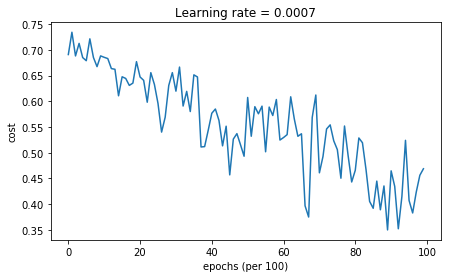

Accuracy: 0.796666666667


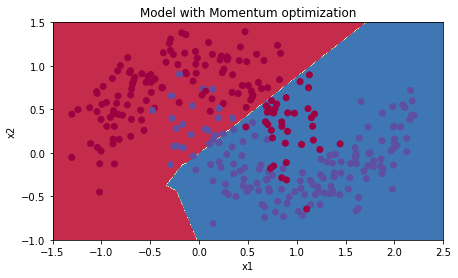

In [50]:
# train 3-layer model
layers_dims = [train_X.shape[0], 5, 2, 1]
parameters = model(train_X, train_Y, layers_dims, beta = 0.9, optimizer = "momentum")

# Predict
predictions = predict(train_X, train_Y, parameters)

# Plot decision boundary
plt.title("Model with Momentum optimization")
axes = plt.gca()
axes.set_xlim([-1.5,2.5])
axes.set_ylim([-1,1.5])
plot_decision_boundary(lambda x: predict_dec(parameters, x.T), train_X, train_Y)

### 5.3 - Mini-batch with Adam mode

Run the following code to see how the model does with Adam.

Cost after epoch 0: 0.690552
Cost after epoch 1000: 0.185501
Cost after epoch 2000: 0.150830
Cost after epoch 3000: 0.074454
Cost after epoch 4000: 0.125959
Cost after epoch 5000: 0.104344
Cost after epoch 6000: 0.100676
Cost after epoch 7000: 0.031652
Cost after epoch 8000: 0.111973
Cost after epoch 9000: 0.197940


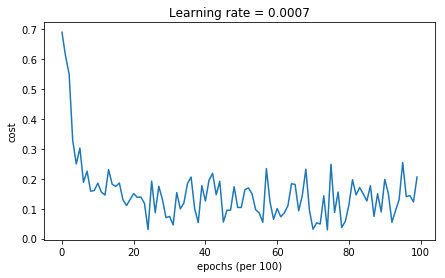

Accuracy: 0.94


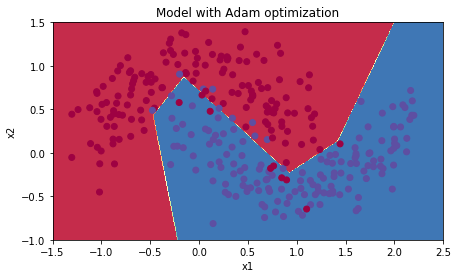

In [51]:
# train 3-layer model
layers_dims = [train_X.shape[0], 5, 2, 1]
parameters = model(train_X, train_Y, layers_dims, optimizer = "adam")

# Predict
predictions = predict(train_X, train_Y, parameters)

# Plot decision boundary
plt.title("Model with Adam optimization")
axes = plt.gca()
axes.set_xlim([-1.5,2.5])
axes.set_ylim([-1,1.5])
plot_decision_boundary(lambda x: predict_dec(parameters, x.T), train_X, train_Y)

### 5.4 - Summary

<table> 
    <tr>
        <td>
        **optimization method**
        </td>
        <td>
        **accuracy**
        </td>
        <td>
        **cost shape**
        </td>

    </tr>
        <td>
        Gradient descent
        </td>
        <td>
        79.7%
        </td>
        <td>
        oscillations
        </td>
    <tr>
        <td>
        Momentum
        </td>
        <td>
        79.7%
        </td>
        <td>
        oscillations
        </td>
    </tr>
    <tr>
        <td>
        Adam
        </td>
        <td>
        94%
        </td>
        <td>
        smoother
        </td>
    </tr>
</table> 

Momentum usually helps, but given the small learning rate and the simplistic dataset, its impact is almost negligeable. Also, the huge oscillations you see in the cost come from the fact that some minibatches are more difficult thans others for the optimization algorithm.

Adam on the other hand, clearly outperforms mini-batch gradient descent and Momentum. If you run the model for more epochs on this simple dataset, all three methods will lead to very good results. However, you've seen that Adam converges a lot faster.

Some advantages of Adam include:
- Relatively low memory requirements (though higher than gradient descent and gradient descent with momentum) 
- Usually works well even with little tuning of hyperparameters (except $\alpha$)

**References**:

- Adam paper: https://arxiv.org/pdf/1412.6980.pdf